# ST1504: Deep Learning CA2 (Part A)
By: Goh Kun Ming (P2415691)

Class: DAAA/FT/2A/02

*Soli Deo Gloria*

---

# Preliminary Background Context Reserch

**Letter A**
- Pointed peak
- Two diagonal lines and a central crossbar
- Strong symmetry

**Letter B**
- Vertical stem with two round loops (top and bottom)
- May vary in loop size and alignment

**Letter C**
- Open arc
- No closure at the ends
- Easily confused with "G" if poorly written

**Letter D**
- One straight line + one curved side
- Curvature on the right side varies a lot in handwriting

**Letter E**
- Three horizontal bars, flat left edge
- Often missing or weak middle bar in handwriting

**Letter F**
- Similar to E but without bottom bar
- Middle bar may be short or missing entirely

**Letter G**
- Like "C" but with a horizontal line or tail
- Shape inconsistently drawn; difficult for generative models

**Letter H**
- Two vertical bars with a horizontal bar in the middle
- Often well-structured and symmetrical

**Letter I**
- Just a vertical line
- Easily confused with "L" or even the number "1"

**Letter J**
- Vertical line with a hook at the bottom
- Hook size and orientation varies significantly

**Letter K**
- Vertical line + two angled strokes
- Angled strokes can be sharp or looped, depending on writer

**Letter L**
- Simple right-angle
- Often confused with "I" due to minimal features

**Letter M**
- Two upward diagonals and two verticals
- Often very distinct due to its structure

**Letter N**
- Two vertical lines with a diagonal connection
- Shape is fairly distinct and stable

**Letter O**
- Closed, round loop
- Frequently confused with "Q" or "0"

**Letter P**
- Vertical line with a single top loop
- Easily confused with "R" if diagonal stroke is missing

**Letter Q**
- Like "O" but with an extra tail/stroke
- Distinguishing feature often not visible

**Letter R**
- Like "P" but with an added diagonal line
- Often looks like "P" if diagonal stroke is faint

**Letter S**
- Complex curve with two direction changes
- Difficult for generative models to learn due to curvature

**Letter T**
- One vertical line with a wide top bar
- Top bar thickness varies widely

**Letter U**
- Curved bottom with two straight vertical sides
- Confused with "V" when curvature is sharp

**Letter V**
- Two diagonals meeting at a sharp point
- Often misclassified as "U" or "Y"

**Letter W**
- Like a double "V"
- Often wide and distinct, but stroke variance is high

**Letter X**
- Two diagonals crossing each other
- Symmetrical but prone to stroke variation

**Letter Y**
- V-shaped top with a single vertical tail
- May resemble "V" or "T" in some handwriting

**Letter Z**
- Three-line zigzag
- Difficult for some models due to angles

---
# 1. Importing of Libraries

In this section, we will be importing all the required Libraries of the Deep Learning CA2. Most of the libaries will be from TensorFlow, Keras and various Data Analysis and Visualisation Libaries. These Libaries will be imported in the code cell below.

In [ ]:
# ========== Install Optuna ========== #
!pip install optuna

# ========== Import Optuna ========== #
import optuna

# ========== Instal Visual Keras ========== #
!pip install -q visualkeras

# ========== Import Keras Models ========== #
from tensorflow.keras.models import Model

# ========== Import Keras Layers ========== #
from tensorflow.keras.layers import Activation, Dense, Flatten, Reshape, Conv2D, Conv2DTranspose, LeakyReLU, Dropout, Input, BatchNormalization, Embedding, Concatenate, Lambda, UpSampling2D, MaxPooling2D, ReLU, GaussianNoise

# ========== Import Keras Optimisers ========== #
from tensorflow.keras.optimizers import Adam, RMSprop

# ========== Import Keras Callbacks ========== #
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint, LearningRateScheduler, CSVLogger

# ========== Import Keras Losses ========== #
from tensorflow.keras.losses import BinaryCrossentropy

# ========== Import Keras Utils ========== #
from tensorflow.keras.utils import to_categorical, plot_model

# ========== Import Keras Image Data Generator ========== #
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# ========== Import Visual Keras ========== #
import visualkeras

# ========== Import TensorFlow ========== #
import tensorflow as tf

# ========== Import TensorFlow Random ========== #
from tensorflow.random import normal as tf_random_normal

# ========== Import Keras ========== #
from tensorflow.keras import Input, Model, layers, backend as K

# ========== Import Inception ========== #
from tensorflow.keras.applications.inception_v3 import InceptionV3, preprocess_input

# ========== Import Structural Similarity Score ========== #
from skimage.metrics import structural_similarity as ssim

# ========== Import VGG Pre-Process ========== #
from tensorflow.keras.applications.vgg16 import preprocess_input as vgg_preprocess

# ========== Import VGG16 ========== #
from tensorflow.keras.applications.vgg16 import VGG16

# ========== Import Keras ========== #
from tensorflow import keras

# ========== Import Pairwise Distances ========== #
from sklearn.metrics import pairwise_distances

# ========== Import Square Root Matrix ========== #
from scipy.linalg import sqrtm

# ========== Import NumPy ========== #
import numpy as np

# ========== Import Pandas ========== #
import pandas as pd

# ========== Import Matplotlib ========== #
import matplotlib.pyplot as plt

# ========== Import Seaborn ========== #
import seaborn as sns

# ========== Import Train Test Split ========== #
from sklearn.model_selection import train_test_split

# ========== Import TSNE ========== #
from sklearn.manifold import TSNE

# ========== Import Operating System ========== #
import os

# ========== Import Shutill ========== #
import shutil

# ========== Import Display Image ========== #
from IPython.display import Image

# ========== Mount Google Drive ========== #
from google.colab import drive
drive.mount('/content/drive')

# ========== Define Paths ========== #
DRIVE_ROOT = '/content/drive/MyDrive/Colab Notebooks/DELE CA2 A'
LOCAL_ROOT = '/content/DELE_CA2 A'

# ========== Copy Project Folder To Local SSD ========== #
if os.path.exists(LOCAL_ROOT):
    shutil.rmtree(LOCAL_ROOT)
shutil.copytree(DRIVE_ROOT, LOCAL_ROOT)

# ========== Switch To Local SSD ========== #
os.chdir(LOCAL_ROOT)
print("Now working in:", os.getcwd())

# ========== Final Confirmation ========== #
print("Libraries Imported Successfully")

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 395.9/395.9 kB 2.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 247.0/247.0 kB 15.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 997.4/997.4 kB 30.6 MB/s eta 0:00:00
Mounted at /content/drive
Now working in: /content/DELE_CA2 A
Libraries Imported Successfully


With reference to the output above, we are able to confirm that the Libaries
have been successfully imported and we can move on to loading the dataset provided.

---
# 2. Loading of Dataset

In this section, we will be loading the EMNIST Dataset provided from the Project Brief. There will only be a Training Data and Validation Data instead of the convention 3 sets (Training, Validation and Test). This is because the GAN is expected to generate and improve it's data through the usage of the Training Data only. Data Augmentation will also be conducted so as to theoretically allow the GAN and VAE Models to generalise better.

---
## 2.1 Preliminary Loading of Dataset

In this sub-section, we will be loading in the Dataset provided and conduct a preliminary observation of 1 image for each Sample Class. Subsequently, we will have a decision on whether there is a need to re-import the data due to any data errors or incorrect classes. The Dataset will be loaded in the Code Cell below.

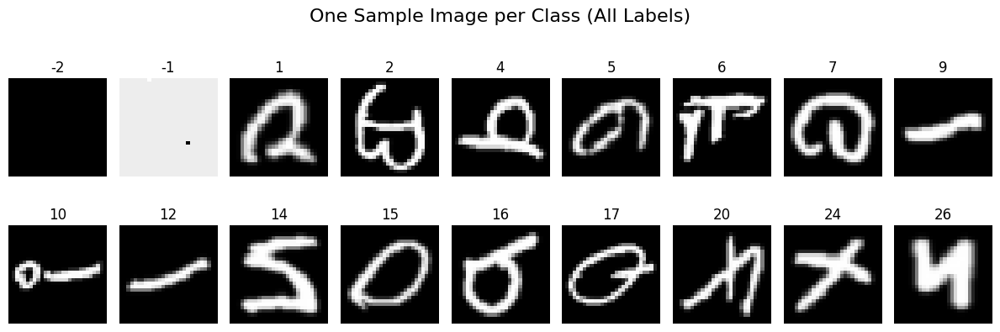

In [ ]:
# ========== Import Raw Dataset ========== #
df = pd.read_csv('emnist-letters-train.csv')

# ========== Split Labels and Features ========== #
y = df.iloc[:, 0].values
X = df.iloc[:, 1:].values

# ========== Reshape to (28, 28, 1) ========== #
X = X.reshape(-1, 28, 28, 1).astype('float32')

# ========== Normalise Pixel Values ========== #
X = X / 127.5 - 1.0

# ========== One-Hot Encoding (26 Classes) ========== #
y_cat = to_categorical(y - 1, num_classes=26)

# ========== Train/Val Split ========== #
X_train, X_val, y_train, y_val = train_test_split(
    X, y, test_size=0.1, stratify=y, random_state=42
)
y_cat_train, y_cat_val = train_test_split(
    y_cat, test_size=0.1, stratify=y, random_state=42
)

# ========== Plot One Sample Per Class ========== #
plt.figure(figsize=(12, 6))
all_labels = sorted(np.unique(y_train))

for idx, label in enumerate(all_labels):
    sample_idx = np.where(y_train == label)[0][0]
    image = X_train[sample_idx]

    plt.subplot(3, 9, idx + 1)
    plt.imshow(image.squeeze(), cmap='gray')
    plt.title(f"{label}", fontsize=12)
    plt.axis('off')

plt.suptitle("One Sample Image per Class (All Labels)", fontsize=16, y=1)
plt.tight_layout()
plt.show()

With reference to the output of the Code Cell above, we are able to determine that there is a need to re-import the data and filter accordingly as there are illegitimate data (-2 and -1). Other Data issues are also observed which will be addressed later on.

---
## 2.2 Data Loading & Data Pre-Processing

In this sub-section, we will be loading the Provided EMNIST Dataset. We will also be Spliting the Labels and Features, Reshaping, Normalising, One-Hot Encoding, and Train-Val Split. A detailed summary of the operations that will be conducted in this sub-section have been indicated below:

- Loading of EMNIST CSV Dataset (By Module Coordinator).
- Reshaping into 2D Images with 1 Channel (28, 28, 1).
- Normalise Pixel to [0, 1].
- One-Hot Encoding
- Train / Validation Split (90/10)

With the summary of the operations indicated, we will proceed to conduct the various operations in the Code Cell below.

In [ ]:
# ========== Import Raw Dataset ========== #
df = pd.read_csv('emnist-letters-train.csv')

# ========== Split Labels and Features ========== #
y = df.iloc[:, 0].values
X = df.iloc[:, 1:].values

# ========== Reshape to (28, 28, 1) ========== #
X = X.reshape(-1, 28, 28, 1).astype('float32')

# ========== Normalise Pixel Values ========== #
X = X / 127.5 - 1.0

# ========== Filter to 16 Selected Labels (Original Values) ========== #
selected_labels = [1, 2, 4, 5, 6, 7, 9, 10, 12, 14, 15, 16, 17, 20, 24, 26]  # A, B, D, E, F, G, I, J, L, N, O, P, Q, T, X, Z
mask = np.isin(y, selected_labels)
X = X[mask]
y = y[mask]

# ========== One-Hot Encoding (26 Classes) ========== #
y_cat = to_categorical(y - 1, num_classes=26)

# ========== Train/Val Split ========== #
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.1, stratify=y, random_state=42)
y_cat_train, y_cat_val = train_test_split(y_cat, test_size=0.1, stratify=y, random_state=42)

# ========== Create Shape Summary DataFrame ========== #
shape_summary = pd.DataFrame({
    'Dataset': ['Original (df)', 'Filtered X', 'Filtered y', 'X_train', 'X_val', 'y_train', 'y_val', 'y_cat_train', 'y_cat_val'],
    'Shape': [df.shape, X.shape, y.shape, X_train.shape, X_val.shape, y_train.shape, y_val.shape, y_cat_train.shape, y_cat_val.shape]
})

# ========== Display Shape Summary ========== #
shape_summary.style.background_gradient(cmap="Blues")

,Dataset,Shape
0,Original (df),"(64828, 785)"
1,Filtered X,"(54588, 28, 28, 1)"
2,Filtered y,"(54588,)"
3,X_train,"(49129, 28, 28, 1)"
4,X_val,"(5459, 28, 28, 1)"
5,y_train,"(49129,)"
6,y_val,"(5459,)"
7,y_cat_train,"(49129, 26)"
8,y_cat_val,"(5459, 26)"


With reference to the output above, we are able to identify that we have successfully imported the Provided EMNIST Dataset. With this observation, we will be able to move on to the Augmenting the Training Data to allow for Comparison between Augmented and Non-Augmented Training Data which theoretically will make the GAN and VAE generalise better. However, theoretical knowledge regarding Augmented Data need not be true and can be situational depending on context and other elements such as Model Architecture and Augmentation Strategy.

---
## 2.3 Data Augmentation

In this sub-section, we will be performing Data Augmentation on the Training Data which was the result of the Train-Validation Split done previously. Data Augmentation will theoretically improve the Model's ability to generalise but subjected to various context and circumstances. The various Augmentation that will be conducted are indicated below:

- Rotation: 15
- Width Shift: Max 10%
- Height Shift: Max 10%
- Zoom: 0.1

With the Augmentation Parameters included, we will proceed to conduct the Data Augmentation on the Training Data in the Code Cell below. We will also set the Seed to 42 to allow for replication.

In [ ]:
# ========== Set Random Seed for Reproducibility ========== #
SEED = 42

# ========== Set Up ImageDataGenerator ========== #
datagen = ImageDataGenerator(
    rotation_range=15,
    width_shift_range=0.1,
    height_shift_range=0.1,
    zoom_range=0.1
)

# ========== Fit the Generator to Training Data ========== #
datagen.fit(X_train, seed=SEED)

# ========== Create Augmented Training Generator ========== #
augmented_generator = datagen.flow(
    X_train, y_train, batch_size=32, shuffle=True, seed=SEED
)

# ========== Final Confirmation ========== #
print("Data Augmentation Pipeline Set Up Successfully.")

Data Augmentation Pipeline Set Up Successfully.


With reference to the output of the Code Cell above, we are able to confirm that the Data Augmentation have been executed successfully and we are able to proceed with Exploratory Data Analysis on our EMNIST Dataset in the next Section.

---
# 3. Exploratory Data Analysis & Visualisation

In this section, we will be conducting Data Analysis and Visualisations on the EMNIST Data provided to better understand the Dataset provided to us. Some of the Analysis will provide insights on areas to address to ensure our GAN / VAE performs better and much more consistent.

---
## 3.1 Visualising Sample Training Images (No Augmentation)

In this sub-section, we will be visualising a Sample Image for each of the class in the provided EMNIST Dataset. This will allow us to have a confirmation on what classes are there for us to predict and also ensure that the images are correctly assigned the Class Label. The visualisation will be conducted for the Non-Augmented Training Data first in the Code Cell below.

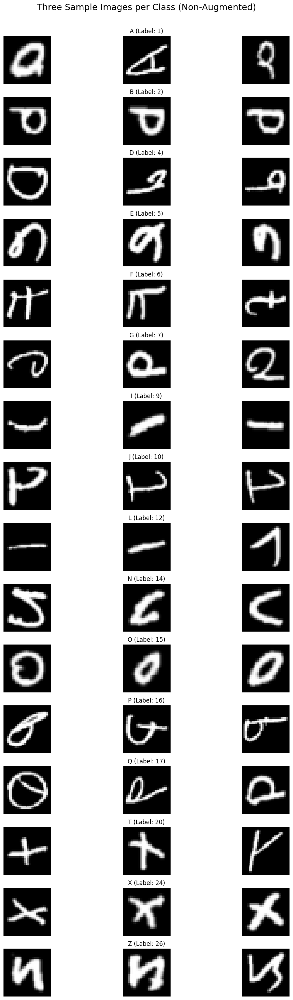

In [ ]:
# ========== Define Selected Labels and Map to Letters ========== #
selected_labels = [1, 2, 4, 5, 6, 7, 9, 10, 12, 14, 15, 16, 17, 20, 24, 26]
label_to_letter = {label: chr(64 + label) for label in selected_labels}

# ========== Plot Setup ========== #
plt.figure(figsize=(12, 28))

for row_idx, label in enumerate(selected_labels):
    matching_indices = np.where(y_train == label)[0]

    # ----- Take First 3 Samples of Label ----- #
    for col_idx in range(3):
        if col_idx >= len(matching_indices):
            continue

        sample_idx = matching_indices[col_idx]
        image = X_train[sample_idx]

        plt.subplot(len(selected_labels), 3, row_idx * 3 + col_idx + 1)
        plt.imshow(image.squeeze(), cmap='gray')
        if col_idx == 1:
            plt.title(f"{label_to_letter[label]} (Label: {label})")
        plt.axis('off')

# ========== Display Plot ========== #
plt.tight_layout()
plt.suptitle("Three Sample Images per Class (Non-Augmented)", fontsize=18, y=1.02)
plt.show()

With reference to the output above, we are able to see that the orientation of all the EMNIST Letters are in the wrong orientation. However, we are also able to identify that there is a pattern to be observed which will allow us to create an action plan to address the orientation problem. We are able to see that all the classes needs to be rotated **90 Degrees Clockwise** and **Mirrorer**. The solution will be conducted in the next section.

---
### 3.1.1 Data Orientation Resolution

In this sub-section, we will be resolving the issue identified with the orientation of the EMNIST Data Provided. We will be performing the following changes on both the Training and Validation Set. We will also be redefining the Data Augmentation Generator so as to ensure that the Augmentation is derived from the correct and intended orientation before Augmentation is introduced. The changes that will be made are indicated below:

- Rotate all Images by 90 Degrees Clockwise
- Mirror all Images from Left to Right

With the changes indicated to resolve the Data Issues, we will proceed to conduct the operation in the code cell below.

Images Rotated 90° Clockwise and Mirrored (Left-Right) Successfully.
Augmentation Pipeline Reset.


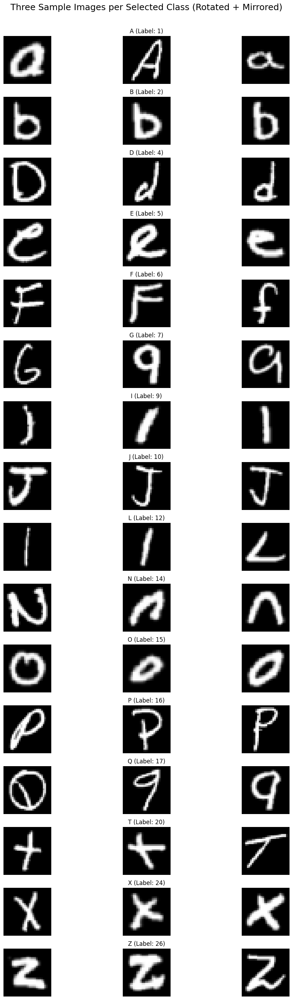

In [ ]:
# ========== Orientation Fix Function (Rotate + Mirror) ========== #
def fix_image_orientation_uniform(X_data):
    for i in range(X_data.shape[0]):
        image = X_data[i, :, :, 0]               # Shape: (28, 28)
        image = np.rot90(image, k=-1)            # Rotate 90° clockwise
        image = np.fliplr(image)                 # Mirror left-to-right
        X_data[i, :, :, 0] = image               # Save back
    return X_data

# ========== Apply Fixes to Training and Validation Sets ========== #
X_train = fix_image_orientation_uniform(X_train)
X_val = fix_image_orientation_uniform(X_val)
print("Images Rotated 90° Clockwise and Mirrored (Left-Right) Successfully.")

# ========== Redefine Data Augmentation ========== #
SEED = 42
datagen = ImageDataGenerator(
    rotation_range=15,
    width_shift_range=0.1,
    height_shift_range=0.1,
    zoom_range=0.1
)
datagen.fit(X_train, seed=SEED)
augmented_generator = datagen.flow(X_train, y_train, batch_size=32, shuffle=True, seed=SEED)
print("Augmentation Pipeline Reset.")

# ========== Define Selected Labels and Map to Letters ========== #
selected_labels = [1, 2, 4, 5, 6, 7, 9, 10, 12, 14, 15, 16, 17, 20, 24, 26]
label_to_letter = {label: chr(64 + label) for label in selected_labels}

# ========== Plot: 3 Samples per Class from X_train ========== #
plt.figure(figsize=(12, 28))

for row_idx, label in enumerate(selected_labels):
    matching_indices = np.where(y_train == label)[0]

    for col_idx in range(3):
        if col_idx >= len(matching_indices):
            continue

        sample_idx = matching_indices[col_idx]
        image = X_train[sample_idx]

        plt.subplot(len(selected_labels), 3, row_idx * 3 + col_idx + 1)
        plt.imshow(image.squeeze(), cmap='gray')
        if col_idx == 1:
            plt.title(f"{label_to_letter[label]} (Label: {label})")
        plt.axis('off')

# ========== Display Plot ========== #
plt.tight_layout()
plt.suptitle("Three Sample Images per Selected Class (Rotated + Mirrored)", fontsize=18, y=1.02)
plt.show()

With reference to the visualisation above, we are able to see that the Orientation of the Data have been fixed successfully and we are able to proceed with the next EDA. We are also able to make the observation that each class contains a mixture of Capital and Small Letters. This will be left in as it can be beneficial to the GAN / VAE when it learns the various patterns. We also observe that the label range is from 1 to 26 correspondign to the EMNIST Letter's sequence. We will need to re-label to range from 0 to 15 so as to limit the negative implications during GAN / VAE Training.

---
### 3.1.2 Re-labeling Classes

In this sub-section, we will be re-labeling the current classes so as to change it from 1 to 26 to 0 to 15. We will re-label both the Training Data and the Validation Data. This will allow us to streamline the GAN / VAE Training in the future and make it easier to declare the Number of Classes rather than assuming 26. The Re-labeling map for the Current Labels that we will adhere to is indicated below:

- Label 1 (Letter A) -> Label 0
- Label 2 (Letter B) -> Label 1
- Label 4 (Letter D) -> Label 2
- Label 5 (Letter E) -> Label 3
- Label 6 (Letter F) -> Label 4
- Label 7 (Letter G) -> Label 5
- Label 9 (Letter I) -> Label 6
- Label 10 (Letter J) -> Label 7
- Label 12 (Letter L) -> Label 8
- Label 14 (Letter N) -> Label 9
- Label 15 (Letter 0) -> Label 10
- Label 16 (Letter P) -> Label 11
- Label 17 (Letter Q) -> Label 12
- Label 20 (Letter T) -> Label 13
- Label 24 (Letter X) -> Label 14
- Label 26 (Letter Z) -> Label 15

With the Re-label mapping indicated above, we will proceed with conducting the Re-label operation in the Code Cell below.

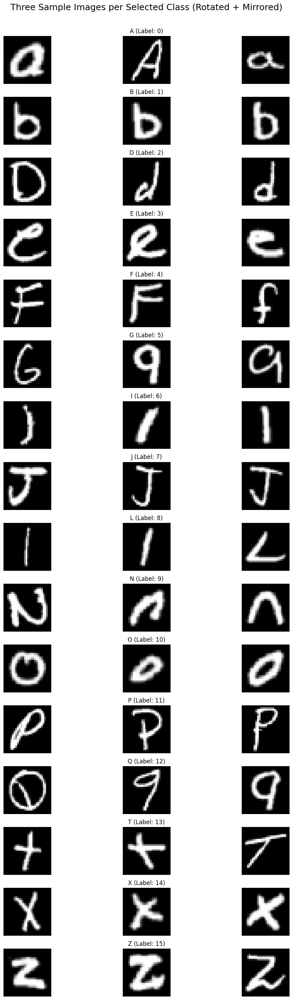

In [ ]:
# ========== Mapping (Index to Letter) ========== #
index_to_letter = {
    0: 'A', 1: 'B', 2: 'D', 3: 'E',
    4: 'F', 5: 'G', 6: 'I', 7: 'J',
    8: 'L', 9: 'N', 10: 'O', 11: 'P',
    12: 'Q', 13: 'T', 14: 'X', 15: 'Z'
}

# ========== Map Original Label to New Label ========== #
label_to_index = {label: idx for idx, label in enumerate(selected_labels)}
index_to_label = {idx: label for label, idx in label_to_index.items()}

# ========== Direct Re-label ========== #
y_train = np.array([label_to_index[y] for y in y_train])
y_val   = np.array([label_to_index[y] for y in y_val])

# ========== One-Hot Encode ========== #
y_cat_train = to_categorical(y_train, num_classes=16)
y_cat_val   = to_categorical(y_val,   num_classes=16)

# ========== Plot: 3 Samples per Class from X_train ========== #
plt.figure(figsize=(12, 28))

for row_idx in range(16):
    matching_indices = np.where(y_train == row_idx)[0]

    for col_idx in range(3):
        if col_idx >= len(matching_indices):
            continue

        sample_idx = matching_indices[col_idx]
        image = X_train[sample_idx]

        plt.subplot(16, 3, row_idx * 3 + col_idx + 1)
        plt.imshow(image.squeeze(), cmap='gray')
        if col_idx == 1:
            char = index_to_letter[row_idx]
            plt.title(f"{char} (Label: {row_idx})")
        plt.axis('off')

# ========== Display Plot ========== #
plt.tight_layout()
plt.suptitle("Three Sample Images per Selected Class (Rotated + Mirrored)", fontsize=18, y=1.02)
plt.show()

With reference to the output of the Sample Image Visualisation, we are able to verify that the Re-labelling have been executed and conducted successfully as intended. This implies that the Training Data is now corrected and will not have any negative implications during the GAN / VAE Training.

---
## 3.2 Visualising Class Distribution

In this sub-section, we will be visualising the quantity count for each of the EMNIST class so as to identify any potential Class Imbalance. Class Imbalance could cause Skewed Performance as the GAN / VAE is able to better learn from the class with higher quantity of data whereas classes with lower number of data will cause a lower quality of generated image. This can cause a GAN / VAE to be able to generate very well for a certain class but generate poorly for another class. The various actions that can be taken to address Class Imbalance are listed below:

**Methods To Address Class Imbalance**
- Establishing Class Weights
- Intense Augmentation of Minority Classes
- Oversampling / Undersampling

With the various Methods to Address Class Imbalance, we shall proceed to state the appropriate action plan for various outcomes of the visualisation. The action plan for each respective results are listed below:

**Class Imbalance Identified**
- List down the observations from the Barplot.
- Proceed to address Class Imbalance using one of the listed method.
- Justify the chosen method's usage over other method.

**No Class Imbalance Identified**
- List down the observations from the Barplot.
- Proceed to next visualisation.

With the action plan for the potential results listed, we will proceed to conduct the visualisation in the Code Cell below.

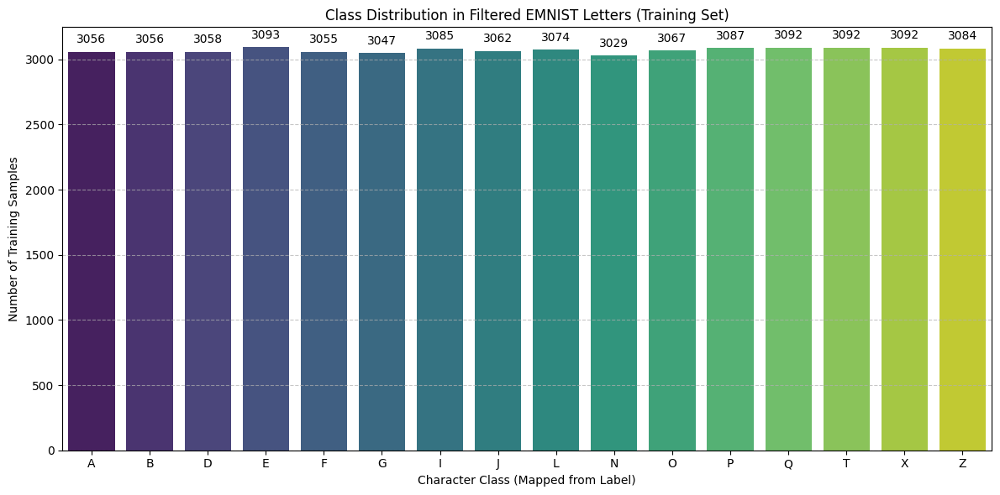

In [ ]:
# ========== Build DataFrame for Plotting ========== #
label_counts = pd.Series(y_train).value_counts().sort_index()

# ========== Remap Original Values ========== #
letters = [chr(64 + index_to_label[idx]) for idx in label_counts.index]
counts = label_counts.values

# ========== Plot Class Distribution ========== #
plt.figure(figsize=(12, 6))
ax = sns.barplot(x=letters, y=counts, hue=letters, palette='viridis', dodge=False, legend=False)

# ========== Annotate Count Above Each Bar ========== #
for i, count in enumerate(counts):
    ax.text(i, count + 50, str(count), ha='center', va='bottom', fontsize=10)

# ========== Display Plot ========== #
plt.xlabel("Character Class (Mapped from Label)")
plt.ylabel("Number of Training Samples")
plt.title("Class Distribution in Filtered EMNIST Letters (Training Set)")
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

With reference to the Visualisation above, we are able to see that there is a **Class Imbalance** identified within the provided EMNIST Dataset. Subsequently, we will take action to attempt to balance the EMNIST Dataset so as to ensure the results produced for each of the classes by the GAN is consistent and reliable, without creating room for deviation of performance for each of the classes.

---
### 3.2.1 Addressing Class Imbalance

As previously identified, there are Class Imbalance within the EMNIST Dataset provided. The course of action that we will undertake will be training a VAE to produce more EMNIST Data until all the Data Counts for each of the classes are equal to the highest count of data for the current classes. We will need to prepare the Encoder, Latent Sampling and Decoder before being able to generate mroe Data to balance our current EMNIST Dataset.

---
#### 3.2.1.1 Determine Class Shortfall

Before being able to utilise a VAE to address the Class Imbalance, we will firstly need to determine how much data we need for each of the classes. We will be using the current Data Count for each class and the Highest Data Count amongst the classes to determine how much data we need to bridge. A formula for this case have been indicated below:

---
Purpose: Calculate the Difference between Highest Count Class and each Class

$$
\text{Shortfall}_i = T - C_i
$$

Where:
- $T$ = Highest Data Count
- $C_i$ = Current Data Count in Class $i$
- $\text{Shortfall}_i$ = Number of Synthetic Samples Needed
---
Through the indicated Formula, we are able to determine how much Synthetic Samples we need to ensure the class are balanced. With the formula indicated, we will proceed to calculate the Class Shortfall in the Code Cell below.

In [ ]:
# ========== Calculate Current Class Frequency ========== #
label_counts = pd.Series(y_train).value_counts().sort_index()

# ========== Utilise Highest Count as Target ========== #
TARGET_PER_CLASS = label_counts.max()

# ========== Calculate Shortfall ========== #
class_shortfalls = {
    label: TARGET_PER_CLASS - count
    for label, count in label_counts.items()
    if count < TARGET_PER_CLASS
}

# ========== Create DataFrame for Shortfalls ========== #
shortfall_df = pd.DataFrame({
    'Label': list(class_shortfalls.keys()),
    'Current Count': [label_counts[label] for label in class_shortfalls.keys()],
    'Target Count': TARGET_PER_CLASS,
    'Shortfall': list(class_shortfalls.values())
})

# ========== Sort by Shortfall Descending ========== #
shortfall_df = shortfall_df.sort_values(by='Shortfall', ascending=False).reset_index(drop=True)

# ========== Display Summary ========== #
shortfall_df.style.background_gradient(cmap="Reds")

,Label,Current Count,Target Count,Shortfall
0,9,3029,3093,64
1,5,3047,3093,46
2,4,3055,3093,38
3,1,3056,3093,37
4,0,3056,3093,37
5,2,3058,3093,35
6,7,3062,3093,31
7,10,3067,3093,26
8,8,3074,3093,19
9,15,3084,3093,9


With reference with the output of the Code Cell above, we are able to determine the amount of Data that we need to generate so as to achieve a Balanced Class. We will proceed to define the Conditinal VAE's Architecture in the next section.

---
#### 3.2.1.2 Defining Callback Functions

In this sub-section, we will be pre-defining the various Callbacks. This is to ensure consistency throughout the VAE and also to increase the Conditional VAE's ability to generate data Accurately and optimise the Computation Cost for training the Conditional VAE. The formulas and logic for these Callbacks are indicated below:

---
**ReduceLROnPlateau:**

Purpose: Automatically Reduces the Learning Rate when Validation Performance Plateaus.

$$
\text{If no improvement in } val\_loss \text{ for 5 epochs: } \eta_{\text{new}} = 0.5 \cdot \eta
$$

Where:

- $\eta_{\text{new}}$ = reduced learning rate

---
**EarlyStopping:**

Purpose: Prevents Wastage of Computational Power if Model Does Not Improve.

$$
\text{If } val\_loss \text{ does not improve for 10 epochs, stop training and restore best weights}
$$

---
With the formulas and Various Callbacks listed, we will proceed to define the Callbacks in the Code Cell below in preparation for the Conditional VAE's Training.

In [ ]:
# ========== Define Early Stopping ========== #
early_stop = EarlyStopping(
    monitor='val_loss',
    patience=10,
    restore_best_weights=True,
    verbose=1
)

# ========== Define Reduce Learning Rate on Plateau ========== #
reduce_lr = ReduceLROnPlateau(
    monitor='val_loss',
    factor=0.5,
    patience=5,
    min_lr=1e-6,
    verbose=1
)

With reference to the Code Cell above, we are able to identify that that the Callbacks have been successfully defined and the various parameters are set so as to ensure we push the Conditional VAE to its limits in terms of the ability to generate data and also to ensure we conserve Computational Duration.

---
#### 3.2.1.3 Defining Conditional VAE Architecture

In this sub-section, we will be defining the Conditional VAE Architecture so as to generate new Data that can we added into the current Classes which fall short of the Highest Data Count as determined in the previous section. A Conditional VAE is utilised as not all Classes need to have Data Generated for the purpose of Class Balancing. THe relevant formulas for Conditional VAE are indicated below:

---
**Latent Sampling (Reparameterization Trick)**

Purpose: Enables Stochastic Sampling from the Latent Space while keeping the Model Differentiable.

$$
\mathbf{z} = \boldsymbol{\mu} + \boldsymbol{\sigma} \cdot \boldsymbol{\epsilon}, \quad \boldsymbol{\epsilon} \sim \mathcal{N}(0, \mathbf{I})
$$

Where:
- $\mathbf{z}$ = Sampled Latent Vector  
- $\boldsymbol{\mu}$ = Encoder-predicted Mean  
- $\boldsymbol{\sigma}$ = Standard Deviation (from $\log \sigma^2$)  
- $\boldsymbol{\epsilon}$ = Noise Sampled from Standard Normal Distribution

---
**KL Divergence Loss**

Purpose: Regularises latent space to Resemble a Standard Normal Distribution.

$$
\mathcal{L}_{\text{KL}} = -\frac{1}{2} \sum_{j=1}^{d} \left( 1 + \log(\sigma_j^2) - \mu_j^2 - \sigma_j^2 \right)
$$

Where:
- $d$ = Latent Space Dimensionality  
- $\mu_j$ = Mean for Dimension $j$  
- $\sigma_j$ = Standard Deviation for Dimension $j$
---
**Reconstruction Loss (Binary Crossentropy)**

Purpose: Measures how Accurately the Decoder Reconstructs Input Image.

$$
\mathcal{L}_{\text{recon}} = - \sum_{i=1}^{n} \left[ x_i \log(\hat{x}_i) + (1 - x_i) \log(1 - \hat{x}_i) \right]
$$

Where:
- $x_i$ = Original Pixel Value  
- $\hat{x}_i$ = Reconstructed Pixel  
- $n$ = Total Number of Pixels
---
**Total CVAE Loss**

Purpose: Balances Reconstruction Quality with Latent Regularisation.

$$
\mathcal{L}_{\text{CVAE}} = \mathbb{E}_{q(\mathbf{z} | \mathbf{x}, \mathbf{y})}[\mathcal{L}_{\text{recon}}] + \mathcal{L}_{\text{KL}}
$$

Where:
- $\mathbf{x}$ = Input Image  
- $\mathbf{y}$ = Class Label
- $q(\mathbf{z} | \mathbf{x}, \mathbf{y})$ = Learned Posterior Distribution of Latent Vector given Input and Label  
---
With the relevant Formulas for the Conditional VAE indicated above, we will proceed to define and consturct the Conditional VAE's Architecture in the Code Cell below so as to address the Class Imbalance.

In [ ]:
# ========== Rescale from [-1, 1] to [0, 1] ========== #
X_train_cvae = (X_train + 1.0) / 2.0
X_val_cvae = (X_val + 1.0) / 2.0

# ========== Define Hyperparameters ========== #
latent_dim = 128
num_classes = 16
img_shape = (28, 28, 1)
kl_weight = 1.0

# ========== Sampling Function ========== #
def sampling(args):
    z_mean, z_log_var = args
    eps = tf.random.normal(shape=(tf.shape(z_mean)[0], latent_dim))
    return z_mean + tf.exp(0.5 * z_log_var) * eps

# ========== VAE Loss Layer ========== #
class VAELoss(tf.keras.layers.Layer):
    def __init__(self, kl_weight=1.0, **kwargs):
        super().__init__(**kwargs)
        self.kl_weight = kl_weight
        self.bce = BinaryCrossentropy(from_logits=False, reduction='none')

    def call(self, inputs):
        x, x_decoded, z_mean, z_log_var = inputs
        recon = self.bce(x, x_decoded)
        recon_loss = tf.reduce_sum(recon, axis=[1, 2])  # [batch]
        kl = -0.5 * tf.reduce_sum(1 + z_log_var - tf.square(z_mean) - tf.exp(z_log_var), axis=1)
        total_loss = tf.reduce_mean(recon_loss + self.kl_weight * kl)
        self.add_loss(total_loss)
        return x_decoded

# ========== CVAE Encoder ========== #
img_input = Input(shape=img_shape, name="img_input")
label_input = Input(shape=(num_classes,), name="label_input")

lbl = Dense(28 * 28, activation='relu')(label_input)
lbl = Reshape((28, 28, 1))(lbl)
lbl = GaussianNoise(0.1)(lbl)
img = GaussianNoise(0.1)(img_input)

x = Concatenate()([img, lbl])

x = Conv2D(64, 3, padding="same", kernel_initializer='he_normal')(x)
x = LeakyReLU()(x)
x = BatchNormalization()(x)
x = Conv2D(64, 3, strides=2, padding="same", kernel_initializer='he_normal')(x)
x = LeakyReLU()(x)
x = Dropout(0.2)(x)
x = BatchNormalization()(x)

x = Conv2D(128, 3, padding="same", kernel_initializer='he_normal')(x)
x = LeakyReLU()(x)
x = Conv2D(128, 3, strides=2, padding="same", kernel_initializer='he_normal')(x)
x = LeakyReLU()(x)
x = BatchNormalization()(x)

x = Flatten()(x)
x = Dense(256, activation='relu')(x)

z_mean = Dense(latent_dim, name="z_mean")(x)
z_log_var = Dense(latent_dim, name="z_log_var")(x)
z = Lambda(sampling, name="z")([z_mean, z_log_var])

# ========== CVAE Decoder ========== #
dec_input = Concatenate(name="dec_input")([z, label_input])

x = Dense(7 * 7 * 128, activation="relu", name="dense_gen")(dec_input)
x = Reshape((7, 7, 128), name="reshape_gen")(x)

x = Conv2DTranspose(128, 3, strides=2, padding="same", name="deconv1")(x)
x = LeakyReLU(name="leaky1")(x)
x = BatchNormalization(name="bn1")(x)

x = Conv2DTranspose(64, 3, strides=1, padding="same", name="deconv2")(x)
x = LeakyReLU(name="leaky2")(x)
x = BatchNormalization(name="bn2")(x)

x = Conv2DTranspose(32, 3, strides=2, padding="same", name="deconv3")(x)
x = LeakyReLU(name="leaky3")(x)
x = BatchNormalization(name="bn3")(x)

decoded = Conv2DTranspose(1, 3, padding="same", activation="sigmoid", name="decoder_output")(x)

# ========== Wrap with Loss Layer ========== #
output = VAELoss(kl_weight=kl_weight)([img_input, decoded, z_mean, z_log_var])

# ========== Compile CVAE ========== #
cvae = Model([img_input, label_input], output, name="CVAE")
cvae.compile(optimizer=Adam(learning_rate=1e-4))
cvae.summary()

Model: "CVAE"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ label_input         │ (None, 16)        │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense (Dense)       │ (None, 784)       │     13,328 │ label_input[0][0] │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ img_input           │ (None, 28, 28, 1) │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ reshape (Reshape)   │ (None, 28, 28, 1) │          0 │ dense[0][0]       │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ gaussian_noise_1    │ (None, 28, 28, 1) │          0 │ img_input[0][0]   │
│ (GaussianNoise)     │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ gaussian_noise      │ (None, 28, 28, 1) │          0 │ reshape[0][0]     │
│ (GaussianNoise)     │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ concatenate         │ (None, 28, 28, 2) │          0 │ gaussian_noise_1… │
│ (Concatenate)       │                   │            │ gaussian_noise[0… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d (Conv2D)     │ (None, 28, 28,    │      1,216 │ concatenate[0][0] │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ leaky_re_lu         │ (None, 28, 28,    │          0 │ conv2d[0][0]      │
│ (LeakyReLU)         │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalization │ (None, 28, 28,    │        256 │ leaky_re_lu[0][0] │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_1 (Conv2D)   │ (None, 14, 14,    │     36,928 │ batch_normalizat… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ leaky_re_lu_1       │ (None, 14, 14,    │          0 │ conv2d_1[0][0]    │
│ (LeakyReLU)         │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout (Dropout)   │ (None, 14, 14,    │          0 │ leaky_re_lu_1[0]… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 14, 14,    │        256 │ dropout[0][0]     │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_2 (Conv2D)   │ (None, 14, 14,    │     73,856 │ batch_normalizat… │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ leaky_re_lu_2       │ (None, 14, 14,    │          0 │ conv2d_2[0][0]    │
│ (LeakyReLU)         │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_3 (Conv2D)   │ (None, 7, 7, 128) │    147,584 │ leaky_re_lu_2[0]… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ leaky_re_lu_3       │ (None, 7, 7, 128) │          0 │ conv2d_3[0][0]  

 Total params: 3,096,081 (11.81 MB)

 Trainable params: 3,095,121 (11.81 MB)

 Non-trainable params: 960 (3.75 KB)

With reference to the Conditional VAE's Architecture Summary output above, we are able to conclude that the Architecture have been successfully defined and we are able to proceed with the training of the Conditional VAE in the next section. Upon Training, we will be able to plot out the Training and Validation Loss Curve to determine if adjustments need to be made to the Conditional VAE's Architecture.

---
#### 3.2.1.4 Training of Conditional VAE

In this section, we will be training the Conditional VAE on the EMNIST Data that are in the Classes that need to have an increase in Data Count. We will be utilising the Callbacks and the Conditional VAE which were both respectively defined previously in Section 3.2.1.2 and 3.2.1.3. Subsequently, we will evaluate the Conditional VAE's performance using a Training and Validation Loss Curve after the training. We will be conducting the Conditional VAE Training in the Code Cell below.

In [ ]:
# ========== Train CVAE ========== #
history = cvae.fit(
    [X_train_cvae, y_cat_train],
    X_train_cvae,
    validation_data=([X_val_cvae, y_cat_val], X_val_cvae),
    epochs=200,
    batch_size=32,
    shuffle=True,
    callbacks=[early_stop, reduce_lr]
)

Epoch 1/200
1536/1536 ━━━━━━━━━━━━━━━━━━━━ 40s 15ms/step - loss: 325.9268 - val_loss: 188.0810 - learning_rate: 1.0000e-04
Epoch 2/200
1536/1536 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - loss: 184.7621 - val_loss: 177.4208 - learning_rate: 1.0000e-04
Epoch 3/200
1536/1536 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - loss: 173.9843 - val_loss: 171.6857 - learning_rate: 1.0000e-04
Epoch 4/200
1536/1536 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - loss: 166.5547 - val_loss: 165.9975 - learning_rate: 1.0000e-04
Epoch 5/200
1536/1536 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - loss: 161.8469 - val_loss: 158.6437 - learning_rate: 1.0000e-04
Epoch 6/200
1536/1536 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - loss: 158.0621 - val_loss: 156.1747 - learning_rate: 1.0000e-04
Epoch 7/200
1536/1536 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - loss: 155.0383 - val_loss: 153.0856 - learning_rate: 1.0000e-04
Epoch 8/200
1536/1536 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - loss: 152.9501 - val_loss: 151.5127 - learning_rate: 1.0000e-04
Epoch 9/200
1536/1536 ━━━━━━━━

With reference to the output above, we are able to observe that the Conditional VAE have been successfully trained and is ready to be evaluated in the next sub-section using the Training and Validation Loss Curve. Should the Conditional VAE not perform well based on the Training and Validation Loss Curve, we will have to edit the Model's Architecture and make other neccessary adjustments.

---
#### 3.2.1.5 Plotting Training Loss for Conditional VAE

In this sub-section, we will be plotting the Learning Curve to assess the Learning Behaviour of the Conditional VAE. This plot allows us to visually determine if the Conditional VAE is Underfitting, Overfitting, or achieving an Ideal Fit during training. While the Conditional VAE is an unsupervised generative model, its ability to minimise both the reconstruction loss and KL divergence effectively indicates how well it learns the latent structure of the input data.

If the Conditional VAE is **Underfitting**, it implies that the encoder-decoder pair is not effectively capturing the underlying data distribution or reconstructing input images accurately.

If the Conditional VAE is **Overfitting**, the model may have memorised training examples and fails to generalise well to unseen variations in character structures.

An **Ideal Fit** suggests that the Conditional VAE is generalising well, balancing both reconstruction quality and latent space regularisation.

The Potential Observations and Corresponding Action Plans are outlined below:

**Underfitting Learning Curve**
- Re-tune latent dimensionality or layer complexity
- Increase the number of epochs or reduce dropout
- Revisit the KL-divergence weighting (if applicable)

**Overfitting Learning Curve**
- Enable or increase dropout
- Apply stronger regularisation (e.g. L2)
- Reduce model complexity or batch size

**Ideal Fit Learning Curve**
- Retain the current architecture and hyperparameters
- Proceed with synthetic sample generation per class
- Evaluate generation quality across all 16 classes

With the potential observations and their respective action plans indicated, we will proceed to visualise the Learning Curve in the Code Cell below.

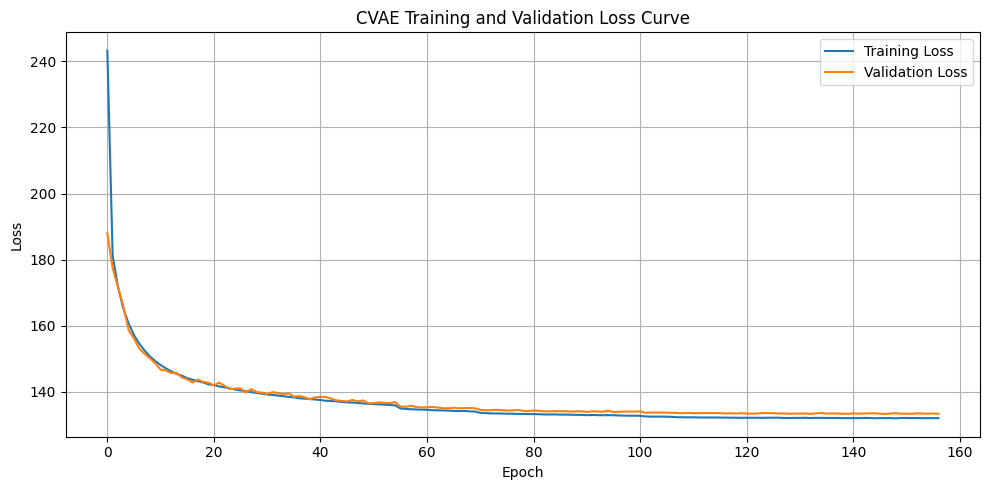

In [ ]:
# ========== Plot CVAE Training Loss ========== #
plt.figure(figsize=(10, 5))
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.title("CVAE Training and Validation Loss Curve")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

With reference to the output of the Training and Validation Loss Curve above, we are able to determine that the Conditional VAE has achieved an **Ideal Fit** and the Conditional VAE is capable of generating quality images and also regularising the Latent Space.

---
#### 3.2.1.6 Defining Inference Decoder

In this sub-section, we will build the Inference Decoder which will be required to sample the Synthetic Data using the trained weights. The Inference Decoder is a reconstructed version of the Conditional VAE but it will not include the Encoder and also will not include an Image Input and will only have the Sampled Latent Vector and the Label as input. The Inference Decoder will be defined in the Code Cell below.

In [ ]:
# ========== Build Inference Decoder ========== #
z_input = Input(shape=(latent_dim,), name="z_input")
label_gen_input = Input(shape=(num_classes,), name="label_gen_input")
dec_input = Concatenate(name="dec_input")([z_input, label_gen_input])

# ========== Obtain CVAE Decoder Layers ========== #
x = cvae.get_layer("dense_gen")(dec_input)
x = cvae.get_layer("reshape_gen")(x)
x = cvae.get_layer("deconv1")(x)
x = cvae.get_layer("leaky1")(x)
x = cvae.get_layer("bn1")(x)
x = cvae.get_layer("deconv2")(x)
x = cvae.get_layer("leaky2")(x)
x = cvae.get_layer("bn2")(x)
x = cvae.get_layer("deconv3")(x)
x = cvae.get_layer("leaky3")(x)
x = cvae.get_layer("bn3")(x)
gen_output = cvae.get_layer("decoder_output")(x)

# ========== Define Model ========== #
decoder_model = Model([z_input, label_gen_input], gen_output, name="inference_decoder")

# ========== Execution Confirmation ========== #
print("Inference Decoder Defined")

Inference Decoder Defined


With reference to the output above, we are able to verify that the Inference Decoder have been successfully defined and we are able to proceed to Generate Synthetic Data and Visualise the Generated Data in the next sub-sections.

---
#### 3.2.1.6 Generating Synthetic Data

In this sub-section, we will begin to generate Synthetic Data according to the Shortfall calculated beforehand. We will only generate the amount of Data required so as to prevent large sum of 'non-original' data from being added to the Training Data. We will also be evaluating the generated data afterwards to view the quality of data being input into the Training Data. We will be generating the Synthetic Data in the Code Cell below.

In [ ]:
# ========== Generate Synthetic Data ========== #
synthetic_images = []
synthetic_labels = []

for class_label, shortfall in class_shortfalls.items():
    if shortfall == 0:
        continue

    onehot = np.zeros((shortfall, num_classes))
    onehot[:, class_label] = 1

    z = np.random.normal(0, 1, size=(shortfall, latent_dim))

    generated = decoder_model.predict([z, onehot], verbose=0)
    synthetic_images.append(generated)
    synthetic_labels.append(np.full((shortfall,), class_label))

# ========== Confirmation Text ========== #
print("Synthetic Data Generated Successfully")

Synthetic Data Generated Successfully


With reference to the output of the Code Cell above, we are able to conclude that the Synthetic Data have been successfully generated and we are able to proceed to visualising the Synthetic Data and comment on the quality of the data.

---
#### 3.2.1.7 Visualising Synthetic Data

In this sub-section, we will be visualising the generated Synthetic Data so as to check the quality of the Generated Data. It is important to note that we will not be using any metrics to evaluate the accuracy of the data. This is on the basis that our objective in this case is not for Data Accuracy but to generate new data to balance our Training Data. Therefore, the objective of this visualisation is to ensure that the Synthetic Data resembles the Class that it belongs to. We will be conducting the Visualisation in the Code Cell below.

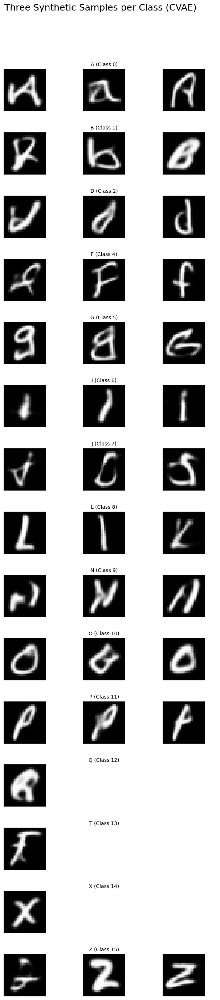

In [ ]:
# ========== Stack Synthetic Data ========== #
X_synthetic = np.vstack(synthetic_images)
y_synthetic = np.concatenate(synthetic_labels)

# ========== Map Re-labelled Index to Original Character ========== #
selected_labels = [1, 2, 4, 5, 6, 7, 9, 10, 12, 14, 15, 16, 17, 20, 24, 26]
index_to_label = {i: label for i, label in enumerate(selected_labels)}

# ========== Plot of Synthetic Data ========== #
num_classes = len(np.unique(y_synthetic))
samples_per_class = 3

fig, axes = plt.subplots(num_classes, samples_per_class, figsize=(8, num_classes * 2))

for row_idx, label in enumerate(sorted(np.unique(y_synthetic))):
    matching_indices = np.where(y_synthetic == label)[0]

    for col_idx in range(samples_per_class):
        ax = axes[row_idx, col_idx]
        ax.axis('off')

        if col_idx < len(matching_indices):
            sample_idx = matching_indices[col_idx]
            image = X_synthetic[sample_idx]
            ax.imshow(image.squeeze(), cmap='gray')

        if col_idx == 1:
            original_label = index_to_label[label]
            char = chr(64 + original_label)
            ax.set_title(f"{char} (Class {label})", fontsize=10)

# ========== Display Plot ========== #
fig.suptitle("Three Synthetic Samples per Class (CVAE)", fontsize=18, y=1.02)
plt.subplots_adjust(top=0.96, hspace=0.5)
plt.show()

With reference to the output of the Visualisation of the Synthetic Data above, we are able to see that the Synthetic Data are generally well generated. However, there are a few 'odd-looking' images but these images are minimal and will most likely not affect the training of the GAN. We are also able to observe that each class has at least 1 Synthetic Data with exception of the highest count class. With these observation, we will proceed to Stack the Synthetic Data with the Training Data to address the Class Imbalance.

---
#### 3.2.1.8 Data Stacking

In this sub-section, we will be conducting the Data Stacking operation for our Training Data. We will be combining the Synthetic Data and the Actual EMNIST Data which will subsequently address the Class Imbalance. Afterwards, we will once again Visualise the Class Distribution to verify that there is no longer any Class Imbalance within our Training Data. The Data Stacking will be done in the Code Cell below.

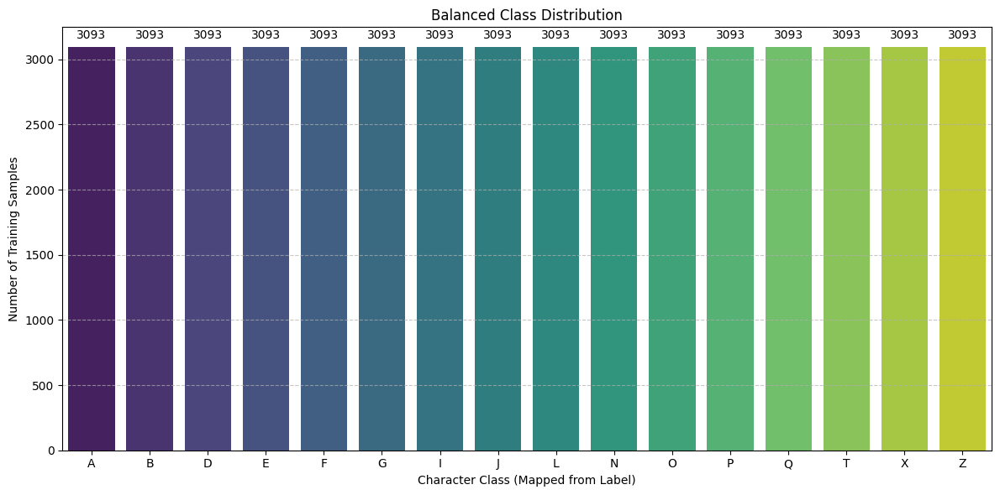

In [ ]:
# ========== Overwrite Training Data with Balanced Data ========== #
X_train = np.vstack([X_train, X_synthetic])
y_train = np.concatenate([y_train, y_synthetic])

# ========== One-Hot Encode ========== #
y_cat_train = to_categorical(y_train, num_classes=16)

# ========== Calculate Label Distribution ========== #
label_counts = pd.Series(y_train).value_counts().sort_index()

# ========== Map to EMNIST Dataset ========== #
selected_labels = [1, 2, 4, 5, 6, 7, 9, 10, 12, 14, 15, 16, 17, 20, 24, 26]
label_to_letter = {i: chr(64 + selected_labels[i]) for i in range(len(selected_labels))}

# ========== Map Index to Letters ========== #
letters = [label_to_letter[label] for label in label_counts.index]
counts = label_counts.values

# ========== Plot Class Distribution ========== #
plt.figure(figsize=(12, 6))
ax = sns.barplot(x=letters, y=counts, hue=letters, palette="viridis", dodge=False, legend=False)

# ========== Annotate Count Above Each Bar ========== #
for i, count in enumerate(counts):
    ax.text(i, count + 50, str(count), ha='center', va='bottom', fontsize=10)

# ========== Display Plot ========== #
plt.xlabel("Character Class (Mapped from Label)")
plt.ylabel("Number of Training Samples")
plt.title("Balanced Class Distribution")
plt.grid(axis="y", linestyle="--", alpha=0.7)
plt.tight_layout()
plt.show()

With reference to the output of the Updated Class Distribution, we are able to observe that all the classes have now been balanced at around 3000 Data per class. This implies that the Conditional VAE have successfully created Synthetic Data and we are ready to continue with the next Exploratory Data Analysis.

---
## 3.3 Visualising Sample Validation Images

In this sub-section, we will be visualising a Sample Image for each of the class in the provided MNIST Dataset. This will allow us to have a confirmation on whether the Data Cleaning processes done of the Training EMNIST Data have been also executed on the Validation Data. The visualisation will be conducted for the Validation Data in the Code Cell below.

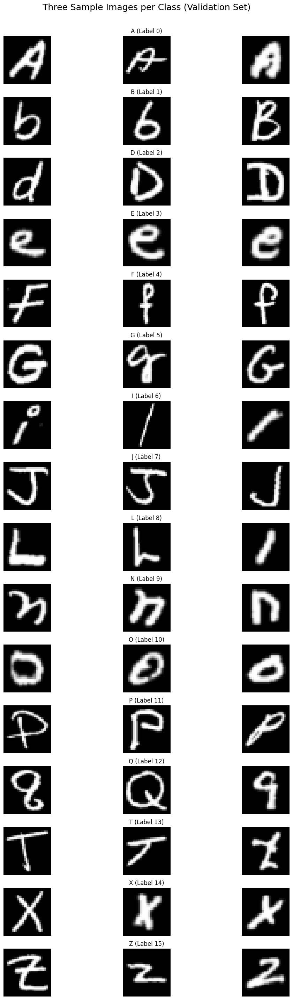

In [ ]:
# ========== Map Label to Letter ========== #
index_to_letter = {
    0: 'A', 1: 'B', 2: 'D', 3: 'E',
    4: 'F', 5: 'G', 6: 'I', 7: 'J',
    8: 'L', 9: 'N', 10: 'O', 11: 'P',
    12: 'Q', 13: 'T', 14: 'X', 15: 'Z'
}

# ========== Plot of Validation Data ========== #
plt.figure(figsize=(12, 28))
for row_idx, label in enumerate(sorted(np.unique(y_val))):
    matching_indices = np.where(y_val == label)[0]
    for col_idx in range(3):
        if col_idx >= len(matching_indices):
            continue
        sample_idx = matching_indices[col_idx]
        image = X_val[sample_idx]
        plt.subplot(len(np.unique(y_val)), 3, row_idx * 3 + col_idx + 1)
        plt.imshow(image.squeeze(), cmap='gray')
        if col_idx == 1:
            char = index_to_letter.get(label, "Unknown")
            plt.title(f"{char} (Label {label})")
        plt.axis('off')

# ========== Display Plot ========== #
plt.tight_layout()
plt.suptitle("Three Sample Images per Class (Validation Set)", fontsize=18, y=1.02)
plt.show()

With reference to the output above, we are able to confirm that the Validation Dataset is in the correct orientation and all the classes are present.

---
## 3.4 Visualising Class Distribution for Validation Set

In this sub-section, we will be visualising the Class Distribution for each of the classes in the Validation Set to determine if there are any significant Class Imbalance. However, unless the Class Imbalance is Extremely Significant, we will not address the Class Imbalance as the Validation Data does not directly impact the GAN / VAE Training except for the metrics. We will be conducting the observation in the Code Cell below.

/tmp/ipython-input-2489561413.py:14: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  barplot = sns.barplot(x=val_letters, y=val_label_counts.values, palette='mako')


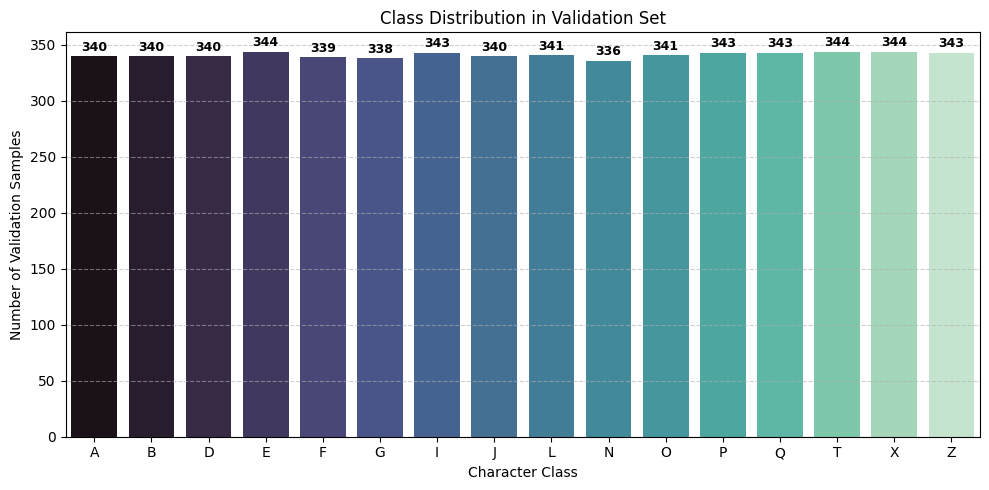

In [ ]:
# ========== Map Label to Letter ========== #
index_to_letter = {
    0: 'A', 1: 'B', 2: 'D', 3: 'E',
    4: 'F', 5: 'G', 6: 'I', 7: 'J',
    8: 'L', 9: 'N', 10: 'O', 11: 'P',
    12: 'Q', 13: 'T', 14: 'X', 15: 'Z'
}

# ========== Validation Class Histogram ========== #
val_label_counts = pd.Series(y_val).value_counts().sort_index()
val_letters = [index_to_letter[i] for i in val_label_counts.index]

plt.figure(figsize=(10, 5))
barplot = sns.barplot(x=val_letters, y=val_label_counts.values, palette='mako')

# ===== Add Value Labels Above Each Bar ===== #
for idx, val in enumerate(val_label_counts.values):
    barplot.text(idx, val + 2, str(val), ha='center', va='bottom', fontsize=9, fontweight='bold')

# ========== Display Plot ========== #
plt.xlabel("Character Class")
plt.ylabel("Number of Validation Samples")
plt.title("Class Distribution in Validation Set")
plt.grid(axis='y', linestyle='--', alpha=0.6)
plt.tight_layout()
plt.show()

With reference to the output above, we are able to observe that there is indeed Class Imbalance within the Validation Dataset. However, these imbalance only deviate from the highest value by a small margin and does not neccesarily imply it will have a negative impact on the Training of the GAN / VAE. Addressing the Class Imbalance will also most likely cause more negative than positive side effects as Synthetic Data is not Genuine Data and will most likely cause a inaccurate Loss count. Therefore, the Class Imbalance will not be addressed in the Validation Data.

---
## 3.5 Visualising Sample Training Images (Augmented Data)

In this sub-section, we will be visualising a Sample Image for each of the class in the provided MNIST Dataset that are in the Training Set and with Augmentation applied. This will allow us to have a confirmation on whether the Augmentation using the Image Data Generator has any effects on the Training Images and also to confirm that the Data Cleaning process applied to the Non-Augmented Training Data have been successfully applied here too. The visualisation will be conducted for the Non-Augmented Training Data first in the Code Cell below.

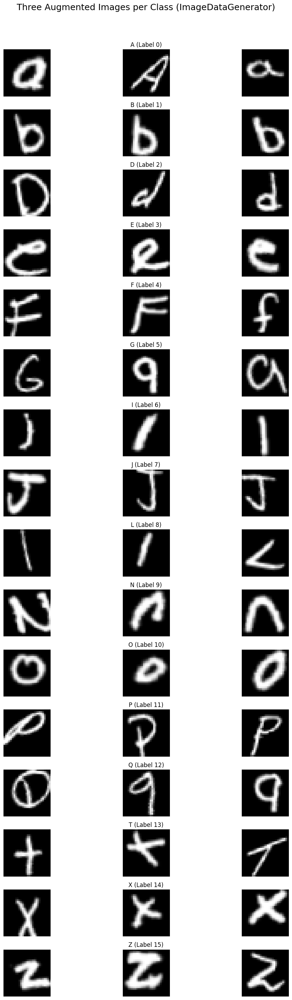

In [ ]:
# ========== Define Augmentation Generator ========== #
datagen = ImageDataGenerator(
    rotation_range=15,
    width_shift_range=0.1,
    height_shift_range=0.1,
    shear_range=10,
    zoom_range=0.1
)

# ========== Prepare 3 Images per Class ========== #
per_class_images = []
per_class_labels = []

for class_label in range(16):
    indices = np.where(y_train == class_label)[0][:3]
    per_class_images.append(X_train[indices])
    per_class_labels.extend([class_label] * len(indices))

X_vis = np.vstack(per_class_images)

# ========== Generate Augmented Images ========== #
aug_iter = datagen.flow(X_vis, batch_size=len(X_vis), shuffle=False)
augmented_images = next(aug_iter)

# ========== Define Label Mapping ========== #
index_to_letter = {
    0: 'A', 1: 'B', 2: 'D', 3: 'E',
    4: 'F', 5: 'G', 6: 'I', 7: 'J',
    8: 'L', 9: 'N', 10: 'O', 11: 'P',
    12: 'Q', 13: 'T', 14: 'X', 15: 'Z'
}

# ========== Plot Augmented Images ========== #
plt.figure(figsize=(12, 28))

for row_idx, class_label in enumerate(range(16)):
    matching_indices = [i for i, lbl in enumerate(per_class_labels) if lbl == class_label]
    for col_idx, sample_idx in enumerate(matching_indices):
        plt.subplot(16, 3, row_idx * 3 + col_idx + 1)
        plt.imshow(augmented_images[sample_idx].squeeze(), cmap='gray')
        if col_idx == 1:
            char = index_to_letter[class_label]
            plt.title(f"{char} (Label {class_label})")
        plt.axis('off')

# ========== Display Plot ========== #
plt.suptitle("Three Augmented Images per Class (ImageDataGenerator)", fontsize=18, y=1.02)
plt.tight_layout()
plt.show()

With reference to the output of the visualisation above, we are able to confirm that the Sample Images does show signs of Augmentation such as rotation and zoom. We are also able to verify that the Labels are correct with reference to the Re-Labelling operation done beforehand.

---
## 3.6 Visualising Average Image Heatmap Per Class

In this sub-section, we will be visualising the Average Image Heatmap for each of the EMNIST Classes provided. This will show us the general image of each classes and also the potential deviation that each class may have between Capital Letters and Small Letters. We will also be able to evaluate the clarity of each EMNIST Class as well as try to predict which image will be clearer for the output of the GAN during the Evaluation. We will also be able to determine which classes are most likely to have the lower quality output based off this Visualisation. We will be recording the observations and conducting the Visualisation in the Code Cell below.

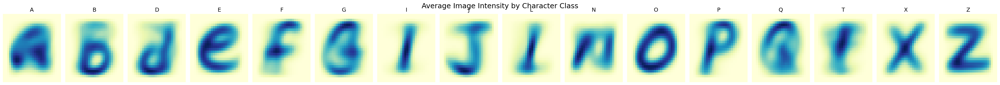

In [ ]:
# ========== Map Label to Letter ========== #
char_map = {i: chr(64 + label) for i, label in enumerate(selected_labels)}

# ========== Calculate Average Image ========== #
avg_images = []
char_labels = []

for label in sorted(np.unique(y_train)):
    imgs = X_train[y_train == label]
    avg_img = imgs.mean(axis=0).squeeze()
    avg_images.append(avg_img)
    char_labels.append(char_map[label])

# ========== Form 2D Matrix ========== #
avg_stack = np.stack(avg_images)

# ========== Plot Heat Map ========== #
fig, axes = plt.subplots(nrows=1, ncols=len(char_labels), figsize=(2.2 * len(char_labels), 3))

for i, ax in enumerate(axes):
    sns.heatmap(avg_stack[i], ax=ax, cmap="YlGnBu", cbar=False)
    ax.set_title(char_labels[i], fontsize=14)
    ax.axis('off')

# ========== Display Plot ========== #
fig.suptitle("Average Image Intensity by Character Class", fontsize=18)
plt.tight_layout()
plt.subplots_adjust(top=0.85)
plt.show()

With reference to the output above, we are able to make the following observations:

**A**

- Very Rounded Loop at the Bottom Left which Resembles Lowercase 'a'.

- Mildly Ambiguous and Capital 'A' Not Present.

- Moderate GAN Clarity Expected.

**B**

- Strong Looped Structure.

- Clear Distinction Between Upper and Lower Loops.

- High-Level GAN Clarity Expected.

**D**

- Straight Vertical Stem with a Rightward Loop, Resembling Lowercase 'd'.

- Well-defined Shape and Moderate Deviation Between Forms.

- Moderate GAN Clarity Expected.

**E**

- Very round, Resembling Lowercase 'e'.

- Compact Structure and Very Blurred in the Center.

- Low-Level GAN Clarity Expected.

**F**

- Straight Upper Bar with a Descending Curve, Likely Lowercase 'f'.

- Good Vertical Alignment and Form is Distinct.

- High-Level GAN Clarity Expected.

**G**

- Hybrid of Uppercase 'G' and Lowercase 'g'.

- Some Ambiguity in the Loop; Mildly Unclear.

- Moderate GAN Clarity Expected.

**I**

- Very Thin Vertical Stroke, Likely Both Capital 'I' and Lowercase 'i'.

- Lacks Defining Horizontal Bars of Uppercase 'I'.

- High Confusion Risk, May Yield Low GAN Clarity.

**J**

- Clear Hook Shape at the Bottom which Resembles Lowercase 'j'.

- Loop On Top Suggests Good Variation Learning.

- High-Level GAN Clarity Expected.

**L**

- Slight Hook at Bottom and Vertical Stem, Most Likely Lowercase 'l'.

- Capital L Features not Strongly Present.

- Good Clarity but Possible Confusion with I.

**N**

- Highly Angular which Looks Like Uppercase 'N' Merged with Lowercase 'n'.

- Moderate Consistency and Decent Top-to-bottom Intensity.

- Moderate GAN Clarity Expected.

**O**

- Perfectly Rounded Loop and Very Symmetric.

- Most Visually Uniform and Clean Class.

- High-Level GAN Clarity Expected.

**P**

- Strong Vertical Stem with Distinct Loop.

- No Distinction Uppercase and Lowercase.

- High-Level GAN Clarity Expected.

**Q**

- Slight Tail on Bottom-right and Loop Resembles 'a' / 'g'.

- Lowercase 'q' Effect Visible.

- Moderate GAN Clarity Expected.

**T**

- Crossbar Visible and Vertical Stroke Consistent.

- Balanced Between Uppercase and Lowercase Styles.

- Likely Strong GAN Clarity.

**X**

- Very Symmetric and Clean.

- Distinct Cross Structure.

- High-Level GAN Clarity Expected.

**Z**

- Angular zigzag pattern; well-defined.

- Extremely Consistent Shape.

- High-Level GAN Clarity Expected.

With the observations and implications indicated above, we will proceed to the next Exploratory Data Analysis and Visualisation in the next sub-section.

---
## 3.7 Visualising Pixel-wise Variance Heatmap

In this sub-section, we will be Visualising the Pixel-wise Variance using a Heatmap. Through this visualisation, we will be able to observe the various regions, mainly the bright and dark regions across the Training Samples. This will assist us in indentifying which parts of the Image are Key Features for the GAN to learn from. The Visualisation will be done in the Code Cell below.

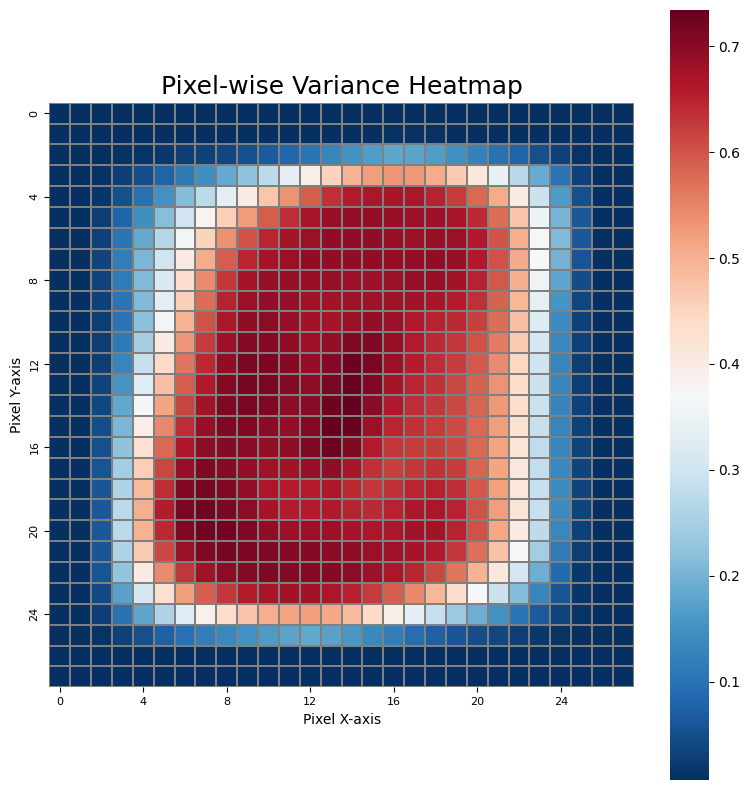

In [ ]:
# ========== Compute Pixel-wise Variance  ========== #
pixel_var = np.var(X_train, axis=0).squeeze()

# ========== Plot Variance Heatmap ========== #
plt.figure(figsize=(8, 8))
ax = sns.heatmap(
    pixel_var,
    cmap="RdBu_r",
    cbar=True,
    square=True,
    xticklabels=4,
    yticklabels=4,
    linewidths=0.3,
    linecolor='gray'
)

# ========== Display Plot ========== #
plt.title("Pixel-wise Variance Heatmap", fontsize=18)
plt.xlabel("Pixel X-axis")
plt.ylabel("Pixel Y-axis")
plt.xticks(fontsize=8)
plt.yticks(fontsize=8)
plt.axis('on')
plt.tight_layout()
plt.show()

With reference to the output of the Visualisation in the Code Cell above, we are able to make the following observations:

**High Variance in Central Region**
- The Central Pixel Area (~8-20 on Both Axes) Exhibits the Highest Variance.

- Indicates that this is where the Majority of Handwriting Activity Occurs.

**Low Variance at Borders**
- Border Pixels (Near Edges) Show Nearly Zero Variance.

- This implies they Consistently Remain Dark and Unused Across Samples.

**Rounded High-Variance Shape**
- The Pattern of Variance Forms a Rounded Square.

- Aligns with Typical Handwriting Distribution on the EMNIST Canvas.

**Potential Character Stroke Zones**
- Areas of High Variance Likely Correspond to where Letter Strokes Begin.

**Consistency Across Classes**
- Despite Class Diversity, Aggregated Variance Heatmap Suggests a Consistent Writing Region Across All EMNIST Characters.

With the observations from the Visualisation indicated above, we will proceed with conducting the next Exploratory Data Analysis / Visualisation in the next sub-section.

---
## 3.8 Heatmap Visualisation Between Class Correlation

In this sub-section, we will be Visualising a Heatmap to see the Class Correlation between the various Classes. This will allow us to foresee potential mix up between certain Classes and also give us the ability to justify why these mix-ups may occur. Subsequently, we are also able to see which Classes will have the least mix-ups. The Visualisation will be conducted in the Code Cell below.

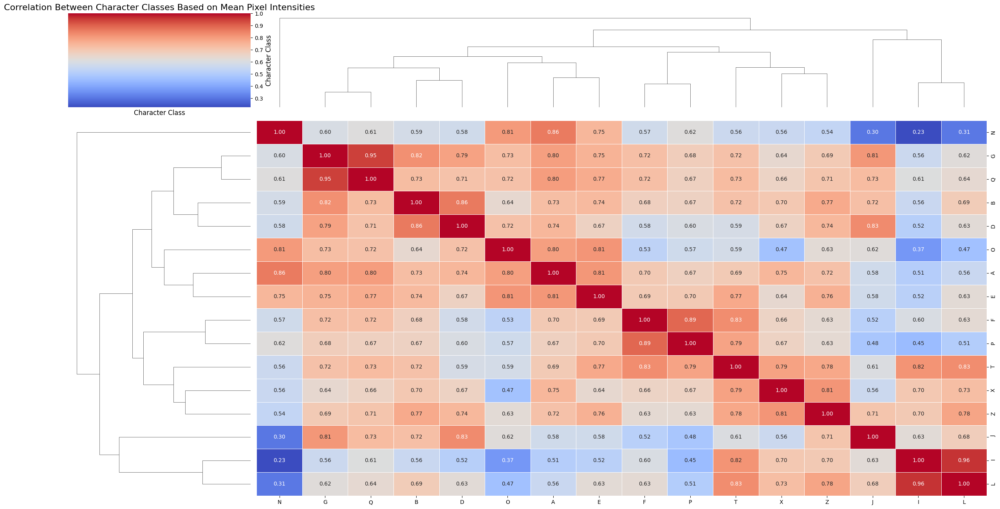

In [ ]:
# ========== Flatten Image ========== #
flat_images = X_train.reshape(len(X_train), -1)
df_flat = pd.DataFrame(flat_images)
df_flat['label'] = y_train

# ========== Compute Mean Pixel Intensity per Class ========== #
char_mean_vectors = df_flat.groupby('label').mean()

# ========== Correlation Matrix ========== #
corr_matrix = np.corrcoef(char_mean_vectors)

# ========== Extract Labels ========== #
char_labels = list(char_map.values())

# ========== Plot Heatmap Correlation ========== #
sns.clustermap(
    corr_matrix,
    cmap='coolwarm',
    xticklabels=char_labels,
    yticklabels=char_labels,
    figsize=(24, 13),
    linewidths=0.5,
    annot=True,
    fmt=".2f"
)

# ========== Display Plot ========== #
plt.title("Correlation Between Character Classes Based on Mean Pixel Intensities", fontsize=16)
plt.xlabel("Character Class", fontsize=12)
plt.ylabel("Character Class", fontsize=12)
plt.xticks(rotation=45, ha='right')
plt.yticks(rotation=0)
plt.tight_layout()
plt.show()

With reference to the output of the Heatmap Visualisation above, we are able to make the following observations:

**High Correlation Groups (Potential Mix-ups)**

- 'P', 'F', and 'E' show Very High Correlation (above 0.88), indicating these classes share Similar Structural Patterns such as Vertical Strokes and Horizontal Bars.

- 'I', 'J', and 'L' are Highly Similar (J-L: 0.96 correlation), suggesting likely confusion due to Simple Straight-line Designs.

- 'T', 'Z', and 'X' Cluster Moderately Well, likely due to Symmetrical or Cross-like Shapes.

- 'B' and 'D' exhibit Moderate Correlation (0.77), both involving Round Loops attached to Vertical Stems.

**Distinct or Low-Correlation Characters (Least Likely to be Mixed)**

- 'N' has Very Low Correlation with all other characters (as low as 0.23), indicating it has a Highly Unique Diagonal Structure and is unlikely to be Misclassified.

- 'G' and 'Q' also exhibit Low Correlation with Several Characters, showing Distinctiveness in their Looped and Tail-like Shapes.

**Surprising Pairs**

- 'A' and 'O' have Moderate Correlation (0.63), although Structurally Different, likely due to their Centralised, Rounded Bases.

- 'G' shares Moderate Similarity with C-like Shapes such as 'O' and 'Q'.

**Cluster Insights**

- The Hierarchical Clustering clearly Groups Characters based on Average Stroke Patterns, enabling Early Identification of High-Risk Confusion Clusters for Classifier Training and Evaluation.

- Some Class Pairs (e.g. I vs J, P vs F) may require Additional Augmentation or Contrastive Learning Strategies to Enhance Separation.

With the observations and implications indicated above, we will proceed to conduct the next Exploratory Data Analysis in the following sub-section.

---
## 3.9 Pixel Intensity Distribution Curve

In this sub-section, we will be visualising the Distribution of the Pixel Intensity. Through this visualisation, we will be able to determine if there are any outliers within the provided EMNIST Dataset. We will also be able to determine the various Frequency for the various Pixels of the Sample Images. The Distribution Curve will be plotted in the Code Cell below.

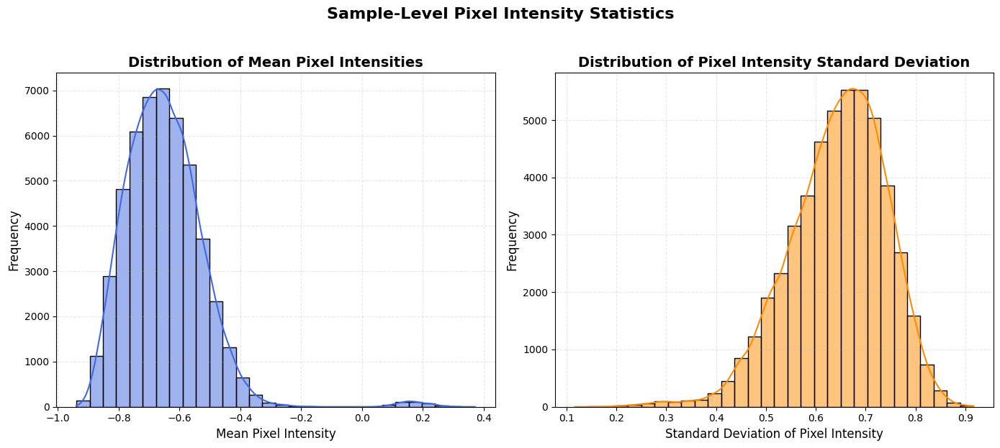

In [ ]:
# ========== Calculate Mean and Standard Deviation ========== #
means = X_train.mean(axis=(1, 2, 3))
stds = X_train.std(axis=(1, 2, 3))

plt.figure(figsize=(14, 6))

# ========== Plot Mean Pixel Intensity Distribution ========== #
plt.subplot(1, 2, 1)
sns.histplot(means, kde=True, color='royalblue', bins=30, edgecolor='black')
plt.title("Distribution of Mean Pixel Intensities", fontsize=14, weight='bold')
plt.xlabel("Mean Pixel Intensity", fontsize=12)
plt.ylabel("Frequency", fontsize=12)
plt.grid(True, linestyle='--', alpha=0.3)

# ========== Plot Standard Deviation Pixel Intensity Distribution ========== #
plt.subplot(1, 2, 2)
sns.histplot(stds, kde=True, color='darkorange', bins=30, edgecolor='black')
plt.title("Distribution of Pixel Intensity Standard Deviation", fontsize=14, weight='bold')
plt.xlabel("Standard Deviation of Pixel Intensity", fontsize=12)
plt.ylabel("Frequency", fontsize=12)
plt.grid(True, linestyle='--', alpha=0.3)

# ========== Display Plots ========== #
plt.suptitle("Sample-Level Pixel Intensity Statistics", fontsize=16, weight='bold', y=1.03)
plt.tight_layout()
plt.show()

With reference to the output above, we are able to make the following observations:

**Gaussian-like Distribution for Both Metrics**

- The mean Pixel Intensities and Standard Deviations both form Bell Curves.

- This suggests a Healthy Distribution without Extreme Outliers or Anomalies.

**Mean Intensity Clustered Around ~0.18**

- Most EMNIST samples have Low-to-moderate Overall Brightness
- Consistent with Grayscale Characters on Dark Backgrounds.

**Standard Deviation Peaks Near ~0.33**

- Indicates that the Majority of Characters show Moderate Variation in Pixel Values, Typical of Handwritten Shapes.

**No Apparent Skew or Extreme Tails**

- The Distributions are Symmetric, Indicating Good Dataset Uniformity and no need for Intensity Normalisation or Filtering.

**Good Indicator of GAN Stability**

- These Uniform Stats Imply that Models like GANs or VAEs will have a Consistent Pixel Scale to learn from, Aiding Convergence.

With the observations indicated above, we will proceed with the next Exploratory Data Analysis / Visualisation in the next sub-section.

---
## 3.10 t-SNE Projection by Character Class

In this sub-section, we will be using t-SNE to reduce the dimensions of the current Data Points, allowing us to visualise the Natural Groupings and Clusters within the provided EMNIST Dataset. We are also able to Evaluate the Class Separability and also identify the various Outliers for each class. The t-SNE Projection will be conducted in the Code Cell below.

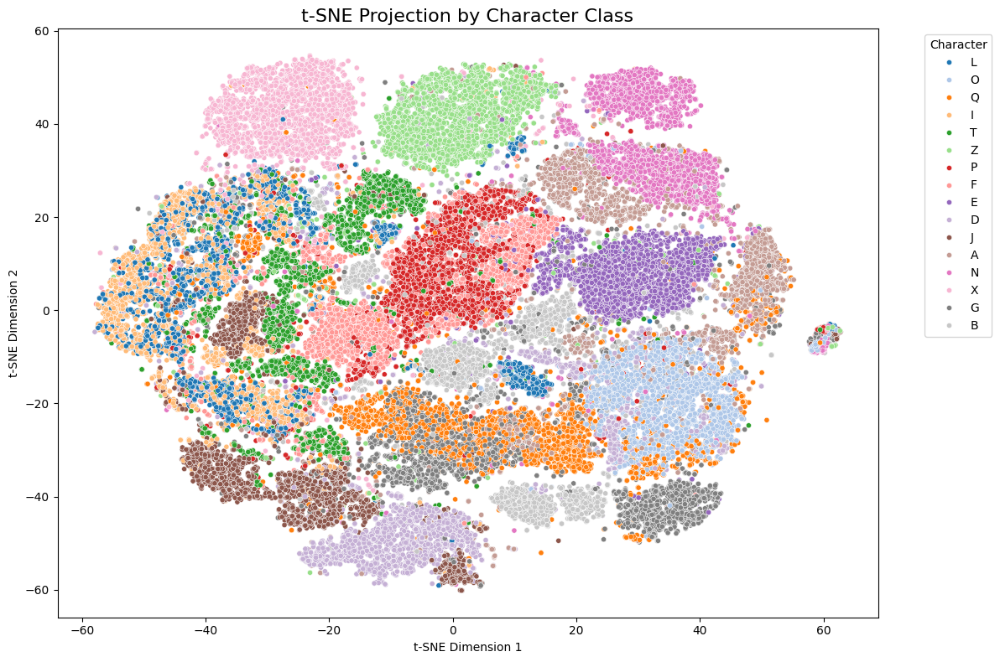

In [ ]:
# ========== Flatten Image ========== #
flat = X_train.reshape((X_train.shape[0], -1))

# ========== Apply t-SNE on Data ========== #
tsne = TSNE(n_components=2, perplexity=30, learning_rate=200, random_state=42)
X_embedded = tsne.fit_transform(flat)

# ========== Store t-SNE Data in DataFrame ========== #
df_tsne = pd.DataFrame({
    'x': X_embedded[:, 0],
    'y': X_embedded[:, 1],
    'label': y_train
})

# ========== Map Data Labels ========== #
df_tsne['char'] = df_tsne['label'].map(char_map)

# ========== Plot t-SNE Projection ========== #
plt.figure(figsize=(12, 8))
sns.scatterplot(data=df_tsne, x='x', y='y', hue='char', palette='tab20', s=20)

# ========== Display Plot ========== #
plt.title("t-SNE Projection by Character Class", fontsize=16)
plt.xlabel("t-SNE Dimension 1")
plt.ylabel("t-SNE Dimension 2")
plt.legend(title='Character', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

With reference to the output of the visualisation of the t-SNE Visualisation, we are capable to make the following observations:

**Strong Clustering**

- Letters like 'A', 'Z', 'X', 'N', 'P', 'D', and 'E' form Tight and Distinct Clusters, indicating Consistent Handwriting Patterns and Clear Separability.

- These Classes are Less Likely to be Misclassified.

**Moderate Overlap**

- 'B', 'Q', 'O', and 'G' share Visual Space with Several Clusters.

- These Characters often have Rounded Shapes, leading to Higher Confusion.

- Clusters like 'O' / 'Q' and 'B' / 'G' tend to Merge, Indicating Potential Misclassification Risk.

**High Dispersion**

- The Class 'I' is Highly Scattered, likely due to Variations in how people write 'I' (some as a Single Line, others with Serifs or Curves).

- This class may be harder to model.

**Unexpected Proximity**

- Some classes like 'F' and 'T' show Unexpected Adjacency, which may Reflect Stylistic Similarities in some Handwriting Samples.

**Character Shape Dominance**

- The Embedding seems to group letters by Shape (e.g. curved vs. straight).

- This suggest that t-SNE captured Semantic Pixel-level Similarities.

---
# 4. GAN Model Training for Non-Augmented EMNIST Data

In this section, we will be training various Generative Adversarial Network (GAN) Models from scratch. Subsequently, we will compare all the GAN Models against each other to obtain the Best Model which will subsequently be used to compare to the EMNIST Training Data with Augmentation. Subsequently, we will perform further comparison and analysis with the best GAN Model.

---
## 4.1 Vanilla GAN Model Training

In this sub-section, we will be training a Vanilla GAN for the EMNIST Dataset. The Vanilla GAN will also provide a strong and suitable baseline for the future GAN Models that we will be training. Due to the Simplicity of Vanilla GAN, it will most likely be able to handle the EMNIST Dataset well. A Vanilla GAN is the most basic GAN which mainly consist of Two Neural Networks trained in opposition, namely the Generator and the Discriminator. Both of the Neural Network will compete in a 'Minimax Game' where the Generator tries to 'fool' the Discriminator with realistic generated images and the Discriminator tries to tell apart real and generated images. The relevant formulas for the Vanilla GAN is indicated below:

---
**Minimax Objective (Vanilla GAN Loss):**

Purpose: Original Adversarial Objective where Generator $G$ tries to Fool Discriminator $D$, while $D$ tries to Distinguish Real Samples from Fake Ones.

$$
\min_G \max_D V(D, G) = \mathbb{E}_{x \sim p_{\text{data}}(x)}[\log D(x)] + \mathbb{E}_{z \sim p_z(z)}[\log (1 - D(G(z)))]
$$

Where:
- $G$ = Generator Network
- $D$ = Discriminator Network
- $x$ = Real Data Sample
- $z$ = Random Noise Vector
- $p_{\text{data}}(x)$ = Distribution of Real Data
- $p_z(z)$ = Prior Distribution of Noise (e.g., $\mathcal{N}(0, I)$)
- $D(x)$ = Probability that $x$ is Real
- $D(G(z))$ = Probability that Generated Image is Real

---
**Discriminator Loss (Optimisation Form):**

Purpose: Loss used to Train the Discriminator to Assign High Probability to Real Data and Low Probability to Fake Data.

$$
L_D = -\mathbb{E}_{x \sim p_{\text{data}}(x)}[\log D(x)] - \mathbb{E}_{z \sim p_z(z)}[\log (1 - D(G(z)))]
$$

Where:
- $L_D$ = Discriminator Loss
- First Term Penalises Misclassifying Real Data as Fake
- Second Term Penalises Misclassifying Fake Data as Real

---
**Generator Loss (Original Formulation):**

Purpose: Commonly used in Practice due to Stronger Gradients to Generator, helping it Train more Effectively when Discriminator is Performing Well.


$$
L_G = \mathbb{E}_{z \sim p_z(z)}[\log (1 - D(G(z)))]
$$

Where:
- $L_G$ = Generator Loss
- $G$ = Generator Network
- $D$ = Discriminator Network

---
**Noise Vector Sampling:**

Purpose: The Generator takes a Random Noise Vector $z$ from a Known Distribution as Input and Transforms it into a Realistic Image.

$$
z \sim \mathcal{N}(0, I) \quad \text{or} \quad z \sim U(-1, 1)
$$

Where:
- $z$ = Latent Noise Vector Sampled from Standard Normal or Uniform Distribution
- $G(z)$ = Generator Transforms $z$ into Synthetic Image

---
With the relevant mathematical formulas indicated above, we will proceed to train the Vanilla GAN in this sub-section for the purpose of it's simplicity and also to serve as a Baseline for our other GAN Models.

---
### 4.1.1 Defining Data Pre-Processing Function

In this sub-section, we will be defining the Data Pre-Processing Function which will allow for consistent Data Pipeline to be built and modifed accordingly should the need arise such as when we need to add Spectral Normalisation. This will ensure that the Data's integrity is not affected and we are able to make fair and un-biased assumptions. The Data Pre-Processing Function is defined in the Code Cell below:

In [ ]:
# ========== Date Pre-Processing Function ========== #
def load_data():
    global X_train

    batch_size = 32
    buffer_size = X_train.shape[0]

    dataset = tf.data.Dataset.from_tensor_slices(X_train)
    dataset = dataset.shuffle(buffer_size).batch(batch_size).prefetch(tf.data.AUTOTUNE)

    return dataset

With reference to the Code Cell above, we are able to determine that the Data Pre-Processing Function have been defined successfully and we are able to move on to Defining Callback Functions in the next sub-section.

---
### 4.1.2 Defining Callback Functions

In this sub-section, we will be pre-defining the various Callbacks. This is to ensure consistency throughout the model and also to increase the GAN Accuracy and optimise the Computation Cost for training each GAN Model. These Callbacks will be main used during the GAN Training in the next sub-section. The formulas and logic for these Callbacks are indicated below:

---
**Learning Rate Scheduler:**

Purpose: Reduces Learning Rate During Training to Fine-tune Model Convergence.

$$\text{If } epoch \mod 10 = 0 \Rightarrow \eta_{new} = \frac{1}{2} \cdot \eta$$

Where:

- $\eta$ = current learning rate

- $\eta_{\text{new}}$ = updated learning rate

- $epoch \bmod 10$ checks if the epoch is a multiple of 10

---
**ReduceLROnPlateau:**

Purpose: Automatically Reduces the Learning Rate when Validation Performance Plateaus.

$$
\text{If no improvement in } val\_loss \text{ for 10 epochs: } \eta_{\text{new}} = 0.5 \cdot \eta
$$

Where:

- $\eta_{\text{new}}$ = reduced learning rate

---
**EarlyStopping:**

Purpose: Prevents Wastage of Computational Power if Model Does Not Improve.

$$
\text{If } val\_loss \text{ does not improve for 25 epochs, stop training and restore best weights}
$$

---
With the formulas and Various Callbacks listed, we will proceed to Define the Callbacks in the Code Cell below in preparation for the GAN Model Training.

In [ ]:
# ========== Define Learning Rate Scheduler ========== #
lr_scheduler = LearningRateScheduler(
    lambda epoch, lr: lr * 0.95 if epoch % 10 == 0 else lr,
    verbose=1
)

# ========== Define Reduce Learning Rate on Plateau ========== #
reduce_lr = ReduceLROnPlateau(
    monitor='loss',
    factor=0.5,
    patience=10,
    verbose=1,
    min_lr=1e-6
)

# ========== Define Early Stopping ========== #
early_stop = EarlyStopping(
    monitor='loss',
    patience=25,
    verbose=1,
    restore_best_weights=False
)

# ========== Define Generated Image ========== #
def display_generated_images(generator, latent_dim, n=7):
    noise = tf.random.normal([n * n, latent_dim])
    generated_images = generator(noise, training=False)

    # Rescale from [-1, 1] to [0, 1] if using tanh
    generated_images = (generated_images + 1.0) / 2.0

    fig, axes = plt.subplots(n, n, figsize=(n, n))
    for i in range(n):
        for j in range(n):
            img = generated_images[i * n + j, :, :, 0]
            axes[i, j].imshow(img, cmap='gray')
            axes[i, j].axis('off')

    plt.tight_layout()
    plt.show()

# ========== Define FID Calculator ========== #
_inception_model = InceptionV3(
    include_top=False,
    pooling='avg',
    input_shape=(299,299,3)
)

def calculate_fid(real_images, fake_images, batch_size=10):

    # ----- Scale to [0,255] and Resize to 299×299 ----- #
    real = (real_images + 1.0) * 127.5
    fake = (fake_images + 1.0) * 127.5
    real = tf.image.resize(real, (299,299))
    fake = tf.image.resize(fake, (299,299))

    # ----- If Grayscale, Convert to RGB ----- #
    if real.shape[-1] == 1:
        real = tf.image.grayscale_to_rgb(real)
        fake = tf.image.grayscale_to_rgb(fake)

    # ----- Preprocess for Inception (–1 to +1) ----- #
    real_pp = preprocess_input(real)
    fake_pp = preprocess_input(fake)

    # ----- Extract Features in Batches ----- #
    def _get_acts(x):
        acts = []
        n = x.shape[0]
        for i in range(0, n, batch_size):
            chunk = x[i:i+batch_size]
            acts.append(_inception_model(chunk, training=False).numpy())
        return np.vstack(acts)

    act_real = _get_acts(real_pp)
    act_fake = _get_acts(fake_pp)

    # ----- Compute Statistics ----- #
    mu1, sigma1 = act_real.mean(axis=0), np.cov(act_real, rowvar=False)
    mu2, sigma2 = act_fake.mean(axis=0), np.cov(act_fake, rowvar=False)
    diff    = mu1 - mu2
    covmean = sqrtm(sigma1.dot(sigma2))
    if np.iscomplexobj(covmean):
        covmean = covmean.real
    fid = diff.dot(diff) + np.trace(sigma1 + sigma2 - 2*covmean)
    return float(np.round(fid,4))

# ========== Confirmation Message ========== #
print("Callbacks Defined Successfully")

87910968/87910968 ━━━━━━━━━━━━━━━━━━━━ 3s 0us/step
Callbacks Defined Successfully


With reference to the Code Cell above, we are able to verify that that the Callbacks have been successfully defined and the various parameters are set so as to ensure a High Accuracy and Computing Efficient GAN Model Training.

---
### 4.1.3 Defining Vanilla GAN Generator Architecture

In this section, we will be defining the Vanilla GAN's Generator Architecture. The Generator will be trying to make realistic generated images in the attempt to bypass the Discriminator. Subsequently, the generated images from the Generator will be evaluated based on a few evaluation metrics such as Inception Score. The relevent mathematical formulas for the Loss Function of the Vanilla GAN Generator is indicated below:

---

**Generator Loss Formula**

Purpose: Non-saturating Generator Loss encouraging Generator $G$ to Produce Outputs $G(z)$ that Discriminator $D$ Classifies as Real (i.e., closer to 1).

$$
L_G = -\mathbb{E}_{z \sim p_z(z)}[\log D(G(z))]
$$

Where:
- $L_G$ = Generator Loss  
- $z$ = Latent Vector Drawn from Noise Distribution $p_z(z)$ (e.g. Normal or Uniform)  
- $G(z)$ = Generated Fake Image from Noise  
- $D(G(z))$ = Probability Assigned by the Discriminator that the Generated Image is Real  
- $\log D(G(z))$ = Log-likelihood that Fake Image is Considered Real
---
With the relevant Generator Loss Formula indicated above, we will proceed to define the GAN Generator's Architecture in the Code Cell below and the Lost Function.

In [ ]:
# ========== Generator Function ========== #
def build_generator(latent_dim=100, units=256, output_shape=(28, 28, 1)):
    model = tf.keras.Sequential(name="generator")

    model.add(tf.keras.layers.Dense(units, activation='relu', input_dim=latent_dim))
    model.add(tf.keras.layers.BatchNormalization())

    model.add(tf.keras.layers.Dense(units * 2, activation='relu'))
    model.add(tf.keras.layers.BatchNormalization())

    model.add(tf.keras.layers.Dense(np.prod(output_shape), activation='tanh'))
    model.add(tf.keras.layers.Reshape(output_shape))

    return model

# ========== Initialise Loss ========== #
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=False)

# ========== Generator Loss Function ========== #
def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output), fake_output)

With reference to the Code Cell above, we are able to verify that the GAN's Generator Architecture have been successfully defined and we are able to proceed to define the GAN's Discriminator Architecture.

---
### 4.1.4 Defining Vanilla GAN Discriminator Architecture

In this section, we will be defining the Architecture of the Discriminator of the GAN. The Discriminator will be the Neural Network that will attempt to tell the Generated Images apart from the Actual Images. This will allow the GAN to improve overtime and also improve itself overtime. The mathematical function for the Discriminator Loss Function is indicated below:

---

Purpose: Train Discriminator $D$ to Distinguish between Real and Fake Samples, Rewarding High Confidence in Real Images ($D(x) \to 1$) and Low Confidence in Fake Ones ($D(G(z)) \to 0$).

$$
L_D = -\mathbb{E}_{x \sim p_{\text{data}}(x)}[\log D(x)] - \mathbb{E}_{z \sim p_z(z)}[\log (1 - D(G(z)))]
$$

Where:
- $L_D$ = Discriminator Loss  
- $x$ = Real Image Sampled from the Dataset Distribution $p_{\text{data}}(x)$  
- $z$ = Latent Vector from Prior Noise Distribution $p_z(z)$  
- $G(z)$ = Fake Image Generated by $G$
- $D(x)$ = Discriminator's Predicted Probability that $x$ is Real  
- $D(G(z))$ = Discriminator's Predicted Probability that $G(z)$ is Real  
- $\log D(x)$ = Log-likelihood that Real Image is Correctly Classified  
- $\log(1 - D(G(z)))$ = Log-likelihood that Fake Image is Correctly Rejected
---
With the mathematical formula for the Loss Function indicated above, we will proceed to define the GAN's Discriminator Architecture and the Loss Function in the Code Cell below.

In [ ]:
# ========== Discriminator Function ========== #
def build_discriminator(input_shape=(28, 28, 1), units=256):
    model = tf.keras.Sequential(name="discriminator")

    model.add(tf.keras.layers.Flatten(input_shape=input_shape))

    model.add(tf.keras.layers.Dense(units))
    model.add(tf.keras.layers.LeakyReLU(alpha=0.2))

    model.add(tf.keras.layers.Dense(units // 2))
    model.add(tf.keras.layers.LeakyReLU(alpha=0.2))

    model.add(tf.keras.layers.Dense(1, activation='sigmoid'))

    return model

# ========== Discriminator Loss Function ========== #
def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    return real_loss + fake_loss

With reference to the Code Cell above, we are able to verify that the GAN's Discriminator Architecture have been successfully defined and we are able to proceed to define the GAN's Training Steps.

---
### 4.1.5 Defining Training Step

In this section, we will be Defining the Training Step function so as to train both the Generator and the Discriminator at the same time. The Training Step will compute the gradients for both the Generator and the Discriminator at the same time. The relevant mathematical formulas for the Training Step is indicated below:

---
**Generator Loss:**

Purpose: Encourages the Generator to Create Samples that the Discriminator believes are Real.

$$
L_G = -\mathbb{E}_{z \sim p_z(z)}[\log D(G(z))]
$$

Where:
- $L_G$ = Generator Loss  
- $z$ = Latent Noise Vector Sampled from Prior Distribution $p_z(z)$  
- $G(z)$ = Fake Image Generated from $z$  
- $D(G(z))$ = Discriminator's Probability that the Generated Image is Real
---

Purpose: Train Discriminator $D$ to Distinguish between Real and Fake Samples, Rewarding High Confidence in Real Images ($D(x) \to 1$) and Low Confidence in Fake Ones ($D(G(z)) \to 0$).

$$
L_D = -\mathbb{E}_{x \sim p_{\text{data}}(x)}[\log D(x)] - \mathbb{E}_{z \sim p_z(z)}[\log (1 - D(G(z)))]
$$

Where:
- $L_D$ = Discriminator Loss  
- $x$ = Real Image Sampled from the Dataset Distribution $p_{\text{data}}(x)$  
- $z$ = Latent Vector from Prior Noise Distribution $p_z(z)$  
- $G(z)$ = Fake Image Generated by $G$
- $D(x)$ = Discriminator's Predicted Probability that $x$ is Real  
- $D(G(z))$ = Discriminator's Predicted Probability that $G(z)$ is Real  
- $\log D(x)$ = Log-likelihood that Real Image is Correctly Classified  
- $\log(1 - D(G(z)))$ = Log-likelihood that Fake Image is Correctly Rejected
---

**Gradient Update:**

Purpose: Updates the Generator and Discriminator Parameters using Gradient Descent.

$$
\theta_G \leftarrow \theta_G - \eta \cdot \nabla_{\theta_G} L_G \\
\theta_D \leftarrow \theta_D - \eta \cdot \nabla_{\theta_D} L_D
$$

Where:
- $\theta_G$ = Generator Parameters  
- $\theta_D$ = Discriminator Parameters  
- $\eta$ = Learning Rate  
- $\nabla_{\theta} L$ = Gradient of Loss with Respect to Model Weights
---

With the relevant mathematical formulas indicated above, we will proceed to define the Training Step in the Code Cell below.

In [ ]:
# ========== Train Step Function ========== #
@tf.function
def train_step(real_images, generator, discriminator, gen_optimizer, disc_optimizer, latent_dim):
    batch_size = tf.shape(real_images)[0]
    noise = tf.random.normal([batch_size, latent_dim])

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        # ----- Forward Pass ----- #
        generated_images = generator(noise, training=True)

        real_output = discriminator(real_images, training=True)
        fake_output = discriminator(generated_images, training=True)

        # ----- Compute Losses ----- #
        gen_loss = generator_loss(fake_output)
        disc_loss = discriminator_loss(real_output, fake_output)

    # ----- Compute Gradients ----- #
    gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

    # ----- Apply Gradients ----- #
    gen_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    disc_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))

    return gen_loss, disc_loss

With reference to the Code Cell above, we are able to determine that the Training Step have been successfully defined and we are able to proceed to prepare the Training Loop in the next section.

---
### 4.1.6 Defining Training Loop

In this section, we will be defining the Training Loop for the GAN Training. The Training Loop will go through each of the Epoch and train both the Generator and Discriminator simultaneously. The Training Loop will also track the Loss for both the Generator and the Discriminator for each of the Epoch trained. The relevant mathematical formulas are indicated below:

---
**Epoch Loss Averaging:**

Purpose: These are the Average Generator and Discriminator Losses over all Batches in Epoch $t$.

$$
\bar{L}_G^{(t)} = \frac{1}{N} \sum_{i=1}^{N} L_G^{(i)} \\
\bar{L}_D^{(t)} = \frac{1}{N} \sum_{i=1}^{N} L_D^{(i)}
$$

Where:
- $\bar{L}_G^{(t)}$ = Average Generator Loss at Epoch $t$  
- $\bar{L}_D^{(t)}$ = Average Discriminator Loss at Epoch $t$  
- $N$ = Number of Batches in the Dataset  
- $L_G^{(i)}$ = Generator Loss on Batch $i$  
- $L_D^{(i)}$ = Discriminator Loss on Batch $i$

---
**Epoch Iteration:**

Purpose: Describes the Training Loop Logic: for Each Epoch $t$, perform `train_step` for Every Mini-batch.

$$
\text{for } t = 1 \text{ to } T:
\quad \text{for each batch } (x^{(i)}):
\quad \text{train_step}(x^{(i)})
$$

Where:
- $T$: Total Number of Epochs  
- $x^{(i)}$: Real Batch $i$ from the Dataset  
- `train_step`: Function that Updates $G$ and $D$ using that Batch

---
**Generated Image Output:**

Purpose: Sample Random Noise $z$ and Generate Synthetic Image $\hat{x}$ from the Generator. This is used for Visual Monitoring of Model Quality.

$$
z \sim p_z(z) \\
\hat{x} = G(z)
$$

Where:
- $z$: Random Latent Vector  
- $G(z)$: Generated Image from Generator

---
With the mathematical formulas indicated above, we will proceed to define the Training Loop in the Code Cell below in preparation of the GAN Training.

In [ ]:
# ========== Training Loop Function ========== #
def train(dataset, epochs, generator, discriminator, gen_optimizer, disc_optimizer,
          latent_dim, save_path, use_early_stopping=True, steps_per_epoch=None):

    # ----- Prepare FID Reference Sets ----- #
    real_val  = tf.data.Dataset.from_tensor_slices(X_val).batch(50).take(1)
    noise_val = tf.random.uniform([50, latent_dim], minval=-1.0, maxval=1.0)
    noise_val = tf.math.l2_normalize(noise_val, axis=1)

    # ----- FID Early Stopping Settings ----- #
    best_fid    = float('inf')
    no_improve  = 0
    patience    = 10
    fid_interval = 1

    # ----- Create & Compile Dummy Model ----- #
    dummy_input  = Input(shape=(1,))
    dummy_output = Lambda(lambda x: x)(dummy_input)
    dummy_model  = Model(dummy_input, dummy_output)
    dummy_model.compile(optimizer=Adam(1e-4), loss='mse')

    # ----- Attach Dummy Model to Callbacks ----- #
    early_stop.set_model(dummy_model)
    reduce_lr.set_model(dummy_model)
    lr_scheduler.set_model(dummy_model)

    # ----- Simulate Keras Callback Start ----- #
    logs = {}
    early_stop.on_train_begin(logs=logs)
    reduce_lr.on_train_begin(logs=logs)
    lr_scheduler.on_train_begin(logs=logs)

    # ----- Initialise Loss Trackers ----- #
    gen_loss_history  = []
    disc_loss_history = []

    # ----- Begin Training Loop ----- #
    for epoch in range(1, epochs + 1):
        print(f"\nEpoch {epoch}/{epochs}")

        gen_loss_epoch  = []
        disc_loss_epoch = []

        for i, real_images in enumerate(dataset):
            if steps_per_epoch and i >= steps_per_epoch:
                break

            # ----- One step of generator & discriminator updates ----- #
            gen_loss, disc_loss = train_step(
                real_images, generator, discriminator,
                gen_optimizer, disc_optimizer, latent_dim
            )
            gen_loss_epoch.append(gen_loss)
            disc_loss_epoch.append(disc_loss)

        # ----- Epoch Statistics ----- #
        avg_gen_loss  = tf.reduce_mean(gen_loss_epoch)
        avg_disc_loss = tf.reduce_mean(disc_loss_epoch)

        print(f"Generator Loss: {avg_gen_loss:.4f} | Discriminator Loss: {avg_disc_loss:.4f}")

        # ----- Track Loss History ----- #
        gen_loss_history.append(float(avg_gen_loss))
        disc_loss_history.append(float(avg_disc_loss))

        # ----- Simulate Callback Updates on Generator Loss ----- #
        logs = {'loss': float(avg_gen_loss)}
        if use_early_stopping:
            early_stop.on_epoch_end(epoch=epoch, logs=logs)
            if early_stop.stopped_epoch > 0:
                print(f"Early stopping triggered at epoch {epoch}")
                break
        reduce_lr.on_epoch_end(epoch=epoch, logs=logs)
        lr_scheduler.on_epoch_end(epoch=epoch, logs=logs)

        # ----- FID Evaluation & Early Stopping ----- #
        if epoch % fid_interval == 0:
            fake_val   = generator(noise_val, training=False)
            real_batch = next(iter(real_val))

            real_for_fid = tf.image.resize(real_batch, [299,299]) * 0.5 + 0.5
            fake_for_fid = tf.image.resize(fake_val,    [299,299]) * 0.5 + 0.5

            fid_value = calculate_fid(real_for_fid, fake_for_fid)
            print(f"Epoch {epoch} → Val FID: {fid_value:.2f}")

            if fid_value < best_fid:
                best_fid, no_improve = fid_value, 0
                if save_path:
                    os.makedirs(save_path, exist_ok=True)
                    generator.save_weights(os.path.join(save_path, "best_gen.weights.h5"))
                    discriminator.save_weights(os.path.join(save_path, "best_disc.weights.h5"))
            else:
                no_improve += 1

            if no_improve >= patience:
                print(f"No FID improvement for {patience} epochs, stopping.")
                break

        # ----- Image Visualisation Every 10 Epochs ----- #
        if save_path and epoch % 10 == 0:
            display_generated_images(generator, latent_dim)

    # ----- Restore Best Weights After Training ----- #
    if save_path:
        best_gen_path  = os.path.join(save_path, "best_gen.weights.h5")
        best_disc_path = os.path.join(save_path, "best_disc.weights.h5")
        if os.path.exists(best_gen_path) and os.path.exists(best_disc_path):
            generator.load_weights(best_gen_path)
            discriminator.load_weights(best_disc_path)
            print("Restored best generator and discriminator weights based on lowest FID.")
        else:
            print("Best weights not found. Skipping restore step.")

    return avg_gen_loss, gen_loss_history, disc_loss_history


With reference to the Code Cell above, we are able to determine that the Training Loop have been successfully defined and we are able to proceed to define the Optimisers with Tunable Parameter in preparation for the Optuna Tuning.

---
### 4.1.7 Defining Optimisers with Tunable Parameters

In this section, we will be defining the Common Optimisers that will be Tuned using the Optuna Tuning. The Optimisers will each have a range of values in a list so as to allow for the Optuna to search for the best Hyperparameter for the GAN. Through these parameters, it will affect how effective and efficiently the GAN will learn from the provided EMNIST Data. The relevent mathematical formula is indicated below:

---
**Optimiser Update Rule**

Purpose: Parameter Update Step in the Adam Optimiser, using Adaptive Learning Rates with Momentum.

$$
\theta \leftarrow \theta - \eta \cdot \frac{m_t}{\sqrt{v_t} + \epsilon}
$$

Where:
- $\theta$ = Model Parameters (Generator or Discriminator)
- $\eta$ = Learning Rate (Tuned)
- $m_t$ = First Moment Estimate (Mean of Gradients)
- $v_t$ = Second Moment Estimate (Variance of Gradients)
- $\epsilon$ = Small Constant for Numerical Stability

---
With the mathematical formula indicated above, we will proceed to define the Optimisers in the Code Cell.

In [ ]:
def objective(trial):
    # Hyperparameters
    latent_dim    = trial.suggest_categorical('latent_dim', [64, 100, 128])
    gen_units     = trial.suggest_categorical('gen_units', [128, 256, 512])
    disc_units    = trial.suggest_categorical('disc_units', [128, 256, 512])
    learning_rate = trial.suggest_float('learning_rate', 1e-5, 1e-3, log=True)
    beta_1        = trial.suggest_float('beta_1', 0.5, 0.9)

    # Build Models
    generator     = build_generator(latent_dim=latent_dim, units=gen_units)
    discriminator = build_discriminator(units=disc_units)

    # Optimisers
    gen_optimizer = Adam(learning_rate=learning_rate, beta_1=beta_1)
    disc_optimizer= Adam(learning_rate=learning_rate, beta_1=beta_1)

    # Init optimisers
    _ = gen_optimizer.apply_gradients([(tf.zeros_like(v), v) for v in generator.trainable_variables])
    _ = disc_optimizer.apply_gradients([(tf.zeros_like(v), v) for v in discriminator.trainable_variables])

    # Load data
    dataset = load_data()
    steps   = min(1000, len(X_train)//32)

    # Train
    _ = train(dataset, epochs=100,
              generator=generator,
              discriminator=discriminator,
              gen_optimizer=gen_optimizer,
              disc_optimizer=disc_optimizer,
              latent_dim=latent_dim,
              steps_per_epoch=steps,
              save_path=False
              )

    # Evaluate with FID
    z = tf.random.uniform([1000, latent_dim], -1.0, 1.0)
    fake = generator(z, training=False)
    fake = (fake + 1.0)/2.0
    real = X_val[:1000]
    fid_score = calculate_fid(real, fake)
    return fid_score

With reference to the Code Cell above, we are able to determine that the Optimiser have been successfully defined with a range of different Parameter Values so as to provide a robust Optuna Tuning in the subsequent sections.

---
### 4.1.8 Optuna Tuning Study

In this sub-section, we will be conducting the Optuna Tuning Study on the GAN Model so as to obtain the best Hyperparameter for the GAN Model. It is expected that the Tuning takes a prolonged duration due to the nature of how the GAN works and the 2 Neural Networks involved. However, the training data will be stored so as to prevent re-running of repetitive codes. The Optuna Tuning Study will be conducted in the Code Cell below.

In [ ]:
# ========== Create or Load Study with SQLite Backend ========== #
study = optuna.create_study(
    direction="minimize",
    study_name="vanilla_gan_tuning",
    storage="sqlite:////content/drive/MyDrive/Colab Notebooks/DELE CA2 A/Non-Augmented GAN Tunings/vanilla_gan_optuna.db",
    load_if_exists=True
)

# ========== Trial Management ========== #
MAX_TRIALS = 50
completed_trials = len([t for t in study.trials if t.state == optuna.trial.TrialState.COMPLETE])
remaining_trials = MAX_TRIALS - completed_trials

if remaining_trials > 0:
    print(f"Resuming study: {completed_trials} completed, running {remaining_trials} more.")
    study.optimize(objective, n_trials=remaining_trials)
else:
    print(f"Study already completed {MAX_TRIALS} trials. Skipping optimisation.")

# ========== Output Best Trial ========== #
best_trial = study.best_trial
best_params_df = pd.DataFrame([best_trial.params])
best_params_df["Final FID"] = best_trial.value
best_params_df.style.background_gradient(cmap="Blues")

[I 2025-08-10 11:03:05,399] Using an existing study with name 'vanilla_gan_tuning' instead of creating a new one.


Study already completed 50 trials. Skipping optimisation.


,latent_dim,gen_units,disc_units,learning_rate,beta_1,Final FID
0,100,512,256,0.000235,0.510457,79.599700


With reference to the Code Cell above, we are able to view the Best Hyperparameter obtained during the Optuna Tuning Study. This Hyperparameter will be extracted and be trained for a longer period of time so as to attempt to increase the performance and limit the loss for the GAN.

---
### 4.1.9 GAN Re-Training Operation

As obtained from the previous sub-section, we will be re-training the GAN using the best Hyperparameter obtained during the Optuna Tuning Study. This is to push the GAN Model to its limits and also to save Computational Power as we are not taking up prolonged periods of time tuning GAN Models which may not have any clear signs of good performance. The retraining of the GAN Model will be conducted in the Code Cell below.

In [ ]:
# =========== Extract Best Parameters from Study =========== #
best_params = study.best_trial.params

latent_dim = best_params['latent_dim']
gen_units = best_params['gen_units']
disc_units = best_params['disc_units']
learning_rate = best_params['learning_rate']
beta_1 = best_params['beta_1']

print("Using best trial parameters:")
print(best_params)

# =========== Rebuild Models =========== #
generator = build_generator(latent_dim=latent_dim, units=gen_units)
discriminator = build_discriminator(units=disc_units)

gen_optimizer  = tf.keras.optimizers.Adam(learning_rate=learning_rate, beta_1=beta_1)
disc_optimizer = tf.keras.optimizers.Adam(learning_rate=learning_rate, beta_1=beta_1)

# =========== Prebuild Optimisers =========== #
_ = gen_optimizer.apply_gradients([(tf.zeros_like(var), var) for var in generator.trainable_variables])
_ = disc_optimizer.apply_gradients([(tf.zeros_like(var), var) for var in discriminator.trainable_variables])

# =========== Reload Dataset =========== #
dataset = load_data()

# =========== Define Model Name =========== #
model_name = "vanilla_gan"  # Change this per model type
output_dir = f"/content/drive/MyDrive/Colab Notebooks/DELE CA2 A/final_outputs_{model_name}_noAugment"
os.makedirs(output_dir, exist_ok=True)

# =========== Define Save Paths =========== #
gen_weights_path   = os.path.join(output_dir, "best_gen.weights.h5")
disc_weights_path  = os.path.join(output_dir, "best_disc.weights.h5")
loss_csv_path      = os.path.join(output_dir, "loss_history.csv")

# =========== Check for Existing Files =========== #
if os.path.exists(gen_weights_path) and os.path.exists(disc_weights_path) and os.path.exists(loss_csv_path):
    print("All outputs found. Skipping training...")

    # ----- Load Weights ----- #
    generator.load_weights(gen_weights_path)
    discriminator.load_weights(disc_weights_path)
    print("Generator and Discriminator Weights Loaded.")

    # ----- Load Loss History ----- #
    loss_df = pd.read_csv(loss_csv_path)
    gen_loss_history = loss_df['gen_loss'].tolist()
    disc_loss_history = loss_df['disc_loss'].tolist()
    final_gen_loss = gen_loss_history[-1]

else:
    # =========== Train =========== #
    final_gen_loss, gen_loss_history, disc_loss_history = train(
        dataset=dataset,
        epochs=1200,
        generator=generator,
        discriminator=discriminator,
        gen_optimizer=gen_optimizer,
        disc_optimizer=disc_optimizer,
        latent_dim=latent_dim,
        use_early_stopping=False,
        save_path=output_dir
    )

    # =========== Save Final Weights =========== #
    generator.save_weights(gen_weights_path)
    discriminator.save_weights(disc_weights_path)
    print("Generator and Discriminator Weights Saved.")

    # =========== Save Loss History =========== #
    loss_df = pd.DataFrame({
        'epoch': list(range(1, len(gen_loss_history) + 1)),
        'gen_loss': gen_loss_history,
        'disc_loss': disc_loss_history
    })
    loss_df.to_csv(loss_csv_path, index=False)
    print(f"Loss history saved to {loss_csv_path}")

Using best trial parameters:
{'latent_dim': 100, 'gen_units': 512, 'disc_units': 256, 'learning_rate': 0.00023527111855695354, 'beta_1': 0.510456900401583}


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:93: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/reshaping/flatten.py:37: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/activations/leaky_relu.py:41: UserWarning: Argument `alpha` is deprecated. Use `negative_slope` instead.
  warnings.warn(


All outputs found. Skipping training...
Generator and Discriminator Weights Loaded.


With reference to the Code Cell above, we are able to determine that the best GAN Model have been trained and saved successfully and we are able to proceed with the Model Evaluation in the next sub-sections where we determine how well the GAN Model performed based on various metrics and evaluation methodologies.

---
### 4.1.10 GAN Model Evaluation

In this sub-section, we will be evaluating the GAN's Generator performance on various aspects. We will be utilising different methodologies and metrics to attempt to quantify the performance of the GAN Generator while also conducting Visual Inspection on the result output of the GAN. The Evaluation will be conducted in the following sections.

---
#### 4.1.10.1 Visual Grid of Samples

In this sub-section, we will be visualising the Grid of Samples of the Synthesised Data generated by the GAN Model. A list of observations will be made before the utilisation of Quantitative Metrics to evaluate the GAN Generator's general performance. As the observations made are purely from professional opinion, it will most likely not be used as a Basis of Comparison between GAN Models due to differing opinions unless in extreme cases. The visualisation will be conducted in the Code Cell below.

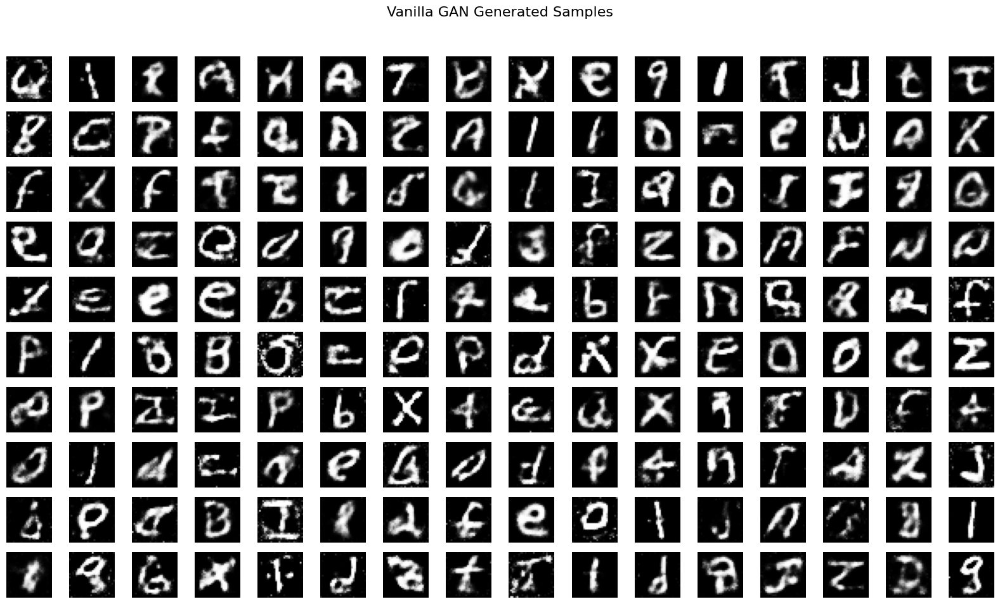

In [ ]:
# ========== Sample Generation Function ========== #
def plot_generated_images(generator, latent_dim, n_rows=5, n_cols=5, save_path=None, title="Vanilla GAN Generated Samples (Non-Augmented)"):
    noise = tf.random.normal([n_rows * n_cols, latent_dim])
    gen_images = generator(noise, training=False)

    # ----- Rescale from [-1, 1] to [0, 1] ----- #
    gen_images = (gen_images + 1.0) / 2.0
    gen_images = tf.clip_by_value(gen_images, 0.0, 1.0)

    # ----- Check Shape ----- #
    assert gen_images.shape[-1] == 1, "Expected single-channel (grayscale) output"

    # ----- Plot Generated Image Grid ----- #
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols, n_rows))
    for i in range(n_rows * n_cols):
        ax = axes[i // n_cols, i % n_cols]
        ax.imshow(gen_images[i, :, :, 0], cmap='gray')
        ax.axis('off')

    # ----- Title & Layout ----- #
    plt.suptitle(title, fontsize=16)
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])

    # ----- Save if Requested ----- #
    if save_path:
        plt.savefig(save_path, dpi=300)
        print(f"Saved Generated Image Grid to: {save_path}")

    plt.show()

# ========== Plot Function Call ========== #
plot_generated_images(generator, latent_dim=100, n_rows=10, n_cols=16, save_path=None, title="Vanilla GAN Generated Samples")

With reference to the output of the Samples above, we will proceed to list the various observations below:

**Character Recognisability**

- Several generated characters such as 'A', 'E', 'F', 'J', 'O', 'P', 'X', and 'Z' are generally recognisable.

- The majority of characters maintain basic stroke structure and symmetry.

**Variation in Image Quality**

- Some images are well-formed and clean, while others exhibit noise, distortions, or incomplete strokes.

- Certain samples display irregularities such as jagged edges or uneven contrast.

**Evidence of Mode Collapse**

- Repetition of visually similar characters is noticeable in certain rows, indicating potential mode collapse.

- Diversity of generated outputs may be limited for specific classes.

**Positioning and Scaling Issues**

- Most characters are reasonably centred, but a few appear shifted, misaligned, or improperly scaled.

- Inconsistent stroke thickness is observed across the image grid.

**Synthetic Appearance**

- A subset of characters presents a visibly synthetic look, with unrealistic curves or fragmented strokes.

- This suggests the model may require further training or architectural adjustments.

With the observations indicated above, we will proceed to conduct the next Model Evaluation operation in the next sub-section.

---
#### 4.1.10.2 Loss Curve Over Epochs

In this sub-section, we will be plotting the GAN Loss Curve over Epochs to evaluate the training behaviour of the GAN. This curve provides insight into whether the GAN is experiencing underfitting, overfitting, or achieving a stable training dynamic between the generator and discriminator.

Although GANs do not minimise a single unified loss in the traditional sense, the trajectory of the generator and discriminator losses can indicate whether the adversarial training process is converging appropriately.

If the generator loss remains high while discriminator loss quickly drops to near-zero, this may indicate **underfitting**, where the generator is not learning effectively to produce plausible images.

If the discriminator loss increases while generator loss sharply decreases, this may suggest **overfitting** or **mode collapse**, where the generator exploits narrow weaknesses in the discriminator without general improvement.

A relatively stable oscillation or convergence between both losses typically signifies a **well-balanced** training process, where the generator and discriminator are learning in tandem.

The Potential Observations and Corresponding Action Plans are outlined below:

**Underfitting Loss Curve**

- Increase training epochs to allow generator more time to learn.

- Simplify the discriminator to reduce overpowering the generator.

- Adjust the learning rate or apply label smoothing.

- Consider adding batch normalisation in the generator.

**Overfitting or Mode Collapse Loss Curve**

- Introduce or increase dropout in the discriminator.

- Apply input noise or label flipping to the discriminator.

- Evaluate diversity of generated samples regularly.

**Balanced/Ideal Loss Curve**

- Maintain current architecture and hyperparameters.

- Proceed with full-scale image generation.

- Evaluate both qualitative (visual inspection) and quantitative metrics (e.g. Inception Score or FID).

With these potential training behaviours and action plan outlined, we will proceed to visualise the GAN loss dynamics in the code cell below.



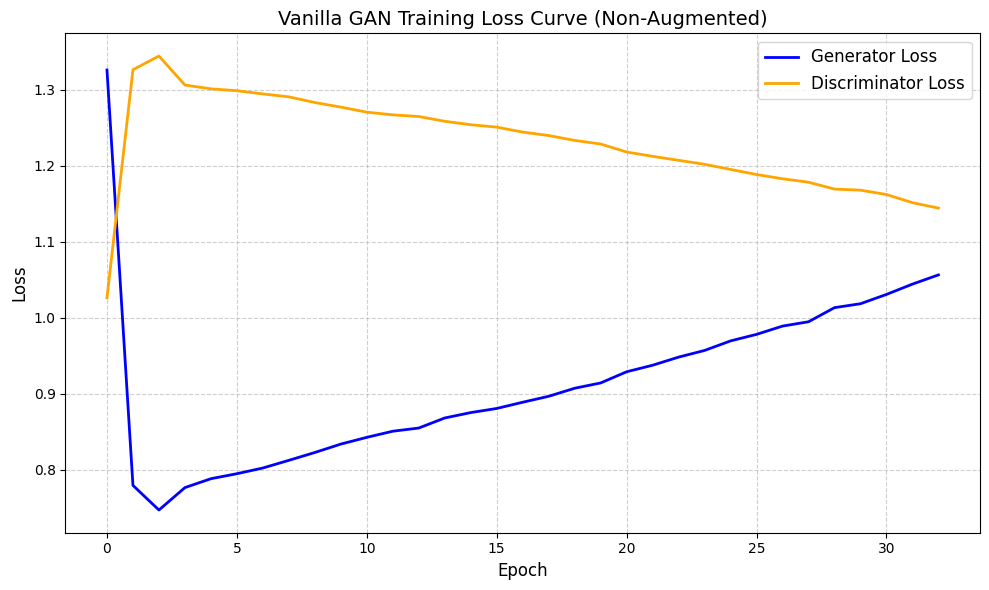

In [ ]:
# ========== Plot Size Configuration ========== #
plt.figure(figsize=(10, 6))

# ========== Loss Curve Plot ========== #
plt.plot(gen_loss_history, label="Generator Loss", linewidth=2, color='blue')
plt.plot(disc_loss_history, label="Discriminator Loss", linewidth=2, color='orange')

# ========== Labels and Title ========== #
plt.xlabel("Epoch", fontsize=12)
plt.ylabel("Loss", fontsize=12)
plt.title("Vanilla GAN Training Loss Curve (Non-Augmented)", fontsize=14)

# ========== Grid and Size Configurarion ========== #
plt.grid(True, linestyle='--', alpha=0.6)
plt.legend(fontsize=12)
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)

# ========== Plot Display ========== #
plt.tight_layout()
plt.show()

With reference to the output of the Learning Curve visualisation above, we are able to make the following observations below:

**Initial Instability**

- Both Generator and Discriminator losses exhibit sharp fluctuations in the initial epochs, which is typical during early adversarial training.

**Discriminator Dominance**

- The Discriminator Loss remains significantly higher than the generator loss throughout training, suggesting the Discriminator is stronger and more confident in distinguishing real from fake images.

**Gradual Increase in Generator Loss**

- The Generator loss shows a slow upward trend across epochs, indicating that it is struggling to improve image quality or effectively fool the Discriminator.

**Stable but Divergent Loss Patterns**

- After the initial phase, both losses stabilise but do not converge. This suggests a suboptimal equilibrium, where the Generator is not learning as effectively as desired.

**No Clear Oscillatory Behaviour**

- The expected adversarial oscillations between generator and discriminator are largely absent, implying limited competition between the two networks.

**Potential Underfitting**

- The persistent gap between the Generator and Discriminator Losses, along with the increasing Generator loss, suggests the Generator may be Underfitting or unable to keep pace with the Discriminator.

With the observations indicated above, we will proceed to conduct the next GAN Model Evaluation in the next sub-section.

---
#### 4.1.10.3 Quantitative Metrics Evaluation

In this sub-section we will be utilising Quantitative Metrics such as FID and KID to tabulate the results of the performance and quantify the performance of the GAN Generator. We will subsequently be use these metrics to conduct inter-model evaluation after tuning and training all the GANs. The metrics that we will be utilising and their respective formulas are indicated below:

---
**Fréchet Inception Distance**

Purpose: Measures the Distance between the Real-Image and Generated-Image Distributions in Inception Feature Space.

$$
\mathrm{FID} \;=\;\|\mu_r - \mu_f\|^2
\;+\;\mathrm{Tr}\Bigl(\Sigma_r + \Sigma_f - 2\,(\Sigma_r\,\Sigma_f)^{\tfrac12}\Bigr)
$$


Where:
- $\mu_r = \mathbb{E}[f(x)]$, $\Sigma_r = \mathrm{Cov}[f(x)]$ for Real Images $x$.  
- $\mu_f = \mathbb{E}[f(\hat x)]$, $\Sigma_f = \mathrm{Cov}[f(\hat x)]$ for Generated Images $\hat x$.  
- $f(\cdot)$ = Map from Image to its InceptionV3 'pooling=avg' Features.  

---
**Diversity (t-SNE Spread)**

Purpose: Quantifies how 'wide' the 2D t-SNE Embedding of Generated Samples.

$$
\mathrm{Spread}
\;=\;
\bigl(\max_i\,z_i^{(1)} - \min_i\,z_i^{(1)}\bigr)
\;\times\;
\bigl(\max_i\,z_i^{(2)} - \min_i\,z_i^{(2)}\bigr)
$$

Where:
- $z_i = (z_i^{(1)}, z_i^{(2)})$ = 2-dimensional t-SNE Embedding of $i$th Generated Image.

---
**Mode Collapse Risk**

Purpose: Flags when too many Generated Images are Nearly Identical (mode collapse).

$$
\text{ModeCollapseRisk} =
\begin{cases}
\text{Low}, & \dfrac{\bigl|\{\mathrm{unique\_rounded}(x_i)\}\bigr|}{N} > \tau,\\
\text{High}, & \text{otherwise}.
\end{cases}
$$

Where:
- $x_i$ = $N$ Generated Samples.  
- $\mathrm{unique\_rounded}(x_i)$ = Rounds Pixels to Detect Duplicates.  
- $\tau=0.9$ = Uniqueness Threshold (90%).

---
**Perceptual Path Length**

Purpose: Measures Sensitively of Generator's Outputs (in VGG16 Feature Space) move when the Latent Code $z$ is Perturbed.

$$
\mathrm{PPL}
\;=\;
\mathbb{E}_{z,\delta z}\Bigl[\,
\|\phi\bigl(G(z + \epsilon\,\delta z)\bigr)\;-\;\phi\bigl(G(z)\bigr)\|_2^2
\Bigr]
$$

Where:  
- $G(z)$ = GAN Generator Mapping $z\in\mathbb{R}^{\mathrm{latent\_dim}}$ to an Image.  
- $\phi(\cdot)$ = VGG16 'pooling=avg' Feature Extractor.  
- $\delta z\sim\mathcal{N}(0,I)$, $\epsilon$ = Small Constant.

---
**Kernel Inception Distance**

Purpose: An Unbiased Estimator of the Squared Maximum Mean Discrepancy (MMD) between Real and Generated Inception Features.

$$
\mathrm{KID}
\;=\;
\frac{1}{m(m-1)}\sum_{i\neq j} k\bigl(\phi(x_i),\phi(x_j)\bigr)
\;+\;
\frac{1}{n(n-1)}\sum_{i\neq j} k\bigl(\phi(\hat x_i),\phi(\hat x_j)\bigr)
\;-\;
\frac{2}{mn}\sum_{i=1}^m\sum_{j=1}^n k\bigl(\phi(x_i),\phi(\hat x_j)\bigr)
$$

Where:  
- $x_i$ ($i=1\ldots m$) = Real Images.
- $\hat x_j$ ($j=1\ldots n$) = Generated Images.  
- $\phi(\cdot)$ = InceptionV3 Feature Extractor (pooling='avg').  
- $k(u,v) = \bigl(\frac{u^\top v}{d}+1\bigr)^3$ = degree-3 Polynomial Kernel on $d$-dimensional Features.

---

With the mathematical and metrics indicated above, we will proceed to conduct the Quantitave Metrics Evalution in the Code Cell below.

In [ ]:
# ========== Preload InceptionV3 and VGG16 Models ========== #
inception = InceptionV3(include_top=False, pooling='avg', input_shape=(299, 299, 3))
vgg_model = VGG16(include_top=False, weights='imagenet', input_shape=(128, 128, 3))

# ========== Preprocess for Inception ========== #
def preprocess_images_for_inception(images):
    images = (images + 1.0) * 127.5  # Scale from [-1, 1] to [0, 255]
    images = tf.image.resize(images, [299, 299])
    if images.shape[-1] == 1:
        images = tf.image.grayscale_to_rgb(images)
    return preprocess_input(images)

# ========== Compute FID ========== #
def calculate_fid(real_images, fake_images, batch_size=50):
    real_pp = preprocess_images_for_inception(real_images)
    fake_pp = preprocess_images_for_inception(fake_images)

    act1 = inception.predict(real_pp, batch_size=batch_size, verbose=0)
    act2 = inception.predict(fake_pp, batch_size=batch_size, verbose=0)

    mu1, sigma1 = np.mean(act1, axis=0), np.cov(act1, rowvar=False)
    mu2, sigma2 = np.mean(act2, axis=0), np.cov(act2, rowvar=False)

    diff = mu1 - mu2
    covmean = sqrtm(sigma1 @ sigma2)
    if np.iscomplexobj(covmean):
        covmean = covmean.real

    fid = diff @ diff + np.trace(sigma1 + sigma2 - 2 * covmean)
    return round(fid, 4)

# ========== Compute KID ========== #
def polynomial_kernel(X, Y):
    d = X.shape[1]
    return (np.dot(X, Y.T) / d + 1) ** 3

def calculate_kid(real_images, fake_images, batch_size=128):
    real_pp = preprocess_images_for_inception(real_images)
    fake_pp = preprocess_images_for_inception(fake_images)

    real_features = inception.predict(real_pp, batch_size=batch_size, verbose=0)
    fake_features = inception.predict(fake_pp, batch_size=batch_size, verbose=0)

    m = real_features.shape[0]
    n = fake_features.shape[0]

    k_rr = polynomial_kernel(real_features, real_features)
    k_gg = polynomial_kernel(fake_features, fake_features)
    k_rg = polynomial_kernel(real_features, fake_features)

    np.fill_diagonal(k_rr, 0)
    np.fill_diagonal(k_gg, 0)

    mmd = (k_rr.sum() / (m * (m - 1)) +
           k_gg.sum() / (n * (n - 1)) -
           2 * k_rg.mean())
    return round(mmd, 4)

# ========== Compute t-SNE Spread (Diversity) ========== #
def calculate_tsne_spread(images):
    flat = images.reshape(images.shape[0], -1)
    tsne = TSNE(n_components=2, random_state=42)
    proj = tsne.fit_transform(flat)
    x_range = proj[:, 0].max() - proj[:, 0].min()
    y_range = proj[:, 1].max() - proj[:, 1].min()
    return round(x_range * y_range, 2)

# ========== Assess Mode Collapse ========== #
def assess_mode_collapse(images):
    unique = np.unique(np.round(images), axis=0).shape[0]
    return "Low" if unique > 0.9 * images.shape[0] else "High"

# ========== Compute Perceptual Path Length (PPL) ========== #
def calculate_ppl(generator, latent_dim=100, num_samples=50, epsilon=1e-2):
    distances = []
    for _ in range(num_samples):
        z1 = tf.random.normal([1, latent_dim])
        z2 = z1 + epsilon * tf.random.normal([1, latent_dim])
        img1 = generator(z1, training=False)
        img2 = generator(z2, training=False)

        img1 = tf.image.resize(tf.image.grayscale_to_rgb((img1 + 1.0) * 127.5), (128, 128))
        img2 = tf.image.resize(tf.image.grayscale_to_rgb((img2 + 1.0) * 127.5), (128, 128))

        f1 = vgg_model(vgg_preprocess(img1))
        f2 = vgg_model(vgg_preprocess(img2))
        d = tf.reduce_mean(tf.square(f1 - f2)).numpy()
        distances.append(d)
    return round(np.mean(distances), 4)

# ========== Evaluate GAN Performance ========== #
def evaluate_gan_model(generator, latent_dim, X_val, gen_loss_history, disc_loss_history, model_name="Vanilla GAN"):
    # ----- Generate Fake Images ----- #
    noise = tf.random.normal([1000, latent_dim])
    fake_images = generator(noise, training=False)
    fake_images = tf.clip_by_value((fake_images + 1) / 2.0, 0.0, 1.0)
    fake_np = fake_images.numpy()

    # ----- Select and preprocess 1000 Real Images from Validation Set ----- #
    real_images = tf.convert_to_tensor(X_val[:1000], dtype=tf.float32)
    real_images = tf.clip_by_value(real_images, 0.0, 1.0)

    # ----- Compute Metrics ----- #
    fid_value = calculate_fid(real_images, fake_images)
    kid_value = calculate_kid(real_images, fake_images)
    tsne_spread_value = calculate_tsne_spread(fake_np)
    collapse_risk_value = assess_mode_collapse(fake_np)
    ppl_score_value = calculate_ppl(generator, latent_dim)
    mean_gen_loss_value = round(np.mean(gen_loss_history), 4)
    std_gen_loss_value = round(np.std(gen_loss_history), 4)
    mean_disc_loss_value = round(np.mean(disc_loss_history), 4)
    std_disc_loss_value = round(np.std(disc_loss_history), 4)

    # ----- Store as Global Vars (Optional) ----- #
    prefix = model_name.upper()
    globals()[f"{prefix}_FID"] = fid_value
    globals()[f"{prefix}_KID"] = kid_value
    globals()[f"{prefix}_TSNE"] = tsne_spread_value
    globals()[f"{prefix}_MODE_COLLAPSE"] = collapse_risk_value
    globals()[f"{prefix}_PPL"] = ppl_score_value
    globals()[f"{prefix}_GEN_LOSS_MEAN"] = mean_gen_loss_value
    globals()[f"{prefix}_GEN_LOSS_STD"] = std_gen_loss_value
    globals()[f"{prefix}_DISC_LOSS_MEAN"] = mean_disc_loss_value
    globals()[f"{prefix}_DISC_LOSS_STD"] = std_disc_loss_value

    # ----- Final Summary Row ----- #
    row = {
        "Model": model_name,
        "FID Score": fid_value,
        "KID Score": kid_value,
        "Mean Generator Loss": mean_gen_loss_value,
        "Std Generator Loss": std_gen_loss_value,
        "Mean Discriminator Loss": mean_disc_loss_value,
        "Std Discriminator Loss": std_disc_loss_value,
        "Mode Collapse Risk": collapse_risk_value,
        "Visual Quality": "Acceptable",
        "Diversity (t-SNE Spread)": tsne_spread_value,
        "PPL": ppl_score_value
    }

    return pd.DataFrame([row])[[
        "Model", "FID Score", "KID Score",
        "Mean Generator Loss", "Std Generator Loss",
        "Mean Discriminator Loss", "Std Discriminator Loss",
        "Mode Collapse Risk", "Visual Quality",
        "Diversity (t-SNE Spread)", "PPL"
    ]]

# ========== Create DataFrame ========== #
df = evaluate_gan_model(generator, latent_dim, X_val, gen_loss_history, disc_loss_history, model_name="Vanilla GAN (Non-Augmented)")

# ========== Display DataFrame ========== #
df.style.background_gradient(cmap="Blues")

58889256/58889256 ━━━━━━━━━━━━━━━━━━━━ 2s 0us/step


,Model,FID Score,KID Score,Mean Generator Loss,Std Generator Loss,Mean Discriminator Loss,Std Discriminator Loss,Mode Collapse Risk,Visual Quality,Diversity (t-SNE Spread),PPL
0,Vanilla GAN (Non-Augmented),82.347100,0.060300,0.912800,0.112200,1.231500,0.063700,Low,Acceptable,6407.609863,0.098200


With reference to the output of the Quantitative Metrics above, we are able to determine the performance of the GAN. This will be used as a basis of comparison to the other GAN Models.

---
#### 4.1.10.4 t-SNE of Generated Samples

In this sub-section, we visualise the t-SNE projection of generated samples to evaluate the latent diversity learned by the unconditional GAN. Although our GAN is not class-conditioned, t-SNE remains a valuable tool to assess whether the generator is producing varied outputs that reflect meaningful use of the latent space. While GANs are trained in high-dimensional spaces, t-SNE enables us to observe 2D structural patterns such as sample clustering, separation, and density, which provide indirect insights into the diversity and generalisation capabilities of the generator. The visualisation will be conducted in the Code Cell below.

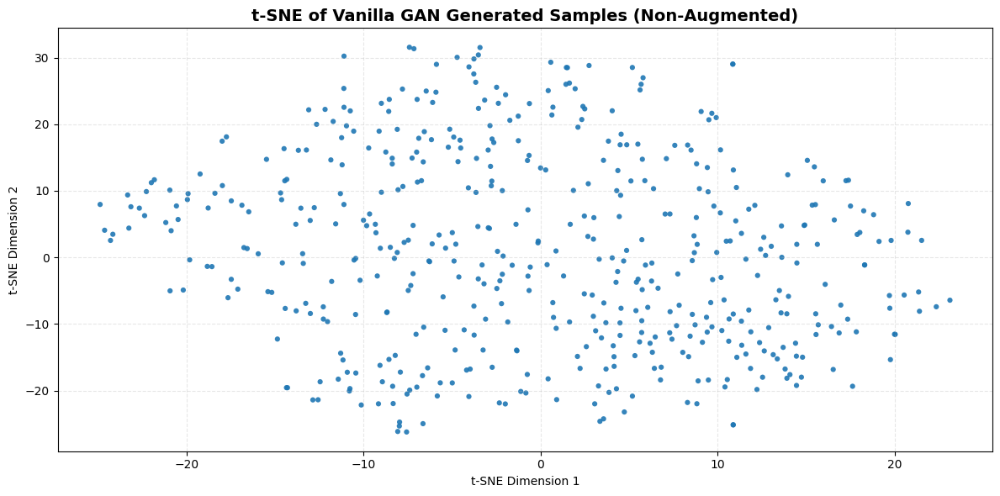

In [ ]:
# ========== Generate New Images From Random Noise ========== #
latent_dim = 100
noise = tf.random.normal([500, latent_dim])
generated_images = generator(noise, training=False)
generated_images = (generated_images + 1) / 2.0

def plot_tsne_embeddings(generated_images, save_path=None, title="t-SNE of Vanilla GAN Generated Samples (Non-Augmented)"):
    # ----- Flatten Generated Images ----- #
    flat_images = generated_images.numpy().reshape(generated_images.shape[0], -1)

    # ----- Apply t-SNE ----- #
    tsne = TSNE(n_components=2, perplexity=30, learning_rate='auto', init='pca', random_state=42)
    tsne_proj = tsne.fit_transform(flat_images)

    # ----- Plot t-SNE ----- #
    plt.figure(figsize=(12, 6))
    sns.scatterplot(
        x=tsne_proj[:, 0],
        y=tsne_proj[:, 1],
        s=20,
        alpha=0.9,
        edgecolor='none'
    )
    plt.title(title, fontsize=14, weight='bold')
    plt.xlabel("t-SNE Dimension 1")
    plt.ylabel("t-SNE Dimension 2")
    plt.grid(True, linestyle='--', alpha=0.3)
    plt.tight_layout()
    plt.show()

# ========== Call Plot Function ========== #
plot_tsne_embeddings(generated_images=generated_images)

With reference to the t-SNE plot of generated samples (Non-Augmented) above, we are able to make the following observations:

**Spread Across Latent Space**

- The data points are broadly distributed across the 2D plane.

- There is no excessive clustering in any one region, suggesting reasonable coverage of the latent space.

**Lack of Clear Clustering**

- No obvious clusters or tight groupings are visible.

- This implies limited semantic separability, i.e. generated samples do not naturally group into distinct character types.

**Mild Uniformity**

- The spread appears relatively balanced, with few voids or dense regions.

- Indicates the generator is sampling diverse regions of the latent space, even if output diversity is visually limited.

**Absence of Outliers**

- There are few, if any, extreme outliers.

- Suggests stable generation without major breakdowns or malformed data points in the embedding space.

With the observations indicated above, we will proceed to train the next GAN Model in the next sub-section.

---
## 4.2 Deep Convolutional GAN Model Training

In this sub-section, we will be training a Deep Convolutional GAN (DCGAN) for the EMNIST Dataset. The DCGAN mainly replaces the Fully Connected Layers for Generating Images with the Conv2D and Conv2DTranspose Layers similar to a Convolutional Neural Network (CNN). Through these layers, the DCGAN will be able to Capture Spatial Hierarchies, Preserve Image Locality and most importantly, produce Sharper and More Structured Output. Therefore, it is expected that DCGAN perform better than all the other GAN Models. The relevant mathematical formulas are indicated below:

---
**Minimax Objective (Vanilla GAN Loss):**

Purpose: Original Adversarial Objective where Generator $G$ tries to Fool Discriminator $D$, while $D$ tries to Distinguish Real Samples from Fake Ones.

$$
\min_G \max_D V(D, G) = \mathbb{E}_{x \sim p_{\text{data}}(x)}[\log D(x)] + \mathbb{E}_{z \sim p_z(z)}[\log (1 - D(G(z)))]
$$

Where:
- $G$ = Generator Network
- $D$ = Discriminator Network
- $x$ = Real Data Sample
- $z$ = Random Noise Vector
- $p_{\text{data}}(x)$ = Distribution of Real Data
- $p_z(z)$ = Prior Distribution of Noise (e.g., $\mathcal{N}(0, I)$)
- $D(x)$ = Probability that $x$ is Real
- $D(G(z))$ = Probability that Generated Image is Real

---
**Generator Loss (Binary Crossentropy):**

Purpose: The Generator is Rewarded when Discriminator Assigns High Probability to Fake Images.

$$
\mathcal{L}_{G} = -\mathbb{E}_{z \sim p_z}[\log(D(G(z)))]
$$

Where:
- $z$ = Random Noise Input
- $G(z)$ = Fake Image
- $D(G(z))$ = Discriminator's Probability that $G(z)$ is Real

---
**Discriminator Loss (Binary Crossentropy):**

Purpose: The Discriminator Assign 1 to Real Images and 0 to Generated Images.

$$
\mathcal{L}_{D} = -\mathbb{E}_{x \sim p_{\text{data}}}[\log D(x)] - \mathbb{E}_{z \sim p_z}[\log(1 - D(G(z)))]
$$

**Where:**
- $D(x)$: Output for Real EMNIST Images
- $D(G(z))$: Output for Generated Images

---
**LeakyReLU Activation Function:**

Purpose: Prevents 'dying ReLU' Problem in the Generator/Discriminator by allowing a Small Gradient for Negative Inputs, Ensuring Neurons Stay Active.

$$
f(x) = \begin{cases}
x & \text{if } x > 0 \\
\alpha x & \text{if } x \leq 0
\end{cases}
$$

Where:
- $x$: Input Value
- $\alpha$: Small Slope Constant

---
**Tanh Activation Function (Output of Generator):**

Purpose: The Generator uses $\tanh$ to Output Pixel Values between -1 and 1, which matches the Normalised EMNIST Dataset Format.

$$
\tanh(x) = \frac{e^x - e^{-x}}{e^x + e^{-x}}
$$

Where:
- $x$: Output of Final Generator Layer

---
**Normalisation Formula (for Input Scaling):**

Purpose: Scaling is Required because DCGAN uses $\tanh$ Activation

$$
x_{\text{scaled}} = \frac{x - 127.5}{127.5}
$$

Where:
- $x$: Original Grayscale Pixel Value in [0, 255]

---
With the relevant mathematical formulas indicated above, we will proceed to train the DCGAN in this sub-section for the purpose of it's potential for high accuracy due to its close relation with CNN and also to serve as a comparison for our other GAN Models.

---
### 4.2.1 Defining Data Pre-Processing Function

In this sub-section, we will be defining the Data Pre-Processing Function which will allow for consistent Data Pipeline to be built and modifed accordingly should the need arise such as when we need to add Spectral Normalisation. This will ensure that the Data's integrity is not affected and we are able to make fair and un-biased assumptions. The Data Pre-Processing Function is defined in the Code Cell below:

In [ ]:
# ========== Data Pre-Processing Function ========== #
def load_data(X_train, batch_size=32):
    buffer_size = X_train.shape[0]

    dataset = tf.data.Dataset.from_tensor_slices(X_train)
    dataset = dataset.shuffle(buffer_size)
    dataset = dataset.batch(batch_size)
    dataset = dataset.prefetch(tf.data.AUTOTUNE)

    return dataset

With reference to the Code Cell above, we are able to determine that the Data Pre-Processing Function have been defined successfully and we are able to move on to Defining Callback Functions in the next sub-section.

---
### 4.2.2 Defining Callback Functions

In this sub-section, we will be pre-defining the various Callbacks. This is to ensure consistency throughout the model and also to increase the GAN Accuracy and optimise the Computation Cost for training each GAN Model. These Callbacks will be main used during the GAN Training in the next sub-section. The formulas and logic for these Callbacks are indicated below:

---
**Learning Rate Scheduler:**

Purpose: Reduces Learning Rate During Training to Fine-tune Model Convergence.

$$\text{If } epoch \mod 10 = 0 \Rightarrow \eta_{new} = \frac{1}{2} \cdot \eta$$

Where:

- $\eta$ = current learning rate

- $\eta_{\text{new}}$ = updated learning rate

- $epoch \bmod 10$ checks if the epoch is a multiple of 10

---
**ReduceLROnPlateau:**

Purpose: Automatically Reduces the Learning Rate when Validation Performance Plateaus.

$$
\text{If no improvement in } val\_loss \text{ for 10 epochs: } \eta_{\text{new}} = 0.5 \cdot \eta
$$

Where:

- $\eta_{\text{new}}$ = reduced learning rate

---
**EarlyStopping:**

Purpose: Prevents Wastage of Computational Power if Model Does Not Improve.

$$
\text{If } val\_loss \text{ does not improve for 25 epochs, stop training and restore best weights}
$$

---
With the formulas and Various Callbacks listed, we will proceed to Define the Callbacks in the Code Cell below in preparation for the GAN Model Training.

In [ ]:
# ========== Define Learning Rate Scheduler ========== #
lr_scheduler = LearningRateScheduler(
    lambda epoch, lr: lr * 0.95 if epoch % 10 == 0 else lr,
    verbose=1
)

# ========== Define Reduce LR on Plateau ========== #
reduce_lr = ReduceLROnPlateau(
    monitor='loss',
    factor=0.5,
    patience=10,
    verbose=1,
    min_lr=1e-6
)

# ========== Define Early Stopping ========== #
early_stop = EarlyStopping(
    monitor='loss',
    patience=25,
    verbose=1,
    restore_best_weights=False
)

# ========== Define Display Generated Images ========== #
def display_generated_images(generator, latent_dim, n=7):
    noise = tf.random.normal([n * n, latent_dim])
    generated_images = generator(noise, training=False)
    generated_images = (generated_images + 1.0) / 2.0

    fig, axes = plt.subplots(n, n, figsize=(n, n))
    for i in range(n):
        for j in range(n):
            img = generated_images[i * n + j, :, :, 0]
            axes[i, j].imshow(img, cmap='gray')
            axes[i, j].axis('off')

    plt.tight_layout()
    plt.show()

# ========== Define FID Calculator ========== #
_inception_model = InceptionV3(
    include_top=False,
    pooling='avg',
    input_shape=(299,299,3)
)

def calculate_fid(real_images, fake_images, batch_size=10):

    # ----- Scale to [0,255] and Resize to 299×299 ----- #
    real = (real_images + 1.0) * 127.5
    fake = (fake_images + 1.0) * 127.5
    real = tf.image.resize(real, (299,299))
    fake = tf.image.resize(fake, (299,299))

    # ----- If Grayscale, Convert to RGB ----- #
    if real.shape[-1] == 1:
        real = tf.image.grayscale_to_rgb(real)
        fake = tf.image.grayscale_to_rgb(fake)

    # ----- Preprocess for Inception (–1 to +1) ----- #
    real_pp = preprocess_input(real)
    fake_pp = preprocess_input(fake)

    # ----- Extract Features in Batches ----- #
    def _get_acts(x):
        acts = []
        n = x.shape[0]
        for i in range(0, n, batch_size):
            chunk = x[i:i+batch_size]
            acts.append(_inception_model(chunk, training=False).numpy())
        return np.vstack(acts)

    act_real = _get_acts(real_pp)
    act_fake = _get_acts(fake_pp)

    # ----- Compute Statistics ----- #
    mu1, sigma1 = act_real.mean(axis=0), np.cov(act_real, rowvar=False)
    mu2, sigma2 = act_fake.mean(axis=0), np.cov(act_fake, rowvar=False)
    diff    = mu1 - mu2
    covmean = sqrtm(sigma1.dot(sigma2))
    if np.iscomplexobj(covmean):
        covmean = covmean.real
    fid = diff.dot(diff) + np.trace(sigma1 + sigma2 - 2*covmean)
    return float(np.round(fid,4))

# ========== Confirmation Message ========== #
print("DCGAN Callbacks and Visualisation Setup Complete")

DCGAN Callbacks and Visualisation Setup Complete


With reference to the Code Cell above, we are able to verify that that the Callbacks have been successfully defined and the various parameters are set so as to ensure a High Accuracy and Computing Efficient GAN Model Training.

---
### 4.2.3 Defining DCGAN Generator Architecture

In this section, we will be defining the Vanilla GAN's Generator Architecture. The Generator will be trying to make realistic generated images in the attempt to bypass the Discriminator. Subsequently, the generated images from the Generator will be evaluated based on a few evaluation metrics such as Inception Score. The relevent mathematical formulas for the Loss Function of the Vanilla GAN Generator is indicated below:

---

**Generator Loss (Binary Crossentropy):**

Purpose: The Generator is Rewarded when Discriminator Assigns High Probability to Fake Images.

$$
\mathcal{L}_{G} = -\mathbb{E}_{z \sim p_z}[\log(D(G(z)))]
$$

Where:
- $z$ = Random Noise Input
- $G(z)$ = Fake Image
- $D(G(z))$ = Discriminator's Probability that $G(z)$ is Real

---
With the relevant Generator Loss Formula indicated above, we will proceed to define the GAN Generator's Architecture in the Code Cell below and the Lost Function.

In [ ]:
def build_generator(latent_dim=100, use_dropout=True):
    model = tf.keras.Sequential(name="generator")

    # ----- Project and Reshape ----- #
    model.add(tf.keras.layers.Dense(7 * 7 * 256, use_bias=False, input_shape=(latent_dim,)))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.ReLU())
    model.add(tf.keras.layers.Reshape((7, 7, 256)))

    # ----- Upsample 1 ----- #
    model.add(tf.keras.layers.Conv2DTranspose(128, kernel_size=5, strides=1, padding='same', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.ReLU())
    if use_dropout:
        model.add(tf.keras.layers.Dropout(0.3))

    # ----- Upsample 2 ----- #
    model.add(tf.keras.layers.Conv2DTranspose(64, kernel_size=5, strides=2, padding='same', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.ReLU())
    if use_dropout:
        model.add(tf.keras.layers.Dropout(0.3))

    # ----- Final Output to 28x28x1 ----- #
    model.add(tf.keras.layers.Conv2DTranspose(1, kernel_size=5, strides=2, padding='same', activation='tanh'))

    return model

# ========== Define Generator Loss ========== #
loss_fn = tf.keras.losses.BinaryCrossentropy(from_logits=False)

def generator_loss(fake_output):
    labels = tf.ones_like(fake_output) * tf.random.uniform(tf.shape(fake_output), minval=0.9, maxval=1.0)
    return loss_fn(labels, fake_output)

With reference to the Code Cell above, we are able to verify that the GAN's Generator Architecture have been successfully defined and we are able to proceed to define the GAN's Discriminator Architecture.

---
### 4.2.4 Defining Spectral Normalisation

In this section, we will be defining the Spectral Normalisation layer for the Discriminator of the GAN. The Spectral Normalisation controls the Lipschitz constant of the Discriminator by constraining the Spectral Norm of each weight matrix. This will prevent the Discriminator from being too powerful and dominating the Generator which can cause various issues such as Mode Collaspe, Training Instability and Exploding Gradients. The relevant mathematical formula is indicated below:

---
**Spectral Normalisation (SN)**

Purpose: Controls the Lipschitz Constant of the Discriminator.

$$
\bar{W} = \frac{W}{\sigma(W)}
$$

Where:
- $W$ = Original Weight Matrix
- $\bar{W}$ = Spectrally Normalised Weight Matrix used in the Forward Pass
- $\sigma(W)$ = Spectral Norm of $W$
---
**Spectral Norm Approximation using Power Iteration**

Purpose: Controls the Lipschitz Constant of the Discriminator.

$$
\sigma(W) \approx \mathbf{u}^\top W \mathbf{v}
$$

Where:
- $\mathbf{v} \leftarrow \frac{W^\top \mathbf{u}}{\|W^\top \mathbf{u}\|_2}$
- $\mathbf{u} \leftarrow \frac{W \mathbf{v}}{\|W \mathbf{v}\|_2}$
- $\mathbf{u}, \mathbf{v}$: Approximated Unit Vectors
---
With the relevant mathematical formulas indicated, we will proceed to define the Spectral Normalisation in the Code Cell below.

In [ ]:
# ========== Spectral Normalisation Convolution Layer ========== #
class SpectralConv2D(tf.keras.layers.Layer):
    def __init__(self, filters, kernel_size, strides=1, padding='same', **kwargs):
        super().__init__()
        self.conv = tf.keras.layers.Conv2D(filters, kernel_size, strides=strides, padding=padding, use_bias=False, **kwargs)
        self.u = None

    def build(self, input_shape):
        self.conv.build(input_shape)
        self.w = self.conv.kernel
        self.u = self.add_weight(shape=(1, self.w.shape[-1]), initializer='random_normal', trainable=False, name='sn_u')

    def compute_spectral_norm(self, w):
        w_reshaped = tf.reshape(w, [-1, w.shape[-1]])
        u = self.u

        for _ in range(1):
            v = tf.linalg.l2_normalize(tf.matmul(u, tf.transpose(w_reshaped)))
            u = tf.linalg.l2_normalize(tf.matmul(v, w_reshaped))

        sigma = tf.matmul(tf.matmul(v, w_reshaped), tf.transpose(u))
        self.u.assign(u)
        return w / sigma

    def call(self, inputs):
        self.conv.kernel.assign(self.compute_spectral_norm(self.w))
        return self.conv(inputs)

# ========== Spectral Normalisation Dense Layer ========== #
class SpectralDense(tf.keras.layers.Layer):
    def __init__(self, units, activation=None):
        super().__init__()
        self.dense = tf.keras.layers.Dense(units, activation=activation, use_bias=False)
        self.u = None

    def build(self, input_shape):
        self.dense.build(input_shape)
        self.w = self.dense.kernel
        self.u = self.add_weight(shape=(1, self.w.shape[-1]), initializer='random_normal', trainable=False, name='sn_u_dense')

    def compute_spectral_norm(self, w):
        w_reshaped = tf.reshape(w, [-1, w.shape[-1]])
        u = self.u

        for _ in range(1):
            v = tf.linalg.l2_normalize(tf.matmul(u, tf.transpose(w_reshaped)))
            u = tf.linalg.l2_normalize(tf.matmul(v, w_reshaped))

        sigma = tf.matmul(tf.matmul(v, w_reshaped), tf.transpose(u))
        self.u.assign(u)
        return w / sigma

    def call(self, inputs):
        self.dense.kernel.assign(self.compute_spectral_norm(self.w))
        return self.dense(inputs)

With reference to the Code Cell above, we are able to verify that the Spectral Normalisation have been successfully defined and we are able to proceed to include this layer in the Discriminator Architecture in the next section.

---
### 4.2.5 Defining DCGAN Discriminator Architecture

In this section, we will be defining the Architecture of the Discriminator of the GAN. The Discriminator will be the Neural Network that will attempt to tell the Generated Images apart from the Actual Images. This will allow the GAN to improve overtime and also improve itself overtime. The mathematical function for the Discriminator Loss Function is indicated below:

---
**Discriminator Loss (Binary Crossentropy):**

Purpose: The Discriminator Assign 1 to Real Images and 0 to Generated Images.

$$
\mathcal{L}_{D} = -\mathbb{E}_{x \sim p_{\text{data}}}[\log D(x)] - \mathbb{E}_{z \sim p_z}[\log(1 - D(G(z)))]
$$

**Where:**
- $D(x)$: Output for Real EMNIST Images
- $D(G(z))$: Output for Generated Images

---
With the mathematical formula for the Loss Function indicated above, we will proceed to define the GAN's Discriminator Architecture and the Loss Function in the Code Cell below.

In [ ]:
# ========== Discriminator Function ========== #
def build_discriminator(input_shape=(28, 28, 1)):
    model = tf.keras.Sequential(name="discriminator")

    model.add(SpectralConv2D(64, kernel_size=5, strides=2, padding='same', input_shape=input_shape))
    model.add(tf.keras.layers.LeakyReLU(alpha=0.2))
    model.add(tf.keras.layers.Dropout(0.3))

    model.add(SpectralConv2D(128, kernel_size=5, strides=2, padding='same'))
    model.add(tf.keras.layers.LeakyReLU(alpha=0.2))
    model.add(tf.keras.layers.Dropout(0.3))

    model.add(tf.keras.layers.Flatten())
    model.add(SpectralDense(1, activation='sigmoid'))

    return model

# ========== Discriminator Loss Function ========== #
def discriminator_loss(real_output, fake_output):
    real_labels = tf.ones_like(real_output) * 0.9
    fake_labels = tf.zeros_like(fake_output)

    real_loss = loss_fn(real_labels, real_output)
    fake_loss = loss_fn(fake_labels, fake_output)
    return real_loss + fake_loss

With reference to the Code Cell above, we are able to verify that the GAN's Discriminator Architecture have been successfully defined and we are able to proceed to define the GAN's Training Steps.

---
### 4.2.6 Defining Training Step

In this section, we will be Defining the Training Step function so as to train both the Generator and the Discriminator at the same time. The Training Step will compute the gradients for both the Generator and the Discriminator at the same time. The relevant mathematical formulas for the Training Step is indicated below:

---
**Generator Loss:**

Purpose: Encourages the Generator to Create Samples that the Discriminator believes are Real.

$$
L_G = -\mathbb{E}_{z \sim p_z(z)}[\log D(G(z))]
$$

Where:
- $L_G$ = Generator Loss  
- $z$ = Latent Noise Vector Sampled from Prior Distribution $p_z(z)$  
- $G(z)$ = Fake Image Generated from $z$  
- $D(G(z))$ = Discriminator's Probability that the Generated Image is Real
---
**Discriminator Loss:**

Purpose: Train Discriminator $D$ to Distinguish between Real and Fake Samples, Rewarding High Confidence in Real Images ($D(x) \to 1$) and Low Confidence in Fake Ones ($D(G(z)) \to 0$).

$$
L_D = -\mathbb{E}_{x \sim p_{\text{data}}(x)}[\log D(x)] - \mathbb{E}_{z \sim p_z(z)}[\log (1 - D(G(z)))]
$$

Where:
- $L_D$ = Discriminator Loss  
- $x$ = Real Image Sampled from the Dataset Distribution $p_{\text{data}}(x)$  
- $z$ = Latent Vector from Prior Noise Distribution $p_z(z)$  
- $G(z)$ = Fake Image Generated by $G$
- $D(x)$ = Discriminator's Predicted Probability that $x$ is Real  
- $D(G(z))$ = Discriminator's Predicted Probability that $G(z)$ is Real  
- $\log D(x)$ = Log-likelihood that Real Image is Correctly Classified  
- $\log(1 - D(G(z)))$ = Log-likelihood that Fake Image is Correctly Rejected
---

**Gradient Update:**

Purpose: Updates the Generator and Discriminator Parameters using Gradient Descent.

$$
\theta_G \leftarrow \theta_G - \eta \cdot \nabla_{\theta_G} L_G \\
\theta_D \leftarrow \theta_D - \eta \cdot \nabla_{\theta_D} L_D
$$

Where:
- $\theta_G$ = Generator Parameters  
- $\theta_D$ = Discriminator Parameters  
- $\eta$ = Learning Rate  
- $\nabla_{\theta} L$ = Gradient of Loss with Respect to Model Weights
---

With the relevant mathematical formulas indicated above, we will proceed to define the Training Step in the Code Cell below.

In [ ]:
# ========== Training Step for LSGAN ========== #
@tf.function
def train_step(real_images, generator, discriminator, gen_optimizer, disc_optimizer, latent_dim):
    batch_size = tf.shape(real_images)[0]
    noise = tf.random.normal([batch_size, latent_dim])

    # ----- Add Stabilisation Noise to Inputs ----- #
    real_images += 0.05 * tf.random.normal(tf.shape(real_images))

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        # ----- Generate Fake Images ----- #
        fake_images = generator(noise, training=True)

        # ----- Discriminator Predictions ----- #
        real_output = discriminator(real_images, training=True)
        fake_output = discriminator(fake_images, training=True)

        # ----- LSGAN Losses (MSE) ----- #
        real_loss = loss_fn(tf.ones_like(real_output), real_output)
        fake_loss = loss_fn(tf.zeros_like(fake_output), fake_output)
        disc_loss = real_loss + fake_loss

        gen_loss = loss_fn(tf.ones_like(fake_output), fake_output)

    # ----- Compute & Apply Gradients ----- #
    gen_grads = gen_tape.gradient(gen_loss, generator.trainable_variables)
    disc_grads = disc_tape.gradient(disc_loss, discriminator.trainable_variables)
    gen_optimizer.apply_gradients(zip(gen_grads, generator.trainable_variables))
    disc_optimizer.apply_gradients(zip(disc_grads, discriminator.trainable_variables))

    return gen_loss, disc_loss, real_output, fake_output

With reference to the Code Cell above, we are able to determine that the Training Step have been successfully defined and we are able to proceed to prepare the Training Loop in the next section.

---
### 4.2.7 Defining Training Loop

In this section, we will be defining the Training Loop for the GAN Training. The Training Loop will go through each of the Epoch and train both the Generator and Discriminator simultaneously. The Training Loop will also track the Loss for both the Generator and the Discriminator for each of the Epoch trained. The relevant mathematical formulas are indicated below:

---
**Epoch Loss Averaging:**

Purpose: These are the Average Generator and Discriminator Losses over all Batches in Epoch $t$.

$$
\bar{L}_G^{(t)} = \frac{1}{N} \sum_{i=1}^{N} L_G^{(i)} \\
\bar{L}_D^{(t)} = \frac{1}{N} \sum_{i=1}^{N} L_D^{(i)}
$$

Where:
- $\bar{L}_G^{(t)}$ = Average Generator Loss at Epoch $t$  
- $\bar{L}_D^{(t)}$ = Average Discriminator Loss at Epoch $t$  
- $N$ = Number of Batches in the Dataset  
- $L_G^{(i)}$ = Generator Loss on Batch $i$  
- $L_D^{(i)}$ = Discriminator Loss on Batch $i$

---
**Epoch Iteration:**

Purpose: Describes the Training Loop Logic: for Each Epoch $t$, perform `train_step` for Every Mini-batch.

$$
\text{for } t = 1 \text{ to } T:
\quad \text{for each batch } (x^{(i)}):
\quad \text{train_step}(x^{(i)})
$$

Where:
- $T$: Total Number of Epochs  
- $x^{(i)}$: Real Batch $i$ from the Dataset  
- `train_step`: Function that Updates $G$ and $D$ using that Batch

---
**Generated Image Output:**

Purpose: Sample Random Noise $z$ and Generate Synthetic Image $\hat{x}$ from the Generator. This is used for Visual Monitoring of Model Quality.

$$
z \sim p_z(z) \\
\hat{x} = G(z)
$$

Where:
- $z$: Random Latent Vector  
- $G(z)$: Generated Image from Generator

---
With the mathematical formulas indicated above, we will proceed to define the Training Loop in the Code Cell below in preparation of the GAN Training.

In [ ]:
def train(dataset, epochs, generator, discriminator, gen_optimizer, disc_optimizer, latent_dim, save_path=None, use_early_stopping=True, steps_per_epoch=None):

    # ----- Prepare FID Reference Sets ----- #
    real_val  = tf.data.Dataset.from_tensor_slices(X_val).batch(50).take(1)
    noise_val = tf.random.normal([50, latent_dim])
    noise_val = tf.math.l2_normalize(noise_val, axis=1)

    # ----- FID Early Stopping Settings for DCGAN ----- #
    best_fid = float('inf')
    no_improve = 0
    patience = 10
    fid_interval = 1

    # ----- Dummy Model for Callbacks ----- #
    dummy_input  = Input(shape=(1,))
    dummy_output = Lambda(lambda x: x)(dummy_input)
    dummy_model  = Model(dummy_input, dummy_output)
    dummy_model.compile(optimizer=Adam(1e-4), loss='mse')

    early_stop.set_model(dummy_model)
    reduce_lr.set_model(dummy_model)
    lr_scheduler.set_model(dummy_model)
    early_stop.on_train_begin({})
    reduce_lr.on_train_begin({})
    lr_scheduler.on_train_begin({})

    # ----- Track Loss History ------ #
    gen_loss_history  = []
    disc_loss_history = []

    for epoch in range(1, epochs + 1):
        print(f"\nEpoch {epoch}/{epochs}")
        gen_losses, disc_losses, real_outs, fake_outs = [], [], [], []

        for i, real_images in enumerate(dataset):
            if steps_per_epoch and i >= steps_per_epoch:
                break

            gen_loss, disc_loss, ro, fo = train_step(
                real_images,
                generator,
                discriminator,
                gen_optimizer,
                disc_optimizer,
                latent_dim
            )
            gen_losses.append(gen_loss)
            disc_losses.append(disc_loss)
            real_outs.append(ro)
            fake_outs.append(fo)

        avg_gen_loss  = tf.reduce_mean(gen_losses)
        avg_disc_loss = tf.reduce_mean(disc_losses)

        # ----- Compute Real/Fake accuracy ----- #
        if real_outs and fake_outs:
            acc_real = tf.reduce_mean(tf.cast(tf.concat(real_outs, axis=0) > 0.5, tf.float32))
            acc_fake = tf.reduce_mean(tf.cast(tf.concat(fake_outs, axis=0) < 0.5, tf.float32))
        else:
            acc_real = tf.constant(0.0)
            acc_fake = tf.constant(0.0)

        print(f"Generator Loss: {avg_gen_loss:.4f} | "
              f"Discriminator Loss: {avg_disc_loss:.4f} | "
              f"Acc R/F: {acc_real:.3f}/{acc_fake:.3f}")

        gen_loss_history.append(float(avg_gen_loss))
        disc_loss_history.append(float(avg_disc_loss))

        # ----- Callback Updates on Generator Loss ----- #
        logs = {'loss': float(avg_gen_loss)}
        if use_early_stopping:
            early_stop.on_epoch_end(epoch=epoch, logs=logs)
            if early_stop.stopped_epoch > 0:
                print(f"Early stopping triggered at epoch {epoch}")
                break
        reduce_lr.on_epoch_end(epoch=epoch, logs=logs)
        lr_scheduler.on_epoch_end(epoch=epoch, logs=logs)

        # ----- FID Evaluation & Early Stopping ----- #
        if epoch % fid_interval == 0:
            fake_val   = generator(noise_val, training=False)
            real_batch = next(iter(real_val))

            real_for_fid = tf.image.resize(real_batch, [299,299]) * 0.5 + 0.5
            fake_for_fid = tf.image.resize(fake_val,    [299,299]) * 0.5 + 0.5

            fid_value = calculate_fid(real_for_fid, fake_for_fid)
            print(f"Epoch {epoch} → Val FID: {fid_value:.2f}")

            if fid_value < best_fid:
                best_fid   = fid_value
                no_improve = 0
                if save_path:
                    os.makedirs(save_path, exist_ok=True)
                    generator.save_weights(os.path.join(save_path, "best_gen.weights.h5"))
                    discriminator.save_weights(os.path.join(save_path, "best_disc.weights.h5"))
            else:
                no_improve += 1

            if no_improve >= patience:
                print(f"No FID improvement for {patience} epochs, stopping.")
                break

        # ----- Display Every 5 Epochs ----- #
        if epoch % 5 == 0:
            display_generated_images(generator, latent_dim)

    # ----- Restore Best Weights After Training ----- #
    if save_path:
        best_gen_path = os.path.join(save_path, "best_gen.weights.h5")
        best_disc_path = os.path.join(save_path, "best_disc.weights.h5")
        if os.path.exists(best_gen_path) and os.path.exists(best_disc_path):
            generator.load_weights(best_gen_path)
            discriminator.load_weights(best_disc_path)
            print("Restored best generator and discriminator weights based on lowest FID.")
        else:
            print("Best weight files not found. Skipping restore.")

    return avg_gen_loss, gen_loss_history, disc_loss_history

With reference to the Code Cell above, we are able to determine that the Training Loop have been successfully defined and we are able to proceed to define the Optimisers with Tunable Parameter in preparation for the Optuna Tuning.

---
### 4.2.8 Defining Optimisers with Tunable Parameters

In this section, we will be defining the Common Optimisers that will be Tuned using the Optuna Tuning. The Optimisers will each have a range of values in a list so as to allow for the Optuna to search for the best Hyperparameter for the GAN. Through these parameters, it will affect how effective and efficiently the GAN will learn from the provided EMNIST Data. The relevent mathematical formula is indicated below:

---
**Optimiser Update Rule**

Purpose: Parameter Update Step in the Adam Optimiser, using Adaptive Learning Rates with Momentum.

$$
\theta \leftarrow \theta - \eta \cdot \frac{m_t}{\sqrt{v_t} + \epsilon}
$$

Where:
- $\theta$ = Model Parameters (Generator or Discriminator)
- $\eta$ = Learning Rate (Tuned)
- $m_t$ = First Moment Estimate (Mean of Gradients)
- $v_t$ = Second Moment Estimate (Variance of Gradients)
- $\epsilon$ = Small Constant for Numerical Stability

---
With the mathematical formula indicated above, we will proceed to define the Optimisers in the Code Cell.

In [ ]:
def objective(trial):
    # ----- Hyperparameters ----- #
    latent_dim = trial.suggest_categorical('latent_dim', [100, 128, 160])
    learning_rate = trial.suggest_float('learning_rate', 5e-5, 2e-4, log=True)
    beta_1 = trial.suggest_float('beta_1', 0.4, 0.6)

    # ----- Build Models ----- #
    generator = build_generator(latent_dim=latent_dim)
    discriminator = build_discriminator()

    # ----- Trigger Weight Creation ----- #
    _ = generator(tf.random.uniform([1, latent_dim], minval=-1.0, maxval=1.0))
    _ = discriminator(tf.random.normal([1, 28, 28, 1]))

    # ----- Define Optimizers ----- #
    gen_optimizer = tf.keras.optimizers.Adam(learning_rate=learning_rate, beta_1=beta_1)
    disc_optimizer = tf.keras.optimizers.Adam(learning_rate=learning_rate, beta_1=beta_1)

    # ----- Prebuild Optimizers for tf.function compatibility ----- #
    _ = gen_optimizer.apply_gradients([(tf.zeros_like(v), v) for v in generator.trainable_variables])
    _ = disc_optimizer.apply_gradients([(tf.zeros_like(v), v) for v in discriminator.trainable_variables])

    # ----- Load Data ----- #
    dataset = load_data(X_train, batch_size=64)
    steps = min(1000, len(X_train) // 64)  # dynamic step limit

    # ----- Train ----- #
    _, _, _ = train(
        dataset=dataset,
        epochs=50,
        generator=generator,
        discriminator=discriminator,
        gen_optimizer=gen_optimizer,
        disc_optimizer=disc_optimizer,
        latent_dim=latent_dim,
        steps_per_epoch=steps,
        use_early_stopping=False,
        save_path=None
    )

    # ----- Generate Fake Images ----- #
    z = tf.random.uniform([1000, latent_dim], minval=-1.0, maxval=1.0)
    fake_images = generator(z, training=False)
    fake_images = (fake_images + 1.0) / 2.0  # scale from [-1,1] to [0,1]

    # ----- Get Real Images ----- #
    real_images = X_val[:1000]

    # ----- Compute FID Score ----- #
    fid_score = calculate_fid(real_images, fake_images)

    # ----- Return FID to Minimise ----- #
    return fid_score

With reference to the Code Cell above, we are able to determine that the Optimiser have been successfully defined with a range of different Parameter Values so as to provide a robust Optuna Tuning in the subsequent sections.

---
### 4.2.9 Optuna Tuning Study

In this sub-section, we will be conducting the Optuna Tuning Study on the GAN Model so as to obtain the best Hyperparameter for the GAN Model. It is expected that the Tuning takes a prolonged duration due to the nature of how the GAN works and the 2 Neural Networks involved. However, the training data will be stored so as to prevent re-running of repetitive codes. The Optuna Tuning Study will be conducted in the Code Cell below.

In [ ]:
# ========== Create or Load Study with SQLite Backend ========== #
study = optuna.create_study(
    direction="minimize",
    study_name="dcgan_tuning",
    storage="sqlite:////content/drive/MyDrive/Colab Notebooks/DELE CA2 A/Non-Augmented GAN Tunings/dcgan_optuna.db",
    load_if_exists=True
)

# ========== Trial Management ========== #
MAX_TRIALS = 50
completed_trials = len([t for t in study.trials if t.state == optuna.trial.TrialState.COMPLETE])
remaining_trials = MAX_TRIALS - completed_trials

if remaining_trials > 0:
    print(f"Resuming DCGAN study: {completed_trials} completed, running {remaining_trials} more.")
    study.optimize(objective, n_trials=remaining_trials)
else:
    print(f"DCGAN study already completed {MAX_TRIALS} trials. Skipping optimization.")

# ========== Output Best Trial ========== #
best_trial = study.best_trial
best_params_df = pd.DataFrame([best_trial.params])
best_params_df["Final FID"] = best_trial.value
best_params_df.style.background_gradient(cmap="Blues")

[I 2025-08-10 11:04:16,427] Using an existing study with name 'dcgan_tuning' instead of creating a new one.


DCGAN study already completed 50 trials. Skipping optimization.


,latent_dim,learning_rate,beta_1,Final FID
0,128,0.000060,0.471030,57.592800


With reference to the Code Cell above, we are able to view the Best Hyperparameter obtained during the Optuna Tuning Study. This Hyperparameter will be extracted and be trained for a longer period of time so as to attempt to increase the performance and limit the loss for the GAN.

---
### 4.2.10 GAN Re-Training Operation

As obtained from the previous sub-section, we will be re-training the GAN using the best Hyperparameter obtained during the Optuna Tuning Study. This is to push the GAN Model to its limits and also to save Computational Power as we are not taking up prolonged periods of time tuning GAN Models which may not have any clear signs of good performance. The retraining of the GAN Model will be conducted in the Code Cell below.

In [ ]:
# ========== Extract Best Parameters from Study ========== #
best_params = study.best_trial.params

latent_dim  = best_params['latent_dim']
learning_rate = best_params['learning_rate']
beta_1 = best_params['beta_1']

print("Using Best Trial Parameters for DCGAN:")
print(best_params)

# ========== Rebuild DCGAN Models ========== #
generator = build_generator(latent_dim=latent_dim)
discriminator = build_discriminator()

# ========== Trigger Variable Creation ========== #
_ = generator(tf.random.normal([1, latent_dim]))
_ = discriminator(tf.random.normal([1, 28, 28, 1]))

gen_optimizer  = tf.keras.optimizers.Adam(learning_rate=learning_rate, beta_1=beta_1)
disc_optimizer = tf.keras.optimizers.Adam(learning_rate=learning_rate, beta_1=beta_1)

# ========== Initialise Optimisers ========== #
_ = gen_optimizer.apply_gradients([(tf.zeros_like(var), var) for var in generator.trainable_variables])
_ = disc_optimizer.apply_gradients([(tf.zeros_like(var), var) for var in discriminator.trainable_variables])

# ========== Reload Preprocessed Dataset ========== #
dataset = load_data(X_train)

# ========== Define Output Paths ========== #
model_name   = "dcgan"
output_dir   = f"/content/drive/MyDrive/Colab Notebooks/DELE CA2 A/final_outputs_{model_name}_noAugment"
weights_path = os.path.join(output_dir, f"{model_name}_generator_final.weights.h5")
gen_ckpt     = os.path.join(output_dir, "best_gen.weights.h5")
disc_ckpt    = os.path.join(output_dir, "best_disc.weights.h5")
loss_csv     = os.path.join(output_dir, "loss_history.csv")

os.makedirs(output_dir, exist_ok=True)

# ========== Skip Training if Everything Exists ========== #
if os.path.exists(gen_ckpt) and os.path.exists(disc_ckpt) and os.path.exists(loss_csv):
    print("All outputs found. Skipping training...")

    # ----- Load weights ----- #
    generator.load_weights(gen_ckpt)
    discriminator.load_weights(disc_ckpt)
    print("Generator and Discriminator Weights Loaded.")

    # ----- Load loss history ----- #
    loss_df = pd.read_csv(loss_csv)
    gen_loss_history  = loss_df['gen_loss'].tolist()
    disc_loss_history = loss_df['disc_loss'].tolist()
    final_gen_loss    = gen_loss_history[-1]

else:
    # ========== Train DCGAN ========== #
    final_gen_loss, gen_loss_history, disc_loss_history = train(
        dataset=dataset,
        epochs=100,
        steps_per_epoch=1546,
        generator=generator,
        discriminator=discriminator,
        gen_optimizer=gen_optimizer,
        disc_optimizer=disc_optimizer,
        latent_dim=latent_dim,
        use_early_stopping=False,
        save_path=output_dir
    )

    # ========== Save Final Weights ========== #
    generator.save_weights(weights_path)
    print("Generator Weights Saved.")

    # ========== Save Loss History to CSV ========== #
    loss_df = pd.DataFrame({
        'epoch': list(range(1, len(gen_loss_history) + 1)),
        'gen_loss': gen_loss_history,
        'disc_loss': disc_loss_history
    })
    loss_df.to_csv(loss_csv, index=False)
    print(f"Loss history saved to {loss_csv}")

Using Best Trial Parameters for DCGAN:
{'latent_dim': 128, 'learning_rate': 5.950575663610124e-05, 'beta_1': 0.47103046772796664}


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:93: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/activations/leaky_relu.py:41: UserWarning: Argument `alpha` is deprecated. Use `negative_slope` instead.
  warnings.warn(


All outputs found. Skipping training...
Generator and Discriminator Weights Loaded.


With reference to the Code Cell above, we are able to determine that the best GAN Model have been trained and saved successfully and we are able to proceed with the Model Evaluation in the next sub-sections where we determine how well the GAN Model performed based on various metrics and evaluation methodologies.

---
### 4.2.11 GAN Model Evaluation

In this sub-section, we will be evaluating the GAN's Generator performance on various aspects. We will be utilising different methodologies and metrics to attempt to quantify the performance of the GAN Generator while also conducting Visual Inspection on the result output of the GAN. The Evaluation will be conducted in the following sections.

---
#### 4.2.11.1 Visual Grid of Samples

In this sub-section, we will be visualising the Grid of Samples of the Synthesised Data generated by the GAN Model. A list of observations will be made before the utilisation of Quantitative Metrics to evaluate the GAN Generator's general performance. As the observations made are purely from professional opinion, it will most likely not be used as a Basis of Comparison between GAN Models due to differing opinions unless in extreme cases. The visualisation will be conducted in the Code Cell below.

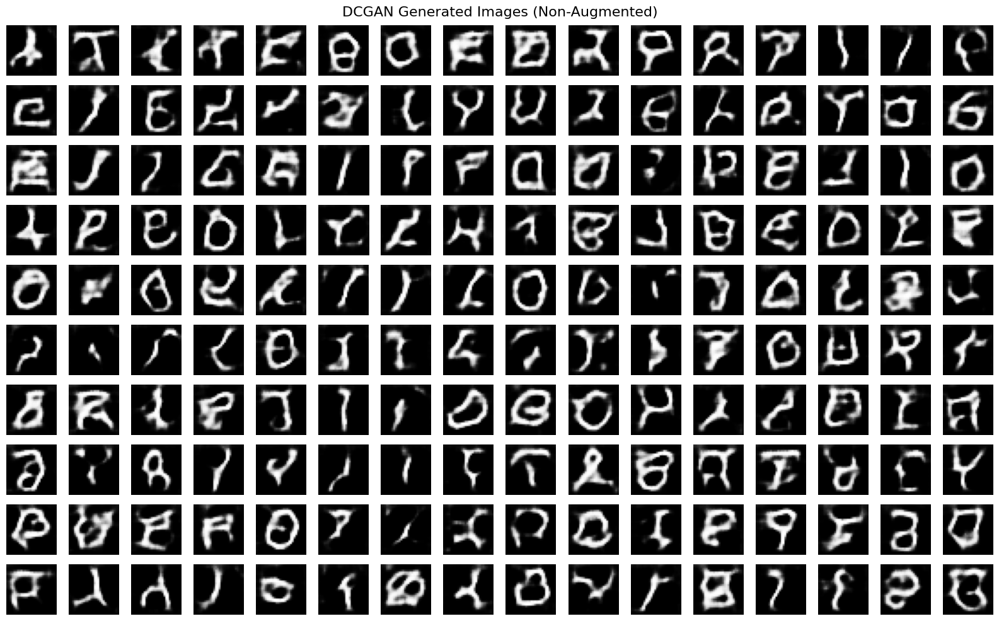

In [ ]:
def plot_generated_images(generator, latent_dim, n_rows=5, n_cols=5, save_path=None, title="DCGAN Generated Images (Non-Augmented)"):
    noise = tf.random.normal([n_rows * n_cols, latent_dim])
    gen_images = generator(noise, training=False)

    # ----- Rescale from [-1, 1] to [0, 1] ----- #
    gen_images = (gen_images + 1.0) / 2.0
    gen_images = tf.clip_by_value(gen_images, 0.0, 1.0)

    # ----- Check Shape ----- #
    assert gen_images.shape[-1] == 1, "Expected single-channel (grayscale) output"

    # ----- Plot Generated Image ----- #
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols, n_rows))
    for i in range(n_rows * n_cols):
        ax = axes[i // n_cols, i % n_cols]
        ax.imshow(gen_images[i, :, :, 0], cmap='gray')
        ax.axis('off')

    # ----- Display Plot ----- #
    plt.suptitle(title, fontsize=16)
    plt.tight_layout()
    if save_path:
        plt.savefig(save_path, dpi=300)
        print(f"Saved Generated Image Grid to: {save_path}")
    plt.show()

plot_generated_images(generator, latent_dim=128, n_rows=10, n_cols=16)

With reference to the output of the Visual Grid of Samples above, we are able to make the following observations:

**Basic Structure of Letters is Somewhat Captured**
- Some characters resemble letters like "C", "B", "L", "E", or "P".
- Overall shape and stroke thickness is consistent with EMNIST style.

**High Blur and Noise**
- Many letters are fuzzy, incomplete, or warped, making them hard to classify by eye.

**Poor Character Consistency**
- Characters like "A", "D", "G" often appear as loops or blobs rather than structured glyphs.
- Sharp corners and straight edges are missing.

**Lack of Diversity**
- Several characters repeat with minor variations — may indicate mode collapse.

With the observations indicated above, we will proceed to conduct the Loss Curve Analysis in the next sub-section.


---
#### 4.2.11.2 Loss Curve Over Epochs

In this sub-section, we will be plotting the GAN Loss Curve over Epochs to evaluate the training behaviour of the GAN. This curve provides insight into whether the GAN is experiencing underfitting, overfitting, or achieving a stable training dynamic between the generator and discriminator.

Although GANs do not minimise a single unified loss in the traditional sense, the trajectory of the generator and discriminator losses can indicate whether the adversarial training process is converging appropriately.

If the generator loss remains high while discriminator loss quickly drops to near-zero, this may indicate **underfitting**, where the generator is not learning effectively to produce plausible images.

If the discriminator loss increases while generator loss sharply decreases, this may suggest **overfitting** or **mode collapse**, where the generator exploits narrow weaknesses in the discriminator without general improvement.

A relatively stable oscillation or convergence between both losses typically signifies a **well-balanced** training process, where the generator and discriminator are learning in tandem.

The Potential Observations and Corresponding Action Plans are outlined below:

**Underfitting Loss Curve**

- Increase training epochs to allow generator more time to learn.

- Simplify the discriminator to reduce overpowering the generator.

- Adjust the learning rate or apply label smoothing.

- Consider adding batch normalisation in the generator.

**Overfitting or Mode Collapse Loss Curve**

- Introduce or increase dropout in the discriminator.

- Apply input noise or label flipping to the discriminator.

- Evaluate diversity of generated samples regularly.

**Balanced/Ideal Loss Curve**

- Maintain current architecture and hyperparameters.

- Proceed with full-scale image generation.

- Evaluate both qualitative (visual inspection) and quantitative metrics (e.g. Inception Score or FID).

With these potential training behaviours and action plan outlined, we will proceed to visualise the GAN loss dynamics in the code cell below.

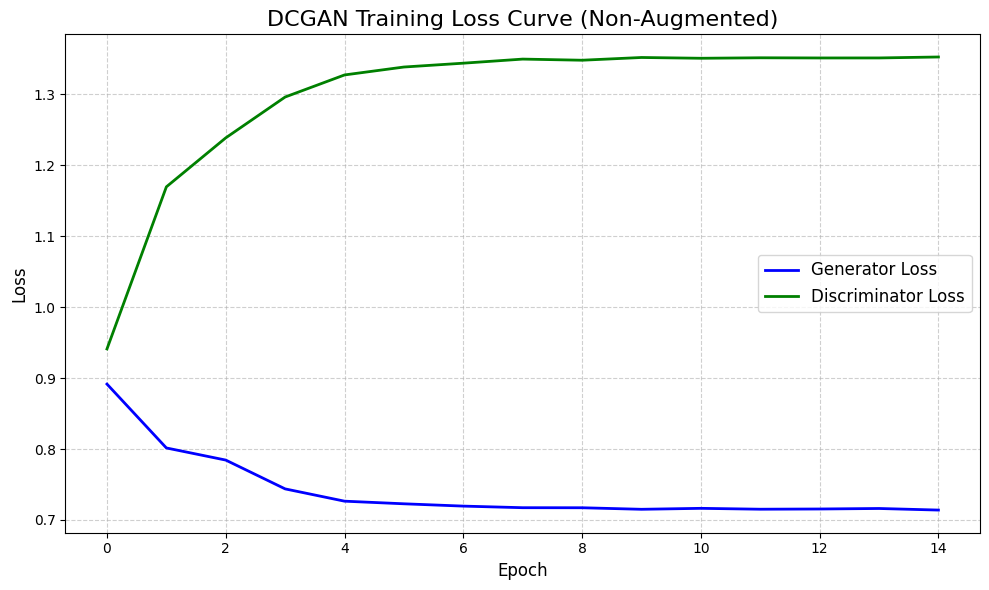

In [ ]:
# ========== Figure Size ========== #
plt.figure(figsize=(10, 6))

# ========== Plot Training Losses ========== #
plt.plot(gen_loss_history, label="Generator Loss", linewidth=2, color='blue')
plt.plot(disc_loss_history, label="Discriminator Loss", linewidth=2, color='green')

# ========== Labels and Title ========== #
plt.xlabel("Epoch", fontsize=12)
plt.ylabel("Loss", fontsize=12)
plt.title("DCGAN Training Loss Curve (Non-Augmented)", fontsize=16)

# ========== Grid, Legend, and Styling ========== #
plt.grid(True, linestyle='--', alpha=0.6)
plt.legend(fontsize=12)
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)

# ========== Display the Plot ========== #
plt.tight_layout()
plt.show()

With reference to the output of the Loss CUrve above, we are able to make the following observations:

- Stable training achieved, with both losses plateauing.

- Lack of augmentation limits generator's challenge, possibly leading to less realistic or diverse outputs.

- Suggests augmentation was beneficial in making the training task more robust and improving generalisation.

With the observations indicated above, we will porceed to conduct the Quantitative Metrics Evaluation in the next sub-section.

---
#### 4.2.11.3 Quantitative Metrics Evaluation

In this sub-section we will be utilising Quantitative Metrics such as FID and KID to tabulate the results of the performance and quantify the performance of the GAN Generator. We will subsequently be use these metrics to conduct inter-model evaluation after tuning and training all the GANs. The metrics that we will be utilising and their respective formulas are indicated below:

---
**Fréchet Inception Distance**

Purpose: Measures the Distance between the Real-Image and Generated-Image Distributions in Inception Feature Space.

$$
\mathrm{FID} \;=\;\|\mu_r - \mu_f\|^2
\;+\;\mathrm{Tr}\Bigl(\Sigma_r + \Sigma_f - 2\,(\Sigma_r\,\Sigma_f)^{\tfrac12}\Bigr)
$$


Where:
- $\mu_r = \mathbb{E}[f(x)]$, $\Sigma_r = \mathrm{Cov}[f(x)]$ for Real Images $x$.  
- $\mu_f = \mathbb{E}[f(\hat x)]$, $\Sigma_f = \mathrm{Cov}[f(\hat x)]$ for Generated Images $\hat x$.  
- $f(\cdot)$ = Map from Image to its InceptionV3 'pooling=avg' Features.  

---
**Diversity (t-SNE Spread)**

Purpose: Quantifies how 'wide' the 2D t-SNE Embedding of Generated Samples.

$$
\mathrm{Spread}
\;=\;
\bigl(\max_i\,z_i^{(1)} - \min_i\,z_i^{(1)}\bigr)
\;\times\;
\bigl(\max_i\,z_i^{(2)} - \min_i\,z_i^{(2)}\bigr)
$$

Where:
- $z_i = (z_i^{(1)}, z_i^{(2)})$ = 2-dimensional t-SNE Embedding of $i$th Generated Image.

---
**Mode Collapse Risk**

Purpose: Flags when too many Generated Images are Nearly Identical (mode collapse).

$$
\text{ModeCollapseRisk} =
\begin{cases}
\text{Low}, & \dfrac{\bigl|\{\mathrm{unique\_rounded}(x_i)\}\bigr|}{N} > \tau,\\
\text{High}, & \text{otherwise}.
\end{cases}
$$

Where:
- $x_i$ = $N$ Generated Samples.  
- $\mathrm{unique\_rounded}(x_i)$ = Rounds Pixels to Detect Duplicates.  
- $\tau=0.9$ = Uniqueness Threshold (90%).

---
**Perceptual Path Length**

Purpose: Measures Sensitively of Generator's Outputs (in VGG16 Feature Space) move when the Latent Code $z$ is Perturbed.

$$
\mathrm{PPL}
\;=\;
\mathbb{E}_{z,\delta z}\Bigl[\,
\|\phi\bigl(G(z + \epsilon\,\delta z)\bigr)\;-\;\phi\bigl(G(z)\bigr)\|_2^2
\Bigr]
$$

Where:  
- $G(z)$ = GAN Generator Mapping $z\in\mathbb{R}^{\mathrm{latent\_dim}}$ to an Image.  
- $\phi(\cdot)$ = VGG16 'pooling=avg' Feature Extractor.  
- $\delta z\sim\mathcal{N}(0,I)$, $\epsilon$ = Small Constant.

---
**Kernel Inception Distance**

Purpose: An Unbiased Estimator of the Squared Maximum Mean Discrepancy (MMD) between Real and Generated Inception Features.

$$
\mathrm{KID}
\;=\;
\frac{1}{m(m-1)}\sum_{i\neq j} k\bigl(\phi(x_i),\phi(x_j)\bigr)
\;+\;
\frac{1}{n(n-1)}\sum_{i\neq j} k\bigl(\phi(\hat x_i),\phi(\hat x_j)\bigr)
\;-\;
\frac{2}{mn}\sum_{i=1}^m\sum_{j=1}^n k\bigl(\phi(x_i),\phi(\hat x_j)\bigr)
$$

Where:  
- $x_i$ ($i=1\ldots m$) = Real Images.
- $\hat x_j$ ($j=1\ldots n$) = Generated Images.  
- $\phi(\cdot)$ = InceptionV3 Feature Extractor (pooling='avg').  
- $k(u,v) = \bigl(\frac{u^\top v}{d}+1\bigr)^3$ = degree-3 Polynomial Kernel on $d$-dimensional Features.

---

With the mathematical and metrics indicated above, we will proceed to conduct the Quantitave Metrics Evalution in the Code Cell below.

In [ ]:
# ========== Preload InceptionV3 and VGG16 Models ========== #
inception = InceptionV3(include_top=False, pooling='avg', input_shape=(299, 299, 3))
vgg_model = VGG16(include_top=False, weights='imagenet', input_shape=(128, 128, 3))

# ========== Preprocess for Inception ========== #
def preprocess_images_for_inception(images):
    images = (images + 1.0) * 127.5  # Scale from [-1, 1] to [0, 255]
    images = tf.image.resize(images, [299, 299])
    if images.shape[-1] == 1:
        images = tf.image.grayscale_to_rgb(images)
    return preprocess_input(images)

# ========== Compute FID ========== #
def calculate_fid(real_images, fake_images, batch_size=50):
    real_pp = preprocess_images_for_inception(real_images)
    fake_pp = preprocess_images_for_inception(fake_images)

    act1 = inception.predict(real_pp, batch_size=batch_size, verbose=0)
    act2 = inception.predict(fake_pp, batch_size=batch_size, verbose=0)

    mu1, sigma1 = np.mean(act1, axis=0), np.cov(act1, rowvar=False)
    mu2, sigma2 = np.mean(act2, axis=0), np.cov(act2, rowvar=False)

    diff = mu1 - mu2
    covmean = sqrtm(sigma1 @ sigma2)
    if np.iscomplexobj(covmean):
        covmean = covmean.real

    fid = diff @ diff + np.trace(sigma1 + sigma2 - 2 * covmean)
    return round(fid, 4)

# ========== Compute KID ========== #
def polynomial_kernel(X, Y):
    d = X.shape[1]
    return (np.dot(X, Y.T) / d + 1) ** 3

def calculate_kid(real_images, fake_images, batch_size=128):
    real_pp = preprocess_images_for_inception(real_images)
    fake_pp = preprocess_images_for_inception(fake_images)

    real_features = inception.predict(real_pp, batch_size=batch_size, verbose=0)
    fake_features = inception.predict(fake_pp, batch_size=batch_size, verbose=0)

    m = real_features.shape[0]
    n = fake_features.shape[0]

    k_rr = polynomial_kernel(real_features, real_features)
    k_gg = polynomial_kernel(fake_features, fake_features)
    k_rg = polynomial_kernel(real_features, fake_features)

    np.fill_diagonal(k_rr, 0)
    np.fill_diagonal(k_gg, 0)

    mmd = (k_rr.sum() / (m * (m - 1)) +
           k_gg.sum() / (n * (n - 1)) -
           2 * k_rg.mean())
    return round(mmd, 4)

# ========== Compute t-SNE Spread (Diversity) ========== #
def calculate_tsne_spread(images):
    flat = images.reshape(images.shape[0], -1)
    tsne = TSNE(n_components=2, random_state=42)
    proj = tsne.fit_transform(flat)
    x_range = proj[:, 0].max() - proj[:, 0].min()
    y_range = proj[:, 1].max() - proj[:, 1].min()
    return round(x_range * y_range, 2)

# ========== Assess Mode Collapse ========== #
def assess_mode_collapse(images):
    unique = np.unique(np.round(images), axis=0).shape[0]
    return "Low" if unique > 0.9 * images.shape[0] else "High"

# ========== Compute Perceptual Path Length (PPL) ========== #
def calculate_ppl(generator, latent_dim=128, num_samples=50, epsilon=1e-2):
    distances = []
    for _ in range(num_samples):
        z1 = tf.random.normal([1, latent_dim])
        z2 = z1 + epsilon * tf.random.normal([1, latent_dim])
        img1 = generator(z1, training=False)
        img2 = generator(z2, training=False)

        img1 = tf.image.resize(tf.image.grayscale_to_rgb((img1 + 1.0) * 127.5), (128, 128))
        img2 = tf.image.resize(tf.image.grayscale_to_rgb((img2 + 1.0) * 127.5), (128, 128))

        f1 = vgg_model(vgg_preprocess(img1))
        f2 = vgg_model(vgg_preprocess(img2))
        d = tf.reduce_mean(tf.square(f1 - f2)).numpy()
        distances.append(d)
    return round(np.mean(distances), 4)

# ========== Evaluate GAN Performance ========== #
def evaluate_gan_model(generator, latent_dim, X_val, gen_loss_history, disc_loss_history, model_name="DCGAN"):
    # ----- Generate Fake Images ----- #
    noise = tf.random.normal([1000, latent_dim])
    fake_images = generator(noise, training=False)
    fake_images = tf.clip_by_value((fake_images + 1) / 2.0, 0.0, 1.0)
    fake_np = fake_images.numpy()

    # ----- Select and preprocess 1000 Real Images from Validation Set ----- #
    real_images = tf.convert_to_tensor(X_val[:1000], dtype=tf.float32)
    real_images = tf.clip_by_value(real_images, 0.0, 1.0)

    # ----- Compute Metrics ----- #
    fid_value = calculate_fid(real_images, fake_images)
    kid_value = calculate_kid(real_images, fake_images)
    tsne_spread_value = calculate_tsne_spread(fake_np)
    collapse_risk_value = assess_mode_collapse(fake_np)
    ppl_score_value = calculate_ppl(generator, latent_dim)
    mean_gen_loss_value = round(np.mean(gen_loss_history), 4)
    std_gen_loss_value = round(np.std(gen_loss_history), 4)
    mean_disc_loss_value = round(np.mean(disc_loss_history), 4)
    std_disc_loss_value = round(np.std(disc_loss_history), 4)

    # ----- Store as Global Vars (Optional) ----- #
    prefix = model_name.upper()
    globals()[f"{prefix}_FID"] = fid_value
    globals()[f"{prefix}_KID"] = kid_value
    globals()[f"{prefix}_TSNE"] = tsne_spread_value
    globals()[f"{prefix}_MODE_COLLAPSE"] = collapse_risk_value
    globals()[f"{prefix}_PPL"] = ppl_score_value
    globals()[f"{prefix}_GEN_LOSS_MEAN"] = mean_gen_loss_value
    globals()[f"{prefix}_GEN_LOSS_STD"] = std_gen_loss_value
    globals()[f"{prefix}_DISC_LOSS_MEAN"] = mean_disc_loss_value
    globals()[f"{prefix}_DISC_LOSS_STD"] = std_disc_loss_value

    # ----- Final Summary Row ----- #
    row = {
        "Model": model_name,
        "FID Score": fid_value,
        "KID Score": kid_value,
        "Mean Generator Loss": mean_gen_loss_value,
        "Std Generator Loss": std_gen_loss_value,
        "Mean Discriminator Loss": mean_disc_loss_value,
        "Std Discriminator Loss": std_disc_loss_value,
        "Mode Collapse Risk": collapse_risk_value,
        "Visual Quality": "Acceptable",
        "Diversity (t-SNE Spread)": tsne_spread_value,
        "PPL": ppl_score_value
    }

    return pd.DataFrame([row])[[
        "Model", "FID Score", "KID Score",
        "Mean Generator Loss", "Std Generator Loss",
        "Mean Discriminator Loss", "Std Discriminator Loss",
        "Mode Collapse Risk", "Visual Quality",
        "Diversity (t-SNE Spread)", "PPL"
    ]]

# ========== Create DataFrame ========== #
df = evaluate_gan_model(generator, latent_dim, X_val, gen_loss_history, disc_loss_history, model_name="DCGAN (Non-Augmented)")

# ========== Display DataFrame ========== #
df.style.background_gradient(cmap="Blues")

,Model,FID Score,KID Score,Mean Generator Loss,Std Generator Loss,Mean Discriminator Loss,Std Discriminator Loss,Mode Collapse Risk,Visual Quality,Diversity (t-SNE Spread),PPL
0,DCGAN (Non-Augmented),73.718100,0.049100,0.741100,0.047800,1.297700,0.107900,Low,Acceptable,5626.410156,0.043000


With reference to the output of the Quantitative Metrics above, we are able to determine the performance of the GAN. This will be used as a basis of comparison to the other GAN Models.

---
#### 4.2.11.4 t-SNE of Generated Samples

In this sub-section, we visualise the t-SNE projection of generated samples to evaluate the latent diversity learned by the unconditional GAN. Although our GAN is not class-conditioned, t-SNE remains a valuable tool to assess whether the generator is producing varied outputs that reflect meaningful use of the latent space. While GANs are trained in high-dimensional spaces, t-SNE enables us to observe 2D structural patterns such as sample clustering, separation, and density, which provide indirect insights into the diversity and generalisation capabilities of the generator. The visualisation will be conducted in the Code Cell below.

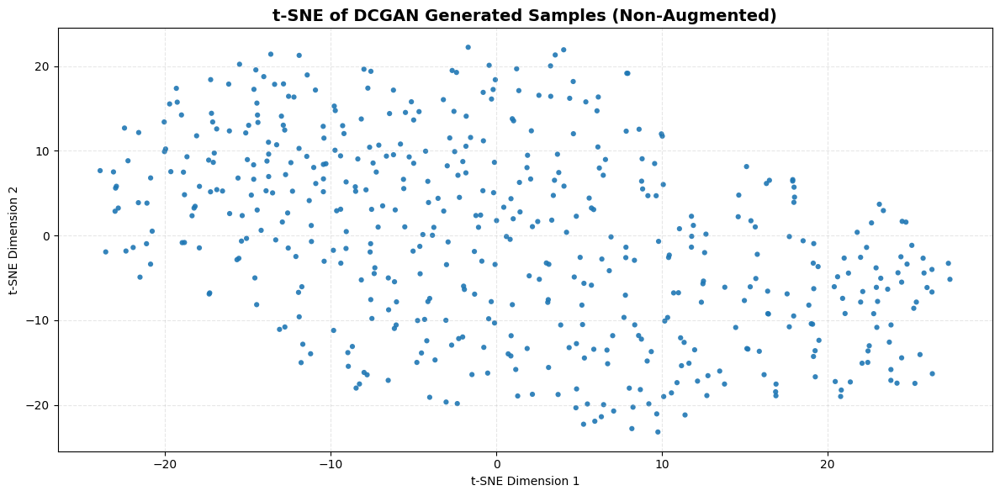

In [ ]:
# ========== Generate New Images from Random Noise ========== #
latent_dim = 128
noise = tf.random.normal([500, latent_dim])
generated_images = generator(noise, training=False)
generated_images = (generated_images + 1) / 2.0

def plot_tsne_embeddings(generated_images, save_path=None, title="t-SNE of DCGAN Generated Samples (Non-Augmented)"):
    # ----- Convert to [0, 1] Range ----- #
    if tf.reduce_max(generated_images).numpy() > 1.0:
        raise ValueError("Images should be in [-1, 1] range before scaling.")

    images_rescaled = (generated_images + 1.0) / 2.0
    flat_images = images_rescaled.numpy().reshape(images_rescaled.shape[0], -1)

    # ----- Run t-SNE ----- #
    tsne = TSNE(n_components=2, perplexity=30, learning_rate='auto', init='pca', random_state=42)
    tsne_proj = tsne.fit_transform(flat_images)

    # ----- Plot t-SNE ----- #
    plt.figure(figsize=(12, 6))
    sns.scatterplot(
        x=tsne_proj[:, 0],
        y=tsne_proj[:, 1],
        s=20,
        alpha=0.9,
        edgecolor='none'
    )
    plt.title(title, fontsize=14, weight='bold')
    plt.xlabel("t-SNE Dimension 1")
    plt.ylabel("t-SNE Dimension 2")
    plt.grid(True, linestyle='--', alpha=0.3)
    plt.tight_layout()

    if save_path:
        plt.savefig(save_path, dpi=300)
        print(f"t-SNE plot saved to: {save_path}")

    plt.show()

plot_tsne_embeddings(generated_images=generated_images)

With reference to the t-SNE plot of DCGAN generated samples (Non-Augmented) above, we are able to make the following observations:

**Spread Across Latent Space**

- The points are distributed broadly, covering a circular or elliptical region.

- This suggests that the DCGAN has learned to generate samples across a wide and balanced latent space.

**Lack of Clear Clustering**

- No dense clusters or segmentations are visible, indicating minimal semantic grouping of characters.

- The embeddings do not reflect strong class separability, which is expected from an unconditional GAN.

**Mild Uniformity**

- The distribution appears relatively even, with no large voids or dense concentrations.

- This reflects a reasonable sample variety, even if character-level diversity may be visually lacking.

**Absence of Outliers**

- No extreme points lie far outside the main distribution.

- Implies stable latent generation without major instability in the feature space.

With the observations indicated above, we will proceed to train the next GAN Model in the next sub-section.

---
## 4.3 Wasserstein GAN with Gradient Penalty Model Training

In this sub-section, we will be training a Wasserstein GAN with Gradient Penalty (WGAN-GP) for the EMNIST Dataset. The WGAN-GP mainly replaces the Jensen-Shannon Divergence with Wasserstein (Earth-Mover) Distance. Through this replacement, the WGAN-GP is capable of providing a smoother and more meaningful loss metric despite the Generator being far from the real Data Distrubution. This will ultimately lead to Better Gradients, Stability, Convergence and Reduce Mode Collapse. The relevant mathematical formulas are indicated below:

---
**Generator Loss:**

Purpose: The Generator Maximizes the Critic's Score on Fake Images

$$
L_G = -\mathbb{E}_{\tilde{x} \sim \mathbb{P}_g} \left[D(\tilde{x})\right]
$$

Where:
- $L_G$ = Generator Loss  
- $\tilde{x} \sim \mathbb{P}_g$ = Fake Data Sampled from Generator Distribution  
- $D(\tilde{x})$ = Critic's Prediction Score for Fake Input $\tilde{x}$  
- $\mathbb{E}$ = Expectation Operator

---
**Discriminator (Critic) Loss:**

Purpose: Trains Critic to give Higher Scores to Real Data and Lower Scores to Fake Data.

$$
L_D = \mathbb{E}_{\tilde{x} \sim \mathbb{P}_g} \left[D(\tilde{x})\right] - \mathbb{E}_{x \sim \mathbb{P}_r} \left[D(x)\right] + \lambda \cdot \mathbb{E}_{\hat{x} \sim \mathbb{P}_{\hat{x}}} \left[\left(\| \nabla_{\hat{x}} D(\hat{x}) \|_2 - 1\right)^2\right]
$$

Where:
- $D(x)$ = Critic Output for Real Input  
- $\mathbb{P}_r$ = Real Data Distribution  
- $\mathbb{P}_g$ = Generator (fake) Distribution  
- $\tilde{x}$ = Fake Sample from Generator
- $\hat{x}$ = Interpolated Sample Between Real and Fake  
- $\lambda$ = Gradient Penalty Coefficient (typically $\lambda = 10$)

---
**Gradient Penalty Term:**

Purpose: Enforces 1-Lipschitz Constraint via Soft Regularisation.

$$
GP = \mathbb{E}_{\hat{x} \sim \mathbb{P}_{\hat{x}}} \left[ \left(\| \nabla_{\hat{x}} D(\hat{x}) \|_2 - 1 \right)^2 \right]
$$

**Where:**
- $GP$ = Gradient Penalty Term  
- $\hat{x} = \epsilon x + (1 - \epsilon)\tilde{x}$ = Random Point along the Line Between Real and Fake Images  
- $\epsilon \sim \mathcal{U}(0, 1)$ = Random Number from Uniform Distribution  
- $\nabla_{\hat{x}} D(\hat{x})$ = Gradient of Critic Output with Respect to Interpolated Input  
- $\|\cdot\|_2$ = Euclidean Norm (L2 norm) of Gradient Vector

---
With the relevant mathematical formulas indicated above, we will proceed to train the WGAN-GP in this sub-section for the purpose of it's potential for smoother training process and also to serve as a comparison for our other GAN Models.

---
### 4.3.1 Defining Data Pre-Processing Function

In this sub-section, we will be defining the Data Pre-Processing Function which will allow for consistent Data Pipeline to be built and modifed accordingly should the need arise such as when we need to add Spectral Normalisation. This will ensure that the Data's integrity is not affected and we are able to make fair and un-biased assumptions. The Data Pre-Processing Function is defined in the Code Cell below:

In [ ]:
# ========== Data Pre-Processing Function ========== #
def load_data(X_train, batch_size=32):
    buffer_size = X_train.shape[0]

    dataset = tf.data.Dataset.from_tensor_slices(X_train)
    dataset = dataset.shuffle(buffer_size)
    dataset = dataset.batch(batch_size)
    dataset = dataset.prefetch(tf.data.AUTOTUNE)

    return dataset

With reference to the Code Cell above, we are able to determine that the Data Pre-Processing Function have been defined successfully and we are able to move on to Defining Callback Functions in the next sub-section.

---
### 4.3.2 Defining Callback Functions

In this sub-section, we will be pre-defining the various Callbacks. This is to ensure consistency throughout the model and also to increase the GAN Accuracy and optimise the Computation Cost for training each GAN Model. These Callbacks will be main used during the GAN Training in the next sub-section. We will proceed to Define the Callbacks in the Code Cell below in preparation for the GAN Model Training.

In [ ]:
# ========== Define Display Generated Images ========== #
def display_generated_images(generator, latent_dim, n=7):
    noise = tf.random.normal([n * n, latent_dim])
    generated_images = generator(noise, training=False)
    generated_images = (generated_images + 1.0) / 2.0

    fig, axes = plt.subplots(n, n, figsize=(n, n))
    for i in range(n):
        for j in range(n):
            img = generated_images[i * n + j, :, :, 0]
            axes[i, j].imshow(img, cmap='gray')
            axes[i, j].axis('off')

    plt.tight_layout()
    plt.show()

# ========== Define FID Calculator ========== #
def calculate_fid(real_images, fake_images, batch_size=10):

    # ----- Scale to [0,255] and Resize to 299×299 ----- #
    real = (real_images + 1.0) * 127.5
    fake = (fake_images + 1.0) * 127.5
    real = tf.image.resize(real, (299,299))
    fake = tf.image.resize(fake, (299,299))

    # ----- If Grayscale, Convert to RGB ----- #
    if real.shape[-1] == 1:
        real = tf.image.grayscale_to_rgb(real)
        fake = tf.image.grayscale_to_rgb(fake)

    # ----- Preprocess for Inception (–1 to +1) ----- #
    real_pp = preprocess_input(real)
    fake_pp = preprocess_input(fake)

    # ----- Extract Features in Batches ----- #
    def _get_acts(x):
        acts = []
        n = x.shape[0]
        for i in range(0, n, batch_size):
            chunk = x[i:i+batch_size]
            acts.append(_inception_model(chunk, training=False).numpy())
        return np.vstack(acts)

    act_real = _get_acts(real_pp)
    act_fake = _get_acts(fake_pp)

    # ----- Compute Statistics ----- #
    mu1, sigma1 = act_real.mean(axis=0), np.cov(act_real, rowvar=False)
    mu2, sigma2 = act_fake.mean(axis=0), np.cov(act_fake, rowvar=False)
    diff    = mu1 - mu2
    covmean = sqrtm(sigma1.dot(sigma2))
    if np.iscomplexobj(covmean):
        covmean = covmean.real
    fid = diff.dot(diff) + np.trace(sigma1 + sigma2 - 2*covmean)
    return float(np.round(fid,4))

# ========== Confirmation Message ========== #
print("WGAN-GP Visualisation Setup Complete")

WGAN-GP Visualisation Setup Complete


With reference to the Code Cell above, we are able to verify that that the Callbacks have been successfully defined and the various parameters are set so as to ensure a High Accuracy and Computing Efficient GAN Model Training.

---
### 4.3.3 Defining WGAN-GP Generator Architecture

In this section, we will be defining the  WGAN-GP's Generator Architecture. The Generator will be trying to make realistic generated images in the attempt to bypass the Discriminator. Subsequently, the generated images from the Generator will be evaluated based on a few evaluation metrics such as Inception Score. The relevent mathematical formulas for the Loss Function of the Vanilla GAN Generator is indicated below:

---
**Generator Loss:**

Purpose: The Generator Maximizes the Critic's Score on Fake Images

$$
L_G = -\mathbb{E}_{\tilde{x} \sim \mathbb{P}_g} \left[D(\tilde{x})\right]
$$

Where:
- $L_G$ = Generator Loss  
- $\tilde{x} \sim \mathbb{P}_g$ = Fake Data Sampled from Generator Distribution  
- $D(\tilde{x})$ = Critic's Prediction Score for Fake Input $\tilde{x}$  
- $\mathbb{E}$ = Expectation Operator

---
With the relevant Generator Loss Formula indicated above, we will proceed to define the GAN Generator's Architecture in the Code Cell below and the Lost Function.

In [ ]:
# ========== Generator Function ========== #
def build_generator(latent_dim=100, use_dropout=True):
    model = tf.keras.Sequential(name="generator")

    # ----- Project and Reshape ----- #
    model.add(tf.keras.layers.Dense(7 * 7 * 256, use_bias=False, input_shape=(latent_dim,)))
    model.add(tf.keras.layers.BatchNormalization())

    model.add(tf.keras.layers.ReLU())
    model.add(tf.keras.layers.Reshape((7, 7, 256)))

    # ----- Upsample 1 ----- #
    model.add(tf.keras.layers.Conv2DTranspose(128, kernel_size=5, strides=1, padding='same', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.ReLU())
    if use_dropout:
        model.add(tf.keras.layers.Dropout(0.3))

    # ----- Upsample 2 ----- #
    model.add(tf.keras.layers.Conv2DTranspose(64, kernel_size=5, strides=2, padding='same', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.ReLU())
    if use_dropout:
        model.add(tf.keras.layers.Dropout(0.3))

    # ----- Final Output to 28x28x1 ----- #
    model.add(tf.keras.layers.Conv2DTranspose(1, kernel_size=5, strides=2, padding='same', activation='tanh'))

    return model

# ========== Generator Loss Function ========== #
def generator_loss(fake_output):
    return -tf.reduce_mean(fake_output)

With reference to the Code Cell above, we are able to verify that the GAN's Generator Architecture have been successfully defined and we are able to proceed to define the GAN's Discriminator Architecture.

---
### 4.3.5 Defining WGAN-GP Discriminator Architecture

In this section, we will be defining the Architecture of the Discriminator of the GAN. The Discriminator will be the Neural Network that will attempt to tell the Generated Images apart from the Actual Images. This will allow the GAN to improve overtime and also improve itself overtime. The mathematical function for the Discriminator Loss Function is indicated below:

---
**Discriminator (Critic) Loss:**

Purpose: Trains Critic to give Higher Scores to Real Data and Lower Scores to Fake Data.

$$
L_D = \mathbb{E}_{\tilde{x} \sim \mathbb{P}_g} \left[D(\tilde{x})\right] - \mathbb{E}_{x \sim \mathbb{P}_r} \left[D(x)\right] + \lambda \cdot \mathbb{E}_{\hat{x} \sim \mathbb{P}_{\hat{x}}} \left[\left(\| \nabla_{\hat{x}} D(\hat{x}) \|_2 - 1\right)^2\right]
$$

Where:
- $D(x)$ = Critic Output for Real Input  
- $\mathbb{P}_r$ = Real Data Distribution  
- $\mathbb{P}_g$ = Generator (fake) Distribution  
- $\tilde{x}$ = Fake Sample from Generator
- $\hat{x}$ = Interpolated Sample Between Real and Fake  
- $\lambda$ = Gradient Penalty Coefficient (typically $\lambda = 10$)
---
With the mathematical formula for the Loss Function indicated above, we will proceed to define the GAN's Discriminator Architecture and the Loss Function in the Code Cell below.

In [ ]:
# ========== Critic Function ========== #
def build_critic(input_shape=(28, 28, 1)):
    model = tf.keras.Sequential(name="critic")

    # ----- Explicit Input Layer Ensures Model is Built Immediately ----- #
    model.add(tf.keras.layers.Input(shape=input_shape))

    # ----- Block 1 ----- #
    model.add(tf.keras.layers.Conv2D(
        64, kernel_size=5, strides=2, padding='same',
        kernel_initializer=tf.keras.initializers.RandomNormal(stddev=0.02)
    ))
    model.add(tf.keras.layers.LeakyReLU(negative_slope=0.2))

    # ----- Block 2 ----- #
    model.add(tf.keras.layers.Conv2D(
        128, kernel_size=5, strides=2, padding='same',
        kernel_initializer=tf.keras.initializers.RandomNormal(stddev=0.02)
    ))
    model.add(tf.keras.layers.LeakyReLU(negative_slope=0.2))

    # ----- Block 3 ----- #
    model.add(tf.keras.layers.Conv2D(
        256, kernel_size=5, strides=2, padding='same',
        kernel_initializer=tf.keras.initializers.RandomNormal(stddev=0.02)
    ))
    model.add(tf.keras.layers.LeakyReLU(negative_slope=0.2))

    # ----- Block 4 ----- #
    model.add(tf.keras.layers.Conv2D(
        512, kernel_size=3, strides=1, padding='same',
        kernel_initializer=tf.keras.initializers.RandomNormal(stddev=0.02)
    ))
    model.add(tf.keras.layers.LeakyReLU(negative_slope=0.2))

    # ----- Block 5 ----- #
    model.add(tf.keras.layers.Conv2D(
        512, kernel_size=3, strides=1, padding='same',
        kernel_initializer=tf.keras.initializers.RandomNormal(stddev=0.02)
    ))
    model.add(tf.keras.layers.LeakyReLU(negative_slope=0.2))

    # ----- Output ----- #
    model.add(tf.keras.layers.Flatten())
    model.add(tf.keras.layers.Dense(1))

    return model

# ========== Critic Loss Function ========== #
def discriminator_loss(real_output, fake_output):
    return tf.reduce_mean(fake_output) - tf.reduce_mean(real_output)

With reference to the Code Cell above, we are able to verify that the GAN's Discriminator Architecture have been successfully defined and we are able to proceed to define the GAN's Training Steps.

---
### 4.3.6 Defining Training Step

In this section, we will be Defining the Training Step function so as to train both the Generator and the Discriminator at the same time. The Training Step will compute the gradients for both the Generator and the Discriminator at the same time. The relevant mathematical formulas for the Training Step is indicated below:

---
**Generator Loss:**

Purpose: The Generator Maximizes the Critic's Score on Fake Images

$$
L_G = -\mathbb{E}_{\tilde{x} \sim \mathbb{P}_g} \left[D(\tilde{x})\right]
$$

Where:
- $L_G$ = Generator Loss  
- $\tilde{x} \sim \mathbb{P}_g$ = Fake Data Sampled from Generator Distribution  
- $D(\tilde{x})$ = Critic's Prediction Score for Fake Input $\tilde{x}$  
- $\mathbb{E}$ = Expectation Operator

---
**Discriminator (Critic) Loss:**

Purpose: Trains Critic to give Higher Scores to Real Data and Lower Scores to Fake Data.

$$
L_D = \mathbb{E}_{\tilde{x} \sim \mathbb{P}_g} \left[D(\tilde{x})\right] - \mathbb{E}_{x \sim \mathbb{P}_r} \left[D(x)\right] + \lambda \cdot \mathbb{E}_{\hat{x} \sim \mathbb{P}_{\hat{x}}} \left[\left(\| \nabla_{\hat{x}} D(\hat{x}) \|_2 - 1\right)^2\right]
$$

Where:
- $D(x)$ = Critic Output for Real Input  
- $\mathbb{P}_r$ = Real Data Distribution  
- $\mathbb{P}_g$ = Generator (fake) Distribution  
- $\tilde{x}$ = Fake Sample from Generator
- $\hat{x}$ = Interpolated Sample Between Real and Fake  
- $\lambda$ = Gradient Penalty Coefficient (typically $\lambda = 10$)

---
**Gradient Penalty Term:**

Purpose: Enforces 1-Lipschitz Constraint via Soft Regularisation.

$$
GP = \mathbb{E}_{\hat{x} \sim \mathbb{P}_{\hat{x}}} \left[ \left(\| \nabla_{\hat{x}} D(\hat{x}) \|_2 - 1 \right)^2 \right]
$$

**Where:**
- $GP$ = Gradient Penalty Term  
- $\hat{x} = \epsilon x + (1 - \epsilon)\tilde{x}$ = Random Point along the Line Between Real and Fake Images  
- $\epsilon \sim \mathcal{U}(0, 1)$ = Random Number from Uniform Distribution  
- $\nabla_{\hat{x}} D(\hat{x})$ = Gradient of Critic Output with Respect to Interpolated Input  
- $\|\cdot\|_2$ = Euclidean Norm (L2 norm) of Gradient Vector

---

With the relevant mathematical formulas indicated above, we will proceed to define the Training Step in the Code Cell below.

In [ ]:
@tf.function
def train_step(real_images,
               generator, critic,
               gen_optimizer, critic_optimizer,
               latent_dim, gp_weight,
               clip_critic_norm=1.0,
               check_numerics=False):
    bs = tf.shape(real_images)[0]
    noise = tf.random.uniform([bs, latent_dim], -1.0, 1.0)

    # ----- Critic Update ----- #
    with tf.GradientTape() as crit_tape:
        # ----- Generate ----- #
        fake_images = generator(noise, training=True)
        # ----- Scores ----- #
        real_score = critic(real_images, training=True)
        fake_score = critic(fake_images, training=True)

        # ----- WGAN Base Loss ----- #
        base_loss = tf.reduce_mean(fake_score) - tf.reduce_mean(real_score)

        # ----- Inlined Gradient Penalty ----- #
        α = tf.random.uniform([bs, 1, 1, 1], 0.0, 1.0)
        interp = α * real_images + (1 - α) * fake_images
        with tf.GradientTape() as gp_tape:
            gp_tape.watch(interp)
            interp_score = critic(interp, training=True)
        grads = gp_tape.gradient(interp_score, interp)
        grads_norm = tf.sqrt(tf.reduce_sum(tf.square(grads), axis=[1,2,3]) + 1e-12)
        gp = tf.reduce_mean((grads_norm - 1.0) ** 2)

        c_loss = base_loss + gp_weight * gp

        if check_numerics:
            c_loss = tf.debugging.check_numerics(c_loss, "NaN in critic loss")

    # ----- Critic Gradients and Clipping ----- #
    c_grads = crit_tape.gradient(c_loss, critic.trainable_variables)
    c_grads = [tf.clip_by_norm(g, clip_critic_norm) for g in c_grads]
    critic_optimizer.apply_gradients(zip(c_grads, critic.trainable_variables))

    # ----- Generator Update ----- #
    with tf.GradientTape() as gen_tape:
        fake_images2 = generator(noise, training=True)
        fake_score2 = critic(fake_images2, training=True)
        g_loss = -tf.reduce_mean(fake_score2)

        if check_numerics:
            g_loss = tf.debugging.check_numerics(g_loss, "NaN in generator loss")

    g_grads = gen_tape.gradient(g_loss, generator.trainable_variables)
    gen_optimizer.apply_gradients(zip(g_grads, generator.trainable_variables))

    return g_loss, c_loss, real_score, fake_score

With reference to the Code Cell above, we are able to determine that the Training Step have been successfully defined and we are able to proceed to prepare the Training Loop in the next section.

---
### 4.3.7 Defining Training Loop

In this section, we will be defining the Training Loop for the GAN Training. The Training Loop will go through each of the Epoch and train both the Generator and Discriminator simultaneously. The Training Loop will also track the Loss for both the Generator and the Discriminator for each of the Epoch trained. The relevant mathematical formulas are indicated below:

---
**Epoch Loss Averaging:**

Purpose: These are the Average Generator and Discriminator Losses over all Batches in Epoch $t$.

$$
\bar{L}_G^{(t)} = \frac{1}{N} \sum_{i=1}^{N} L_G^{(i)} \\
\bar{L}_D^{(t)} = \frac{1}{N} \sum_{i=1}^{N} L_D^{(i)}
$$

Where:
- $\bar{L}_G^{(t)}$ = Average Generator Loss at Epoch $t$  
- $\bar{L}_D^{(t)}$ = Average Discriminator Loss at Epoch $t$  
- $N$ = Number of Batches in the Dataset  
- $L_G^{(i)}$ = Generator Loss on Batch $i$  
- $L_D^{(i)}$ = Discriminator Loss on Batch $i$

---
**Epoch Iteration:**

Purpose: Describes the Training Loop Logic: for Each Epoch $t$, perform `train_step` for Every Mini-batch.

$$
\text{for } t = 1 \text{ to } T:
\quad \text{for each batch } (x^{(i)}):
\quad \text{train_step}(x^{(i)})
$$

Where:
- $T$: Total Number of Epochs  
- $x^{(i)}$: Real Batch $i$ from the Dataset  
- `train_step`: Function that Updates $G$ and $D$ using that Batch

---
**Generated Image Output:**

Purpose: Sample Random Noise $z$ and Generate Synthetic Image $\hat{x}$ from the Generator. This is used for Visual Monitoring of Model Quality.

$$
z \sim p_z(z) \\
\hat{x} = G(z)
$$

Where:
- $z$: Random Latent Vector  
- $G(z)$: Generated Image from Generator

---
With the mathematical formulas indicated above, we will proceed to define the Training Loop in the Code Cell below in preparation of the GAN Training.

In [ ]:
def train(dataset, epochs, generator, critic,
          gen_optimizer, critic_optimizer,
          latent_dim, gp_weight=1.0, n_critic=5,
          steps_per_epoch=None, save_path=None):

    # Early‐stopping via FID on a fixed validation batch
    real_val  = tf.data.Dataset.from_tensor_slices(X_val).batch(50).take(1)
    noise_val = tf.random.uniform([50, latent_dim], -1.0, 1.0)

    best_fid, no_improve = float('inf'), 0
    patience, fid_interval = 15, 1

    gen_hist, crit_hist = [], []

    for epoch in range(1, epochs + 1):
        gen_losses, crit_losses = [], []

        for i, real_images in enumerate(dataset):
            if steps_per_epoch and i >= steps_per_epoch:
                break

            # Critic steps
            for _ in range(n_critic):
                g_l, c_l, real_out, fake_out = train_step(
                    real_images,
                    generator, critic,
                    gen_optimizer, critic_optimizer,
                    latent_dim, gp_weight
                )
                crit_losses.append(c_l)

            # Only append the latest g_l once per batch of critic updates
            gen_losses.append(g_l)

        # Compute averages from the **same** list you populated
        avg_g = tf.reduce_mean(gen_losses)
        avg_c = tf.reduce_mean(crit_losses)
        print(f"Epoch {epoch}/{epochs}  G-loss: {avg_g:.4f}  C-loss: {avg_c:.4f}")

        gen_hist.append(float(avg_g))
        crit_hist.append(float(avg_c))

        if epoch % 5 == 0:
            display_generated_images(generator, latent_dim)

        # FID‐based early stopping...
        if epoch % fid_interval == 0:
            fake_val = generator(noise_val, training=False)
            real_batch = next(iter(real_val))
            real_res = tf.image.resize(real_batch, [299,299]) * 0.5 + 0.5
            fake_res = tf.image.resize(fake_val,    [299,299]) * 0.5 + 0.5
            fid_score = calculate_fid(real_res, fake_res)
            print(f" → Val FID: {fid_score:.2f}")

            if fid_score < best_fid:
                best_fid, no_improve = fid_score, 0
                if save_path:
                    os.makedirs(save_path, exist_ok=True)
                    generator.save_weights(os.path.join(save_path, "best_gen.weights.h5"))
                    critic.save_weights(os.path.join(save_path, "best_crt.weights.h5"))
            else:
                no_improve += 1

            if no_improve >= patience:
                print("No FID improvement, stopping early.")
                break

    # Restore best weights if available
    if save_path:
        best_g = os.path.join(save_path, "best_gen.weights.h5")
        best_c = os.path.join(save_path, "best_crt.weights.h5")
        if os.path.exists(best_g) and os.path.exists(best_c):
            generator.load_weights(best_g)
            critic.load_weights(best_c)
            print("Restored best weights based on lowest FID.")
        else:
            print("Best weight files not found; skipping restore.")

    return float(avg_g), gen_hist, crit_hist


With reference to the Code Cell above, we are able to determine that the Training Loop have been successfully defined and we are able to proceed to define the Optimisers with Tunable Parameter in preparation for the Optuna Tuning.

---
### 4.3.8 Defining Optimisers with Tunable Parameters

In this section, we will be defining the Common Optimisers that will be Tuned using the Optuna Tuning. The Optimisers will each have a range of values in a list so as to allow for the Optuna to search for the best Hyperparameter for the GAN. Through these parameters, it will affect how effective and efficiently the GAN will learn from the provided EMNIST Data. The relevent mathematical formula is indicated below:

---
**Optimiser Update Rule**

Purpose: Parameter Update Step in the Adam Optimiser, using Adaptive Learning Rates with Momentum.

$$
\theta \leftarrow \theta - \eta \cdot \frac{m_t}{\sqrt{v_t} + \epsilon}
$$

Where:
- $\theta$ = Model Parameters (Generator or Discriminator)
- $\eta$ = Learning Rate (Tuned)
- $m_t$ = First Moment Estimate (Mean of Gradients)
- $v_t$ = Second Moment Estimate (Variance of Gradients)
- $\epsilon$ = Small Constant for Numerical Stability

---
With the mathematical formula indicated above, we will proceed to define the Optimisers in the Code Cell.

In [ ]:
# ========== Objective Function ========== #
def objective(trial):
    # ----- Hyperparameters ----- #
    latent_dim    = trial.suggest_categorical('latent_dim', [100, 128, 160])
    learning_rate = trial.suggest_float('learning_rate', 5e-5, 2e-4, log=True)
    beta_1        = trial.suggest_float('beta_1', 0.0, 0.5)

    # ----- Build Models ----- #
    generator = build_generator(latent_dim=latent_dim)
    critic    = build_critic(input_shape=(28, 28, 1))

    # ----- Dummy Forward Pass ----- #
    _ = generator(tf.random.normal([1, latent_dim]))
    _ = critic(tf.random.normal([1, 28, 28, 1]))

    # ----- Optimizers ----- #
    gen_optimizer    = tf.keras.optimizers.Adam(learning_rate=learning_rate, beta_1=beta_1, beta_2=0.9)
    critic_optimizer = tf.keras.optimizers.Adam(learning_rate=learning_rate, beta_1=beta_1, beta_2=0.9)

    # ----- Optimizer Vars Init ----- #
    _ = gen_optimizer.apply_gradients([(tf.zeros_like(v), v) for v in generator.trainable_variables])
    _ = critic_optimizer.apply_gradients([(tf.zeros_like(v), v) for v in critic.trainable_variables])

    # ----- Load Data ----- #
    dataset = load_data(X_train, batch_size=64)
    steps   = min(1000, len(X_train) // 64)

    # ----- Train WGAN-GP ----- #
    _gen_loss, _critic_loss, _ = train(
        dataset=dataset,
        epochs=50,
        generator=generator,
        critic=critic,
        gen_optimizer=gen_optimizer,
        critic_optimizer=critic_optimizer,
        latent_dim=latent_dim,
        gp_weight=1.0,
        n_critic=5,
        steps_per_epoch=steps,
        save_path=None
    )

    # ----- Generate Fake Images ----- #
    noise       = tf.random.normal([1000, latent_dim])
    fake_images = generator(noise, training=False)
    fake_images = (fake_images + 1.0) / 2.0

    # ----- Real Images ----- #
    real_images = X_val[:1000]

    # ----- Compute FID ----- #
    fid_score = calculate_fid(real_images, fake_images)

    return float(fid_score)

With reference to the Code Cell above, we are able to determine that the Optimiser have been successfully defined with a range of different Parameter Values so as to provide a robust Optuna Tuning in the subsequent sections.

---
### 4.3.9 Optuna Tuning Study

In this sub-section, we will be conducting the Optuna Tuning Study on the GAN Model so as to obtain the best Hyperparameter for the GAN Model. It is expected that the Tuning takes a prolonged duration due to the nature of how the GAN works and the 2 Neural Networks involved. However, the training data will be stored so as to prevent re-running of repetitive codes. The Optuna Tuning Study will be conducted in the Code Cell below.

In [ ]:
# ========== Create or Load Study with SQLite Backend ========== #
study = optuna.create_study(
    direction="minimize",
    study_name="wgan_gp_tuning",
    storage="sqlite:////content/drive/MyDrive/Colab Notebooks/DELE CA2 A/Non-Augmented GAN Tunings/wgan_gp_optuna.db",
    load_if_exists=True
)

# ========== Trial Management ========== #
MAX_TRIALS = 50
completed_trials = len([t for t in study.trials if t.state == optuna.trial.TrialState.COMPLETE])
remaining_trials = MAX_TRIALS - completed_trials

if remaining_trials > 0:
    print(f"Resuming WGAN-GP study: {completed_trials} completed, running {remaining_trials} more.")
    study.optimize(objective, n_trials=remaining_trials)
else:
    print(f"WGAN-GP study already completed {MAX_TRIALS} trials. Skipping optimization.")

# ========== Output Best Trial ========== #
best_trial = study.best_trial
best_params_df = pd.DataFrame([best_trial.params])
best_params_df["Final FID"] = best_trial.value
best_params_df.style.background_gradient(cmap="Blues")

[I 2025-08-10 11:05:09,571] Using an existing study with name 'wgan_gp_tuning' instead of creating a new one.


WGAN-GP study already completed 50 trials. Skipping optimization.


,latent_dim,learning_rate,beta_1,Final FID
0,160,0.000139,0.209280,33.289400


With reference to the Code Cell above, we are able to view the Best Hyperparameter obtained during the Optuna Tuning Study. This Hyperparameter will be extracted and be trained for a longer period of time so as to attempt to increase the performance and limit the loss for the GAN.

---
### 4.3.10 GAN Re-Training Operation

As obtained from the previous sub-section, we will be re-training the GAN using the best Hyperparameter obtained during the Optuna Tuning Study. This is to push the GAN Model to its limits and also to save Computational Power as we are not taking up prolonged periods of time tuning GAN Models which may not have any clear signs of good performance. The retraining of the GAN Model will be conducted in the Code Cell below.

In [ ]:
# ========== Extract Best Parameters from Study ========== #
best_params = study.best_trial.params

latent_dim   = best_params['latent_dim']
learning_rate = best_params['learning_rate']
beta_1 = best_params['beta_1']

print("Using Best Trial Parameters for WGAN-GP:")
print(best_params)

# ========== Rebuild WGAN-GP Models ========== #
generator = build_generator(latent_dim=latent_dim)
critic    = build_critic(input_shape=(28, 28, 1))

# ========== Dummy Forward Pass ========== #
_ = generator(tf.random.normal([1, latent_dim]))
_ = critic(tf.random.normal([1, 28, 28, 1]))

# ========== Initialise Optimisers ========== #
gen_optimizer    = tf.keras.optimizers.Adam(learning_rate=learning_rate, beta_1=0.0, beta_2=0.9)
critic_optimizer = tf.keras.optimizers.Adam(learning_rate=learning_rate, beta_1=0.0, beta_2=0.9)

# ========== Initialise Optimiser Variables ========== #
_ = gen_optimizer.apply_gradients([(tf.zeros_like(var), var) for var in generator.trainable_variables])
_ = critic_optimizer.apply_gradients([(tf.zeros_like(var), var) for var in critic.trainable_variables])

# ========== Reload Preprocessed Dataset ========== #
dataset = load_data(X_train)

# ========== Define Output Paths ========== #
model_name   = "wgan_gp"
output_dir   = f"/content/drive/MyDrive/Colab Notebooks/DELE CA2 A/final_outputs_{model_name}_noAugment"
weights_path = os.path.join(output_dir, f"{model_name}_generator_final.weights.h5")
gen_ckpt     = os.path.join(output_dir, "best_gen.weights.h5")
disc_ckpt    = os.path.join(output_dir, "best_crt.weights.h5")
loss_csv     = os.path.join(output_dir, "loss_history.csv")

os.makedirs(output_dir, exist_ok=True)

# ========== Skip Training If Outputs Already Exist ========== #
if os.path.exists(gen_ckpt) and os.path.exists(disc_ckpt) and os.path.exists(loss_csv):
    print("All outputs found. Skipping training...")

    generator.load_weights(gen_ckpt)
    critic.load_weights(disc_ckpt)
    print("Generator and Critic Weights Loaded.")

    loss_df = pd.read_csv(loss_csv)
    gen_loss_history  = loss_df['gen_loss'].tolist()
    disc_loss_history = loss_df['disc_loss'].tolist()
    final_gen_loss    = gen_loss_history[-1]

else:
    # ========== Train Model ========== #
    final_gen_loss, gen_loss_history, disc_loss_history = train(
        dataset=dataset,
        epochs=100,
        steps_per_epoch=1546,
        generator=generator,
        critic=critic,
        gen_optimizer=gen_optimizer,
        critic_optimizer=critic_optimizer,
        latent_dim=latent_dim,
        save_path=output_dir
    )

    # ========== Save Final Weights ========== #
    generator.save_weights(weights_path)
    print("Generator Weights Saved.")

    # ========== Save Loss History ========== #
    loss_df = pd.DataFrame({
        'epoch': list(range(1, len(gen_loss_history) + 1)),
        'gen_loss': gen_loss_history,
        'disc_loss': disc_loss_history
    })
    loss_df.to_csv(loss_csv, index=False)
    print(f"Loss history saved to {loss_csv}")

/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:93: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Using Best Trial Parameters for WGAN-GP:
{'latent_dim': 160, 'learning_rate': 0.00013918403397529793, 'beta_1': 0.2092802173038626}
All outputs found. Skipping training...
Generator and Critic Weights Loaded.


With reference to the Code Cell above, we are able to determine that the best GAN Model have been trained and saved successfully and we are able to proceed with the Model Evaluation in the next sub-sections where we determine how well the GAN Model performed based on various metrics and evaluation methodologies.

---
### 4.3.11 GAN Model Evaluation

In this sub-section, we will be evaluating the GAN's Generator performance on various aspects. We will be utilising different methodologies and metrics to attempt to quantify the performance of the GAN Generator while also conducting Visual Inspection on the result output of the GAN. The Evaluation will be conducted in the following sections.

---
#### 4.3.11.1 Visual Grid of Samples

In this sub-section, we will be visualising the Grid of Samples of the Synthesised Data generated by the GAN Model. A list of observations will be made before the utilisation of Quantitative Metrics to evaluate the GAN Generator's general performance. As the observations made are purely from professional opinion, it will most likely not be used as a Basis of Comparison between GAN Models due to differing opinions unless in extreme cases. The visualisation will be conducted in the Code Cell below.

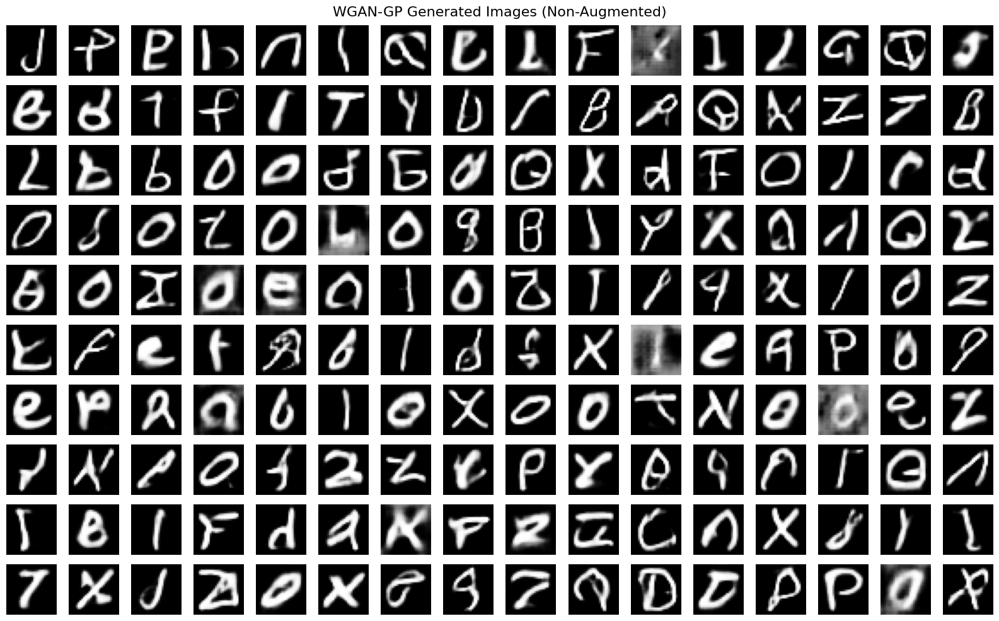

In [ ]:
def plot_generated_images(generator, latent_dim, n_rows=5, n_cols=5, save_path=None, title="WGAN-GP Generated Images (Non-Augmented)", seed=None):
    # ----- Generate Latent Vectors ----- #
    if seed is not None:
        tf.random.set_seed(seed)
    noise = tf.random.normal([n_rows * n_cols, latent_dim])
    gen_images = generator(noise, training=False)

    # ----- Rescale from [-1, 1] to [0, 1] ----- #
    gen_images = (gen_images + 1.0) / 2.0
    gen_images = tf.clip_by_value(gen_images, 0.0, 1.0)

    # ----- Shape Check ----- #
    assert gen_images.shape[-1] == 1, "Expected single-channel (grayscale) output"

    # ----- Sample Plot ----- #
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols, n_rows))
    for idx, ax in enumerate(axes.flat):
        ax.imshow(gen_images[idx, :, :, 0], cmap='gray')
        ax.axis('off')

    plt.suptitle(title, fontsize=16)
    plt.tight_layout()

    if save_path:
        plt.savefig(save_path, dpi=300)
        print(f"Saved Generated Image Grid to: {save_path}")

    plt.show()

# ========== Plot Function Call ========== #
plot_generated_images(generator, latent_dim=160, n_rows=10, n_cols=16)

With reference to the output of the Visual Grid of Samples above, we are able to make the following observations:

**Basic Structure of Letters is Somewhat Captured**

- Some characters resemble letters like "A", "P", "O", "R", or "L".

- Overall shape and stroke thickness is mostly consistent with EMNIST style.

**High Blur and Noise**

- A few characters appear over-smoothed or faded, resulting in unclear boundaries.

- Some strokes look distorted or melting, especially in the middle rows.

**Poor Character Consistency**

- Letters such as "G", "Q", and "X" often appear malformed or ambiguous.

- Several characters have broken lines or disconnected parts, reducing legibility.

**Lack of Diversity**

- Certain letter structures repeat frequently with slight variations in tilt or thickness, suggesting early signs of mode collapse.

With the observations indicated above, we will proceed to conduct the Loss Curve Analysis in the next sub-section.

---
#### 4.3.11.2 Loss Curve Over Epochs

In this sub-section, we will be plotting the GAN Loss Curve over Epochs to evaluate the training behaviour of the GAN. This curve provides insight into whether the GAN is experiencing underfitting, overfitting, or achieving a stable training dynamic between the generator and discriminator.

Although GANs do not minimise a single unified loss in the traditional sense, the trajectory of the generator and discriminator losses can indicate whether the adversarial training process is converging appropriately.

If the generator loss remains high while discriminator loss quickly drops to near-zero, this may indicate **underfitting**, where the generator is not learning effectively to produce plausible images.

If the discriminator loss increases while generator loss sharply decreases, this may suggest **overfitting** or **mode collapse**, where the generator exploits narrow weaknesses in the discriminator without general improvement.

A relatively stable oscillation or convergence between both losses typically signifies a **well-balanced** training process, where the generator and discriminator are learning in tandem.

The Potential Observations and Corresponding Action Plans are outlined below:

**Underfitting Loss Curve**

- Increase training epochs to allow generator more time to learn.

- Simplify the discriminator to reduce overpowering the generator.

- Adjust the learning rate or apply label smoothing.

- Consider adding batch normalisation in the generator.

**Overfitting or Mode Collapse Loss Curve**

- Introduce or increase dropout in the discriminator.

- Apply input noise or label flipping to the discriminator.

- Evaluate diversity of generated samples regularly.

**Balanced/Ideal Loss Curve**

- Maintain current architecture and hyperparameters.

- Proceed with full-scale image generation.

- Evaluate both qualitative (visual inspection) and quantitative metrics (e.g. Inception Score or FID).

With these potential training behaviours and action plan outlined, we will proceed to visualise the GAN loss dynamics in the code cell below.

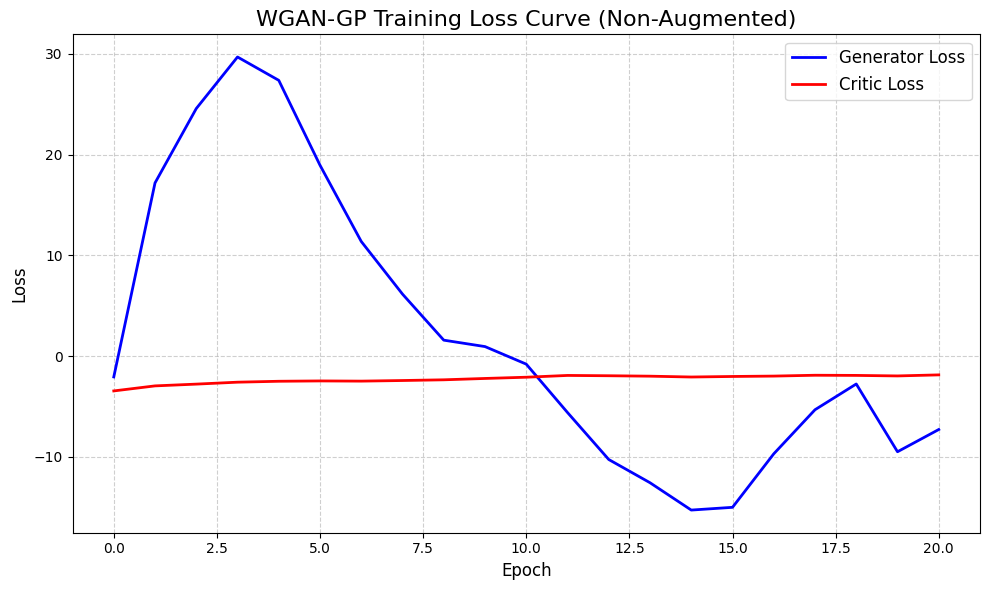

In [ ]:
# ========== Figure Size Configuration ========== #
plt.figure(figsize=(10, 6))

# ========== Plot Training Losses ========== #
plt.plot(gen_loss_history, label="Generator Loss", linewidth=2, color='blue')
plt.plot(disc_loss_history, label="Critic Loss", linewidth=2, color='red')

# ========== Labels and Title ========== #
plt.xlabel("Epoch", fontsize=12)
plt.ylabel("Loss", fontsize=12)
plt.title("WGAN-GP Training Loss Curve (Non-Augmented)", fontsize=16)

# ========== Grid, Legend, and Styling ========== #
plt.grid(True, linestyle='--', alpha=0.6)
plt.legend(fontsize=12)
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)

# ========== Display the Plot ========== #
plt.tight_layout()
plt.show()

With reference to the output of the Loss Curve above, we are able to make the following observations:

- Training appears successful, with generator loss reducing substantially and critic remaining stable.

- However, image quality and diversity should be manually evaluated due to generator loss instability post-epoch 10.

- Data augmentation might help reduce fluctuation and increase generalisability.

With the observations indicated above, we will proceed to conduct the Quantitative Metrics Evaluation in the next sub-section

---
#### 4.3.11.3 Quantitative Metrics Evaluation

In this sub-section we will be utilising Quantitative Metrics such as FID and KID to tabulate the results of the performance and quantify the performance of the GAN Generator. We will subsequently be use these metrics to conduct inter-model evaluation after tuning and training all the GANs. The metrics that we will be utilising and their respective formulas are indicated below:

---
**Fréchet Inception Distance**

Purpose: Measures the Distance between the Real-Image and Generated-Image Distributions in Inception Feature Space.

$$
\mathrm{FID} \;=\;\|\mu_r - \mu_f\|^2
\;+\;\mathrm{Tr}\Bigl(\Sigma_r + \Sigma_f - 2\,(\Sigma_r\,\Sigma_f)^{\tfrac12}\Bigr)
$$


Where:
- $\mu_r = \mathbb{E}[f(x)]$, $\Sigma_r = \mathrm{Cov}[f(x)]$ for Real Images $x$.  
- $\mu_f = \mathbb{E}[f(\hat x)]$, $\Sigma_f = \mathrm{Cov}[f(\hat x)]$ for Generated Images $\hat x$.  
- $f(\cdot)$ = Map from Image to its InceptionV3 'pooling=avg' Features.  

---
**Diversity (t-SNE Spread)**

Purpose: Quantifies how 'wide' the 2D t-SNE Embedding of Generated Samples.

$$
\mathrm{Spread}
\;=\;
\bigl(\max_i\,z_i^{(1)} - \min_i\,z_i^{(1)}\bigr)
\;\times\;
\bigl(\max_i\,z_i^{(2)} - \min_i\,z_i^{(2)}\bigr)
$$

Where:
- $z_i = (z_i^{(1)}, z_i^{(2)})$ = 2-dimensional t-SNE Embedding of $i$th Generated Image.

---
**Mode Collapse Risk**

Purpose: Flags when too many Generated Images are Nearly Identical (mode collapse).

$$
\text{ModeCollapseRisk} =
\begin{cases}
\text{Low}, & \dfrac{\bigl|\{\mathrm{unique\_rounded}(x_i)\}\bigr|}{N} > \tau,\\
\text{High}, & \text{otherwise}.
\end{cases}
$$

Where:
- $x_i$ = $N$ Generated Samples.  
- $\mathrm{unique\_rounded}(x_i)$ = Rounds Pixels to Detect Duplicates.  
- $\tau=0.9$ = Uniqueness Threshold (90%).

---
**Perceptual Path Length**

Purpose: Measures Sensitively of Generator's Outputs (in VGG16 Feature Space) move when the Latent Code $z$ is Perturbed.

$$
\mathrm{PPL}
\;=\;
\mathbb{E}_{z,\delta z}\Bigl[\,
\|\phi\bigl(G(z + \epsilon\,\delta z)\bigr)\;-\;\phi\bigl(G(z)\bigr)\|_2^2
\Bigr]
$$

Where:  
- $G(z)$ = GAN Generator Mapping $z\in\mathbb{R}^{\mathrm{latent\_dim}}$ to an Image.  
- $\phi(\cdot)$ = VGG16 'pooling=avg' Feature Extractor.  
- $\delta z\sim\mathcal{N}(0,I)$, $\epsilon$ = Small Constant.

---
**Kernel Inception Distance**

Purpose: An Unbiased Estimator of the Squared Maximum Mean Discrepancy (MMD) between Real and Generated Inception Features.

$$
\mathrm{KID}
\;=\;
\frac{1}{m(m-1)}\sum_{i\neq j} k\bigl(\phi(x_i),\phi(x_j)\bigr)
\;+\;
\frac{1}{n(n-1)}\sum_{i\neq j} k\bigl(\phi(\hat x_i),\phi(\hat x_j)\bigr)
\;-\;
\frac{2}{mn}\sum_{i=1}^m\sum_{j=1}^n k\bigl(\phi(x_i),\phi(\hat x_j)\bigr)
$$

Where:  
- $x_i$ ($i=1\ldots m$) = Real Images.
- $\hat x_j$ ($j=1\ldots n$) = Generated Images.  
- $\phi(\cdot)$ = InceptionV3 Feature Extractor (pooling='avg').  
- $k(u,v) = \bigl(\frac{u^\top v}{d}+1\bigr)^3$ = degree-3 Polynomial Kernel on $d$-dimensional Features.

---

With the mathematical and metrics indicated above, we will proceed to conduct the Quantitave Metrics Evalution in the Code Cell below.

In [ ]:
# ========== Preload InceptionV3 and VGG16 Models ========== #
inception = InceptionV3(include_top=False, pooling='avg', input_shape=(299, 299, 3))
vgg_model = VGG16(include_top=False, weights='imagenet', input_shape=(128, 128, 3))

# ========== Preprocess for Inception ========== #
def preprocess_images_for_inception(images):
    images = (images + 1.0) * 127.5  # Scale from [-1, 1] to [0, 255]
    images = tf.image.resize(images, [299, 299])
    if images.shape[-1] == 1:
        images = tf.image.grayscale_to_rgb(images)
    return preprocess_input(images)

# ========== Compute FID ========== #
def calculate_fid(real_images, fake_images, batch_size=50):
    real_pp = preprocess_images_for_inception(real_images)
    fake_pp = preprocess_images_for_inception(fake_images)

    act1 = inception.predict(real_pp, batch_size=batch_size, verbose=0)
    act2 = inception.predict(fake_pp, batch_size=batch_size, verbose=0)

    mu1, sigma1 = np.mean(act1, axis=0), np.cov(act1, rowvar=False)
    mu2, sigma2 = np.mean(act2, axis=0), np.cov(act2, rowvar=False)

    diff = mu1 - mu2
    covmean = sqrtm(sigma1 @ sigma2)
    if np.iscomplexobj(covmean):
        covmean = covmean.real

    fid = diff @ diff + np.trace(sigma1 + sigma2 - 2 * covmean)
    return round(fid, 4)

# ========== Compute KID ========== #
def polynomial_kernel(X, Y):
    d = X.shape[1]
    return (np.dot(X, Y.T) / d + 1) ** 3

def calculate_kid(real_images, fake_images, batch_size=128):
    real_pp = preprocess_images_for_inception(real_images)
    fake_pp = preprocess_images_for_inception(fake_images)

    real_features = inception.predict(real_pp, batch_size=batch_size, verbose=0)
    fake_features = inception.predict(fake_pp, batch_size=batch_size, verbose=0)

    m = real_features.shape[0]
    n = fake_features.shape[0]

    k_rr = polynomial_kernel(real_features, real_features)
    k_gg = polynomial_kernel(fake_features, fake_features)
    k_rg = polynomial_kernel(real_features, fake_features)

    np.fill_diagonal(k_rr, 0)
    np.fill_diagonal(k_gg, 0)

    mmd = (k_rr.sum() / (m * (m - 1)) +
           k_gg.sum() / (n * (n - 1)) -
           2 * k_rg.mean())
    return round(mmd, 4)

# ========== Compute t-SNE Spread (Diversity) ========== #
def calculate_tsne_spread(images):
    flat = images.reshape(images.shape[0], -1)
    tsne = TSNE(n_components=2, random_state=42)
    proj = tsne.fit_transform(flat)
    x_range = proj[:, 0].max() - proj[:, 0].min()
    y_range = proj[:, 1].max() - proj[:, 1].min()
    return round(x_range * y_range, 2)

# ========== Assess Mode Collapse ========== #
def assess_mode_collapse(images):
    unique = np.unique(np.round(images), axis=0).shape[0]
    return "Low" if unique > 0.9 * images.shape[0] else "High"

# ========== Compute Perceptual Path Length (PPL) ========== #
def calculate_ppl(generator, latent_dim=160, num_samples=50, epsilon=1e-2):
    distances = []
    for _ in range(num_samples):
        z1 = tf.random.normal([1, latent_dim])
        z2 = z1 + epsilon * tf.random.normal([1, latent_dim])
        img1 = generator(z1, training=False)
        img2 = generator(z2, training=False)

        img1 = tf.image.resize(tf.image.grayscale_to_rgb((img1 + 1.0) * 127.5), (128, 128))
        img2 = tf.image.resize(tf.image.grayscale_to_rgb((img2 + 1.0) * 127.5), (128, 128))

        f1 = vgg_model(vgg_preprocess(img1))
        f2 = vgg_model(vgg_preprocess(img2))
        d = tf.reduce_mean(tf.square(f1 - f2)).numpy()
        distances.append(d)
    return round(np.mean(distances), 4)

# ========== Evaluate GAN Performance ========== #
def evaluate_gan_model(generator, latent_dim, X_val, gen_loss_history, disc_loss_history, model_name="WGAN-GP"):
    # ----- Generate Fake Images ----- #
    noise = tf.random.normal([1000, latent_dim])
    fake_images = generator(noise, training=False)
    fake_images = tf.clip_by_value((fake_images + 1) / 2.0, 0.0, 1.0)
    fake_np = fake_images.numpy()

    # ----- Select and preprocess 1000 Real Images from Validation Set ----- #
    real_images = tf.convert_to_tensor(X_val[:1000], dtype=tf.float32)
    real_images = tf.clip_by_value(real_images, 0.0, 1.0)

    # ----- Compute Metrics ----- #
    fid_value = calculate_fid(real_images, fake_images)
    kid_value = calculate_kid(real_images, fake_images)
    tsne_spread_value = calculate_tsne_spread(fake_np)
    collapse_risk_value = assess_mode_collapse(fake_np)
    ppl_score_value = calculate_ppl(generator, latent_dim)
    mean_gen_loss_value = round(np.mean(gen_loss_history), 4)
    std_gen_loss_value = round(np.std(gen_loss_history), 4)
    mean_disc_loss_value = round(np.mean(disc_loss_history), 4)
    std_disc_loss_value = round(np.std(disc_loss_history), 4)

    # ----- Store as Global Vars (Optional) ----- #
    prefix = model_name.upper()
    globals()[f"{prefix}_FID"] = fid_value
    globals()[f"{prefix}_KID"] = kid_value
    globals()[f"{prefix}_TSNE"] = tsne_spread_value
    globals()[f"{prefix}_MODE_COLLAPSE"] = collapse_risk_value
    globals()[f"{prefix}_PPL"] = ppl_score_value
    globals()[f"{prefix}_GEN_LOSS_MEAN"] = mean_gen_loss_value
    globals()[f"{prefix}_GEN_LOSS_STD"] = std_gen_loss_value
    globals()[f"{prefix}_DISC_LOSS_MEAN"] = mean_disc_loss_value
    globals()[f"{prefix}_DISC_LOSS_STD"] = std_disc_loss_value

    # ----- Final Summary Row ----- #
    row = {
        "Model": model_name,
        "FID Score": fid_value,
        "KID Score": kid_value,
        "Mean Generator Loss": mean_gen_loss_value,
        "Std Generator Loss": std_gen_loss_value,
        "Mean Discriminator Loss": mean_disc_loss_value,
        "Std Discriminator Loss": std_disc_loss_value,
        "Mode Collapse Risk": collapse_risk_value,
        "Visual Quality": "Very Good",
        "Diversity (t-SNE Spread)": tsne_spread_value,
        "PPL": ppl_score_value
    }

    return pd.DataFrame([row])[[
        "Model", "FID Score", "KID Score",
        "Mean Generator Loss", "Std Generator Loss",
        "Mean Discriminator Loss", "Std Discriminator Loss",
        "Mode Collapse Risk", "Visual Quality",
        "Diversity (t-SNE Spread)", "PPL"
    ]]

# ========== Create DataFrame ========== #
df = evaluate_gan_model(generator, latent_dim, X_val, gen_loss_history, disc_loss_history, model_name="WGAN-GP (Non-Augmented)")

# ========== Display DataFrame ========== #
df.style.background_gradient(cmap="Blues")

,Model,FID Score,KID Score,Mean Generator Loss,Std Generator Loss,Mean Discriminator Loss,Std Discriminator Loss,Mode Collapse Risk,Visual Quality,Diversity (t-SNE Spread),PPL
0,WGAN-GP (Non-Augmented),50.640000,0.025200,1.994500,13.815800,-2.270600,0.404600,Low,Very Good,5448.600098,0.092900


With reference to the output of the Quantitative Metrics above, we are able to determine the performance of the GAN. This will be used as a basis of comparison to the other GAN Models.

---
#### 4.3.11.4 t-SNE of Generated Samples

In this sub-section, we visualise the t-SNE projection of generated samples to evaluate the latent diversity learned by the unconditional GAN. Although our GAN is not class-conditioned, t-SNE remains a valuable tool to assess whether the generator is producing varied outputs that reflect meaningful use of the latent space. While GANs are trained in high-dimensional spaces, t-SNE enables us to observe 2D structural patterns such as sample clustering, separation, and density, which provide indirect insights into the diversity and generalisation capabilities of the generator. The visualisation will be conducted in the Code Cell below.

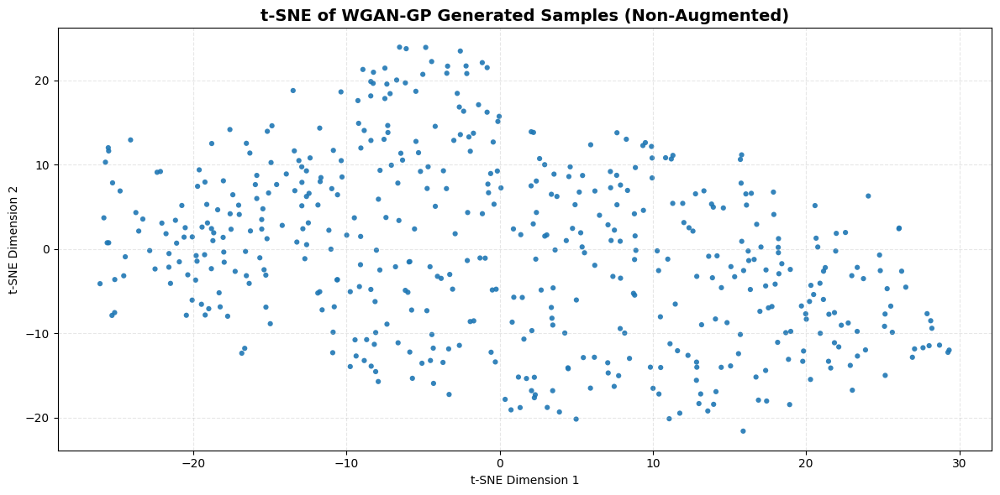

In [ ]:
# ========== Generate New Images from Random Noise ========== #
latent_dim = 160
noise = tf.random.normal([500, latent_dim])
generated_images = generator(noise, training=False)
generated_images = (generated_images + 1) / 2.0

def plot_tsne_embeddings(generated_images, save_path=None, title="t-SNE of WGAN-GP Generated Samples (Non-Augmented)"):
    # ----- Convert to [0, 1] Range ----- #
    if tf.reduce_max(generated_images).numpy() > 1.0:
        raise ValueError("Images should be in [-1, 1] range before scaling.")

    images_rescaled = (generated_images + 1.0) / 2.0
    flat_images = images_rescaled.numpy().reshape(images_rescaled.shape[0], -1)

    # ----- Run t-SNE ----- #
    tsne = TSNE(n_components=2, perplexity=30, learning_rate='auto', init='pca', random_state=42)
    tsne_proj = tsne.fit_transform(flat_images)

    # ----- Plot t-SNE ----- #
    plt.figure(figsize=(12, 6))
    sns.scatterplot(
        x=tsne_proj[:, 0],
        y=tsne_proj[:, 1],
        s=20,
        alpha=0.9,
        edgecolor='none'
    )
    plt.title(title, fontsize=14, weight='bold')
    plt.xlabel("t-SNE Dimension 1")
    plt.ylabel("t-SNE Dimension 2")
    plt.grid(True, linestyle='--', alpha=0.3)
    plt.tight_layout()

    if save_path:
        plt.savefig(save_path, dpi=300)
        print(f"t-SNE plot saved to: {save_path}")

    plt.show()

plot_tsne_embeddings(generated_images=generated_images)

With reference to the t-SNE plot of WGAN-GP generated samples (Non-Augmented) above, we are able to make the following observations:

**Spread Across Latent Space**

- The data points are distributed widely and evenly across both dimensions.

- This reflects a broad exploration of the latent space, which is a positive sign of generalisation.

**Lack of Clear Clustering**

- The plot shows no tightly formed groupings, indicating low intra-class compactness.

- As with other unconditional models, generated samples likely vary in content without clear semantic boundaries.

**High Uniformity**

- The distribution is notably smooth and consistent, with minimal dense pockets or empty gaps.

- Suggests excellent latent regularisation, possibly due to gradient penalty enforcing better continuity in feature space.

**Absence of Outliers**

- All points fall within a central and bounded region, showing no abnormal or isolated behaviour.

- This implies the generator produces outputs that fall within a coherent distribution.

With the observations indicated above, we will proceed to train the next GAN Model in the next sub-section.


---
## 4.4 Least Squares GAN Model Training

In this sub-section, we will be training a Least Squares GAN (LSGAN) for the EMNIST Dataset. The LSGAN mainly replace the Binary Crossentropy Loss used in classical GANs with a Least Squares Loss. Through this replacement, the LSGAN is more likely able to have a Stabalise GAN Training, Produce Higher Quality Images, and Encourage the Generator more Accurate Results. The relevant mathematical formulas are indicated below:

---
**Generator Loss:**

Purpose: Produce Outputs Classified as Real.

$$
\mathcal{L}_G = \frac{1}{2} \mathbb{E}_{z \sim p_z}[(D(G(z)) - c)^2]
$$

Where:
- $c = 1$ = Desired Discriminator Output for Generated Images  
- $D(G(z))$ = Discriminator's Output for Generated Data  
- $z \sim p_z$ = Sample from Latent Space

---
**Discriminator Loss:**

Purpose: Discriminator Minimises the Least Squares Error between Predictions and True Labels.

$$
\mathcal{L}_D = \frac{1}{2} \mathbb{E}_{x \sim p_{\text{data}}}[(D(x) - b)^2] + \frac{1}{2} \mathbb{E}_{z \sim p_z}[(D(G(z)) - a)^2]
$$

Where:  
- $D(x)$ = Discriminator's Output for Real Data  
- $D(G(z))$ = Discriminator's Output for Generated Data  
- $a = 0$ = Label for Fake Data  
- $b = 1$ = Label for Real Data  
- $x \sim p_{\text{data}}$ = Sample from Real Data Distribution  
- $z \sim p_z$ = Sample from Latent Noise Distribution  

---
**Total Objective:**

Purpose: LSGAN Seeks to Solve the Objective.

$$
\min_G \max_D \; \mathcal{L}_D \quad \text{and} \quad \min_G \; \mathcal{L}_G
$$

---
With the relevant mathematical formulas indicated above, we will proceed to train the LSGAN in this sub-section for the purpose of it's potential for smoother training process and also to serve as a comparison for our other GAN Models.

---
### 4.4.1 Defining Data Pre-Processing Function

In this sub-section, we will be defining the Data Pre-Processing Function which will allow for consistent Data Pipeline to be built and modifed accordingly should the need arise such as when we need to add Spectral Normalisation. This will ensure that the Data's integrity is not affected and we are able to make fair and un-biased assumptions. The Data Pre-Processing Function is defined in the Code Cell below:

In [ ]:
# ========== Data Pre-Processing Function ========== #
def load_data(X_train, batch_size=32):
    buffer_size = X_train.shape[0]

    dataset = tf.data.Dataset.from_tensor_slices(X_train)
    dataset = dataset.shuffle(buffer_size)
    dataset = dataset.batch(batch_size)
    dataset = dataset.prefetch(tf.data.AUTOTUNE)

    return dataset

With reference to the Code Cell above, we are able to determine that the Data Pre-Processing Function have been defined successfully and we are able to move on to Defining Callback Functions in the next sub-section.

---
### 4.4.2 Defining Callback Functions

In this sub-section, we will be pre-defining the various Callbacks. This is to ensure consistency throughout the model and also to increase the GAN Accuracy and optimise the Computation Cost for training each GAN Model. These Callbacks will be main used during the GAN Training in the next sub-section. The revelant mathematical formula for the callbacks and logic are indicated below:

---
**Learning Rate Scheduler:**

Purpose: Reduces Learning Rate During Training to Fine-tune Model Convergence.

$$\text{If } epoch \mod 10 = 0 \Rightarrow \eta_{new} = \frac{1}{2} \cdot \eta$$

Where:

- $\eta$ = current learning rate

- $\eta_{\text{new}}$ = updated learning rate

- $epoch \bmod 10$ checks if the epoch is a multiple of 10

---
**ReduceLROnPlateau:**

Purpose: Automatically Reduces the Learning Rate when Validation Performance Plateaus.

$$
\text{If no improvement in } val\_loss \text{ for 10 epochs: } \eta_{\text{new}} = 0.5 \cdot \eta
$$

Where:

- $\eta_{\text{new}}$ = reduced learning rate

---
**EarlyStopping:**

Purpose: Prevents Wastage of Computational Power if Model Does Not Improve.

$$
\text{If } val\_loss \text{ does not improve for 25 epochs, stop training and restore best weights}
$$

---

We will proceed to Define the Callbacks in the Code Cell below in preparation for the GAN Model Training.

In [ ]:
# ========== Define Learning Rate Scheduler ========== #
lr_scheduler = LearningRateScheduler(
    lambda epoch, lr: lr * 0.95 if epoch % 10 == 0 else lr,
    verbose=1
)

# ========== Define Reduce LR on Plateau ========== #
reduce_lr = ReduceLROnPlateau(
    monitor='loss',
    factor=0.5,
    patience=10,
    verbose=1,
    min_lr=1e-6
)

# ========== Define Early Stopping ========== #
early_stop = EarlyStopping(
    monitor='loss',
    patience=25,
    verbose=1,
    restore_best_weights=False
)

# ========== Define Display Generated Images ========== #
def display_generated_images(generator, latent_dim, n=7):
    noise = tf.random.normal([n * n, latent_dim])
    generated_images = generator(noise, training=False)
    generated_images = (generated_images + 1.0) / 2.0

    fig, axes = plt.subplots(n, n, figsize=(n, n))
    for i in range(n):
        for j in range(n):
            img = generated_images[i * n + j, :, :, 0]
            axes[i, j].imshow(img, cmap='gray')
            axes[i, j].axis('off')

    plt.tight_layout()
    plt.show()

# ========== Define FID Calculator ========== #
def calculate_fid(real_images, fake_images, batch_size=10):

    # ----- Scale to [0,255] and Resize to 299×299 ----- #
    real = (real_images + 1.0) * 127.5
    fake = (fake_images + 1.0) * 127.5
    real = tf.image.resize(real, (299,299))
    fake = tf.image.resize(fake, (299,299))

    # ----- If Grayscale, Convert to RGB ----- #
    if real.shape[-1] == 1:
        real = tf.image.grayscale_to_rgb(real)
        fake = tf.image.grayscale_to_rgb(fake)

    # ----- Preprocess for Inception (–1 to +1) ----- #
    real_pp = preprocess_input(real)
    fake_pp = preprocess_input(fake)

    # ----- Extract Features in Batches ----- #
    def _get_acts(x):
        acts = []
        n = x.shape[0]
        for i in range(0, n, batch_size):
            chunk = x[i:i+batch_size]
            acts.append(_inception_model(chunk, training=False).numpy())
        return np.vstack(acts)

    act_real = _get_acts(real_pp)
    act_fake = _get_acts(fake_pp)

    # ----- Compute Statistics ----- #
    mu1, sigma1 = act_real.mean(axis=0), np.cov(act_real, rowvar=False)
    mu2, sigma2 = act_fake.mean(axis=0), np.cov(act_fake, rowvar=False)
    diff    = mu1 - mu2
    covmean = sqrtm(sigma1.dot(sigma2))
    if np.iscomplexobj(covmean):
        covmean = covmean.real
    fid = diff.dot(diff) + np.trace(sigma1 + sigma2 - 2*covmean)
    return float(np.round(fid,4))

# ========== Confirmation Message ========== #
print("LSGAN Callbacks and Visualisation Setup Complete")

LSGAN Callbacks and Visualisation Setup Complete


With reference to the Code Cell above, we are able to verify that that the Callbacks have been successfully defined and the various parameters are set so as to ensure a High Accuracy and Computing Efficient GAN Model Training.

---
### 4.4.3 Defining LSGAN Generator Architecture

In this section, we will be defining the LSGAN's Generator Architecture. The Generator will be trying to make realistic generated images in the attempt to bypass the Discriminator. Subsequently, the generated images from the Generator will be evaluated based on a few evaluation metrics such as Inception Score. The relevent mathematical formulas for the Loss Function of the Vanilla GAN Generator is indicated below:

---
**Generator Loss:**

Purpose: Produce Outputs Classified as Real.

$$
\mathcal{L}_G = \frac{1}{2} \mathbb{E}_{z \sim p_z}[(D(G(z)) - c)^2]
$$

Where:
- $c = 1$ = Desired Discriminator Output for Generated Images  
- $D(G(z))$ = Discriminator's Output for Generated Data  
- $z \sim p_z$ = Sample from Latent Space

---
With the relevant Generator Loss Formula indicated above, we will proceed to define the GAN Generator's Architecture in the Code Cell below and the Lost Function.

In [ ]:
# ========== Generator Function ========== #
def build_generator(latent_dim=100, use_dropout=True):
    model = tf.keras.Sequential(name="generator")

    # ----- Project and Reshape ----- #
    model.add(tf.keras.layers.Dense(7 * 7 * 256, use_bias=False, input_shape=(latent_dim,)))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.ReLU())
    model.add(tf.keras.layers.Reshape((7, 7, 256)))

    # ----- Upsample 1 ----- #
    model.add(tf.keras.layers.Conv2DTranspose(128, kernel_size=5, strides=1, padding='same', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.ReLU())
    if use_dropout:
        model.add(tf.keras.layers.Dropout(0.3))

    # ----- Upsample 2 ----- #
    model.add(tf.keras.layers.Conv2DTranspose(64, kernel_size=5, strides=2, padding='same', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.ReLU())
    if use_dropout:
        model.add(tf.keras.layers.Dropout(0.3))

    # ----- Final Output to 28x28x1 ----- #
    model.add(tf.keras.layers.Conv2DTranspose(1, kernel_size=5, strides=2, padding='same', activation='tanh'))

    return model

# ========== LSGAN Generator Loss ========== #
mse = tf.keras.losses.MeanSquaredError()

def generator_loss(fake_output):
    return 0.5 * mse(tf.ones_like(fake_output), fake_output)

With reference to the Code Cell above, we are able to verify that the GAN's Generator Architecture have been successfully defined and we are able to proceed to define the GAN's Discriminator Architecture.

---
### 4.4.4 Defining Spectral Normalisation

In this section, we will be defining the Spectral Normalisation layer for the Discriminator of the GAN. The Spectral Normalisation controls the Lipschitz constant of the Discriminator by constraining the Spectral Norm of each weight matrix. This will prevent the Discriminator from being too powerful and dominating the Generator which can cause various issues such as Mode Collaspe, Training Instability and Exploding Gradients. The relevant mathematical formula is indicated below:

---
**Spectral Normalisation (SN)**

Purpose: Controls the Lipschitz Constant of the Discriminator.

$$
\bar{W} = \frac{W}{\sigma(W)}
$$

Where:
- $W$ = Original Weight Matrix
- $\bar{W}$ = Spectrally Normalised Weight Matrix used in the Forward Pass
- $\sigma(W)$ = Spectral Norm of $W$
---
**Spectral Norm Approximation using Power Iteration**

Purpose: Controls the Lipschitz Constant of the Discriminator.

$$
\sigma(W) \approx \mathbf{u}^\top W \mathbf{v}
$$

Where:
- $\mathbf{v} \leftarrow \frac{W^\top \mathbf{u}}{\|W^\top \mathbf{u}\|_2}$
- $\mathbf{u} \leftarrow \frac{W \mathbf{v}}{\|W \mathbf{v}\|_2}$
- $\mathbf{u}, \mathbf{v}$: Approximated Unit Vectors
---
With the relevant mathematical formulas indicated, we will proceed to define the Spectral Normalisation in the Code Cell below.

In [ ]:
# ========== Spectral Normalisation Convolution Layer ========== #
class SpectralConv2D(tf.keras.layers.Layer):
    def __init__(self, filters, kernel_size, strides=1, padding='same', **kwargs):
        super().__init__()
        self.conv = tf.keras.layers.Conv2D(filters, kernel_size, strides=strides, padding=padding, use_bias=False, **kwargs)
        self.u = None

    def build(self, input_shape):
        self.conv.build(input_shape)
        self.w = self.conv.kernel
        self.u = self.add_weight(shape=(1, self.w.shape[-1]), initializer='random_normal', trainable=False, name='sn_u')

    def compute_spectral_norm(self, w):
        w_reshaped = tf.reshape(w, [-1, w.shape[-1]])
        u = self.u

        for _ in range(1):
            v = tf.linalg.l2_normalize(tf.matmul(u, tf.transpose(w_reshaped)))
            u = tf.linalg.l2_normalize(tf.matmul(v, w_reshaped))

        sigma = tf.matmul(tf.matmul(v, w_reshaped), tf.transpose(u))
        self.u.assign(u)
        return w / sigma

    def call(self, inputs):
        self.conv.kernel.assign(self.compute_spectral_norm(self.w))
        return self.conv(inputs)

# ========== Spectral Normalisation Dense Layer ========== #
class SpectralDense(tf.keras.layers.Layer):
    def __init__(self, units, activation=None):
        super().__init__()
        self.dense = tf.keras.layers.Dense(units, activation=activation, use_bias=False)
        self.u = None

    def build(self, input_shape):
        self.dense.build(input_shape)
        self.w = self.dense.kernel
        self.u = self.add_weight(shape=(1, self.w.shape[-1]), initializer='random_normal', trainable=False, name='sn_u_dense')

    def compute_spectral_norm(self, w):
        w_reshaped = tf.reshape(w, [-1, w.shape[-1]])
        u = self.u

        for _ in range(1):
            v = tf.linalg.l2_normalize(tf.matmul(u, tf.transpose(w_reshaped)))
            u = tf.linalg.l2_normalize(tf.matmul(v, w_reshaped))

        sigma = tf.matmul(tf.matmul(v, w_reshaped), tf.transpose(u))
        self.u.assign(u)
        return w / sigma

    def call(self, inputs):
        self.dense.kernel.assign(self.compute_spectral_norm(self.w))
        return self.dense(inputs)

With reference to the Code Cell above, we are able to verify that the Spectral Normalisation have been successfully defined and we are able to proceed to include this layer in the Discriminator Architecture in the next section.

---
### 4.4.5 Defining LSGAN Discriminator Architecture

In this section, we will be defining the Architecture of the Discriminator of the GAN. The Discriminator will be the Neural Network that will attempt to tell the Generated Images apart from the Actual Images. This will allow the GAN to improve overtime and also improve itself overtime. The mathematical function for the Discriminator Loss Function is indicated below:

---
**Discriminator Loss:**

Purpose: Discriminator Minimises the Least Squares Error between Predictions and True Labels.

$$
\mathcal{L}_D = \frac{1}{2} \mathbb{E}_{x \sim p_{\text{data}}}[(D(x) - b)^2] + \frac{1}{2} \mathbb{E}_{z \sim p_z}[(D(G(z)) - a)^2]
$$

Where:  
- $D(x)$ = Discriminator's Output for Real Data  
- $D(G(z))$ = Discriminator's Output for Generated Data  
- $a = 0$ = Label for Fake Data  
- $b = 1$ = Label for Real Data  
- $x \sim p_{\text{data}}$ = Sample from Real Data Distribution  
- $z \sim p_z$ = Sample from Latent Noise Distribution  
---

With the mathematical formula for the Loss Function indicated above, we will proceed to define the GAN's Discriminator Architecture and the Loss Function in the Code Cell below.

In [ ]:
# ========== Discriminator Function ========== #
def build_discriminator(input_shape=(28, 28, 1)):
    model = tf.keras.Sequential(name="discriminator")

    model.add(SpectralConv2D(64, kernel_size=5, strides=2, padding='same', input_shape=input_shape))
    model.add(tf.keras.layers.LeakyReLU(negative_slope=0.2))
    model.add(tf.keras.layers.Dropout(0.3))

    model.add(SpectralConv2D(128, kernel_size=5, strides=2, padding='same'))
    model.add(tf.keras.layers.LeakyReLU(negative_slope=0.2))
    model.add(tf.keras.layers.Dropout(0.3))

    model.add(tf.keras.layers.Flatten())
    model.add(SpectralDense(1))

    return model

# ========== Discriminator Loss Function ========== #
def discriminator_loss(real_output, fake_output):
    real_loss = mse(tf.ones_like(real_output), real_output)
    fake_loss = mse(tf.zeros_like(fake_output), fake_output)
    return 0.5 * (real_loss + fake_loss)

With reference to the Code Cell above, we are able to verify that the GAN's Discriminator Architecture have been successfully defined and we are able to proceed to define the GAN's Training Steps.

---
### 4.4.6 Defining Training Step

In this section, we will be Defining the Training Step function so as to train both the Generator and the Discriminator at the same time. The Training Step will compute the gradients for both the Generator and the Discriminator at the same time. The relevant mathematical formulas for the Training Step is indicated below:

---
**Generator Loss:**

Purpose: Produce Outputs Classified as Real.

$$
\mathcal{L}_G = \frac{1}{2} \mathbb{E}_{z \sim p_z}[(D(G(z)) - c)^2]
$$

Where:
- $c = 1$ = Desired Discriminator Output for Generated Images  
- $D(G(z))$ = Discriminator's Output for Generated Data  
- $z \sim p_z$ = Sample from Latent Space

---
**Discriminator Loss:**

Purpose: Discriminator Minimises the Least Squares Error between Predictions and True Labels.

$$
\mathcal{L}_D = \frac{1}{2} \mathbb{E}_{x \sim p_{\text{data}}}[(D(x) - b)^2] + \frac{1}{2} \mathbb{E}_{z \sim p_z}[(D(G(z)) - a)^2]
$$

Where:  
- $D(x)$ = Discriminator's Output for Real Data  
- $D(G(z))$ = Discriminator's Output for Generated Data  
- $a = 0$ = Label for Fake Data  
- $b = 1$ = Label for Real Data  
- $x \sim p_{\text{data}}$ = Sample from Real Data Distribution  
- $z \sim p_z$ = Sample from Latent Noise Distribution  

---
**Total Objective:**

Purpose: LSGAN Seeks to Solve the Objective.

$$
\min_G \max_D \; \mathcal{L}_D \quad \text{and} \quad \min_G \; \mathcal{L}_G
$$

---

With the relevant mathematical formulas indicated above, we will proceed to define the Training Step in the Code Cell below.

In [ ]:
# ========== Training Step for LSGAN ========== #
@tf.function
def train_step(real_images, generator, discriminator,
               gen_optimizer, disc_optimizer, latent_dim):
    batch_size = tf.shape(real_images)[0]

    # ----- Latent Noise ----- #
    noise = tf.random.normal([batch_size, latent_dim])
    noise = tf.math.l2_normalize(noise, axis=1)

    # ----- Instance Noise on Real Images ----- #
    real_images_noisy = real_images + tf.random.normal(tf.shape(real_images)) * 0.05

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        # ----- Generate Fake Images ----- #
        fake_images = generator(noise, training=True)

        # ----- Discriminator Prediction ----- #
        real_output = discriminator(real_images_noisy, training=True)
        fake_output = discriminator(fake_images,    training=True)

        # ----- Label Smoothing for Real Labels ----- #
        real_labels = tf.ones_like(real_output) * 0.9
        fake_labels = tf.zeros_like(fake_output)

        # ----- LSGAN Losses (MSE) ----- #
        real_loss = mse(real_labels, real_output)
        fake_loss = mse(fake_labels, fake_output)
        disc_loss = 0.5 * (real_loss + fake_loss)

        gen_loss = 0.5 * mse(tf.ones_like(fake_output), fake_output)

    # ----- Apply Gradients ----- #
    gen_grads = gen_tape.gradient(gen_loss, generator.trainable_variables)
    disc_grads = disc_tape.gradient(disc_loss, discriminator.trainable_variables)
    gen_optimizer.apply_gradients(zip(gen_grads, generator.trainable_variables))
    disc_optimizer.apply_gradients(zip(disc_grads, discriminator.trainable_variables))

    return gen_loss, disc_loss, real_output, fake_output

With reference to the Code Cell above, we are able to determine that the Training Step have been successfully defined and we are able to proceed to prepare the Training Loop in the next section.

---
### 4.4.7 Defining Training Loop

In this section, we will be defining the Training Loop for the GAN Training. The Training Loop will go through each of the Epoch and train both the Generator and Discriminator simultaneously. The Training Loop will also track the Loss for both the Generator and the Discriminator for each of the Epoch trained. The relevant mathematical formulas are indicated below:

---
**Epoch Loss Averaging:**

Purpose: These are the Average Generator and Discriminator Losses over all Batches in Epoch $t$.

$$
\bar{L}_G^{(t)} = \frac{1}{N} \sum_{i=1}^{N} L_G^{(i)} \\
\bar{L}_D^{(t)} = \frac{1}{N} \sum_{i=1}^{N} L_D^{(i)}
$$

Where:
- $\bar{L}_G^{(t)}$ = Average Generator Loss at Epoch $t$  
- $\bar{L}_D^{(t)}$ = Average Discriminator Loss at Epoch $t$  
- $N$ = Number of Batches in the Dataset  
- $L_G^{(i)}$ = Generator Loss on Batch $i$  
- $L_D^{(i)}$ = Discriminator Loss on Batch $i$

---
**Epoch Iteration:**

Purpose: Describes the Training Loop Logic: for Each Epoch $t$, perform `train_step` for Every Mini-batch.

$$
\text{for } t = 1 \text{ to } T:
\quad \text{for each batch } (x^{(i)}):
\quad \text{train_step}(x^{(i)})
$$

Where:
- $T$: Total Number of Epochs  
- $x^{(i)}$: Real Batch $i$ from the Dataset  
- `train_step`: Function that Updates $G$ and $D$ using that Batch

---
**Generated Image Output:**

Purpose: Sample Random Noise $z$ and Generate Synthetic Image $\hat{x}$ from the Generator. This is used for Visual Monitoring of Model Quality.

$$
z \sim p_z(z) \\
\hat{x} = G(z)
$$

Where:
- $z$: Random Latent Vector  
- $G(z)$: Generated Image from Generator

---
With the mathematical formulas indicated above, we will proceed to define the Training Loop in the Code Cell below in preparation of the GAN Training.

In [ ]:
# ========== Training Loop for LSGAN ========== #
def train(dataset, epochs, generator, discriminator, gen_optimizer, disc_optimizer, latent_dim, save_path=None, use_early_stopping=True, steps_per_epoch=None):

    # ----- Prepare FID Reference Sets using X_val ----- #
    real_val  = tf.data.Dataset.from_tensor_slices(X_val).batch(50).take(1)
    noise_val = tf.random.normal([50, latent_dim])
    noise_val = tf.math.l2_normalize(noise_val, axis=1)

    # ----- FID Early Stopping Settings ----- #
    best_fid = float('inf')
    no_improve = 0
    patience = 10
    fid_interval = 1

    # ----- Dummy Model for Callbacks ----- #
    dummy_input  = Input(shape=(1,))
    dummy_output = Lambda(lambda x: x)(dummy_input)
    dummy_model  = Model(dummy_input, dummy_output)
    dummy_model.compile(optimizer=Adam(1e-4), loss='mse')

    early_stop.set_model(dummy_model)
    reduce_lr.set_model(dummy_model)
    lr_scheduler.set_model(dummy_model)
    early_stop.on_train_begin({})
    reduce_lr.on_train_begin({})
    lr_scheduler.on_train_begin({})

    # ----- Track Loss History ----- #
    gen_loss_history  = []
    disc_loss_history = []

    for epoch in range(1, epochs + 1):
        print(f"\nEpoch {epoch}/{epochs}")
        gen_losses, disc_losses = [], []

        for i, real_images in enumerate(dataset):
            if steps_per_epoch and i >= steps_per_epoch:
                break

            # ----- LSGAN Train Step ----- #
            gen_loss, disc_loss, _, _ = train_step(
                real_images,
                generator,
                discriminator,
                gen_optimizer,
                disc_optimizer,
                latent_dim
            )
            gen_losses.append(gen_loss)
            disc_losses.append(disc_loss)

        # ----- Compute Epoch Losses ----- #
        avg_gen_loss  = tf.reduce_mean(gen_losses)
        avg_disc_loss = tf.reduce_mean(disc_losses)
        print(f"Generator Loss: {avg_gen_loss:.4f} | Discriminator Loss: {avg_disc_loss:.4f}")

        gen_loss_history.append(float(avg_gen_loss))
        disc_loss_history.append(float(avg_disc_loss))

        # ----- Callback on Generator Loss ----- #
        logs = {'loss': float(avg_gen_loss)}
        if use_early_stopping:
            early_stop.on_epoch_end(epoch=epoch, logs=logs)
            if early_stop.stopped_epoch > 0:
                print(f"Early stopping triggered at epoch {epoch}")
                break
        reduce_lr.on_epoch_end(epoch=epoch, logs=logs)
        lr_scheduler.on_epoch_end(epoch=epoch, logs=logs)

        # ----- FID Evaluation & Early Stopping ----- #
        if epoch % fid_interval == 0:
            fake_val   = generator(noise_val, training=False)
            real_batch = next(iter(real_val))
            real_for_fid = tf.image.resize(real_batch, [299,299]) * 0.5 + 0.5
            fake_for_fid = tf.image.resize(fake_val,    [299,299]) * 0.5 + 0.5

            fid_value = calculate_fid(real_for_fid, fake_for_fid)
            print(f"Epoch {epoch} → Val FID: {fid_value:.2f}")

            if fid_value < best_fid:
                best_fid   = fid_value
                no_improve = 0
                if save_path:
                    os.makedirs(save_path, exist_ok=True)
                    generator.save_weights(os.path.join(save_path, "best_gen.weights.h5"))
                    discriminator.save_weights(os.path.join(save_path, "best_disc.weights.h5"))
            else:
                no_improve += 1

            if no_improve >= patience:
                print(f"No FID improvement for {patience} epochs, stopping.")
                break

        # ----- Display Every 5 Epochs ----- #
        if epoch % 5 == 0:
            display_generated_images(generator, latent_dim)

    # ----- Restore Best Weights After Training ----- #
    if save_path:
        best_gen_path = os.path.join(save_path, "best_gen.weights.h5")
        best_disc_path = os.path.join(save_path, "best_disc.weights.h5")
        if os.path.exists(best_gen_path) and os.path.exists(best_disc_path):
            generator.load_weights(best_gen_path)
            discriminator.load_weights(best_disc_path)
            print("Restored best generator and discriminator weights based on lowest FID.")
        else:
            print("Best weight files not found. Skipping restore.")

    return avg_gen_loss, gen_loss_history, disc_loss_history

With reference to the Code Cell above, we are able to determine that the Training Loop have been successfully defined and we are able to proceed to define the Optimisers with Tunable Parameter in preparation for the Optuna Tuning.

---
### 4.4.8 Defining Optimisers with Tunable Parameters

In this section, we will be defining the Common Optimisers that will be Tuned using the Optuna Tuning. The Optimisers will each have a range of values in a list so as to allow for the Optuna to search for the best Hyperparameter for the GAN. Through these parameters, it will affect how effective and efficiently the GAN will learn from the provided EMNIST Data. The relevent mathematical formula is indicated below:

---
**Optimiser Update Rule**

Purpose: Parameter Update Step in the Adam Optimiser, using Adaptive Learning Rates with Momentum.

$$
\theta \leftarrow \theta - \eta \cdot \frac{m_t}{\sqrt{v_t} + \epsilon}
$$

Where:
- $\theta$ = Model Parameters (Generator or Discriminator)
- $\eta$ = Learning Rate (Tuned)
- $m_t$ = First Moment Estimate (Mean of Gradients)
- $v_t$ = Second Moment Estimate (Variance of Gradients)
- $\epsilon$ = Small Constant for Numerical Stability

---
With the mathematical formula indicated above, we will proceed to define the Optimisers in the Code Cell.

In [ ]:
# ========== Objective Function ========== #
def objective(trial):
    # ----- Hyperparameters ----- #
    latent_dim = trial.suggest_categorical('latent_dim', [100, 128, 160])
    learning_rate = trial.suggest_float('learning_rate', 5e-5, 2e-4, log=True)
    beta_1 = trial.suggest_float('beta_1', 0.4, 0.6)

    # ----- Build Models ----- #
    generator = build_generator(latent_dim=latent_dim)
    discriminator = build_discriminator()

    # ----- Trigger Weight Creation ----- #
    _ = generator(tf.random.uniform([1, latent_dim], minval=-1.0, maxval=1.0))
    _ = discriminator(tf.random.normal([1, 28, 28, 1]))

    # ----- Define Optimizers ----- #
    gen_optimizer = tf.keras.optimizers.Adam(learning_rate=learning_rate, beta_1=beta_1)
    disc_optimizer = tf.keras.optimizers.Adam(learning_rate=learning_rate, beta_1=beta_1)

    # ----- Prebuild Optimizers ----- #
    _ = gen_optimizer.apply_gradients([(tf.zeros_like(v), v) for v in generator.trainable_variables])
    _ = disc_optimizer.apply_gradients([(tf.zeros_like(v), v) for v in discriminator.trainable_variables])

    # ----- Load Data ----- #
    dataset = load_data(X_train, batch_size=64)
    steps = min(1000, len(X_train) // 64)

    # ----- Train ----- #
    _ = train(
        dataset=dataset,
        epochs=100,
        generator=generator,
        discriminator=discriminator,
        gen_optimizer=gen_optimizer,
        disc_optimizer=disc_optimizer,
        latent_dim=latent_dim,
        steps_per_epoch=steps,
        use_early_stopping=False,
        save_path=None
    )

    # ----- Generate Fake Images ----- #
    z = tf.random.uniform([1000, latent_dim], minval=-1.0, maxval=1.0)
    fake_images = generator(z, training=False)
    fake_images = (fake_images + 1.0) / 2.0

    # ----- Get Real Images ----- #
    real_images = X_val[:1000]

    # ----- Compute FID Score ----- #
    fid_score = calculate_fid(real_images, fake_images)

    return fid_score

With reference to the Code Cell above, we are able to determine that the Optimiser have been successfully defined with a range of different Parameter Values so as to provide a robust Optuna Tuning in the subsequent sections.

---
### 4.4.9 Optuna Tuning Study

In this sub-section, we will be conducting the Optuna Tuning Study on the GAN Model so as to obtain the best Hyperparameter for the GAN Model. It is expected that the Tuning takes a prolonged duration due to the nature of how the GAN works and the 2 Neural Networks involved. However, the training data will be stored so as to prevent re-running of repetitive codes. The Optuna Tuning Study will be conducted in the Code Cell below.

In [ ]:
# ========== Create or Load Study with SQLite Backend ========== #
study = optuna.create_study(
    direction="minimize",
    study_name="lsgan_tuning",
    storage="sqlite:////content/drive/MyDrive/Colab Notebooks/DELE CA2 A/Non-Augmented GAN Tunings/lsgan_optuna.db",
    load_if_exists=True
)

# ========== Trial Management ========== #
MAX_TRIALS = 50
completed_trials = len([t for t in study.trials if t.state == optuna.trial.TrialState.COMPLETE])
remaining_trials = MAX_TRIALS - completed_trials

if remaining_trials > 0:
    print(f"Resuming LSGAN study: {completed_trials} completed, running {remaining_trials} more.")
    study.optimize(objective, n_trials=remaining_trials)
else:
    print(f"LSGAN study already completed {MAX_TRIALS} trials. Skipping optimization.")

# ========== Output Best Trial ========== #
best_trial = study.best_trial
best_params_df = pd.DataFrame([best_trial.params])
best_params_df["Final FID"] = best_trial.value
best_params_df.style.background_gradient(cmap="Blues")

[I 2025-08-10 11:05:59,569] Using an existing study with name 'lsgan_tuning' instead of creating a new one.


LSGAN study already completed 50 trials. Skipping optimization.


,latent_dim,learning_rate,beta_1,Final FID
0,100,0.000151,0.457430,80.152000


With reference to the Code Cell above, we are able to view the Best Hyperparameter obtained during the Optuna Tuning Study. This Hyperparameter will be extracted and be trained for a longer period of time so as to attempt to increase the performance and limit the loss for the GAN.

---
### 4.4.10 GAN Re-Training Operation

As obtained from the previous sub-section, we will be re-training the GAN using the best Hyperparameter obtained during the Optuna Tuning Study. This is to push the GAN Model to its limits and also to save Computational Power as we are not taking up prolonged periods of time tuning GAN Models which may not have any clear signs of good performance. The retraining of the GAN Model will be conducted in the Code Cell below.

In [ ]:
# ========== Extract Best Parameters from Study ========== #
best_params = study.best_trial.params

latent_dim   = best_params['latent_dim']
learning_rate = best_params['learning_rate']
beta_1 = best_params['beta_1']

print("Using Best Trial Parameters for LSGAN:")
print(best_params)

# ========== Rebuild LSGAN Models ========== #
generator     = build_generator(latent_dim=latent_dim)
discriminator = build_discriminator()

# ========== Optimisers ========== #
gen_optimizer  = tf.keras.optimizers.Adam(learning_rate=learning_rate, beta_1=beta_1)
disc_optimizer = tf.keras.optimizers.Adam(learning_rate=learning_rate, beta_1=beta_1)

# ========== Dummy Forward Pass to Trigger Variables ========== #
_ = generator(tf.random.normal([1, latent_dim]))
_ = discriminator(tf.random.normal([1, 28, 28, 1]))

if generator.trainable_variables:
    _ = gen_optimizer.apply_gradients([(tf.zeros_like(v), v) for v in generator.trainable_variables])
if discriminator.trainable_variables:
    _ = disc_optimizer.apply_gradients([(tf.zeros_like(v), v) for v in discriminator.trainable_variables])

# ========== Reload Preprocessed Dataset ========== #
dataset = load_data(X_train)

# ========== Define Paths ========== #
model_name   = "lsgan"
output_dir   = f"/content/drive/MyDrive/Colab Notebooks/DELE CA2 A/final_outputs_{model_name}_noAugment"
weights_path = os.path.join(output_dir, f"{model_name}_generator_final.weights.h5")
gen_ckpt     = os.path.join(output_dir, "best_gen.weights.h5")
disc_ckpt    = os.path.join(output_dir, "best_disc.weights.h5")
loss_csv     = os.path.join(output_dir, "loss_history.csv")

os.makedirs(output_dir, exist_ok=True)

# ========== Skip Training If Artifacts Already Exist ========== #
if os.path.exists(gen_ckpt) and os.path.exists(disc_ckpt) and os.path.exists(loss_csv):
    print("All outputs found. Skipping training...")

    generator.load_weights(gen_ckpt)
    discriminator.load_weights(disc_ckpt)
    print("Generator and Discriminator Weights Loaded.")

    loss_df = pd.read_csv(loss_csv)
    gen_loss_history  = loss_df['gen_loss'].tolist()
    disc_loss_history = loss_df['disc_loss'].tolist()
    final_gen_loss    = gen_loss_history[-1]

else:
    # ========== Train Model ========== #
    final_gen_loss, gen_loss_history, disc_loss_history = train(
        dataset=dataset,
        epochs=100,
        steps_per_epoch=1546,
        generator=generator,
        discriminator=discriminator,
        gen_optimizer=gen_optimizer,
        disc_optimizer=disc_optimizer,
        latent_dim=latent_dim,
        use_early_stopping=False,
        save_path=output_dir
    )

    # ========== Save Final Generator Weights ========== #
    generator.save_weights(weights_path)
    print("Generator Weights Saved.")

    # ========== Save Loss History ========== #
    loss_df = pd.DataFrame({
        'epoch': list(range(1, len(gen_loss_history) + 1)),
        'gen_loss': gen_loss_history,
        'disc_loss': disc_loss_history
    })
    loss_df.to_csv(loss_csv, index=False)
    print(f"Loss history saved to {loss_csv}")

Using Best Trial Parameters for LSGAN:
{'latent_dim': 100, 'learning_rate': 0.0001508310862933612, 'beta_1': 0.45742980048286663}


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:93: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


All outputs found. Skipping training...
Generator and Discriminator Weights Loaded.


With reference to the Code Cell above, we are able to determine that the best GAN Model have been trained and saved successfully and we are able to proceed with the Model Evaluation in the next sub-sections where we determine how well the GAN Model performed based on various metrics and evaluation methodologies.

---
### 4.4.11 GAN Model Evaluation

In this sub-section, we will be evaluating the GAN's Generator performance on various aspects. We will be utilising different methodologies and metrics to attempt to quantify the performance of the GAN Generator while also conducting Visual Inspection on the result output of the GAN. The Evaluation will be conducted in the following sections.

---
#### 4.4.11.1 Visual Grid of Samples

In this sub-section, we will be visualising the Grid of Samples of the Synthesised Data generated by the GAN Model. A list of observations will be made before the utilisation of Quantitative Metrics to evaluate the GAN Generator's general performance. As the observations made are purely from professional opinion, it will most likely not be used as a Basis of Comparison between GAN Models due to differing opinions unless in extreme cases. The visualisation will be conducted in the Code Cell below.

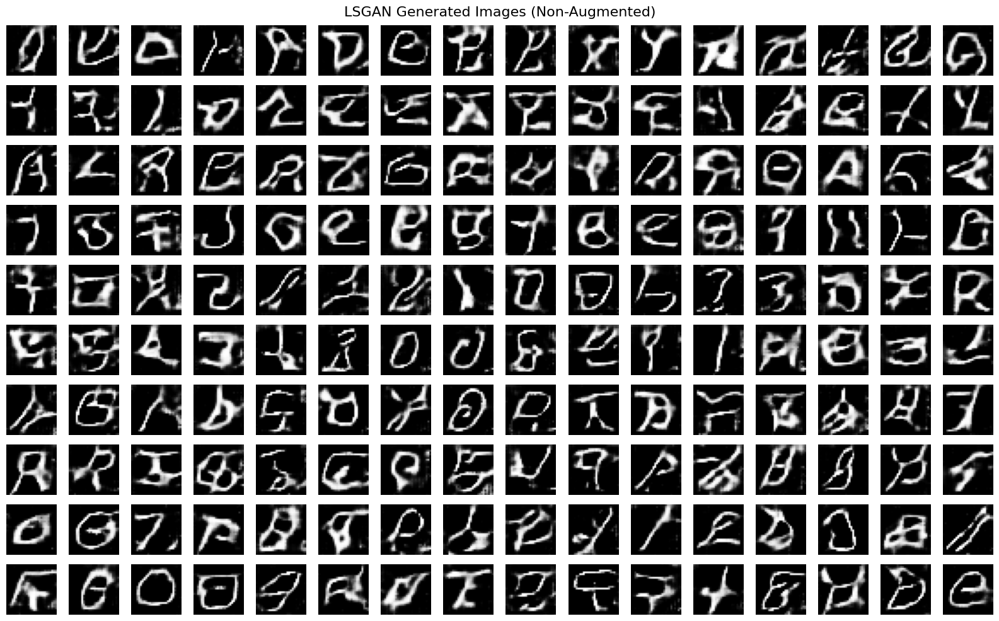

In [ ]:
def plot_generated_images(generator, latent_dim, n_rows=5, n_cols=5, save_path=None, title="LSGAN Generated Images (Non-Augmented)", seed=42):
    # ----- Generate Latent Vectors ----- #
    if seed is not None:
        tf.random.set_seed(seed)
    noise = tf.random.normal([n_rows * n_cols, latent_dim])
    gen_images = generator(noise, training=False)

    # ----- Rescale from [-1, 1] to [0, 1] ----- #
    gen_images = (gen_images + 1.0) / 2.0
    gen_images = tf.clip_by_value(gen_images, 0.0, 1.0)

    # ----- Shape Check ----- #
    assert gen_images.shape[-1] == 1, "Expected single-channel (grayscale) output"

    # ----- Sample Plot ----- #
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols, n_rows))
    for idx, ax in enumerate(axes.flat):
        ax.imshow(gen_images[idx, :, :, 0], cmap='gray')
        ax.axis('off')

    plt.suptitle(title, fontsize=16)
    plt.tight_layout()

    if save_path:
        plt.savefig(save_path, dpi=300)
        print(f"Saved Generated Image Grid to: {save_path}")

    plt.show()

# ========== Call Plot Function ========== #
plot_generated_images(generator, latent_dim=100, n_rows=10, n_cols=16)

With reference to the output of the Visual Grid of Samples above, we are able to make the following observations:

**Basic Structure of Letters is Somewhat Captured**

- Some generated characters resemble "A", "J", "G", "P", or "Q" with identifiable loops and strokes.

- Many outputs have consistent stroke directionality and alignment.

**High Blur and Noise**

- A large number of characters appear over-smoothed, with glowing or smudged edges.

- Noise and artefacts are visible in the background of several images.

**Poor Character Consistency**

- Certain letters (e.g. "R", "Z", "M") appear warped or incomplete.

- Many samples show disconnected lines or malformed geometry, making them hard to interpret.

**Lack of Diversity**

- Several characters (especially loop-based ones) appear repeatedly with only minor shape distortion.

- The same style of stroke is reused often, which may point to limited generative diversity.

With the observations indicated above, we will proceed to conduct the Loss Curve Analysis in the next sub-section.

---
#### 4.4.11.2 Loss Curve Over Epochs

In this sub-section, we will be plotting the GAN Loss Curve over Epochs to evaluate the training behaviour of the GAN. This curve provides insight into whether the GAN is experiencing underfitting, overfitting, or achieving a stable training dynamic between the generator and discriminator.

Although GANs do not minimise a single unified loss in the traditional sense, the trajectory of the generator and discriminator losses can indicate whether the adversarial training process is converging appropriately.

If the generator loss remains high while discriminator loss quickly drops to near-zero, this may indicate **underfitting**, where the generator is not learning effectively to produce plausible images.

If the discriminator loss increases while generator loss sharply decreases, this may suggest **overfitting** or **mode collapse**, where the generator exploits narrow weaknesses in the discriminator without general improvement.

A relatively stable oscillation or convergence between both losses typically signifies a **well-balanced** training process, where the generator and discriminator are learning in tandem.

The Potential Observations and Corresponding Action Plans are outlined below:

**Underfitting Loss Curve**

- Increase training epochs to allow generator more time to learn.

- Simplify the discriminator to reduce overpowering the generator.

- Adjust the learning rate or apply label smoothing.

- Consider adding batch normalisation in the generator.

**Overfitting or Mode Collapse Loss Curve**

- Introduce or increase dropout in the discriminator.

- Apply input noise or label flipping to the discriminator.

- Evaluate diversity of generated samples regularly.

**Balanced/Ideal Loss Curve**

- Maintain current architecture and hyperparameters.

- Proceed with full-scale image generation.

- Evaluate both qualitative (visual inspection) and quantitative metrics (e.g. Inception Score or FID).

With these potential training behaviours and action plan outlined, we will proceed to visualise the GAN loss dynamics in the code cell below.

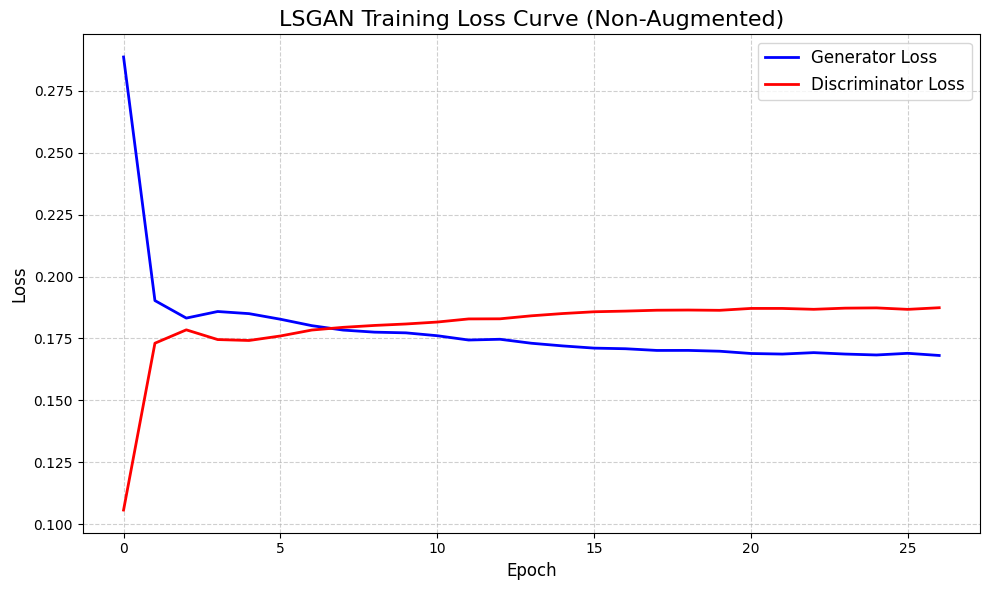

In [ ]:
# ========== Figure Size Configuration ========== #
plt.figure(figsize=(10, 6))

# ========== Plot Training Losses ========== #
plt.plot(gen_loss_history, label="Generator Loss", linewidth=2, color='blue')
plt.plot(disc_loss_history, label="Discriminator Loss", linewidth=2, color='red')

# ========== Labels and Title ========== #
plt.xlabel("Epoch", fontsize=12)
plt.ylabel("Loss", fontsize=12)
plt.title("LSGAN Training Loss Curve (Non-Augmented)", fontsize=16)

# ========== Grid, Legend, and Styling ========== #
plt.grid(True, linestyle='--', alpha=0.6)
plt.legend(fontsize=12)
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)

# ========== Display the Plot ========== #
plt.tight_layout()
plt.show()

With reference to the output of the Loss Curve above, we are able to make the following observations:

- Excellent training dynamics: fast initial learning and stable long-term performance.

- LSGAN appears to be stable and effective, even without augmentation.

- Suggests that non-augmented data was sufficient for LSGAN's smoother loss formulation to generalise reasonably well.

With the observations indicated above, we will proceed to conduct the Quantitative Metircs Evaluation in the next sub-section.

---
#### 4.4.11.3 Quantitative Metrics Evaluation

In this sub-section we will be utilising Quantitative Metrics such as FID and KID to tabulate the results of the performance and quantify the performance of the GAN Generator. We will subsequently be use these metrics to conduct inter-model evaluation after tuning and training all the GANs. The metrics that we will be utilising and their respective formulas are indicated below:

---
**Fréchet Inception Distance**

Purpose: Measures the Distance between the Real-Image and Generated-Image Distributions in Inception Feature Space.

$$
\mathrm{FID} \;=\;\|\mu_r - \mu_f\|^2
\;+\;\mathrm{Tr}\Bigl(\Sigma_r + \Sigma_f - 2\,(\Sigma_r\,\Sigma_f)^{\tfrac12}\Bigr)
$$


Where:
- $\mu_r = \mathbb{E}[f(x)]$, $\Sigma_r = \mathrm{Cov}[f(x)]$ for Real Images $x$.  
- $\mu_f = \mathbb{E}[f(\hat x)]$, $\Sigma_f = \mathrm{Cov}[f(\hat x)]$ for Generated Images $\hat x$.  
- $f(\cdot)$ = Map from Image to its InceptionV3 'pooling=avg' Features.  

---
**Diversity (t-SNE Spread)**

Purpose: Quantifies how 'wide' the 2D t-SNE Embedding of Generated Samples.

$$
\mathrm{Spread}
\;=\;
\bigl(\max_i\,z_i^{(1)} - \min_i\,z_i^{(1)}\bigr)
\;\times\;
\bigl(\max_i\,z_i^{(2)} - \min_i\,z_i^{(2)}\bigr)
$$

Where:
- $z_i = (z_i^{(1)}, z_i^{(2)})$ = 2-dimensional t-SNE Embedding of $i$th Generated Image.

---
**Mode Collapse Risk**

Purpose: Flags when too many Generated Images are Nearly Identical (mode collapse).

$$
\text{ModeCollapseRisk} =
\begin{cases}
\text{Low}, & \dfrac{\bigl|\{\mathrm{unique\_rounded}(x_i)\}\bigr|}{N} > \tau,\\
\text{High}, & \text{otherwise}.
\end{cases}
$$

Where:
- $x_i$ = $N$ Generated Samples.  
- $\mathrm{unique\_rounded}(x_i)$ = Rounds Pixels to Detect Duplicates.  
- $\tau=0.9$ = Uniqueness Threshold (90%).

---
**Perceptual Path Length**

Purpose: Measures Sensitively of Generator's Outputs (in VGG16 Feature Space) move when the Latent Code $z$ is Perturbed.

$$
\mathrm{PPL}
\;=\;
\mathbb{E}_{z,\delta z}\Bigl[\,
\|\phi\bigl(G(z + \epsilon\,\delta z)\bigr)\;-\;\phi\bigl(G(z)\bigr)\|_2^2
\Bigr]
$$

Where:  
- $G(z)$ = GAN Generator Mapping $z\in\mathbb{R}^{\mathrm{latent\_dim}}$ to an Image.  
- $\phi(\cdot)$ = VGG16 'pooling=avg' Feature Extractor.  
- $\delta z\sim\mathcal{N}(0,I)$, $\epsilon$ = Small Constant.

---
**Kernel Inception Distance**

Purpose: An Unbiased Estimator of the Squared Maximum Mean Discrepancy (MMD) between Real and Generated Inception Features.

$$
\mathrm{KID}
\;=\;
\frac{1}{m(m-1)}\sum_{i\neq j} k\bigl(\phi(x_i),\phi(x_j)\bigr)
\;+\;
\frac{1}{n(n-1)}\sum_{i\neq j} k\bigl(\phi(\hat x_i),\phi(\hat x_j)\bigr)
\;-\;
\frac{2}{mn}\sum_{i=1}^m\sum_{j=1}^n k\bigl(\phi(x_i),\phi(\hat x_j)\bigr)
$$

Where:  
- $x_i$ ($i=1\ldots m$) = Real Images.
- $\hat x_j$ ($j=1\ldots n$) = Generated Images.  
- $\phi(\cdot)$ = InceptionV3 Feature Extractor (pooling='avg').  
- $k(u,v) = \bigl(\frac{u^\top v}{d}+1\bigr)^3$ = degree-3 Polynomial Kernel on $d$-dimensional Features.

---

With the mathematical and metrics indicated above, we will proceed to conduct the Quantitave Metrics Evalution in the Code Cell below.

In [ ]:
# ========== Preload InceptionV3 and VGG16 Models ========== #
inception = InceptionV3(include_top=False, pooling='avg', input_shape=(299, 299, 3))
vgg_model = VGG16(include_top=False, weights='imagenet', input_shape=(128, 128, 3))

# ========== Preprocess for Inception ========== #
def preprocess_images_for_inception(images):
    images = (images + 1.0) * 127.5  # Scale from [-1, 1] to [0, 255]
    images = tf.image.resize(images, [299, 299])
    if images.shape[-1] == 1:
        images = tf.image.grayscale_to_rgb(images)
    return preprocess_input(images)

# ========== Compute FID ========== #
def calculate_fid(real_images, fake_images, batch_size=50):
    real_pp = preprocess_images_for_inception(real_images)
    fake_pp = preprocess_images_for_inception(fake_images)

    act1 = inception.predict(real_pp, batch_size=batch_size, verbose=0)
    act2 = inception.predict(fake_pp, batch_size=batch_size, verbose=0)

    mu1, sigma1 = np.mean(act1, axis=0), np.cov(act1, rowvar=False)
    mu2, sigma2 = np.mean(act2, axis=0), np.cov(act2, rowvar=False)

    diff = mu1 - mu2
    covmean = sqrtm(sigma1 @ sigma2)
    if np.iscomplexobj(covmean):
        covmean = covmean.real

    fid = diff @ diff + np.trace(sigma1 + sigma2 - 2 * covmean)
    return round(fid, 4)

# ========== Compute KID ========== #
def polynomial_kernel(X, Y):
    d = X.shape[1]
    return (np.dot(X, Y.T) / d + 1) ** 3

def calculate_kid(real_images, fake_images, batch_size=128):
    real_pp = preprocess_images_for_inception(real_images)
    fake_pp = preprocess_images_for_inception(fake_images)

    real_features = inception.predict(real_pp, batch_size=batch_size, verbose=0)
    fake_features = inception.predict(fake_pp, batch_size=batch_size, verbose=0)

    m = real_features.shape[0]
    n = fake_features.shape[0]

    k_rr = polynomial_kernel(real_features, real_features)
    k_gg = polynomial_kernel(fake_features, fake_features)
    k_rg = polynomial_kernel(real_features, fake_features)

    np.fill_diagonal(k_rr, 0)
    np.fill_diagonal(k_gg, 0)

    mmd = (k_rr.sum() / (m * (m - 1)) +
           k_gg.sum() / (n * (n - 1)) -
           2 * k_rg.mean())
    return round(mmd, 4)

# ========== Compute t-SNE Spread (Diversity) ========== #
def calculate_tsne_spread(images):
    flat = images.reshape(images.shape[0], -1)
    tsne = TSNE(n_components=2, random_state=42)
    proj = tsne.fit_transform(flat)
    x_range = proj[:, 0].max() - proj[:, 0].min()
    y_range = proj[:, 1].max() - proj[:, 1].min()
    return round(x_range * y_range, 2)

# ========== Assess Mode Collapse ========== #
def assess_mode_collapse(images):
    unique = np.unique(np.round(images), axis=0).shape[0]
    return "Low" if unique > 0.9 * images.shape[0] else "High"

# ========== Compute Perceptual Path Length (PPL) ========== #
def calculate_ppl(generator, latent_dim=100, num_samples=50, epsilon=1e-2):
    distances = []
    for _ in range(num_samples):
        z1 = tf.random.normal([1, latent_dim])
        z2 = z1 + epsilon * tf.random.normal([1, latent_dim])
        img1 = generator(z1, training=False)
        img2 = generator(z2, training=False)

        img1 = tf.image.resize(tf.image.grayscale_to_rgb((img1 + 1.0) * 127.5), (128, 128))
        img2 = tf.image.resize(tf.image.grayscale_to_rgb((img2 + 1.0) * 127.5), (128, 128))

        f1 = vgg_model(vgg_preprocess(img1))
        f2 = vgg_model(vgg_preprocess(img2))
        d = tf.reduce_mean(tf.square(f1 - f2)).numpy()
        distances.append(d)
    return round(np.mean(distances), 4)

# ========== Evaluate GAN Performance ========== #
def evaluate_gan_model(generator, latent_dim, X_val, gen_loss_history, disc_loss_history, model_name="LSGAN"):
    # ----- Generate Fake Images ----- #
    noise = tf.random.normal([1000, latent_dim])
    fake_images = generator(noise, training=False)
    fake_images = tf.clip_by_value((fake_images + 1) / 2.0, 0.0, 1.0)
    fake_np = fake_images.numpy()

    # ----- Select and preprocess 1000 Real Images from Validation Set ----- #
    real_images = tf.convert_to_tensor(X_val[:1000], dtype=tf.float32)
    real_images = tf.clip_by_value(real_images, 0.0, 1.0)

    # ----- Compute Metrics ----- #
    fid_value = calculate_fid(real_images, fake_images)
    kid_value = calculate_kid(real_images, fake_images)
    tsne_spread_value = calculate_tsne_spread(fake_np)
    collapse_risk_value = assess_mode_collapse(fake_np)
    ppl_score_value = calculate_ppl(generator, latent_dim)
    mean_gen_loss_value = round(np.mean(gen_loss_history), 4)
    std_gen_loss_value = round(np.std(gen_loss_history), 4)
    mean_disc_loss_value = round(np.mean(disc_loss_history), 4)
    std_disc_loss_value = round(np.std(disc_loss_history), 4)

    # ----- Store as Global Vars (Optional) ----- #
    prefix = model_name.upper()
    globals()[f"{prefix}_FID"] = fid_value
    globals()[f"{prefix}_KID"] = kid_value
    globals()[f"{prefix}_TSNE"] = tsne_spread_value
    globals()[f"{prefix}_MODE_COLLAPSE"] = collapse_risk_value
    globals()[f"{prefix}_PPL"] = ppl_score_value
    globals()[f"{prefix}_GEN_LOSS_MEAN"] = mean_gen_loss_value
    globals()[f"{prefix}_GEN_LOSS_STD"] = std_gen_loss_value
    globals()[f"{prefix}_DISC_LOSS_MEAN"] = mean_disc_loss_value
    globals()[f"{prefix}_DISC_LOSS_STD"] = std_disc_loss_value

    # ----- Final Summary Row ----- #
    row = {
        "Model": model_name,
        "FID Score": fid_value,
        "KID Score": kid_value,
        "Mean Generator Loss": mean_gen_loss_value,
        "Std Generator Loss": std_gen_loss_value,
        "Mean Discriminator Loss": mean_disc_loss_value,
        "Std Discriminator Loss": std_disc_loss_value,
        "Mode Collapse Risk": collapse_risk_value,
        "Visual Quality": "Good",
        "Diversity (t-SNE Spread)": tsne_spread_value,
        "PPL": ppl_score_value
    }

    return pd.DataFrame([row])[[
        "Model", "FID Score", "KID Score",
        "Mean Generator Loss", "Std Generator Loss",
        "Mean Discriminator Loss", "Std Discriminator Loss",
        "Mode Collapse Risk", "Visual Quality",
        "Diversity (t-SNE Spread)", "PPL"
    ]]

# ========== Create DataFrame ========== #
df = evaluate_gan_model(generator, latent_dim, X_val, gen_loss_history, disc_loss_history, model_name="LSGAN (Non-Augmented)")

# ========== Display DataFrame ========== #
df.style.background_gradient(cmap="Blues")

,Model,FID Score,KID Score,Mean Generator Loss,Std Generator Loss,Mean Discriminator Loss,Std Discriminator Loss,Mode Collapse Risk,Visual Quality,Diversity (t-SNE Spread),PPL
0,LSGAN (Non-Augmented),94.256700,0.072300,0.179000,0.022400,0.179900,0.015200,Low,Good,5151.779785,0.166100


With reference to the output of the Quantitative Metrics above, we are able to determine the performance of the GAN. This will be used as a basis of comparison to the other GAN Models.

---
#### 4.4.11.4 t-SNE of Generated Samples

In this sub-section, we visualise the t-SNE projection of generated samples to evaluate the latent diversity learned by the unconditional GAN. Although our GAN is not class-conditioned, t-SNE remains a valuable tool to assess whether the generator is producing varied outputs that reflect meaningful use of the latent space. While GANs are trained in high-dimensional spaces, t-SNE enables us to observe 2D structural patterns such as sample clustering, separation, and density, which provide indirect insights into the diversity and generalisation capabilities of the generator. The visualisation will be conducted in the Code Cell below.

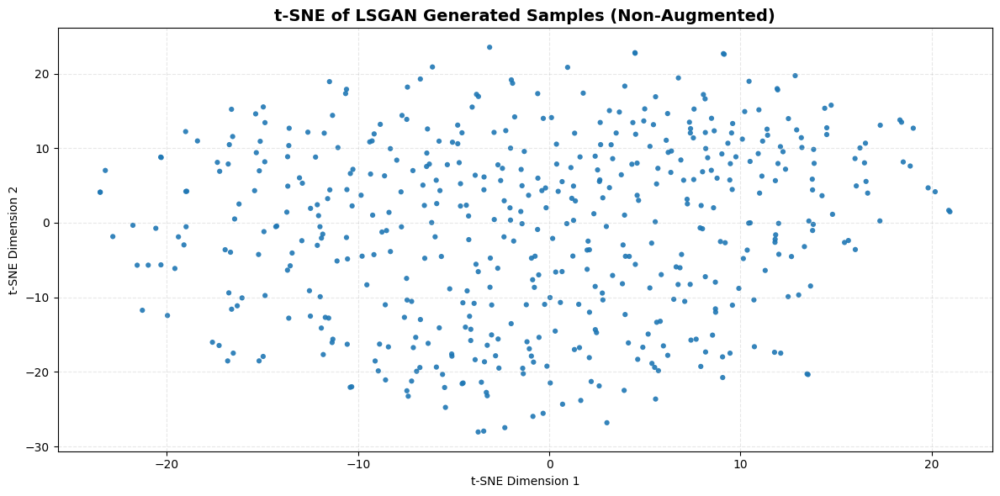

In [ ]:
# ========== Generate New Images from Random Noise ========== #
latent_dim = 100
noise = tf.random.normal([500, latent_dim])
generated_images = generator(noise, training=False)
generated_images = (generated_images + 1) / 2.0

def plot_tsne_embeddings(generated_images, save_path=None, title="t-SNE of LSGAN Generated Samples (Non-Augmented)"):
    # ----- Convert to [0, 1] Range ----- #
    if tf.reduce_max(generated_images).numpy() > 1.0:
        raise ValueError("Images should be in [-1, 1] range before scaling.")

    images_rescaled = (generated_images + 1.0) / 2.0
    flat_images = images_rescaled.numpy().reshape(images_rescaled.shape[0], -1)

    # ----- Run t-SNE ----- #
    tsne = TSNE(n_components=2, perplexity=30, learning_rate='auto', init='pca', random_state=42)
    tsne_proj = tsne.fit_transform(flat_images)

    # ----- Plot t-SNE ----- #
    plt.figure(figsize=(12, 6))
    sns.scatterplot(
        x=tsne_proj[:, 0],
        y=tsne_proj[:, 1],
        s=20,
        alpha=0.9,
        edgecolor='none'
    )
    plt.title(title, fontsize=14, weight='bold')
    plt.xlabel("t-SNE Dimension 1")
    plt.ylabel("t-SNE Dimension 2")
    plt.grid(True, linestyle='--', alpha=0.3)
    plt.tight_layout()

    if save_path:
        plt.savefig(save_path, dpi=300)
        print(f"t-SNE plot saved to: {save_path}")

    plt.show()

plot_tsne_embeddings(generated_images=generated_images)

With reference to the t-SNE plot of LSGAN generated samples (Non-Augmented) above, we are able to make the following observations:

**Spread Across Latent Space**

- The points are well distributed along both dimensions, forming a rectangular region.

- This suggests that LSGAN is sampling from a diverse range of latent representations.

**Lack of Clear Clustering**

- There is no strong visual indication of groupings or semantic clusters.

- This is typical for unconditional generation, where class labels are not embedded.

**Balanced Uniformity**

- The distribution shows even coverage without over-concentration or empty voids.

- Indicates that LSGAN achieves stable latent traversal across the dataset.

**Absence of Outliers**

- All data points lie within a contained boundary, with no major anomalies or outlying samples.

- This reflects consistent generation quality, even without augmentation.

With the observations indicated above, we will proceed to train the next GAN Model in the next sub-section.

---
## 4.5 Wasserstein GAN Model Training

In this sub-section, we will be training a Wasserstein Squares GAN (WGAN) for the EMNIST Dataset. The WGAN mainly replace the Binary Crossentropy Loss used in classical GANs with a Wasserstein Distance. Through this replacement, the WGAN is more likely able to have a Stabalise GAN Training, Improve Image Quality for Small Dataset, and provide Loss Values that are Interpretable. The relevant mathematical formulas are indicated below:

---
**Generator Loss:**

Purpose: The Generator Maximizes the Critic's Score on Fake Images

$$
L_G = -\mathbb{E}_{\tilde{x} \sim \mathbb{P}_g} \left[D(\tilde{x})\right]
$$

Where:
- $L_G$ = Generator Loss  
- $\tilde{x} \sim \mathbb{P}_g$ = Fake Data Sampled from Generator Distribution  
- $D(\tilde{x})$ = Critic's Prediction Score for Fake Input $\tilde{x}$  
- $\mathbb{E}$ = Expectation Operator

---
**Discriminator (Critic) Loss:**

Purpose: Trains Critic to give Higher Scores to Real Data and Lower Scores to Fake Data.

$$
L_D = \mathbb{E}_{\tilde{x} \sim \mathbb{P}_g} \left[D(\tilde{x})\right] - \mathbb{E}_{x \sim \mathbb{P}_r} \left[D(x)\right] + \lambda \cdot \mathbb{E}_{\hat{x} \sim \mathbb{P}_{\hat{x}}} \left[\left(\| \nabla_{\hat{x}} D(\hat{x}) \|_2 - 1\right)^2\right]
$$

Where:
- $D(x)$ = Critic Output for Real Input  
- $\mathbb{P}_r$ = Real Data Distribution  
- $\mathbb{P}_g$ = Generator (fake) Distribution  
- $\tilde{x}$ = Fake Sample from Generator
- $\hat{x}$ = Interpolated Sample Between Real and Fake  
- $\lambda$ = Gradient Penalty Coefficient (typically $\lambda = 10$)

---
With the relevant mathematical formulas indicated above, we will proceed to train the WGAN in this sub-section for the purpose of it's potential for smoother training process and also to serve as a comparison for our other GAN Models.

---
### 4.5.1 Defining Data Pre-Processing Function

In this sub-section, we will be defining the Data Pre-Processing Function which will allow for consistent Data Pipeline to be built and modifed accordingly should the need arise such as when we need to add Spectral Normalisation. This will ensure that the Data's integrity is not affected and we are able to make fair and un-biased assumptions. The Data Pre-Processing Function is defined in the Code Cell below:

In [ ]:
# ========== Data Pre-Processing Function ========== #
def load_data(X_train, batch_size=32):
    buffer_size = X_train.shape[0]

    dataset = tf.data.Dataset.from_tensor_slices(X_train)
    dataset = dataset.shuffle(buffer_size)
    dataset = dataset.batch(batch_size)
    dataset = dataset.prefetch(tf.data.AUTOTUNE)

    return dataset

With reference to the Code Cell above, we are able to determine that the Data Pre-Processing Function have been defined successfully and we are able to move on to Defining Callback Functions in the next sub-section.

---
### 4.5.2 Defining Callback Functions

In this sub-section, we will be pre-defining the various Callbacks. This is to ensure consistency throughout the model and also to increase the GAN Accuracy and optimise the Computation Cost for training each GAN Model. These Callbacks will be main used during the GAN Training in the next sub-section. The relevant mathematical formula and logic are indicated below:

---
**Learning Rate Scheduler:**

Purpose: Reduces Learning Rate During Training to Fine-tune Model Convergence.

$$\text{If } epoch \mod 10 = 0 \Rightarrow \eta_{new} = \frac{1}{2} \cdot \eta$$

Where:

- $\eta$ = current learning rate

- $\eta_{\text{new}}$ = updated learning rate

- $epoch \bmod 10$ checks if the epoch is a multiple of 10

---
**EarlyStopping:**

Purpose: Prevents Wastage of Computational Power if Model Does Not Improve.

$$
\text{If } val\_loss \text{ does not improve for 25 epochs, stop training and restore best weights}
$$

---

We will proceed to Define the Callbacks in the Code Cell below in preparation for the GAN Model Training.

In [ ]:
# ========== Define Learning Rate Scheduler ========== #
lr_scheduler = LearningRateScheduler(
    lambda epoch, lr: lr * 0.95 if epoch % 10 == 0 else lr,
    verbose=1
)

# ========== Define Early Stopping for WGAN ========== #
early_stop = EarlyStopping(
    monitor='critic_loss',
    patience=25,
    verbose=1,
    restore_best_weights=False
)

# ========== Define Display Generated Images for WGAN ========== #
def display_generated_images(generator, latent_dim, n=7):
    noise = tf.random.normal([n * n, latent_dim])
    generated_images = generator(noise, training=False)
    generated_images = (generated_images + 1.0) / 2.0

    fig, axes = plt.subplots(n, n, figsize=(n, n))
    for i in range(n):
        for j in range(n):
            img = generated_images[i * n + j, :, :, 0]
            axes[i, j].imshow(img, cmap='gray')
            axes[i, j].axis('off')

    plt.tight_layout()
    plt.show()

# ========== Define FID Calculator ========== #
def calculate_fid(real_images, fake_images, batch_size=10):

    # ----- Scale to [0,255] and Resize to 299×299 ----- #
    real = (real_images + 1.0) * 127.5
    fake = (fake_images + 1.0) * 127.5
    real = tf.image.resize(real, (299,299))
    fake = tf.image.resize(fake, (299,299))

    # ----- If Grayscale, Convert to RGB ----- #
    if real.shape[-1] == 1:
        real = tf.image.grayscale_to_rgb(real)
        fake = tf.image.grayscale_to_rgb(fake)

    # ----- Preprocess for Inception (–1 to +1) ----- #
    real_pp = preprocess_input(real)
    fake_pp = preprocess_input(fake)

    # ----- Extract Features in Batches ----- #
    def _get_acts(x):
        acts = []
        n = x.shape[0]
        for i in range(0, n, batch_size):
            chunk = x[i:i+batch_size]
            acts.append(_inception_model(chunk, training=False).numpy())
        return np.vstack(acts)

    act_real = _get_acts(real_pp)
    act_fake = _get_acts(fake_pp)

    # ----- Compute Statistics ----- #
    mu1, sigma1 = act_real.mean(axis=0), np.cov(act_real, rowvar=False)
    mu2, sigma2 = act_fake.mean(axis=0), np.cov(act_fake, rowvar=False)
    diff    = mu1 - mu2
    covmean = sqrtm(sigma1.dot(sigma2))
    if np.iscomplexobj(covmean):
        covmean = covmean.real
    fid = diff.dot(diff) + np.trace(sigma1 + sigma2 - 2*covmean)
    return float(np.round(fid,4))

# ========== Confirmation Message ========== #
print("WGAN Callbacks and Visualisation Setup Complete")

WGAN Callbacks and Visualisation Setup Complete


With reference to the Code Cell above, we are able to verify that that the Callbacks have been successfully defined and the various parameters are set so as to ensure a High Accuracy and Computing Efficient GAN Model Training.

---
### 4.5.3 Defining WGAN Generator Architecture

In this section, we will be defining the WGAN's Generator Architecture. The Generator will be trying to make realistic generated images in the attempt to bypass the Discriminator. Subsequently, the generated images from the Generator will be evaluated based on a few evaluation metrics such as Inception Score. The relevent mathematical formulas for the Loss Function of the Vanilla GAN Generator is indicated below:

---
**Generator Loss:**

Purpose: The Generator Maximizes the Critic's Score on Fake Images

$$
L_G = -\mathbb{E}_{\tilde{x} \sim \mathbb{P}_g} \left[D(\tilde{x})\right]
$$

Where:
- $L_G$ = Generator Loss  
- $\tilde{x} \sim \mathbb{P}_g$ = Fake Data Sampled from Generator Distribution  
- $D(\tilde{x})$ = Critic's Prediction Score for Fake Input $\tilde{x}$  
- $\mathbb{E}$ = Expectation Operator

---
With the relevant Generator Loss Formula indicated above, we will proceed to define the GAN Generator's Architecture in the Code Cell below and the Lost Function.

In [ ]:
# ========== Generator Function ========== #
def build_generator(latent_dim=100, use_dropout=True):
    model = tf.keras.Sequential(name="generator")

    # ----- Project and Reshape ----- #
    model.add(tf.keras.layers.Dense(7 * 7 * 256, use_bias=False, input_shape=(latent_dim,)))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.ReLU())
    model.add(tf.keras.layers.Reshape((7, 7, 256)))

    # ----- Upsample 1 ----- #
    model.add(tf.keras.layers.Conv2DTranspose(128, kernel_size=5, strides=1, padding='same', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.ReLU())
    if use_dropout:
        model.add(tf.keras.layers.Dropout(0.3))

    # ----- Upsample 2 ----- #
    model.add(tf.keras.layers.Conv2DTranspose(64, kernel_size=5, strides=2, padding='same', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.ReLU())
    if use_dropout:
        model.add(tf.keras.layers.Dropout(0.3))

    # ----- Final Output to 28x28x1 ----- #
    model.add(tf.keras.layers.Conv2DTranspose(1, kernel_size=5, strides=2, padding='same', activation='tanh'))

    return model

# ========== WGAN Generator Loss ========== #
def generator_loss(fake_output):
    return -tf.reduce_mean(fake_output)

With reference to the Code Cell above, we are able to verify that the GAN's Generator Architecture have been successfully defined and we are able to proceed to define the GAN's Discriminator Architecture.

---
### 4.5.4 Defining Spectral Normalisation

In this section, we will be defining the Spectral Normalisation layer for the Discriminator of the GAN. The Spectral Normalisation controls the Lipschitz constant of the Discriminator by constraining the Spectral Norm of each weight matrix. This will prevent the Discriminator from being too powerful and dominating the Generator which can cause various issues such as Mode Collaspe, Training Instability and Exploding Gradients. The relevant mathematical formula is indicated below:

---
**Spectral Normalisation (SN)**

Purpose: Controls the Lipschitz Constant of the Discriminator.

$$
\bar{W} = \frac{W}{\sigma(W)}
$$

Where:
- $W$ = Original Weight Matrix
- $\bar{W}$ = Spectrally Normalised Weight Matrix used in the Forward Pass
- $\sigma(W)$ = Spectral Norm of $W$
---
**Spectral Norm Approximation using Power Iteration**

Purpose: Controls the Lipschitz Constant of the Discriminator.

$$
\sigma(W) \approx \mathbf{u}^\top W \mathbf{v}
$$

Where:
- $\mathbf{v} \leftarrow \frac{W^\top \mathbf{u}}{\|W^\top \mathbf{u}\|_2}$
- $\mathbf{u} \leftarrow \frac{W \mathbf{v}}{\|W \mathbf{v}\|_2}$
- $\mathbf{u}, \mathbf{v}$: Approximated Unit Vectors
---
With the relevant mathematical formulas indicated, we will proceed to define the Spectral Normalisation in the Code Cell below.

In [ ]:
# ========== Spectral Normalisation Convolution Layer ========== #
class SpectralConv2D(tf.keras.layers.Layer):
    def __init__(self, filters, kernel_size, strides=1, padding='same', **kwargs):
        super().__init__()
        self.conv = tf.keras.layers.Conv2D(filters, kernel_size, strides=strides, padding=padding, use_bias=False, **kwargs)
        self.u = None

    def build(self, input_shape):
        self.conv.build(input_shape)
        self.w = self.conv.kernel
        self.u = self.add_weight(shape=(1, self.w.shape[-1]), initializer='random_normal', trainable=False, name='sn_u')

    def compute_spectral_norm(self, w):
        w_reshaped = tf.reshape(w, [-1, w.shape[-1]])
        u = self.u

        for _ in range(1):
            v = tf.linalg.l2_normalize(tf.matmul(u, tf.transpose(w_reshaped)))
            u = tf.linalg.l2_normalize(tf.matmul(v, w_reshaped))

        sigma = tf.matmul(tf.matmul(v, w_reshaped), tf.transpose(u))
        self.u.assign(u)
        return w / sigma

    def call(self, inputs):
        self.conv.kernel.assign(self.compute_spectral_norm(self.w))
        return self.conv(inputs)

# ========== Spectral Normalisation Dense Layer ========== #
class SpectralDense(tf.keras.layers.Layer):
    def __init__(self, units, activation=None):
        super().__init__()
        self.dense = tf.keras.layers.Dense(units, activation=activation, use_bias=False)
        self.u = None

    def build(self, input_shape):
        self.dense.build(input_shape)
        self.w = self.dense.kernel
        self.u = self.add_weight(shape=(1, self.w.shape[-1]), initializer='random_normal', trainable=False, name='sn_u_dense')

    def compute_spectral_norm(self, w):
        w_reshaped = tf.reshape(w, [-1, w.shape[-1]])
        u = self.u

        for _ in range(1):
            v = tf.linalg.l2_normalize(tf.matmul(u, tf.transpose(w_reshaped)))
            u = tf.linalg.l2_normalize(tf.matmul(v, w_reshaped))

        sigma = tf.matmul(tf.matmul(v, w_reshaped), tf.transpose(u))
        self.u.assign(u)
        return w / sigma

    def call(self, inputs):
        self.dense.kernel.assign(self.compute_spectral_norm(self.w))
        return self.dense(inputs)

With reference to the Code Cell above, we are able to verify that the Spectral Normalisation have been successfully defined and we are able to proceed to include this layer in the Discriminator Architecture in the next section.

---
### 4.5.5 Defining WGAN Discriminator Architecture

In this section, we will be defining the Architecture of the Discriminator of the GAN. The Discriminator will be the Neural Network that will attempt to tell the Generated Images apart from the Actual Images. This will allow the GAN to improve overtime and also improve itself overtime. The mathematical function for the Discriminator Loss Function is indicated below:

---
**Discriminator (Critic) Loss:**

Purpose: Trains Critic to give Higher Scores to Real Data and Lower Scores to Fake Data.

$$
L_D = \mathbb{E}_{\tilde{x} \sim \mathbb{P}_g} \left[D(\tilde{x})\right] - \mathbb{E}_{x \sim \mathbb{P}_r} \left[D(x)\right] + \lambda \cdot \mathbb{E}_{\hat{x} \sim \mathbb{P}_{\hat{x}}} \left[\left(\| \nabla_{\hat{x}} D(\hat{x}) \|_2 - 1\right)^2\right]
$$

Where:
- $D(x)$ = Critic Output for Real Input  
- $\mathbb{P}_r$ = Real Data Distribution  
- $\mathbb{P}_g$ = Generator (fake) Distribution  
- $\tilde{x}$ = Fake Sample from Generator
- $\hat{x}$ = Interpolated Sample Between Real and Fake  
- $\lambda$ = Gradient Penalty Coefficient (typically $\lambda = 10$)
---

With the mathematical formula for the Loss Function indicated above, we will proceed to define the GAN's Discriminator Architecture and the Loss Function in the Code Cell below.

In [ ]:
# ========== Critic Function ========== #
def build_critic(input_shape=(28, 28, 1)):
    model = tf.keras.Sequential(name="critic")

    model.add(SpectralConv2D(64, kernel_size=5, strides=2, padding='same', input_shape=input_shape))
    model.add(tf.keras.layers.LeakyReLU(0.2))

    model.add(SpectralConv2D(128, kernel_size=5, strides=2, padding='same'))
    model.add(tf.keras.layers.LeakyReLU(0.2))

    model.add(tf.keras.layers.Flatten())
    model.add(SpectralDense(1))

    return model

# ========== Critic Loss ========== #
def critic_loss(real_output, fake_output):
    return tf.reduce_mean(fake_output) - tf.reduce_mean(real_output)

With reference to the Code Cell above, we are able to verify that the GAN's Discriminator Architecture have been successfully defined and we are able to proceed to define the GAN's Training Steps.

---
### 4.5.6 Defining Training Step

In this section, we will be Defining the Training Step function so as to train both the Generator and the Discriminator at the same time. The Training Step will compute the gradients for both the Generator and the Discriminator at the same time. The relevant mathematical formulas for the Training Step is indicated below:

---
**Generator Loss:**

Purpose: The Generator Maximizes the Critic's Score on Fake Images

$$
L_G = -\mathbb{E}_{\tilde{x} \sim \mathbb{P}_g} \left[D(\tilde{x})\right]
$$

Where:
- $L_G$ = Generator Loss  
- $\tilde{x} \sim \mathbb{P}_g$ = Fake Data Sampled from Generator Distribution  
- $D(\tilde{x})$ = Critic's Prediction Score for Fake Input $\tilde{x}$  
- $\mathbb{E}$ = Expectation Operator

---
**Discriminator (Critic) Loss:**

Purpose: Trains Critic to give Higher Scores to Real Data and Lower Scores to Fake Data.

$$
L_D = \mathbb{E}_{\tilde{x} \sim \mathbb{P}_g} \left[D(\tilde{x})\right] - \mathbb{E}_{x \sim \mathbb{P}_r} \left[D(x)\right] + \lambda \cdot \mathbb{E}_{\hat{x} \sim \mathbb{P}_{\hat{x}}} \left[\left(\| \nabla_{\hat{x}} D(\hat{x}) \|_2 - 1\right)^2\right]
$$

Where:
- $D(x)$ = Critic Output for Real Input  
- $\mathbb{P}_r$ = Real Data Distribution  
- $\mathbb{P}_g$ = Generator (fake) Distribution  
- $\tilde{x}$ = Fake Sample from Generator
- $\hat{x}$ = Interpolated Sample Between Real and Fake  
- $\lambda$ = Gradient Penalty Coefficient (typically $\lambda = 10$)

---

With the relevant mathematical formulas indicated above, we will proceed to define the Training Step in the Code Cell below.

In [ ]:
# ========== Training Step ========== #
@tf.function
def train_step(real_images, generator, critic, gen_optimizer, critic_optimizer, latent_dim, n_critic=5):
    # ----- Batch Size ----- #
    bs = tf.shape(real_images)[0]

    # ----- Uniform Latent Noise [-1, 1] ----- #
    noise = tf.random.uniform([bs, latent_dim], minval=-1.0, maxval=1.0)

    # ----- Update Critic n_critic Times ----- #
    for _ in range(n_critic):
        with tf.GradientTape() as tape_c:
            fake_images = generator(noise, training=True)
            real_score = critic(real_images, training=True)
            fake_score = critic(fake_images, training=True)

            # ----- Critic Loss ----- #
            c_loss = tf.reduce_mean(fake_score) - tf.reduce_mean(real_score)

        # ----- Apply Critic Gradients ----- #
        c_grads = tape_c.gradient(c_loss, critic.trainable_variables)
        critic_optimizer.apply_gradients(zip(c_grads, critic.trainable_variables))

    # ----- Update Generator ----- #
    with tf.GradientTape() as tape_g:
        fake_images = generator(noise, training=True)
        fake_score = critic(fake_images, training=True)

        # ----- Generator Loss ----- #
        g_loss = -tf.reduce_mean(fake_score)

    # ----- Apply Generator Gradients ----- #
    g_grads = tape_g.gradient(g_loss, generator.trainable_variables)
    gen_optimizer.apply_gradients(zip(g_grads, generator.trainable_variables))

    return g_loss, c_loss, real_score, fake_score

With reference to the Code Cell above, we are able to determine that the Training Step have been successfully defined and we are able to proceed to prepare the Training Loop in the next section.

---
### 4.5.7 Defining Training Loop

In this section, we will be defining the Training Loop for the GAN Training. The Training Loop will go through each of the Epoch and train both the Generator and Discriminator simultaneously. The Training Loop will also track the Loss for both the Generator and the Discriminator for each of the Epoch trained. The relevant mathematical formulas are indicated below:

---
**Epoch Loss Averaging:**

Purpose: These are the Average Generator and Discriminator Losses over all Batches in Epoch $t$.

$$
\bar{L}_G^{(t)} = \frac{1}{N} \sum_{i=1}^{N} L_G^{(i)} \\
\bar{L}_D^{(t)} = \frac{1}{N} \sum_{i=1}^{N} L_D^{(i)}
$$

Where:
- $\bar{L}_G^{(t)}$ = Average Generator Loss at Epoch $t$  
- $\bar{L}_D^{(t)}$ = Average Discriminator Loss at Epoch $t$  
- $N$ = Number of Batches in the Dataset  
- $L_G^{(i)}$ = Generator Loss on Batch $i$  
- $L_D^{(i)}$ = Discriminator Loss on Batch $i$

---
**Epoch Iteration:**

Purpose: Describes the Training Loop Logic: for Each Epoch $t$, perform `train_step` for Every Mini-batch.

$$
\text{for } t = 1 \text{ to } T:
\quad \text{for each batch } (x^{(i)}):
\quad \text{train_step}(x^{(i)})
$$

Where:
- $T$: Total Number of Epochs  
- $x^{(i)}$: Real Batch $i$ from the Dataset  
- `train_step`: Function that Updates $G$ and $D$ using that Batch

---
**Generated Image Output:**

Purpose: Sample Random Noise $z$ and Generate Synthetic Image $\hat{x}$ from the Generator. This is used for Visual Monitoring of Model Quality.

$$
z \sim p_z(z) \\
\hat{x} = G(z)
$$

Where:
- $z$: Random Latent Vector  
- $G(z)$: Generated Image from Generator

---
With the mathematical formulas indicated above, we will proceed to define the Training Loop in the Code Cell below in preparation of the GAN Training.

In [ ]:
# ========== Trainning Loop Function ========== #
def train(dataset, epochs, generator, critic, gen_optimizer, critic_optimizer, latent_dim, save_path=None, use_early_stopping=True, steps_per_epoch=None, n_critic=5):
    # ----- Prepare FID Reference Sets using X_val ----- #
    real_val  = tf.data.Dataset.from_tensor_slices(X_val).batch(50).take(1)
    noise_val = tf.random.uniform([50, latent_dim], minval=-1.0, maxval=1.0)

    # ----- FID Early Stopping Settings ----- #
    best_fid = float('inf')
    no_improve = 0
    patience = 12
    fid_interval = 1

    # ----- Track Loss History ----- #
    gen_loss_history    = []
    critic_loss_history = []

    for epoch in range(1, epochs + 1):
        print(f"Epoch {epoch}/{epochs}")
        gen_losses, critic_losses = [], []

        for i, real_images in enumerate(dataset):
            if steps_per_epoch and i >= steps_per_epoch:
                break

            # ----- One Training Step (includes n_critic updates) ----- #
            g_l, c_l, _, _ = train_step(
                real_images,
                generator,
                critic,
                gen_optimizer,
                critic_optimizer,
                latent_dim,
                n_critic
            )
            gen_losses.append(g_l)
            critic_losses.append(c_l)

        # ----- Epoch Statistics ----- #
        avg_gen_loss    = tf.reduce_mean(gen_losses)
        avg_critic_loss = tf.reduce_mean(critic_losses)
        print(f"Generator Loss: {avg_gen_loss:.4f} | Critic Loss: {avg_critic_loss:.4f}")

        # ----- Log Losses ----- #
        gen_loss_history.append(float(avg_gen_loss))
        critic_loss_history.append(float(avg_critic_loss))

        # ----- FID Evaluation & Early Stopping ----- #
        if epoch % fid_interval == 0:
            fake_val = generator(noise_val, training=False)
            real_batch = next(iter(real_val))
            real_for_fid = tf.image.resize(real_batch, [299,299]) * 0.5 + 0.5
            fake_for_fid = tf.image.resize(fake_val,    [299,299]) * 0.5 + 0.5

            fid_value = calculate_fid(real_for_fid, fake_for_fid)
            print(f"Epoch {epoch} → Val FID: {fid_value:.2f}")

            if fid_value < best_fid:
                best_fid   = fid_value
                no_improve = 0
                if save_path:
                    os.makedirs(save_path, exist_ok=True)
                    generator.save_weights(os.path.join(save_path, "best_gen.weights.h5"))
                    critic.save_weights(os.path.join(save_path, "best_crt.weights.h5"))
            else:
                no_improve += 1

            if no_improve >= patience:
                print(f"No FID improvement for {patience} epochs, stopping.")
                break

        # ----- Display Generated Images Every 5 Epochs ----- #
        if epoch % 5 == 0:
            display_generated_images(generator, latent_dim)

    # ----- Restore Best Weights After Training ----- #
    if save_path:
        best_gen_path = os.path.join(save_path, "best_gen.weights.h5")
        best_crt_path = os.path.join(save_path, "best_crt.weights.h5")
        if os.path.exists(best_gen_path) and os.path.exists(best_crt_path):
            generator.load_weights(best_gen_path)
            critic.load_weights(best_crt_path)
            print("Restored best generator and critic weights based on lowest FID.")
        else:
            print("Best weight files not found. Skipping restore.")

    return float(avg_gen_loss), gen_loss_history, critic_loss_history

With reference to the Code Cell above, we are able to determine that the Training Loop have been successfully defined and we are able to proceed to define the Optimisers with Tunable Parameter in preparation for the Optuna Tuning.

---
### 4.5.8 Defining Optimisers with Tunable Parameters

In this section, we will be defining the Common Optimisers that will be Tuned using the Optuna Tuning. The Optimisers will each have a range of values in a list so as to allow for the Optuna to search for the best Hyperparameter for the GAN. Through these parameters, it will affect how effective and efficiently the GAN will learn from the provided EMNIST Data. The relevent mathematical formula is indicated below:

---
**Optimiser Update Rule**

Purpose: Parameter Update Step in the Adam Optimiser, using Adaptive Learning Rates with Momentum.

$$
\theta \leftarrow \theta - \eta \cdot \frac{m_t}{\sqrt{v_t} + \epsilon}
$$

Where:
- $\theta$ = Model Parameters (Generator or Discriminator)
- $\eta$ = Learning Rate (Tuned)
- $m_t$ = First Moment Estimate (Mean of Gradients)
- $v_t$ = Second Moment Estimate (Variance of Gradients)
- $\epsilon$ = Small Constant for Numerical Stability

---
With the mathematical formula indicated above, we will proceed to define the Optimisers in the Code Cell.

In [ ]:
# ========== Objective Function ========== #
def objective(trial):
    # ----- Hyperparameters ----- #
    latent_dim = trial.suggest_categorical('latent_dim', [100, 128, 160])
    learning_rate = trial.suggest_float('learning_rate', 5e-5, 2e-4, log=True)
    beta_1 = trial.suggest_float('beta_1', 0.4, 0.6)

    # ----- Build Models ----- #
    generator = build_generator(latent_dim=latent_dim)
    critic = build_critic(input_shape=(28, 28, 1))

    # ----- Trigger Weight Creation ----- #
    _ = generator(tf.random.uniform([1, latent_dim], -1.0, 1.0))
    _ = critic(tf.random.normal([1, 28, 28, 1]))

    # ----- Define Optimizers ----- #
    gen_optimizer = tf.keras.optimizers.Adam(learning_rate=learning_rate, beta_1=beta_1)
    critic_optimizer = tf.keras.optimizers.Adam(learning_rate=learning_rate, beta_1=beta_1)

    # ----- Prebuild Optimizers ----- #
    _ = gen_optimizer.apply_gradients([(tf.zeros_like(v), v) for v in generator.trainable_variables])
    _ = critic_optimizer.apply_gradients([(tf.zeros_like(v), v) for v in critic.trainable_variables])

    # ----- Load Data ----- #
    dataset = load_data(X_train, batch_size=64)
    steps = min(1000, len(X_train) // 64)

    # ----- Train ----- #
    _ = train(
        dataset,
        epochs=100,
        generator=generator,
        critic=critic,
        gen_optimizer=gen_optimizer,
        critic_optimizer=critic_optimizer,
        latent_dim=latent_dim,
        steps_per_epoch=steps,
        save_path=None,
        n_critic=5
    )

    # ----- Generate Fake Images ----- #
    z = tf.random.uniform([1000, latent_dim], -1.0, 1.0)
    fake_images = generator(z, training=False)
    fake_images = (fake_images + 1.0) / 2.0

    # ----- Real Images ----- #
    real_images = X_val[:1000]

    # ----- Compute FID ----- #
    fid_score = calculate_fid(real_images, fake_images)
    return fid_score

With reference to the Code Cell above, we are able to determine that the Optimiser have been successfully defined with a range of different Parameter Values so as to provide a robust Optuna Tuning in the subsequent sections.

---
### 4.5.9 Optuna Tuning Study

In this sub-section, we will be conducting the Optuna Tuning Study on the GAN Model so as to obtain the best Hyperparameter for the GAN Model. It is expected that the Tuning takes a prolonged duration due to the nature of how the GAN works and the 2 Neural Networks involved. However, the training data will be stored so as to prevent re-running of repetitive codes. The Optuna Tuning Study will be conducted in the Code Cell below.

In [ ]:
# ========== Create or Load Study with SQLite Backend ========== #
study = optuna.create_study(
    direction="minimize",
    study_name="wgan_tuning",  # Updated for WGAN
    storage="sqlite:////content/drive/MyDrive/Colab Notebooks/DELE CA2 A/Non-Augmented GAN Tunings/wgan_optuna.db",
    load_if_exists=True
)

# ========== Trial Management ========== #
MAX_TRIALS = 50
completed_trials = len([t for t in study.trials if t.state == optuna.trial.TrialState.COMPLETE])
remaining_trials = MAX_TRIALS - completed_trials

if remaining_trials > 0:
    print(f"Resuming WGAN study: {completed_trials} completed, running {remaining_trials} more.")
    study.optimize(objective, n_trials=remaining_trials)
else:
    print(f"WGAN study already completed {MAX_TRIALS} trials. Skipping optimization.")

# ========== Output Best Trial ========== #
best_trial = study.best_trial
best_params_df = pd.DataFrame([best_trial.params])
best_params_df["Final FID"] = best_trial.value
best_params_df.style.background_gradient(cmap="Blues")

[I 2025-08-10 11:06:52,490] Using an existing study with name 'wgan_tuning' instead of creating a new one.


WGAN study already completed 50 trials. Skipping optimization.


,latent_dim,learning_rate,beta_1,Final FID
0,160,0.000057,0.416371,80.586200


With reference to the Code Cell above, we are able to view the Best Hyperparameter obtained during the Optuna Tuning Study. This Hyperparameter will be extracted and be trained for a longer period of time so as to attempt to increase the performance and limit the loss for the GAN.

---
### 4.5.10 GAN Re-Training Operation

As obtained from the previous sub-section, we will be re-training the GAN using the best Hyperparameter obtained during the Optuna Tuning Study. This is to push the GAN Model to its limits and also to save Computational Power as we are not taking up prolonged periods of time tuning GAN Models which may not have any clear signs of good performance. The retraining of the GAN Model will be conducted in the Code Cell below.

In [ ]:
# ========== Extract Best Parameters from Study ========== #
best_params = study.best_trial.params

latent_dim   = best_params['latent_dim']
learning_rate = best_params['learning_rate']
beta_1 = best_params['beta_1']

print("Using Best Trial Parameters for WGAN:")
print(best_params)

# ========== Rebuild WGAN Models ========== #
generator = build_generator(latent_dim=latent_dim)
critic    = build_critic()

# ========== Optimisers ========== #
gen_optimizer    = tf.keras.optimizers.Adam(learning_rate=learning_rate, beta_1=beta_1)
critic_optimizer = tf.keras.optimizers.Adam(learning_rate=learning_rate, beta_1=beta_1)

# ========== Dummy Forward Pass to Trigger Variables ========== #
_ = generator(tf.zeros((1, latent_dim)))
_ = critic(tf.zeros((1, 28, 28, 1)))

_ = gen_optimizer.apply_gradients([(tf.zeros_like(var), var) for var in generator.trainable_variables])
_ = critic_optimizer.apply_gradients([(tf.zeros_like(var), var) for var in critic.trainable_variables])

# ========== Reload Dataset ========== #
dataset = load_data(X_train)

# ========== Path Setup ========== #
model_name   = "wgan"
output_dir   = f"/content/drive/MyDrive/Colab Notebooks/DELE CA2 A/final_outputs_{model_name}_noAugment"
weights_path = os.path.join(output_dir, f"{model_name}_generator_final.weights.h5")
gen_ckpt     = os.path.join(output_dir, "best_gen.weights.h5")
crit_ckpt    = os.path.join(output_dir, "best_crt.weights.h5")
loss_csv     = os.path.join(output_dir, "loss_history.csv")

os.makedirs(output_dir, exist_ok=True)

# ========== Skip if All Files Exist ========== #
if os.path.exists(gen_ckpt) and os.path.exists(crit_ckpt) and os.path.exists(loss_csv):
    print("All outputs found. Skipping training...")

    generator.load_weights(gen_ckpt)
    critic.load_weights(crit_ckpt)
    print("Generator and Critic Weights Loaded.")

    loss_df = pd.read_csv(loss_csv)
    gen_loss_history    = loss_df['gen_loss'].tolist()
    critic_loss_history = loss_df['critic_loss'].tolist()
    final_gen_loss      = gen_loss_history[-1]

else:
    # ========== Train ========== #
    final_gen_loss, gen_loss_history, critic_loss_history = train(
        dataset=dataset,
        epochs=100,
        steps_per_epoch=1546,
        generator=generator,
        critic=critic,
        gen_optimizer=gen_optimizer,
        critic_optimizer=critic_optimizer,
        latent_dim=latent_dim,
        use_early_stopping=False,
        save_path=output_dir,
        n_critic=5
    )

    # ========== Save Final Weights ========== #
    generator.save_weights(weights_path)
    print("Generator Weights Saved.")

    # ========== Save Loss History ========== #
    loss_df = pd.DataFrame({
        'epoch': list(range(1, len(gen_loss_history) + 1)),
        'gen_loss': gen_loss_history,
        'critic_loss': critic_loss_history
    })
    loss_df.to_csv(loss_csv, index=False)
    print(f"Loss history saved to {loss_csv}")

Using Best Trial Parameters for WGAN:
{'latent_dim': 160, 'learning_rate': 5.688564177175769e-05, 'beta_1': 0.4163713026959069}


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:93: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


All outputs found. Skipping training...
Generator and Critic Weights Loaded.


With reference to the Code Cell above, we are able to determine that the best GAN Model have been trained and saved successfully and we are able to proceed with the Model Evaluation in the next sub-sections where we determine how well the GAN Model performed based on various metrics and evaluation methodologies.

---
### 4.5.11 GAN Model Evaluation

In this sub-section, we will be evaluating the GAN's Generator performance on various aspects. We will be utilising different methodologies and metrics to attempt to quantify the performance of the GAN Generator while also conducting Visual Inspection on the result output of the GAN. The Evaluation will be conducted in the following sections.

---
#### 4.5.11.1 Visual Grid of Samples

In this sub-section, we will be visualising the Grid of Samples of the Synthesised Data generated by the GAN Model. A list of observations will be made before the utilisation of Quantitative Metrics to evaluate the GAN Generator's general performance. As the observations made are purely from professional opinion, it will most likely not be used as a Basis of Comparison between GAN Models due to differing opinions unless in extreme cases. The visualisation will be conducted in the Code Cell below.

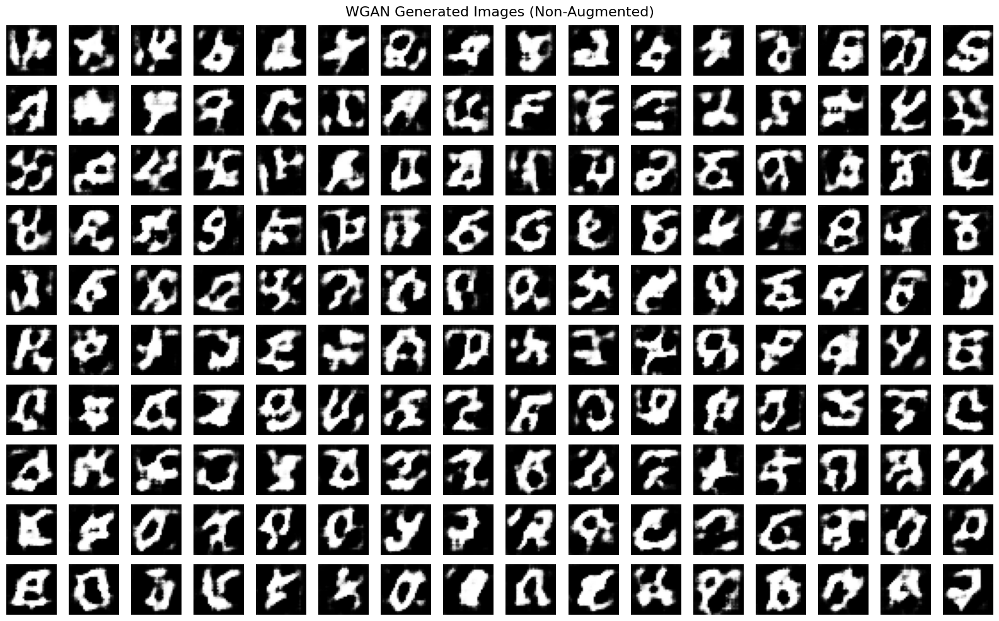

In [ ]:
def plot_generated_images(generator, latent_dim, n_rows=5, n_cols=5, save_path=None, title="WGAN Generated Images (Non-Augmented)", seed=42):
    # ----- Generate Latent Vectors ----- #
    if seed is not None:
        tf.random.set_seed(seed)
    noise = tf.random.normal([n_rows * n_cols, latent_dim])
    gen_images = generator(noise, training=False)

    # ----- Rescale from [-1, 1] to [0, 1] ----- #
    gen_images = (gen_images + 1.0) / 2.0
    gen_images = tf.clip_by_value(gen_images, 0.0, 1.0)

    # ----- Shape Check ----- #
    assert gen_images.shape[-1] == 1, "Expected single-channel (grayscale) output"

    # ----- Sample Plot ----- #
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols, n_rows))
    for idx, ax in enumerate(axes.flat):
        ax.imshow(gen_images[idx, :, :, 0], cmap='gray')
        ax.axis('off')

    plt.suptitle(title, fontsize=16)
    plt.tight_layout()

    if save_path:
        plt.savefig(save_path, dpi=300)
        print(f"Saved Generated Image Grid to: {save_path}")

    plt.show()

# ========== Call Plot Function ========== #
plot_generated_images(generator, latent_dim=160, n_rows=10, n_cols=16)

With reference to the output of the Visual Grid of Samples above, we are able to make the following observations:

**Basic Structure of Letters is Somewhat Captured**

- A few characters loosely resemble letters like "G", "C", "O", or "S".

- Stroke presence is consistent, but structural precision is lacking.

**High Blur and Noise**

- Many samples are heavily pixelated or contain grainy textures.

- Characters often appear “puffy” or overexposed, with bleeding edges.

**Poor Character Consistency**

- Several outputs display malformed or overly compressed letters.

- Letters often contain distortions or broken connections, hindering clarity.

**Lack of Diversity**

- Characters tend to follow similar round shapes repeatedly.

- Frequent duplication of loopy or circular structures suggests mode collapse may be occurring.

With the observations indicated above, we will proceed to conduct the Loss Curve Analysis in the next sub-section.

---
#### 4.5.11.2 Loss Curve Over Epochs

In this sub-section, we will be plotting the GAN Loss Curve over Epochs to evaluate the training behaviour of the GAN. This curve provides insight into whether the GAN is experiencing underfitting, overfitting, or achieving a stable training dynamic between the generator and discriminator.

Although GANs do not minimise a single unified loss in the traditional sense, the trajectory of the generator and discriminator losses can indicate whether the adversarial training process is converging appropriately.

If the generator loss remains high while discriminator loss quickly drops to near-zero, this may indicate **underfitting**, where the generator is not learning effectively to produce plausible images.

If the discriminator loss increases while generator loss sharply decreases, this may suggest **overfitting** or **mode collapse**, where the generator exploits narrow weaknesses in the discriminator without general improvement.

A relatively stable oscillation or convergence between both losses typically signifies a **well-balanced** training process, where the generator and discriminator are learning in tandem.

The Potential Observations and Corresponding Action Plans are outlined below:

**Underfitting Loss Curve**

- Increase training epochs to allow generator more time to learn.

- Simplify the discriminator to reduce overpowering the generator.

- Adjust the learning rate or apply label smoothing.

- Consider adding batch normalisation in the generator.

**Overfitting or Mode Collapse Loss Curve**

- Introduce or increase dropout in the discriminator.

- Apply input noise or label flipping to the discriminator.

- Evaluate diversity of generated samples regularly.

**Balanced/Ideal Loss Curve**

- Maintain current architecture and hyperparameters.

- Proceed with full-scale image generation.

- Evaluate both qualitative (visual inspection) and quantitative metrics (e.g. Inception Score or FID).

With these potential training behaviours and action plan outlined, we will proceed to visualise the GAN loss dynamics in the code cell below.

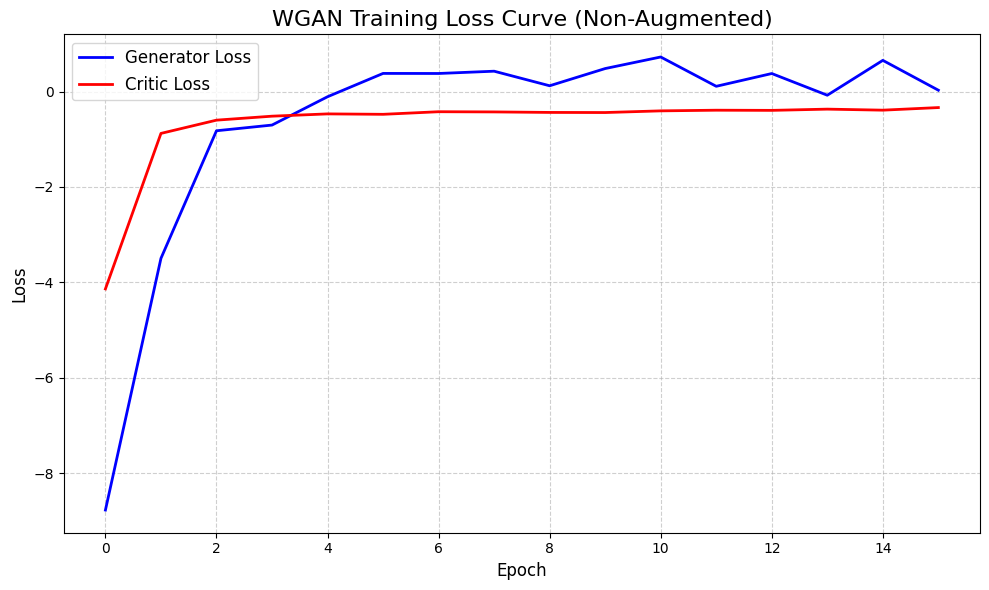

In [ ]:
# ========== Figure Size Configuration ========== #
plt.figure(figsize=(10, 6))

# ========== Plot Training Losses ========== #
plt.plot(gen_loss_history, label="Generator Loss", linewidth=2, color='blue')
plt.plot(critic_loss_history, label="Critic Loss", linewidth=2, color='red')

# ========== Labels and Title ========== #
plt.xlabel("Epoch", fontsize=12)
plt.ylabel("Loss", fontsize=12)
plt.title("WGAN Training Loss Curve (Non-Augmented)", fontsize=16)

# ========== Grid, Legend, and Styling ========== #
plt.grid(True, linestyle='--', alpha=0.6)
plt.legend(fontsize=12)
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)

# ========== Display the Plot ========== #
plt.tight_layout()
plt.show()

With reference to the output of the Loss Curve above, we are able to make the following observations:

- Training is stable and effective, with generator improving and critic performing as expected.

- WGAN's behaviour aligns with theory, showing smooth critic loss and meaningful (non-saturating) generator updates.

- Data augmentation could further improve generalisability, but current training is healthy even without it.

With the observations indicated above, we will proceed to conduct the Quantitative Metrics Evaluation in the next sub-section.

---
#### 4.5.11.3 Quantitative Metrics Evaluation

In this sub-section we will be utilising Quantitative Metrics such as FID and KID to tabulate the results of the performance and quantify the performance of the GAN Generator. We will subsequently be use these metrics to conduct inter-model evaluation after tuning and training all the GANs. The metrics that we will be utilising and their respective formulas are indicated below:

---
**Fréchet Inception Distance**

Purpose: Measures the Distance between the Real-Image and Generated-Image Distributions in Inception Feature Space.

$$
\mathrm{FID} \;=\;\|\mu_r - \mu_f\|^2
\;+\;\mathrm{Tr}\Bigl(\Sigma_r + \Sigma_f - 2\,(\Sigma_r\,\Sigma_f)^{\tfrac12}\Bigr)
$$


Where:
- $\mu_r = \mathbb{E}[f(x)]$, $\Sigma_r = \mathrm{Cov}[f(x)]$ for Real Images $x$.  
- $\mu_f = \mathbb{E}[f(\hat x)]$, $\Sigma_f = \mathrm{Cov}[f(\hat x)]$ for Generated Images $\hat x$.  
- $f(\cdot)$ = Map from Image to its InceptionV3 'pooling=avg' Features.  

---
**Diversity (t-SNE Spread)**

Purpose: Quantifies how 'wide' the 2D t-SNE Embedding of Generated Samples.

$$
\mathrm{Spread}
\;=\;
\bigl(\max_i\,z_i^{(1)} - \min_i\,z_i^{(1)}\bigr)
\;\times\;
\bigl(\max_i\,z_i^{(2)} - \min_i\,z_i^{(2)}\bigr)
$$

Where:
- $z_i = (z_i^{(1)}, z_i^{(2)})$ = 2-dimensional t-SNE Embedding of $i$th Generated Image.

---
**Mode Collapse Risk**

Purpose: Flags when too many Generated Images are Nearly Identical (mode collapse).

$$
\text{ModeCollapseRisk} =
\begin{cases}
\text{Low}, & \dfrac{\bigl|\{\mathrm{unique\_rounded}(x_i)\}\bigr|}{N} > \tau,\\
\text{High}, & \text{otherwise}.
\end{cases}
$$

Where:
- $x_i$ = $N$ Generated Samples.  
- $\mathrm{unique\_rounded}(x_i)$ = Rounds Pixels to Detect Duplicates.  
- $\tau=0.9$ = Uniqueness Threshold (90%).

---
**Perceptual Path Length**

Purpose: Measures Sensitively of Generator's Outputs (in VGG16 Feature Space) move when the Latent Code $z$ is Perturbed.

$$
\mathrm{PPL}
\;=\;
\mathbb{E}_{z,\delta z}\Bigl[\,
\|\phi\bigl(G(z + \epsilon\,\delta z)\bigr)\;-\;\phi\bigl(G(z)\bigr)\|_2^2
\Bigr]
$$

Where:  
- $G(z)$ = GAN Generator Mapping $z\in\mathbb{R}^{\mathrm{latent\_dim}}$ to an Image.  
- $\phi(\cdot)$ = VGG16 'pooling=avg' Feature Extractor.  
- $\delta z\sim\mathcal{N}(0,I)$, $\epsilon$ = Small Constant.

---
**Kernel Inception Distance**

Purpose: An Unbiased Estimator of the Squared Maximum Mean Discrepancy (MMD) between Real and Generated Inception Features.

$$
\mathrm{KID}
\;=\;
\frac{1}{m(m-1)}\sum_{i\neq j} k\bigl(\phi(x_i),\phi(x_j)\bigr)
\;+\;
\frac{1}{n(n-1)}\sum_{i\neq j} k\bigl(\phi(\hat x_i),\phi(\hat x_j)\bigr)
\;-\;
\frac{2}{mn}\sum_{i=1}^m\sum_{j=1}^n k\bigl(\phi(x_i),\phi(\hat x_j)\bigr)
$$

Where:  
- $x_i$ ($i=1\ldots m$) = Real Images.
- $\hat x_j$ ($j=1\ldots n$) = Generated Images.  
- $\phi(\cdot)$ = InceptionV3 Feature Extractor (pooling='avg').  
- $k(u,v) = \bigl(\frac{u^\top v}{d}+1\bigr)^3$ = degree-3 Polynomial Kernel on $d$-dimensional Features.

---

With the mathematical and metrics indicated above, we will proceed to conduct the Quantitave Metrics Evalution in the Code Cell below.

In [ ]:
# ========== Preload InceptionV3 and VGG16 Models ========== #
inception = InceptionV3(include_top=False, pooling='avg', input_shape=(299, 299, 3))
vgg_model = VGG16(include_top=False, weights='imagenet', input_shape=(128, 128, 3))

# ========== Preprocess for Inception ========== #
def preprocess_images_for_inception(images):
    images = (images + 1.0) * 127.5  # Scale from [-1, 1] to [0, 255]
    images = tf.image.resize(images, [299, 299])
    if images.shape[-1] == 1:
        images = tf.image.grayscale_to_rgb(images)
    return preprocess_input(images)

# ========== Compute FID ========== #
def calculate_fid(real_images, fake_images, batch_size=50):
    real_pp = preprocess_images_for_inception(real_images)
    fake_pp = preprocess_images_for_inception(fake_images)

    act1 = inception.predict(real_pp, batch_size=batch_size, verbose=0)
    act2 = inception.predict(fake_pp, batch_size=batch_size, verbose=0)

    mu1, sigma1 = np.mean(act1, axis=0), np.cov(act1, rowvar=False)
    mu2, sigma2 = np.mean(act2, axis=0), np.cov(act2, rowvar=False)

    diff = mu1 - mu2
    covmean = sqrtm(sigma1 @ sigma2)
    if np.iscomplexobj(covmean):
        covmean = covmean.real

    fid = diff @ diff + np.trace(sigma1 + sigma2 - 2 * covmean)
    return round(fid, 4)

# ========== Compute KID ========== #
def polynomial_kernel(X, Y):
    d = X.shape[1]
    return (np.dot(X, Y.T) / d + 1) ** 3

def calculate_kid(real_images, fake_images, batch_size=128):
    real_pp = preprocess_images_for_inception(real_images)
    fake_pp = preprocess_images_for_inception(fake_images)

    real_features = inception.predict(real_pp, batch_size=batch_size, verbose=0)
    fake_features = inception.predict(fake_pp, batch_size=batch_size, verbose=0)

    m = real_features.shape[0]
    n = fake_features.shape[0]

    k_rr = polynomial_kernel(real_features, real_features)
    k_gg = polynomial_kernel(fake_features, fake_features)
    k_rg = polynomial_kernel(real_features, fake_features)

    np.fill_diagonal(k_rr, 0)
    np.fill_diagonal(k_gg, 0)

    mmd = (k_rr.sum() / (m * (m - 1)) +
           k_gg.sum() / (n * (n - 1)) -
           2 * k_rg.mean())
    return round(mmd, 4)

# ========== Compute t-SNE Spread (Diversity) ========== #
def calculate_tsne_spread(images):
    flat = images.reshape(images.shape[0], -1)
    tsne = TSNE(n_components=2, random_state=42)
    proj = tsne.fit_transform(flat)
    x_range = proj[:, 0].max() - proj[:, 0].min()
    y_range = proj[:, 1].max() - proj[:, 1].min()
    return round(x_range * y_range, 2)

# ========== Assess Mode Collapse ========== #
def assess_mode_collapse(images):
    unique = np.unique(np.round(images), axis=0).shape[0]
    return "Low" if unique > 0.9 * images.shape[0] else "High"

# ========== Compute Perceptual Path Length (PPL) ========== #
def calculate_ppl(generator, latent_dim=160, num_samples=50, epsilon=1e-2):
    distances = []
    for _ in range(num_samples):
        z1 = tf.random.normal([1, latent_dim])
        z2 = z1 + epsilon * tf.random.normal([1, latent_dim])
        img1 = generator(z1, training=False)
        img2 = generator(z2, training=False)

        img1 = tf.image.resize(tf.image.grayscale_to_rgb((img1 + 1.0) * 127.5), (128, 128))
        img2 = tf.image.resize(tf.image.grayscale_to_rgb((img2 + 1.0) * 127.5), (128, 128))

        f1 = vgg_model(vgg_preprocess(img1))
        f2 = vgg_model(vgg_preprocess(img2))
        d = tf.reduce_mean(tf.square(f1 - f2)).numpy()
        distances.append(d)
    return round(np.mean(distances), 4)

# ========== Evaluate GAN Performance ========== #
def evaluate_gan_model(generator, latent_dim, X_val, gen_loss_history, disc_loss_history, model_name="WGAN"):
    # ----- Generate Fake Images ----- #
    noise = tf.random.normal([1000, latent_dim])
    fake_images = generator(noise, training=False)
    fake_images = tf.clip_by_value((fake_images + 1) / 2.0, 0.0, 1.0)
    fake_np = fake_images.numpy()

    # ----- Select and preprocess 1000 Real Images from Validation Set ----- #
    real_images = tf.convert_to_tensor(X_val[:1000], dtype=tf.float32)
    real_images = tf.clip_by_value(real_images, 0.0, 1.0)

    # ----- Compute Metrics ----- #
    fid_value = calculate_fid(real_images, fake_images)
    kid_value = calculate_kid(real_images, fake_images)
    tsne_spread_value = calculate_tsne_spread(fake_np)
    collapse_risk_value = assess_mode_collapse(fake_np)
    ppl_score_value = calculate_ppl(generator, latent_dim)
    mean_gen_loss_value = round(np.mean(gen_loss_history), 4)
    std_gen_loss_value = round(np.std(gen_loss_history), 4)
    mean_disc_loss_value = round(np.mean(disc_loss_history), 4)
    std_disc_loss_value = round(np.std(disc_loss_history), 4)

    # ----- Store as Global Vars (Optional) ----- #
    prefix = model_name.upper()
    globals()[f"{prefix}_FID"] = fid_value
    globals()[f"{prefix}_KID"] = kid_value
    globals()[f"{prefix}_TSNE"] = tsne_spread_value
    globals()[f"{prefix}_MODE_COLLAPSE"] = collapse_risk_value
    globals()[f"{prefix}_PPL"] = ppl_score_value
    globals()[f"{prefix}_GEN_LOSS_MEAN"] = mean_gen_loss_value
    globals()[f"{prefix}_GEN_LOSS_STD"] = std_gen_loss_value
    globals()[f"{prefix}_DISC_LOSS_MEAN"] = mean_disc_loss_value
    globals()[f"{prefix}_DISC_LOSS_STD"] = std_disc_loss_value

    # ----- Final Summary Row ----- #
    row = {
        "Model": model_name,
        "FID Score": fid_value,
        "KID Score": kid_value,
        "Mean Generator Loss": mean_gen_loss_value,
        "Std Generator Loss": std_gen_loss_value,
        "Mean Discriminator Loss": mean_disc_loss_value,
        "Std Discriminator Loss": std_disc_loss_value,
        "Mode Collapse Risk": collapse_risk_value,
        "Visual Quality": "Poor",
        "Diversity (t-SNE Spread)": tsne_spread_value,
        "PPL": ppl_score_value
    }

    return pd.DataFrame([row])[[
        "Model", "FID Score", "KID Score",
        "Mean Generator Loss", "Std Generator Loss",
        "Mean Discriminator Loss", "Std Discriminator Loss",
        "Mode Collapse Risk", "Visual Quality",
        "Diversity (t-SNE Spread)", "PPL"
    ]]

# ========== Create DataFrame ========== #
df = evaluate_gan_model(generator, latent_dim, X_val, gen_loss_history, critic_loss_history, model_name="WGAN (Non-Augmented)")

# ========== Display DataFrame ========== #
df.style.background_gradient(cmap="Blues")

,Model,FID Score,KID Score,Mean Generator Loss,Std Generator Loss,Mean Discriminator Loss,Std Discriminator Loss,Mode Collapse Risk,Visual Quality,Diversity (t-SNE Spread),PPL
0,WGAN (Non-Augmented),188.714900,0.213200,-0.643700,2.312400,-0.693200,0.897700,Low,Poor,5128.100098,0.060200


With reference to the output of the Quantitative Metrics above, we are able to determine the performance of the GAN. This will be used as a basis of comparison to the other GAN Models.

---
#### 4.5.11.4 t-SNE of Generated Samples

In this sub-section, we visualise the t-SNE projection of generated samples to evaluate the latent diversity learned by the unconditional GAN. Although our GAN is not class-conditioned, t-SNE remains a valuable tool to assess whether the generator is producing varied outputs that reflect meaningful use of the latent space. While GANs are trained in high-dimensional spaces, t-SNE enables us to observe 2D structural patterns such as sample clustering, separation, and density, which provide indirect insights into the diversity and generalisation capabilities of the generator. The visualisation will be conducted in the Code Cell below.

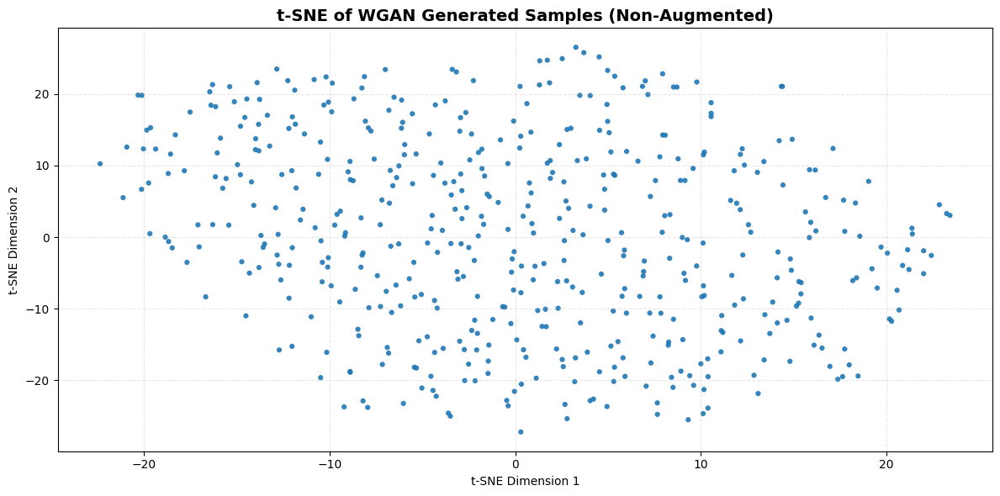

In [ ]:
# ========== Generate New Images from Random Noise ========== #
latent_dim = 160
noise = tf.random.normal([500, latent_dim])
generated_images = generator(noise, training=False)
generated_images = (generated_images + 1) / 2.0

def plot_tsne_embeddings(generated_images, save_path=None, title="t-SNE of WGAN Generated Samples (Non-Augmented)"):
    # ----- Convert to [0, 1] Range ----- #
    if tf.reduce_max(generated_images).numpy() > 1.0:
        raise ValueError("Images should be in [-1, 1] range before scaling.")

    images_rescaled = (generated_images + 1.0) / 2.0
    flat_images = images_rescaled.numpy().reshape(images_rescaled.shape[0], -1)

    # ---- Run t-SNE ----- #
    tsne = TSNE(n_components=2, perplexity=30, learning_rate='auto', init='pca', random_state=42)
    tsne_proj = tsne.fit_transform(flat_images)

    # ----- Plot t-SNE ----- #
    plt.figure(figsize=(12, 6))
    sns.scatterplot(
        x=tsne_proj[:, 0],
        y=tsne_proj[:, 1],
        s=20,
        alpha=0.9,
        edgecolor='none'
    )
    plt.title(title, fontsize=14, weight='bold')
    plt.xlabel("t-SNE Dimension 1")
    plt.ylabel("t-SNE Dimension 2")
    plt.grid(True, linestyle='--', alpha=0.3)
    plt.tight_layout()

    if save_path:
        plt.savefig(save_path, dpi=300)
        print(f"t-SNE plot saved to: {save_path}")

    plt.show()

plot_tsne_embeddings(generated_images=generated_images)

With reference to the t-SNE plot of WGAN generated samples (Non-Augmented) above, we are able to make the following observations:

**Good Coverage of Latent Space**

- The distribution forms a wide elliptical shape across both axes.

- Suggests that WGAN is effectively exploring the latent manifold and generating diverse samples.

**Uniform Dispersion**

- Data points are moderately spread with no severe clustering or empty regions.

- Indicates stable training and minimal collapse during generation.

**No Clear Structure**

- The points are randomly scattered with no visible semantic organisation.

- Expected for unsupervised settings where labels are not imposed on generation.

**Low Outlier Presence**

- Outlier density is minimal, with most points conforming to the main body of the distribution.

- Implies that WGAN is less prone to mode-hopping or unstable generation.

With the observations indicated above, we will proceed to train the next GAN Model in the next sub-section.

---
## 4.6 Deep Regret Analytic GAN Model Training

In this sub-section, we will be training a Deep Regret Analytic GAN (DRAGAN) for the EMNIST Dataset. The LSGAN mainly replace the Binary Crossentropy Loss used in classical GANs with a Least Squares Loss. Through this replacement, the LSGAN is more likely able to have a Stabalise GAN Training, Produce Higher Quality Images, and Encourage the Generator more Accurate Results. The relevant mathematical formulas are indicated below:

---
**Generator Loss:**

Purpose: Produce Outputs Classified as Real.

$$
\mathcal{L}_G = -\mathbb{E}_{z \sim p_z(z)} [\log D(G(z))]
$$

Where:
- $c = 1$ = Desired Discriminator Output for Generated Images  
- $D(G(z))$ = Discriminator's Output for Generated Data  
- $z \sim p_z$ = Sample from Latent Space

---
**Discriminator Loss:**

Purpose: Discriminator Minimises the Error between Predictions and True Labels.

$$
\mathcal{L}_D = \frac{1}{2} \mathbb{E}_{x \sim p_{\text{data}}}[(D(x) - b)^2] + \frac{1}{2} \mathbb{E}_{z \sim p_z}[(D(G(z)) - a)^2]
$$

Where:  
- $D(x)$ = Discriminator's Output for Real Data  
- $D(G(z))$ = Discriminator's Output for Generated Data  
- $a = 0$ = Label for Fake Data  
- $b = 1$ = Label for Real Data  
- $x \sim p_{\text{data}}$ = Sample from Real Data Distribution  
- $z \sim p_z$ = Sample from Latent Noise Distribution  

---
**Pertubed Input Sampling:**

Purpose: Add noise to real images to compute gradient penalty near the data manifold.

$$
\hat{x} = x + \alpha \cdot \sigma_x \cdot \epsilon
$$
Where:
- $x$ = Real Data Sample
- $\alpha \sim \mathcal{U}(0, 1)$ = Uniform Random Variable
- $\epsilon \sim \mathcal{N}(0, 1)$ = Standard Normal Noise
- $\sigma_x$ = Standard Deviation of Data Batch (per pixel)

---
**Minimax Objective with DRAGAN Penalty:**

Purpose: LSGAN Seeks to Solve the Objective.

$$
\min_G \max_D \; V(D, G) = \mathbb{E}_{x \sim p_{data}} [\log D(x)] + \mathbb{E}_{z \sim p_z(z)} [\log(1 - D(G(z)))] - \lambda \cdot \mathbb{E}_{\hat{x} \sim p_{perturbed}} \left[ \left( \|\nabla_{\hat{x}} D(\hat{x}) \|_2 - 1 \right)^2 \right]
$$
Where:
- $V(D, G)$ = Value Function for Adversarial Training
---
With the relevant mathematical formulas indicated above, we will proceed to train the LSGAN in this sub-section for the purpose of it's potential for smoother training process and also to serve as a comparison for our other GAN Models.

---
### 4.6.1 Defining Data Pre-Processing Function

In this sub-section, we will be defining the Data Pre-Processing Function which will allow for consistent Data Pipeline to be built and modifed accordingly should the need arise such as when we need to add Spectral Normalisation. This will ensure that the Data's integrity is not affected and we are able to make fair and un-biased assumptions. The Data Pre-Processing Function is defined in the Code Cell below:

In [ ]:
# ========== Data Pre-Processing Function ========== #
def load_data(X_train, batch_size=32):
    buffer_size = X_train.shape[0]

    dataset = tf.data.Dataset.from_tensor_slices(X_train)
    dataset = dataset.shuffle(buffer_size)
    dataset = dataset.batch(batch_size)
    dataset = dataset.prefetch(tf.data.AUTOTUNE)

    return dataset

With reference to the Code Cell above, we are able to determine that the Data Pre-Processing Function have been defined successfully and we are able to move on to Defining Callback Functions in the next sub-section.

---
### 4.6.2 Defining Callback Functions

In this sub-section, we will be pre-defining the various Callbacks. This is to ensure consistency throughout the model and also to increase the GAN Accuracy and optimise the Computation Cost for training each GAN Model. These Callbacks will be main used during the GAN Training in the next sub-section. The revelant mathematical formula for the callbacks and logic are indicated below:

---
**Learning Rate Scheduler:**

Purpose: Reduces Learning Rate During Training to Fine-tune Model Convergence.

$$\text{If } epoch \mod 10 = 0 \Rightarrow \eta_{new} = \frac{1}{2} \cdot \eta$$

Where:

- $\eta$ = current learning rate

- $\eta_{\text{new}}$ = updated learning rate

- $epoch \bmod 10$ checks if the epoch is a multiple of 10

---
**ReduceLROnPlateau:**

Purpose: Automatically Reduces the Learning Rate when Validation Performance Plateaus.

$$
\text{If no improvement in } val\_loss \text{ for 10 epochs: } \eta_{\text{new}} = 0.5 \cdot \eta
$$

Where:

- $\eta_{\text{new}}$ = reduced learning rate

---
**EarlyStopping:**

Purpose: Prevents Wastage of Computational Power if Model Does Not Improve.

$$
\text{If } val\_loss \text{ does not improve for 25 epochs, stop training and restore best weights}
$$

---

We will proceed to Define the Callbacks in the Code Cell below in preparation for the GAN Model Training.

In [ ]:
# ========== Define Learning Rate Scheduler ========== #
lr_scheduler = LearningRateScheduler(
    lambda epoch, lr: lr * 0.95 if epoch % 10 == 0 else lr,
    verbose=1
)

# ========== Define Reduce LR on Plateau ========== #
reduce_lr = ReduceLROnPlateau(
    monitor='loss',
    factor=0.5,
    patience=10,
    verbose=1,
    min_lr=1e-6
)

# ========== Define Early Stopping ========== #
early_stop = EarlyStopping(
    monitor='loss',
    patience=25,
    verbose=1,
    restore_best_weights=False
)

# ========== Define Display Generated Images ========== #
def display_generated_images(generator, latent_dim, n=7):
    noise = tf.random.normal([n * n, latent_dim])
    generated_images = generator(noise, training=False)
    generated_images = (generated_images + 1.0) / 2.0

    fig, axes = plt.subplots(n, n, figsize=(n, n))
    for i in range(n):
        for j in range(n):
            img = generated_images[i * n + j, :, :, 0]
            axes[i, j].imshow(img, cmap='gray')
            axes[i, j].axis('off')

    plt.tight_layout()
    plt.show()

# ========== Define FID Calculator ========== #
def calculate_fid(real_images, fake_images, batch_size=10):

    # ----- Scale to [0,255] and Resize to 299×299 ----- #
    real = (real_images + 1.0) * 127.5
    fake = (fake_images + 1.0) * 127.5
    real = tf.image.resize(real, (299,299))
    fake = tf.image.resize(fake, (299,299))

    # ----- If Grayscale, Convert to RGB ----- #
    if real.shape[-1] == 1:
        real = tf.image.grayscale_to_rgb(real)
        fake = tf.image.grayscale_to_rgb(fake)

    # ----- Preprocess for Inception (–1 to +1) ----- #
    real_pp = preprocess_input(real)
    fake_pp = preprocess_input(fake)

    # ----- Extract Features in Batches ----- #
    def _get_acts(x):
        acts = []
        n = x.shape[0]
        for i in range(0, n, batch_size):
            chunk = x[i:i+batch_size]
            acts.append(_inception_model(chunk, training=False).numpy())
        return np.vstack(acts)

    act_real = _get_acts(real_pp)
    act_fake = _get_acts(fake_pp)

    # ----- Compute Statistics ----- #
    mu1, sigma1 = act_real.mean(axis=0), np.cov(act_real, rowvar=False)
    mu2, sigma2 = act_fake.mean(axis=0), np.cov(act_fake, rowvar=False)
    diff    = mu1 - mu2
    covmean = sqrtm(sigma1.dot(sigma2))
    if np.iscomplexobj(covmean):
        covmean = covmean.real
    fid = diff.dot(diff) + np.trace(sigma1 + sigma2 - 2*covmean)
    return float(np.round(fid,4))

# ========== Confirmation Message ========== #
print("DRAGAN Callbacks and Visualisation Setup Complete")

DRAGAN Callbacks and Visualisation Setup Complete


With reference to the Code Cell above, we are able to verify that that the Callbacks have been successfully defined and the various parameters are set so as to ensure a High Accuracy and Computing Efficient GAN Model Training.

---
### 4.6.3 Defining DRAGAN Generator Architecture

In this section, we will be defining the DRAGAN's Generator Architecture. The Generator will be trying to make realistic generated images in the attempt to bypass the Discriminator. Subsequently, the generated images from the Generator will be evaluated based on a few evaluation metrics such as Inception Score. The relevent mathematical formulas for the Loss Function of the Vanilla GAN Generator is indicated below:

---
**Generator Loss:**

Purpose: Produce Outputs Classified as Real.

$$
\mathcal{L}_G = \frac{1}{2} \mathbb{E}_{z \sim p_z}[(D(G(z)) - c)^2]
$$

Where:
- $c = 1$ = Desired Discriminator Output for Generated Images  
- $D(G(z))$ = Discriminator's Output for Generated Data  
- $z \sim p_z$ = Sample from Latent Space

---
With the relevant Generator Loss Formula indicated above, we will proceed to define the GAN Generator's Architecture in the Code Cell below and the Lost Function.

In [ ]:
# ========== Generator Function ========== #
def build_generator(latent_dim=100, use_dropout=True):
    model = tf.keras.Sequential(name="generator")

    # ----- Project and Reshape ----- #
    model.add(tf.keras.layers.Dense(7 * 7 * 256, use_bias=False, input_shape=(latent_dim,)))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.ReLU())
    model.add(tf.keras.layers.Reshape((7, 7, 256)))

    # ----- Upsample 1 ----- #
    model.add(tf.keras.layers.Conv2DTranspose(128, kernel_size=5, strides=1, padding='same', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.ReLU())
    if use_dropout:
        model.add(tf.keras.layers.Dropout(0.3))

    # ----- Upsample 2 ----- #
    model.add(tf.keras.layers.Conv2DTranspose(64, kernel_size=5, strides=2, padding='same', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.ReLU())
    if use_dropout:
        model.add(tf.keras.layers.Dropout(0.3))

    # ----- Final Output to 28x28x1 ----- #
    model.add(tf.keras.layers.Conv2DTranspose(1, kernel_size=5, strides=2, padding='same', activation='tanh'))

    return model

# ========== DRAGAN Generator Loss (BCE) ========== #
bce = tf.keras.losses.BinaryCrossentropy(from_logits=True)

def generator_loss(fake_output):
    return bce(tf.ones_like(fake_output), fake_output)

With reference to the Code Cell above, we are able to verify that the GAN's Generator Architecture have been successfully defined and we are able to proceed to define the GAN's Discriminator Architecture.

---
### 4.6.4 Defining DRAGAN Discriminator Architecture

In this section, we will be defining the Architecture of the Discriminator of the GAN. The Discriminator will be the Neural Network that will attempt to tell the Generated Images apart from the Actual Images. This will allow the GAN to improve overtime and also improve itself overtime. The mathematical function for the Discriminator Loss Function is indicated below:

---
**Discriminator Loss:**

Purpose: Discriminator Minimises the Least Squares Error between Predictions and True Labels.

$$
\mathcal{L}_D = \frac{1}{2} \mathbb{E}_{x \sim p_{\text{data}}}[(D(x) - b)^2] + \frac{1}{2} \mathbb{E}_{z \sim p_z}[(D(G(z)) - a)^2]
$$

Where:  
- $D(x)$ = Discriminator's Output for Real Data  
- $D(G(z))$ = Discriminator's Output for Generated Data  
- $a = 0$ = Label for Fake Data  
- $b = 1$ = Label for Real Data  
- $x \sim p_{\text{data}}$ = Sample from Real Data Distribution  
- $z \sim p_z$ = Sample from Latent Noise Distribution  
---

With the mathematical formula for the Loss Function indicated above, we will proceed to define the GAN's Discriminator Architecture and the Loss Function in the Code Cell below.

In [ ]:
# ========== Discriminator Function ========== #
def build_discriminator(input_shape=(28, 28, 1)):
    model = tf.keras.Sequential(name="discriminator")

    model.add(tf.keras.layers.Conv2D(64, kernel_size=5, strides=2, padding='same', input_shape=input_shape))
    model.add(tf.keras.layers.LeakyReLU(0.2))
    model.add(tf.keras.layers.Dropout(0.3))

    model.add(tf.keras.layers.Conv2D(128, kernel_size=5, strides=2, padding='same'))
    model.add(tf.keras.layers.LeakyReLU(0.2))
    model.add(tf.keras.layers.Dropout(0.3))

    model.add(tf.keras.layers.Flatten())
    model.add(tf.keras.layers.Dense(1))

    return model

# ========== Discriminator Loss Function ========== #
bce = tf.keras.losses.BinaryCrossentropy(from_logits=True)

def discriminator_loss(real_output, fake_output):
    real_labels = tf.ones_like(real_output)
    fake_labels = tf.zeros_like(fake_output)

    real_loss = bce(real_labels, real_output)
    fake_loss = bce(fake_labels, fake_output)

    return real_loss + fake_loss

With reference to the Code Cell above, we are able to verify that the GAN's Discriminator Architecture have been successfully defined and we are able to proceed to define the GAN's Training Steps.

---
### 4.6.5 Defining Training Step

In this section, we will be Defining the Training Step function so as to train both the Generator and the Discriminator at the same time. The Training Step will compute the gradients for both the Generator and the Discriminator at the same time. The relevant mathematical formulas for the Training Step is indicated below:

---
**Generator Loss:**

Purpose: Produce Outputs Classified as Real.

$$
\mathcal{L}_G = \frac{1}{2} \mathbb{E}_{z \sim p_z}[(D(G(z)) - c)^2]
$$

Where:
- $c = 1$ = Desired Discriminator Output for Generated Images  
- $D(G(z))$ = Discriminator's Output for Generated Data  
- $z \sim p_z$ = Sample from Latent Space

---
**Discriminator Loss:**

Purpose: Discriminator Minimises the Least Squares Error between Predictions and True Labels.

$$
\mathcal{L}_D = \frac{1}{2} \mathbb{E}_{x \sim p_{\text{data}}}[(D(x) - b)^2] + \frac{1}{2} \mathbb{E}_{z \sim p_z}[(D(G(z)) - a)^2]
$$

Where:  
- $D(x)$ = Discriminator's Output for Real Data  
- $D(G(z))$ = Discriminator's Output for Generated Data  
- $a = 0$ = Label for Fake Data  
- $b = 1$ = Label for Real Data  
- $x \sim p_{\text{data}}$ = Sample from Real Data Distribution  
- $z \sim p_z$ = Sample from Latent Noise Distribution  

---
**Minimax Objective with DRAGAN Penalty:**

Purpose: LSGAN Seeks to Solve the Objective.

$$
\min_G \max_D \; V(D, G) = \mathbb{E}_{x \sim p_{data}} [\log D(x)] + \mathbb{E}_{z \sim p_z(z)} [\log(1 - D(G(z)))] - \lambda \cdot \mathbb{E}_{\hat{x} \sim p_{perturbed}} \left[ \left( \|\nabla_{\hat{x}} D(\hat{x}) \|_2 - 1 \right)^2 \right]
$$
Where:
- $V(D, G)$ = Value Function for Adversarial Training
---

With the relevant mathematical formulas indicated above, we will proceed to define the Training Step in the Code Cell below.

In [ ]:
# ========== Training Step Function ========== #
@tf.function
def train_step(real_images, generator, discriminator,
               gen_optimizer, disc_optimizer,
               latent_dim, gp_weight=10.0):
    batch_size = tf.shape(real_images)[0]

    # ----- Latent Noise (L2-Normalised) ----- #
    noise = tf.random.normal([batch_size, latent_dim])
    noise = tf.math.l2_normalize(noise, axis=1)

    # ----- Instance Noise on Real Images ----- #
    real_noisy = real_images + tf.random.normal(tf.shape(real_images)) * 0.05

    # ----- Compute Losses & Gradients ----- #
    with tf.GradientTape(persistent=True) as tape:
        # ----- Generate Fake Images ----- #
        fake_images = generator(noise, training=True)

        # ----- Discriminator Outputs ----- #
        real_output = discriminator(real_noisy, training=True)
        fake_output = discriminator(fake_images, training=True)

        # ----- Adversarial BCE Losses with Label Smoothing ----- #
        real_labels = tf.ones_like(real_output) * 0.9  # label smoothing
        fake_labels = tf.zeros_like(fake_output)
        real_loss = bce(real_labels, real_output)
        fake_loss = bce(fake_labels, fake_output)
        disc_loss = real_loss + fake_loss

        # ----- Generator Loss ----- #
        gen_loss = bce(tf.ones_like(fake_output), fake_output)

        # ----- DRAGAN Gradient Penalty (Local Perturbation) ----- #
        alpha = tf.random.uniform([batch_size, 1, 1, 1], 0.0, 1.0)
        noise_perturb = 0.5 * tf.random.normal(tf.shape(real_images))
        x_hat = real_images + alpha * noise_perturb
        with tf.GradientTape() as gp_tape:
            gp_tape.watch(x_hat)
            pred_hat = discriminator(x_hat, training=True)
        grads = gp_tape.gradient(pred_hat, x_hat)
        grads = tf.reshape(grads, [batch_size, -1])
        grads_norm = tf.sqrt(tf.reduce_sum(tf.square(grads), axis=1) + 1e-12)
        gp = tf.reduce_mean((grads_norm - 1.0) ** 2)

        # ----- Add Gradient Penalty to Discriminator Loss ----- #
        disc_loss += gp_weight * gp

    # ----- Apply Gradients ----- #
    gen_grads = tape.gradient(gen_loss, generator.trainable_variables)
    disc_grads = tape.gradient(disc_loss, discriminator.trainable_variables)
    gen_optimizer.apply_gradients(zip(gen_grads, generator.trainable_variables))
    disc_optimizer.apply_gradients(zip(disc_grads, discriminator.trainable_variables))

    del tape

    return gen_loss, disc_loss, real_output, fake_output

With reference to the Code Cell above, we are able to determine that the Training Step have been successfully defined and we are able to proceed to prepare the Training Loop in the next section.

---
### 4.6.6 Defining Training Loop

In this section, we will be defining the Training Loop for the GAN Training. The Training Loop will go through each of the Epoch and train both the Generator and Discriminator simultaneously. The Training Loop will also track the Loss for both the Generator and the Discriminator for each of the Epoch trained. The relevant mathematical formulas are indicated below:

---
**Epoch Loss Averaging:**

Purpose: These are the Average Generator and Discriminator Losses over all Batches in Epoch $t$.

$$
\bar{L}_G^{(t)} = \frac{1}{N} \sum_{i=1}^{N} L_G^{(i)} \\
\bar{L}_D^{(t)} = \frac{1}{N} \sum_{i=1}^{N} L_D^{(i)}
$$

Where:
- $\bar{L}_G^{(t)}$ = Average Generator Loss at Epoch $t$  
- $\bar{L}_D^{(t)}$ = Average Discriminator Loss at Epoch $t$  
- $N$ = Number of Batches in the Dataset  
- $L_G^{(i)}$ = Generator Loss on Batch $i$  
- $L_D^{(i)}$ = Discriminator Loss on Batch $i$

---
**Epoch Iteration:**

Purpose: Describes the Training Loop Logic: for Each Epoch $t$, perform `train_step` for Every Mini-batch.

$$
\text{for } t = 1 \text{ to } T:
\quad \text{for each batch } (x^{(i)}):
\quad \text{train_step}(x^{(i)})
$$

Where:
- $T$: Total Number of Epochs  
- $x^{(i)}$: Real Batch $i$ from the Dataset  
- `train_step`: Function that Updates $G$ and $D$ using that Batch

---
**Generated Image Output:**

Purpose: Sample Random Noise $z$ and Generate Synthetic Image $\hat{x}$ from the Generator. This is used for Visual Monitoring of Model Quality.

$$
z \sim p_z(z) \\
\hat{x} = G(z)
$$

Where:
- $z$: Random Latent Vector  
- $G(z)$: Generated Image from Generator

---
With the mathematical formulas indicated above, we will proceed to define the Training Loop in the Code Cell below in preparation of the GAN Training.

In [ ]:
# ========== Training Loop Function ========== #
def train(dataset, epochs, generator, discriminator, gen_optimizer, disc_optimizer, latent_dim, save_path=None, use_early_stopping=True, steps_per_epoch=None, gp_weight=10.0):

    # ----- Prepare Fixed Real Batch from Validation Set X_val for FID ----- #
    real_val = tf.data.Dataset.from_tensor_slices(X_val).batch(50).take(1)

    # ----- Prepare Fixed Noise Batch for FID ----- #
    noise_val = tf.random.normal([50, latent_dim])
    noise_val = tf.math.l2_normalize(noise_val, axis=1)

    # ----- Early Stopping ----- #
    best_fid     = float('inf')
    no_improve   = 0
    patience     = 10
    fid_interval = 1

    # ----- Dummy Model ----- #
    dummy_input  = Input(shape=(1,))
    dummy_output = Lambda(lambda x: x)(dummy_input)
    dummy_model  = Model(dummy_input, dummy_output)
    dummy_model.compile(optimizer=Adam(1e-4), loss='mse')

    early_stop.set_model(dummy_model)
    reduce_lr.set_model(dummy_model)
    lr_scheduler.set_model(dummy_model)
    early_stop.on_train_begin({})
    reduce_lr.on_train_begin({})
    lr_scheduler.on_train_begin({})

    # ----- Track Loss Histories ----- #
    gen_loss_history  = []
    disc_loss_history = []

    for epoch in range(1, epochs + 1):
        print(f"\nEpoch {epoch}/{epochs}")
        gen_losses, disc_losses = [], []

        # ----- Per‐batch Training ----- #
        for i, real_images in enumerate(dataset):
            if steps_per_epoch and i >= steps_per_epoch:
                break

            gen_loss, disc_loss, _, _ = train_step(
                real_images,
                generator,
                discriminator,
                gen_optimizer,
                disc_optimizer,
                latent_dim,
                gp_weight=gp_weight
            )
            gen_losses.append(gen_loss)
            disc_losses.append(disc_loss)

        # ----- Compute Averages ----- #
        avg_gen_loss  = tf.reduce_mean(gen_losses)
        avg_disc_loss = tf.reduce_mean(disc_losses)
        print(f"Generator Loss: {avg_gen_loss:.4f} | Discriminator Loss: {avg_disc_loss:.4f}")

        gen_loss_history.append(float(avg_gen_loss))
        disc_loss_history.append(float(avg_disc_loss))

        # ----- Callback on Generator Loss ----- #
        logs = {'loss': float(avg_gen_loss)}
        if use_early_stopping:
            early_stop.on_epoch_end(epoch=epoch, logs=logs)
            if early_stop.stopped_epoch > 0:
                print(f"Early stopping triggered at epoch {epoch}")
                break
        reduce_lr.on_epoch_end(epoch=epoch, logs=logs)
        lr_scheduler.on_epoch_end(epoch=epoch, logs=logs)

        # ----- FID Evaluation & Early Stopping ----- #
        if epoch % fid_interval == 0:
            fake_val   = generator(noise_val, training=False)
            real_batch = next(iter(real_val))

            # ----- Resize & Rescale to [0,1] ----- #
            real_for_fid = tf.image.resize(real_batch, [299,299]) * 0.5 + 0.5
            fake_for_fid = tf.image.resize(fake_val,    [299,299]) * 0.5 + 0.5
            fid_value = calculate_fid(real_for_fid, fake_for_fid)

            print(f"Epoch {epoch} → Val FID: {fid_value:.2f}")

            if fid_value < best_fid:
                best_fid   = fid_value
                no_improve = 0
                if save_path:
                    os.makedirs(save_path, exist_ok=True)
                    generator.save_weights(os.path.join(save_path, "best_gen.weights.h5"))
                    discriminator.save_weights(os.path.join(save_path, "best_disc.weights.h5"))
            else:
                no_improve += 1

            if no_improve >= patience:
                print(f"No FID improvement for {patience} epochs, stopping.")
                break

        # ----- Display Every 5 Epochs ----- #
        if epoch % 5 == 0:
            display_generated_images(generator, latent_dim)

    # ----- Restore Best Weights After Training ----- #
    if save_path:
        best_gen_path = os.path.join(save_path, "best_gen.weights.h5")
        best_disc_path = os.path.join(save_path, "best_disc.weights.h5")
        if os.path.exists(best_gen_path) and os.path.exists(best_disc_path):
            generator.load_weights(best_gen_path)
            discriminator.load_weights(best_disc_path)
            print("Restored best generator and discriminator weights based on lowest FID.")
        else:
            print("Best weight files not found. Skipping restore.")

    return avg_gen_loss, gen_loss_history, disc_loss_history

With reference to the Code Cell above, we are able to determine that the Training Loop have been successfully defined and we are able to proceed to define the Optimisers with Tunable Parameter in preparation for the Optuna Tuning.

---
### 4.6.7 Defining Optimisers with Tunable Parameters

In this section, we will be defining the Common Optimisers that will be Tuned using the Optuna Tuning. The Optimisers will each have a range of values in a list so as to allow for the Optuna to search for the best Hyperparameter for the GAN. Through these parameters, it will affect how effective and efficiently the GAN will learn from the provided EMNIST Data. The relevent mathematical formula is indicated below:

---
**Optimiser Update Rule**

Purpose: Parameter Update Step in the Adam Optimiser, using Adaptive Learning Rates with Momentum.

$$
\theta \leftarrow \theta - \eta \cdot \frac{m_t}{\sqrt{v_t} + \epsilon}
$$

Where:
- $\theta$ = Model Parameters (Generator or Discriminator)
- $\eta$ = Learning Rate (Tuned)
- $m_t$ = First Moment Estimate (Mean of Gradients)
- $v_t$ = Second Moment Estimate (Variance of Gradients)
- $\epsilon$ = Small Constant for Numerical Stability

---
With the mathematical formula indicated above, we will proceed to define the Optimisers in the Code Cell.

In [ ]:
# ========== Objective Function ========== #
def objective(trial):
    # ----- Hyperparameters ----- #
    latent_dim   = trial.suggest_categorical('latent_dim', [100, 128, 160])
    learning_rate = trial.suggest_float('learning_rate', 5e-5, 2e-4, log=True)
    beta_1        = trial.suggest_float('beta_1', 0.4, 0.6)

    # ----- Build Models (Unconditional) ----- #
    generator     = build_generator(latent_dim=latent_dim)
    discriminator = build_discriminator()

    # ----- Trigger Weight Creation ----- #
    _ = generator(tf.random.uniform([1, latent_dim], -1.0, 1.0))
    _ = discriminator(tf.random.normal([1, 28, 28, 1]))

    # ----- Define Optimizers ----- #
    gen_optimizer  = tf.keras.optimizers.Adam(learning_rate=learning_rate, beta_1=beta_1)
    disc_optimizer = tf.keras.optimizers.Adam(learning_rate=learning_rate, beta_1=beta_1)

    # ----- Prebuild Optimizer Variables ----- #
    _ = gen_optimizer.apply_gradients([(tf.zeros_like(v), v) for v in generator.trainable_variables])
    _ = disc_optimizer.apply_gradients([(tf.zeros_like(v), v) for v in discriminator.trainable_variables])

    # ----- Load Training Data (Unconditional) ----- #
    dataset = load_data(X_train, batch_size=64)
    steps   = min(1000, len(X_train) // 64)

    # ----- Train DRAGAN ----- #
    _ = train(
        dataset=dataset,
        epochs=50,
        generator=generator,
        discriminator=discriminator,
        gen_optimizer=gen_optimizer,
        disc_optimizer=disc_optimizer,
        latent_dim=latent_dim,
        steps_per_epoch=steps,
        save_path=None,
        gp_weight=10.0
    )

    # ----- Generate Fake Images ----- #
    z = tf.random.uniform([1000, latent_dim], -1.0, 1.0)
    fake_images = generator(z, training=False)
    fake_images = (fake_images + 1.0) / 2.0  # Rescale to [0, 1]

    # ----- Real Images from Validation Set ----- #
    real_images = X_val[:1000]

    # ----- Compute FID Score ----- #
    fid_score = calculate_fid(real_images, fake_images)
    return fid_score

With reference to the Code Cell above, we are able to determine that the Optimiser have been successfully defined with a range of different Parameter Values so as to provide a robust Optuna Tuning in the subsequent sections.

---
### 4.6.8 Optuna Tuning Study

In this sub-section, we will be conducting the Optuna Tuning Study on the GAN Model so as to obtain the best Hyperparameter for the GAN Model. It is expected that the Tuning takes a prolonged duration due to the nature of how the GAN works and the 2 Neural Networks involved. However, the training data will be stored so as to prevent re-running of repetitive codes. The Optuna Tuning Study will be conducted in the Code Cell below.

In [ ]:
# ========== Create or Load Study with SQLite Backend ========== #
study = optuna.create_study(
    direction="minimize",
    study_name="dragan_tuning",
    storage="sqlite:////content/drive/MyDrive/Colab Notebooks/DELE CA2 A/Non-Augmented GAN Tunings/dragan_optuna.db",
    load_if_exists=True
)

# ========== Trial Management ========== #
MAX_TRIALS = 50
completed_trials = len([t for t in study.trials if t.state == optuna.trial.TrialState.COMPLETE])
remaining_trials = MAX_TRIALS - completed_trials

if remaining_trials > 0:
    print(f"Resuming DRAGAN study: {completed_trials} completed, running {remaining_trials} more.")
    study.optimize(objective, n_trials=remaining_trials)
else:
    print(f"DRAGAN study already completed {MAX_TRIALS} trials. Skipping optimization.")

# ========== Output Best Trial ========== #
best_trial = study.best_trial
best_params_df = pd.DataFrame([best_trial.params])
best_params_df["Final FID"] = best_trial.value
best_params_df.style.background_gradient(cmap="Blues")

[I 2025-08-10 11:07:45,212] Using an existing study with name 'dragan_tuning' instead of creating a new one.


DRAGAN study already completed 50 trials. Skipping optimization.


,latent_dim,learning_rate,beta_1,Final FID
0,100,0.000134,0.531830,54.196100


With reference to the Code Cell above, we are able to view the Best Hyperparameter obtained during the Optuna Tuning Study. This Hyperparameter will be extracted and be trained for a longer period of time so as to attempt to increase the performance and limit the loss for the GAN.

---
### 4.6.9 GAN Re-Training Operation

As obtained from the previous sub-section, we will be re-training the GAN using the best Hyperparameter obtained during the Optuna Tuning Study. This is to push the GAN Model to its limits and also to save Computational Power as we are not taking up prolonged periods of time tuning GAN Models which may not have any clear signs of good performance. The retraining of the GAN Model will be conducted in the Code Cell below.

In [ ]:
# ========== Extract Best Parameters from Study ========== #
best_params = study.best_trial.params

latent_dim   = best_params['latent_dim']
learning_rate = best_params['learning_rate']
beta_1        = best_params['beta_1']

print("Using Best Trial Parameters for DRAGAN:")
print(best_params)

# ========== Rebuild DRAGAN Models ========== #
generator = build_generator(latent_dim=latent_dim)
discriminator = build_discriminator()

# ========== Initialise Optimisers ========== #
gen_optimizer  = tf.keras.optimizers.Adam(learning_rate=learning_rate, beta_1=beta_1)
disc_optimizer = tf.keras.optimizers.Adam(learning_rate=learning_rate, beta_1=beta_1)

_ = gen_optimizer.apply_gradients([(tf.zeros_like(v), v) for v in generator.trainable_variables])
_ = disc_optimizer.apply_gradients([(tf.zeros_like(v), v) for v in discriminator.trainable_variables])

# ========== Reload Dataset ========== #
dataset = load_data(X_train)

# ========== Define Paths ========== #
model_name   = "dragan"
output_dir   = f"/content/drive/MyDrive/Colab Notebooks/DELE CA2 A/final_outputs_{model_name}_noAugment"
weights_path = os.path.join(output_dir, f"{model_name}_generator_final.weights.h5")
gen_ckpt     = os.path.join(output_dir, "best_gen.weights.h5")
disc_ckpt    = os.path.join(output_dir, "best_disc.weights.h5")
loss_csv     = os.path.join(output_dir, "loss_history.csv")

os.makedirs(output_dir, exist_ok=True)

# ========== Skip if Already Trained ========== #
if os.path.exists(gen_ckpt) and os.path.exists(disc_ckpt) and os.path.exists(loss_csv):
    print("All outputs found. Skipping training...")

    generator.load_weights(gen_ckpt)
    discriminator.load_weights(disc_ckpt)
    print("Generator and Discriminator Weights Loaded.")

    loss_df = pd.read_csv(loss_csv)
    gen_loss_history  = loss_df['gen_loss'].tolist()
    disc_loss_history = loss_df['disc_loss'].tolist()
    final_gen_loss    = gen_loss_history[-1]

else:
    # ========== Train DRAGAN ========== #
    final_gen_loss, gen_loss_history, disc_loss_history = train(
        dataset=dataset,
        epochs=100,
        steps_per_epoch=1546,
        generator=generator,
        discriminator=discriminator,
        gen_optimizer=gen_optimizer,
        disc_optimizer=disc_optimizer,
        latent_dim=latent_dim,
        use_early_stopping=False,
        save_path=output_dir,
        gp_weight=10.0
    )

    # ========== Save Final Generator Weights ========== #
    generator.save_weights(weights_path)
    print("Generator Weights Saved.")

    # ========== Save Loss History ========== #
    loss_df = pd.DataFrame({
        'epoch': list(range(1, len(gen_loss_history)+1)),
        'gen_loss': gen_loss_history,
        'disc_loss': disc_loss_history
    })
    loss_df.to_csv(loss_csv, index=False)
    print(f"Loss history saved to {loss_csv}")

Using Best Trial Parameters for DRAGAN:
{'latent_dim': 100, 'learning_rate': 0.0001339025723095138, 'beta_1': 0.5318301051367128}


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:93: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


All outputs found. Skipping training...
Generator and Discriminator Weights Loaded.


With reference to the Code Cell above, we are able to determine that the best GAN Model have been trained and saved successfully and we are able to proceed with the Model Evaluation in the next sub-sections where we determine how well the GAN Model performed based on various metrics and evaluation methodologies.

---
### 4.6.10 GAN Model Evaluation

In this sub-section, we will be evaluating the GAN's Generator performance on various aspects. We will be utilising different methodologies and metrics to attempt to quantify the performance of the GAN Generator while also conducting Visual Inspection on the result output of the GAN. The Evaluation will be conducted in the following sections.

---
#### 4.6.10.1 Visual Grid of Samples

In this sub-section, we will be visualising the Grid of Samples of the Synthesised Data generated by the GAN Model. A list of observations will be made before the utilisation of Quantitative Metrics to evaluate the GAN Generator's general performance. As the observations made are purely from professional opinion, it will most likely not be used as a Basis of Comparison between GAN Models due to differing opinions unless in extreme cases. The visualisation will be conducted in the Code Cell below.

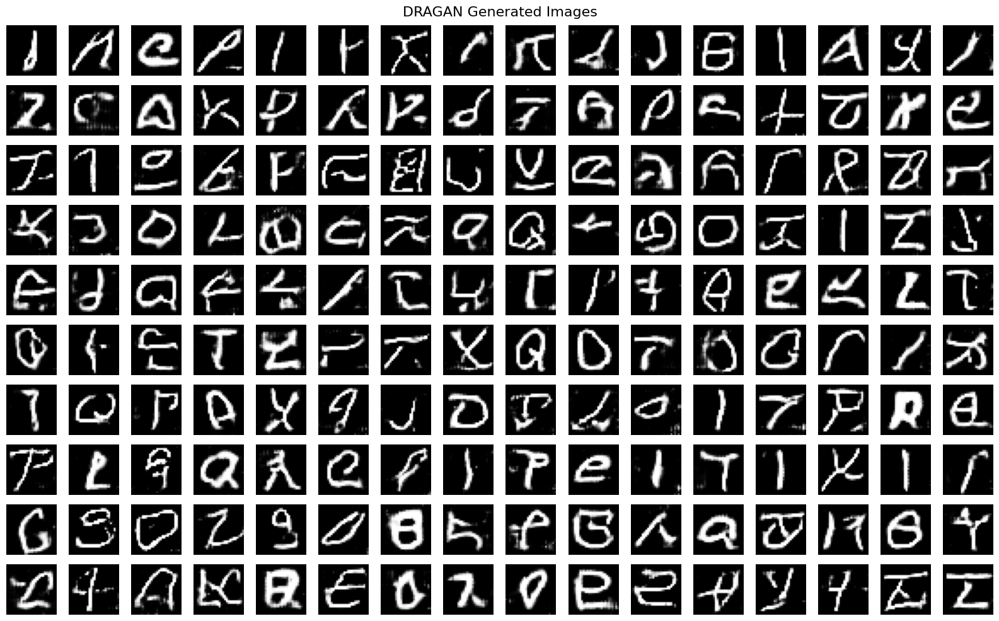

In [ ]:
def plot_generated_images(generator, latent_dim, n_rows=5, n_cols=5, save_path=None, title="DRAGAN Generated Images", seed=42):
    # ----- Generate Latent Vectors ----- #
    if seed is not None:
        tf.random.set_seed(seed)
    noise = tf.random.normal([n_rows * n_cols, latent_dim])
    gen_images = generator(noise, training=False)

    # ----- Rescale from [-1, 1] to [0, 1] ----- #
    gen_images = (gen_images + 1.0) / 2.0
    gen_images = tf.clip_by_value(gen_images, 0.0, 1.0)

    # ----- Shape Check ----- #
    assert gen_images.shape[-1] == 1, "Expected single-channel (grayscale) output"

    # ----- Sample Plot ----- #
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols, n_rows))
    for idx, ax in enumerate(axes.flat):
        ax.imshow(gen_images[idx, :, :, 0], cmap='gray')
        ax.axis('off')

    plt.suptitle(title, fontsize=16)
    plt.tight_layout()

    if save_path:
        plt.savefig(save_path, dpi=300)
        print(f"Saved Generated Image Grid to: {save_path}")

    plt.show()

# ========== Call Plot Function ========== #
plot_generated_images(generator, latent_dim=100, n_rows=10, n_cols=16)

With reference to the output of the Visual Grid of Samples above, we are able to make the following observations:

**Basic Structure of Letters is Somewhat Captured**

- Several characters resemble familiar letters such as "E", "A", "R", "L", or "P".

- Stroke alignment and proportions are generally consistent with handwritten EMNIST characters.

**High Blur and Noise**

- A few samples exhibit faint ghosting or residual noise in the black background.

- Some strokes bleed slightly or show inconsistent thickness, particularly near curves.

**Poor Character Consistency**

- Certain letters like "K", "X", or "G" show unusual formation or missing segments.

- A few glyphs display extra strokes or disconnected lines that reduce interpretability.

With the observations indicated above, we will proceed to conduct the Loss Curve Analysis in the next sub-section.

---
#### 4.6.10.2 Loss Curve Over Epochs

In this sub-section, we will be plotting the GAN Loss Curve over Epochs to evaluate the training behaviour of the GAN. This curve provides insight into whether the GAN is experiencing underfitting, overfitting, or achieving a stable training dynamic between the generator and discriminator.

Although GANs do not minimise a single unified loss in the traditional sense, the trajectory of the generator and discriminator losses can indicate whether the adversarial training process is converging appropriately.

If the generator loss remains high while discriminator loss quickly drops to near-zero, this may indicate **underfitting**, where the generator is not learning effectively to produce plausible images.

If the discriminator loss increases while generator loss sharply decreases, this may suggest **overfitting** or **mode collapse**, where the generator exploits narrow weaknesses in the discriminator without general improvement.

A relatively stable oscillation or convergence between both losses typically signifies a **well-balanced** training process, where the generator and discriminator are learning in tandem.

The Potential Observations and Corresponding Action Plans are outlined below:

**Underfitting Loss Curve**

- Increase training epochs to allow generator more time to learn.

- Simplify the discriminator to reduce overpowering the generator.

- Adjust the learning rate or apply label smoothing.

- Consider adding batch normalisation in the generator.

**Overfitting or Mode Collapse Loss Curve**

- Introduce or increase dropout in the discriminator.

- Apply input noise or label flipping to the discriminator.

- Evaluate diversity of generated samples regularly.

**Balanced/Ideal Loss Curve**

- Maintain current architecture and hyperparameters.

- Proceed with full-scale image generation.

- Evaluate both qualitative (visual inspection) and quantitative metrics (e.g. Inception Score or FID).

With these potential training behaviours and action plan outlined, we will proceed to visualise the GAN loss dynamics in the code cell below.

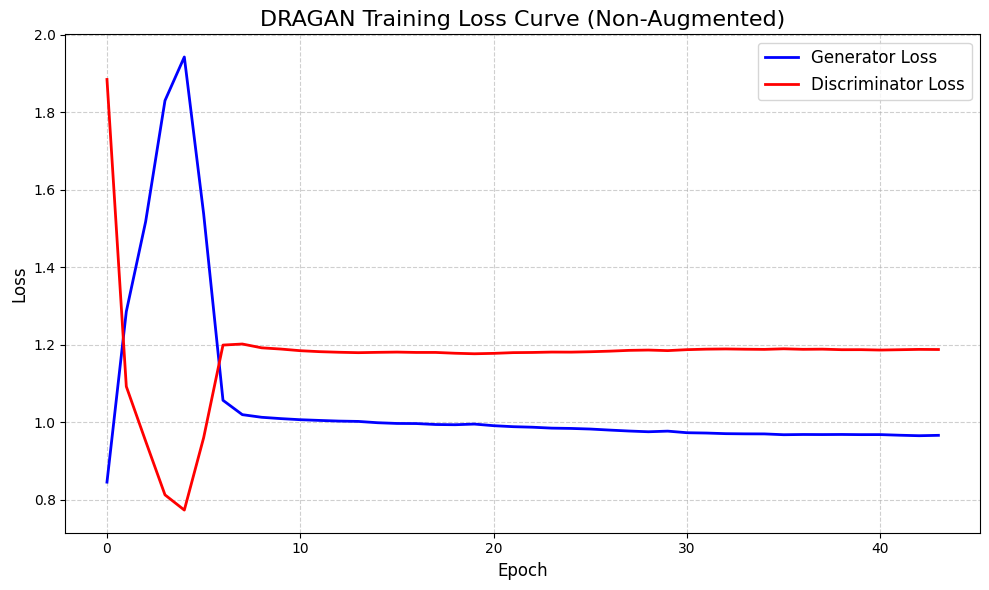

In [ ]:
# =========== Figure Size Configuration =========== #
plt.figure(figsize=(10, 6))

# =========== Plot Training Losses =========== #
plt.plot(gen_loss_history, label="Generator Loss", linewidth=2, color='blue')
plt.plot(disc_loss_history, label="Discriminator Loss", linewidth=2, color='red')

# =========== Labels and Title =========== #
plt.xlabel("Epoch", fontsize=12)
plt.ylabel("Loss", fontsize=12)
plt.title("DRAGAN Training Loss Curve (Non-Augmented)", fontsize=16)

# =========== Grid, Legend, and Styling =========== #
plt.grid(True, linestyle='--', alpha=0.6)
plt.legend(fontsize=12)
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)

# =========== Plot Display =========== #
plt.tight_layout()
plt.show()

With reference to the Loss Curve above, we are able to make the following observations:

- DRAGAN demonstrates initial instability, but achieves excellent long-term stability.

- Generator and discriminator converge to a balanced state, reflecting effective use of gradient penalty.

- Even without augmentation, DRAGAN handles the non-augmented data well and avoids erratic loss behaviour.

With the observations indicated above, we will proceed with conducting the Quantitative Metrics Evaluation in the next sub-section.

---
#### 4.6.10.3 Quantitative Metrics Evaluation

In this sub-section we will be utilising Quantitative Metrics such as FID and KID to tabulate the results of the performance and quantify the performance of the GAN Generator. We will subsequently be use these metrics to conduct inter-model evaluation after tuning and training all the GANs. The metrics that we will be utilising and their respective formulas are indicated below:

---
**Fréchet Inception Distance**

Purpose: Measures the Distance between the Real-Image and Generated-Image Distributions in Inception Feature Space.

$$
\mathrm{FID} \;=\;\|\mu_r - \mu_f\|^2
\;+\;\mathrm{Tr}\Bigl(\Sigma_r + \Sigma_f - 2\,(\Sigma_r\,\Sigma_f)^{\tfrac12}\Bigr)
$$


Where:
- $\mu_r = \mathbb{E}[f(x)]$, $\Sigma_r = \mathrm{Cov}[f(x)]$ for Real Images $x$.  
- $\mu_f = \mathbb{E}[f(\hat x)]$, $\Sigma_f = \mathrm{Cov}[f(\hat x)]$ for Generated Images $\hat x$.  
- $f(\cdot)$ = Map from Image to its InceptionV3 'pooling=avg' Features.  

---
**Diversity (t-SNE Spread)**

Purpose: Quantifies how 'wide' the 2D t-SNE Embedding of Generated Samples.

$$
\mathrm{Spread}
\;=\;
\bigl(\max_i\,z_i^{(1)} - \min_i\,z_i^{(1)}\bigr)
\;\times\;
\bigl(\max_i\,z_i^{(2)} - \min_i\,z_i^{(2)}\bigr)
$$

Where:
- $z_i = (z_i^{(1)}, z_i^{(2)})$ = 2-dimensional t-SNE Embedding of $i$th Generated Image.

---
**Mode Collapse Risk**

Purpose: Flags when too many Generated Images are Nearly Identical (mode collapse).

$$
\text{ModeCollapseRisk} =
\begin{cases}
\text{Low}, & \dfrac{\bigl|\{\mathrm{unique\_rounded}(x_i)\}\bigr|}{N} > \tau,\\
\text{High}, & \text{otherwise}.
\end{cases}
$$

Where:
- $x_i$ = $N$ Generated Samples.  
- $\mathrm{unique\_rounded}(x_i)$ = Rounds Pixels to Detect Duplicates.  
- $\tau=0.9$ = Uniqueness Threshold (90%).

---
**Perceptual Path Length**

Purpose: Measures Sensitively of Generator's Outputs (in VGG16 Feature Space) move when the Latent Code $z$ is Perturbed.

$$
\mathrm{PPL}
\;=\;
\mathbb{E}_{z,\delta z}\Bigl[\,
\|\phi\bigl(G(z + \epsilon\,\delta z)\bigr)\;-\;\phi\bigl(G(z)\bigr)\|_2^2
\Bigr]
$$

Where:  
- $G(z)$ = GAN Generator Mapping $z\in\mathbb{R}^{\mathrm{latent\_dim}}$ to an Image.  
- $\phi(\cdot)$ = VGG16 'pooling=avg' Feature Extractor.  
- $\delta z\sim\mathcal{N}(0,I)$, $\epsilon$ = Small Constant.

---
**Kernel Inception Distance**

Purpose: An Unbiased Estimator of the Squared Maximum Mean Discrepancy (MMD) between Real and Generated Inception Features.

$$
\mathrm{KID}
\;=\;
\frac{1}{m(m-1)}\sum_{i\neq j} k\bigl(\phi(x_i),\phi(x_j)\bigr)
\;+\;
\frac{1}{n(n-1)}\sum_{i\neq j} k\bigl(\phi(\hat x_i),\phi(\hat x_j)\bigr)
\;-\;
\frac{2}{mn}\sum_{i=1}^m\sum_{j=1}^n k\bigl(\phi(x_i),\phi(\hat x_j)\bigr)
$$

Where:  
- $x_i$ ($i=1\ldots m$) = Real Images.
- $\hat x_j$ ($j=1\ldots n$) = Generated Images.  
- $\phi(\cdot)$ = InceptionV3 Feature Extractor (pooling='avg').  
- $k(u,v) = \bigl(\frac{u^\top v}{d}+1\bigr)^3$ = degree-3 Polynomial Kernel on $d$-dimensional Features.

---

With the mathematical and metrics indicated above, we will proceed to conduct the Quantitave Metrics Evalution in the Code Cell below.

In [ ]:
# ========== Preload InceptionV3 and VGG16 Models ========== #
inception = InceptionV3(include_top=False, pooling='avg', input_shape=(299, 299, 3))
vgg_model = VGG16(include_top=False, weights='imagenet', input_shape=(128, 128, 3))

# ========== Preprocess for Inception ========== #
def preprocess_images_for_inception(images):
    images = (images + 1.0) * 127.5  # Scale from [-1, 1] to [0, 255]
    images = tf.image.resize(images, [299, 299])
    if images.shape[-1] == 1:
        images = tf.image.grayscale_to_rgb(images)
    return preprocess_input(images)

# ========== Compute FID ========== #
def calculate_fid(real_images, fake_images, batch_size=50):
    real_pp = preprocess_images_for_inception(real_images)
    fake_pp = preprocess_images_for_inception(fake_images)

    act1 = inception.predict(real_pp, batch_size=batch_size, verbose=0)
    act2 = inception.predict(fake_pp, batch_size=batch_size, verbose=0)

    mu1, sigma1 = np.mean(act1, axis=0), np.cov(act1, rowvar=False)
    mu2, sigma2 = np.mean(act2, axis=0), np.cov(act2, rowvar=False)

    diff = mu1 - mu2
    covmean = sqrtm(sigma1 @ sigma2)
    if np.iscomplexobj(covmean):
        covmean = covmean.real

    fid = diff @ diff + np.trace(sigma1 + sigma2 - 2 * covmean)
    return round(fid, 4)

# ========== Compute KID ========== #
def polynomial_kernel(X, Y):
    d = X.shape[1]
    return (np.dot(X, Y.T) / d + 1) ** 3

def calculate_kid(real_images, fake_images, batch_size=128):
    real_pp = preprocess_images_for_inception(real_images)
    fake_pp = preprocess_images_for_inception(fake_images)

    real_features = inception.predict(real_pp, batch_size=batch_size, verbose=0)
    fake_features = inception.predict(fake_pp, batch_size=batch_size, verbose=0)

    m = real_features.shape[0]
    n = fake_features.shape[0]

    k_rr = polynomial_kernel(real_features, real_features)
    k_gg = polynomial_kernel(fake_features, fake_features)
    k_rg = polynomial_kernel(real_features, fake_features)

    np.fill_diagonal(k_rr, 0)
    np.fill_diagonal(k_gg, 0)

    mmd = (k_rr.sum() / (m * (m - 1)) +
           k_gg.sum() / (n * (n - 1)) -
           2 * k_rg.mean())
    return round(mmd, 4)

# ========== Compute t-SNE Spread (Diversity) ========== #
def calculate_tsne_spread(images):
    flat = images.reshape(images.shape[0], -1)
    tsne = TSNE(n_components=2, random_state=42)
    proj = tsne.fit_transform(flat)
    x_range = proj[:, 0].max() - proj[:, 0].min()
    y_range = proj[:, 1].max() - proj[:, 1].min()
    return round(x_range * y_range, 2)

# ========== Assess Mode Collapse ========== #
def assess_mode_collapse(images):
    unique = np.unique(np.round(images), axis=0).shape[0]
    return "Low" if unique > 0.9 * images.shape[0] else "High"

# ========== Compute Perceptual Path Length (PPL) ========== #
def calculate_ppl(generator, latent_dim=160, num_samples=50, epsilon=1e-2):
    distances = []
    for _ in range(num_samples):
        z1 = tf.random.normal([1, latent_dim])
        z2 = z1 + epsilon * tf.random.normal([1, latent_dim])
        img1 = generator(z1, training=False)
        img2 = generator(z2, training=False)

        img1 = tf.image.resize(tf.image.grayscale_to_rgb((img1 + 1.0) * 127.5), (128, 128))
        img2 = tf.image.resize(tf.image.grayscale_to_rgb((img2 + 1.0) * 127.5), (128, 128))

        f1 = vgg_model(vgg_preprocess(img1))
        f2 = vgg_model(vgg_preprocess(img2))
        d = tf.reduce_mean(tf.square(f1 - f2)).numpy()
        distances.append(d)
    return round(np.mean(distances), 4)

# ========== Evaluate GAN Performance ========== #
def evaluate_gan_model(generator, latent_dim, X_val, gen_loss_history, disc_loss_history, model_name="DRAGAN"):
    # ----- Generate Fake Images ----- #
    noise = tf.random.normal([1000, latent_dim])
    fake_images = generator(noise, training=False)
    fake_images = tf.clip_by_value((fake_images + 1) / 2.0, 0.0, 1.0)
    fake_np = fake_images.numpy()

    # ----- Select and preprocess 1000 Real Images from Validation Set ----- #
    real_images = tf.convert_to_tensor(X_val[:1000], dtype=tf.float32)
    real_images = tf.clip_by_value(real_images, 0.0, 1.0)

    # ----- Compute Metrics ----- #
    fid_value = calculate_fid(real_images, fake_images)
    kid_value = calculate_kid(real_images, fake_images)
    tsne_spread_value = calculate_tsne_spread(fake_np)
    collapse_risk_value = assess_mode_collapse(fake_np)
    ppl_score_value = calculate_ppl(generator, latent_dim)
    mean_gen_loss_value = round(np.mean(gen_loss_history), 4)
    std_gen_loss_value = round(np.std(gen_loss_history), 4)
    mean_disc_loss_value = round(np.mean(disc_loss_history), 4)
    std_disc_loss_value = round(np.std(disc_loss_history), 4)

    # ----- Store as Global Vars (Optional) ----- #
    prefix = model_name.upper()
    globals()[f"{prefix}_FID"] = fid_value
    globals()[f"{prefix}_KID"] = kid_value
    globals()[f"{prefix}_TSNE"] = tsne_spread_value
    globals()[f"{prefix}_MODE_COLLAPSE"] = collapse_risk_value
    globals()[f"{prefix}_PPL"] = ppl_score_value
    globals()[f"{prefix}_GEN_LOSS_MEAN"] = mean_gen_loss_value
    globals()[f"{prefix}_GEN_LOSS_STD"] = std_gen_loss_value
    globals()[f"{prefix}_DISC_LOSS_MEAN"] = mean_disc_loss_value
    globals()[f"{prefix}_DISC_LOSS_STD"] = std_disc_loss_value

    # ----- Final Summary Row ----- #
    row = {
        "Model": model_name,
        "FID Score": fid_value,
        "KID Score": kid_value,
        "Mean Generator Loss": mean_gen_loss_value,
        "Std Generator Loss": std_gen_loss_value,
        "Mean Discriminator Loss": mean_disc_loss_value,
        "Std Discriminator Loss": std_disc_loss_value,
        "Mode Collapse Risk": collapse_risk_value,
        "Visual Quality": "Very Good",
        "Diversity (t-SNE Spread)": tsne_spread_value,
        "PPL": ppl_score_value
    }

    return pd.DataFrame([row])[[
        "Model", "FID Score", "KID Score",
        "Mean Generator Loss", "Std Generator Loss",
        "Mean Discriminator Loss", "Std Discriminator Loss",
        "Mode Collapse Risk", "Visual Quality",
        "Diversity (t-SNE Spread)", "PPL"
    ]]

# ========== Create DataFrame ========== #
df = evaluate_gan_model(generator, latent_dim, X_val, gen_loss_history, disc_loss_history, model_name="DRAGAN (Non-Augmented)")

# ========== Display DataFrame ========== #
df.style.background_gradient(cmap="Blues")

,Model,FID Score,KID Score,Mean Generator Loss,Std Generator Loss,Mean Discriminator Loss,Std Discriminator Loss,Mode Collapse Risk,Visual Quality,Diversity (t-SNE Spread),PPL
0,DRAGAN (Non-Augmented),40.256900,0.022200,1.055200,0.219900,1.170600,0.143400,Low,Very Good,5325.649902,0.209300


With reference to the output of the Quantitative Metrics above, we are able to determine the performance of the GAN. This will be used as a basis of comparison to the other GAN Models.

---
#### 4.6.10.4 t-SNE of Generated Samples

In this sub-section, we visualise the t-SNE projection of generated samples to evaluate the latent diversity learned by the unconditional GAN. Although our GAN is not class-conditioned, t-SNE remains a valuable tool to assess whether the generator is producing varied outputs that reflect meaningful use of the latent space. While GANs are trained in high-dimensional spaces, t-SNE enables us to observe 2D structural patterns such as sample clustering, separation, and density, which provide indirect insights into the diversity and generalisation capabilities of the generator. The visualisation will be conducted in the Code Cell below.

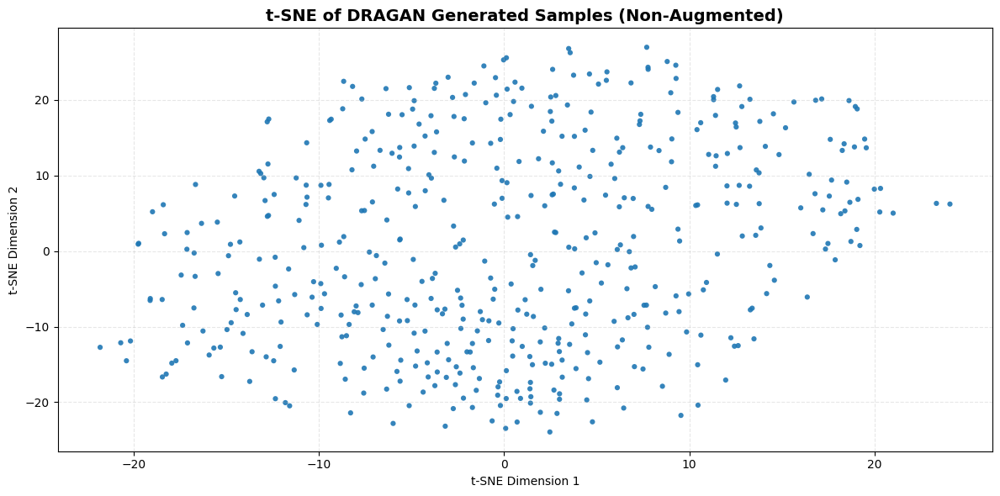

In [ ]:
# ========== Generate New Images from Random Noise ========== #
latent_dim = 100
noise = tf.random.normal([500, latent_dim])
generated_images = generator(noise, training=False)
generated_images = (generated_images + 1) / 2.0

def plot_tsne_embeddings(generated_images, save_path=None, title="t-SNE of DRAGAN Generated Samples (Non-Augmented)"):
    # ----- Convert to [0, 1] Range ----- #
    if tf.reduce_max(generated_images).numpy() > 1.0:
        raise ValueError("Images should be in [-1, 1] range before scaling.")

    images_rescaled = (generated_images + 1.0) / 2.0
    flat_images = images_rescaled.numpy().reshape(images_rescaled.shape[0], -1)

    # ----- Run t-SNE ----- #
    tsne = TSNE(n_components=2, perplexity=30, learning_rate='auto', init='pca', random_state=42)
    tsne_proj = tsne.fit_transform(flat_images)

    # ----- Plot t-SNE ----- #
    plt.figure(figsize=(12, 6))
    sns.scatterplot(
        x=tsne_proj[:, 0],
        y=tsne_proj[:, 1],
        s=20,
        alpha=0.9,
        edgecolor='none'
    )
    plt.title(title, fontsize=14, weight='bold')
    plt.xlabel("t-SNE Dimension 1")
    plt.ylabel("t-SNE Dimension 2")
    plt.grid(True, linestyle='--', alpha=0.3)
    plt.tight_layout()

    if save_path:
        plt.savefig(save_path, dpi=300)
        print(f"t-SNE plot saved to: {save_path}")

    plt.show()

plot_tsne_embeddings(generated_images=generated_images)

With reference to the t-SNE plot of DRAGAN generated samples (Non-Augmented) above, we are able to make the following observations:

**Stable Spread Across Both Axes**

- The points are fairly dispersed in a dense horizontal band, showing a wide latent space coverage.

- Indicates stable discriminator gradients as expected from DRAGAN's gradient penalty mechanism.

**Moderate Uniformity in Distribution**

- Clusters are minimal, and there are no significant empty zones or tight clumping.

- This hints at reasonable diversity in sample generation, without strong mode collapse.

**Less Vertical Variance**

- The vertical spread is slightly more constrained compared to WGAN variants.

- May suggest lower variability in certain abstract feature directions, possibly due to DRAGAN's local gradient constraints.

**Mild Presence of Outliers**

- A few points drift further away from the central cluster, but are not extreme.

- This implies occasional irregular samples, which could be artefacts of the DRAGAN noise regularisation.

With the observations indicated above, we will proceed to train the next GAN Model in the next sub-section.

---
## 4.7 Information Maximising GAN Model Training

In this sub-section, we will be training a Information Maximising GAN (InfoGAN) for the EMNIST Dataset. The InfoGAN is capable of giving us control and interpretability over the Image Generation process. InfoGAN is also able to learn sematically meaningful factors without the need of labels unlike Conditional GANs. The relevant mathematical formulas are indicated below:

---
**Generator Loss:**

Purpose: Produce Outputs Classified as Real.

$$
\mathcal{L}_G = \frac{1}{2} \mathbb{E}_{z \sim p_z}[(D(G(z)) - c)^2]
$$

Where:
- $c = 1$ = Desired Discriminator Output for Generated Images  
- $D(G(z))$ = Discriminator's Output for Generated Data  
- $z \sim p_z$ = Sample from Latent Space

---
**Discriminator Loss:**

Purpose: Discriminator Minimises the Error between Predictions and True Labels.

$$
\mathcal{L}_D = \frac{1}{2} \mathbb{E}_{x \sim p_{\text{data}}}[(D(x) - b)^2] + \frac{1}{2} \mathbb{E}_{z \sim p_z}[(D(G(z)) - a)^2]
$$

Where:  
- $D(x)$ = Discriminator's Output for Real Data  
- $D(G(z))$ = Discriminator's Output for Generated Data  
- $a = 0$ = Label for Fake Data  
- $b = 1$ = Label for Real Data  
- $x \sim p_{\text{data}}$ = Sample from Real Data Distribution  
- $z \sim p_z$ = Sample from Latent Noise Distribution  

---
**Latent Code Regularisation**

Purpose: Encourage Generator to Learn Disentangled, Interpretable Latent Factors by Maximising Mutual Information between Latent Code and Generated Output.

$$
\mathcal{L}_{\text{Info}} = -\lambda \cdot \mathbb{E}_{z \sim p(z), c \sim p(c)} \left[ \log Q(c \mid G(z, c)) \right]
$$

Where:
- $Q(c \mid x)$ = Auxiliary Network Approximates Posterior $P(c \mid x)$
- $G(z, c)$ = Generated Sample
- $\lambda$ = Mutual Information Weight Hyperparameter

---
**Total Objective:**

Purpose: LSGAN Seeks to Solve the Objective.

$$
\min_{G, Q} \max_D \; \mathcal{L}_{\text{InfoGAN}} = \mathcal{L}_{\text{GAN}} + \mathcal{L}_{\text{Info}}
$$

Where:
- $G$ = Generator
- $Q$ = Auxiliary Network
- $D$ = Discriminator

---
**Variational Lower Bound on Mutual Information**

Purpose: True Mutual Information $I(c; G(z, c))$ is Intractable, Maximise a Variational Lower Bound using $Q(c \mid x)$.

$$
I(c; G(z, c)) \geq \mathbb{E}_{z \sim p(z), c \sim p(c)} \left[ \log Q(c \mid G(z, c)) \right] + H(c)
$$
Where:
- $I(c; G(z, c))$ = Mutual Information
- $H(c)$ = Entropy of $c$ (constant if $p(c)$ is fixed)

---
With the relevant mathematical formulas indicated above, we will proceed to train the InfoGAN in this sub-section for the purpose of it's potential for smoother training process and also to serve as a comparison for our other GAN Models.

---
### 4.7.1 Defining Data Pre-Processing Function

In this sub-section, we will be defining the Data Pre-Processing Function which will allow for consistent Data Pipeline to be built and modifed accordingly should the need arise such as when we need to add Spectral Normalisation. This will ensure that the Data's integrity is not affected and we are able to make fair and un-biased assumptions. The Data Pre-Processing Function is defined in the Code Cell below:

In [ ]:
# =========== Data Pre-Processing Function =========== #
def load_data(X_train, batch_size=32):
    buffer_size = X_train.shape[0]

    dataset = tf.data.Dataset.from_tensor_slices(X_train)
    dataset = dataset.shuffle(buffer_size)
    dataset = dataset.batch(batch_size)
    dataset = dataset.prefetch(tf.data.AUTOTUNE)

    return dataset

With reference to the Code Cell above, we are able to determine that the Data Pre-Processing Function have been defined successfully and we are able to move on to Defining Callback Functions in the next sub-section.

---
### 4.7.2 Defining Callback Functions

In this sub-section, we will be pre-defining the various Callbacks. This is to ensure consistency throughout the model and also to increase the GAN Accuracy and optimise the Computation Cost for training each GAN Model. These Callbacks will be main used during the GAN Training in the next sub-section. The revelant mathematical formula for the callbacks and logic are indicated below:

---
**Learning Rate Scheduler:**

Purpose: Reduces Learning Rate During Training to Fine-tune Model Convergence.

$$\text{If } epoch \mod 10 = 0 \Rightarrow \eta_{new} = \frac{1}{2} \cdot \eta$$

Where:

- $\eta$ = current learning rate

- $\eta_{\text{new}}$ = updated learning rate

- $epoch \bmod 10$ checks if the epoch is a multiple of 10

---
**ReduceLROnPlateau:**

Purpose: Automatically Reduces the Learning Rate when Validation Performance Plateaus.

$$
\text{If no improvement in } val\_loss \text{ for 10 epochs: } \eta_{\text{new}} = 0.5 \cdot \eta
$$

Where:

- $\eta_{\text{new}}$ = reduced learning rate

---
**EarlyStopping:**

Purpose: Prevents Wastage of Computational Power if Model Does Not Improve.

$$
\text{If } val\_loss \text{ does not improve for 25 epochs, stop training and restore best weights}
$$

---

We will proceed to Define the Callbacks in the Code Cell below in preparation for the GAN Model Training.

In [ ]:
# =========== Define Learning Rate Scheduler =========== #
lr_scheduler = LearningRateScheduler(
    lambda epoch, lr: lr * 0.95 if epoch % 10 == 0 else lr,
    verbose=1
)

# =========== Define Reduce LR on Plateau =========== #
reduce_lr = ReduceLROnPlateau(
    monitor='loss',
    factor=0.5,
    patience=10,
    verbose=1,
    min_lr=1e-6
)

# =========== Define Early Stopping =========== #
early_stop = EarlyStopping(
    monitor='loss',
    patience=25,
    verbose=1,
    restore_best_weights=False
)

# =========== Define Display Generated Images =========== #
def display_generated_images(generator, latent_dim, code_dim=2, n=7):
    total = n * n
    z = tf.random.normal([total, latent_dim])
    c = tf.random.uniform([total, code_dim], minval=-1.0, maxval=1.0)

    # ----- Normalise Both z and c ----- #
    z = tf.math.l2_normalize(z, axis=1)
    c = tf.math.l2_normalize(c, axis=1)

    zc = tf.concat([z, c], axis=1)
    generated_images = generator(zc, training=False)
    generated_images = (generated_images + 1.0) / 2.0

    fig, axes = plt.subplots(n, n, figsize=(n, n))
    for i in range(n):
        for j in range(n):
            img = generated_images[i * n + j, :, :, 0]
            axes[i, j].imshow(img, cmap='gray')
            axes[i, j].axis('off')

    plt.tight_layout()
    plt.show()

# =========== Define FID Calculator =========== #
def calculate_fid(real_images, fake_images, batch_size=10):

    # 1) Scale to [0,255] and resize to 299×299
    real = (real_images + 1.0) * 127.5
    fake = (fake_images + 1.0) * 127.5
    real = tf.image.resize(real, (299,299))
    fake = tf.image.resize(fake, (299,299))

    # ----- If Grayscale, Convert to RGB ----- #
    if real.shape[-1] == 1:
        real = tf.image.grayscale_to_rgb(real)
        fake = tf.image.grayscale_to_rgb(fake)

    # ----- Preprocess for Inception (–1 to +1) ----- #
    real_pp = preprocess_input(real)
    fake_pp = preprocess_input(fake)

    # ----- Extract Features in Batches ----- #
    def _get_acts(x):
        acts = []
        n = x.shape[0]
        for i in range(0, n, batch_size):
            chunk = x[i:i+batch_size]
            acts.append(_inception_model(chunk, training=False).numpy())
        return np.vstack(acts)

    act_real = _get_acts(real_pp)
    act_fake = _get_acts(fake_pp)

    # ----- Compute Statistics ----- #
    mu1, sigma1 = act_real.mean(axis=0), np.cov(act_real, rowvar=False)
    mu2, sigma2 = act_fake.mean(axis=0), np.cov(act_fake, rowvar=False)
    diff    = mu1 - mu2
    covmean = sqrtm(sigma1.dot(sigma2))
    if np.iscomplexobj(covmean):
        covmean = covmean.real
    fid = diff.dot(diff) + np.trace(sigma1 + sigma2 - 2*covmean)
    return float(np.round(fid,4))

# =========== Confirmation Message =========== #
print("InfoGAN Callbacks and Visualisation Setup Complete")

InfoGAN Callbacks and Visualisation Setup Complete


With reference to the Code Cell above, we are able to verify that that the Callbacks have been successfully defined and the various parameters are set so as to ensure a High Accuracy and Computing Efficient GAN Model Training.

---
### 4.7.3 Defining InfoGAN Generator Architecture

In this section, we will be defining the InfoGAN's Generator Architecture. The Generator will be trying to make realistic generated images in the attempt to bypass the Discriminator. Subsequently, the generated images from the Generator will be evaluated based on a few evaluation metrics such as Inception Score. The relevent mathematical formulas for the Loss Function of the Vanilla GAN Generator is indicated below:

---
**Generator Loss:**

Purpose: Produce Outputs Classified as Real.

$$
\mathcal{L}_G = \frac{1}{2} \mathbb{E}_{z \sim p_z}[(D(G(z)) - c)^2]
$$

Where:
- $c = 1$ = Desired Discriminator Output for Generated Images  
- $D(G(z))$ = Discriminator's Output for Generated Data  
- $z \sim p_z$ = Sample from Latent Space

---
With the relevant Generator Loss Formula indicated above, we will proceed to define the GAN Generator's Architecture in the Code Cell below and the Lost Function.

In [ ]:
# =========== Generator Function =========== #
def build_generator(latent_dim=100, code_dim=2, use_dropout=True):
    input_dim = latent_dim + code_dim
    model = tf.keras.Sequential(name="generator")

    # ----- Project and Reshape ----- #
    model.add(tf.keras.layers.Dense(7 * 7 * 256, use_bias=False, input_shape=(input_dim,)))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.ReLU())
    model.add(tf.keras.layers.Reshape((7, 7, 256)))

    # ----- Upsample 1 ----- #
    model.add(tf.keras.layers.Conv2DTranspose(128, kernel_size=5, strides=1, padding='same', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.ReLU())
    if use_dropout:
        model.add(tf.keras.layers.Dropout(0.3))

    # ----- Upsample 2 ----- #
    model.add(tf.keras.layers.Conv2DTranspose(64, kernel_size=5, strides=2, padding='same', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.ReLU())
    if use_dropout:
        model.add(tf.keras.layers.Dropout(0.3))

    # ----- Final Output to 28x28x1 ----- #
    model.add(tf.keras.layers.Conv2DTranspose(1, kernel_size=5, strides=2, padding='same', activation='tanh'))

    return model

# =========== Generator Loss =========== #
bce = tf.keras.losses.BinaryCrossentropy(from_logits=True)

def generator_loss(fake_output):
    return bce(tf.ones_like(fake_output), fake_output)

With reference to the Code Cell above, we are able to verify that the GAN's Generator Architecture have been successfully defined and we are able to proceed to define the GAN's Discriminator Architecture.

---
### 4.7.4 Defining InfoGAN Discriminator Architecture

In this section, we will be defining the Architecture of the Discriminator of the GAN. The Discriminator will be the Neural Network that will attempt to tell the Generated Images apart from the Actual Images. This will allow the GAN to improve overtime and also improve itself overtime. The mathematical function for the Discriminator Loss Function is indicated below:

---
**Discriminator Loss:**

Purpose: Discriminator Minimises the Error between Predictions and True Labels.

$$
\mathcal{L}_D = \frac{1}{2} \mathbb{E}_{x \sim p_{\text{data}}}[(D(x) - b)^2] + \frac{1}{2} \mathbb{E}_{z \sim p_z}[(D(G(z)) - a)^2]
$$

Where:  
- $D(x)$ = Discriminator's Output for Real Data  
- $D(G(z))$ = Discriminator's Output for Generated Data  
- $a = 0$ = Label for Fake Data  
- $b = 1$ = Label for Real Data  
- $x \sim p_{\text{data}}$ = Sample from Real Data Distribution  
- $z \sim p_z$ = Sample from Latent Noise Distribution  
---

With the mathematical formula for the Loss Function indicated above, we will proceed to define the GAN's Discriminator Architecture and the Loss Function in the Code Cell below.

In [ ]:
# =========== Discriminator Function =========== #
def build_discriminator(input_shape=(28, 28, 1), code_dim=2):
    image_input = tf.keras.Input(shape=input_shape)

    # ----- Shared Convolutional Layers ----- #
    x = tf.keras.layers.Conv2D(64, kernel_size=5, strides=2, padding='same')(image_input)
    x = tf.keras.layers.LeakyReLU(0.2)(x)
    x = tf.keras.layers.Dropout(0.3)(x)

    x = tf.keras.layers.Conv2D(128, kernel_size=5, strides=2, padding='same')(x)
    x = tf.keras.layers.LeakyReLU(0.2)(x)
    x = tf.keras.layers.Dropout(0.3)(x)

    x = tf.keras.layers.Flatten()(x)

    # ----- Output 1: Real/Fake (Adversarial) ----- #
    real_fake_output = tf.keras.layers.Dense(1, name="real_fake")(x)

    # ----- Output 2: Q-network for Predicting Latent Code ----- #
    code_output = tf.keras.layers.Dense(code_dim, name="code")(x)

    return tf.keras.Model(inputs=image_input, outputs=[real_fake_output, code_output], name="discriminator_with_Q")

# =========== Discriminator Loss =========== #
bce = tf.keras.losses.BinaryCrossentropy(from_logits=True)

def discriminator_loss(real_output, fake_output):
    real_labels = tf.ones_like(real_output)
    fake_labels = tf.zeros_like(fake_output)

    real_loss = bce(real_labels, real_output)
    fake_loss = bce(fake_labels, fake_output)

    return real_loss + fake_loss

With reference to the Code Cell above, we are able to verify that the GAN's Discriminator Architecture have been successfully defined and we are able to proceed to define the GAN's Training Steps.

---
### 4.7.5 Defining Training Step

In this section, we will be Defining the Training Step function so as to train both the Generator and the Discriminator at the same time. The Training Step will compute the gradients for both the Generator and the Discriminator at the same time. The relevant mathematical formulas for the Training Step is indicated below:

---
**Generator Loss:**

Purpose: Produce Outputs Classified as Real.

$$
\mathcal{L}_G = \frac{1}{2} \mathbb{E}_{z \sim p_z}[(D(G(z)) - c)^2]
$$

Where:
- $c = 1$ = Desired Discriminator Output for Generated Images  
- $D(G(z))$ = Discriminator's Output for Generated Data  
- $z \sim p_z$ = Sample from Latent Space

---
**Discriminator Loss:**

Purpose: Discriminator Minimises the Error between Predictions and True Labels.

$$
\mathcal{L}_D = \frac{1}{2} \mathbb{E}_{x \sim p_{\text{data}}}[(D(x) - b)^2] + \frac{1}{2} \mathbb{E}_{z \sim p_z}[(D(G(z)) - a)^2]
$$

Where:  
- $D(x)$ = Discriminator's Output for Real Data  
- $D(G(z))$ = Discriminator's Output for Generated Data  
- $a = 0$ = Label for Fake Data  
- $b = 1$ = Label for Real Data  
- $x \sim p_{\text{data}}$ = Sample from Real Data Distribution  
- $z \sim p_z$ = Sample from Latent Noise Distribution  

---
**Total Objective:**

Purpose: LSGAN Seeks to Solve the Objective.

$$
\min_G \max_D \; \mathcal{L}_D \quad \text{and} \quad \min_G \; \mathcal{L}_G
$$

---

With the relevant mathematical formulas indicated above, we will proceed to define the Training Step in the Code Cell below.

In [ ]:
# =========== Training Step Function =========== #
@tf.function
def train_step(real_images, generator, discriminator, gen_optimizer, disc_optimizer, latent_dim, code_dim=2, lambda_mi=1.0):
    batch_size = tf.shape(real_images)[0]

    # ----- Sample & Normalisation ----- #
    z = tf.random.normal([batch_size, latent_dim])
    c = tf.random.uniform([batch_size, code_dim], -1.0, 1.0)
    z = tf.math.l2_normalize(z, axis=1)
    c = tf.math.l2_normalize(c, axis=1)
    zc = tf.concat([z, c], axis=1)

    # ----- Instance Noise on Real Images ----- #
    real_noisy = real_images + tf.random.normal(tf.shape(real_images)) * 0.05

    with tf.GradientTape(persistent=True) as tape:
        # ----- Generate Fake Images ----- #
        fake_images = generator(zc, training=True)

        # ----- Discriminator and Q-network ----- #
        real_logits, _ = discriminator(real_noisy,  training=True)
        fake_logits, predicted_c = discriminator(fake_images, training=True)

        # ----- Adversarial Losses with Label Smoothing ----- #
        real_labels = tf.ones_like(real_logits) * 0.9
        fake_labels = tf.zeros_like(fake_logits)
        d_real_loss = bce(real_labels, real_logits)
        d_fake_loss = bce(fake_labels,  fake_logits)
        disc_loss   = d_real_loss + d_fake_loss

        # ----- Generator Adversarial Loss ----- #
        adv_loss = bce(tf.ones_like(fake_logits), fake_logits)

        # ----- Mutual-Information Loss (MSE) ----- #
        mi_loss  = tf.reduce_mean(tf.square(predicted_c - c))

        # ----- Total Generator and Q Loss ----- #
        gen_loss = adv_loss + lambda_mi * mi_loss

    # ----- Update Discriminator ----- #
    code_vars  = [v for v in discriminator.trainable_variables if 'code/' in v.name]
    adv_vars   = [v for v in discriminator.trainable_variables if v not in code_vars]
    disc_grads = tape.gradient(disc_loss, adv_vars)
    disc_optimizer.apply_gradients(zip(disc_grads, adv_vars))

    # ----- Update Generator and Q-network ----- #
    gq_vars  = generator.trainable_variables + code_vars
    gq_grads = tape.gradient(gen_loss, gq_vars)
    gen_optimizer.apply_gradients(zip(gq_grads, gq_vars))

    del tape
    return gen_loss, disc_loss, adv_loss, mi_loss

With reference to the Code Cell above, we are able to determine that the Training Step have been successfully defined and we are able to proceed to prepare the Training Loop in the next section.

---
### 4.7.6 Defining Training Loop

In this section, we will be defining the Training Loop for the GAN Training. The Training Loop will go through each of the Epoch and train both the Generator and Discriminator simultaneously. The Training Loop will also track the Loss for both the Generator and the Discriminator for each of the Epoch trained. The relevant mathematical formulas are indicated below:

---
**Epoch Loss Averaging:**

Purpose: These are the Average Generator and Discriminator Losses over all Batches in Epoch $t$.

$$
\bar{L}_G^{(t)} = \frac{1}{N} \sum_{i=1}^{N} L_G^{(i)} \\
\bar{L}_D^{(t)} = \frac{1}{N} \sum_{i=1}^{N} L_D^{(i)}
$$

Where:
- $\bar{L}_G^{(t)}$ = Average Generator Loss at Epoch $t$  
- $\bar{L}_D^{(t)}$ = Average Discriminator Loss at Epoch $t$  
- $N$ = Number of Batches in the Dataset  
- $L_G^{(i)}$ = Generator Loss on Batch $i$  
- $L_D^{(i)}$ = Discriminator Loss on Batch $i$

---
**Epoch Iteration:**

Purpose: Describes the Training Loop Logic: for Each Epoch $t$, perform `train_step` for Every Mini-batch.

$$
\text{for } t = 1 \text{ to } T:
\quad \text{for each batch } (x^{(i)}):
\quad \text{train_step}(x^{(i)})
$$

Where:
- $T$: Total Number of Epochs  
- $x^{(i)}$: Real Batch $i$ from the Dataset  
- `train_step`: Function that Updates $G$ and $D$ using that Batch

---
**Generated Image Output:**

Purpose: Sample Random Noise $z$ and Generate Synthetic Image $\hat{x}$ from the Generator. This is used for Visual Monitoring of Model Quality.

$$
z \sim p_z(z) \\
\hat{x} = G(z)
$$

Where:
- $z$: Random Latent Vector  
- $G(z)$: Generated Image from Generator

---
With the mathematical formulas indicated above, we will proceed to define the Training Loop in the Code Cell below in preparation of the GAN Training.

In [ ]:
# =========== Training Loop Function =========== #
def train(dataset, epochs, generator, discriminator, gen_optimizer, disc_optimizer, latent_dim, code_dim=2, lambda_mi=1.0, save_path=None, use_early_stopping=True, steps_per_epoch=None):
    # ----- Prepare FID Reference Set from Validation Data X_val ----- #
    real_val = tf.data.Dataset.from_tensor_slices(X_val).batch(50).take(1)

    # ----- Latent Noise and Code for InfoGAN FID Evaluation ----- #
    noise_val = tf.random.normal([50, latent_dim])
    noise_val = tf.math.l2_normalize(noise_val, axis=1)
    code_val = tf.random.uniform([50, code_dim], minval=-1.0, maxval=1.0)
    code_val = tf.math.l2_normalize(code_val, axis=1)
    zc_val = tf.concat([noise_val, code_val], axis=1)

    # ----- FID Early-Stopping Parameters for InfoGAN ----- #
    best_fid = float('inf')
    no_improve = 0
    patience = 10
    fid_interval = 1

    # ----- Dummy Model ----- #
    dummy_input  = tf.keras.Input(shape=(1,))
    dummy_output = tf.keras.layers.Lambda(lambda x: x)(dummy_input)
    dummy_model  = tf.keras.Model(dummy_input, dummy_output)
    dummy_model.compile(optimizer=tf.keras.optimizers.Adam(1e-4), loss='mse')

    early_stop.set_model(dummy_model)
    reduce_lr.set_model(dummy_model)
    lr_scheduler.set_model(dummy_model)
    early_stop.on_train_begin({})
    reduce_lr.on_train_begin({})
    lr_scheduler.on_train_begin({})

    # ----- Track Loss History ----- #
    gen_loss_history  = []
    disc_loss_history = []
    mi_loss_history   = []

    for epoch in range(1, epochs + 1):
        print(f"\nEpoch {epoch}/{epochs}")
        gen_losses, disc_losses, mi_losses = [], [], []

        # ----- Per-Batch Training ----- #
        for i, real_images in enumerate(dataset):
            if steps_per_epoch and i >= steps_per_epoch:
                break

            # ----- InfoGAN Train Step ----- #
            gen_loss, disc_loss, adv_loss, mi_loss = train_step(
                real_images,
                generator,
                discriminator,
                gen_optimizer,
                disc_optimizer,
                latent_dim,
                code_dim=code_dim,
                lambda_mi=lambda_mi
            )

            gen_losses.append(gen_loss)
            disc_losses.append(disc_loss)
            mi_losses.append(mi_loss)

        # ----- Compute Average Losses Epoch ----- #
        avg_gen_loss  = tf.reduce_mean(gen_losses)
        avg_disc_loss = tf.reduce_mean(disc_losses)
        avg_mi_loss   = tf.reduce_mean(mi_losses)
        print(f"Gen Loss: {avg_gen_loss:.4f} | "
              f"Disc Loss: {avg_disc_loss:.4f} | "
              f"MI Loss: {avg_mi_loss:.4f}")

        # ----- Save to History ----- #
        gen_loss_history.append(float(avg_gen_loss))
        disc_loss_history.append(float(avg_disc_loss))
        mi_loss_history.append(float(avg_mi_loss))

        # ----- Callback Updates ----- #
        logs = {'loss': float(avg_gen_loss)}
        if use_early_stopping:
            early_stop.on_epoch_end(epoch=epoch, logs=logs)
            if early_stop.stopped_epoch > 0:
                print(f"Early stopping triggered at epoch {epoch}")
                break
        reduce_lr.on_epoch_end(epoch=epoch, logs=logs)
        lr_scheduler.on_epoch_end(epoch=epoch, logs=logs)

        # ----- FID Evaluation & Early Stopping ----- #
        if epoch % fid_interval == 0:
            fake_val = generator(zc_val, training=False)
            real_batch = next(iter(real_val))
            real_for_fid = tf.image.resize(real_batch, [299, 299]) * 0.5 + 0.5
            fake_for_fid = tf.image.resize(fake_val,    [299, 299]) * 0.5 + 0.5
            fid_value = calculate_fid(real_for_fid, fake_for_fid)

            print(f"Epoch {epoch} → Val FID: {fid_value:.2f}")

            # ----- Early-stop Logic on FID ----- #
            if fid_value < best_fid:
                best_fid   = fid_value
                no_improve = 0
                if save_path:
                    os.makedirs(save_path, exist_ok=True)
                    generator.save_weights(os.path.join(save_path, "best_gen.weights.h5"))
                    discriminator.save_weights(os.path.join(save_path, "best_disc.weights.h5"))
            else:
                no_improve += 1

            if no_improve >= patience:
                print(f"No FID improvement for {patience} epochs, stopping.")
                break

        # ----- Display Images Every 5 Epochs ----- #
        if epoch % 5 == 0:
            display_generated_images(generator, latent_dim)

    # ----- Restore Best Weights After Training ----- #
    if save_path:
        best_gen_path = os.path.join(save_path, "best_gen.weights.h5")
        best_disc_path = os.path.join(save_path, "best_disc.weights.h5")
        if os.path.exists(best_gen_path) and os.path.exists(best_disc_path):
            generator.load_weights(best_gen_path)
            discriminator.load_weights(best_disc_path)
            print("Restored best generator and discriminator weights based on lowest FID.")
        else:
            print("Best weight files not found. Skipping restore.")

    return avg_gen_loss, gen_loss_history, disc_loss_history, mi_loss_history

With reference to the Code Cell above, we are able to determine that the Training Loop have been successfully defined and we are able to proceed to define the Optimisers with Tunable Parameter in preparation for the Optuna Tuning.

---
### 4.7.7 Defining Optimisers with Tunable Parameters

In this section, we will be defining the Common Optimisers that will be Tuned using the Optuna Tuning. The Optimisers will each have a range of values in a list so as to allow for the Optuna to search for the best Hyperparameter for the GAN. Through these parameters, it will affect how effective and efficiently the GAN will learn from the provided EMNIST Data. The relevent mathematical formula is indicated below:

---
**Optimiser Update Rule**

Purpose: Parameter Update Step in the Adam Optimiser, using Adaptive Learning Rates with Momentum.

$$
\theta \leftarrow \theta - \eta \cdot \frac{m_t}{\sqrt{v_t} + \epsilon}
$$

Where:
- $\theta$ = Model Parameters (Generator or Discriminator)
- $\eta$ = Learning Rate (Tuned)
- $m_t$ = First Moment Estimate (Mean of Gradients)
- $v_t$ = Second Moment Estimate (Variance of Gradients)
- $\epsilon$ = Small Constant for Numerical Stability

---
With the mathematical formula indicated above, we will proceed to define the Optimisers in the Code Cell.

In [ ]:
def objective(trial):
    # ----- Hyperparameters ----- #
    latent_dim = trial.suggest_categorical('latent_dim', [100, 128, 160])
    learning_rate = trial.suggest_float('learning_rate', 5e-5, 2e-4, log=True)
    beta_1 = trial.suggest_float('beta_1', 0.4, 0.6)
    code_dim = 2
    lambda_mi = 1.0

    # ----- Build Models ----- #
    generator = build_generator(latent_dim=latent_dim, code_dim=code_dim)
    discriminator = build_discriminator(code_dim=code_dim)

    # ----- Trigger Weight Creation ----- #
    z = tf.random.uniform([1, latent_dim], -1.0, 1.0)
    c = tf.random.uniform([1, code_dim], -1.0, 1.0)
    zc = tf.concat([z, c], axis=1)
    _ = generator(zc)
    _ = discriminator(tf.random.normal([1, 28, 28, 1]))

    # ----- Define Optimizers ----- #
    gen_optimizer = tf.keras.optimizers.Adam(learning_rate=learning_rate, beta_1=beta_1)
    disc_optimizer = tf.keras.optimizers.Adam(learning_rate=learning_rate, beta_1=beta_1)

    # ----- Prebuild Optimizers ----- #
    _ = gen_optimizer.apply_gradients([(tf.zeros_like(v), v) for v in generator.trainable_variables])
    _ = disc_optimizer.apply_gradients([(tf.zeros_like(v), v) for v in discriminator.trainable_variables])

    # ----- Load Data ----- #
    dataset = load_data(X_train, batch_size=64)
    steps = min(1000, len(X_train) // 64)

    # ----- Train InfoGAN ----- #
    _ = train(
        dataset=dataset,
        epochs=100,
        generator=generator,
        discriminator=discriminator,
        gen_optimizer=gen_optimizer,
        disc_optimizer=disc_optimizer,
        latent_dim=latent_dim,
        code_dim=code_dim,
        lambda_mi=lambda_mi,
        steps_per_epoch=steps,
        use_early_stopping=False,
        save_path=None
    )

    # ----- Evaluate FID Score ----- #
    noise = tf.random.uniform([1000, latent_dim], minval=-1.0, maxval=1.0)
    code = tf.random.uniform([1000, code_dim], minval=-1.0, maxval=1.0)
    latent = tf.concat([noise, code], axis=1)
    fake_images = generator(latent, training=False)
    fake_images = (fake_images + 1.0) / 2.0
    real_images = X_val[:1000]
    fid_score = calculate_fid(real_images, fake_images)

    return fid_score

With reference to the Code Cell above, we are able to determine that the Optimiser have been successfully defined with a range of different Parameter Values so as to provide a robust Optuna Tuning in the subsequent sections.

---
### 4.7.8 Optuna Tuning Study

In this sub-section, we will be conducting the Optuna Tuning Study on the GAN Model so as to obtain the best Hyperparameter for the GAN Model. It is expected that the Tuning takes a prolonged duration due to the nature of how the GAN works and the 2 Neural Networks involved. However, the training data will be stored so as to prevent re-running of repetitive codes. The Optuna Tuning Study will be conducted in the Code Cell below.

In [ ]:
# ========== Create or Load Study with SQLite Backend ========== #
study = optuna.create_study(
    direction="minimize",
    study_name="infogan_tuning",
    storage="sqlite:////content/drive/MyDrive/Colab Notebooks/DELE CA2 A/Non-Augmented GAN Tunings/infogan_optuna.db",
    load_if_exists=True
)

# ========== Trial Management ========== #
MAX_TRIALS = 50
completed_trials = len([t for t in study.trials if t.state == optuna.trial.TrialState.COMPLETE])
remaining_trials = MAX_TRIALS - completed_trials

if remaining_trials > 0:
    print(f"Resuming InfoGAN study: {completed_trials} completed, running {remaining_trials} more.")
    study.optimize(objective, n_trials=remaining_trials)
else:
    print(f"InfoGAN study already completed {MAX_TRIALS} trials. Skipping optimization.")

# ========== Output Best Trial ========== #
best_trial = study.best_trial
best_params_df = pd.DataFrame([best_trial.params])
best_params_df["Final FID"] = best_trial.value
best_params_df.style.background_gradient(cmap="Blues")

[I 2025-08-10 11:08:35,402] Using an existing study with name 'infogan_tuning' instead of creating a new one.


InfoGAN study already completed 50 trials. Skipping optimization.


,latent_dim,learning_rate,beta_1,Final FID
0,100,0.000128,0.512268,142.852500


With reference to the Code Cell above, we are able to view the Best Hyperparameter obtained during the Optuna Tuning Study. This Hyperparameter will be extracted and be trained for a longer period of time so as to attempt to increase the performance and limit the loss for the GAN.

---
### 4.7.9 GAN Re-Training Operation

As obtained from the previous sub-section, we will be re-training the GAN using the best Hyperparameter obtained during the Optuna Tuning Study. This is to push the GAN Model to its limits and also to save Computational Power as we are not taking up prolonged periods of time tuning GAN Models which may not have any clear signs of good performance. The retraining of the GAN Model will be conducted in the Code Cell below.

In [ ]:
# =========== Extract Best Parameters from Study =========== #
best_params = study.best_trial.params

latent_dim = best_params['latent_dim']
learning_rate = best_params['learning_rate']
beta_1 = best_params['beta_1']
code_dim = 2
lambda_mi = 1.0

print("Using Best Trial Parameters for InfoGAN:")
print(best_params)

# =========== Rebuild InfoGAN Models =========== #
generator     = build_generator(latent_dim=latent_dim, code_dim=code_dim)
discriminator = build_discriminator(code_dim=code_dim)

# =========== Initialise Optimisers =========== #
gen_optimizer  = tf.keras.optimizers.Adam(learning_rate=learning_rate, beta_1=beta_1)
disc_optimizer = tf.keras.optimizers.Adam(learning_rate=learning_rate, beta_1=beta_1)

_ = gen_optimizer.apply_gradients([(tf.zeros_like(v), v) for v in generator.trainable_variables])
_ = disc_optimizer.apply_gradients([(tf.zeros_like(v), v) for v in discriminator.trainable_variables])

# =========== Reload Preprocessed Dataset =========== #
dataset = load_data(X_train)

# =========== Define Save Paths =========== #
model_name   = "infogan"
output_dir   = f"/content/drive/MyDrive/Colab Notebooks/DELE CA2 A/final_outputs_{model_name}_noAugment"
weights_path = os.path.join(output_dir, f"{model_name}_generator_final.weights.h5")
gen_ckpt     = os.path.join(output_dir, "best_gen.weights.h5")
disc_ckpt    = os.path.join(output_dir, "best_disc.weights.h5")
loss_csv     = os.path.join(output_dir, "loss_history.csv")

os.makedirs(output_dir, exist_ok=True)

# =========== Load or Train =========== #
if os.path.exists(gen_ckpt) and os.path.exists(disc_ckpt) and os.path.exists(loss_csv):
    print("All outputs found. Skipping training...")

    generator.load_weights(gen_ckpt)
    discriminator.load_weights(disc_ckpt)
    print("Generator and Discriminator Weights Loaded.")

    loss_df = pd.read_csv(loss_csv)
    gen_loss_history  = loss_df['gen_loss'].tolist()
    disc_loss_history = loss_df['disc_loss'].tolist()
    mi_loss_history   = loss_df['mi_loss'].tolist()
    final_gen_loss    = gen_loss_history[-1]

else:
    # =========== Train InfoGAN =========== #
    final_gen_loss, gen_loss_history, disc_loss_history, mi_loss_history = train(
        dataset=dataset,
        epochs=50,
        steps_per_epoch=1546,
        generator=generator,
        discriminator=discriminator,
        gen_optimizer=gen_optimizer,
        disc_optimizer=disc_optimizer,
        latent_dim=latent_dim,
        code_dim=code_dim,
        lambda_mi=lambda_mi,
        use_early_stopping=False,
        save_path=output_dir
    )

    # =========== Save Final Generator Weights =========== #
    generator.save_weights(weights_path)
    print("Generator Weights Saved.")

    # =========== Save Loss History =========== #
    loss_df = pd.DataFrame({
        'epoch': list(range(1, len(gen_loss_history) + 1)),
        'gen_loss': gen_loss_history,
        'disc_loss': disc_loss_history,
        'mi_loss': mi_loss_history
    })
    loss_df.to_csv(loss_csv, index=False)
    print(f"Loss history saved to {loss_csv}")

Using Best Trial Parameters for InfoGAN:
{'latent_dim': 100, 'learning_rate': 0.00012809029128570555, 'beta_1': 0.5122682547493}


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:93: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


All outputs found. Skipping training...
Generator and Discriminator Weights Loaded.


With reference to the Code Cell above, we are able to determine that the best GAN Model have been trained and saved successfully and we are able to proceed with the Model Evaluation in the next sub-sections where we determine how well the GAN Model performed based on various metrics and evaluation methodologies.

---
### 4.7.10 GAN Model Evaluation

In this sub-section, we will be evaluating the GAN's Generator performance on various aspects. We will be utilising different methodologies and metrics to attempt to quantify the performance of the GAN Generator while also conducting Visual Inspection on the result output of the GAN. The Evaluation will be conducted in the following sections.

---
#### 4.7.10.1 Visual Grid of Samples

In this sub-section, we will be visualising the Grid of Samples of the Synthesised Data generated by the GAN Model. A list of observations will be made before the utilisation of Quantitative Metrics to evaluate the GAN Generator's general performance. As the observations made are purely from professional opinion, it will most likely not be used as a Basis of Comparison between GAN Models due to differing opinions unless in extreme cases. The visualisation will be conducted in the Code Cell below.

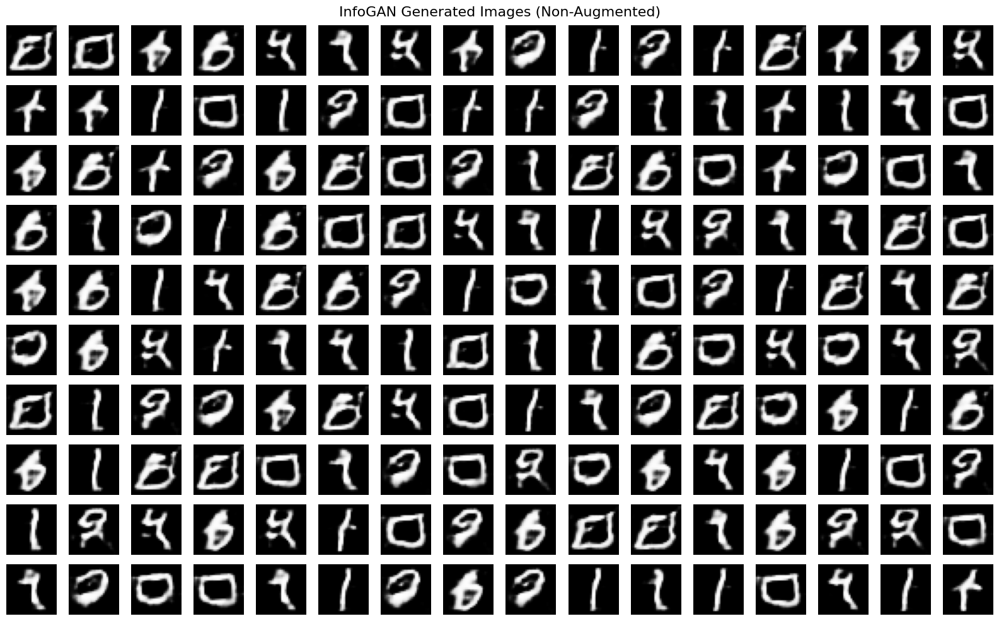

In [ ]:
def plot_generated_images(generator, latent_dim, code_dim=2, n_rows=5, n_cols=5, save_path=None, title="InfoGAN Generated Images (Non-Augmented)", seed=42):
    total_samples = n_rows * n_cols

    # ----- Generate Latent Vectors ----- #
    if seed is not None:
        tf.random.set_seed(seed)

    z = tf.random.normal([total_samples, latent_dim])
    c = tf.random.uniform([total_samples, code_dim], minval=-1.0, maxval=1.0)

    z = tf.math.l2_normalize(z, axis=1)
    c = tf.math.l2_normalize(c, axis=1)
    zc = tf.concat([z, c], axis=1)

    # ----- Generate Images ----- #
    gen_images = generator(zc, training=False)
    gen_images = (gen_images + 1.0) / 2.0
    gen_images = tf.clip_by_value(gen_images, 0.0, 1.0)

    # ----- Plot ----- #
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols, n_rows))
    for idx, ax in enumerate(axes.flat):
        ax.imshow(gen_images[idx, :, :, 0], cmap='gray')
        ax.axis('off')

    plt.suptitle(title, fontsize=16)
    plt.tight_layout()

    if save_path:
        plt.savefig(save_path, dpi=300)
        print(f"Saved Generated Image Grid to: {save_path}")

    plt.show()

plot_generated_images(generator, latent_dim=100, code_dim=2, n_rows=10, n_cols=16)

With reference to the output of the Visual Grid of Samples above, we are able to make the following observations:

**Basic Structure of Letters is Somewhat Captured**

- Several characters resemble structured forms of "T", "I", or "O".

- The generated samples are generally well-aligned, and stroke quality is consistent.

**High Blur and Noise**

- Minor fuzziness is present in a few samples, but overall sharpness is maintained.

- Backgrounds remain clean with minimal artefacts or pixel noise.

**Poor Character Consistency**

- Many characters converge toward a narrow set of shapes as the majority look like "6" or "I".

- Variation in angles or structural patterns is minimal, making some letters ambiguous.

**Lack of Diversity**

- There is an overrepresentation of circular and stick-like characters.

- Several samples appear almost identical, indicating early signs of mode collapse.

With the observations indicated above, we will proceed to conduct the Loss Curve Analysis in the next sub-section.

---
#### 4.7.10.2 Loss Curve Over Epochs

In this sub-section, we will be plotting the GAN Loss Curve over Epochs to evaluate the training behaviour of the GAN. This curve provides insight into whether the GAN is experiencing underfitting, overfitting, or achieving a stable training dynamic between the generator and discriminator.

Although GANs do not minimise a single unified loss in the traditional sense, the trajectory of the generator and discriminator losses can indicate whether the adversarial training process is converging appropriately.

If the generator loss remains high while discriminator loss quickly drops to near-zero, this may indicate **underfitting**, where the generator is not learning effectively to produce plausible images.

If the discriminator loss increases while generator loss sharply decreases, this may suggest **overfitting** or **mode collapse**, where the generator exploits narrow weaknesses in the discriminator without general improvement.

A relatively stable oscillation or convergence between both losses typically signifies a **well-balanced** training process, where the generator and discriminator are learning in tandem.

The Potential Observations and Corresponding Action Plans are outlined below:

**Underfitting Loss Curve**

- Increase training epochs to allow generator more time to learn.

- Simplify the discriminator to reduce overpowering the generator.

- Adjust the learning rate or apply label smoothing.

- Consider adding batch normalisation in the generator.

**Overfitting or Mode Collapse Loss Curve**

- Introduce or increase dropout in the discriminator.

- Apply input noise or label flipping to the discriminator.

- Evaluate diversity of generated samples regularly.

**Balanced/Ideal Loss Curve**

- Maintain current architecture and hyperparameters.

- Proceed with full-scale image generation.

- Evaluate both qualitative (visual inspection) and quantitative metrics (e.g. Inception Score or FID).

With these potential training behaviours and action plan outlined, we will proceed to visualise the GAN loss dynamics in the code cell below.

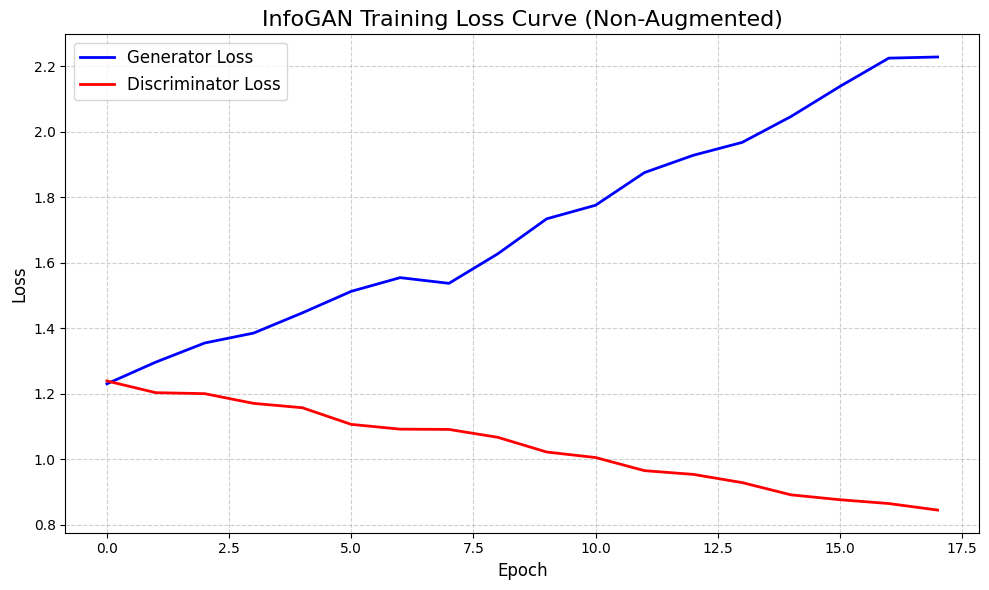

In [ ]:
# =========== Figure Size Configuration =========== #
plt.figure(figsize=(10, 6))

# =========== Plot Training Losses =========== #
plt.plot(gen_loss_history, label="Generator Loss", linewidth=2, color='blue')
plt.plot(disc_loss_history, label="Discriminator Loss", linewidth=2, color='red')

# =========== Labels and Title =========== #
plt.xlabel("Epoch", fontsize=12)
plt.ylabel("Loss", fontsize=12)
plt.title("InfoGAN Training Loss Curve (Non-Augmented)", fontsize=16)

# =========== Grid, Legend, and Styling =========== #
plt.grid(True, linestyle='--', alpha=0.6)
plt.legend(fontsize=12)
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)

# =========== Display the Plot =========== #
plt.tight_layout()
plt.show()

With reference to the output of the Loss Curve above, we are able to make the following observations:

- InfoGAN training appears unstable.

- Generator is losing ground to discriminator across epochs.

- Possible reason include Insufficient Learning Rate and Poor Hyperparameter Tuning.

With the observations indicated above, we will proceed to conduct the Quantitative Metrics Evaluation in the next sub-section.

---
#### 4.7.10.3 Quantitative Metrics Evaluation

In this sub-section we will be utilising Quantitative Metrics such as FID and KID to tabulate the results of the performance and quantify the performance of the GAN Generator. We will subsequently be use these metrics to conduct inter-model evaluation after tuning and training all the GANs. The metrics that we will be utilising and their respective formulas are indicated below:

---
**Fréchet Inception Distance**

Purpose: Measures the Distance between the Real-Image and Generated-Image Distributions in Inception Feature Space.

$$
\mathrm{FID} \;=\;\|\mu_r - \mu_f\|^2
\;+\;\mathrm{Tr}\Bigl(\Sigma_r + \Sigma_f - 2\,(\Sigma_r\,\Sigma_f)^{\tfrac12}\Bigr)
$$


Where:
- $\mu_r = \mathbb{E}[f(x)]$, $\Sigma_r = \mathrm{Cov}[f(x)]$ for Real Images $x$.  
- $\mu_f = \mathbb{E}[f(\hat x)]$, $\Sigma_f = \mathrm{Cov}[f(\hat x)]$ for Generated Images $\hat x$.  
- $f(\cdot)$ = Map from Image to its InceptionV3 'pooling=avg' Features.  

---
**Diversity (t-SNE Spread)**

Purpose: Quantifies how 'wide' the 2D t-SNE Embedding of Generated Samples.

$$
\mathrm{Spread}
\;=\;
\bigl(\max_i\,z_i^{(1)} - \min_i\,z_i^{(1)}\bigr)
\;\times\;
\bigl(\max_i\,z_i^{(2)} - \min_i\,z_i^{(2)}\bigr)
$$

Where:
- $z_i = (z_i^{(1)}, z_i^{(2)})$ = 2-dimensional t-SNE Embedding of $i$th Generated Image.

---
**Mode Collapse Risk**

Purpose: Flags when too many Generated Images are Nearly Identical (mode collapse).

$$
\text{ModeCollapseRisk} =
\begin{cases}
\text{Low}, & \dfrac{\bigl|\{\mathrm{unique\_rounded}(x_i)\}\bigr|}{N} > \tau,\\
\text{High}, & \text{otherwise}.
\end{cases}
$$

Where:
- $x_i$ = $N$ Generated Samples.  
- $\mathrm{unique\_rounded}(x_i)$ = Rounds Pixels to Detect Duplicates.  
- $\tau=0.9$ = Uniqueness Threshold (90%).

---
**Perceptual Path Length**

Purpose: Measures Sensitively of Generator's Outputs (in VGG16 Feature Space) move when the Latent Code $z$ is Perturbed.

$$
\mathrm{PPL}
\;=\;
\mathbb{E}_{z,\delta z}\Bigl[\,
\|\phi\bigl(G(z + \epsilon\,\delta z)\bigr)\;-\;\phi\bigl(G(z)\bigr)\|_2^2
\Bigr]
$$

Where:  
- $G(z)$ = GAN Generator Mapping $z\in\mathbb{R}^{\mathrm{latent\_dim}}$ to an Image.  
- $\phi(\cdot)$ = VGG16 'pooling=avg' Feature Extractor.  
- $\delta z\sim\mathcal{N}(0,I)$, $\epsilon$ = Small Constant.

---
**Kernel Inception Distance**

Purpose: An Unbiased Estimator of the Squared Maximum Mean Discrepancy (MMD) between Real and Generated Inception Features.

$$
\mathrm{KID}
\;=\;
\frac{1}{m(m-1)}\sum_{i\neq j} k\bigl(\phi(x_i),\phi(x_j)\bigr)
\;+\;
\frac{1}{n(n-1)}\sum_{i\neq j} k\bigl(\phi(\hat x_i),\phi(\hat x_j)\bigr)
\;-\;
\frac{2}{mn}\sum_{i=1}^m\sum_{j=1}^n k\bigl(\phi(x_i),\phi(\hat x_j)\bigr)
$$

Where:  
- $x_i$ ($i=1\ldots m$) = Real Images.
- $\hat x_j$ ($j=1\ldots n$) = Generated Images.  
- $\phi(\cdot)$ = InceptionV3 Feature Extractor (pooling='avg').  
- $k(u,v) = \bigl(\frac{u^\top v}{d}+1\bigr)^3$ = degree-3 Polynomial Kernel on $d$-dimensional Features.

---

With the mathematical and metrics indicated above, we will proceed to conduct the Quantitave Metrics Evalution in the Code Cell below.

In [ ]:
# ========== Preload InceptionV3 and VGG16 Models ========== #
inception = InceptionV3(include_top=False, pooling='avg', input_shape=(299, 299, 3))
vgg_model = VGG16(include_top=False, weights='imagenet', input_shape=(128, 128, 3))

# ========== Preprocess for Inception ========== #
def preprocess_images_for_inception(images):
    images = (images + 1.0) * 127.5  # Scale from [-1, 1] to [0, 255]
    images = tf.image.resize(images, [299, 299])
    if images.shape[-1] == 1:
        images = tf.image.grayscale_to_rgb(images)
    return preprocess_input(images)

# ========== Compute FID ========== #
def calculate_fid(real_images, fake_images, batch_size=50):
    real_pp = preprocess_images_for_inception(real_images)
    fake_pp = preprocess_images_for_inception(fake_images)

    act1 = inception.predict(real_pp, batch_size=batch_size, verbose=0)
    act2 = inception.predict(fake_pp, batch_size=batch_size, verbose=0)

    mu1, sigma1 = np.mean(act1, axis=0), np.cov(act1, rowvar=False)
    mu2, sigma2 = np.mean(act2, axis=0), np.cov(act2, rowvar=False)

    diff = mu1 - mu2
    covmean = sqrtm(sigma1 @ sigma2)
    if np.iscomplexobj(covmean):
        covmean = covmean.real

    fid = diff @ diff + np.trace(sigma1 + sigma2 - 2 * covmean)
    return round(fid, 4)

# ========== Compute KID ========== #
def polynomial_kernel(X, Y):
    d = X.shape[1]
    return (np.dot(X, Y.T) / d + 1) ** 3

def calculate_kid(real_images, fake_images, batch_size=128):
    real_pp = preprocess_images_for_inception(real_images)
    fake_pp = preprocess_images_for_inception(fake_images)

    real_features = inception.predict(real_pp, batch_size=batch_size, verbose=0)
    fake_features = inception.predict(fake_pp, batch_size=batch_size, verbose=0)

    m = real_features.shape[0]
    n = fake_features.shape[0]

    k_rr = polynomial_kernel(real_features, real_features)
    k_gg = polynomial_kernel(fake_features, fake_features)
    k_rg = polynomial_kernel(real_features, fake_features)

    np.fill_diagonal(k_rr, 0)
    np.fill_diagonal(k_gg, 0)

    mmd = (k_rr.sum() / (m * (m - 1)) +
           k_gg.sum() / (n * (n - 1)) -
           2 * k_rg.mean())
    return round(mmd, 4)

# ========== Compute t-SNE Spread (Diversity) ========== #
def calculate_tsne_spread(images):
    flat = images.reshape(images.shape[0], -1)
    tsne = TSNE(n_components=2, random_state=42)
    proj = tsne.fit_transform(flat)
    x_range = proj[:, 0].max() - proj[:, 0].min()
    y_range = proj[:, 1].max() - proj[:, 1].min()
    return round(x_range * y_range, 2)

# ========== Assess Mode Collapse ========== #
def assess_mode_collapse(images):
    unique = np.unique(np.round(images), axis=0).shape[0]
    return "Low" if unique > 0.9 * images.shape[0] else "High"

# ========== Compute Perceptual Path Length (PPL) ========== #
def calculate_ppl(generator, latent_dim=100, num_samples=50, epsilon=1e-2):
    distances = []
    for _ in range(num_samples):
        z1 = tf.random.normal([1, latent_dim])
        z2 = z1 + epsilon * tf.random.normal([1, latent_dim])
        img1 = generator(z1, training=False)
        img2 = generator(z2, training=False)

        img1 = tf.image.resize(tf.image.grayscale_to_rgb((img1 + 1.0) * 127.5), (128, 128))
        img2 = tf.image.resize(tf.image.grayscale_to_rgb((img2 + 1.0) * 127.5), (128, 128))

        f1 = vgg_model(vgg_preprocess(img1))
        f2 = vgg_model(vgg_preprocess(img2))
        d = tf.reduce_mean(tf.square(f1 - f2)).numpy()
        distances.append(d)
    return round(np.mean(distances), 4)

# ========== Evaluate GAN Performance ========== #
def evaluate_gan_model(generator, latent_dim, code_dim, X_val, gen_loss_history, disc_loss_history, model_name="InfoGAN"):

    # ----- Sample uniform noise and code in [-1, 1] ----- #
    noise = tf.random.uniform([1000, latent_dim], minval=-1.0, maxval=1.0)
    code  = tf.random.uniform([1000, code_dim],  minval=-1.0, maxval=1.0)
    z     = tf.concat([noise, code], axis=1)

    # ----- Generate Fake Images ----- #
    fake_images = generator(z, training=False)
    fake_images = tf.clip_by_value((fake_images + 1.0) / 2.0, 0.0, 1.0)
    fake_np     = fake_images.numpy()

    # ----- Select and preprocess 1000 Real Images from Validation Set ----- #
    real_images = tf.convert_to_tensor(X_val[:1000], dtype=tf.float32)
    real_images = tf.clip_by_value(real_images, 0.0, 1.0)

    # ----- Compute Metrics ----- #
    fid_value         = calculate_fid(real_images, fake_images)
    kid_value         = calculate_kid(real_images, fake_images)
    tsne_spread_value = calculate_tsne_spread(fake_np)
    collapse_risk     = assess_mode_collapse(fake_np)
    ppl_score         = calculate_ppl(generator, latent_dim + code_dim)
    mean_g_loss       = round(np.mean(gen_loss_history), 4)
    std_g_loss        = round(np.std(gen_loss_history), 4)
    mean_d_loss       = round(np.mean(disc_loss_history), 4)
    std_d_loss        = round(np.std(disc_loss_history), 4)

    # ----- Store as global vars (optional) ----- #
    prefix = model_name.upper()
    globals()[f"{prefix}_FID"]           = fid_value
    globals()[f"{prefix}_KID"]           = kid_value
    globals()[f"{prefix}_TSNE"]          = tsne_spread_value
    globals()[f"{prefix}_MODE_COLLAPSE"] = collapse_risk
    globals()[f"{prefix}_PPL"]           = ppl_score
    globals()[f"{prefix}_GEN_LOSS_MEAN"]  = mean_g_loss
    globals()[f"{prefix}_GEN_LOSS_STD"]   = std_g_loss
    globals()[f"{prefix}_DISC_LOSS_MEAN"] = mean_d_loss
    globals()[f"{prefix}_DISC_LOSS_STD"]  = std_d_loss

    # ----- Final Summary Row ----- #
    row = {
        "Model": model_name,
        "FID Score": fid_value,
        "KID Score": kid_value,
        "Mean Generator Loss": mean_g_loss,
        "Std Generator Loss": std_g_loss,
        "Mean Discriminator Loss": mean_d_loss,
        "Std Discriminator Loss": std_d_loss,
        "Mode Collapse Risk": collapse_risk,
        "Visual Quality": "Acceptable",
        "Diversity (t-SNE Spread)": tsne_spread_value,
        "PPL": ppl_score
    }

    return pd.DataFrame([row])[[
        "Model", "FID Score", "KID Score",
        "Mean Generator Loss", "Std Generator Loss",
        "Mean Discriminator Loss", "Std Discriminator Loss",
        "Mode Collapse Risk", "Visual Quality",
        "Diversity (t-SNE Spread)", "PPL"
    ]]

# ========== Create DataFrame ========== #
# for example, if your code_dim is 2:
df = evaluate_gan_model(
    generator,
    latent_dim=100,
    code_dim=2,
    X_val=X_val,
    gen_loss_history=gen_loss_history,
    disc_loss_history=disc_loss_history,
    model_name="InfoGAN (Non-Augmented)"
)

# ========== Display DataFrame ========== #
df.style.background_gradient(cmap="Blues")

,Model,FID Score,KID Score,Mean Generator Loss,Std Generator Loss,Mean Discriminator Loss,Std Discriminator Loss,Mode Collapse Risk,Visual Quality,Diversity (t-SNE Spread),PPL
0,InfoGAN (Non-Augmented),223.114200,0.289900,1.714100,0.314200,1.037300,0.124200,Low,Acceptable,5105.879883,0.021100


With reference to the output of the Quantitative Metrics above, we are able to determine the performance of the GAN. This will be used as a basis of comparison to the other GAN Models.

---
#### 4.7.10.4 t-SNE of Generated Samples

In this sub-section, we visualise the t-SNE projection of generated samples to evaluate the latent diversity learned by the unconditional GAN. Although our GAN is not class-conditioned, t-SNE remains a valuable tool to assess whether the generator is producing varied outputs that reflect meaningful use of the latent space. While GANs are trained in high-dimensional spaces, t-SNE enables us to observe 2D structural patterns such as sample clustering, separation, and density, which provide indirect insights into the diversity and generalisation capabilities of the generator. The visualisation will be conducted in the Code Cell below.

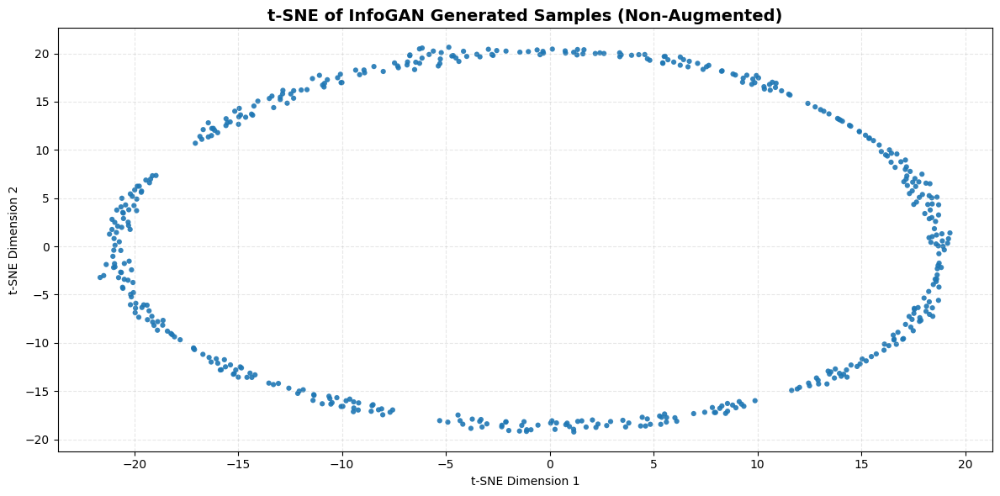

In [ ]:
# =========== Generate z and c for InfoGAN =========== #
latent_dim = 100
code_dim = 2
z = tf.random.normal([500, latent_dim])
c = tf.random.uniform([500, code_dim], minval=-1.0, maxval=1.0)

# =========== ℓ₂-Normalise =========== #
z = tf.math.l2_normalize(z, axis=1)
c = tf.math.l2_normalize(c, axis=1)

# =========== Concatenate z and c ===========
zc = tf.concat([z, c], axis=1)

# =========== Generate Images =========== #
generated_images = generator(zc, training=False)
generated_images = (generated_images + 1) / 2.0

def plot_tsne_embeddings(generated_images, save_path=None, title="t-SNE of InfoGAN Generated Samples (Non-Augmented)"):
    # ----- Convert to [0, 1] Range ----- #
    if tf.reduce_max(generated_images).numpy() > 1.0:
        raise ValueError("Images should be in [-1, 1] range before scaling.")

    images_rescaled = (generated_images + 1.0) / 2.0
    flat_images = images_rescaled.numpy().reshape(images_rescaled.shape[0], -1)

    # ----- Run t-SNE ----- #
    tsne = TSNE(n_components=2, perplexity=30, learning_rate='auto', init='pca', random_state=42)
    tsne_proj = tsne.fit_transform(flat_images)

    # ----- Plot t-SNE ----- #
    plt.figure(figsize=(12, 6))
    sns.scatterplot(
        x=tsne_proj[:, 0],
        y=tsne_proj[:, 1],
        s=20,
        alpha=0.9,
        edgecolor='none'
    )
    plt.title(title, fontsize=14, weight='bold')
    plt.xlabel("t-SNE Dimension 1")
    plt.ylabel("t-SNE Dimension 2")
    plt.grid(True, linestyle='--', alpha=0.3)
    plt.tight_layout()

    if save_path:
        plt.savefig(save_path, dpi=300)
        print(f"t-SNE plot saved to: {save_path}")

    plt.show()

plot_tsne_embeddings(generated_images=generated_images)

With reference to the t-SNE plot of InfoGAN generated samples (Non-Augmented) above, we are able to make the following observations:

**Highly Structured and Disentangled Distribution**

- The samples form a perfect elliptical or circular manifold, suggesting that InfoGAN has learned a smooth and interpretable latent space.

- This is expected due to InfoGAN's use of mutual information regularisation, which encourages disentanglement in the latent variables.

**Exceptional Mode Coverage**

- The uniform curve indicates that all latent codes are being used effectively, with no signs of mode collapse or sparsity.

- Implies that latent traversals will result in continuous and meaningful changes in output, ideal for applications like controllable generation.

**Almost No Outliers**

- Points are tightly packed along the curve with minimal scatter outside the manifold, showing strong generator consistency.

- Such tight structure can be attributed to the semantic regularity induced by InfoGAN's auxiliary Q-network.

**Possible Over-Constraint**

- While visually impressive, the overly clean elliptical layout may reflect a model bias toward encoding structure rather than raw diversity.

- May suggest that InfoGAN has prioritised latent interpretability over visual variability, which is suitable for interpretability tasks.

With the observations indicated above, we will proceed to train the next GAN Model in the final sub-section.

---
## 4.8 Self-Attention GAN Model Training

In this sub-section, we will be training a Self-Attention GAN (SAGAN) for the EMNIST Dataset. The SAGAN adds a Self-Attention Mechanism that captures global dependencies across the training data, understands contextual relationships while preserving structural consistency. This will generally result is a more stable training as no local convolutional layers are relied on. The relevant mathematical formulas are indicated below:

---
**Generator Loss:**

Purpose: Produce Outputs Classified as Real.

$$
\mathcal{L}_G = \frac{1}{2} \mathbb{E}_{z \sim p_z}[(D(G(z)) - c)^2]
$$

Where:
- $c = 1$ = Desired Discriminator Output for Generated Images  
- $D(G(z))$ = Discriminator's Output for Generated Data  
- $z \sim p_z$ = Sample from Latent Space

---
**Discriminator Loss:**

Purpose: Discriminator Minimises the Error between Predictions and True Labels.

$$
\mathcal{L}_D = \frac{1}{2} \mathbb{E}_{x \sim p_{\text{data}}}[(D(x) - b)^2] + \frac{1}{2} \mathbb{E}_{z \sim p_z}[(D(G(z)) - a)^2]
$$

Where:  
- $D(x)$ = Discriminator's Output for Real Data  
- $D(G(z))$ = Discriminator's Output for Generated Data  
- $a = 0$ = Label for Fake Data  
- $b = 1$ = Label for Real Data  
- $x \sim p_{\text{data}}$ = Sample from Real Data Distribution  
- $z \sim p_z$ = Sample from Latent Noise Distribution  

---
**Self-Attention Output**

Purpose: Allows Generator and Discriminator to capture long-range dependencies between pixels across the image.

$$
\text{Attention}(X) = \text{Softmax}(QK^T) V
$$

Where:
- $X \in \mathbb{R}^{N \times d}$ = Input Feature Map Reshaped into Sequence
- $Q = XW_Q$ = Query Projections
- $K = XW_K$ = Key Projection
- $V = XW_V$ = Value Projection
- $W_Q, W_K, W_V \in \mathbb{R}^{d \times d'}$ = Learnable Weights
- $\text{Softmax}(QK^T) \in \mathbb{R}^{N \times N}$ = Attention Matrix

---
**Self-Attention Layer Output**

Purpose: Add Global Context to each feature by Combining Local Convolution and Self-Attention Output.

$$
O = \gamma \cdot \text{Attention}(X) + X
$$

Where:
- $\text{Attention}(X)$ = Attention-Modulated Feature Map
- $X$ = Original Input Feature Map
- $\gamma$ = Learnable Scalar to Control Attention Usage

---
**Total Objective:**

Purpose: SAGAN Seeks to Solve the Objective.

$$
\min_G \max_D \; \mathcal{L}_D \quad \text{and} \quad \min_G \; \mathcal{L}_G
$$

---
With the relevant mathematical formulas indicated above, we will proceed to train the SAGAN in this sub-section for the purpose of it's potential for smoother training process and also to serve as a comparison for our other GAN Models.

---
### 4.8.1 Defining Data Pre-Processing Function

In this sub-section, we will be defining the Data Pre-Processing Function which will allow for consistent Data Pipeline to be built and modifed accordingly should the need arise such as when we need to add Spectral Normalisation. This will ensure that the Data's integrity is not affected and we are able to make fair and un-biased assumptions. The Data Pre-Processing Function is defined in the Code Cell below:

In [ ]:
# =========== Data Pre-Processing Function =========== #
def load_data(X_train, batch_size=32):
    buffer_size = X_train.shape[0]

    dataset = tf.data.Dataset.from_tensor_slices(X_train)
    dataset = dataset.shuffle(buffer_size)
    dataset = dataset.batch(batch_size)
    dataset = dataset.prefetch(tf.data.AUTOTUNE)

    return dataset

With reference to the Code Cell above, we are able to determine that the Data Pre-Processing Function have been defined successfully and we are able to move on to Defining Callback Functions in the next sub-section.

---
### 4.8.2 Defining Callback Functions

In this sub-section, we will be pre-defining the various Callbacks. This is to ensure consistency throughout the model and also to increase the GAN Accuracy and optimise the Computation Cost for training each GAN Model. These Callbacks will be main used during the GAN Training in the next sub-section. The revelant mathematical formula for the callbacks and logic are indicated below:

---
**Learning Rate Scheduler:**

Purpose: Reduces Learning Rate During Training to Fine-tune Model Convergence.

$$\text{If } epoch \mod 10 = 0 \Rightarrow \eta_{new} = \frac{1}{2} \cdot \eta$$

Where:

- $\eta$ = current learning rate

- $\eta_{\text{new}}$ = updated learning rate

- $epoch \bmod 10$ checks if the epoch is a multiple of 10

---
**ReduceLROnPlateau:**

Purpose: Automatically Reduces the Learning Rate when Validation Performance Plateaus.

$$
\text{If no improvement in } val\_loss \text{ for 10 epochs: } \eta_{\text{new}} = 0.5 \cdot \eta
$$

Where:

- $\eta_{\text{new}}$ = reduced learning rate

---
**EarlyStopping:**

Purpose: Prevents Wastage of Computational Power if Model Does Not Improve.

$$
\text{If } val\_loss \text{ does not improve for 25 epochs, stop training and restore best weights}
$$

---

We will proceed to Define the Callbacks in the Code Cell below in preparation for the GAN Model Training.

In [ ]:
# =========== Define Learning Rate Scheduler =========== #
lr_scheduler = LearningRateScheduler(
    lambda epoch, lr: lr * 0.95 if epoch % 10 == 0 else lr,
    verbose=1
)

# =========== Define Reduce LR on Plateau =========== #
reduce_lr = ReduceLROnPlateau(
    monitor='loss',
    factor=0.5,
    patience=10,
    verbose=1,
    min_lr=1e-6
)

# =========== Define Early Stopping =========== #
early_stop = EarlyStopping(
    monitor='loss',
    patience=25,
    verbose=1,
    restore_best_weights=False
)

# =========== Define Display Generated Images =========== #
def display_generated_images(generator, latent_dim, n=7, channels=1):
    noise = tf.random.normal([n * n, latent_dim])
    generated_images = generator(noise, training=False)
    generated_images = (generated_images + 1.0) / 2.0

    fig, axes = plt.subplots(n, n, figsize=(n, n))

    for i in range(n):
        for j in range(n):
            img = generated_images[i * n + j]
            if channels == 1:
                axes[i, j].imshow(img[:, :, 0], cmap='gray')
            else:
                axes[i, j].imshow(img)
            axes[i, j].axis('off')

    plt.tight_layout()
    plt.show()

# =========== Define FID Calculator =========== #
def calculate_fid(real_images, fake_images, batch_size=10):

    # ----- Scale to [0,255] and Resize to 299×299 ----- #
    real = (real_images + 1.0) * 127.5
    fake = (fake_images + 1.0) * 127.5
    real = tf.image.resize(real, (299,299))
    fake = tf.image.resize(fake, (299,299))

    # ----- If Grayscale, Convert to RGB ----- #
    if real.shape[-1] == 1:
        real = tf.image.grayscale_to_rgb(real)
        fake = tf.image.grayscale_to_rgb(fake)

    # ----- Preprocess for Inception (–1 to +1) ----- #
    real_pp = preprocess_input(real)
    fake_pp = preprocess_input(fake)

    # ----- Extract Features in Batches ----- #
    def _get_acts(x):
        acts = []
        n = x.shape[0]
        for i in range(0, n, batch_size):
            chunk = x[i:i+batch_size]
            acts.append(_inception_model(chunk, training=False).numpy())
        return np.vstack(acts)

    act_real = _get_acts(real_pp)
    act_fake = _get_acts(fake_pp)

    # ----- Compute Statistics ----- #
    mu1, sigma1 = act_real.mean(axis=0), np.cov(act_real, rowvar=False)
    mu2, sigma2 = act_fake.mean(axis=0), np.cov(act_fake, rowvar=False)
    diff    = mu1 - mu2
    covmean = sqrtm(sigma1.dot(sigma2))
    if np.iscomplexobj(covmean):
        covmean = covmean.real
    fid = diff.dot(diff) + np.trace(sigma1 + sigma2 - 2*covmean)
    return float(np.round(fid,4))

# =========== Confirmation Message =========== #
print("InfoGAN Callbacks and Visualisation Setup Complete")

InfoGAN Callbacks and Visualisation Setup Complete


With reference to the Code Cell above, we are able to verify that that the Callbacks have been successfully defined and the various parameters are set so as to ensure a High Accuracy and Computing Efficient GAN Model Training.

---
### 4.8.3 Defining Spectral Normalisation

In this section, we will be defining the Spectral Normalisation layer for the Discriminator of the GAN. The Spectral Normalisation controls the Lipschitz constant of the Discriminator by constraining the Spectral Norm of each weight matrix. This will prevent the Discriminator from being too powerful and dominating the Generator which can cause various issues such as Mode Collaspe, Training Instability and Exploding Gradients. The relevant mathematical formula is indicated below:

---
**Spectral Normalisation (SN)**

Purpose: Controls the Lipschitz Constant of the Discriminator.

$$
\bar{W} = \frac{W}{\sigma(W)}
$$

Where:
- $W$ = Original Weight Matrix
- $\bar{W}$ = Spectrally Normalised Weight Matrix used in the Forward Pass
- $\sigma(W)$ = Spectral Norm of $W$
---
**Spectral Norm Approximation using Power Iteration**

Purpose: Controls the Lipschitz Constant of the Discriminator.

$$
\sigma(W) \approx \mathbf{u}^\top W \mathbf{v}
$$

Where:
- $\mathbf{v} \leftarrow \frac{W^\top \mathbf{u}}{\|W^\top \mathbf{u}\|_2}$
- $\mathbf{u} \leftarrow \frac{W \mathbf{v}}{\|W \mathbf{v}\|_2}$
- $\mathbf{u}, \mathbf{v}$: Approximated Unit Vectors
---
With the relevant mathematical formulas indicated, we will proceed to define the Spectral Normalisation in the Code Cell below.

In [ ]:
# =========== Spectral Normalisation Convolution Layer =========== #
class SpectralConv2D(tf.keras.layers.Layer):
    def __init__(self, filters, kernel_size, strides=1, padding='same', **kwargs):
        super().__init__()
        self.conv = tf.keras.layers.Conv2D(filters, kernel_size, strides=strides, padding=padding, use_bias=False, **kwargs)
        self.u = None

    def build(self, input_shape):
        self.conv.build(input_shape)
        self.w = self.conv.kernel
        self.u = self.add_weight(shape=(1, self.w.shape[-1]), initializer='random_normal', trainable=False, name='sn_u')

    def compute_spectral_norm(self, w):
        w_reshaped = tf.reshape(w, [-1, w.shape[-1]])
        u = self.u

        for _ in range(1):
            v = tf.linalg.l2_normalize(tf.matmul(u, tf.transpose(w_reshaped)))
            u = tf.linalg.l2_normalize(tf.matmul(v, w_reshaped))

        sigma = tf.matmul(tf.matmul(v, w_reshaped), tf.transpose(u))
        self.u.assign(u)
        return w / sigma

    def call(self, inputs):
        self.conv.kernel.assign(self.compute_spectral_norm(self.w))
        return self.conv(inputs)

# =========== Spectral Normalisation Dense Layer =========== #
class SpectralDense(tf.keras.layers.Layer):
    def __init__(self, units, activation=None):
        super().__init__()
        self.dense = tf.keras.layers.Dense(units, activation=activation, use_bias=False)
        self.u = None

    def build(self, input_shape):
        self.dense.build(input_shape)
        self.w = self.dense.kernel
        self.u = self.add_weight(shape=(1, self.w.shape[-1]), initializer='random_normal', trainable=False, name='sn_u_dense')

    def compute_spectral_norm(self, w):
        w_reshaped = tf.reshape(w, [-1, w.shape[-1]])
        u = self.u

        for _ in range(1):
            v = tf.linalg.l2_normalize(tf.matmul(u, tf.transpose(w_reshaped)))
            u = tf.linalg.l2_normalize(tf.matmul(v, w_reshaped))

        sigma = tf.matmul(tf.matmul(v, w_reshaped), tf.transpose(u))
        self.u.assign(u)
        return w / sigma

    def call(self, inputs):
        self.dense.kernel.assign(self.compute_spectral_norm(self.w))
        return self.dense(inputs)

With reference to the Code Cell above, we are able to verify that the Spectral Normalisation have been successfully defined and we are able to proceed to include this layer in the Discriminator Architecture in the next section.

---
### 4.8.3 Defining Self-Attention Layer

In this section, we will be defining the Self-Attention Layer for the SAGAN. The Self-Attention Layers will be giving the SAGAN the ability to be capable of capturing patterns and data relationships clearly which is the speciality and function of the SAGAN. The Layers will subsequently be added in to the Model Architectures alongside the Spectral Normalisation. The relevant mathematical formulas are indicated below:

---
**Self-Attention Output**

Purpose: Allows Generator and Discriminator to capture long-range dependencies between pixels across the image.

$$
\text{Attention}(X) = \text{Softmax}(QK^T) V
$$

Where:
- $X \in \mathbb{R}^{N \times d}$ = Input Feature Map Reshaped into Sequence
- $Q = XW_Q$ = Query Projections
- $K = XW_K$ = Key Projection
- $V = XW_V$ = Value Projection
- $W_Q, W_K, W_V \in \mathbb{R}^{d \times d'}$ = Learnable Weights
- $\text{Softmax}(QK^T) \in \mathbb{R}^{N \times N}$ = Attention Matrix

---
**Self-Attention Layer Output**

Purpose: Add Global Context to each feature by Combining Local Convolution and Self-Attention Output.

$$
O = \gamma \cdot \text{Attention}(X) + X
$$

Where:
- $\text{Attention}(X)$ = Attention-Modulated Feature Map
- $X$ = Original Input Feature Map
- $\gamma$ = Learnable Scalar to Control Attention Usage

---

With the mathematical formulas indicated, we will proceed to define the Self-Attention layers in the Code Cell below for the usage in the Architecture later on.

In [ ]:
# =========== Self Attention Layer =========== #
class SelfAttention(tf.keras.layers.Layer):
    def __init__(self, channels):
        super().__init__()
        self.channels = channels
        self.query = SpectralConv2D(filters=channels // 8, kernel_size=1, padding='same')
        self.key = SpectralConv2D(filters=channels // 8, kernel_size=1, padding='same')
        self.value = SpectralConv2D(filters=channels,       kernel_size=1, padding='same')
        self.gamma = tf.Variable(0.0, trainable=True, name='attn_gamma')

    def call(self, x):
        # ----- Shape Operation ----- #
        shape = tf.shape(x)
        batch_size, height, width = shape[0], shape[1], shape[2]
        flatten_dim = height * width

        # ----- Project ----- #
        f = self.query(x)
        g = self.key(x)
        h = self.value(x)

        # ----- Flatten ----- #
        f_flat = tf.reshape(f, [batch_size, flatten_dim, -1])
        g_flat = tf.reshape(g, [batch_size, flatten_dim, -1])
        h_flat = tf.reshape(h, [batch_size, flatten_dim, -1])

        # ----- Attention Map ----- #
        s    = tf.matmul(f_flat, g_flat, transpose_b=True)
        beta = tf.nn.softmax(s, axis=-1)

        # ----- Attend ----- #
        o_flat = tf.matmul(beta, h_flat)
        o = tf.reshape(o_flat, [batch_size, height, width, self.channels])

        # ----- Residual ----- #
        return self.gamma * o + x

With reference to the Code Cell above, we are able to determine that the Self-Attention Layers have been successfully defined and we are able to move on the define the Generator and Discriminator Architecture while utilising the Self-Attention Layer.

---
### 4.8.4 Defining SAGAN Generator Architecture

In this section, we will be defining the InfoGAN's Generator Architecture. The Generator will be trying to make realistic generated images in the attempt to bypass the Discriminator. Subsequently, the generated images from the Generator will be evaluated based on a few evaluation metrics such as Inception Score. The relevent mathematical formulas for the Loss Function of the Vanilla GAN Generator is indicated below:

---
**Generator Loss:**

Purpose: Produce Outputs Classified as Real.

$$
\mathcal{L}_G = \frac{1}{2} \mathbb{E}_{z \sim p_z}[(D(G(z)) - c)^2]
$$

Where:
- $c = 1$ = Desired Discriminator Output for Generated Images  
- $D(G(z))$ = Discriminator's Output for Generated Data  
- $z \sim p_z$ = Sample from Latent Space

---
With the relevant Generator Loss Formula indicated above, we will proceed to define the GAN Generator's Architecture in the Code Cell below and the Lost Function.

In [ ]:
# =========== Generator Function =========== #
def build_sagan_generator(latent_dim=100, code_dim=2, use_dropout=True):
    input_dim = latent_dim + code_dim  # z + c
    model = tf.keras.Sequential(name="sagan_generator")

    # ----- Project and Reshape ----- #
    model.add(layers.Dense(7 * 7 * 256, use_bias=False, input_shape=(input_dim,)))
    model.add(layers.BatchNormalization())
    model.add(layers.ReLU())
    model.add(layers.Reshape((7, 7, 256)))

    # ----- Upsample 1 ----- #
    model.add(layers.Conv2DTranspose(128, kernel_size=5, strides=1, padding='same', use_bias=False))
    model.add(layers.BatchNormalization())
    model.add(layers.ReLU())
    if use_dropout:
        model.add(layers.Dropout(0.3))

    # ----- Self-Attention Layer ----- #
    model.add(SelfAttention(128))

    # ----- Upsample 2 ----- #
    model.add(layers.Conv2DTranspose(64, kernel_size=5, strides=2, padding='same', use_bias=False))
    model.add(layers.BatchNormalization())
    model.add(layers.ReLU())
    if use_dropout:
        model.add(layers.Dropout(0.3))

    # ----- Final Upsample ----- #
    model.add(layers.Conv2DTranspose(1, kernel_size=5, strides=2, padding='same', activation='tanh'))

    return model

# =========== Generator Loss Function =========== #
bce = tf.keras.losses.BinaryCrossentropy(from_logits=True)

def generator_loss(fake_logits):
    return -tf.reduce_mean(fake_logits)

With reference to the Code Cell above, we are able to verify that the GAN's Generator Architecture have been successfully defined and we are able to proceed to define the GAN's Discriminator Architecture.

---
### 4.8.5 Defining SAGAN Discriminator Architecture

In this section, we will be defining the Architecture of the Discriminator of the GAN. The Discriminator will be the Neural Network that will attempt to tell the Generated Images apart from the Actual Images. This will allow the GAN to improve overtime and also improve itself overtime. The mathematical function for the Discriminator Loss Function is indicated below:

---
**Discriminator Loss:**

Purpose: Discriminator Minimises the Least Squares Error between Predictions and True Labels.

$$
\mathcal{L}_D = \frac{1}{2} \mathbb{E}_{x \sim p_{\text{data}}}[(D(x) - b)^2] + \frac{1}{2} \mathbb{E}_{z \sim p_z}[(D(G(z)) - a)^2]
$$

Where:  
- $D(x)$ = Discriminator's Output for Real Data  
- $D(G(z))$ = Discriminator's Output for Generated Data  
- $a = 0$ = Label for Fake Data  
- $b = 1$ = Label for Real Data  
- $x \sim p_{\text{data}}$ = Sample from Real Data Distribution  
- $z \sim p_z$ = Sample from Latent Noise Distribution  
---

With the mathematical formula for the Loss Function indicated above, we will proceed to define the GAN's Discriminator Architecture and the Loss Function in the Code Cell below.

In [ ]:
# =========== Discriminator Function =========== #
def build_sagan_discriminator(input_shape=(28, 28, 1), code_dim=2):
    image_input = tf.keras.Input(shape=input_shape)

    # ----- Spectral-normalized Convolution Layer ----- #
    x = SpectralConv2D(64, kernel_size=5, strides=2, padding='same')(image_input)
    x = tf.keras.layers.LeakyReLU(0.2)(x)
    x = tf.keras.layers.Dropout(0.3)(x)

    # ----- Spectral-normalized Convolution Layer ----- #
    x = SpectralConv2D(128, kernel_size=5, strides=2, padding='same')(x)
    x = tf.keras.layers.LeakyReLU(0.2)(x)
    x = tf.keras.layers.Dropout(0.3)(x)

    # ----- Self-Attention Layer ----- #
    x = SelfAttention(128)(x)

    x = tf.keras.layers.Flatten()(x)

    # ----- Output 1: Real/Fake ----- #
    real_fake_output = SpectralDense(1)(x)

    # ----- Output 2: Q-network Code Prediction ----- #
    code_output = SpectralDense(code_dim)(x)

    return tf.keras.Model(inputs=image_input,
                          outputs=[real_fake_output, code_output],
                          name="sagan_discriminator_with_Q")

# =========== Discriminator Loss Function =========== #
def discriminator_loss(real_logits, fake_logits):
    loss_real = tf.reduce_mean(tf.nn.relu(1.0 - real_logits))
    loss_fake = tf.reduce_mean(tf.nn.relu(1.0 + fake_logits))
    return loss_real + loss_fake

With reference to the Code Cell above, we are able to verify that the GAN's Discriminator Architecture have been successfully defined and we are able to proceed to define the GAN's Training Steps.

---
### 4.8.6 Defining Training Step

In this section, we will be Defining the Training Step function so as to train both the Generator and the Discriminator at the same time. The Training Step will compute the gradients for both the Generator and the Discriminator at the same time. The relevant mathematical formulas for the Training Step is indicated below:

---
**Generator Loss:**

Purpose: Produce Outputs Classified as Real.

$$
\mathcal{L}_G = \frac{1}{2} \mathbb{E}_{z \sim p_z}[(D(G(z)) - c)^2]
$$

Where:
- $c = 1$ = Desired Discriminator Output for Generated Images  
- $D(G(z))$ = Discriminator's Output for Generated Data  
- $z \sim p_z$ = Sample from Latent Space

---
**Discriminator Loss:**

Purpose: Discriminator Minimises the Least Squares Error between Predictions and True Labels.

$$
\mathcal{L}_D = \frac{1}{2} \mathbb{E}_{x \sim p_{\text{data}}}[(D(x) - b)^2] + \frac{1}{2} \mathbb{E}_{z \sim p_z}[(D(G(z)) - a)^2]
$$

Where:  
- $D(x)$ = Discriminator's Output for Real Data  
- $D(G(z))$ = Discriminator's Output for Generated Data  
- $a = 0$ = Label for Fake Data  
- $b = 1$ = Label for Real Data  
- $x \sim p_{\text{data}}$ = Sample from Real Data Distribution  
- $z \sim p_z$ = Sample from Latent Noise Distribution  

---
**Total Objective:**

Purpose: LSGAN Seeks to Solve the Objective.

$$
\min_G \max_D \; \mathcal{L}_D \quad \text{and} \quad \min_G \; \mathcal{L}_G
$$

---

With the relevant mathematical formulas indicated above, we will proceed to define the Training Step in the Code Cell below.

In [ ]:
# =========== Training Step Function =========== #
@tf.function
def train_step(real_images, generator, discriminator, gen_optimizer, disc_optimizer,
               latent_dim, code_dim=2, lambda_mi=1.0):
    batch_size = tf.shape(real_images)[0]
    bce = tf.keras.losses.BinaryCrossentropy(from_logits=True)

    # ----- Sample Latent Noise and Latent Code ----- #
    z = tf.random.normal([batch_size, latent_dim])
    c = tf.random.uniform([batch_size, code_dim], minval=-1.0, maxval=1.0)
    zc = tf.concat([z, c], axis=1)

    with tf.GradientTape(persistent=True) as tape:
        # ----- Generator Forward Pass ----- #
        fake_images = generator(zc, training=True)

        # ----- Discriminator Forward Pass ----- #
        real_output, _ = discriminator(real_images, training=True)
        fake_output, predicted_c = discriminator(fake_images, training=True)

        # ----- Discriminator Loss (Standard Binary Crossentropy) ----- #
        d_loss_real = bce(tf.ones_like(real_output), real_output)
        d_loss_fake = bce(tf.zeros_like(fake_output), fake_output)
        disc_loss = d_loss_real + d_loss_fake

        # ----- Generator Loss ----- #
        adv_loss = bce(tf.ones_like(fake_output), fake_output)

        # ----- Mutual Information Loss ----- #
        mi_loss = tf.reduce_mean(tf.square(predicted_c - c))  # For continuous latent codes

        # ----- Total Generator Loss ----- #
        gen_loss = adv_loss + lambda_mi * mi_loss

    # ----- Apply Gradients ----- #
    gen_grads = tape.gradient(gen_loss, generator.trainable_variables)
    disc_grads = tape.gradient(disc_loss, discriminator.trainable_variables)

    gen_optimizer.apply_gradients(zip(gen_grads, generator.trainable_variables))
    disc_optimizer.apply_gradients(zip(disc_grads, discriminator.trainable_variables))

    return gen_loss, disc_loss, adv_loss, mi_loss

With reference to the Code Cell above, we are able to determine that the Training Step have been successfully defined and we are able to proceed to prepare the Training Loop in the next section.

---
### 4.8.7 Defining Training Loop

In this section, we will be defining the Training Loop for the GAN Training. The Training Loop will go through each of the Epoch and train both the Generator and Discriminator simultaneously. The Training Loop will also track the Loss for both the Generator and the Discriminator for each of the Epoch trained. The relevant mathematical formulas are indicated below:

---
**Epoch Loss Averaging:**

Purpose: These are the Average Generator and Discriminator Losses over all Batches in Epoch $t$.

$$
\bar{L}_G^{(t)} = \frac{1}{N} \sum_{i=1}^{N} L_G^{(i)} \\
\bar{L}_D^{(t)} = \frac{1}{N} \sum_{i=1}^{N} L_D^{(i)}
$$

Where:
- $\bar{L}_G^{(t)}$ = Average Generator Loss at Epoch $t$  
- $\bar{L}_D^{(t)}$ = Average Discriminator Loss at Epoch $t$  
- $N$ = Number of Batches in the Dataset  
- $L_G^{(i)}$ = Generator Loss on Batch $i$  
- $L_D^{(i)}$ = Discriminator Loss on Batch $i$

---
**Epoch Iteration:**

Purpose: Describes the Training Loop Logic: for Each Epoch $t$, perform `train_step` for Every Mini-batch.

$$
\text{for } t = 1 \text{ to } T:
\quad \text{for each batch } (x^{(i)}):
\quad \text{train_step}(x^{(i)})
$$

Where:
- $T$: Total Number of Epochs  
- $x^{(i)}$: Real Batch $i$ from the Dataset  
- `train_step`: Function that Updates $G$ and $D$ using that Batch

---
**Generated Image Output:**

Purpose: Sample Random Noise $z$ and Generate Synthetic Image $\hat{x}$ from the Generator. This is used for Visual Monitoring of Model Quality.

$$
z \sim p_z(z) \\
\hat{x} = G(z)
$$

Where:
- $z$: Random Latent Vector  
- $G(z)$: Generated Image from Generator

---
With the mathematical formulas indicated above, we will proceed to define the Training Loop in the Code Cell below in preparation of the GAN Training.

In [ ]:
# =========== Training Loop Function =========== #
def train(dataset, epochs, generator, discriminator, gen_optimizer, disc_optimizer, latent_dim, code_dim=2, lambda_mi=1.0, save_path=None, use_early_stopping=True, steps_per_epoch=None, channels=1):
    # ----- Prepare FID Reference Sets Using X_val ----- #
    real_val  = tf.data.Dataset.from_tensor_slices(X_val).batch(50).take(1)
    noise_val = tf.random.normal([50, latent_dim])
    noise_val = tf.math.l2_normalize(noise_val, axis=1)
    code_val  = tf.random.uniform([50, code_dim], minval=-1.0, maxval=1.0)
    code_val  = tf.math.l2_normalize(code_val, axis=1)
    zc_val    = tf.concat([noise_val, code_val], axis=1)

    # ----- FID Early Stopping Settings ----- #
    best_fid = float('inf')
    no_improve = 0
    patience = 7
    fid_interval = 1

    # ----- Dummy Model ----- #
    dummy_input  = tf.keras.Input(shape=(1,))
    dummy_output = tf.keras.layers.Lambda(lambda x: x)(dummy_input)
    dummy_model  = tf.keras.Model(dummy_input, dummy_output)
    dummy_model.compile(optimizer=tf.keras.optimizers.Adam(1e-4), loss='mse')

    early_stop.set_model(dummy_model)
    reduce_lr.set_model(dummy_model)
    lr_scheduler.set_model(dummy_model)
    early_stop.on_train_begin({})
    reduce_lr.on_train_begin({})
    lr_scheduler.on_train_begin({})

    # ----- Track Loss History ----- #
    gen_loss_history = []
    disc_loss_history = []
    mi_loss_history = []

    for epoch in range(1, epochs + 1):
        print(f"\nEpoch {epoch}/{epochs}")
        gen_losses, disc_losses, mi_losses = [], [], []

        for i, real_images in enumerate(dataset):
            if steps_per_epoch and i >= steps_per_epoch:
                break

            # ----- SAGAN Train Step ----- #
            gen_loss, disc_loss, adv_loss, mi_loss = train_step(
                real_images, generator, discriminator,
                gen_optimizer, disc_optimizer,
                latent_dim, code_dim=code_dim, lambda_mi=lambda_mi
            )
            gen_losses.append(gen_loss)
            disc_losses.append(disc_loss)
            mi_losses.append(mi_loss)

        # ----- Epoch Statistics ----- #
        avg_gen_loss  = tf.reduce_mean(gen_losses)
        avg_disc_loss = tf.reduce_mean(disc_losses)
        avg_mi_loss   = tf.reduce_mean(mi_losses)
        print(f"Gen Loss: {avg_gen_loss:.4f} | "
              f"Disc Loss: {avg_disc_loss:.4f} | "
              f"MI Loss: {avg_mi_loss:.4f}")

        # ----- Save Losses ----- #
        gen_loss_history.append(float(avg_gen_loss))
        disc_loss_history.append(float(avg_disc_loss))
        mi_loss_history.append(float(avg_mi_loss))

        # ----- Run Callbacks ----- #
        logs = {'loss': float(avg_gen_loss)}
        if use_early_stopping:
            early_stop.on_epoch_end(epoch=epoch, logs=logs)
            if early_stop.stopped_epoch > 0:
                print(f"Early stopping triggered at epoch {epoch}")
                break
        reduce_lr.on_epoch_end(epoch=epoch, logs=logs)
        lr_scheduler.on_epoch_end(epoch=epoch, logs=logs)

        # ----- FID evaluation & early stopping ----- #
        if epoch % fid_interval == 0:
            fake_val    = generator(zc_val, training=False)
            real_batch  = next(iter(real_val))
            real_for_fid = tf.image.resize(real_batch, [299,299]) * 0.5 + 0.5
            fake_for_fid = tf.image.resize(fake_val,    [299,299]) * 0.5 + 0.5
            fid_value    = calculate_fid(real_for_fid, fake_for_fid)
            print(f"Epoch {epoch} → FID: {fid_value:.2f}")

            if fid_value < best_fid:
                best_fid   = fid_value
                no_improve = 0
                if save_path:
                    os.makedirs(save_path, exist_ok=True)
                    generator.save_weights(os.path.join(save_path, "best_gen.weights.h5"))
                    discriminator.save_weights(os.path.join(save_path, "best_disc.weights.h5"))
            else:
                no_improve += 1

            if no_improve >= patience:
                print(f"No FID improvement for {patience} epochs, stopping.")
                break

        # ----- Visualisation Every 10 Epochs ----- #
        if epoch % 10 == 0:
            display_generated_images(generator, latent_dim + code_dim, channels=channels)

    # ----- Restore Best Weights After Training ----- #
    if save_path:
        best_gen_path = os.path.join(save_path, "best_gen.weights.h5")
        best_disc_path = os.path.join(save_path, "best_disc.weights.h5")
        if os.path.exists(best_gen_path) and os.path.exists(best_disc_path):
            generator.load_weights(best_gen_path)
            discriminator.load_weights(best_disc_path)
            print("Restored best generator and discriminator weights based on lowest FID.")
        else:
            print("Best weight files not found. Skipping restore.")

    return avg_gen_loss, gen_loss_history, disc_loss_history, mi_loss_history

With reference to the Code Cell above, we are able to determine that the Training Loop have been successfully defined and we are able to proceed to define the Optimisers with Tunable Parameter in preparation for the Optuna Tuning.

---
### 4.8.8 Defining Optimisers with Tunable Parameters

In this section, we will be defining the Common Optimisers that will be Tuned using the Optuna Tuning. The Optimisers will each have a range of values in a list so as to allow for the Optuna to search for the best Hyperparameter for the GAN. Through these parameters, it will affect how effective and efficiently the GAN will learn from the provided EMNIST Data. The relevent mathematical formula is indicated below:

---
**Optimiser Update Rule**

Purpose: Parameter Update Step in the Adam Optimiser, using Adaptive Learning Rates with Momentum.

$$
\theta \leftarrow \theta - \eta \cdot \frac{m_t}{\sqrt{v_t} + \epsilon}
$$

Where:
- $\theta$ = Model Parameters (Generator or Discriminator)
- $\eta$ = Learning Rate (Tuned)
- $m_t$ = First Moment Estimate (Mean of Gradients)
- $v_t$ = Second Moment Estimate (Variance of Gradients)
- $\epsilon$ = Small Constant for Numerical Stability

---
With the mathematical formula indicated above, we will proceed to define the Optimisers in the Code Cell.

In [ ]:
# ========== Objective Function ========== #
def objective(trial):
    # ----- Hyperparameters ----- #
    latent_dim = trial.suggest_categorical('latent_dim', [100, 128, 160])
    learning_rate = trial.suggest_float('learning_rate', 5e-5, 2e-4, log=True)
    beta_1 = trial.suggest_float('beta_1', 0.4, 0.6)
    code_dim = 2
    lambda_mi = 1.0

    # ----- Build Models ----- #
    generator = build_sagan_generator(latent_dim=latent_dim, code_dim=code_dim)
    discriminator = build_sagan_discriminator(code_dim=code_dim)

    # ----- Trigger Weight Creation ----- #
    z = tf.random.uniform([1, latent_dim], -1.0, 1.0)
    c = tf.random.uniform([1, code_dim], -1.0, 1.0)
    zc = tf.concat([z, c], axis=1)
    _ = generator(zc)
    _ = discriminator(tf.random.normal([1, 28, 28, 1]))

    # ----- Define Optimizers ----- #
    gen_optimizer = tf.keras.optimizers.Adam(learning_rate=learning_rate, beta_1=beta_1)
    disc_optimizer = tf.keras.optimizers.Adam(learning_rate=learning_rate, beta_1=beta_1)

    # ----- Prebuild Optimizer States ----- #
    _ = gen_optimizer.apply_gradients([(tf.zeros_like(v), v) for v in generator.trainable_variables])
    _ = disc_optimizer.apply_gradients([(tf.zeros_like(v), v) for v in discriminator.trainable_variables])

    # ----- Load EMNIST Dataset ----- #
    dataset = load_data(X_train, batch_size=64)
    steps = min(1000, len(X_train) // 64)

    # ----- Train InfoGAN-SAGAN ----- #
    _ = train(
        dataset=dataset,
        epochs=100,
        generator=generator,
        discriminator=discriminator,
        gen_optimizer=gen_optimizer,
        disc_optimizer=disc_optimizer,
        latent_dim=latent_dim,
        code_dim=code_dim,
        lambda_mi=lambda_mi,
        steps_per_epoch=steps,
        use_early_stopping=False,
        save_path=None,
        channels=1
    )

    # ----- Evaluate FID Score ----- #
    z = tf.random.uniform([1000, latent_dim], minval=-1.0, maxval=1.0)
    c = tf.random.uniform([1000, code_dim], minval=-1.0, maxval=1.0)
    zc = tf.concat([z, c], axis=1)
    fake_images = generator(zc, training=False)
    fake_images = (fake_images + 1.0) / 2.0

    real_images = X_val[:1000]

    fid_score = calculate_fid(real_images, fake_images)

    return fid_score

With reference to the Code Cell above, we are able to determine that the Optimiser have been successfully defined with a range of different Parameter Values so as to provide a robust Optuna Tuning in the subsequent sections.

---
### 4.8.9 Optuna Tuning Study

In this sub-section, we will be conducting the Optuna Tuning Study on the GAN Model so as to obtain the best Hyperparameter for the GAN Model. It is expected that the Tuning takes a prolonged duration due to the nature of how the GAN works and the 2 Neural Networks involved. However, the training data will be stored so as to prevent re-running of repetitive codes. The Optuna Tuning Study will be conducted in the Code Cell below.

In [ ]:
# =========== Create or Load Study with SQLite Backend =========== #
study = optuna.create_study(
    direction="minimize",
    study_name="sagan_tuning",
    storage="sqlite:////content/drive/MyDrive/Colab Notebooks/DELE CA2 A/Non-Augmented GAN Tunings/sagan_optuna.db",
    load_if_exists=True
)

# =========== Trial Management =========== #
MAX_TRIALS = 50
completed_trials = len([t for t in study.trials if t.state == optuna.trial.TrialState.COMPLETE])
remaining_trials = MAX_TRIALS - completed_trials

if remaining_trials > 0:
    print(f"Resuming SAGAN study: {completed_trials} completed, running {remaining_trials} more.")
    study.optimize(objective, n_trials=remaining_trials)
else:
    print(f"SAGAN study already completed {MAX_TRIALS} trials. Skipping optimization.")

# =========== Output Best Trial =========== #
best_trial = study.best_trial
best_params_df = pd.DataFrame([best_trial.params])
best_params_df["Final FID"] = best_trial.value
best_params_df.style.background_gradient(cmap="Blues")

[I 2025-08-10 11:09:23,499] Using an existing study with name 'sagan_tuning' instead of creating a new one.


SAGAN study already completed 50 trials. Skipping optimization.


,latent_dim,learning_rate,beta_1,Final FID
0,160,0.000140,0.568560,69.882900


With reference to the Code Cell above, we are able to view the Best Hyperparameter obtained during the Optuna Tuning Study. This Hyperparameter will be extracted and be trained for a longer period of time so as to attempt to increase the performance and limit the loss for the GAN.

---
### 4.8.10 GAN Re-Training Operation

As obtained from the previous sub-section, we will be re-training the GAN using the best Hyperparameter obtained during the Optuna Tuning Study. This is to push the GAN Model to its limits and also to save Computational Power as we are not taking up prolonged periods of time tuning GAN Models which may not have any clear signs of good performance. The retraining of the GAN Model will be conducted in the Code Cell below.

In [ ]:
# =========== Extract Best Parameters from Study =========== #
best_params = study.best_trial.params

latent_dim  = best_params['latent_dim']
learning_rate = best_params['learning_rate']
beta_1      = best_params['beta_1']
code_dim    = 2
lambda_mi   = 1.0

print("Using Best Trial Parameters for SAGAN:")
print(best_params)

# =========== Rebuild SAGAN Models =========== #
generator     = build_sagan_generator(latent_dim=latent_dim, code_dim=code_dim)
discriminator = build_sagan_discriminator(code_dim=code_dim)

gen_optimizer  = tf.keras.optimizers.Adam(learning_rate=learning_rate, beta_1=beta_1)
disc_optimizer = tf.keras.optimizers.Adam(learning_rate=learning_rate, beta_1=beta_1)

_ = gen_optimizer.apply_gradients([(tf.zeros_like(v), v) for v in generator.trainable_variables])
_ = disc_optimizer.apply_gradients([(tf.zeros_like(v), v) for v in discriminator.trainable_variables])

# =========== Reload Preprocessed Dataset =========== #
dataset = load_data(X_train)

# =========== Define Save Paths =========== #
model_name   = "sagan"
output_dir   = f"/content/drive/MyDrive/Colab Notebooks/DELE CA2 A/final_outputs_{model_name}_noAugment"
weights_path = os.path.join(output_dir, f"{model_name}_generator_final.weights.h5")
gen_ckpt     = os.path.join(output_dir, "best_gen.weights.h5")
disc_ckpt    = os.path.join(output_dir, "best_disc.weights.h5")
loss_csv     = os.path.join(output_dir, "loss_history.csv")

os.makedirs(output_dir, exist_ok=True)

# =========== Load or Train =========== #
if os.path.exists(gen_ckpt) and os.path.exists(disc_ckpt) and os.path.exists(loss_csv):
    print("All outputs found. Skipping training...")

    generator.load_weights(gen_ckpt)
    discriminator.load_weights(disc_ckpt)
    print("SAGAN Generator and Discriminator Weights Loaded.")

    loss_df = pd.read_csv(loss_csv)
    gen_loss_history  = loss_df['gen_loss'].tolist()
    disc_loss_history = loss_df['disc_loss'].tolist()
    mi_loss_history   = loss_df['mi_loss'].tolist()
    final_gen_loss    = gen_loss_history[-1]

else:
    # =========== Train SAGAN =========== #
    final_gen_loss, gen_loss_history, disc_loss_history, mi_loss_history = train(
        dataset=dataset,
        epochs=50,
        steps_per_epoch=1546,
        generator=generator,
        discriminator=discriminator,
        gen_optimizer=gen_optimizer,
        disc_optimizer=disc_optimizer,
        latent_dim=latent_dim,
        code_dim=code_dim,
        lambda_mi=lambda_mi,
        use_early_stopping=False,
        save_path=output_dir,
        channels=1
    )

    # =========== Save Generator Weights =========== #
    generator.save_weights(weights_path)
    print("SAGAN Generator Weights Saved.")

    # =========== Save Loss History =========== #
    loss_df = pd.DataFrame({
        'epoch': list(range(1, len(gen_loss_history) + 1)),
        'gen_loss': gen_loss_history,
        'disc_loss': disc_loss_history,
        'mi_loss': mi_loss_history
    })
    loss_df.to_csv(loss_csv, index=False)
    print(f"Loss history saved to {loss_csv}")

Using Best Trial Parameters for SAGAN:
{'latent_dim': 160, 'learning_rate': 0.00014049899482960934, 'beta_1': 0.5685597241773528}


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:93: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


All outputs found. Skipping training...
SAGAN Generator and Discriminator Weights Loaded.


With reference to the Code Cell above, we are able to determine that the best GAN Model have been trained and saved successfully and we are able to proceed with the Model Evaluation in the next sub-sections where we determine how well the GAN Model performed based on various metrics and evaluation methodologies.

---
### 4.8.11 GAN Model Evaluation

In this sub-section, we will be evaluating the GAN's Generator performance on various aspects. We will be utilising different methodologies and metrics to attempt to quantify the performance of the GAN Generator while also conducting Visual Inspection on the result output of the GAN. The Evaluation will be conducted in the following sections.

---
#### 4.8.11.1 Visual Grid of Samples

In this sub-section, we will be visualising the Grid of Samples of the Synthesised Data generated by the GAN Model. A list of observations will be made before the utilisation of Quantitative Metrics to evaluate the GAN Generator's general performance. As the observations made are purely from professional opinion, it will most likely not be used as a Basis of Comparison between GAN Models due to differing opinions unless in extreme cases. The visualisation will be conducted in the Code Cell below.

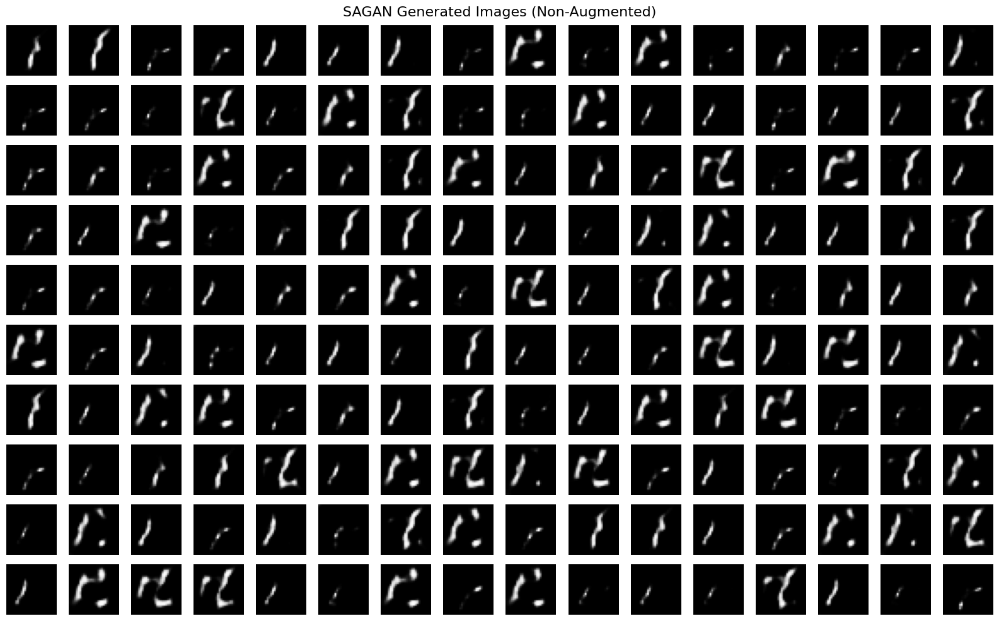

In [ ]:
def plot_generated_images(generator, latent_dim, code_dim=2, n_rows=5, n_cols=5, save_path=None, title="SAGAN Generated Images (Non-Augmented)", seed=42):
    total_samples = n_rows * n_cols

    # ----- Generate Latent Vectors ----- #
    if seed is not None:
        tf.random.set_seed(seed)

    z = tf.random.normal([total_samples, latent_dim])
    c = tf.random.uniform([total_samples, code_dim], minval=-1.0, maxval=1.0)

    z = tf.math.l2_normalize(z, axis=1)
    c = tf.math.l2_normalize(c, axis=1)
    zc = tf.concat([z, c], axis=1)

    # ----- Generate Images ----- #
    gen_images = generator(zc, training=False)
    gen_images = (gen_images + 1.0) / 2.0
    gen_images = tf.clip_by_value(gen_images, 0.0, 1.0)

    # ----- Plot ----- #
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols, n_rows))
    for idx, ax in enumerate(axes.flat):
        ax.imshow(gen_images[idx, :, :, 0], cmap='gray')
        ax.axis('off')

    plt.suptitle(title, fontsize=16)
    plt.tight_layout()

    if save_path:
        plt.savefig(save_path, dpi=300)
        print(f"Saved Generated Image Grid to: {save_path}")

    plt.show()

plot_generated_images(generator, latent_dim=160, code_dim=2, n_rows=10, n_cols=16)

With reference to the output of the Visual Grid of Samples above, we are able to make the following observations:

**Basic Structure of Letters is Not Captured**

- Most generated characters resemble the digit "1" or the uppercase letter "I".

- Stroke thickness is consistent and centred, maintaining EMNIST-like formatting.

**High Blur and Noise**

- Several samples are faint, with incomplete or faded strokes.

- Some characters show disconnected or ghost-like fragments, reducing clarity.

**Poor Character Consistency**

- The outputs are highly repetitive and lack character differentiation.

- There are virtually no complex or looped characters present.

**Lack of Diversity**

- An extreme case of mode collapse is observed as nearly all samples look like the same vertical stroke.

- Very limited variety in shape, angle, or complexity across the entire grid.

With the observations indicated above, we will proceed to conduct the Loss Curve Analysis in the next sub-section.

---
#### 4.8.11.2 Loss Curve Over Epochs

In this sub-section, we will be plotting the GAN Loss Curve over Epochs to evaluate the training behaviour of the GAN. This curve provides insight into whether the GAN is experiencing underfitting, overfitting, or achieving a stable training dynamic between the generator and discriminator.

Although GANs do not minimise a single unified loss in the traditional sense, the trajectory of the generator and discriminator losses can indicate whether the adversarial training process is converging appropriately.

If the generator loss remains high while discriminator loss quickly drops to near-zero, this may indicate **underfitting**, where the generator is not learning effectively to produce plausible images.

If the discriminator loss increases while generator loss sharply decreases, this may suggest **overfitting** or **mode collapse**, where the generator exploits narrow weaknesses in the discriminator without general improvement.

A relatively stable oscillation or convergence between both losses typically signifies a **well-balanced** training process, where the generator and discriminator are learning in tandem.

The Potential Observations and Corresponding Action Plans are outlined below:

**Underfitting Loss Curve**

- Increase training epochs to allow generator more time to learn.

- Simplify the discriminator to reduce overpowering the generator.

- Adjust the learning rate or apply label smoothing.

- Consider adding batch normalisation in the generator.

**Overfitting or Mode Collapse Loss Curve**

- Introduce or increase dropout in the discriminator.

- Apply input noise or label flipping to the discriminator.

- Evaluate diversity of generated samples regularly.

**Balanced/Ideal Loss Curve**

- Maintain current architecture and hyperparameters.

- Proceed with full-scale image generation.

- Evaluate both qualitative (visual inspection) and quantitative metrics (e.g. Inception Score or FID).

With these potential training behaviours and action plan outlined, we will proceed to visualise the GAN loss dynamics in the code cell below.

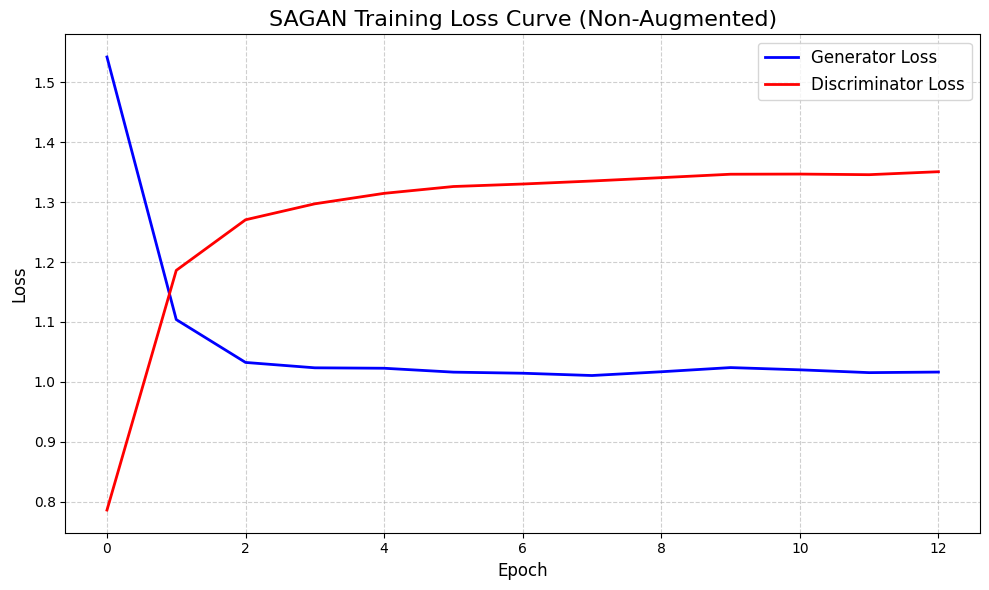

In [ ]:
# =========== Figure Size Configuration =========== #
plt.figure(figsize=(10, 6))

# =========== Plot Training Losses =========== #
plt.plot(gen_loss_history, label="Generator Loss", linewidth=2, color='blue')
plt.plot(disc_loss_history, label="Discriminator Loss", linewidth=2, color='red')

# =========== Labels and Title =========== #
plt.xlabel("Epoch", fontsize=12)
plt.ylabel("Loss", fontsize=12)
plt.title("SAGAN Training Loss Curve (Non-Augmented)", fontsize=16)

# =========== Grid, Legend, and Styling =========== #
plt.grid(True, linestyle='--', alpha=0.6)
plt.legend(fontsize=12)
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)

# =========== Display the Plot =========== #
plt.tight_layout()
plt.show()

With reference to the output of the Loss Curve above, we are able to make the following observations:

- Excellent training dynamics (i.e. Early generator improvement and sustained learning)

- No instability, no signs of collapse or domination.

- Shows that self-attention improves convergence and stability, even without data augmentation.

With the observations indicated above, we will proceed to conduct the Quantitative Metrics Evaluation in the next sub-section.

---
#### 4.8.11.3 Quantitative Metrics Evaluation

In this sub-section we will be utilising Quantitative Metrics such as FID and KID to tabulate the results of the performance and quantify the performance of the GAN Generator. We will subsequently be use these metrics to conduct inter-model evaluation after tuning and training all the GANs. The metrics that we will be utilising and their respective formulas are indicated below:

---
**Fréchet Inception Distance**

Purpose: Measures the Distance between the Real-Image and Generated-Image Distributions in Inception Feature Space.

$$
\mathrm{FID} \;=\;\|\mu_r - \mu_f\|^2
\;+\;\mathrm{Tr}\Bigl(\Sigma_r + \Sigma_f - 2\,(\Sigma_r\,\Sigma_f)^{\tfrac12}\Bigr)
$$


Where:
- $\mu_r = \mathbb{E}[f(x)]$, $\Sigma_r = \mathrm{Cov}[f(x)]$ for Real Images $x$.  
- $\mu_f = \mathbb{E}[f(\hat x)]$, $\Sigma_f = \mathrm{Cov}[f(\hat x)]$ for Generated Images $\hat x$.  
- $f(\cdot)$ = Map from Image to its InceptionV3 'pooling=avg' Features.  

---
**Diversity (t-SNE Spread)**

Purpose: Quantifies how 'wide' the 2D t-SNE Embedding of Generated Samples.

$$
\mathrm{Spread}
\;=\;
\bigl(\max_i\,z_i^{(1)} - \min_i\,z_i^{(1)}\bigr)
\;\times\;
\bigl(\max_i\,z_i^{(2)} - \min_i\,z_i^{(2)}\bigr)
$$

Where:
- $z_i = (z_i^{(1)}, z_i^{(2)})$ = 2-dimensional t-SNE Embedding of $i$th Generated Image.

---
**Mode Collapse Risk**

Purpose: Flags when too many Generated Images are Nearly Identical (mode collapse).

$$
\text{ModeCollapseRisk} =
\begin{cases}
\text{Low}, & \dfrac{\bigl|\{\mathrm{unique\_rounded}(x_i)\}\bigr|}{N} > \tau,\\
\text{High}, & \text{otherwise}.
\end{cases}
$$

Where:
- $x_i$ = $N$ Generated Samples.  
- $\mathrm{unique\_rounded}(x_i)$ = Rounds Pixels to Detect Duplicates.  
- $\tau=0.9$ = Uniqueness Threshold (90%).

---
**Perceptual Path Length**

Purpose: Measures Sensitively of Generator's Outputs (in VGG16 Feature Space) move when the Latent Code $z$ is Perturbed.

$$
\mathrm{PPL}
\;=\;
\mathbb{E}_{z,\delta z}\Bigl[\,
\|\phi\bigl(G(z + \epsilon\,\delta z)\bigr)\;-\;\phi\bigl(G(z)\bigr)\|_2^2
\Bigr]
$$

Where:  
- $G(z)$ = GAN Generator Mapping $z\in\mathbb{R}^{\mathrm{latent\_dim}}$ to an Image.  
- $\phi(\cdot)$ = VGG16 'pooling=avg' Feature Extractor.  
- $\delta z\sim\mathcal{N}(0,I)$, $\epsilon$ = Small Constant.

---
**Kernel Inception Distance**

Purpose: An Unbiased Estimator of the Squared Maximum Mean Discrepancy (MMD) between Real and Generated Inception Features.

$$
\mathrm{KID}
\;=\;
\frac{1}{m(m-1)}\sum_{i\neq j} k\bigl(\phi(x_i),\phi(x_j)\bigr)
\;+\;
\frac{1}{n(n-1)}\sum_{i\neq j} k\bigl(\phi(\hat x_i),\phi(\hat x_j)\bigr)
\;-\;
\frac{2}{mn}\sum_{i=1}^m\sum_{j=1}^n k\bigl(\phi(x_i),\phi(\hat x_j)\bigr)
$$

Where:  
- $x_i$ ($i=1\ldots m$) = Real Images.
- $\hat x_j$ ($j=1\ldots n$) = Generated Images.  
- $\phi(\cdot)$ = InceptionV3 Feature Extractor (pooling='avg').  
- $k(u,v) = \bigl(\frac{u^\top v}{d}+1\bigr)^3$ = degree-3 Polynomial Kernel on $d$-dimensional Features.

---

With the mathematical and metrics indicated above, we will proceed to conduct the Quantitave Metrics Evalution in the Code Cell below.

In [ ]:
# ========== Preload InceptionV3 and VGG16 Models ========== #
inception = InceptionV3(include_top=False, pooling='avg', input_shape=(299, 299, 3))
vgg_model = VGG16(include_top=False, weights='imagenet', input_shape=(128, 128, 3))

# ========== Preprocess for Inception ========== #
def preprocess_images_for_inception(images):
    images = (images + 1.0) * 127.5
    images = tf.image.resize(images, [299, 299])
    if images.shape[-1] == 1:
        images = tf.image.grayscale_to_rgb(images)
    return preprocess_input(images)

# ========== Compute FID ========== #
def calculate_fid(real_images, fake_images, batch_size=50):
    real_pp = preprocess_images_for_inception(real_images)
    fake_pp = preprocess_images_for_inception(fake_images)

    act1 = inception.predict(real_pp, batch_size=batch_size, verbose=0)
    act2 = inception.predict(fake_pp, batch_size=batch_size, verbose=0)

    mu1, sigma1 = np.mean(act1, axis=0), np.cov(act1, rowvar=False)
    mu2, sigma2 = np.mean(act2, axis=0), np.cov(act2, rowvar=False)

    diff = mu1 - mu2
    covmean = sqrtm(sigma1 @ sigma2)
    if np.iscomplexobj(covmean):
        covmean = covmean.real

    fid = diff @ diff + np.trace(sigma1 + sigma2 - 2 * covmean)
    return round(fid, 4)

# ========== Compute KID ========== #
def polynomial_kernel(X, Y):
    d = X.shape[1]
    return (np.dot(X, Y.T) / d + 1) ** 3

def calculate_kid(real_images, fake_images, batch_size=128):
    real_pp = preprocess_images_for_inception(real_images)
    fake_pp = preprocess_images_for_inception(fake_images)

    real_features = inception.predict(real_pp, batch_size=batch_size, verbose=0)
    fake_features = inception.predict(fake_pp, batch_size=batch_size, verbose=0)

    m = real_features.shape[0]
    n = fake_features.shape[0]

    k_rr = polynomial_kernel(real_features, real_features)
    k_gg = polynomial_kernel(fake_features, fake_features)
    k_rg = polynomial_kernel(real_features, fake_features)

    np.fill_diagonal(k_rr, 0)
    np.fill_diagonal(k_gg, 0)

    mmd = (k_rr.sum() / (m * (m - 1)) +
           k_gg.sum() / (n * (n - 1)) -
           2 * k_rg.mean())
    return round(mmd, 4)

# ========== Compute t-SNE Spread (Diversity) ========== #
def calculate_tsne_spread(images):
    flat = images.reshape(images.shape[0], -1)
    tsne = TSNE(n_components=2, random_state=42)
    proj = tsne.fit_transform(flat)
    x_range = proj[:, 0].max() - proj[:, 0].min()
    y_range = proj[:, 1].max() - proj[:, 1].min()
    return round(x_range * y_range, 2)

# ========== Assess Mode Collapse ========== #
def assess_mode_collapse(images):
    unique = np.unique(np.round(images), axis=0).shape[0]
    return "Low" if unique > 0.9 * images.shape[0] else "High"

# ========== Compute Perceptual Path Length (PPL) ========== #
def calculate_ppl(generator, latent_dim=160, num_samples=50, epsilon=1e-2):
    distances = []
    for _ in range(num_samples):
        z1 = tf.random.normal([1, latent_dim])
        z2 = z1 + epsilon * tf.random.normal([1, latent_dim])
        img1 = generator(z1, training=False)
        img2 = generator(z2, training=False)

        img1 = tf.image.resize(tf.image.grayscale_to_rgb((img1 + 1.0) * 127.5), (128, 128))
        img2 = tf.image.resize(tf.image.grayscale_to_rgb((img2 + 1.0) * 127.5), (128, 128))

        f1 = vgg_model(vgg_preprocess(img1))
        f2 = vgg_model(vgg_preprocess(img2))
        d = tf.reduce_mean(tf.square(f1 - f2)).numpy()
        distances.append(d)
    return round(np.mean(distances), 4)

# ========== Evaluate GAN Performance ========== #
def evaluate_gan_model(generator, latent_dim, code_dim, X_val,
                       gen_loss_history, disc_loss_history,
                       model_name="SAGAM"):

    # ----- Sample uniform noise and code in [-1, 1] ----- #
    noise = tf.random.uniform([1000, latent_dim], minval=-1.0, maxval=1.0)
    code  = tf.random.uniform([1000, code_dim],  minval=-1.0, maxval=1.0)
    z     = tf.concat([noise, code], axis=1)

    # ----- Generate Fake Images ----- #
    fake_images = generator(z, training=False)
    fake_images = tf.clip_by_value((fake_images + 1.0) / 2.0, 0.0, 1.0)
    fake_np     = fake_images.numpy()

    # ----- Select and preprocess 1000 Real Images from Validation Set ----- #
    real_images = tf.convert_to_tensor(X_val[:1000], dtype=tf.float32)
    real_images = tf.clip_by_value(real_images, 0.0, 1.0)

    # ----- Compute Metrics ----- #
    fid_value         = calculate_fid(real_images, fake_images)
    kid_value         = calculate_kid(real_images, fake_images)
    tsne_spread_value = calculate_tsne_spread(fake_np)
    collapse_risk     = assess_mode_collapse(fake_np)
    ppl_score         = calculate_ppl(generator, latent_dim + code_dim)
    mean_g_loss       = round(np.mean(gen_loss_history), 4)
    std_g_loss        = round(np.std(gen_loss_history), 4)
    mean_d_loss       = round(np.mean(disc_loss_history), 4)
    std_d_loss        = round(np.std(disc_loss_history), 4)

    # ----- Store as global vars (optional) ----- #
    prefix = model_name.upper()
    globals()[f"{prefix}_FID"]           = fid_value
    globals()[f"{prefix}_KID"]           = kid_value
    globals()[f"{prefix}_TSNE"]          = tsne_spread_value
    globals()[f"{prefix}_MODE_COLLAPSE"] = collapse_risk
    globals()[f"{prefix}_PPL"]           = ppl_score
    globals()[f"{prefix}_GEN_LOSS_MEAN"]  = mean_g_loss
    globals()[f"{prefix}_GEN_LOSS_STD"]   = std_g_loss
    globals()[f"{prefix}_DISC_LOSS_MEAN"] = mean_d_loss
    globals()[f"{prefix}_DISC_LOSS_STD"]  = std_d_loss

    # ----- Final Summary Row ----- #
    row = {
        "Model": model_name,
        "FID Score": fid_value,
        "KID Score": kid_value,
        "Mean Generator Loss": mean_g_loss,
        "Std Generator Loss": std_g_loss,
        "Mean Discriminator Loss": mean_d_loss,
        "Std Discriminator Loss": std_d_loss,
        "Mode Collapse Risk": collapse_risk,
        "Visual Quality": "Extremely Poor",
        "Diversity (t-SNE Spread)": tsne_spread_value,
        "PPL": ppl_score
    }

    return pd.DataFrame([row])[[
        "Model", "FID Score", "KID Score",
        "Mean Generator Loss", "Std Generator Loss",
        "Mean Discriminator Loss", "Std Discriminator Loss",
        "Mode Collapse Risk", "Visual Quality",
        "Diversity (t-SNE Spread)", "PPL"
    ]]

# ========== Create DataFrame ========== #
df = evaluate_gan_model(
    generator,
    latent_dim=160,
    code_dim=2,
    X_val=X_val,
    gen_loss_history=gen_loss_history,
    disc_loss_history=disc_loss_history,
    model_name="SAGAN (Non-Augmented)"
)

# ========== Display DataFrame ========== #
df.style.background_gradient(cmap="Blues")

,Model,FID Score,KID Score,Mean Generator Loss,Std Generator Loss,Mean Discriminator Loss,Std Discriminator Loss,Mode Collapse Risk,Visual Quality,Diversity (t-SNE Spread),PPL
0,SAGAN (Non-Augmented),78.363300,0.052000,1.066200,0.139200,1.275000,0.147500,Low,Extremely Poor,5338.310059,0.056300


With reference to the output of the Quantitative Metrics above, we are able to determine the performance of the GAN. This will be used as a basis of comparison to the other GAN Models.

---
#### 4.8.11.4 t-SNE of Generated Samples

In this sub-section, we visualise the t-SNE projection of generated samples to evaluate the latent diversity learned by the unconditional GAN. Although our GAN is not class-conditioned, t-SNE remains a valuable tool to assess whether the generator is producing varied outputs that reflect meaningful use of the latent space. While GANs are trained in high-dimensional spaces, t-SNE enables us to observe 2D structural patterns such as sample clustering, separation, and density, which provide indirect insights into the diversity and generalisation capabilities of the generator. The visualisation will be conducted in the Code Cell below.

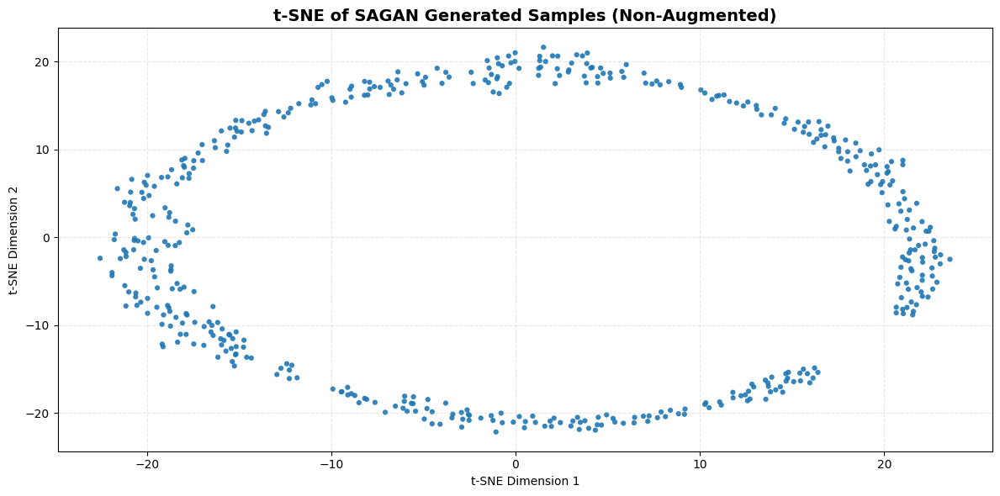

In [ ]:
# =========== Generate z and c for InfoGAN =========== #
latent_dim = 160
code_dim = 2
z = tf.random.normal([500, latent_dim])
c = tf.random.uniform([500, code_dim], minval=-1.0, maxval=1.0)

# =========== ℓ₂-Normalise =========== #
z = tf.math.l2_normalize(z, axis=1)
c = tf.math.l2_normalize(c, axis=1)

# =========== Concatenate z and c ===========
zc = tf.concat([z, c], axis=1)

# =========== Generate Images =========== #
generated_images = generator(zc, training=False)
generated_images = (generated_images + 1) / 2.0

def plot_tsne_embeddings(generated_images, save_path=None, title="t-SNE of SAGAN Generated Samples (Non-Augmented)"):
    # ----- Convert to [0, 1] Range ----- #
    if tf.reduce_max(generated_images).numpy() > 1.0:
        raise ValueError("Images should be in [-1, 1] range before scaling.")

    images_rescaled = (generated_images + 1.0) / 2.0
    flat_images = images_rescaled.numpy().reshape(images_rescaled.shape[0], -1)

    # ----- Run t-SNE ----- #
    tsne = TSNE(n_components=2, perplexity=30, learning_rate='auto', init='pca', random_state=42)
    tsne_proj = tsne.fit_transform(flat_images)

    # ----- Plot t-SNE ----- #
    plt.figure(figsize=(12, 6))
    sns.scatterplot(
        x=tsne_proj[:, 0],
        y=tsne_proj[:, 1],
        s=20,
        alpha=0.9,
        edgecolor='none'
    )
    plt.title(title, fontsize=14, weight='bold')
    plt.xlabel("t-SNE Dimension 1")
    plt.ylabel("t-SNE Dimension 2")
    plt.grid(True, linestyle='--', alpha=0.3)
    plt.tight_layout()

    if save_path:
        plt.savefig(save_path, dpi=300)
        print(f"t-SNE plot saved to: {save_path}")

    plt.show()

plot_tsne_embeddings(generated_images=generated_images)

With reference to the t-SNE plot of SAGAN generated samples (Non-Augmented) above, we are able to make the following observations:

**Globally Structured but Slightly Irregular**

- The distribution forms an approximate elliptical ring, similar to InfoGAN, suggesting that SAGAN has also learned a well-disentangled latent space.

- However, the circularity is slightly asymmetric, indicating some minor inconsistencies in sample spread.

**Strong Use of Attention Mechanism**

- The globally coherent layout may reflect SAGAN's self-attention mechanism, which enables the model to capture long-range dependencies and maintain structural uniformity in generation.

- Such structure implies that the generator is attending to consistent global features, even in a non-label-conditioned setting.

**High Diversity without Outliers**

- Unlike some GANs that produce scattered t-SNE plots, the SAGAN plot shows very few outlier points, indicating stable mode usage and effective latent navigation.

- Diversity is maintained within the curve, suggesting a balanced generative process.

**Slight Curvature Bias**

- The stretching along the horizontal axis suggests a potential latent axis bias, where certain dimensions may dominate latent transformations.

- Still, the manifold shape remains compact and continuous, showing a good trade-off between flexibility and control.

With the observations indicated above, we will proceed to the next section to conduct GAN Model Training on Augmented Data.

---
# 5. GAN Model Training for Augmented EMNIST Data

In this section, we will be training various Generative Adversarial Network (GAN) Models from scratch. Subsequently, we will compare all the GAN Models against each other to obtain the Best Model which will subsequently be used to compare to the EMNIST Training Data with Augmentation. Subsequently, we will perform further comparison and analysis with the best GAN Model.

---
## 5.1 Vanilla GAN Model Training

In this sub-section, we will be training a Vanilla GAN for the EMNIST Dataset. The Vanilla GAN will also provide a strong and suitable baseline for the future GAN Models that we will be training. Due to the Simplicity of Vanilla GAN, it will most likely be able to handle the EMNIST Dataset well. A Vanilla GAN is the most basic GAN which mainly consist of Two Neural Networks trained in opposition, namely the Generator and the Discriminator. Both of the Neural Network will compete in a 'Minimax Game' where the Generator tries to 'fool' the Discriminator with realistic generated images and the Discriminator tries to tell apart real and generated images. The relevant formulas for the Vanilla GAN is indicated below:

---
**Minimax Objective (Vanilla GAN Loss):**

Purpose: Original Adversarial Objective where Generator $G$ tries to Fool Discriminator $D$, while $D$ tries to Distinguish Real Samples from Fake Ones.

$$
\min_G \max_D V(D, G) = \mathbb{E}_{x \sim p_{\text{data}}(x)}[\log D(x)] + \mathbb{E}_{z \sim p_z(z)}[\log (1 - D(G(z)))]
$$

Where:
- $G$ = Generator Network
- $D$ = Discriminator Network
- $x$ = Real Data Sample
- $z$ = Random Noise Vector
- $p_{\text{data}}(x)$ = Distribution of Real Data
- $p_z(z)$ = Prior Distribution of Noise (e.g., $\mathcal{N}(0, I)$)
- $D(x)$ = Probability that $x$ is Real
- $D(G(z))$ = Probability that Generated Image is Real

---
**Discriminator Loss (Optimisation Form):**

Purpose: Loss used to Train the Discriminator to Assign High Probability to Real Data and Low Probability to Fake Data.

$$
L_D = -\mathbb{E}_{x \sim p_{\text{data}}(x)}[\log D(x)] - \mathbb{E}_{z \sim p_z(z)}[\log (1 - D(G(z)))]
$$

Where:
- $L_D$ = Discriminator Loss
- First Term Penalises Misclassifying Real Data as Fake
- Second Term Penalises Misclassifying Fake Data as Real

---
**Generator Loss (Original Formulation):**

Purpose: Commonly used in Practice due to Stronger Gradients to Generator, helping it Train more Effectively when Discriminator is Performing Well.


$$
L_G = \mathbb{E}_{z \sim p_z(z)}[\log (1 - D(G(z)))]
$$

Where:
- $L_G$ = Generator Loss
- $G$ = Generator Network
- $D$ = Discriminator Network

---
**Noise Vector Sampling:**

Purpose: The Generator takes a Random Noise Vector $z$ from a Known Distribution as Input and Transforms it into a Realistic Image.

$$
z \sim \mathcal{N}(0, I) \quad \text{or} \quad z \sim U(-1, 1)
$$

Where:
- $z$ = Latent Noise Vector Sampled from Standard Normal or Uniform Distribution
- $G(z)$ = Generator Transforms $z$ into Synthetic Image

---
With the relevant mathematical formulas indicated above, we will proceed to train the Vanilla GAN in this sub-section for the purpose of it's simplicity and also to serve as a Baseline for our other GAN Models.

---
### 5.1.1 Defining Data Pre-Processing Function

In this sub-section, we will be defining the Data Pre-Processing Function which will allow for consistent Data Pipeline to be built and modifed accordingly should the need arise such as when we need to add Spectral Normalisation. This will ensure that the Data's integrity is not affected and we are able to make fair and un-biased assumptions. The Data Pre-Processing Function is defined in the Code Cell below:

In [ ]:
# ========== Date Pre-Processing Function ========== #
def load_data():
    global X_train, datagen

    batch_size = 16
    steps_per_epoch = X_train.shape[0] // batch_size

    datagen_iter = datagen.flow(X_train, batch_size=batch_size)

    dataset = tf.data.Dataset.from_generator(
        lambda: (next(datagen_iter) for _ in range(steps_per_epoch)),
        output_signature=tf.TensorSpec(shape=(batch_size, 28, 28, 1), dtype=tf.float32)
    )

    return dataset

With reference to the Code Cell above, we are able to determine that the Data Pre-Processing Function have been defined successfully and we are able to move on to Defining Callback Functions in the next sub-section.

---
### 5.1.2 Defining Callback Functions

In this sub-section, we will be pre-defining the various Callbacks. This is to ensure consistency throughout the model and also to increase the GAN Accuracy and optimise the Computation Cost for training each GAN Model. These Callbacks will be main used during the GAN Training in the next sub-section. The formulas and logic for these Callbacks are indicated below:

---
**Learning Rate Scheduler:**

Purpose: Reduces Learning Rate During Training to Fine-tune Model Convergence.

$$\text{If } epoch \mod 10 = 0 \Rightarrow \eta_{new} = \frac{1}{2} \cdot \eta$$

Where:

- $\eta$ = current learning rate

- $\eta_{\text{new}}$ = updated learning rate

- $epoch \bmod 10$ checks if the epoch is a multiple of 10

---
**ReduceLROnPlateau:**

Purpose: Automatically Reduces the Learning Rate when Validation Performance Plateaus.

$$
\text{If no improvement in } val\_loss \text{ for 10 epochs: } \eta_{\text{new}} = 0.5 \cdot \eta
$$

Where:

- $\eta_{\text{new}}$ = reduced learning rate

---
**EarlyStopping:**

Purpose: Prevents Wastage of Computational Power if Model Does Not Improve.

$$
\text{If } val\_loss \text{ does not improve for 25 epochs, stop training and restore best weights}
$$

---
With the formulas and Various Callbacks listed, we will proceed to Define the Callbacks in the Code Cell below in preparation for the GAN Model Training.

In [ ]:
# ========== Define Learning Rate Scheduler ========== #
lr_scheduler = LearningRateScheduler(
    lambda epoch, lr: lr * 0.95 if epoch % 10 == 0 else lr,
    verbose=1
)

# ========== Define Reduce Learning Rate on Plateau ========== #
reduce_lr = ReduceLROnPlateau(
    monitor='loss',
    factor=0.5,
    patience=10,
    verbose=1,
    min_lr=1e-6
)

# ========== Define Early Stopping ========== #
early_stop = EarlyStopping(
    monitor='loss',
    patience=25,
    verbose=1,
    restore_best_weights=False
)

# ========== Define Generated Image ========== #
def display_generated_images(generator, latent_dim, n=7):
    noise = tf.random.normal([n * n, latent_dim])
    generated_images = generator(noise, training=False)

    # ----- Rescale from [-1, 1] to [0, 1] ----- #
    generated_images = (generated_images + 1.0) / 2.0

    fig, axes = plt.subplots(n, n, figsize=(n, n))
    for i in range(n):
        for j in range(n):
            img = generated_images[i * n + j, :, :, 0]
            axes[i, j].imshow(img, cmap='gray')
            axes[i, j].axis('off')

    plt.tight_layout()
    plt.show()

# ========== Define FID Calculator ========== #
_inception_model = InceptionV3(
    include_top=False,
    pooling='avg',
    input_shape=(299,299,3)
)

def calculate_fid(real_images, fake_images, batch_size=10):

    # ----- Scale to [0,255] and Resize to 299×299 ----- #
    real = (real_images + 1.0) * 127.5
    fake = (fake_images + 1.0) * 127.5
    real = tf.image.resize(real, (299,299))
    fake = tf.image.resize(fake, (299,299))

    # ----- If Grayscale, Convert to RGB ----- #
    if real.shape[-1] == 1:
        real = tf.image.grayscale_to_rgb(real)
        fake = tf.image.grayscale_to_rgb(fake)

    # ----- Preprocess for Inception (–1 to +1) ----- #
    real_pp = preprocess_input(real)
    fake_pp = preprocess_input(fake)

    # ----- Extract Features in Batches ----- #
    def _get_acts(x):
        acts = []
        n = x.shape[0]
        for i in range(0, n, batch_size):
            chunk = x[i:i+batch_size]
            acts.append(_inception_model(chunk, training=False).numpy())
        return np.vstack(acts)

    act_real = _get_acts(real_pp)
    act_fake = _get_acts(fake_pp)

    # ----- Compute Statistics ----- #
    mu1, sigma1 = act_real.mean(axis=0), np.cov(act_real, rowvar=False)
    mu2, sigma2 = act_fake.mean(axis=0), np.cov(act_fake, rowvar=False)
    diff    = mu1 - mu2
    covmean = sqrtm(sigma1.dot(sigma2))
    if np.iscomplexobj(covmean):
        covmean = covmean.real
    fid = diff.dot(diff) + np.trace(sigma1 + sigma2 - 2*covmean)
    return float(np.round(fid,4))

# ========== Confirmation Message ========== #
print("Callbacks Defined Successfully")

Callbacks Defined Successfully


With reference to the Code Cell above, we are able to verify that that the Callbacks have been successfully defined and the various parameters are set so as to ensure a High Accuracy and Computing Efficient GAN Model Training.

---
### 5.1.3 Defining Vanilla GAN Generator Architecture

In this section, we will be defining the Vanilla GAN's Generator Architecture. The Generator will be trying to make realistic generated images in the attempt to bypass the Discriminator. Subsequently, the generated images from the Generator will be evaluated based on a few evaluation metrics such as Inception Score. The relevent mathematical formulas for the Loss Function of the Vanilla GAN Generator is indicated below:

---

**Generator Loss Formula**

Purpose: Non-saturating Generator Loss encouraging Generator $G$ to Produce Outputs $G(z)$ that Discriminator $D$ Classifies as Real (i.e., closer to 1).

$$
L_G = -\mathbb{E}_{z \sim p_z(z)}[\log D(G(z))]
$$

Where:
- $L_G$ = Generator Loss  
- $z$ = Latent Vector Drawn from Noise Distribution $p_z(z)$ (e.g. Normal or Uniform)  
- $G(z)$ = Generated Fake Image from Noise  
- $D(G(z))$ = Probability Assigned by the Discriminator that the Generated Image is Real  
- $\log D(G(z))$ = Log-likelihood that Fake Image is Considered Real
---
With the relevant Generator Loss Formula indicated above, we will proceed to define the GAN Generator's Architecture in the Code Cell below and the Lost Function.

In [ ]:
# ========== Generator Function ========== #
def build_generator(latent_dim=100, units=256, output_shape=(28, 28, 1)):
    model = tf.keras.Sequential(name="generator")

    model.add(tf.keras.layers.Dense(units, activation='relu', input_dim=latent_dim))
    model.add(tf.keras.layers.BatchNormalization())

    model.add(tf.keras.layers.Dense(units * 2, activation='relu'))
    model.add(tf.keras.layers.BatchNormalization())

    model.add(tf.keras.layers.Dense(np.prod(output_shape), activation='tanh'))
    model.add(tf.keras.layers.Reshape(output_shape))

    return model

# ========== Initialise Loss ========== #
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=False)

# ========== Generator Loss Function ========== #
def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output), fake_output)

With reference to the Code Cell above, we are able to verify that the GAN's Generator Architecture have been successfully defined and we are able to proceed to define the GAN's Discriminator Architecture.

---
### 5.1.4 Defining Vanilla GAN Discriminator Architecture

In this section, we will be defining the Architecture of the Discriminator of the GAN. The Discriminator will be the Neural Network that will attempt to tell the Generated Images apart from the Actual Images. This will allow the GAN to improve overtime and also improve itself overtime. The mathematical function for the Discriminator Loss Function is indicated below:

---

Purpose: Train Discriminator $D$ to Distinguish between Real and Fake Samples, Rewarding High Confidence in Real Images ($D(x) \to 1$) and Low Confidence in Fake Ones ($D(G(z)) \to 0$).

$$
L_D = -\mathbb{E}_{x \sim p_{\text{data}}(x)}[\log D(x)] - \mathbb{E}_{z \sim p_z(z)}[\log (1 - D(G(z)))]
$$

Where:
- $L_D$ = Discriminator Loss  
- $x$ = Real Image Sampled from the Dataset Distribution $p_{\text{data}}(x)$  
- $z$ = Latent Vector from Prior Noise Distribution $p_z(z)$  
- $G(z)$ = Fake Image Generated by $G$
- $D(x)$ = Discriminator's Predicted Probability that $x$ is Real  
- $D(G(z))$ = Discriminator's Predicted Probability that $G(z)$ is Real  
- $\log D(x)$ = Log-likelihood that Real Image is Correctly Classified  
- $\log(1 - D(G(z)))$ = Log-likelihood that Fake Image is Correctly Rejected
---
With the mathematical formula for the Loss Function indicated above, we will proceed to define the GAN's Discriminator Architecture and the Loss Function in the Code Cell below.

In [ ]:
# ========== Discriminator Function ========== #
def build_discriminator(input_shape=(28, 28, 1), units=256):
    model = tf.keras.Sequential(name="discriminator")

    model.add(tf.keras.layers.Flatten(input_shape=input_shape))

    model.add(tf.keras.layers.Dense(units))
    model.add(tf.keras.layers.LeakyReLU(alpha=0.2))

    model.add(tf.keras.layers.Dense(units // 2))
    model.add(tf.keras.layers.LeakyReLU(alpha=0.2))

    model.add(tf.keras.layers.Dense(1, activation='sigmoid'))

    return model

# ========== Discriminator Loss Function ========== #
def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    return real_loss + fake_loss

With reference to the Code Cell above, we are able to verify that the GAN's Discriminator Architecture have been successfully defined and we are able to proceed to define the GAN's Training Steps.

---
### 5.1.5 Defining Training Step

In this section, we will be Defining the Training Step function so as to train both the Generator and the Discriminator at the same time. The Training Step will compute the gradients for both the Generator and the Discriminator at the same time. The relevant mathematical formulas for the Training Step is indicated below:

---
**Generator Loss:**

Purpose: Encourages the Generator to Create Samples that the Discriminator believes are Real.

$$
L_G = -\mathbb{E}_{z \sim p_z(z)}[\log D(G(z))]
$$

Where:
- $L_G$ = Generator Loss  
- $z$ = Latent Noise Vector Sampled from Prior Distribution $p_z(z)$  
- $G(z)$ = Fake Image Generated from $z$  
- $D(G(z))$ = Discriminator's Probability that the Generated Image is Real
---

Purpose: Train Discriminator $D$ to Distinguish between Real and Fake Samples, Rewarding High Confidence in Real Images ($D(x) \to 1$) and Low Confidence in Fake Ones ($D(G(z)) \to 0$).

$$
L_D = -\mathbb{E}_{x \sim p_{\text{data}}(x)}[\log D(x)] - \mathbb{E}_{z \sim p_z(z)}[\log (1 - D(G(z)))]
$$

Where:
- $L_D$ = Discriminator Loss  
- $x$ = Real Image Sampled from the Dataset Distribution $p_{\text{data}}(x)$  
- $z$ = Latent Vector from Prior Noise Distribution $p_z(z)$  
- $G(z)$ = Fake Image Generated by $G$
- $D(x)$ = Discriminator's Predicted Probability that $x$ is Real  
- $D(G(z))$ = Discriminator's Predicted Probability that $G(z)$ is Real  
- $\log D(x)$ = Log-likelihood that Real Image is Correctly Classified  
- $\log(1 - D(G(z)))$ = Log-likelihood that Fake Image is Correctly Rejected
---

**Gradient Update:**

Purpose: Updates the Generator and Discriminator Parameters using Gradient Descent.

$$
\theta_G \leftarrow \theta_G - \eta \cdot \nabla_{\theta_G} L_G \\
\theta_D \leftarrow \theta_D - \eta \cdot \nabla_{\theta_D} L_D
$$

Where:
- $\theta_G$ = Generator Parameters  
- $\theta_D$ = Discriminator Parameters  
- $\eta$ = Learning Rate  
- $\nabla_{\theta} L$ = Gradient of Loss with Respect to Model Weights
---

With the relevant mathematical formulas indicated above, we will proceed to define the Training Step in the Code Cell below.

In [ ]:
# ========== Train Step Function ========== #
@tf.function
def train_step(real_images, generator, discriminator, gen_optimizer, disc_optimizer, latent_dim):
    batch_size = tf.shape(real_images)[0]
    noise = tf.random.normal([batch_size, latent_dim])

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        # ----- Forward Pass ----- #
        generated_images = generator(noise, training=True)

        real_output = discriminator(real_images, training=True)
        fake_output = discriminator(generated_images, training=True)

        # ----- Compute Losses ----- #
        gen_loss = generator_loss(fake_output)
        disc_loss = discriminator_loss(real_output, fake_output)

    # ----- Compute Gradients ----- #
    gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

    # ----- Apply Gradients ----- #
    gen_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    disc_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))

    return gen_loss, disc_loss

With reference to the Code Cell above, we are able to determine that the Training Step have been successfully defined and we are able to proceed to prepare the Training Loop in the next section.

---
### 5.1.6 Defining Training Loop

In this section, we will be defining the Training Loop for the GAN Training. The Training Loop will go through each of the Epoch and train both the Generator and Discriminator simultaneously. The Training Loop will also track the Loss for both the Generator and the Discriminator for each of the Epoch trained. The relevant mathematical formulas are indicated below:

---
**Epoch Loss Averaging:**

Purpose: These are the Average Generator and Discriminator Losses over all Batches in Epoch $t$.

$$
\bar{L}_G^{(t)} = \frac{1}{N} \sum_{i=1}^{N} L_G^{(i)} \\
\bar{L}_D^{(t)} = \frac{1}{N} \sum_{i=1}^{N} L_D^{(i)}
$$

Where:
- $\bar{L}_G^{(t)}$ = Average Generator Loss at Epoch $t$  
- $\bar{L}_D^{(t)}$ = Average Discriminator Loss at Epoch $t$  
- $N$ = Number of Batches in the Dataset  
- $L_G^{(i)}$ = Generator Loss on Batch $i$  
- $L_D^{(i)}$ = Discriminator Loss on Batch $i$

---
**Epoch Iteration:**

Purpose: Describes the Training Loop Logic: for Each Epoch $t$, perform `train_step` for Every Mini-batch.

$$
\text{for } t = 1 \text{ to } T:
\quad \text{for each batch } (x^{(i)}):
\quad \text{train_step}(x^{(i)})
$$

Where:
- $T$: Total Number of Epochs  
- $x^{(i)}$: Real Batch $i$ from the Dataset  
- `train_step`: Function that Updates $G$ and $D$ using that Batch

---
**Generated Image Output:**

Purpose: Sample Random Noise $z$ and Generate Synthetic Image $\hat{x}$ from the Generator. This is used for Visual Monitoring of Model Quality.

$$
z \sim p_z(z) \\
\hat{x} = G(z)
$$

Where:
- $z$: Random Latent Vector  
- $G(z)$: Generated Image from Generator

---
With the mathematical formulas indicated above, we will proceed to define the Training Loop in the Code Cell below in preparation of the GAN Training.

In [ ]:
# ========== Training Loop Function ========== #
def train(dataset, epochs, generator, discriminator, gen_optimizer, disc_optimizer,
          latent_dim, save_path, use_early_stopping=True, steps_per_epoch=None):

    # ----- Prepare FID Reference Sets ----- #
    real_val  = tf.data.Dataset.from_tensor_slices(X_val).batch(50).take(1)
    noise_val = tf.random.uniform([50, latent_dim], minval=-1.0, maxval=1.0)
    noise_val = tf.math.l2_normalize(noise_val, axis=1)

    # ----- FID Early Stopping Settings ----- #
    best_fid    = float('inf')
    no_improve  = 0
    patience    = 10
    fid_interval = 1

    # ----- Create & Compile Dummy Model ----- #
    dummy_input  = Input(shape=(1,))
    dummy_output = Lambda(lambda x: x)(dummy_input)
    dummy_model  = Model(dummy_input, dummy_output)
    dummy_model.compile(optimizer=Adam(1e-4), loss='mse')

    # ----- Attach Dummy Model to Callbacks ----- #
    early_stop.set_model(dummy_model)
    reduce_lr.set_model(dummy_model)
    lr_scheduler.set_model(dummy_model)

    # ----- Simulate Keras Callback Start ----- #
    logs = {}
    early_stop.on_train_begin(logs=logs)
    reduce_lr.on_train_begin(logs=logs)
    lr_scheduler.on_train_begin(logs=logs)

    # ----- Initialise Loss Trackers ----- #
    gen_loss_history  = []
    disc_loss_history = []

    # ----- Begin Training Loop ----- #
    for epoch in range(1, epochs + 1):
        print(f"\nEpoch {epoch}/{epochs}")

        gen_loss_epoch  = []
        disc_loss_epoch = []

        for i, real_images in enumerate(dataset):
            if steps_per_epoch and i >= steps_per_epoch:
                break

            # ----- One Step of Generator & Discriminator Updates ----- #
            gen_loss, disc_loss = train_step(
                real_images, generator, discriminator,
                gen_optimizer, disc_optimizer, latent_dim
            )
            gen_loss_epoch.append(gen_loss)
            disc_loss_epoch.append(disc_loss)

        # ----- Epoch Statistics ----- #
        avg_gen_loss  = tf.reduce_mean(gen_loss_epoch)
        avg_disc_loss = tf.reduce_mean(disc_loss_epoch)

        print(f"Generator Loss: {avg_gen_loss:.4f} | Discriminator Loss: {avg_disc_loss:.4f}")

        # ----- Track Loss History ----- #
        gen_loss_history.append(float(avg_gen_loss))
        disc_loss_history.append(float(avg_disc_loss))

        # ----- Simulate Callback Updates on Generator Loss ----- #
        logs = {'loss': float(avg_gen_loss)}
        if use_early_stopping:
            early_stop.on_epoch_end(epoch=epoch, logs=logs)
            if early_stop.stopped_epoch > 0:
                print(f"Early stopping triggered at epoch {epoch}")
                break
        reduce_lr.on_epoch_end(epoch=epoch, logs=logs)
        lr_scheduler.on_epoch_end(epoch=epoch, logs=logs)

        # ----- FID Evaluation & Early Stopping ----- #
        if epoch % fid_interval == 0:
            fake_val   = generator(noise_val, training=False)
            real_batch = next(iter(real_val))

            real_for_fid = tf.image.resize(real_batch, [299,299]) * 0.5 + 0.5
            fake_for_fid = tf.image.resize(fake_val,    [299,299]) * 0.5 + 0.5

            fid_value = calculate_fid(real_for_fid, fake_for_fid)
            print(f"Epoch {epoch} → Val FID: {fid_value:.2f}")

            if fid_value < best_fid:
                best_fid, no_improve = fid_value, 0
                if save_path:
                    os.makedirs(save_path, exist_ok=True)
                    generator.save_weights(os.path.join(save_path, "best_gen.weights.h5"))
                    discriminator.save_weights(os.path.join(save_path, "best_disc.weights.h5"))
            else:
                no_improve += 1

            if no_improve >= patience:
                print(f"No FID improvement for {patience} epochs, stopping.")
                break

        # ----- Image Visualisation Every 10 Epochs ----- #
        if save_path and epoch % 10 == 0:
            display_generated_images(generator, latent_dim)

    # ----- Restore Best Weights After Training ----- #
    if save_path:
        best_gen_path = os.path.join(save_path, "best_gen.weights.h5")
        best_disc_path = os.path.join(save_path, "best_disc.weights.h5")
        if os.path.exists(best_gen_path) and os.path.exists(best_disc_path):
            generator.load_weights(best_gen_path)
            discriminator.load_weights(best_disc_path)
            print("Restored best generator and discriminator weights based on lowest FID.")
        else:
            print("Best weight files not found. Skipping restore.")

    return avg_gen_loss, gen_loss_history, disc_loss_history

With reference to the Code Cell above, we are able to determine that the Training Loop have been successfully defined and we are able to proceed to define the Optimisers with Tunable Parameter in preparation for the Optuna Tuning.

---
### 5.1.7 Defining Optimisers with Tunable Parameters

In this section, we will be defining the Common Optimisers that will be Tuned using the Optuna Tuning. The Optimisers will each have a range of values in a list so as to allow for the Optuna to search for the best Hyperparameter for the GAN. Through these parameters, it will affect how effective and efficiently the GAN will learn from the provided EMNIST Data. The relevent mathematical formula is indicated below:

---
**Optimiser Update Rule**

Purpose: Parameter Update Step in the Adam Optimiser, using Adaptive Learning Rates with Momentum.

$$
\theta \leftarrow \theta - \eta \cdot \frac{m_t}{\sqrt{v_t} + \epsilon}
$$

Where:
- $\theta$ = Model Parameters (Generator or Discriminator)
- $\eta$ = Learning Rate (Tuned)
- $m_t$ = First Moment Estimate (Mean of Gradients)
- $v_t$ = Second Moment Estimate (Variance of Gradients)
- $\epsilon$ = Small Constant for Numerical Stability

---
With the mathematical formula indicated above, we will proceed to define the Optimisers in the Code Cell.

In [ ]:
def objective(trial):
    # ----- Hyperparameters ----- #
    latent_dim    = trial.suggest_categorical('latent_dim', [64, 100, 128])
    gen_units     = trial.suggest_categorical('gen_units', [128, 256, 512])
    disc_units    = trial.suggest_categorical('disc_units', [128, 256, 512])
    learning_rate = trial.suggest_float('learning_rate', 1e-5, 1e-3, log=True)
    beta_1        = trial.suggest_float('beta_1', 0.5, 0.9)

    # ----- Build Models ----- #
    generator     = build_generator(latent_dim=latent_dim, units=gen_units)
    discriminator = build_discriminator(units=disc_units)

    # ----- Optimisers ----- #
    gen_optimizer = Adam(learning_rate=learning_rate, beta_1=beta_1)
    disc_optimizer= Adam(learning_rate=learning_rate, beta_1=beta_1)

    # ----- Init Optimisers ----- #
    _ = gen_optimizer.apply_gradients([(tf.zeros_like(v), v) for v in generator.trainable_variables])
    _ = disc_optimizer.apply_gradients([(tf.zeros_like(v), v) for v in discriminator.trainable_variables])

    # ----- Load Data ----- #
    dataset = load_data()
    steps   = min(1000, len(X_train)//32)

    # ----- Train ----- #
    _ = train(dataset, epochs=100,
              generator=generator,
              discriminator=discriminator,
              gen_optimizer=gen_optimizer,
              disc_optimizer=disc_optimizer,
              latent_dim=latent_dim,
              steps_per_epoch=steps,
              save_path=False
              )

    # ----- Evaluate with FID ----- #
    z = tf.random.uniform([1000, latent_dim], -1.0, 1.0)
    fake = generator(z, training=False)
    fake = (fake + 1.0)/2.0
    real = X_val[:1000]
    fid_score = calculate_fid(real, fake)
    return fid_score

With reference to the Code Cell above, we are able to determine that the Optimiser have been successfully defined with a range of different Parameter Values so as to provide a robust Optuna Tuning in the subsequent sections.

---
### 5.1.8 Optuna Tuning Study

In this sub-section, we will be conducting the Optuna Tuning Study on the GAN Model so as to obtain the best Hyperparameter for the GAN Model. It is expected that the Tuning takes a prolonged duration due to the nature of how the GAN works and the 2 Neural Networks involved. However, the training data will be stored so as to prevent re-running of repetitive codes. The Optuna Tuning Study will be conducted in the Code Cell below.

In [ ]:
# ========== Create or Load Study with SQLite Backend ========== #
study = optuna.create_study(
    direction="minimize",
    study_name="vanilla_gan_tuning",
    storage="sqlite:////content/drive/MyDrive/Colab Notebooks/DELE CA2 A/Augmented GAN Tunings/vanilla_gan_optuna.db",
    load_if_exists=True
)

# ========== Trial Management ========== #
MAX_TRIALS = 50
completed_trials = len([t for t in study.trials if t.state == optuna.trial.TrialState.COMPLETE])
remaining_trials = MAX_TRIALS - completed_trials

if remaining_trials > 0:
    print(f"Resuming study: {completed_trials} completed, running {remaining_trials} more.")
    study.optimize(objective, n_trials=remaining_trials)
else:
    print(f"Study already completed {MAX_TRIALS} trials. Skipping optimisation.")

# ========== Output Best Trial ========== #
best_trial = study.best_trial
best_params_df = pd.DataFrame([best_trial.params])
best_params_df["Final FID"] = best_trial.value
best_params_df.style.background_gradient(cmap="Blues")

[I 2025-08-10 11:10:17,815] Using an existing study with name 'vanilla_gan_tuning' instead of creating a new one.


Study already completed 50 trials. Skipping optimisation.


,latent_dim,gen_units,disc_units,learning_rate,beta_1,Final FID
0,64,512,512,0.000206,0.804649,110.851800


With reference to the Code Cell above, we are able to view the Best Hyperparameter obtained during the Optuna Tuning Study. This Hyperparameter will be extracted and be trained for a longer period of time so as to attempt to increase the performance and limit the loss for the GAN.

---
### 5.1.9 GAN Re-Training Operation

As obtained from the previous sub-section, we will be re-training the GAN using the best Hyperparameter obtained during the Optuna Tuning Study. This is to push the GAN Model to its limits and also to save Computational Power as we are not taking up prolonged periods of time tuning GAN Models which may not have any clear signs of good performance. The retraining of the GAN Model will be conducted in the Code Cell below.

In [ ]:
# =========== Extract Best Parameters from Study =========== #
best_params = study.best_trial.params

latent_dim  = best_params['latent_dim']
gen_units   = best_params['gen_units']
disc_units  = best_params['disc_units']
learning_rate = best_params['learning_rate']
beta_1      = best_params['beta_1']

print("Using best trial parameters:")
print(best_params)

# =========== Rebuild Models =========== #
generator     = build_generator(latent_dim=latent_dim, units=gen_units)
discriminator = build_discriminator(units=disc_units)

gen_optimizer  = tf.keras.optimizers.Adam(learning_rate=learning_rate, beta_1=beta_1)
disc_optimizer = tf.keras.optimizers.Adam(learning_rate=learning_rate, beta_1=beta_1)

_ = gen_optimizer.apply_gradients([(tf.zeros_like(v), v) for v in generator.trainable_variables])
_ = disc_optimizer.apply_gradients([(tf.zeros_like(v), v) for v in discriminator.trainable_variables])

# =========== Reload Dataset =========== #
dataset = load_data()

# =========== Define Save Paths =========== #
model_name   = "vanilla_gan"
output_dir   = "/content/drive/MyDrive/Colab Notebooks/DELE CA2 A/final_outputs_vanilla_gan_augment"
weights_path = os.path.join(output_dir, "augmented_vanilla_generator_final.weights.h5")
gen_ckpt     = os.path.join(output_dir, "best_gen.weights.h5")
disc_ckpt    = os.path.join(output_dir, "best_disc.weights.h5")
loss_csv     = os.path.join(output_dir, "loss_history.csv")

os.makedirs(output_dir, exist_ok=True)

# =========== Load or Train =========== #
if os.path.exists(gen_ckpt) and os.path.exists(disc_ckpt) and os.path.exists(loss_csv):
    print("All outputs found. Skipping training...")

    generator.load_weights(gen_ckpt)
    discriminator.load_weights(disc_ckpt)
    print("Augmented Vanilla GAN weights loaded.")

    loss_df = pd.read_csv(loss_csv)
    gen_loss_history  = loss_df['gen_loss'].tolist()
    disc_loss_history = loss_df['disc_loss'].tolist()
    final_gen_loss    = gen_loss_history[-1]

else:
    # =========== Train from Scratch =========== #
    final_gen_loss, gen_loss_history, disc_loss_history = train(
        dataset=dataset,
        epochs=1200,
        generator=generator,
        discriminator=discriminator,
        gen_optimizer=gen_optimizer,
        disc_optimizer=disc_optimizer,
        latent_dim=latent_dim,
        use_early_stopping=False,
        save_path=output_dir
    )

    # =========== Save Generator Weights =========== #
    generator.save_weights(weights_path)
    print("Generator Weights Saved.")

    # =========== Save Loss History =========== #
    loss_df = pd.DataFrame({
        'epoch': list(range(1, len(gen_loss_history) + 1)),
        'gen_loss': gen_loss_history,
        'disc_loss': disc_loss_history
    })
    loss_df.to_csv(loss_csv, index=False)
    print(f"Loss history saved to {loss_csv}")

Using best trial parameters:
{'latent_dim': 64, 'gen_units': 512, 'disc_units': 512, 'learning_rate': 0.00020565813699965218, 'beta_1': 0.8046485561106321}


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:93: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/reshaping/flatten.py:37: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/activations/leaky_relu.py:41: UserWarning: Argument `alpha` is deprecated. Use `negative_slope` instead.
  warnings.warn(


All outputs found. Skipping training...
Augmented Vanilla GAN weights loaded.


With reference to the Code Cell above, we are able to determine that the best GAN Model have been trained and saved successfully and we are able to proceed with the Model Evaluation in the next sub-sections where we determine how well the GAN Model performed based on various metrics and evaluation methodologies.

---
### 5.1.10 GAN Model Evaluation

In this sub-section, we will be evaluating the GAN's Generator performance on various aspects. We will be utilising different methodologies and metrics to attempt to quantify the performance of the GAN Generator while also conducting Visual Inspection on the result output of the GAN. The Evaluation will be conducted in the following sections.

---
#### 5.1.10.1 Visual Grid of Samples

In this sub-section, we will be visualising the Grid of Samples of the Synthesised Data generated by the GAN Model. A list of observations will be made before the utilisation of Quantitative Metrics to evaluate the GAN Generator's general performance. As the observations made are purely from professional opinion, it will most likely not be used as a Basis of Comparison between GAN Models due to differing opinions unless in extreme cases. The visualisation will be conducted in the Code Cell below.

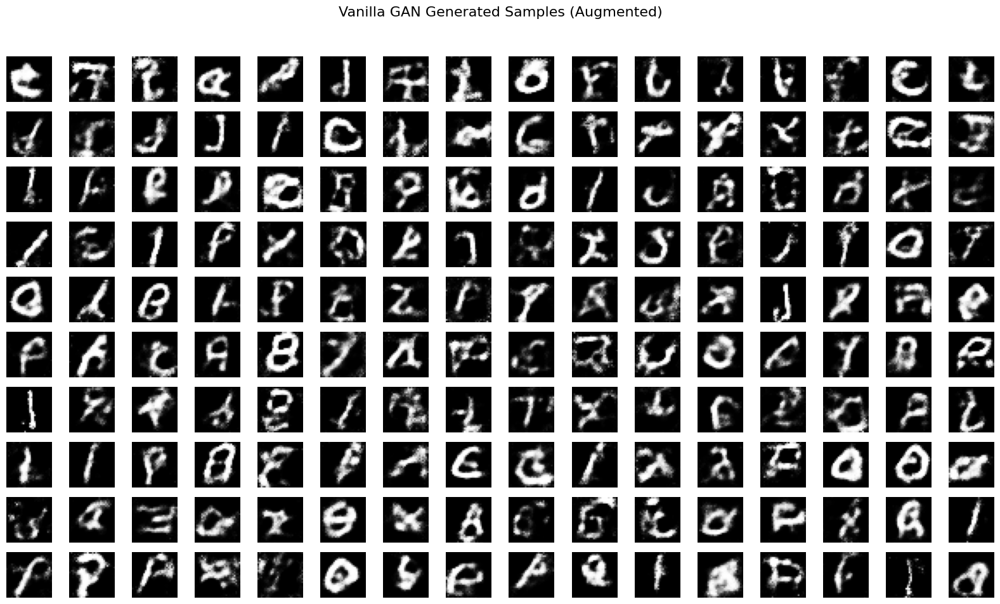

In [ ]:
# ========== Sample Generation Function ========== #
def plot_generated_images(generator, latent_dim, n_rows=5, n_cols=5, save_path=None, title="Vanilla GAN Generated Samples (Augmented)"):
    noise = tf.random.normal([n_rows * n_cols, latent_dim])
    gen_images = generator(noise, training=False)

    # ----- Rescale from [-1, 1] to [0, 1] ----- #
    gen_images = (gen_images + 1.0) / 2.0
    gen_images = tf.clip_by_value(gen_images, 0.0, 1.0)

    # ----- Check Shape ----- #
    assert gen_images.shape[-1] == 1, "Expected single-channel (grayscale) output"

    # ----- Plot Generated Image Grid ----- #
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols, n_rows))
    for i in range(n_rows * n_cols):
        ax = axes[i // n_cols, i % n_cols]
        ax.imshow(gen_images[i, :, :, 0], cmap='gray')
        ax.axis('off')

    # ----- Title & Layout ----- #
    plt.suptitle(title, fontsize=16)
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])

    # ----- Save if Requested ----- #
    if save_path:
        plt.savefig(save_path, dpi=300)
        print(f"Saved Generated Image Grid to: {save_path}")

    plt.show()

# ========== Plot Function Call ========== #
plot_generated_images(generator, latent_dim=64, n_rows=10, n_cols=16, save_path=None, title="Vanilla GAN Generated Samples (Augmented)")

With reference to the output of the Visual Grid of Samples above, we are able to make the following observations:

**Basic Structure of Letters is Somewhat Captured**

- Some samples loosely resemble "A", "P", "C", or "J".

- A few characters show curved or vertical structures typical of handwritten letters.

**High Blur and Noise**

- Many images appear grainy, with noisy pixel textures and inconsistent backgrounds.

- Several characters are overexposed or washed out, blending into the background.

**Poor Character Consistency**

- Several glyphs have malformed anatomy or appear as fragmented strokes.

- Some samples lack closed shapes or display irregular thickness in lines.

With the observations indicated above, we will proceed to conduct the Loss Curve Analysis in the next sub-section.

---
#### 5.1.10.2 Loss Curve Over Epochs

In this sub-section, we will be plotting the GAN Loss Curve over Epochs to evaluate the training behaviour of the GAN. This curve provides insight into whether the GAN is experiencing underfitting, overfitting, or achieving a stable training dynamic between the generator and discriminator.

Although GANs do not minimise a single unified loss in the traditional sense, the trajectory of the generator and discriminator losses can indicate whether the adversarial training process is converging appropriately.

If the generator loss remains high while discriminator loss quickly drops to near-zero, this may indicate **underfitting**, where the generator is not learning effectively to produce plausible images.

If the discriminator loss increases while generator loss sharply decreases, this may suggest **overfitting** or **mode collapse**, where the generator exploits narrow weaknesses in the discriminator without general improvement.

A relatively stable oscillation or convergence between both losses typically signifies a **well-balanced** training process, where the generator and discriminator are learning in tandem.

The Potential Observations and Corresponding Action Plans are outlined below:

**Underfitting Loss Curve**

- Increase training epochs to allow generator more time to learn.

- Simplify the discriminator to reduce overpowering the generator.

- Adjust the learning rate or apply label smoothing.

- Consider adding batch normalisation in the generator.

**Overfitting or Mode Collapse Loss Curve**

- Introduce or increase dropout in the discriminator.

- Apply input noise or label flipping to the discriminator.

- Evaluate diversity of generated samples regularly.

**Balanced/Ideal Loss Curve**

- Maintain current architecture and hyperparameters.

- Proceed with full-scale image generation.

- Evaluate both qualitative (visual inspection) and quantitative metrics (e.g. Inception Score or FID).

With these potential training behaviours and action plan outlined, we will proceed to visualise the GAN loss dynamics in the code cell below.



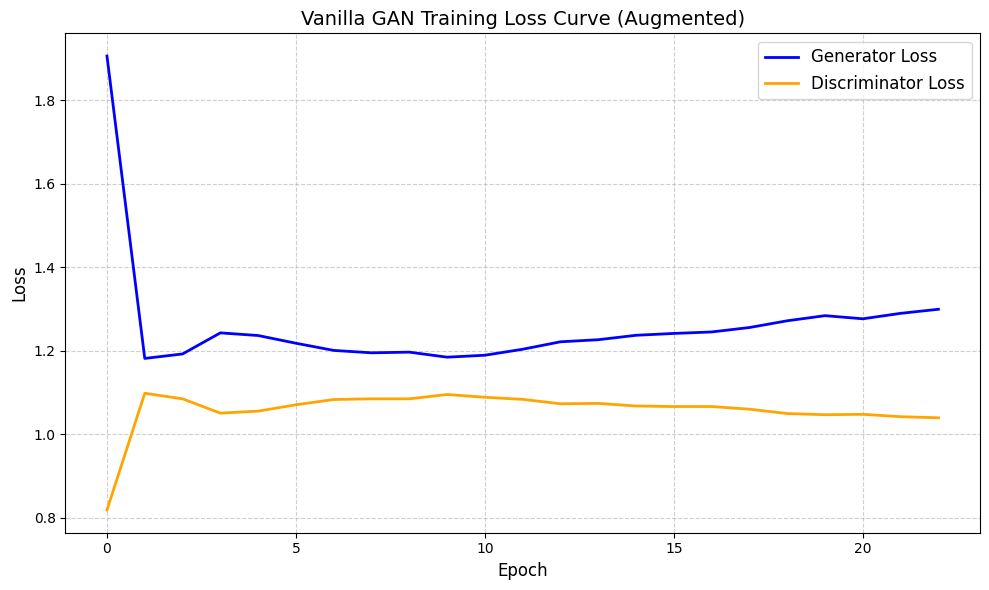

In [ ]:
# ========== Plot Size Configuration ========== #
plt.figure(figsize=(10, 6))

# ========== Loss Curve Plot ========== #
plt.plot(gen_loss_history, label="Generator Loss", linewidth=2, color='blue')
plt.plot(disc_loss_history, label="Discriminator Loss", linewidth=2, color='orange')

# ========== Labels and Title ========== #
plt.xlabel("Epoch", fontsize=12)
plt.ylabel("Loss", fontsize=12)
plt.title("Vanilla GAN Training Loss Curve (Augmented)", fontsize=14)

# ========== Grid and Size Configurarion ========== #
plt.grid(True, linestyle='--', alpha=0.6)
plt.legend(fontsize=12)
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)

# ========== Plot Display ========== #
plt.tight_layout()
plt.show()

With reference to the output of the Learning Curve visualisation above, we are able to make the following observations below:

**Initial Instability**

- Both Generator and Discriminator losses exhibit sharp fluctuations in the initial epochs, which is typical during early adversarial training.

**Discriminator Dominance**

- The Discriminator Loss remains significantly higher than the generator loss throughout training, suggesting the Discriminator is stronger and more confident in distinguishing real from fake images.

**Gradual Increase in Generator Loss**

- The Generator loss shows a slow upward trend across epochs, indicating that it is struggling to improve image quality or effectively fool the Discriminator.

**Stable but Divergent Loss Patterns**

- After the initial phase, both losses stabilise but do not converge. This suggests a suboptimal equilibrium, where the Generator is not learning as effectively as desired.

**No Clear Oscillatory Behaviour**

- The expected adversarial oscillations between generator and discriminator are largely absent, implying limited competition between the two networks.

**Potential Underfitting**

- The persistent gap between the Generator and Discriminator Losses, along with the increasing Generator loss, suggests the Generator may be Underfitting or unable to keep pace with the Discriminator.

With the observations indicated above, we will proceed to conduct the next GAN Model Evaluation in the next sub-section.

---
#### 5.1.10.3 Quantitative Metrics Evaluation

In this sub-section we will be utilising Quantitative Metrics such as FID and KID to tabulate the results of the performance and quantify the performance of the GAN Generator. We will subsequently be use these metrics to conduct inter-model evaluation after tuning and training all the GANs. The metrics that we will be utilising and their respective formulas are indicated below:

---
**Fréchet Inception Distance**

Purpose: Measures the Distance between the Real-Image and Generated-Image Distributions in Inception Feature Space.

$$
\mathrm{FID} \;=\;\|\mu_r - \mu_f\|^2
\;+\;\mathrm{Tr}\Bigl(\Sigma_r + \Sigma_f - 2\,(\Sigma_r\,\Sigma_f)^{\tfrac12}\Bigr)
$$


Where:
- $\mu_r = \mathbb{E}[f(x)]$, $\Sigma_r = \mathrm{Cov}[f(x)]$ for Real Images $x$.  
- $\mu_f = \mathbb{E}[f(\hat x)]$, $\Sigma_f = \mathrm{Cov}[f(\hat x)]$ for Generated Images $\hat x$.  
- $f(\cdot)$ = Map from Image to its InceptionV3 'pooling=avg' Features.  

---
**Diversity (t-SNE Spread)**

Purpose: Quantifies how 'wide' the 2D t-SNE Embedding of Generated Samples.

$$
\mathrm{Spread}
\;=\;
\bigl(\max_i\,z_i^{(1)} - \min_i\,z_i^{(1)}\bigr)
\;\times\;
\bigl(\max_i\,z_i^{(2)} - \min_i\,z_i^{(2)}\bigr)
$$

Where:
- $z_i = (z_i^{(1)}, z_i^{(2)})$ = 2-dimensional t-SNE Embedding of $i$th Generated Image.

---
**Mode Collapse Risk**

Purpose: Flags when too many Generated Images are Nearly Identical (mode collapse).

$$
\text{ModeCollapseRisk} =
\begin{cases}
\text{Low}, & \dfrac{\bigl|\{\mathrm{unique\_rounded}(x_i)\}\bigr|}{N} > \tau,\\
\text{High}, & \text{otherwise}.
\end{cases}
$$

Where:
- $x_i$ = $N$ Generated Samples.  
- $\mathrm{unique\_rounded}(x_i)$ = Rounds Pixels to Detect Duplicates.  
- $\tau=0.9$ = Uniqueness Threshold (90%).

---
**Perceptual Path Length**

Purpose: Measures Sensitively of Generator's Outputs (in VGG16 Feature Space) move when the Latent Code $z$ is Perturbed.

$$
\mathrm{PPL}
\;=\;
\mathbb{E}_{z,\delta z}\Bigl[\,
\|\phi\bigl(G(z + \epsilon\,\delta z)\bigr)\;-\;\phi\bigl(G(z)\bigr)\|_2^2
\Bigr]
$$

Where:  
- $G(z)$ = GAN Generator Mapping $z\in\mathbb{R}^{\mathrm{latent\_dim}}$ to an Image.  
- $\phi(\cdot)$ = VGG16 'pooling=avg' Feature Extractor.  
- $\delta z\sim\mathcal{N}(0,I)$, $\epsilon$ = Small Constant.

---
**Kernel Inception Distance**

Purpose: An Unbiased Estimator of the Squared Maximum Mean Discrepancy (MMD) between Real and Generated Inception Features.

$$
\mathrm{KID}
\;=\;
\frac{1}{m(m-1)}\sum_{i\neq j} k\bigl(\phi(x_i),\phi(x_j)\bigr)
\;+\;
\frac{1}{n(n-1)}\sum_{i\neq j} k\bigl(\phi(\hat x_i),\phi(\hat x_j)\bigr)
\;-\;
\frac{2}{mn}\sum_{i=1}^m\sum_{j=1}^n k\bigl(\phi(x_i),\phi(\hat x_j)\bigr)
$$

Where:  
- $x_i$ ($i=1\ldots m$) = Real Images.
- $\hat x_j$ ($j=1\ldots n$) = Generated Images.  
- $\phi(\cdot)$ = InceptionV3 Feature Extractor (pooling='avg').  
- $k(u,v) = \bigl(\frac{u^\top v}{d}+1\bigr)^3$ = degree-3 Polynomial Kernel on $d$-dimensional Features.

---

With the mathematical and metrics indicated above, we will proceed to conduct the Quantitave Metrics Evalution in the Code Cell below.

In [ ]:
# ========== Preload InceptionV3 and VGG16 Models ========== #
inception = InceptionV3(include_top=False, pooling='avg', input_shape=(299, 299, 3))
vgg_model = VGG16(include_top=False, weights='imagenet', input_shape=(128, 128, 3))

# ========== Preprocess for Inception ========== #
def preprocess_images_for_inception(images):
    images = (images + 1.0) * 127.5  # Scale from [-1, 1] to [0, 255]
    images = tf.image.resize(images, [299, 299])
    if images.shape[-1] == 1:
        images = tf.image.grayscale_to_rgb(images)
    return preprocess_input(images)

# ========== Compute FID ========== #
def calculate_fid(real_images, fake_images, batch_size=50):
    real_pp = preprocess_images_for_inception(real_images)
    fake_pp = preprocess_images_for_inception(fake_images)

    act1 = inception.predict(real_pp, batch_size=batch_size, verbose=0)
    act2 = inception.predict(fake_pp, batch_size=batch_size, verbose=0)

    mu1, sigma1 = np.mean(act1, axis=0), np.cov(act1, rowvar=False)
    mu2, sigma2 = np.mean(act2, axis=0), np.cov(act2, rowvar=False)

    diff = mu1 - mu2
    covmean = sqrtm(sigma1 @ sigma2)
    if np.iscomplexobj(covmean):
        covmean = covmean.real

    fid = diff @ diff + np.trace(sigma1 + sigma2 - 2 * covmean)
    return round(fid, 4)

# ========== Compute KID ========== #
def polynomial_kernel(X, Y):
    d = X.shape[1]
    return (np.dot(X, Y.T) / d + 1) ** 3

def calculate_kid(real_images, fake_images, batch_size=128):
    real_pp = preprocess_images_for_inception(real_images)
    fake_pp = preprocess_images_for_inception(fake_images)

    real_features = inception.predict(real_pp, batch_size=batch_size, verbose=0)
    fake_features = inception.predict(fake_pp, batch_size=batch_size, verbose=0)

    m = real_features.shape[0]
    n = fake_features.shape[0]

    k_rr = polynomial_kernel(real_features, real_features)
    k_gg = polynomial_kernel(fake_features, fake_features)
    k_rg = polynomial_kernel(real_features, fake_features)

    np.fill_diagonal(k_rr, 0)
    np.fill_diagonal(k_gg, 0)

    mmd = (k_rr.sum() / (m * (m - 1)) +
           k_gg.sum() / (n * (n - 1)) -
           2 * k_rg.mean())
    return round(mmd, 4)

# ========== Compute t-SNE Spread (Diversity) ========== #
def calculate_tsne_spread(images):
    flat = images.reshape(images.shape[0], -1)
    tsne = TSNE(n_components=2, random_state=42)
    proj = tsne.fit_transform(flat)
    x_range = proj[:, 0].max() - proj[:, 0].min()
    y_range = proj[:, 1].max() - proj[:, 1].min()
    return round(x_range * y_range, 2)

# ========== Assess Mode Collapse ========== #
def assess_mode_collapse(images):
    unique = np.unique(np.round(images), axis=0).shape[0]
    return "Low" if unique > 0.9 * images.shape[0] else "High"

# ========== Compute Perceptual Path Length (PPL) ========== #
def calculate_ppl(generator, latent_dim=100, num_samples=50, epsilon=1e-2):
    distances = []
    for _ in range(num_samples):
        z1 = tf.random.normal([1, latent_dim])
        z2 = z1 + epsilon * tf.random.normal([1, latent_dim])
        img1 = generator(z1, training=False)
        img2 = generator(z2, training=False)

        img1 = tf.image.resize(tf.image.grayscale_to_rgb((img1 + 1.0) * 127.5), (128, 128))
        img2 = tf.image.resize(tf.image.grayscale_to_rgb((img2 + 1.0) * 127.5), (128, 128))

        f1 = vgg_model(vgg_preprocess(img1))
        f2 = vgg_model(vgg_preprocess(img2))
        d = tf.reduce_mean(tf.square(f1 - f2)).numpy()
        distances.append(d)
    return round(np.mean(distances), 4)

# ========== Evaluate GAN Performance ========== #
def evaluate_gan_model(generator, latent_dim, X_val, gen_loss_history, disc_loss_history, model_name="Vanilla GAN (Augmented)"):
    # ----- Generate Fake Images ----- #
    noise = tf.random.normal([1000, latent_dim])
    fake_images = generator(noise, training=False)
    fake_images = tf.clip_by_value((fake_images + 1) / 2.0, 0.0, 1.0)
    fake_np = fake_images.numpy()

    # ----- Select and preprocess 1000 Real Images from Validation Set ----- #
    real_images = tf.convert_to_tensor(X_val[:1000], dtype=tf.float32)
    real_images = tf.clip_by_value(real_images, 0.0, 1.0)

    # ----- Compute Metrics ----- #
    fid_value = calculate_fid(real_images, fake_images)
    kid_value = calculate_kid(real_images, fake_images)
    tsne_spread_value = calculate_tsne_spread(fake_np)
    collapse_risk_value = assess_mode_collapse(fake_np)
    ppl_score_value = calculate_ppl(generator, latent_dim)
    mean_gen_loss_value = round(np.mean(gen_loss_history), 4)
    std_gen_loss_value = round(np.std(gen_loss_history), 4)
    mean_disc_loss_value = round(np.mean(disc_loss_history), 4)
    std_disc_loss_value = round(np.std(disc_loss_history), 4)

    # ----- Store as Global Vars (Optional) ----- #
    prefix = model_name.upper()
    globals()[f"{prefix}_FID"] = fid_value
    globals()[f"{prefix}_KID"] = kid_value
    globals()[f"{prefix}_TSNE"] = tsne_spread_value
    globals()[f"{prefix}_MODE_COLLAPSE"] = collapse_risk_value
    globals()[f"{prefix}_PPL"] = ppl_score_value
    globals()[f"{prefix}_GEN_LOSS_MEAN"] = mean_gen_loss_value
    globals()[f"{prefix}_GEN_LOSS_STD"] = std_gen_loss_value
    globals()[f"{prefix}_DISC_LOSS_MEAN"] = mean_disc_loss_value
    globals()[f"{prefix}_DISC_LOSS_STD"] = std_disc_loss_value

    # ----- Final Summary Row ----- #
    row = {
        "Model": model_name,
        "FID Score": fid_value,
        "KID Score": kid_value,
        "Mean Generator Loss": mean_gen_loss_value,
        "Std Generator Loss": std_gen_loss_value,
        "Mean Discriminator Loss": mean_disc_loss_value,
        "Std Discriminator Loss": std_disc_loss_value,
        "Mode Collapse Risk": collapse_risk_value,
        "Visual Quality": "Poor",
        "Diversity (t-SNE Spread)": tsne_spread_value,
        "PPL": ppl_score_value
    }

    return pd.DataFrame([row])[[
        "Model", "FID Score", "KID Score",
        "Mean Generator Loss", "Std Generator Loss",
        "Mean Discriminator Loss", "Std Discriminator Loss",
        "Mode Collapse Risk", "Visual Quality",
        "Diversity (t-SNE Spread)", "PPL"
    ]]

# ========== Create DataFrame ========== #
df = evaluate_gan_model(generator, latent_dim, X_val, gen_loss_history, disc_loss_history, model_name="Vanilla GAN (Augmented)")

# ========== Display DataFrame ========== #
df.style.background_gradient(cmap="Blues")

,Model,FID Score,KID Score,Mean Generator Loss,Std Generator Loss,Mean Discriminator Loss,Std Discriminator Loss,Mode Collapse Risk,Visual Quality,Diversity (t-SNE Spread),PPL
0,Vanilla GAN (Augmented),115.734200,0.097800,1.260800,0.141900,1.058100,0.053800,Low,Poor,4249.009766,0.059700


---
#### 5.1.10.4 t-SNE of Generated Samples

In this sub-section, we visualise the t-SNE projection of generated samples to evaluate the latent diversity learned by the unconditional GAN. Although our GAN is not class-conditioned, t-SNE remains a valuable tool to assess whether the generator is producing varied outputs that reflect meaningful use of the latent space. While GANs are trained in high-dimensional spaces, t-SNE enables us to observe 2D structural patterns such as sample clustering, separation, and density, which provide indirect insights into the diversity and generalisation capabilities of the generator. The visualisation will be conducted in the Code Cell below.

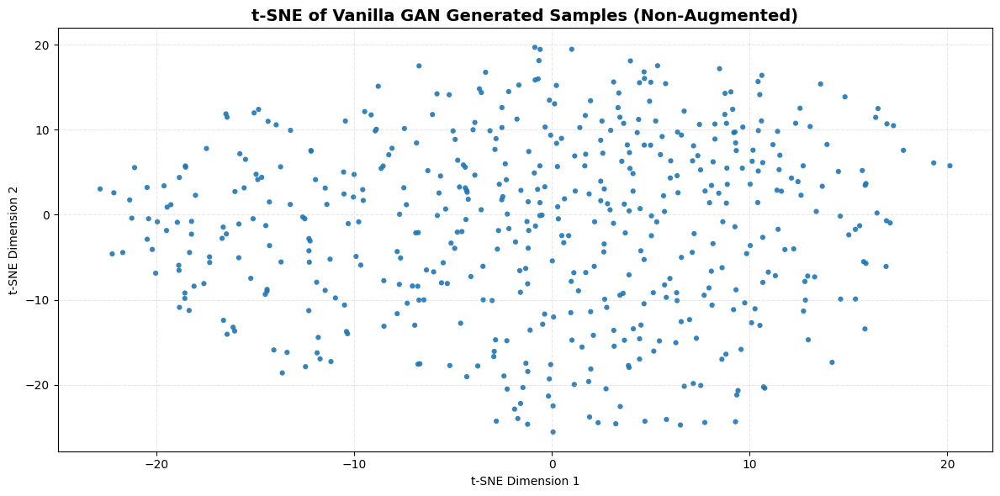

In [ ]:
# ========== Generate New Images From Random Noise ========== #
latent_dim = 64
noise = tf.random.normal([500, latent_dim])
generated_images = generator(noise, training=False)
generated_images = (generated_images + 1) / 2.0

def plot_tsne_embeddings(generated_images, save_path=None, title="t-SNE of Vanilla GAN Generated Samples (Non-Augmented)"):
    # ----- Flatten Generated Images ----- #
    flat_images = generated_images.numpy().reshape(generated_images.shape[0], -1)

    # ----- Apply t-SNE ----- #
    tsne = TSNE(n_components=2, perplexity=30, learning_rate='auto', init='pca', random_state=42)
    tsne_proj = tsne.fit_transform(flat_images)

    # ----- Plot t-SNE ----- #
    plt.figure(figsize=(12, 6))
    sns.scatterplot(
        x=tsne_proj[:, 0],
        y=tsne_proj[:, 1],
        s=20,
        alpha=0.9,
        edgecolor='none'
    )
    plt.title(title, fontsize=14, weight='bold')
    plt.xlabel("t-SNE Dimension 1")
    plt.ylabel("t-SNE Dimension 2")
    plt.grid(True, linestyle='--', alpha=0.3)
    plt.tight_layout()
    plt.show()

# ========== Call Plot Function ========== #
plot_tsne_embeddings(generated_images=generated_images)

With reference to the t-SNE plot of Generated Samples (Augmented) above, we are able to make the following observations:

**High Spread with Sparse Clusters**

- Points are widely dispersed across the 2D space, indicating broad coverage of the latent space.

- However, there is no clear grouping or clustering, suggesting that augmentation may have increased sample variability at the expense of structural cohesion.

**Visual Noise Reflected in Embedding**

- The irregular and noisy spread is consistent with the visual blur and deformation seen in the augmented samples (e.g., DRAGAN, SAGAN).

- This suggests that the model is encoding noisy features into its latent representations, leading to a more scattered t-SNE distribution.

**Augmentation Possibly Deteriorated Structure**

- Compared to non-augmented t-SNE plots, this distribution lacks any latent manifold geometry, such as elliptical or circular shapes.

- This may imply that augmentation introduced perturbations that disrupted the generator's ability to maintain latent structure continuity.

**No Apparent Mode Collapse**

- Despite the irregularity, the spread shows no obvious mode collapse (e.g., single dense cluster or repeating points).

- This reflects that augmentation maintained sample diversity, albeit in a more chaotic fashion.

With the observations indicated above, we will proceed to the next section to train a new GAN Model using Augmented Data.

---
## 5.2 Deep Convolutional GAN Model Training

In this sub-section, we will be training a Deep Convolutional GAN (DCGAN) for the EMNIST Dataset. The DCGAN mainly replaces the Fully Connected Layers for Generating Images with the Conv2D and Conv2DTranspose Layers similar to a Convolutional Neural Network (CNN). Through these layers, the DCGAN will be able to Capture Spatial Hierarchies, Preserve Image Locality and most importantly, produce Sharper and More Structured Output. Therefore, it is expected that DCGAN perform better than all the other GAN Models. The relevant mathematical formulas are indicated below:

---
**Minimax Objective (Vanilla GAN Loss):**

Purpose: Original Adversarial Objective where Generator $G$ tries to Fool Discriminator $D$, while $D$ tries to Distinguish Real Samples from Fake Ones.

$$
\min_G \max_D V(D, G) = \mathbb{E}_{x \sim p_{\text{data}}(x)}[\log D(x)] + \mathbb{E}_{z \sim p_z(z)}[\log (1 - D(G(z)))]
$$

Where:
- $G$ = Generator Network
- $D$ = Discriminator Network
- $x$ = Real Data Sample
- $z$ = Random Noise Vector
- $p_{\text{data}}(x)$ = Distribution of Real Data
- $p_z(z)$ = Prior Distribution of Noise (e.g., $\mathcal{N}(0, I)$)
- $D(x)$ = Probability that $x$ is Real
- $D(G(z))$ = Probability that Generated Image is Real

---
**Generator Loss (Binary Crossentropy):**

Purpose: The Generator is Rewarded when Discriminator Assigns High Probability to Fake Images.

$$
\mathcal{L}_{G} = -\mathbb{E}_{z \sim p_z}[\log(D(G(z)))]
$$

Where:
- $z$ = Random Noise Input
- $G(z)$ = Fake Image
- $D(G(z))$ = Discriminator's Probability that $G(z)$ is Real

---
**Discriminator Loss (Binary Crossentropy):**

Purpose: The Discriminator Assign 1 to Real Images and 0 to Generated Images.

$$
\mathcal{L}_{D} = -\mathbb{E}_{x \sim p_{\text{data}}}[\log D(x)] - \mathbb{E}_{z \sim p_z}[\log(1 - D(G(z)))]
$$

**Where:**
- $D(x)$: Output for Real EMNIST Images
- $D(G(z))$: Output for Generated Images

---
**LeakyReLU Activation Function:**

Purpose: Prevents 'dying ReLU' Problem in the Generator/Discriminator by allowing a Small Gradient for Negative Inputs, Ensuring Neurons Stay Active.

$$
f(x) = \begin{cases}
x & \text{if } x > 0 \\
\alpha x & \text{if } x \leq 0
\end{cases}
$$

Where:
- $x$: Input Value
- $\alpha$: Small Slope Constant

---
**Tanh Activation Function (Output of Generator):**

Purpose: The Generator uses $\tanh$ to Output Pixel Values between -1 and 1, which matches the Normalised EMNIST Dataset Format.

$$
\tanh(x) = \frac{e^x - e^{-x}}{e^x + e^{-x}}
$$

Where:
- $x$: Output of Final Generator Layer

---
**Normalisation Formula (for Input Scaling):**

Purpose: Scaling is Required because DCGAN uses $\tanh$ Activation

$$
x_{\text{scaled}} = \frac{x - 127.5}{127.5}
$$

Where:
- $x$: Original Grayscale Pixel Value in [0, 255]

---
With the relevant mathematical formulas indicated above, we will proceed to train the DCGAN in this sub-section for the purpose of it's potential for high accuracy due to its close relation with CNN and also to serve as a comparison for our other GAN Models.

---
### 5.2.1 Defining Data Pre-Processing Function

In this sub-section, we will be defining the Data Pre-Processing Function which will allow for consistent Data Pipeline to be built and modifed accordingly should the need arise such as when we need to add Spectral Normalisation. This will ensure that the Data's integrity is not affected and we are able to make fair and un-biased assumptions. The Data Pre-Processing Function is defined in the Code Cell below:

In [ ]:
# ========== Data Pre-Processing Function ========== #
def load_data(X_train, batch_size=64):
    # ----- Trim X_train Down to Multiple of Batch_size ----- #
    n_full = (X_train.shape[0] // batch_size) * batch_size
    X_trimmed = X_train[:n_full]

    # ----- Compute Steps For Each Epoch ----- #
    steps_per_epoch = n_full // batch_size

    # ----- Build the ImageDataGenerator Iterator ----- #
    datagen_iter = datagen.flow(X_trimmed, batch_size=batch_size, shuffle=True)

    # ----- Wrap as a tf.data.Dataset with a Fixed-shape Signature ----- #
    dataset = tf.data.Dataset.from_generator(
        lambda: (next(datagen_iter) for _ in range(steps_per_epoch)),
        output_signature=tf.TensorSpec((batch_size, 28, 28, 1), tf.float32)
    )

    return dataset.prefetch(tf.data.AUTOTUNE)

With reference to the Code Cell above, we are able to determine that the Data Pre-Processing Function have been defined successfully and we are able to move on to Defining Callback Functions in the next sub-section.

---
### 5.2.2 Defining Callback Functions

In this sub-section, we will be pre-defining the various Callbacks. This is to ensure consistency throughout the model and also to increase the GAN Accuracy and optimise the Computation Cost for training each GAN Model. These Callbacks will be main used during the GAN Training in the next sub-section. The formulas and logic for these Callbacks are indicated below:

---
**Learning Rate Scheduler:**

Purpose: Reduces Learning Rate During Training to Fine-tune Model Convergence.

$$\text{If } epoch \mod 10 = 0 \Rightarrow \eta_{new} = \frac{1}{2} \cdot \eta$$

Where:

- $\eta$ = current learning rate

- $\eta_{\text{new}}$ = updated learning rate

- $epoch \bmod 10$ checks if the epoch is a multiple of 10

---
**ReduceLROnPlateau:**

Purpose: Automatically Reduces the Learning Rate when Validation Performance Plateaus.

$$
\text{If no improvement in } val\_loss \text{ for 10 epochs: } \eta_{\text{new}} = 0.5 \cdot \eta
$$

Where:

- $\eta_{\text{new}}$ = reduced learning rate

---
**EarlyStopping:**

Purpose: Prevents Wastage of Computational Power if Model Does Not Improve.

$$
\text{If } val\_loss \text{ does not improve for 25 epochs, stop training and restore best weights}
$$

---
With the formulas and Various Callbacks listed, we will proceed to Define the Callbacks in the Code Cell below in preparation for the GAN Model Training.

In [ ]:
# ========== Define Learning Rate Scheduler ========== #
lr_scheduler = LearningRateScheduler(
    lambda epoch, lr: lr * 0.95 if epoch % 10 == 0 else lr,
    verbose=1
)

# ========== Define Reduce LR on Plateau ========== #
reduce_lr = ReduceLROnPlateau(
    monitor='loss',
    factor=0.5,
    patience=10,
    verbose=1,
    min_lr=1e-6
)

# ========== Define Early Stopping ========== #
early_stop = EarlyStopping(
    monitor='loss',
    patience=25,
    verbose=1,
    restore_best_weights=False
)

# ========== Define Display Generated Images ========== #
def display_generated_images(generator, latent_dim, n=7):
    noise = tf.random.normal([n * n, latent_dim])
    generated_images = generator(noise, training=False)
    generated_images = (generated_images + 1.0) / 2.0

    fig, axes = plt.subplots(n, n, figsize=(n, n))
    for i in range(n):
        for j in range(n):
            img = generated_images[i * n + j, :, :, 0]
            axes[i, j].imshow(img, cmap='gray')
            axes[i, j].axis('off')

    plt.tight_layout()
    plt.show()

# ========== Define FID Calculator ========== #
_inception_model = InceptionV3(
    include_top=False,
    pooling='avg',
    input_shape=(299,299,3)
)

def calculate_fid(real_images, fake_images, batch_size=10):

    # ----- Scale to [0,255] and Resize to 299×299 ----- #
    real = (real_images + 1.0) * 127.5
    fake = (fake_images + 1.0) * 127.5
    real = tf.image.resize(real, (299,299))
    fake = tf.image.resize(fake, (299,299))

    # ----- If Grayscale, Convert to RGB ----- #
    if real.shape[-1] == 1:
        real = tf.image.grayscale_to_rgb(real)
        fake = tf.image.grayscale_to_rgb(fake)

    # ----- Preprocess for Inception (–1 to +1) ----- #
    real_pp = preprocess_input(real)
    fake_pp = preprocess_input(fake)

    # ----- Extract Features in Batches ----- #
    def _get_acts(x):
        acts = []
        n = x.shape[0]
        for i in range(0, n, batch_size):
            chunk = x[i:i+batch_size]
            acts.append(_inception_model(chunk, training=False).numpy())
        return np.vstack(acts)

    act_real = _get_acts(real_pp)
    act_fake = _get_acts(fake_pp)

    # ----- Compute Statistics ----- #
    mu1, sigma1 = act_real.mean(axis=0), np.cov(act_real, rowvar=False)
    mu2, sigma2 = act_fake.mean(axis=0), np.cov(act_fake, rowvar=False)
    diff    = mu1 - mu2
    covmean = sqrtm(sigma1.dot(sigma2))
    if np.iscomplexobj(covmean):
        covmean = covmean.real
    fid = diff.dot(diff) + np.trace(sigma1 + sigma2 - 2*covmean)
    return float(np.round(fid,4))

# ========== Confirmation Message ========== #
print("DCGAN Callbacks and Visualisation Setup Complete")

DCGAN Callbacks and Visualisation Setup Complete


With reference to the Code Cell above, we are able to verify that that the Callbacks have been successfully defined and the various parameters are set so as to ensure a High Accuracy and Computing Efficient GAN Model Training.

---
### 5.2.3 Defining DCGAN Generator Architecture

In this section, we will be defining the Vanilla GAN's Generator Architecture. The Generator will be trying to make realistic generated images in the attempt to bypass the Discriminator. Subsequently, the generated images from the Generator will be evaluated based on a few evaluation metrics such as Inception Score. The relevent mathematical formulas for the Loss Function of the Vanilla GAN Generator is indicated below:

---

**Generator Loss (Binary Crossentropy):**

Purpose: The Generator is Rewarded when Discriminator Assigns High Probability to Fake Images.

$$
\mathcal{L}_{G} = -\mathbb{E}_{z \sim p_z}[\log(D(G(z)))]
$$

Where:
- $z$ = Random Noise Input
- $G(z)$ = Fake Image
- $D(G(z))$ = Discriminator's Probability that $G(z)$ is Real

---
With the relevant Generator Loss Formula indicated above, we will proceed to define the GAN Generator's Architecture in the Code Cell below and the Lost Function.

In [ ]:
def build_generator(latent_dim=100, use_dropout=True):
    model = tf.keras.Sequential(name="generator")

    # ----- Project and Reshape ----- #
    model.add(tf.keras.layers.Dense(7 * 7 * 256, use_bias=False, input_shape=(latent_dim,)))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.ReLU())
    model.add(tf.keras.layers.Reshape((7, 7, 256)))

    # ----- Upsample 1 ----- #
    model.add(tf.keras.layers.Conv2DTranspose(128, kernel_size=5, strides=1, padding='same', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.ReLU())
    if use_dropout:
        model.add(tf.keras.layers.Dropout(0.3))

    # ----- Upsample 2 ----- #
    model.add(tf.keras.layers.Conv2DTranspose(64, kernel_size=5, strides=2, padding='same', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.ReLU())
    if use_dropout:
        model.add(tf.keras.layers.Dropout(0.3))

    # ----- Final Output to 28x28x1 ----- #
    model.add(tf.keras.layers.Conv2DTranspose(1, kernel_size=5, strides=2, padding='same', activation='tanh'))

    return model

# ========== Define Generator Loss ========== #
loss_fn = tf.keras.losses.BinaryCrossentropy(from_logits=False)

def generator_loss(fake_output):
    labels = tf.ones_like(fake_output) * tf.random.uniform(tf.shape(fake_output), minval=0.9, maxval=1.0)
    return loss_fn(labels, fake_output)

With reference to the Code Cell above, we are able to verify that the GAN's Generator Architecture have been successfully defined and we are able to proceed to define the GAN's Discriminator Architecture.

---
### 5.2.4 Defining Spectral Normalisation

In this section, we will be defining the Spectral Normalisation layer for the Discriminator of the GAN. The Spectral Normalisation controls the Lipschitz constant of the Discriminator by constraining the Spectral Norm of each weight matrix. This will prevent the Discriminator from being too powerful and dominating the Generator which can cause various issues such as Mode Collaspe, Training Instability and Exploding Gradients. The relevant mathematical formula is indicated below:

---
**Spectral Normalisation (SN)**

Purpose: Controls the Lipschitz Constant of the Discriminator.

$$
\bar{W} = \frac{W}{\sigma(W)}
$$

Where:
- $W$ = Original Weight Matrix
- $\bar{W}$ = Spectrally Normalised Weight Matrix used in the Forward Pass
- $\sigma(W)$ = Spectral Norm of $W$
---
**Spectral Norm Approximation using Power Iteration**

Purpose: Controls the Lipschitz Constant of the Discriminator.

$$
\sigma(W) \approx \mathbf{u}^\top W \mathbf{v}
$$

Where:
- $\mathbf{v} \leftarrow \frac{W^\top \mathbf{u}}{\|W^\top \mathbf{u}\|_2}$
- $\mathbf{u} \leftarrow \frac{W \mathbf{v}}{\|W \mathbf{v}\|_2}$
- $\mathbf{u}, \mathbf{v}$: Approximated Unit Vectors
---
With the relevant mathematical formulas indicated, we will proceed to define the Spectral Normalisation in the Code Cell below.

In [ ]:
# ========== Spectral Normalisation Convolution Layer ========== #
class SpectralConv2D(tf.keras.layers.Layer):
    def __init__(self, filters, kernel_size, strides=1, padding='same', **kwargs):
        super().__init__()
        self.conv = tf.keras.layers.Conv2D(filters, kernel_size, strides=strides, padding=padding, use_bias=False, **kwargs)
        self.u = None

    def build(self, input_shape):
        self.conv.build(input_shape)
        self.w = self.conv.kernel
        self.u = self.add_weight(shape=(1, self.w.shape[-1]), initializer='random_normal', trainable=False, name='sn_u')

    def compute_spectral_norm(self, w):
        w_reshaped = tf.reshape(w, [-1, w.shape[-1]])
        u = self.u

        for _ in range(1):
            v = tf.linalg.l2_normalize(tf.matmul(u, tf.transpose(w_reshaped)))
            u = tf.linalg.l2_normalize(tf.matmul(v, w_reshaped))

        sigma = tf.matmul(tf.matmul(v, w_reshaped), tf.transpose(u))
        self.u.assign(u)
        return w / sigma

    def call(self, inputs):
        self.conv.kernel.assign(self.compute_spectral_norm(self.w))
        return self.conv(inputs)

# ========== Spectral Normalisation Dense Layer ========== #
class SpectralDense(tf.keras.layers.Layer):
    def __init__(self, units, activation=None):
        super().__init__()
        self.dense = tf.keras.layers.Dense(units, activation=activation, use_bias=False)
        self.u = None

    def build(self, input_shape):
        self.dense.build(input_shape)
        self.w = self.dense.kernel
        self.u = self.add_weight(shape=(1, self.w.shape[-1]), initializer='random_normal', trainable=False, name='sn_u_dense')

    def compute_spectral_norm(self, w):
        w_reshaped = tf.reshape(w, [-1, w.shape[-1]])
        u = self.u

        for _ in range(1):
            v = tf.linalg.l2_normalize(tf.matmul(u, tf.transpose(w_reshaped)))
            u = tf.linalg.l2_normalize(tf.matmul(v, w_reshaped))

        sigma = tf.matmul(tf.matmul(v, w_reshaped), tf.transpose(u))
        self.u.assign(u)
        return w / sigma

    def call(self, inputs):
        self.dense.kernel.assign(self.compute_spectral_norm(self.w))
        return self.dense(inputs)

With reference to the Code Cell above, we are able to verify that the Spectral Normalisation have been successfully defined and we are able to proceed to include this layer in the Discriminator Architecture in the next section.

---
### 5.2.5 Defining DCGAN Discriminator Architecture

In this section, we will be defining the Architecture of the Discriminator of the GAN. The Discriminator will be the Neural Network that will attempt to tell the Generated Images apart from the Actual Images. This will allow the GAN to improve overtime and also improve itself overtime. The mathematical function for the Discriminator Loss Function is indicated below:

---
**Discriminator Loss (Binary Crossentropy):**

Purpose: The Discriminator Assign 1 to Real Images and 0 to Generated Images.

$$
\mathcal{L}_{D} = -\mathbb{E}_{x \sim p_{\text{data}}}[\log D(x)] - \mathbb{E}_{z \sim p_z}[\log(1 - D(G(z)))]
$$

**Where:**
- $D(x)$: Output for Real EMNIST Images
- $D(G(z))$: Output for Generated Images

---
With the mathematical formula for the Loss Function indicated above, we will proceed to define the GAN's Discriminator Architecture and the Loss Function in the Code Cell below.

In [ ]:
# ========== Discriminator Function ========== #
def build_discriminator(input_shape=(28, 28, 1)):
    model = tf.keras.Sequential(name="discriminator")

    model.add(SpectralConv2D(64, kernel_size=5, strides=2, padding='same', input_shape=input_shape))
    model.add(tf.keras.layers.LeakyReLU(alpha=0.2))
    model.add(tf.keras.layers.Dropout(0.3))

    model.add(SpectralConv2D(128, kernel_size=5, strides=2, padding='same'))
    model.add(tf.keras.layers.LeakyReLU(alpha=0.2))
    model.add(tf.keras.layers.Dropout(0.3))

    model.add(tf.keras.layers.Flatten())
    model.add(SpectralDense(1, activation='sigmoid'))

    return model

# ========== Discriminator Loss Function ========== #
def discriminator_loss(real_output, fake_output):
    real_labels = tf.ones_like(real_output) * 0.9
    fake_labels = tf.zeros_like(fake_output)

    real_loss = loss_fn(real_labels, real_output)
    fake_loss = loss_fn(fake_labels, fake_output)
    return real_loss + fake_loss

With reference to the Code Cell above, we are able to verify that the GAN's Discriminator Architecture have been successfully defined and we are able to proceed to define the GAN's Training Steps.

---
### 5.2.6 Defining Training Step

In this section, we will be Defining the Training Step function so as to train both the Generator and the Discriminator at the same time. The Training Step will compute the gradients for both the Generator and the Discriminator at the same time. The relevant mathematical formulas for the Training Step is indicated below:

---
**Generator Loss:**

Purpose: Encourages the Generator to Create Samples that the Discriminator believes are Real.

$$
L_G = -\mathbb{E}_{z \sim p_z(z)}[\log D(G(z))]
$$

Where:
- $L_G$ = Generator Loss  
- $z$ = Latent Noise Vector Sampled from Prior Distribution $p_z(z)$  
- $G(z)$ = Fake Image Generated from $z$  
- $D(G(z))$ = Discriminator's Probability that the Generated Image is Real
---
**Discriminator Loss:**

Purpose: Train Discriminator $D$ to Distinguish between Real and Fake Samples, Rewarding High Confidence in Real Images ($D(x) \to 1$) and Low Confidence in Fake Ones ($D(G(z)) \to 0$).

$$
L_D = -\mathbb{E}_{x \sim p_{\text{data}}(x)}[\log D(x)] - \mathbb{E}_{z \sim p_z(z)}[\log (1 - D(G(z)))]
$$

Where:
- $L_D$ = Discriminator Loss  
- $x$ = Real Image Sampled from the Dataset Distribution $p_{\text{data}}(x)$  
- $z$ = Latent Vector from Prior Noise Distribution $p_z(z)$  
- $G(z)$ = Fake Image Generated by $G$
- $D(x)$ = Discriminator's Predicted Probability that $x$ is Real  
- $D(G(z))$ = Discriminator's Predicted Probability that $G(z)$ is Real  
- $\log D(x)$ = Log-likelihood that Real Image is Correctly Classified  
- $\log(1 - D(G(z)))$ = Log-likelihood that Fake Image is Correctly Rejected
---

**Gradient Update:**

Purpose: Updates the Generator and Discriminator Parameters using Gradient Descent.

$$
\theta_G \leftarrow \theta_G - \eta \cdot \nabla_{\theta_G} L_G \\
\theta_D \leftarrow \theta_D - \eta \cdot \nabla_{\theta_D} L_D
$$

Where:
- $\theta_G$ = Generator Parameters  
- $\theta_D$ = Discriminator Parameters  
- $\eta$ = Learning Rate  
- $\nabla_{\theta} L$ = Gradient of Loss with Respect to Model Weights
---

With the relevant mathematical formulas indicated above, we will proceed to define the Training Step in the Code Cell below.

In [ ]:
# ========== Training Step for LSGAN ========== #
@tf.function
def train_step(real_images, generator, discriminator, gen_optimizer, disc_optimizer, latent_dim):
    batch_size = tf.shape(real_images)[0]
    noise = tf.random.normal([batch_size, latent_dim])

    # ----- Add Stabilisation Noise to Inputs ----- #
    real_images += 0.05 * tf.random.normal(tf.shape(real_images))

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        # ----- Generate Fake Images ----- #
        fake_images = generator(noise, training=True)

        # ----- Discriminator Predictions ----- #
        real_output = discriminator(real_images, training=True)
        fake_output = discriminator(fake_images, training=True)

        # ----- LSGAN Losses (MSE) ----- #
        real_loss = loss_fn(tf.ones_like(real_output), real_output)
        fake_loss = loss_fn(tf.zeros_like(fake_output), fake_output)
        disc_loss = real_loss + fake_loss

        gen_loss = loss_fn(tf.ones_like(fake_output), fake_output)

    # ----- Compute & Apply Gradients ----- #
    gen_grads = gen_tape.gradient(gen_loss, generator.trainable_variables)
    disc_grads = disc_tape.gradient(disc_loss, discriminator.trainable_variables)
    gen_optimizer.apply_gradients(zip(gen_grads, generator.trainable_variables))
    disc_optimizer.apply_gradients(zip(disc_grads, discriminator.trainable_variables))

    return gen_loss, disc_loss, real_output, fake_output

With reference to the Code Cell above, we are able to determine that the Training Step have been successfully defined and we are able to proceed to prepare the Training Loop in the next section.

---
### 5.2.7 Defining Training Loop

In this section, we will be defining the Training Loop for the GAN Training. The Training Loop will go through each of the Epoch and train both the Generator and Discriminator simultaneously. The Training Loop will also track the Loss for both the Generator and the Discriminator for each of the Epoch trained. The relevant mathematical formulas are indicated below:

---
**Epoch Loss Averaging:**

Purpose: These are the Average Generator and Discriminator Losses over all Batches in Epoch $t$.

$$
\bar{L}_G^{(t)} = \frac{1}{N} \sum_{i=1}^{N} L_G^{(i)} \\
\bar{L}_D^{(t)} = \frac{1}{N} \sum_{i=1}^{N} L_D^{(i)}
$$

Where:
- $\bar{L}_G^{(t)}$ = Average Generator Loss at Epoch $t$  
- $\bar{L}_D^{(t)}$ = Average Discriminator Loss at Epoch $t$  
- $N$ = Number of Batches in the Dataset  
- $L_G^{(i)}$ = Generator Loss on Batch $i$  
- $L_D^{(i)}$ = Discriminator Loss on Batch $i$

---
**Epoch Iteration:**

Purpose: Describes the Training Loop Logic: for Each Epoch $t$, perform `train_step` for Every Mini-batch.

$$
\text{for } t = 1 \text{ to } T:
\quad \text{for each batch } (x^{(i)}):
\quad \text{train_step}(x^{(i)})
$$

Where:
- $T$: Total Number of Epochs  
- $x^{(i)}$: Real Batch $i$ from the Dataset  
- `train_step`: Function that Updates $G$ and $D$ using that Batch

---
**Generated Image Output:**

Purpose: Sample Random Noise $z$ and Generate Synthetic Image $\hat{x}$ from the Generator. This is used for Visual Monitoring of Model Quality.

$$
z \sim p_z(z) \\
\hat{x} = G(z)
$$

Where:
- $z$: Random Latent Vector  
- $G(z)$: Generated Image from Generator

---
With the mathematical formulas indicated above, we will proceed to define the Training Loop in the Code Cell below in preparation of the GAN Training.

In [ ]:
# ========== Training Loop Function ========== #
def train(dataset, epochs, generator, discriminator, gen_optimizer, disc_optimizer, latent_dim, save_path=None, use_early_stopping=True, steps_per_epoch=None):

    # ----- Prepare FID Reference Sets ----- #
    real_val  = tf.data.Dataset.from_tensor_slices(X_val).batch(50).take(1)
    noise_val = tf.random.normal([50, latent_dim])
    noise_val = tf.math.l2_normalize(noise_val, axis=1)

    # ----- FID Early Stopping Settings for DCGAN ----- #
    best_fid = float('inf')
    no_improve = 0
    patience = 10
    fid_interval = 1

    # ----- Dummy Model for Callbacks ----- #
    dummy_input  = Input(shape=(1,))
    dummy_output = Lambda(lambda x: x)(dummy_input)
    dummy_model  = Model(dummy_input, dummy_output)
    dummy_model.compile(optimizer=Adam(1e-4), loss='mse')

    early_stop.set_model(dummy_model)
    reduce_lr.set_model(dummy_model)
    lr_scheduler.set_model(dummy_model)
    early_stop.on_train_begin({})
    reduce_lr.on_train_begin({})
    lr_scheduler.on_train_begin({})

    # ----- Track Loss History ------ #
    gen_loss_history  = []
    disc_loss_history = []

    for epoch in range(1, epochs + 1):
        print(f"\nEpoch {epoch}/{epochs}")
        gen_losses, disc_losses, real_outs, fake_outs = [], [], [], []

        for i, real_images in enumerate(dataset):
            if steps_per_epoch and i >= steps_per_epoch:
                break

            gen_loss, disc_loss, ro, fo = train_step(
                real_images,
                generator,
                discriminator,
                gen_optimizer,
                disc_optimizer,
                latent_dim
            )
            gen_losses.append(gen_loss)
            disc_losses.append(disc_loss)
            real_outs.append(ro)
            fake_outs.append(fo)

        avg_gen_loss  = tf.reduce_mean(gen_losses)
        avg_disc_loss = tf.reduce_mean(disc_losses)

        # ----- Compute Real/Fake accuracy ----- #
        if real_outs and fake_outs:
            acc_real = tf.reduce_mean(tf.cast(tf.concat(real_outs, axis=0) > 0.5, tf.float32))
            acc_fake = tf.reduce_mean(tf.cast(tf.concat(fake_outs, axis=0) < 0.5, tf.float32))
        else:
            acc_real = tf.constant(0.0)
            acc_fake = tf.constant(0.0)

        print(f"Generator Loss: {avg_gen_loss:.4f} | "
              f"Discriminator Loss: {avg_disc_loss:.4f} | "
              f"Acc R/F: {acc_real:.3f}/{acc_fake:.3f}")

        gen_loss_history.append(float(avg_gen_loss))
        disc_loss_history.append(float(avg_disc_loss))

        # ----- Callback Updates on Generator Loss ----- #
        logs = {'loss': float(avg_gen_loss)}
        if use_early_stopping:
            early_stop.on_epoch_end(epoch=epoch, logs=logs)
            if early_stop.stopped_epoch > 0:
                print(f"Early stopping triggered at epoch {epoch}")
                break
        reduce_lr.on_epoch_end(epoch=epoch, logs=logs)
        lr_scheduler.on_epoch_end(epoch=epoch, logs=logs)

        # ----- FID Evaluation & Early Stopping ----- #
        if epoch % fid_interval == 0:
            fake_val   = generator(noise_val, training=False)
            real_batch = next(iter(real_val))

            real_for_fid = tf.image.resize(real_batch, [299,299]) * 0.5 + 0.5
            fake_for_fid = tf.image.resize(fake_val,    [299,299]) * 0.5 + 0.5

            fid_value = calculate_fid(real_for_fid, fake_for_fid)
            print(f"Epoch {epoch} → Val FID: {fid_value:.2f}")

            if fid_value < best_fid:
                best_fid   = fid_value
                no_improve = 0
                if save_path:
                    os.makedirs(save_path, exist_ok=True)
                    generator.save_weights(os.path.join(save_path, "best_gen.weights.h5"))
                    discriminator.save_weights(os.path.join(save_path, "best_disc.weights.h5"))
            else:
                no_improve += 1

            if no_improve >= patience:
                print(f"No FID improvement for {patience} epochs, stopping.")
                break

        # ----- Display Every 5 Epochs ----- #
        if epoch % 5 == 0:
            display_generated_images(generator, latent_dim)

    # ----- Restore Best Weights After Training ----- #
    if save_path:
        best_gen_path = os.path.join(save_path, "best_gen.weights.h5")
        best_disc_path = os.path.join(save_path, "best_disc.weights.h5")
        if os.path.exists(best_gen_path) and os.path.exists(best_disc_path):
            generator.load_weights(best_gen_path)
            discriminator.load_weights(best_disc_path)
            print("Restored best generator and discriminator weights based on lowest FID.")
        else:
            print("Best weight files not found. Skipping restore.")

    return avg_gen_loss, gen_loss_history, disc_loss_history

With reference to the Code Cell above, we are able to determine that the Training Loop have been successfully defined and we are able to proceed to define the Optimisers with Tunable Parameter in preparation for the Optuna Tuning.

---
### 5.2.8 Defining Optimisers with Tunable Parameters

In this section, we will be defining the Common Optimisers that will be Tuned using the Optuna Tuning. The Optimisers will each have a range of values in a list so as to allow for the Optuna to search for the best Hyperparameter for the GAN. Through these parameters, it will affect how effective and efficiently the GAN will learn from the provided EMNIST Data. The relevent mathematical formula is indicated below:

---
**Optimiser Update Rule**

Purpose: Parameter Update Step in the Adam Optimiser, using Adaptive Learning Rates with Momentum.

$$
\theta \leftarrow \theta - \eta \cdot \frac{m_t}{\sqrt{v_t} + \epsilon}
$$

Where:
- $\theta$ = Model Parameters (Generator or Discriminator)
- $\eta$ = Learning Rate (Tuned)
- $m_t$ = First Moment Estimate (Mean of Gradients)
- $v_t$ = Second Moment Estimate (Variance of Gradients)
- $\epsilon$ = Small Constant for Numerical Stability

---
With the mathematical formula indicated above, we will proceed to define the Optimisers in the Code Cell.

In [ ]:
def objective(trial):
    # ----- Hyperparameters ----- #
    latent_dim = trial.suggest_categorical('latent_dim', [100, 128, 160])
    learning_rate = trial.suggest_float('learning_rate', 5e-5, 2e-4, log=True)
    beta_1 = trial.suggest_float('beta_1', 0.4, 0.6)

    # ----- Build Models ----- #
    generator = build_generator(latent_dim=latent_dim)
    discriminator = build_discriminator()

    # ----- Trigger Weight Creation ----- #
    _ = generator(tf.random.uniform([1, latent_dim], minval=-1.0, maxval=1.0))
    _ = discriminator(tf.random.normal([1, 28, 28, 1]))

    # ----- Define Optimizers ----- #
    gen_optimizer = tf.keras.optimizers.Adam(learning_rate=learning_rate, beta_1=beta_1)
    disc_optimizer = tf.keras.optimizers.Adam(learning_rate=learning_rate, beta_1=beta_1)

    # ----- Prebuild Optimizers for tf.function compatibility ----- #
    _ = gen_optimizer.apply_gradients([(tf.zeros_like(v), v) for v in generator.trainable_variables])
    _ = disc_optimizer.apply_gradients([(tf.zeros_like(v), v) for v in discriminator.trainable_variables])

    # ----- Load Data ----- #
    dataset = load_data(X_train, batch_size=64)
    steps = min(1000, len(X_train) // 64)

    # ----- Train ----- #
    _, _, _ = train(
        dataset=dataset,
        epochs=50,
        generator=generator,
        discriminator=discriminator,
        gen_optimizer=gen_optimizer,
        disc_optimizer=disc_optimizer,
        latent_dim=latent_dim,
        steps_per_epoch=steps,
        use_early_stopping=False,
        save_path=None
    )

    # ----- Generate Fake Images ----- #
    z = tf.random.uniform([1000, latent_dim], minval=-1.0, maxval=1.0)
    fake_images = generator(z, training=False)
    fake_images = (fake_images + 1.0) / 2.0

    # ----- Get Real Images ----- #
    real_images = X_val[:1000]

    # ----- Compute FID Score ----- #
    fid_score = calculate_fid(real_images, fake_images)

    # ----- Return FID to Minimise ----- #
    return fid_score

With reference to the Code Cell above, we are able to determine that the Optimiser have been successfully defined with a range of different Parameter Values so as to provide a robust Optuna Tuning in the subsequent sections.

---
### 5.2.9 Optuna Tuning Study

In this sub-section, we will be conducting the Optuna Tuning Study on the GAN Model so as to obtain the best Hyperparameter for the GAN Model. It is expected that the Tuning takes a prolonged duration due to the nature of how the GAN works and the 2 Neural Networks involved. However, the training data will be stored so as to prevent re-running of repetitive codes. The Optuna Tuning Study will be conducted in the Code Cell below.

In [ ]:
# ========== Create or Load Study with SQLite Backend ========== #
study = optuna.create_study(
    direction="minimize",
    study_name="dcgan_tuning",
    storage="sqlite:////content/drive/MyDrive/Colab Notebooks/DELE CA2 A/Augmented GAN Tunings/dcgan_optuna.db",
    load_if_exists=True
)

# ========== Trial Management ========== #
MAX_TRIALS = 50
completed_trials = len([t for t in study.trials if t.state == optuna.trial.TrialState.COMPLETE])
remaining_trials = MAX_TRIALS - completed_trials

if remaining_trials > 0:
    print(f"Resuming DCGAN study: {completed_trials} completed, running {remaining_trials} more.")
    study.optimize(objective, n_trials=remaining_trials)
else:
    print(f"DCGAN study already completed {MAX_TRIALS} trials. Skipping optimization.")

# ========== Output Best Trial ========== #
best_trial = study.best_trial
best_params_df = pd.DataFrame([best_trial.params])
best_params_df["Final FID"] = best_trial.value
best_params_df.style.background_gradient(cmap="Blues")

[I 2025-08-10 11:11:09,714] Using an existing study with name 'dcgan_tuning' instead of creating a new one.


DCGAN study already completed 50 trials. Skipping optimization.


,latent_dim,learning_rate,beta_1,Final FID
0,100,0.000133,0.453588,66.627700


With reference to the Code Cell above, we are able to view the Best Hyperparameter obtained during the Optuna Tuning Study. This Hyperparameter will be extracted and be trained for a longer period of time so as to attempt to increase the performance and limit the loss for the GAN.

---
### 5.2.10 GAN Re-Training Operation

As obtained from the previous sub-section, we will be re-training the GAN using the best Hyperparameter obtained during the Optuna Tuning Study. This is to push the GAN Model to its limits and also to save Computational Power as we are not taking up prolonged periods of time tuning GAN Models which may not have any clear signs of good performance. The retraining of the GAN Model will be conducted in the Code Cell below.

In [ ]:
# ========== Extract Best Parameters from Study ========== #
best_params = study.best_trial.params

latent_dim   = best_params['latent_dim']
learning_rate = best_params['learning_rate']
beta_1       = best_params['beta_1']

print("Using Best Trial Parameters for DCGAN:")
print(best_params)

# ========== Rebuild DCGAN Models ========== #
generator     = build_generator(latent_dim=latent_dim)
discriminator = build_discriminator()

# ========== Trigger Variable Creation ========== #
_ = generator(tf.random.normal([1, latent_dim]))
_ = discriminator(tf.random.normal([1, 28, 28, 1]))

# ========== Initialise Optimisers ========== #
gen_optimizer  = tf.keras.optimizers.Adam(learning_rate=learning_rate, beta_1=beta_1)
disc_optimizer = tf.keras.optimizers.Adam(learning_rate=learning_rate, beta_1=beta_1)

_ = gen_optimizer.apply_gradients([(tf.zeros_like(var), var) for var in generator.trainable_variables])
_ = disc_optimizer.apply_gradients([(tf.zeros_like(var), var) for var in discriminator.trainable_variables])

# ========== Reload Preprocessed Dataset ========== #
dataset = load_data(X_train)

# ========== Define Paths ========== #
model_name   = "dcgan"
output_dir   = "/content/drive/MyDrive/Colab Notebooks/DELE CA2 A/final_outputs_dcgan_augment"
weights_path = os.path.join(output_dir, "augmented_dcgan_generator_final.weights.h5")
gen_ckpt     = os.path.join(output_dir, "best_gen.weights.h5")
disc_ckpt    = os.path.join(output_dir, "best_disc.weights.h5")
loss_csv     = os.path.join(output_dir, "loss_history.csv")

os.makedirs(output_dir, exist_ok=True)

# ========== Load or Train ========== #
if os.path.exists(gen_ckpt) and os.path.exists(disc_ckpt) and os.path.exists(loss_csv):
    print("All outputs found. Skipping training...")

    generator.load_weights(gen_ckpt)
    discriminator.load_weights(disc_ckpt)
    print("DCGAN (Augmented) weights loaded.")

    loss_df = pd.read_csv(loss_csv)
    gen_loss_history  = loss_df['gen_loss'].tolist()
    disc_loss_history = loss_df['disc_loss'].tolist()
    final_gen_loss    = gen_loss_history[-1]

else:
    final_gen_loss, gen_loss_history, disc_loss_history = train(
        dataset=dataset,
        epochs=100,
        steps_per_epoch=1546,
        generator=generator,
        discriminator=discriminator,
        gen_optimizer=gen_optimizer,
        disc_optimizer=disc_optimizer,
        latent_dim=latent_dim,
        use_early_stopping=False,
        save_path=output_dir
    )

    generator.save_weights(weights_path)
    print("Generator Weights Saved.")

    loss_df = pd.DataFrame({
        'epoch': list(range(1, len(gen_loss_history) + 1)),
        'gen_loss': gen_loss_history,
        'disc_loss': disc_loss_history
    })
    loss_df.to_csv(loss_csv, index=False)
    print(f"Loss history saved to {loss_csv}")

Using Best Trial Parameters for DCGAN:
{'latent_dim': 100, 'learning_rate': 0.0001334785408772326, 'beta_1': 0.4535877279867523}


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:93: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/activations/leaky_relu.py:41: UserWarning: Argument `alpha` is deprecated. Use `negative_slope` instead.
  warnings.warn(


All outputs found. Skipping training...
DCGAN (Augmented) weights loaded.


With reference to the Code Cell above, we are able to determine that the best GAN Model have been trained and saved successfully and we are able to proceed with the Model Evaluation in the next sub-sections where we determine how well the GAN Model performed based on various metrics and evaluation methodologies.

---
### 5.2.11 GAN Model Evaluation

In this sub-section, we will be evaluating the GAN's Generator performance on various aspects. We will be utilising different methodologies and metrics to attempt to quantify the performance of the GAN Generator while also conducting Visual Inspection on the result output of the GAN. The Evaluation will be conducted in the following sections.

---
#### 5.2.11.1 Visual Grid of Samples

In this sub-section, we will be visualising the Grid of Samples of the Synthesised Data generated by the GAN Model. A list of observations will be made before the utilisation of Quantitative Metrics to evaluate the GAN Generator's general performance. As the observations made are purely from professional opinion, it will most likely not be used as a Basis of Comparison between GAN Models due to differing opinions unless in extreme cases. The visualisation will be conducted in the Code Cell below.

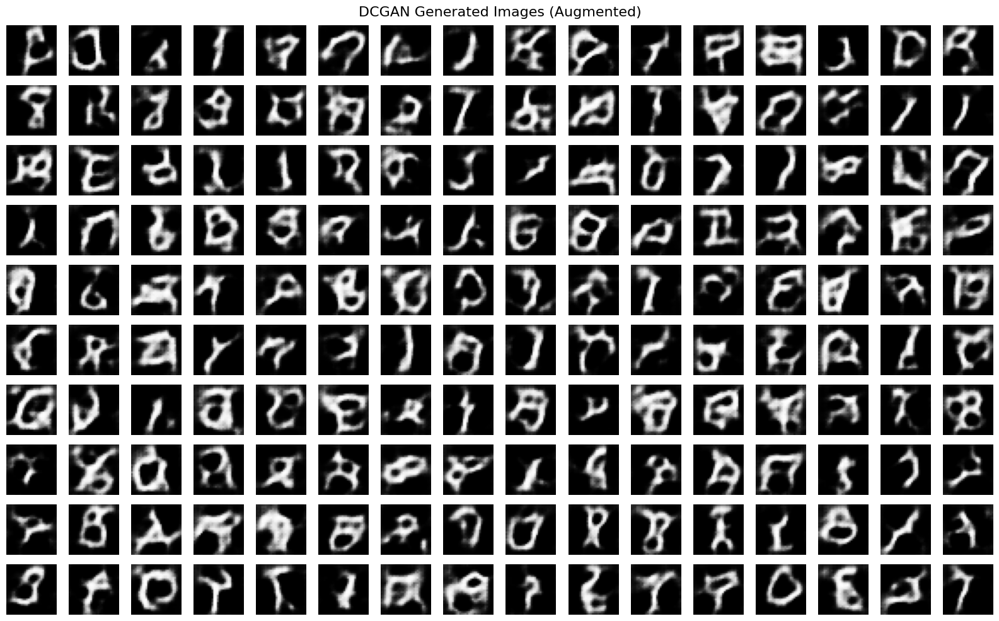

In [ ]:
def plot_generated_images(generator, latent_dim, n_rows=5, n_cols=5, save_path=None, title="DCGAN Generated Images (Augmented)"):
    noise = tf.random.normal([n_rows * n_cols, latent_dim])
    gen_images = generator(noise, training=False)

    # ----- Rescale from [-1, 1] to [0, 1] ----- #
    gen_images = (gen_images + 1.0) / 2.0
    gen_images = tf.clip_by_value(gen_images, 0.0, 1.0)

    # ----- Check Shape ----- #
    assert gen_images.shape[-1] == 1, "Expected single-channel (grayscale) output"

    # ----- Plot Generated Image ----- #
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols, n_rows))
    for i in range(n_rows * n_cols):
        ax = axes[i // n_cols, i % n_cols]
        ax.imshow(gen_images[i, :, :, 0], cmap='gray')
        ax.axis('off')

    # ----- Display Plot ----- #
    plt.suptitle(title, fontsize=16)
    plt.tight_layout()
    if save_path:
        plt.savefig(save_path, dpi=300)
        print(f"Saved Generated Image Grid to: {save_path}")
    plt.show()

plot_generated_images(generator, latent_dim=100, n_rows=10, n_cols=16)

With reference to the output of the Visual Grid of Samples above, we are able to make the following observations:

**Basic Structure of Letters is Somewhat Captured**

- Many characters resemble recognisable forms such as "B", "P", "E", "Y", and "R".

- Stroke direction and enclosure shapes are consistent with handwritten EMNIST characters.

**High Blur and Noise**

- A number of images exhibit fuzzy outlines or glow-like artefacts around the strokes.

- Some samples display background noise and inconsistencies in stroke density.

**Poor Character Consistency**

- A few characters appear distorted or incomplete, especially curved ones like "G" and "S".

- Several glyphs have malformed proportions or irregular symmetry.

**Lack of Diversity**

- Some characters such as "B", "P", and "R" appear repeatedly with only slight variations.

- Mode collapse may be mildly present, as similar structures dominate multiple rows.

With the observations indicated above, we will proceed to conduct the Loss Curve Analysis in the next sub-section.

---
#### 5.2.11.2 Loss Curve Over Epochs

In this sub-section, we will be plotting the GAN Loss Curve over Epochs to evaluate the training behaviour of the GAN. This curve provides insight into whether the GAN is experiencing underfitting, overfitting, or achieving a stable training dynamic between the generator and discriminator.

Although GANs do not minimise a single unified loss in the traditional sense, the trajectory of the generator and discriminator losses can indicate whether the adversarial training process is converging appropriately.

If the generator loss remains high while discriminator loss quickly drops to near-zero, this may indicate **underfitting**, where the generator is not learning effectively to produce plausible images.

If the discriminator loss increases while generator loss sharply decreases, this may suggest **overfitting** or **mode collapse**, where the generator exploits narrow weaknesses in the discriminator without general improvement.

A relatively stable oscillation or convergence between both losses typically signifies a **well-balanced** training process, where the generator and discriminator are learning in tandem.

The Potential Observations and Corresponding Action Plans are outlined below:

**Underfitting Loss Curve**

- Increase training epochs to allow generator more time to learn.

- Simplify the discriminator to reduce overpowering the generator.

- Adjust the learning rate or apply label smoothing.

- Consider adding batch normalisation in the generator.

**Overfitting or Mode Collapse Loss Curve**

- Introduce or increase dropout in the discriminator.

- Apply input noise or label flipping to the discriminator.

- Evaluate diversity of generated samples regularly.

**Balanced/Ideal Loss Curve**

- Maintain current architecture and hyperparameters.

- Proceed with full-scale image generation.

- Evaluate both qualitative (visual inspection) and quantitative metrics (e.g. Inception Score or FID).

With these potential training behaviours and action plan outlined, we will proceed to visualise the GAN loss dynamics in the code cell below.

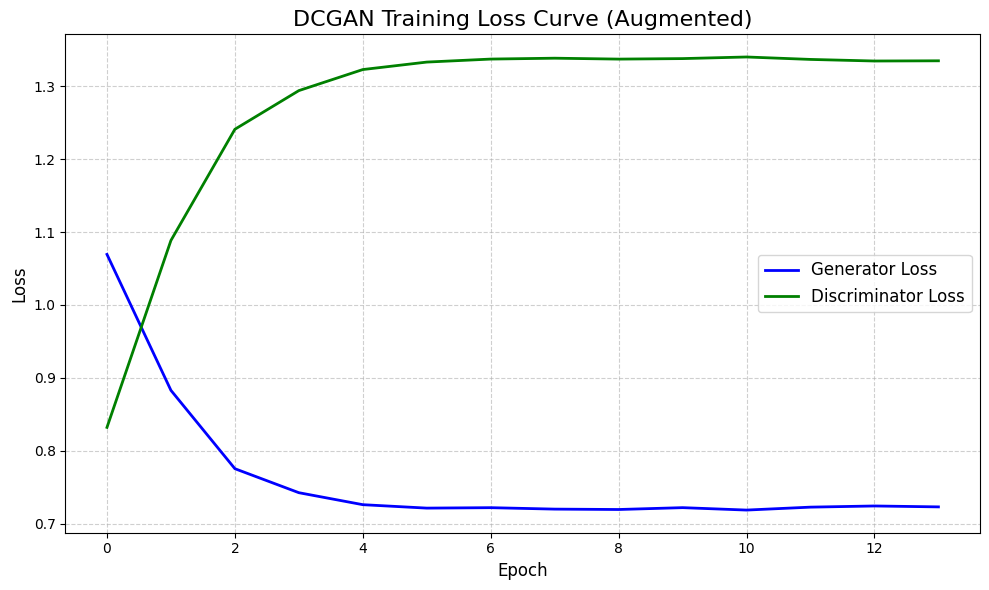

In [ ]:
# ========== Figure Size ========== #
plt.figure(figsize=(10, 6))

# ========== Plot Training Losses ========== #
plt.plot(gen_loss_history, label="Generator Loss", linewidth=2, color='blue')
plt.plot(disc_loss_history, label="Discriminator Loss", linewidth=2, color='green')

# ========== Labels and Title ========== #
plt.xlabel("Epoch", fontsize=12)
plt.ylabel("Loss", fontsize=12)
plt.title("DCGAN Training Loss Curve (Augmented)", fontsize=16)

# ========== Grid, Legend, and Styling ========== #
plt.grid(True, linestyle='--', alpha=0.6)
plt.legend(fontsize=12)
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)

# ========== Display the Plot ========== #
plt.tight_layout()
plt.show()

With reference to the output of the Loss Curver above, we are able to make the following observations:

- Both losses have plateaued implying Training has stabilised.

- Loss gap remains (Discriminator > Generator) implying Discriminator slightly stronger, which is expected.

- Generator shows good convergence without overfitting or collapse.

- Suggests DCGAN is learning well on augmented data, possibly producing meaningful outputs.

With the observations stated, we will proceed to evaluate the Quantitative Metrics in the next sub-section.

---
#### 5.2.11.3 Quantitative Metrics Evaluation

In this sub-section we will be utilising Quantitative Metrics such as FID and KID to tabulate the results of the performance and quantify the performance of the GAN Generator. We will subsequently be use these metrics to conduct inter-model evaluation after tuning and training all the GANs. The metrics that we will be utilising and their respective formulas are indicated below:

---
**Fréchet Inception Distance**

Purpose: Measures the Distance between the Real-Image and Generated-Image Distributions in Inception Feature Space.

$$
\mathrm{FID} \;=\;\|\mu_r - \mu_f\|^2
\;+\;\mathrm{Tr}\Bigl(\Sigma_r + \Sigma_f - 2\,(\Sigma_r\,\Sigma_f)^{\tfrac12}\Bigr)
$$


Where:
- $\mu_r = \mathbb{E}[f(x)]$, $\Sigma_r = \mathrm{Cov}[f(x)]$ for Real Images $x$.  
- $\mu_f = \mathbb{E}[f(\hat x)]$, $\Sigma_f = \mathrm{Cov}[f(\hat x)]$ for Generated Images $\hat x$.  
- $f(\cdot)$ = Map from Image to its InceptionV3 'pooling=avg' Features.  

---
**Diversity (t-SNE Spread)**

Purpose: Quantifies how 'wide' the 2D t-SNE Embedding of Generated Samples.

$$
\mathrm{Spread}
\;=\;
\bigl(\max_i\,z_i^{(1)} - \min_i\,z_i^{(1)}\bigr)
\;\times\;
\bigl(\max_i\,z_i^{(2)} - \min_i\,z_i^{(2)}\bigr)
$$

Where:
- $z_i = (z_i^{(1)}, z_i^{(2)})$ = 2-dimensional t-SNE Embedding of $i$th Generated Image.

---
**Mode Collapse Risk**

Purpose: Flags when too many Generated Images are Nearly Identical (mode collapse).

$$
\text{ModeCollapseRisk} =
\begin{cases}
\text{Low}, & \dfrac{\bigl|\{\mathrm{unique\_rounded}(x_i)\}\bigr|}{N} > \tau,\\
\text{High}, & \text{otherwise}.
\end{cases}
$$

Where:
- $x_i$ = $N$ Generated Samples.  
- $\mathrm{unique\_rounded}(x_i)$ = Rounds Pixels to Detect Duplicates.  
- $\tau=0.9$ = Uniqueness Threshold (90%).

---
**Perceptual Path Length**

Purpose: Measures Sensitively of Generator's Outputs (in VGG16 Feature Space) move when the Latent Code $z$ is Perturbed.

$$
\mathrm{PPL}
\;=\;
\mathbb{E}_{z,\delta z}\Bigl[\,
\|\phi\bigl(G(z + \epsilon\,\delta z)\bigr)\;-\;\phi\bigl(G(z)\bigr)\|_2^2
\Bigr]
$$

Where:  
- $G(z)$ = GAN Generator Mapping $z\in\mathbb{R}^{\mathrm{latent\_dim}}$ to an Image.  
- $\phi(\cdot)$ = VGG16 'pooling=avg' Feature Extractor.  
- $\delta z\sim\mathcal{N}(0,I)$, $\epsilon$ = Small Constant.

---
**Kernel Inception Distance**

Purpose: An Unbiased Estimator of the Squared Maximum Mean Discrepancy (MMD) between Real and Generated Inception Features.

$$
\mathrm{KID}
\;=\;
\frac{1}{m(m-1)}\sum_{i\neq j} k\bigl(\phi(x_i),\phi(x_j)\bigr)
\;+\;
\frac{1}{n(n-1)}\sum_{i\neq j} k\bigl(\phi(\hat x_i),\phi(\hat x_j)\bigr)
\;-\;
\frac{2}{mn}\sum_{i=1}^m\sum_{j=1}^n k\bigl(\phi(x_i),\phi(\hat x_j)\bigr)
$$

Where:  
- $x_i$ ($i=1\ldots m$) = Real Images.
- $\hat x_j$ ($j=1\ldots n$) = Generated Images.  
- $\phi(\cdot)$ = InceptionV3 Feature Extractor (pooling='avg').  
- $k(u,v) = \bigl(\frac{u^\top v}{d}+1\bigr)^3$ = degree-3 Polynomial Kernel on $d$-dimensional Features.

---

With the mathematical and metrics indicated above, we will proceed to conduct the Quantitave Metrics Evalution in the Code Cell below.

In [ ]:
# ========== Preload InceptionV3 and VGG16 Models ========== #
inception = InceptionV3(include_top=False, pooling='avg', input_shape=(299, 299, 3))
vgg_model = VGG16(include_top=False, weights='imagenet', input_shape=(128, 128, 3))

# ========== Preprocess for Inception ========== #
def preprocess_images_for_inception(images):
    images = (images + 1.0) * 127.5  # Scale from [-1, 1] to [0, 255]
    images = tf.image.resize(images, [299, 299])
    if images.shape[-1] == 1:
        images = tf.image.grayscale_to_rgb(images)
    return preprocess_input(images)

# ========== Compute FID ========== #
def calculate_fid(real_images, fake_images, batch_size=50):
    real_pp = preprocess_images_for_inception(real_images)
    fake_pp = preprocess_images_for_inception(fake_images)

    act1 = inception.predict(real_pp, batch_size=batch_size, verbose=0)
    act2 = inception.predict(fake_pp, batch_size=batch_size, verbose=0)

    mu1, sigma1 = np.mean(act1, axis=0), np.cov(act1, rowvar=False)
    mu2, sigma2 = np.mean(act2, axis=0), np.cov(act2, rowvar=False)

    diff = mu1 - mu2
    covmean = sqrtm(sigma1 @ sigma2)
    if np.iscomplexobj(covmean):
        covmean = covmean.real

    fid = diff @ diff + np.trace(sigma1 + sigma2 - 2 * covmean)
    return round(fid, 4)

# ========== Compute KID ========== #
def polynomial_kernel(X, Y):
    d = X.shape[1]
    return (np.dot(X, Y.T) / d + 1) ** 3

def calculate_kid(real_images, fake_images, batch_size=128):
    real_pp = preprocess_images_for_inception(real_images)
    fake_pp = preprocess_images_for_inception(fake_images)

    real_features = inception.predict(real_pp, batch_size=batch_size, verbose=0)
    fake_features = inception.predict(fake_pp, batch_size=batch_size, verbose=0)

    m = real_features.shape[0]
    n = fake_features.shape[0]

    k_rr = polynomial_kernel(real_features, real_features)
    k_gg = polynomial_kernel(fake_features, fake_features)
    k_rg = polynomial_kernel(real_features, fake_features)

    np.fill_diagonal(k_rr, 0)
    np.fill_diagonal(k_gg, 0)

    mmd = (k_rr.sum() / (m * (m - 1)) +
           k_gg.sum() / (n * (n - 1)) -
           2 * k_rg.mean())
    return round(mmd, 4)

# ========== Compute t-SNE Spread (Diversity) ========== #
def calculate_tsne_spread(images):
    flat = images.reshape(images.shape[0], -1)
    tsne = TSNE(n_components=2, random_state=42)
    proj = tsne.fit_transform(flat)
    x_range = proj[:, 0].max() - proj[:, 0].min()
    y_range = proj[:, 1].max() - proj[:, 1].min()
    return round(x_range * y_range, 2)

# ========== Assess Mode Collapse ========== #
def assess_mode_collapse(images):
    unique = np.unique(np.round(images), axis=0).shape[0]
    return "Low" if unique > 0.9 * images.shape[0] else "High"

# ========== Compute Perceptual Path Length (PPL) ========== #
def calculate_ppl(generator, latent_dim=128, num_samples=50, epsilon=1e-2):
    distances = []
    for _ in range(num_samples):
        z1 = tf.random.normal([1, latent_dim])
        z2 = z1 + epsilon * tf.random.normal([1, latent_dim])
        img1 = generator(z1, training=False)
        img2 = generator(z2, training=False)

        img1 = tf.image.resize(tf.image.grayscale_to_rgb((img1 + 1.0) * 127.5), (128, 128))
        img2 = tf.image.resize(tf.image.grayscale_to_rgb((img2 + 1.0) * 127.5), (128, 128))

        f1 = vgg_model(vgg_preprocess(img1))
        f2 = vgg_model(vgg_preprocess(img2))
        d = tf.reduce_mean(tf.square(f1 - f2)).numpy()
        distances.append(d)
    return round(np.mean(distances), 4)

# ========== Evaluate GAN Performance ========== #
def evaluate_gan_model(generator, latent_dim, X_val, gen_loss_history, disc_loss_history, model_name="DCGAN"):
    # ----- Generate Fake Images ----- #
    noise = tf.random.normal([1000, latent_dim])
    fake_images = generator(noise, training=False)
    fake_images = tf.clip_by_value((fake_images + 1) / 2.0, 0.0, 1.0)
    fake_np = fake_images.numpy()

    # ----- Select and preprocess 1000 Real Images from Validation Set ----- #
    real_images = tf.convert_to_tensor(X_val[:1000], dtype=tf.float32)
    real_images = tf.clip_by_value(real_images, 0.0, 1.0)

    # ----- Compute Metrics ----- #
    fid_value = calculate_fid(real_images, fake_images)
    kid_value = calculate_kid(real_images, fake_images)
    tsne_spread_value = calculate_tsne_spread(fake_np)
    collapse_risk_value = assess_mode_collapse(fake_np)
    ppl_score_value = calculate_ppl(generator, latent_dim)
    mean_gen_loss_value = round(np.mean(gen_loss_history), 4)
    std_gen_loss_value = round(np.std(gen_loss_history), 4)
    mean_disc_loss_value = round(np.mean(disc_loss_history), 4)
    std_disc_loss_value = round(np.std(disc_loss_history), 4)

    # ----- Store as Global Vars ----- #
    prefix = model_name.upper()
    globals()[f"{prefix}_FID"] = fid_value
    globals()[f"{prefix}_KID"] = kid_value
    globals()[f"{prefix}_TSNE"] = tsne_spread_value
    globals()[f"{prefix}_MODE_COLLAPSE"] = collapse_risk_value
    globals()[f"{prefix}_PPL"] = ppl_score_value
    globals()[f"{prefix}_GEN_LOSS_MEAN"] = mean_gen_loss_value
    globals()[f"{prefix}_GEN_LOSS_STD"] = std_gen_loss_value
    globals()[f"{prefix}_DISC_LOSS_MEAN"] = mean_disc_loss_value
    globals()[f"{prefix}_DISC_LOSS_STD"] = std_disc_loss_value

    # ----- Final Summary Row ----- #
    row = {
        "Model": model_name,
        "FID Score": fid_value,
        "KID Score": kid_value,
        "Mean Generator Loss": mean_gen_loss_value,
        "Std Generator Loss": std_gen_loss_value,
        "Mean Discriminator Loss": mean_disc_loss_value,
        "Std Discriminator Loss": std_disc_loss_value,
        "Mode Collapse Risk": collapse_risk_value,
        "Visual Quality": "Poor",
        "Diversity (t-SNE Spread)": tsne_spread_value,
        "PPL": ppl_score_value
    }

    return pd.DataFrame([row])[[
        "Model", "FID Score", "KID Score",
        "Mean Generator Loss", "Std Generator Loss",
        "Mean Discriminator Loss", "Std Discriminator Loss",
        "Mode Collapse Risk", "Visual Quality",
        "Diversity (t-SNE Spread)", "PPL"
    ]]

# ========== Create DataFrame ========== #
df = evaluate_gan_model(generator, latent_dim, X_val, gen_loss_history, disc_loss_history, model_name="DCGAN (Augmented)")

# ========== Display DataFrame ========== #
df.style.background_gradient(cmap="Blues")

,Model,FID Score,KID Score,Mean Generator Loss,Std Generator Loss,Mean Discriminator Loss,Std Discriminator Loss,Mode Collapse Risk,Visual Quality,Diversity (t-SNE Spread),PPL
0,DCGAN (Augmented),113.308500,0.091500,0.763600,0.094800,1.272100,0.138600,Low,Poor,5063.509766,0.037700


With reference to the output of the Quantitative Metrics above, we are able to determine the performance of the GAN. This will be used as a basis of comparison to the other GAN Models.

---
#### 5.2.11.4 t-SNE of Generated Samples

In this sub-section, we visualise the t-SNE projection of generated samples to evaluate the latent diversity learned by the unconditional GAN. Although our GAN is not class-conditioned, t-SNE remains a valuable tool to assess whether the generator is producing varied outputs that reflect meaningful use of the latent space. While GANs are trained in high-dimensional spaces, t-SNE enables us to observe 2D structural patterns such as sample clustering, separation, and density, which provide indirect insights into the diversity and generalisation capabilities of the generator. The visualisation will be conducted in the Code Cell below.

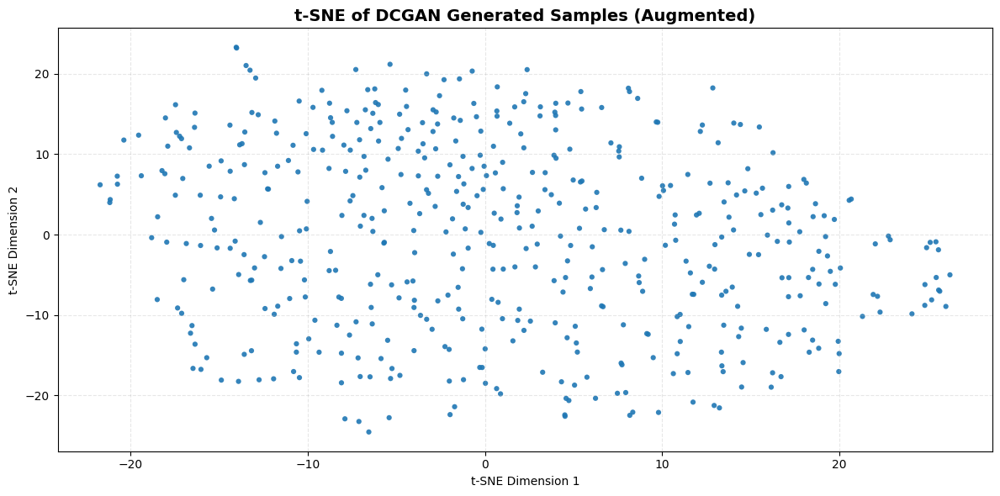

In [ ]:
# ========== Generate New Images from Random Noise ========== #
latent_dim = 100
noise = tf.random.normal([500, latent_dim])
generated_images = generator(noise, training=False)
generated_images = (generated_images + 1) / 2.0

def plot_tsne_embeddings(generated_images, save_path=None, title="t-SNE of DCGAN Generated Samples (Augmented)"):
    # ----- Convert to [0, 1] Range ----- #
    if tf.reduce_max(generated_images).numpy() > 1.0:
        raise ValueError("Images should be in [-1, 1] range before scaling.")

    images_rescaled = (generated_images + 1.0) / 2.0
    flat_images = images_rescaled.numpy().reshape(images_rescaled.shape[0], -1)

    # ----- Run t-SNE ----- #
    tsne = TSNE(n_components=2, perplexity=30, learning_rate='auto', init='pca', random_state=42)
    tsne_proj = tsne.fit_transform(flat_images)

    # ----- Plot t-SNE ----- #
    plt.figure(figsize=(12, 6))
    sns.scatterplot(
        x=tsne_proj[:, 0],
        y=tsne_proj[:, 1],
        s=20,
        alpha=0.9,
        edgecolor='none'
    )
    plt.title(title, fontsize=14, weight='bold')
    plt.xlabel("t-SNE Dimension 1")
    plt.ylabel("t-SNE Dimension 2")
    plt.grid(True, linestyle='--', alpha=0.3)
    plt.tight_layout()

    if save_path:
        plt.savefig(save_path, dpi=300)
        print(f"t-SNE plot saved to: {save_path}")

    plt.show()

plot_tsne_embeddings(generated_images=generated_images)

With reference to the t-SNE plot of DCGAN Generated Samples (Augmented) above, we are able to make the following observations:

**Reasonable Spread with Moderate Clustering**

- Samples are moderately spread out with signs of incipient clustering, suggesting the model captures some latent structure despite augmentation.

- Compared to SAGAN or DRAGAN, the point distribution is denser and more uniform, showing better latent embedding consistency.

**Improved Structural Balance**

- The overall shape is roughly elliptical, which reflects some level of learned structure in the latent space.

- Unlike random scatter seen in earlier augmented visualisations, this suggests DCGAN maintained a more robust internal representation under augmentation.

**Low Noise**

- Points are less scattered and show lower variance compared to noisier models, indicating that DCGAN is less sensitive to augmentation artefacts.

- This aligns with DCGAN's known stability advantage when batch norm and convolutional layers are carefully tuned.

**Diversity is Present**

- There is no evidence of mode collapse, and the sample points are well-distributed across both axes.

- This reflects that DCGAN generated visually and statistically diverse samples, even under augmentation.

With the observations indicated above, we will proceed to train another GAN Model using Augmented Data in the next sub-section.

---
## 5.3 Wasserstein GAN with Gradient Penalty Model Training

In this sub-section, we will be training a Wasserstein GAN with Gradient Penalty (WGAN-GP) for the EMNIST Dataset. The WGAN-GP mainly replaces the Jensen-Shannon Divergence with Wasserstein (Earth-Mover) Distance. Through this replacement, the WGAN-GP is capable of providing a smoother and more meaningful loss metric despite the Generator being far from the real Data Distrubution. This will ultimately lead to Better Gradients, Stability, Convergence and Reduce Mode Collapse. The relevant mathematical formulas are indicated below:

---
**Generator Loss:**

Purpose: The Generator Maximizes the Critic's Score on Fake Images

$$
L_G = -\mathbb{E}_{\tilde{x} \sim \mathbb{P}_g} \left[D(\tilde{x})\right]
$$

Where:
- $L_G$ = Generator Loss  
- $\tilde{x} \sim \mathbb{P}_g$ = Fake Data Sampled from Generator Distribution  
- $D(\tilde{x})$ = Critic's Prediction Score for Fake Input $\tilde{x}$  
- $\mathbb{E}$ = Expectation Operator

---
**Discriminator (Critic) Loss:**

Purpose: Trains Critic to give Higher Scores to Real Data and Lower Scores to Fake Data.

$$
L_D = \mathbb{E}_{\tilde{x} \sim \mathbb{P}_g} \left[D(\tilde{x})\right] - \mathbb{E}_{x \sim \mathbb{P}_r} \left[D(x)\right] + \lambda \cdot \mathbb{E}_{\hat{x} \sim \mathbb{P}_{\hat{x}}} \left[\left(\| \nabla_{\hat{x}} D(\hat{x}) \|_2 - 1\right)^2\right]
$$

Where:
- $D(x)$ = Critic Output for Real Input  
- $\mathbb{P}_r$ = Real Data Distribution  
- $\mathbb{P}_g$ = Generator (fake) Distribution  
- $\tilde{x}$ = Fake Sample from Generator
- $\hat{x}$ = Interpolated Sample Between Real and Fake  
- $\lambda$ = Gradient Penalty Coefficient (typically $\lambda = 10$)

---
**Gradient Penalty Term:**

Purpose: Enforces 1-Lipschitz Constraint via Soft Regularisation.

$$
GP = \mathbb{E}_{\hat{x} \sim \mathbb{P}_{\hat{x}}} \left[ \left(\| \nabla_{\hat{x}} D(\hat{x}) \|_2 - 1 \right)^2 \right]
$$

**Where:**
- $GP$ = Gradient Penalty Term  
- $\hat{x} = \epsilon x + (1 - \epsilon)\tilde{x}$ = Random Point along the Line Between Real and Fake Images  
- $\epsilon \sim \mathcal{U}(0, 1)$ = Random Number from Uniform Distribution  
- $\nabla_{\hat{x}} D(\hat{x})$ = Gradient of Critic Output with Respect to Interpolated Input  
- $\|\cdot\|_2$ = Euclidean Norm (L2 norm) of Gradient Vector

---
With the relevant mathematical formulas indicated above, we will proceed to train the WGAN-GP in this sub-section for the purpose of it's potential for smoother training process and also to serve as a comparison for our other GAN Models.

---
### 5.3.1 Defining Data Pre-Processing Function

In this sub-section, we will be defining the Data Pre-Processing Function which will allow for consistent Data Pipeline to be built and modifed accordingly should the need arise such as when we need to add Spectral Normalisation. This will ensure that the Data's integrity is not affected and we are able to make fair and un-biased assumptions. The Data Pre-Processing Function is defined in the Code Cell below:

In [ ]:
# ========== Data Pre-Processing Function ========== #
def load_data(X_train, batch_size=64):
    # ----- Trim X_train Down to Multiple of Batch_size ----- #
    n_full = (X_train.shape[0] // batch_size) * batch_size
    X_trimmed = X_train[:n_full]

    # ----- Compute Steps For Each Epoch ----- #
    steps_per_epoch = n_full // batch_size

    # ----- Build the ImageDataGenerator Iterator ----- #
    datagen_iter = datagen.flow(X_trimmed, batch_size=batch_size, shuffle=True)

    # ----- Wrap as a tf.data.Dataset with a Fixed-shape Signature ----- #
    dataset = tf.data.Dataset.from_generator(
        lambda: (next(datagen_iter) for _ in range(steps_per_epoch)),
        output_signature=tf.TensorSpec((batch_size, 28, 28, 1), tf.float32)
    )

    return dataset.prefetch(tf.data.AUTOTUNE)

With reference to the Code Cell above, we are able to determine that the Data Pre-Processing Function have been defined successfully and we are able to move on to Defining Callback Functions in the next sub-section.

---
### 5.3.2 Defining Callback Functions

In this sub-section, we will be pre-defining the various Callbacks. This is to ensure consistency throughout the model and also to increase the GAN Accuracy and optimise the Computation Cost for training each GAN Model. These Callbacks will be main used during the GAN Training in the next sub-section. We will proceed to Define the Callbacks in the Code Cell below in preparation for the GAN Model Training.

In [ ]:
# ========== Define Display Generated Images ========== #
def display_generated_images(generator, latent_dim, n=7):
    noise = tf.random.normal([n * n, latent_dim])
    generated_images = generator(noise, training=False)
    generated_images = (generated_images + 1.0) / 2.0

    fig, axes = plt.subplots(n, n, figsize=(n, n))
    for i in range(n):
        for j in range(n):
            img = generated_images[i * n + j, :, :, 0]
            axes[i, j].imshow(img, cmap='gray')
            axes[i, j].axis('off')

    plt.tight_layout()
    plt.show()

# ========== Define FID Calculator ========== #
def calculate_fid(real_images, fake_images, batch_size=10):

    # ----- Scale to [0,255] and Resize to 299×299 ----- #
    real = (real_images + 1.0) * 127.5
    fake = (fake_images + 1.0) * 127.5
    real = tf.image.resize(real, (299,299))
    fake = tf.image.resize(fake, (299,299))

    # ----- If Grayscale, Convert to RGB ----- #
    if real.shape[-1] == 1:
        real = tf.image.grayscale_to_rgb(real)
        fake = tf.image.grayscale_to_rgb(fake)

    # ----- Preprocess for Inception (–1 to +1) ----- #
    real_pp = preprocess_input(real)
    fake_pp = preprocess_input(fake)

    # ----- Extract Features in Batches ----- #
    def _get_acts(x):
        acts = []
        n = x.shape[0]
        for i in range(0, n, batch_size):
            chunk = x[i:i+batch_size]
            acts.append(_inception_model(chunk, training=False).numpy())
        return np.vstack(acts)

    act_real = _get_acts(real_pp)
    act_fake = _get_acts(fake_pp)

    # ----- Compute Statistics ----- #
    mu1, sigma1 = act_real.mean(axis=0), np.cov(act_real, rowvar=False)
    mu2, sigma2 = act_fake.mean(axis=0), np.cov(act_fake, rowvar=False)
    diff    = mu1 - mu2
    covmean = sqrtm(sigma1.dot(sigma2))
    if np.iscomplexobj(covmean):
        covmean = covmean.real
    fid = diff.dot(diff) + np.trace(sigma1 + sigma2 - 2*covmean)
    return float(np.round(fid,4))

# ========== Confirmation Message ========== #
print("WGAN-GP Visualisation Setup Complete")

WGAN-GP Visualisation Setup Complete


With reference to the Code Cell above, we are able to verify that that the Callbacks have been successfully defined and the various parameters are set so as to ensure a High Accuracy and Computing Efficient GAN Model Training.

---
### 5.3.3 Defining WGAN-GP Generator Architecture

In this section, we will be defining the  WGAN-GP's Generator Architecture. The Generator will be trying to make realistic generated images in the attempt to bypass the Discriminator. Subsequently, the generated images from the Generator will be evaluated based on a few evaluation metrics such as Inception Score. The relevent mathematical formulas for the Loss Function of the Vanilla GAN Generator is indicated below:

---
**Generator Loss:**

Purpose: The Generator Maximizes the Critic's Score on Fake Images

$$
L_G = -\mathbb{E}_{\tilde{x} \sim \mathbb{P}_g} \left[D(\tilde{x})\right]
$$

Where:
- $L_G$ = Generator Loss  
- $\tilde{x} \sim \mathbb{P}_g$ = Fake Data Sampled from Generator Distribution  
- $D(\tilde{x})$ = Critic's Prediction Score for Fake Input $\tilde{x}$  
- $\mathbb{E}$ = Expectation Operator

---
With the relevant Generator Loss Formula indicated above, we will proceed to define the GAN Generator's Architecture in the Code Cell below and the Lost Function.

In [ ]:
# ========== Generator Function ========== #
def build_generator(latent_dim=100, use_dropout=True):
    model = tf.keras.Sequential(name="generator")

    # ----- Project and Reshape ----- #
    model.add(tf.keras.layers.Dense(7 * 7 * 256, use_bias=False, input_shape=(latent_dim,)))
    model.add(tf.keras.layers.BatchNormalization())

    model.add(tf.keras.layers.ReLU())
    model.add(tf.keras.layers.Reshape((7, 7, 256)))

    # ----- Upsample 1 ----- #
    model.add(tf.keras.layers.Conv2DTranspose(128, kernel_size=5, strides=1, padding='same', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.ReLU())
    if use_dropout:
        model.add(tf.keras.layers.Dropout(0.3))

    # ----- Upsample 2 ----- #
    model.add(tf.keras.layers.Conv2DTranspose(64, kernel_size=5, strides=2, padding='same', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.ReLU())
    if use_dropout:
        model.add(tf.keras.layers.Dropout(0.3))

    # ----- Final Output to 28x28x1 ----- #
    model.add(tf.keras.layers.Conv2DTranspose(1, kernel_size=5, strides=2, padding='same', activation='tanh'))

    return model

# ========== Generator Loss Function ========== #
def generator_loss(fake_output):
    return -tf.reduce_mean(fake_output)

With reference to the Code Cell above, we are able to verify that the GAN's Generator Architecture have been successfully defined and we are able to proceed to define the GAN's Discriminator Architecture.

---
### 5.3.5 Defining WGAN-GP Discriminator Architecture

In this section, we will be defining the Architecture of the Discriminator of the GAN. The Discriminator will be the Neural Network that will attempt to tell the Generated Images apart from the Actual Images. This will allow the GAN to improve overtime and also improve itself overtime. The mathematical function for the Discriminator Loss Function is indicated below:

---
**Discriminator (Critic) Loss:**

Purpose: Trains Critic to give Higher Scores to Real Data and Lower Scores to Fake Data.

$$
L_D = \mathbb{E}_{\tilde{x} \sim \mathbb{P}_g} \left[D(\tilde{x})\right] - \mathbb{E}_{x \sim \mathbb{P}_r} \left[D(x)\right] + \lambda \cdot \mathbb{E}_{\hat{x} \sim \mathbb{P}_{\hat{x}}} \left[\left(\| \nabla_{\hat{x}} D(\hat{x}) \|_2 - 1\right)^2\right]
$$

Where:
- $D(x)$ = Critic Output for Real Input  
- $\mathbb{P}_r$ = Real Data Distribution  
- $\mathbb{P}_g$ = Generator (fake) Distribution  
- $\tilde{x}$ = Fake Sample from Generator
- $\hat{x}$ = Interpolated Sample Between Real and Fake  
- $\lambda$ = Gradient Penalty Coefficient (typically $\lambda = 10$)
---
With the mathematical formula for the Loss Function indicated above, we will proceed to define the GAN's Discriminator Architecture and the Loss Function in the Code Cell below.

In [ ]:
# ========== Critic Function ========== #
def build_critic(input_shape=(28, 28, 1)):
    model = tf.keras.Sequential(name="critic")

    # ----- Explicit Input Layer Ensures Model is Built Immediately ----- #
    model.add(tf.keras.layers.Input(shape=input_shape))

    # ----- Block 1 ----- #
    model.add(tf.keras.layers.Conv2D(
        64, kernel_size=5, strides=2, padding='same',
        kernel_initializer=tf.keras.initializers.RandomNormal(stddev=0.02)
    ))
    model.add(tf.keras.layers.LeakyReLU(negative_slope=0.2))

    # ----- Block 2 ----- #
    model.add(tf.keras.layers.Conv2D(
        128, kernel_size=5, strides=2, padding='same',
        kernel_initializer=tf.keras.initializers.RandomNormal(stddev=0.02)
    ))
    model.add(tf.keras.layers.LeakyReLU(negative_slope=0.2))

    # ----- Block 3 ----- #
    model.add(tf.keras.layers.Conv2D(
        256, kernel_size=5, strides=2, padding='same',
        kernel_initializer=tf.keras.initializers.RandomNormal(stddev=0.02)
    ))
    model.add(tf.keras.layers.LeakyReLU(negative_slope=0.2))

    # ----- Block 4 ----- #
    model.add(tf.keras.layers.Conv2D(
        512, kernel_size=3, strides=1, padding='same',
        kernel_initializer=tf.keras.initializers.RandomNormal(stddev=0.02)
    ))
    model.add(tf.keras.layers.LeakyReLU(negative_slope=0.2))

    # ----- Block 5 ----- #
    model.add(tf.keras.layers.Conv2D(
        512, kernel_size=3, strides=1, padding='same',
        kernel_initializer=tf.keras.initializers.RandomNormal(stddev=0.02)
    ))
    model.add(tf.keras.layers.LeakyReLU(negative_slope=0.2))

    # ----- Output ----- #
    model.add(tf.keras.layers.Flatten())
    model.add(tf.keras.layers.Dense(1))

    return model

# ========== Critic Loss Function ========== #
def discriminator_loss(real_output, fake_output):
    return tf.reduce_mean(fake_output) - tf.reduce_mean(real_output)

With reference to the Code Cell above, we are able to verify that the GAN's Discriminator Architecture have been successfully defined and we are able to proceed to define the GAN's Training Steps.

---
### 5.3.6 Defining Training Step

In this section, we will be Defining the Training Step function so as to train both the Generator and the Discriminator at the same time. The Training Step will compute the gradients for both the Generator and the Discriminator at the same time. The relevant mathematical formulas for the Training Step is indicated below:

---
**Generator Loss:**

Purpose: The Generator Maximizes the Critic's Score on Fake Images

$$
L_G = -\mathbb{E}_{\tilde{x} \sim \mathbb{P}_g} \left[D(\tilde{x})\right]
$$

Where:
- $L_G$ = Generator Loss  
- $\tilde{x} \sim \mathbb{P}_g$ = Fake Data Sampled from Generator Distribution  
- $D(\tilde{x})$ = Critic's Prediction Score for Fake Input $\tilde{x}$  
- $\mathbb{E}$ = Expectation Operator

---
**Discriminator (Critic) Loss:**

Purpose: Trains Critic to give Higher Scores to Real Data and Lower Scores to Fake Data.

$$
L_D = \mathbb{E}_{\tilde{x} \sim \mathbb{P}_g} \left[D(\tilde{x})\right] - \mathbb{E}_{x \sim \mathbb{P}_r} \left[D(x)\right] + \lambda \cdot \mathbb{E}_{\hat{x} \sim \mathbb{P}_{\hat{x}}} \left[\left(\| \nabla_{\hat{x}} D(\hat{x}) \|_2 - 1\right)^2\right]
$$

Where:
- $D(x)$ = Critic Output for Real Input  
- $\mathbb{P}_r$ = Real Data Distribution  
- $\mathbb{P}_g$ = Generator (fake) Distribution  
- $\tilde{x}$ = Fake Sample from Generator
- $\hat{x}$ = Interpolated Sample Between Real and Fake  
- $\lambda$ = Gradient Penalty Coefficient (typically $\lambda = 10$)

---
**Gradient Penalty Term:**

Purpose: Enforces 1-Lipschitz Constraint via Soft Regularisation.

$$
GP = \mathbb{E}_{\hat{x} \sim \mathbb{P}_{\hat{x}}} \left[ \left(\| \nabla_{\hat{x}} D(\hat{x}) \|_2 - 1 \right)^2 \right]
$$

**Where:**
- $GP$ = Gradient Penalty Term  
- $\hat{x} = \epsilon x + (1 - \epsilon)\tilde{x}$ = Random Point along the Line Between Real and Fake Images  
- $\epsilon \sim \mathcal{U}(0, 1)$ = Random Number from Uniform Distribution  
- $\nabla_{\hat{x}} D(\hat{x})$ = Gradient of Critic Output with Respect to Interpolated Input  
- $\|\cdot\|_2$ = Euclidean Norm (L2 norm) of Gradient Vector

---

With the relevant mathematical formulas indicated above, we will proceed to define the Training Step in the Code Cell below.

In [ ]:
# ========== Training Step ========== #
@tf.function
def train_step(real_images,
               generator, critic,
               gen_optimizer, critic_optimizer,
               latent_dim, gp_weight):
    bs = tf.shape(real_images)[0]
    noise = tf.random.uniform([bs, latent_dim], -1.0, 1.0)

    # ----- Critic Update ----- #
    with tf.GradientTape(persistent=True) as tape:
        fake_images = generator(noise, training=True)
        real_score  = critic(real_images, training=True)
        fake_score  = critic(fake_images, training=True)

        # ----- WGAN‐GP Losses ----- #
        base_loss = tf.reduce_mean(fake_score) - tf.reduce_mean(real_score)
        alpha     = tf.random.uniform([bs,1,1,1], 0.0, 1.0)
        interp    = alpha * real_images + (1-alpha) * fake_images
        tape.watch(interp)
        interp_score = critic(interp, training=True)
        grads        = tape.gradient(interp_score, interp)
        grads_norm   = tf.sqrt(tf.reduce_sum(grads**2, axis=[1,2,3]) + 1e-12)
        gp           = tf.reduce_mean((grads_norm - 1.0)**2)

        c_loss = base_loss + gp_weight * gp

    c_grads = tape.gradient(c_loss, critic.trainable_variables)
    critic_optimizer.apply_gradients(zip(c_grads, critic.trainable_variables))
    del tape

    # ----- Generator Update ----- #
    with tf.GradientTape() as tape_g:
        fake_images = generator(noise, training=True)
        fake_score2 = critic(fake_images, training=True)
        g_loss      = -tf.reduce_mean(fake_score2)

    g_grads = tape_g.gradient(g_loss, generator.trainable_variables)
    gen_optimizer.apply_gradients(zip(g_grads, generator.trainable_variables))

    # ----- Return Data ----- #
    return g_loss, c_loss, real_score, fake_score

With reference to the Code Cell above, we are able to determine that the Training Step have been successfully defined and we are able to proceed to prepare the Training Loop in the next section.

---
### 5.3.7 Defining Training Loop

In this section, we will be defining the Training Loop for the GAN Training. The Training Loop will go through each of the Epoch and train both the Generator and Discriminator simultaneously. The Training Loop will also track the Loss for both the Generator and the Discriminator for each of the Epoch trained. The relevant mathematical formulas are indicated below:

---
**Epoch Loss Averaging:**

Purpose: These are the Average Generator and Discriminator Losses over all Batches in Epoch $t$.

$$
\bar{L}_G^{(t)} = \frac{1}{N} \sum_{i=1}^{N} L_G^{(i)} \\
\bar{L}_D^{(t)} = \frac{1}{N} \sum_{i=1}^{N} L_D^{(i)}
$$

Where:
- $\bar{L}_G^{(t)}$ = Average Generator Loss at Epoch $t$  
- $\bar{L}_D^{(t)}$ = Average Discriminator Loss at Epoch $t$  
- $N$ = Number of Batches in the Dataset  
- $L_G^{(i)}$ = Generator Loss on Batch $i$  
- $L_D^{(i)}$ = Discriminator Loss on Batch $i$

---
**Epoch Iteration:**

Purpose: Describes the Training Loop Logic: for Each Epoch $t$, perform `train_step` for Every Mini-batch.

$$
\text{for } t = 1 \text{ to } T:
\quad \text{for each batch } (x^{(i)}):
\quad \text{train_step}(x^{(i)})
$$

Where:
- $T$: Total Number of Epochs  
- $x^{(i)}$: Real Batch $i$ from the Dataset  
- `train_step`: Function that Updates $G$ and $D$ using that Batch

---
**Generated Image Output:**

Purpose: Sample Random Noise $z$ and Generate Synthetic Image $\hat{x}$ from the Generator. This is used for Visual Monitoring of Model Quality.

$$
z \sim p_z(z) \\
\hat{x} = G(z)
$$

Where:
- $z$: Random Latent Vector  
- $G(z)$: Generated Image from Generator

---
With the mathematical formulas indicated above, we will proceed to define the Training Loop in the Code Cell below in preparation of the GAN Training.

In [ ]:
def train(dataset, epochs, generator, critic, gen_optimizer, critic_optimizer, latent_dim, gp_weight=1.0, n_critic=5, steps_per_epoch=None, save_path=None):

    # ----- Early-stopping via FID on a Fixed Val-batch ----- #
    real_val = tf.data.Dataset.from_tensor_slices(X_val).batch(50).take(1)
    # ----- Uniform Noise ----- #
    noise_val = tf.random.uniform([50, latent_dim], -1.0, 1.0)

    best_fid, no_improve = float('inf'), 0
    patience, fid_interval = 15, 1
    gen_hist, crit_hist = [], []
    critic_losses = []

    for epoch in range(1, epochs+1):
        gen_losses, crit_losses = [], []
        for i, real_images in enumerate(dataset):
            if steps_per_epoch and i >= steps_per_epoch:
                break
            # ----- Critic Steps ----- #
            for _ in range(n_critic):
                g_l, c_l, real_out, fake_out = train_step(
                    real_images,
                    generator, critic,
                    gen_optimizer, critic_optimizer,
                    latent_dim, gp_weight
                )
                crit_losses.append(c_l)
            gen_losses.append(g_l)

        avg_g = tf.reduce_mean(gen_losses)
        avg_c = tf.reduce_mean(crit_losses)
        print(f"Epoch {epoch}/{epochs}  G-loss: {avg_g:.4f}  C-loss: {avg_c:.4f}")
        gen_hist.append(float(avg_g))
        crit_hist.append(float(avg_c))

        if epoch % 5 == 0:
            display_generated_images(generator, latent_dim)

        # ----- FID Check ----- #
        if epoch % fid_interval == 0:
            fake_val = generator(noise_val, training=False)
            real_batch = next(iter(real_val))
            real_res = tf.image.resize(real_batch, [299,299]) * 0.5 + 0.5
            fake_res = tf.image.resize(fake_val,    [299,299]) * 0.5 + 0.5
            fid_score = calculate_fid(real_res, fake_res)
            print(f" → Val FID: {fid_score:.2f}")
            if fid_score < best_fid:
                best_fid, no_improve = fid_score, 0
                if save_path:
                    os.makedirs(save_path, exist_ok=True)
                    generator.save_weights(os.path.join(save_path, "best_gen.weights.h5"))
                    critic.save_weights(os.path.join(save_path, "best_crt.weights.h5"))
            else:
                no_improve += 1
            if no_improve >= patience:
                print("No FID improvement, stopping early.")
                break

    # ----- Restore Best Weights After Training ----- #
    if save_path:
        best_gen_path = os.path.join(save_path, "best_gen.weights.h5")
        best_crt_path = os.path.join(save_path, "best_crt.weights.h5")
        if os.path.exists(best_gen_path) and os.path.exists(best_crt_path):
            generator.load_weights(best_gen_path)
            critic.load_weights(best_crt_path)
            print("Restored best generator and critic weights based on lowest FID.")
        else:
            print("Best weight files not found. Skipping restore.")

    return float(avg_g), gen_hist, crit_hist

With reference to the Code Cell above, we are able to determine that the Training Loop have been successfully defined and we are able to proceed to define the Optimisers with Tunable Parameter in preparation for the Optuna Tuning.

---
### 5.3.8 Defining Optimisers with Tunable Parameters

In this section, we will be defining the Common Optimisers that will be Tuned using the Optuna Tuning. The Optimisers will each have a range of values in a list so as to allow for the Optuna to search for the best Hyperparameter for the GAN. Through these parameters, it will affect how effective and efficiently the GAN will learn from the provided EMNIST Data. The relevent mathematical formula is indicated below:

---
**Optimiser Update Rule**

Purpose: Parameter Update Step in the Adam Optimiser, using Adaptive Learning Rates with Momentum.

$$
\theta \leftarrow \theta - \eta \cdot \frac{m_t}{\sqrt{v_t} + \epsilon}
$$

Where:
- $\theta$ = Model Parameters (Generator or Discriminator)
- $\eta$ = Learning Rate (Tuned)
- $m_t$ = First Moment Estimate (Mean of Gradients)
- $v_t$ = Second Moment Estimate (Variance of Gradients)
- $\epsilon$ = Small Constant for Numerical Stability

---
With the mathematical formula indicated above, we will proceed to define the Optimisers in the Code Cell.

In [ ]:
# ========== Objective Function ========== #
def objective(trial):
    # ----- Hyperparameters ----- #
    latent_dim    = trial.suggest_categorical('latent_dim', [100, 128, 160])
    learning_rate = trial.suggest_float('learning_rate', 5e-5, 2e-4, log=True)
    beta_1        = trial.suggest_float('beta_1', 0.0, 0.5)

    # ----- Build Models ----- #
    generator = build_generator(latent_dim=latent_dim)
    critic    = build_critic(input_shape=(28, 28, 1))

    # ----- Dummy Forward Pass ----- #
    _ = generator(tf.random.normal([1, latent_dim]))
    _ = critic(tf.random.normal([1, 28, 28, 1]))

    # ----- Optimizers ----- #
    gen_optimizer    = tf.keras.optimizers.Adam(learning_rate=learning_rate, beta_1=beta_1, beta_2=0.9)
    critic_optimizer = tf.keras.optimizers.Adam(learning_rate=learning_rate, beta_1=beta_1, beta_2=0.9)

    # ----- Optimizer Vars Init ----- #
    _ = gen_optimizer.apply_gradients([(tf.zeros_like(v), v) for v in generator.trainable_variables])
    _ = critic_optimizer.apply_gradients([(tf.zeros_like(v), v) for v in critic.trainable_variables])

    # ----- Load Data ----- #
    dataset = load_data(X_train, batch_size=64)
    steps   = min(1000, len(X_train) // 64)

    # ----- Train WGAN-GP ----- #
    _gen_loss, _critic_loss, _ = train(
        dataset=dataset,
        epochs=50,
        generator=generator,
        critic=critic,
        gen_optimizer=gen_optimizer,
        critic_optimizer=critic_optimizer,
        latent_dim=latent_dim,
        gp_weight=1.0,
        n_critic=5,
        steps_per_epoch=steps,
        save_path=None
    )

    # ----- Generate Fake Images ----- #
    noise       = tf.random.normal([1000, latent_dim])
    fake_images = generator(noise, training=False)
    fake_images = (fake_images + 1.0) / 2.0

    # ----- Real Images ----- #
    real_images = X_val[:1000]

    # ----- Compute FID ----- #
    fid_score = calculate_fid(real_images, fake_images)

    return float(fid_score)

With reference to the Code Cell above, we are able to determine that the Optimiser have been successfully defined with a range of different Parameter Values so as to provide a robust Optuna Tuning in the subsequent sections.

---
### 5.3.9 Optuna Tuning Study

In this sub-section, we will be conducting the Optuna Tuning Study on the GAN Model so as to obtain the best Hyperparameter for the GAN Model. It is expected that the Tuning takes a prolonged duration due to the nature of how the GAN works and the 2 Neural Networks involved. However, the training data will be stored so as to prevent re-running of repetitive codes. The Optuna Tuning Study will be conducted in the Code Cell below.

In [ ]:
# ========== Create or Load Study with SQLite Backend ========== #
study = optuna.create_study(
    direction="minimize",
    study_name="wgan_gp_tuning",
    storage="sqlite:////content/drive/MyDrive/Colab Notebooks/DELE CA2 A/Augmented GAN Tunings/wgan_gp_optuna.db",
    load_if_exists=True
)

# ========== Trial Management ========== #
MAX_TRIALS = 20
completed_trials = len([t for t in study.trials if t.state == optuna.trial.TrialState.COMPLETE])
remaining_trials = MAX_TRIALS - completed_trials

if remaining_trials > 0:
    print(f"Resuming WGAN-GP study: {completed_trials} completed, running {remaining_trials} more.")
    study.optimize(objective, n_trials=remaining_trials)
else:
    print(f"WGAN-GP study already completed {MAX_TRIALS} trials. Skipping optimization.")

# ========== Output Best Trial ========== #
best_trial = study.best_trial
best_params_df = pd.DataFrame([best_trial.params])
best_params_df["Final FID"] = best_trial.value
best_params_df.style.background_gradient(cmap="Blues")

[I 2025-08-10 11:12:04,682] Using an existing study with name 'wgan_gp_tuning' instead of creating a new one.


WGAN-GP study already completed 20 trials. Skipping optimization.


,latent_dim,learning_rate,beta_1,Final FID
0,160,0.000071,0.248598,41.437400


With reference to the Code Cell above, we are able to view the Best Hyperparameter obtained during the Optuna Tuning Study. This Hyperparameter will be extracted and be trained for a longer period of time so as to attempt to increase the performance and limit the loss for the GAN.

---
### 5.3.10 GAN Re-Training Operation

As obtained from the previous sub-section, we will be re-training the GAN using the best Hyperparameter obtained during the Optuna Tuning Study. This is to push the GAN Model to its limits and also to save Computational Power as we are not taking up prolonged periods of time tuning GAN Models which may not have any clear signs of good performance. The retraining of the GAN Model will be conducted in the Code Cell below.

In [ ]:
# ========== Extract Best Parameters from Study ========== #
best_params = study.best_trial.params

latent_dim   = best_params['latent_dim']
learning_rate = best_params['learning_rate']
beta_1       = best_params['beta_1']

print("Using Best Trial Parameters for WGAN-GP:")
print(best_params)

# ========== Rebuild WGAN-GP Models ========== #
generator = build_generator(latent_dim=latent_dim)
critic    = build_critic(input_shape=(28, 28, 1))

# Trigger variable creation
_ = generator(tf.random.normal([1, latent_dim]))
_ = critic(tf.random.normal([1, 28, 28, 1]))

# ========== Initialise Optimisers ========== #
gen_optimizer    = tf.keras.optimizers.Adam(learning_rate=learning_rate, beta_1=0.0, beta_2=0.9)
critic_optimizer = tf.keras.optimizers.Adam(learning_rate=learning_rate, beta_1=0.0, beta_2=0.9)

_ = gen_optimizer.apply_gradients([(tf.zeros_like(v), v) for v in generator.trainable_variables])
_ = critic_optimizer.apply_gradients([(tf.zeros_like(v), v) for v in critic.trainable_variables])

# ========== Reload Dataset ========== #
dataset = load_data(X_train)

# ========== Define Paths ========== #
model_name   = "wgan_gp"
output_dir   = "/content/drive/MyDrive/Colab Notebooks/DELE CA2 A/final_outputs_wgan_gp_augment"
weights_path = os.path.join(output_dir, "augmented_wgangp_generator_final.weights.h5")
gen_ckpt     = os.path.join(output_dir, "best_gen.weights.h5")
disc_ckpt    = os.path.join(output_dir, "best_crt.weights.h5")
loss_csv     = os.path.join(output_dir, "loss_history.csv")

os.makedirs(output_dir, exist_ok=True)

# ========== Load or Train ========== #
if os.path.exists(gen_ckpt) and os.path.exists(disc_ckpt) and os.path.exists(loss_csv):
    print("All outputs found. Skipping training...")

    generator.load_weights(gen_ckpt)
    critic.load_weights(disc_ckpt)
    print("WGAN-GP (Augmented) weights loaded.")

    loss_df = pd.read_csv(loss_csv)
    gen_loss_history  = loss_df['gen_loss'].tolist()
    disc_loss_history = loss_df['disc_loss'].tolist()
    final_gen_loss    = gen_loss_history[-1]

else:
    final_gen_loss, gen_loss_history, disc_loss_history = train(
        dataset=dataset,
        epochs=100,
        steps_per_epoch=1546,
        generator=generator,
        critic=critic,
        gen_optimizer=gen_optimizer,
        critic_optimizer=critic_optimizer,
        latent_dim=latent_dim,
        save_path=output_dir
    )

    generator.save_weights(weights_path)
    print("Generator Weights Saved.")

    loss_df = pd.DataFrame({
        'epoch': list(range(1, len(gen_loss_history) + 1)),
        'gen_loss': gen_loss_history,
        'disc_loss': disc_loss_history
    })
    loss_df.to_csv(loss_csv, index=False)
    print(f"Loss history saved to {loss_csv}")

Using Best Trial Parameters for WGAN-GP:
{'latent_dim': 160, 'learning_rate': 7.056298079905481e-05, 'beta_1': 0.2485975866973869}


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:93: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


All outputs found. Skipping training...
WGAN-GP (Augmented) weights loaded.


With reference to the Code Cell above, we are able to determine that the best GAN Model have been trained and saved successfully and we are able to proceed with the Model Evaluation in the next sub-sections where we determine how well the GAN Model performed based on various metrics and evaluation methodologies.

---
### 5.3.11 GAN Model Evaluation

In this sub-section, we will be evaluating the GAN's Generator performance on various aspects. We will be utilising different methodologies and metrics to attempt to quantify the performance of the GAN Generator while also conducting Visual Inspection on the result output of the GAN. The Evaluation will be conducted in the following sections.

---
#### 5.3.11.1 Visual Grid of Samples

In this sub-section, we will be visualising the Grid of Samples of the Synthesised Data generated by the GAN Model. A list of observations will be made before the utilisation of Quantitative Metrics to evaluate the GAN Generator's general performance. As the observations made are purely from professional opinion, it will most likely not be used as a Basis of Comparison between GAN Models due to differing opinions unless in extreme cases. The visualisation will be conducted in the Code Cell below.

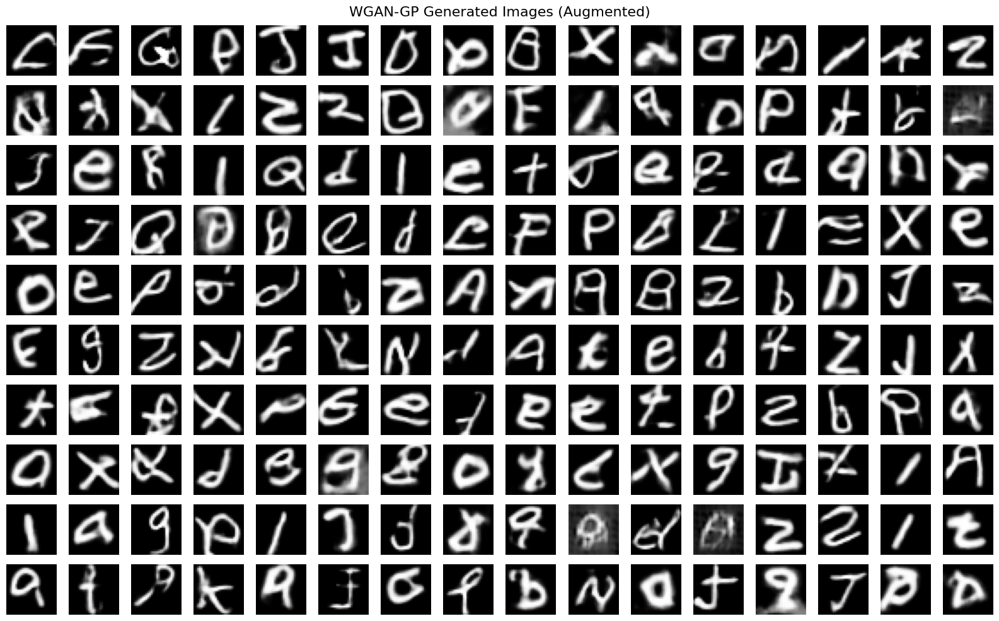

In [ ]:
def plot_generated_images(generator, latent_dim, n_rows=5, n_cols=5, save_path=None, title="WGAN-GP Generated Images (Augmented)", seed=42):
    # ----- Generate Latent Vectors ----- #
    if seed is not None:
        tf.random.set_seed(seed)
    noise = tf.random.normal([n_rows * n_cols, latent_dim])
    gen_images = generator(noise, training=False)

    # ----- Rescale from [-1, 1] to [0, 1] ----- #
    gen_images = (gen_images + 1.0) / 2.0
    gen_images = tf.clip_by_value(gen_images, 0.0, 1.0)

    # ----- Shape Check ----- #
    assert gen_images.shape[-1] == 1, "Expected single-channel (grayscale) output"

    # ----- Sample Plot ----- #
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols, n_rows))
    for idx, ax in enumerate(axes.flat):
        ax.imshow(gen_images[idx, :, :, 0], cmap='gray')
        ax.axis('off')

    plt.suptitle(title, fontsize=16)
    plt.tight_layout()

    if save_path:
        plt.savefig(save_path, dpi=300)
        print(f"Saved Generated Image Grid to: {save_path}")

    plt.show()

# ========== Plot Function Call ========== #
plot_generated_images(generator, latent_dim=160, n_rows=10, n_cols=16)

With reference to the output of the Visual Grid of Samples above, we are able to make the following observations:

**Basic Structure of Letters is Captured**

- Many characters resemble distinct and meaningful forms such as "R", "J", "Z", "E", and "P".

- The strokes are smooth and exhibit strong alignment with handwritten EMNIST characters.

**Some Blur and Noise**

- A few samples show light smudging or blurred edges, but overall sharpness is retained in most characters.

- Some minor artefacts or low-contrast areas appear in a handful of images.

With the observations indicated above, we will proceed to conduct the Loss Curve Analysis in the next sub-section.

---
#### 5.3.11.2 Loss Curve Over Epochs

In this sub-section, we will be plotting the GAN Loss Curve over Epochs to evaluate the training behaviour of the GAN. This curve provides insight into whether the GAN is experiencing underfitting, overfitting, or achieving a stable training dynamic between the generator and discriminator.

Although GANs do not minimise a single unified loss in the traditional sense, the trajectory of the generator and discriminator losses can indicate whether the adversarial training process is converging appropriately.

If the generator loss remains high while discriminator loss quickly drops to near-zero, this may indicate **underfitting**, where the generator is not learning effectively to produce plausible images.

If the discriminator loss increases while generator loss sharply decreases, this may suggest **overfitting** or **mode collapse**, where the generator exploits narrow weaknesses in the discriminator without general improvement.

A relatively stable oscillation or convergence between both losses typically signifies a **well-balanced** training process, where the generator and discriminator are learning in tandem.

The Potential Observations and Corresponding Action Plans are outlined below:

**Underfitting Loss Curve**

- Increase training epochs to allow generator more time to learn.

- Simplify the discriminator to reduce overpowering the generator.

- Adjust the learning rate or apply label smoothing.

- Consider adding batch normalisation in the generator.

**Overfitting or Mode Collapse Loss Curve**

- Introduce or increase dropout in the discriminator.

- Apply input noise or label flipping to the discriminator.

- Evaluate diversity of generated samples regularly.

**Balanced/Ideal Loss Curve**

- Maintain current architecture and hyperparameters.

- Proceed with full-scale image generation.

- Evaluate both qualitative (visual inspection) and quantitative metrics (e.g. Inception Score or FID).

With these potential training behaviours and action plan outlined, we will proceed to visualise the GAN loss dynamics in the code cell below.

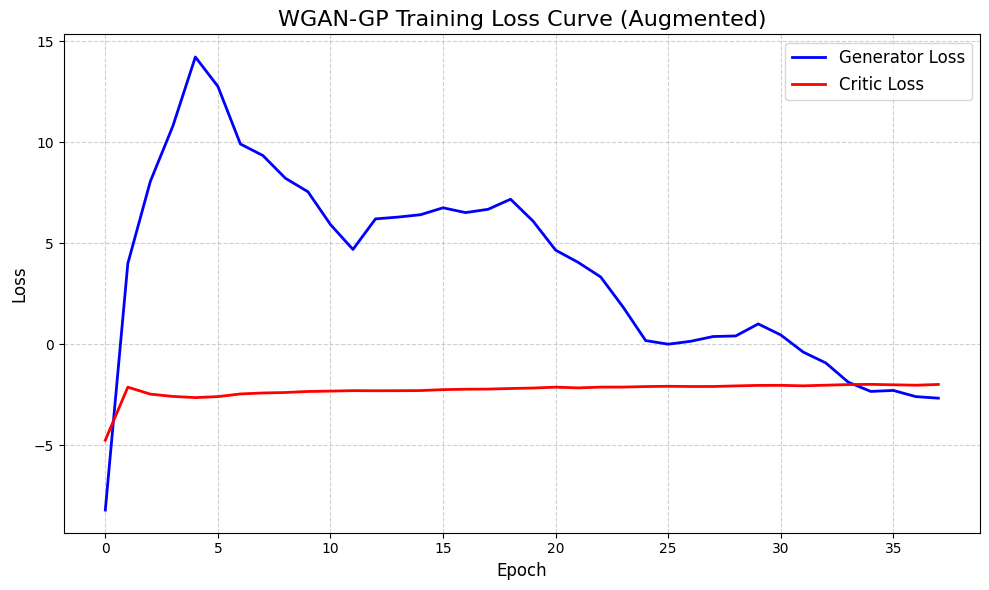

In [ ]:
# ========== Figure Size Configuration ========== #
plt.figure(figsize=(10, 6))

# ========== Plot Training Losses ========== #
plt.plot(gen_loss_history, label="Generator Loss", linewidth=2, color='blue')
plt.plot(disc_loss_history, label="Critic Loss", linewidth=2, color='red')

# ========== Labels and Title ========== #
plt.xlabel("Epoch", fontsize=12)
plt.ylabel("Loss", fontsize=12)
plt.title("WGAN-GP Training Loss Curve (Augmented)", fontsize=16)

# ========== Grid, Legend, and Styling ========== #
plt.grid(True, linestyle='--', alpha=0.6)
plt.legend(fontsize=12)
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)

# ========== Display the Plot ========== #
plt.tight_layout()
plt.show()

With reference to the Loss Curve above, we are able to make the following observations:

- Training is stable and healthy, with proper adversarial dynamics.

- Data augmentation results in More challenging learning early on and Better generalisation in later epochs.

- WGAN-GP continues to prevent mode collapse and helps generator recover after mid-training dip.

With the observations indicated above, we will proceed to conduct the Quantitative Metrics Evaluation in the next sub-section.

---
#### 5.3.11.3 Quantitative Metrics Evaluation

In this sub-section we will be utilising Quantitative Metrics such as FID and KID to tabulate the results of the performance and quantify the performance of the GAN Generator. We will subsequently be use these metrics to conduct inter-model evaluation after tuning and training all the GANs. The metrics that we will be utilising and their respective formulas are indicated below:

---
**Fréchet Inception Distance**

Purpose: Measures the Distance between the Real-Image and Generated-Image Distributions in Inception Feature Space.

$$
\mathrm{FID} \;=\;\|\mu_r - \mu_f\|^2
\;+\;\mathrm{Tr}\Bigl(\Sigma_r + \Sigma_f - 2\,(\Sigma_r\,\Sigma_f)^{\tfrac12}\Bigr)
$$


Where:
- $\mu_r = \mathbb{E}[f(x)]$, $\Sigma_r = \mathrm{Cov}[f(x)]$ for Real Images $x$.  
- $\mu_f = \mathbb{E}[f(\hat x)]$, $\Sigma_f = \mathrm{Cov}[f(\hat x)]$ for Generated Images $\hat x$.  
- $f(\cdot)$ = Map from Image to its InceptionV3 'pooling=avg' Features.  

---
**Diversity (t-SNE Spread)**

Purpose: Quantifies how 'wide' the 2D t-SNE Embedding of Generated Samples.

$$
\mathrm{Spread}
\;=\;
\bigl(\max_i\,z_i^{(1)} - \min_i\,z_i^{(1)}\bigr)
\;\times\;
\bigl(\max_i\,z_i^{(2)} - \min_i\,z_i^{(2)}\bigr)
$$

Where:
- $z_i = (z_i^{(1)}, z_i^{(2)})$ = 2-dimensional t-SNE Embedding of $i$th Generated Image.

---
**Mode Collapse Risk**

Purpose: Flags when too many Generated Images are Nearly Identical (mode collapse).

$$
\text{ModeCollapseRisk} =
\begin{cases}
\text{Low}, & \dfrac{\bigl|\{\mathrm{unique\_rounded}(x_i)\}\bigr|}{N} > \tau,\\
\text{High}, & \text{otherwise}.
\end{cases}
$$

Where:
- $x_i$ = $N$ Generated Samples.  
- $\mathrm{unique\_rounded}(x_i)$ = Rounds Pixels to Detect Duplicates.  
- $\tau=0.9$ = Uniqueness Threshold (90%).

---
**Perceptual Path Length**

Purpose: Measures Sensitively of Generator's Outputs (in VGG16 Feature Space) move when the Latent Code $z$ is Perturbed.

$$
\mathrm{PPL}
\;=\;
\mathbb{E}_{z,\delta z}\Bigl[\,
\|\phi\bigl(G(z + \epsilon\,\delta z)\bigr)\;-\;\phi\bigl(G(z)\bigr)\|_2^2
\Bigr]
$$

Where:  
- $G(z)$ = GAN Generator Mapping $z\in\mathbb{R}^{\mathrm{latent\_dim}}$ to an Image.  
- $\phi(\cdot)$ = VGG16 'pooling=avg' Feature Extractor.  
- $\delta z\sim\mathcal{N}(0,I)$, $\epsilon$ = Small Constant.

---
**Kernel Inception Distance**

Purpose: An Unbiased Estimator of the Squared Maximum Mean Discrepancy (MMD) between Real and Generated Inception Features.

$$
\mathrm{KID}
\;=\;
\frac{1}{m(m-1)}\sum_{i\neq j} k\bigl(\phi(x_i),\phi(x_j)\bigr)
\;+\;
\frac{1}{n(n-1)}\sum_{i\neq j} k\bigl(\phi(\hat x_i),\phi(\hat x_j)\bigr)
\;-\;
\frac{2}{mn}\sum_{i=1}^m\sum_{j=1}^n k\bigl(\phi(x_i),\phi(\hat x_j)\bigr)
$$

Where:  
- $x_i$ ($i=1\ldots m$) = Real Images.
- $\hat x_j$ ($j=1\ldots n$) = Generated Images.  
- $\phi(\cdot)$ = InceptionV3 Feature Extractor (pooling='avg').  
- $k(u,v) = \bigl(\frac{u^\top v}{d}+1\bigr)^3$ = degree-3 Polynomial Kernel on $d$-dimensional Features.

---

With the mathematical and metrics indicated above, we will proceed to conduct the Quantitave Metrics Evalution in the Code Cell below.

In [ ]:
# ========== Preload InceptionV3 and VGG16 Models ========== #
inception = InceptionV3(include_top=False, pooling='avg', input_shape=(299, 299, 3))
vgg_model = VGG16(include_top=False, weights='imagenet', input_shape=(128, 128, 3))

# ========== Preprocess for Inception ========== #
def preprocess_images_for_inception(images):
    images = (images + 1.0) * 127.5  # Scale from [-1, 1] to [0, 255]
    images = tf.image.resize(images, [299, 299])
    if images.shape[-1] == 1:
        images = tf.image.grayscale_to_rgb(images)
    return preprocess_input(images)

# ========== Compute FID ========== #
def calculate_fid(real_images, fake_images, batch_size=50):
    real_pp = preprocess_images_for_inception(real_images)
    fake_pp = preprocess_images_for_inception(fake_images)

    act1 = inception.predict(real_pp, batch_size=batch_size, verbose=0)
    act2 = inception.predict(fake_pp, batch_size=batch_size, verbose=0)

    mu1, sigma1 = np.mean(act1, axis=0), np.cov(act1, rowvar=False)
    mu2, sigma2 = np.mean(act2, axis=0), np.cov(act2, rowvar=False)

    diff = mu1 - mu2
    covmean = sqrtm(sigma1 @ sigma2)
    if np.iscomplexobj(covmean):
        covmean = covmean.real

    fid = diff @ diff + np.trace(sigma1 + sigma2 - 2 * covmean)
    return round(fid, 4)

# ========== Compute KID ========== #
def polynomial_kernel(X, Y):
    d = X.shape[1]
    return (np.dot(X, Y.T) / d + 1) ** 3

def calculate_kid(real_images, fake_images, batch_size=128):
    real_pp = preprocess_images_for_inception(real_images)
    fake_pp = preprocess_images_for_inception(fake_images)

    real_features = inception.predict(real_pp, batch_size=batch_size, verbose=0)
    fake_features = inception.predict(fake_pp, batch_size=batch_size, verbose=0)

    m = real_features.shape[0]
    n = fake_features.shape[0]

    k_rr = polynomial_kernel(real_features, real_features)
    k_gg = polynomial_kernel(fake_features, fake_features)
    k_rg = polynomial_kernel(real_features, fake_features)

    np.fill_diagonal(k_rr, 0)
    np.fill_diagonal(k_gg, 0)

    mmd = (k_rr.sum() / (m * (m - 1)) +
           k_gg.sum() / (n * (n - 1)) -
           2 * k_rg.mean())
    return round(mmd, 4)

# ========== Compute t-SNE Spread (Diversity) ========== #
def calculate_tsne_spread(images):
    flat = images.reshape(images.shape[0], -1)
    tsne = TSNE(n_components=2, random_state=42)
    proj = tsne.fit_transform(flat)
    x_range = proj[:, 0].max() - proj[:, 0].min()
    y_range = proj[:, 1].max() - proj[:, 1].min()
    return round(x_range * y_range, 2)

# ========== Assess Mode Collapse ========== #
def assess_mode_collapse(images):
    unique = np.unique(np.round(images), axis=0).shape[0]
    return "Low" if unique > 0.9 * images.shape[0] else "High"

# ========== Compute Perceptual Path Length (PPL) ========== #
def calculate_ppl(generator, latent_dim=160, num_samples=50, epsilon=1e-2):
    distances = []
    for _ in range(num_samples):
        z1 = tf.random.normal([1, latent_dim])
        z2 = z1 + epsilon * tf.random.normal([1, latent_dim])
        img1 = generator(z1, training=False)
        img2 = generator(z2, training=False)

        img1 = tf.image.resize(tf.image.grayscale_to_rgb((img1 + 1.0) * 127.5), (128, 128))
        img2 = tf.image.resize(tf.image.grayscale_to_rgb((img2 + 1.0) * 127.5), (128, 128))

        f1 = vgg_model(vgg_preprocess(img1))
        f2 = vgg_model(vgg_preprocess(img2))
        d = tf.reduce_mean(tf.square(f1 - f2)).numpy()
        distances.append(d)
    return round(np.mean(distances), 4)

# ========== Evaluate GAN Performance ========== #
def evaluate_gan_model(generator, latent_dim, X_val, gen_loss_history, disc_loss_history, model_name="WGAN-GP"):
    # ----- Generate Fake Images ----- #
    noise = tf.random.normal([1000, latent_dim])
    fake_images = generator(noise, training=False)
    fake_images = tf.clip_by_value((fake_images + 1) / 2.0, 0.0, 1.0)
    fake_np = fake_images.numpy()

    # ----- Select and preprocess 1000 Real Images from Validation Set ----- #
    real_images = tf.convert_to_tensor(X_val[:1000], dtype=tf.float32)
    real_images = tf.clip_by_value(real_images, 0.0, 1.0)

    # ----- Compute Metrics ----- #
    fid_value = calculate_fid(real_images, fake_images)
    kid_value = calculate_kid(real_images, fake_images)
    tsne_spread_value = calculate_tsne_spread(fake_np)
    collapse_risk_value = assess_mode_collapse(fake_np)
    ppl_score_value = calculate_ppl(generator, latent_dim)
    mean_gen_loss_value = round(np.mean(gen_loss_history), 4)
    std_gen_loss_value = round(np.std(gen_loss_history), 4)
    mean_disc_loss_value = round(np.mean(disc_loss_history), 4)
    std_disc_loss_value = round(np.std(disc_loss_history), 4)

    # ----- Store as Global Vars (Optional) ----- #
    prefix = model_name.upper()
    globals()[f"{prefix}_FID"] = fid_value
    globals()[f"{prefix}_KID"] = kid_value
    globals()[f"{prefix}_TSNE"] = tsne_spread_value
    globals()[f"{prefix}_MODE_COLLAPSE"] = collapse_risk_value
    globals()[f"{prefix}_PPL"] = ppl_score_value
    globals()[f"{prefix}_GEN_LOSS_MEAN"] = mean_gen_loss_value
    globals()[f"{prefix}_GEN_LOSS_STD"] = std_gen_loss_value
    globals()[f"{prefix}_DISC_LOSS_MEAN"] = mean_disc_loss_value
    globals()[f"{prefix}_DISC_LOSS_STD"] = std_disc_loss_value

    # ----- Final Summary Row ----- #
    row = {
        "Model": model_name,
        "FID Score": fid_value,
        "KID Score": kid_value,
        "Mean Generator Loss": mean_gen_loss_value,
        "Std Generator Loss": std_gen_loss_value,
        "Mean Discriminator Loss": mean_disc_loss_value,
        "Std Discriminator Loss": std_disc_loss_value,
        "Mode Collapse Risk": collapse_risk_value,
        "Visual Quality": "Very Good",
        "Diversity (t-SNE Spread)": tsne_spread_value,
        "PPL": ppl_score_value
    }

    return pd.DataFrame([row])[[
        "Model", "FID Score", "KID Score",
        "Mean Generator Loss", "Std Generator Loss",
        "Mean Discriminator Loss", "Std Discriminator Loss",
        "Mode Collapse Risk", "Visual Quality",
        "Diversity (t-SNE Spread)", "PPL"
    ]]

# ========== Create DataFrame ========== #
df = evaluate_gan_model(generator, latent_dim, X_val, gen_loss_history, disc_loss_history, model_name="WGAN-GP (Augmented)")

# ========== Display DataFrame ========== #
df.style.background_gradient(cmap="Blues")

,Model,FID Score,KID Score,Mean Generator Loss,Std Generator Loss,Mean Discriminator Loss,Std Discriminator Loss,Mode Collapse Risk,Visual Quality,Diversity (t-SNE Spread),PPL
0,WGAN-GP (Augmented),63.172100,0.038200,3.759500,4.819700,-2.267000,0.443100,Low,Very Good,5597.149902,0.087500


With reference to the output of the Quantitative Metrics above, we are able to determine the performance of the GAN. This will be used as a basis of comparison to the other GAN Models.

---
#### 5.3.11.4 t-SNE of Generated Samples

In this sub-section, we visualise the t-SNE projection of generated samples to evaluate the latent diversity learned by the unconditional GAN. Although our GAN is not class-conditioned, t-SNE remains a valuable tool to assess whether the generator is producing varied outputs that reflect meaningful use of the latent space. While GANs are trained in high-dimensional spaces, t-SNE enables us to observe 2D structural patterns such as sample clustering, separation, and density, which provide indirect insights into the diversity and generalisation capabilities of the generator. The visualisation will be conducted in the Code Cell below.

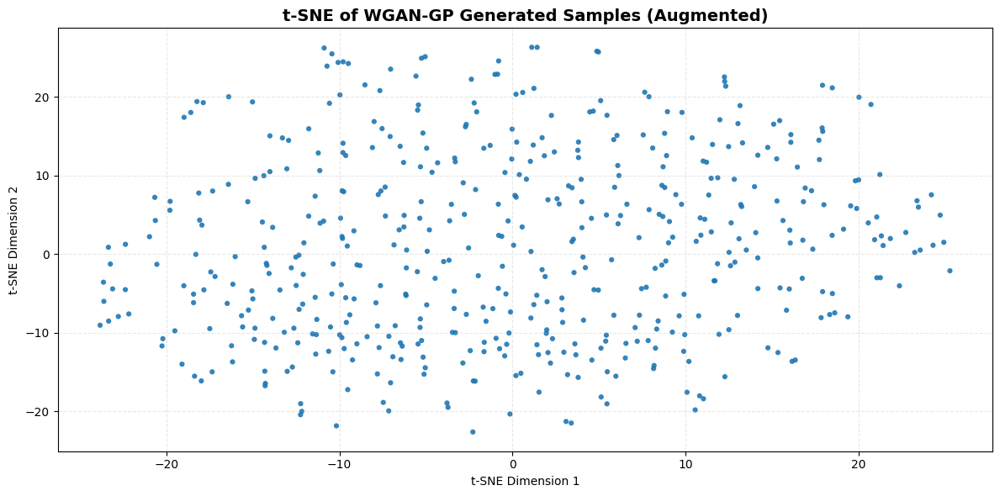

In [ ]:
# ========== Generate New Images from Random Noise ========== #
latent_dim = 160
noise = tf.random.normal([500, latent_dim])
generated_images = generator(noise, training=False)
generated_images = (generated_images + 1) / 2.0

def plot_tsne_embeddings(generated_images, save_path=None, title="t-SNE of WGAN-GP Generated Samples (Augmented)"):
    # ----- Convert to [0, 1] Range ----- #
    if tf.reduce_max(generated_images).numpy() > 1.0:
        raise ValueError("Images should be in [-1, 1] range before scaling.")

    images_rescaled = (generated_images + 1.0) / 2.0
    flat_images = images_rescaled.numpy().reshape(images_rescaled.shape[0], -1)

    # ----- Run t-SNE ----- #
    tsne = TSNE(n_components=2, perplexity=30, learning_rate='auto', init='pca', random_state=42)
    tsne_proj = tsne.fit_transform(flat_images)

    # ----- Plot t-SNE ----- #
    plt.figure(figsize=(12, 6))
    sns.scatterplot(
        x=tsne_proj[:, 0],
        y=tsne_proj[:, 1],
        s=20,
        alpha=0.9,
        edgecolor='none'
    )
    plt.title(title, fontsize=14, weight='bold')
    plt.xlabel("t-SNE Dimension 1")
    plt.ylabel("t-SNE Dimension 2")
    plt.grid(True, linestyle='--', alpha=0.3)
    plt.tight_layout()

    if save_path:
        plt.savefig(save_path, dpi=300)
        print(f"t-SNE plot saved to: {save_path}")

    plt.show()

plot_tsne_embeddings(generated_images=generated_images)

With reference to the t-SNE plot of WGAN-GP Generated Samples (Augmented) above, we are able to make the following observations:

**Relatively Uniform and Balanced Distribution**

- The samples are evenly dispersed across the 2D plane with no strong concentration in specific regions.

- This suggests WGAN-GP maintained its robustness in modelling the latent space despite the influence of data augmentation.

**Lack of Obvious Clustering or Collapse**

- Unlike some traditional GANs that display mode collapse or tight clumping, WGAN-GP's plot shows no significant overlapping clusters.

- Each point is somewhat equidistant from its neighbours, reinforcing WGAN-GP's capacity to diversify outputs.

**Mild Structural Degradation**

- Compared to the non-augmented version, there is slightly more scatter, indicating that augmentation has diffused the latent embeddings slightly.

- However, the degradation is minimal and does not critically disrupt the model's overall structure.

**Strong Generalisation Under Augmentation**

- The model appears to have successfully learned a generalisable feature space, showing high resistance to the noise introduced through augmentation.

- This aligns with WGAN-GP's gradient penalty formulation, which enforces smoother transitions and better continuity in the generator output.

With the observations indicated above, we will proceed to train another GAN Model using Augmented Data in the next sub-section.

---
## 5.4 Least Squares GAN Model Training

In this sub-section, we will be training a Least Squares GAN (LSGAN) for the EMNIST Dataset. The LSGAN mainly replace the Binary Crossentropy Loss used in classical GANs with a Least Squares Loss. Through this replacement, the LSGAN is more likely able to have a Stabalise GAN Training, Produce Higher Quality Images, and Encourage the Generator more Accurate Results. The relevant mathematical formulas are indicated below:

---
**Generator Loss:**

Purpose: Produce Outputs Classified as Real.

$$
\mathcal{L}_G = \frac{1}{2} \mathbb{E}_{z \sim p_z}[(D(G(z)) - c)^2]
$$

Where:
- $c = 1$ = Desired Discriminator Output for Generated Images  
- $D(G(z))$ = Discriminator's Output for Generated Data  
- $z \sim p_z$ = Sample from Latent Space

---
**Discriminator Loss:**

Purpose: Discriminator Minimises the Least Squares Error between Predictions and True Labels.

$$
\mathcal{L}_D = \frac{1}{2} \mathbb{E}_{x \sim p_{\text{data}}}[(D(x) - b)^2] + \frac{1}{2} \mathbb{E}_{z \sim p_z}[(D(G(z)) - a)^2]
$$

Where:  
- $D(x)$ = Discriminator's Output for Real Data  
- $D(G(z))$ = Discriminator's Output for Generated Data  
- $a = 0$ = Label for Fake Data  
- $b = 1$ = Label for Real Data  
- $x \sim p_{\text{data}}$ = Sample from Real Data Distribution  
- $z \sim p_z$ = Sample from Latent Noise Distribution  

---
**Total Objective:**

Purpose: LSGAN Seeks to Solve the Objective.

$$
\min_G \max_D \; \mathcal{L}_D \quad \text{and} \quad \min_G \; \mathcal{L}_G
$$

---
With the relevant mathematical formulas indicated above, we will proceed to train the LSGAN in this sub-section for the purpose of it's potential for smoother training process and also to serve as a comparison for our other GAN Models.

---
### 5.4.1 Defining Data Pre-Processing Function

In this sub-section, we will be defining the Data Pre-Processing Function which will allow for consistent Data Pipeline to be built and modifed accordingly should the need arise such as when we need to add Spectral Normalisation. This will ensure that the Data's integrity is not affected and we are able to make fair and un-biased assumptions. The Data Pre-Processing Function is defined in the Code Cell below:

In [ ]:
# ========== Data Pre-Processing Function ========== #
def load_data(X_train, batch_size=64):
    # ----- Trim X_train Down to Multiple of Batch_size ----- #
    n_full = (X_train.shape[0] // batch_size) * batch_size
    X_trimmed = X_train[:n_full]

    # ----- Compute Steps For Each Epoch ----- #
    steps_per_epoch = n_full // batch_size

    # ----- Build the ImageDataGenerator Iterator ----- #
    datagen_iter = datagen.flow(X_trimmed, batch_size=batch_size, shuffle=True)

    # ----- Wrap as a tf.data.Dataset with a Fixed-shape Signature ----- #
    dataset = tf.data.Dataset.from_generator(
        lambda: (next(datagen_iter) for _ in range(steps_per_epoch)),
        output_signature=tf.TensorSpec((batch_size, 28, 28, 1), tf.float32)
    )

    return dataset.prefetch(tf.data.AUTOTUNE)

With reference to the Code Cell above, we are able to determine that the Data Pre-Processing Function have been defined successfully and we are able to move on to Defining Callback Functions in the next sub-section.

---
### 5.4.2 Defining Callback Functions

In this sub-section, we will be pre-defining the various Callbacks. This is to ensure consistency throughout the model and also to increase the GAN Accuracy and optimise the Computation Cost for training each GAN Model. These Callbacks will be main used during the GAN Training in the next sub-section. The revelant mathematical formula for the callbacks and logic are indicated below:

---
**Learning Rate Scheduler:**

Purpose: Reduces Learning Rate During Training to Fine-tune Model Convergence.

$$\text{If } epoch \mod 10 = 0 \Rightarrow \eta_{new} = \frac{1}{2} \cdot \eta$$

Where:

- $\eta$ = current learning rate

- $\eta_{\text{new}}$ = updated learning rate

- $epoch \bmod 10$ checks if the epoch is a multiple of 10

---
**ReduceLROnPlateau:**

Purpose: Automatically Reduces the Learning Rate when Validation Performance Plateaus.

$$
\text{If no improvement in } val\_loss \text{ for 10 epochs: } \eta_{\text{new}} = 0.5 \cdot \eta
$$

Where:

- $\eta_{\text{new}}$ = reduced learning rate

---
**EarlyStopping:**

Purpose: Prevents Wastage of Computational Power if Model Does Not Improve.

$$
\text{If } val\_loss \text{ does not improve for 25 epochs, stop training and restore best weights}
$$

---

We will proceed to Define the Callbacks in the Code Cell below in preparation for the GAN Model Training.

In [ ]:
# ========== Define Learning Rate Scheduler ========== #
lr_scheduler = LearningRateScheduler(
    lambda epoch, lr: lr * 0.95 if epoch % 10 == 0 else lr,
    verbose=1
)

# ========== Define Reduce LR on Plateau ========== #
reduce_lr = ReduceLROnPlateau(
    monitor='loss',
    factor=0.5,
    patience=10,
    verbose=1,
    min_lr=1e-6
)

# ========== Define Early Stopping ========== #
early_stop = EarlyStopping(
    monitor='loss',
    patience=25,
    verbose=1,
    restore_best_weights=False
)

# ========== Define Display Generated Images ========== #
def display_generated_images(generator, latent_dim, n=7):
    noise = tf.random.normal([n * n, latent_dim])
    generated_images = generator(noise, training=False)
    generated_images = (generated_images + 1.0) / 2.0

    fig, axes = plt.subplots(n, n, figsize=(n, n))
    for i in range(n):
        for j in range(n):
            img = generated_images[i * n + j, :, :, 0]
            axes[i, j].imshow(img, cmap='gray')
            axes[i, j].axis('off')

    plt.tight_layout()
    plt.show()

# ========== Define FID Calculator ========== #
def calculate_fid(real_images, fake_images, batch_size=10):

    # ----- Scale to [0,255] and Resize to 299×299 ----- #
    real = (real_images + 1.0) * 127.5
    fake = (fake_images + 1.0) * 127.5
    real = tf.image.resize(real, (299,299))
    fake = tf.image.resize(fake, (299,299))

    # ----- If Grayscale, Convert to RGB ----- #
    if real.shape[-1] == 1:
        real = tf.image.grayscale_to_rgb(real)
        fake = tf.image.grayscale_to_rgb(fake)

    # ----- Preprocess for Inception (–1 to +1) ----- #
    real_pp = preprocess_input(real)
    fake_pp = preprocess_input(fake)

    # ----- Extract Features in Batches ----- #
    def _get_acts(x):
        acts = []
        n = x.shape[0]
        for i in range(0, n, batch_size):
            chunk = x[i:i+batch_size]
            acts.append(_inception_model(chunk, training=False).numpy())
        return np.vstack(acts)

    act_real = _get_acts(real_pp)
    act_fake = _get_acts(fake_pp)

    # ----- Compute Statistics ----- #
    mu1, sigma1 = act_real.mean(axis=0), np.cov(act_real, rowvar=False)
    mu2, sigma2 = act_fake.mean(axis=0), np.cov(act_fake, rowvar=False)
    diff    = mu1 - mu2
    covmean = sqrtm(sigma1.dot(sigma2))
    if np.iscomplexobj(covmean):
        covmean = covmean.real
    fid = diff.dot(diff) + np.trace(sigma1 + sigma2 - 2*covmean)
    return float(np.round(fid,4))

# ========== Confirmation Message ========== #
print("LSGAN Callbacks and Visualisation Setup Complete")

LSGAN Callbacks and Visualisation Setup Complete


With reference to the Code Cell above, we are able to verify that that the Callbacks have been successfully defined and the various parameters are set so as to ensure a High Accuracy and Computing Efficient GAN Model Training.

---
### 5.4.3 Defining LSGAN Generator Architecture

In this section, we will be defining the LSGAN's Generator Architecture. The Generator will be trying to make realistic generated images in the attempt to bypass the Discriminator. Subsequently, the generated images from the Generator will be evaluated based on a few evaluation metrics such as Inception Score. The relevent mathematical formulas for the Loss Function of the Vanilla GAN Generator is indicated below:

---
**Generator Loss:**

Purpose: Produce Outputs Classified as Real.

$$
\mathcal{L}_G = \frac{1}{2} \mathbb{E}_{z \sim p_z}[(D(G(z)) - c)^2]
$$

Where:
- $c = 1$ = Desired Discriminator Output for Generated Images  
- $D(G(z))$ = Discriminator's Output for Generated Data  
- $z \sim p_z$ = Sample from Latent Space

---
With the relevant Generator Loss Formula indicated above, we will proceed to define the GAN Generator's Architecture in the Code Cell below and the Lost Function.

In [ ]:
# ========== Generator Function ========== #
def build_generator(latent_dim=100, use_dropout=True):
    model = tf.keras.Sequential(name="generator")

    # ----- Project and Reshape ----- #
    model.add(tf.keras.layers.Dense(7 * 7 * 256, use_bias=False, input_shape=(latent_dim,)))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.ReLU())
    model.add(tf.keras.layers.Reshape((7, 7, 256)))

    # ----- Upsample 1 ----- #
    model.add(tf.keras.layers.Conv2DTranspose(128, kernel_size=5, strides=1, padding='same', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.ReLU())
    if use_dropout:
        model.add(tf.keras.layers.Dropout(0.3))

    # ----- Upsample 2 ----- #
    model.add(tf.keras.layers.Conv2DTranspose(64, kernel_size=5, strides=2, padding='same', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.ReLU())
    if use_dropout:
        model.add(tf.keras.layers.Dropout(0.3))

    # ----- Final Output to 28x28x1 ----- #
    model.add(tf.keras.layers.Conv2DTranspose(1, kernel_size=5, strides=2, padding='same', activation='tanh'))

    return model

# ========== LSGAN Generator Loss ========== #
mse = tf.keras.losses.MeanSquaredError()

def generator_loss(fake_output):
    return 0.5 * mse(tf.ones_like(fake_output), fake_output)

With reference to the Code Cell above, we are able to verify that the GAN's Generator Architecture have been successfully defined and we are able to proceed to define the GAN's Discriminator Architecture.

---
### 5.4.4 Defining Spectral Normalisation

In this section, we will be defining the Spectral Normalisation layer for the Discriminator of the GAN. The Spectral Normalisation controls the Lipschitz constant of the Discriminator by constraining the Spectral Norm of each weight matrix. This will prevent the Discriminator from being too powerful and dominating the Generator which can cause various issues such as Mode Collaspe, Training Instability and Exploding Gradients. The relevant mathematical formula is indicated below:

---
**Spectral Normalisation (SN)**

Purpose: Controls the Lipschitz Constant of the Discriminator.

$$
\bar{W} = \frac{W}{\sigma(W)}
$$

Where:
- $W$ = Original Weight Matrix
- $\bar{W}$ = Spectrally Normalised Weight Matrix used in the Forward Pass
- $\sigma(W)$ = Spectral Norm of $W$
---
**Spectral Norm Approximation using Power Iteration**

Purpose: Controls the Lipschitz Constant of the Discriminator.

$$
\sigma(W) \approx \mathbf{u}^\top W \mathbf{v}
$$

Where:
- $\mathbf{v} \leftarrow \frac{W^\top \mathbf{u}}{\|W^\top \mathbf{u}\|_2}$
- $\mathbf{u} \leftarrow \frac{W \mathbf{v}}{\|W \mathbf{v}\|_2}$
- $\mathbf{u}, \mathbf{v}$: Approximated Unit Vectors
---
With the relevant mathematical formulas indicated, we will proceed to define the Spectral Normalisation in the Code Cell below.

In [ ]:
# ========== Spectral Normalisation Convolution Layer ========== #
class SpectralConv2D(tf.keras.layers.Layer):
    def __init__(self, filters, kernel_size, strides=1, padding='same', **kwargs):
        super().__init__()
        self.conv = tf.keras.layers.Conv2D(filters, kernel_size, strides=strides, padding=padding, use_bias=False, **kwargs)
        self.u = None

    def build(self, input_shape):
        self.conv.build(input_shape)
        self.w = self.conv.kernel
        self.u = self.add_weight(shape=(1, self.w.shape[-1]), initializer='random_normal', trainable=False, name='sn_u')

    def compute_spectral_norm(self, w):
        w_reshaped = tf.reshape(w, [-1, w.shape[-1]])
        u = self.u

        for _ in range(1):
            v = tf.linalg.l2_normalize(tf.matmul(u, tf.transpose(w_reshaped)))
            u = tf.linalg.l2_normalize(tf.matmul(v, w_reshaped))

        sigma = tf.matmul(tf.matmul(v, w_reshaped), tf.transpose(u))
        self.u.assign(u)
        return w / sigma

    def call(self, inputs):
        self.conv.kernel.assign(self.compute_spectral_norm(self.w))
        return self.conv(inputs)

# ========== Spectral Normalisation Dense Layer ========== #
class SpectralDense(tf.keras.layers.Layer):
    def __init__(self, units, activation=None):
        super().__init__()
        self.dense = tf.keras.layers.Dense(units, activation=activation, use_bias=False)
        self.u = None

    def build(self, input_shape):
        self.dense.build(input_shape)
        self.w = self.dense.kernel
        self.u = self.add_weight(shape=(1, self.w.shape[-1]), initializer='random_normal', trainable=False, name='sn_u_dense')

    def compute_spectral_norm(self, w):
        w_reshaped = tf.reshape(w, [-1, w.shape[-1]])
        u = self.u

        for _ in range(1):
            v = tf.linalg.l2_normalize(tf.matmul(u, tf.transpose(w_reshaped)))
            u = tf.linalg.l2_normalize(tf.matmul(v, w_reshaped))

        sigma = tf.matmul(tf.matmul(v, w_reshaped), tf.transpose(u))
        self.u.assign(u)
        return w / sigma

    def call(self, inputs):
        self.dense.kernel.assign(self.compute_spectral_norm(self.w))
        return self.dense(inputs)

With reference to the Code Cell above, we are able to verify that the Spectral Normalisation have been successfully defined and we are able to proceed to include this layer in the Discriminator Architecture in the next section.

---
### 5.4.5 Defining LSGAN Discriminator Architecture

In this section, we will be defining the Architecture of the Discriminator of the GAN. The Discriminator will be the Neural Network that will attempt to tell the Generated Images apart from the Actual Images. This will allow the GAN to improve overtime and also improve itself overtime. The mathematical function for the Discriminator Loss Function is indicated below:

---
**Discriminator Loss:**

Purpose: Discriminator Minimises the Least Squares Error between Predictions and True Labels.

$$
\mathcal{L}_D = \frac{1}{2} \mathbb{E}_{x \sim p_{\text{data}}}[(D(x) - b)^2] + \frac{1}{2} \mathbb{E}_{z \sim p_z}[(D(G(z)) - a)^2]
$$

Where:  
- $D(x)$ = Discriminator's Output for Real Data  
- $D(G(z))$ = Discriminator's Output for Generated Data  
- $a = 0$ = Label for Fake Data  
- $b = 1$ = Label for Real Data  
- $x \sim p_{\text{data}}$ = Sample from Real Data Distribution  
- $z \sim p_z$ = Sample from Latent Noise Distribution  
---

With the mathematical formula for the Loss Function indicated above, we will proceed to define the GAN's Discriminator Architecture and the Loss Function in the Code Cell below.

In [ ]:
# ========== Discriminator Function ========== #
def build_discriminator(input_shape=(28, 28, 1)):
    model = tf.keras.Sequential(name="discriminator")

    model.add(SpectralConv2D(64, kernel_size=5, strides=2, padding='same', input_shape=input_shape))
    model.add(tf.keras.layers.LeakyReLU(negative_slope=0.2))
    model.add(tf.keras.layers.Dropout(0.3))

    model.add(SpectralConv2D(128, kernel_size=5, strides=2, padding='same'))
    model.add(tf.keras.layers.LeakyReLU(negative_slope=0.2))
    model.add(tf.keras.layers.Dropout(0.3))

    model.add(tf.keras.layers.Flatten())
    model.add(SpectralDense(1))

    return model

# ========== Discriminator Loss Function ========== #
def discriminator_loss(real_output, fake_output):
    real_loss = mse(tf.ones_like(real_output), real_output)
    fake_loss = mse(tf.zeros_like(fake_output), fake_output)
    return 0.5 * (real_loss + fake_loss)

With reference to the Code Cell above, we are able to verify that the GAN's Discriminator Architecture have been successfully defined and we are able to proceed to define the GAN's Training Steps.

---
### 5.4.6 Defining Training Step

In this section, we will be Defining the Training Step function so as to train both the Generator and the Discriminator at the same time. The Training Step will compute the gradients for both the Generator and the Discriminator at the same time. The relevant mathematical formulas for the Training Step is indicated below:

---
**Generator Loss:**

Purpose: Produce Outputs Classified as Real.

$$
\mathcal{L}_G = \frac{1}{2} \mathbb{E}_{z \sim p_z}[(D(G(z)) - c)^2]
$$

Where:
- $c = 1$ = Desired Discriminator Output for Generated Images  
- $D(G(z))$ = Discriminator's Output for Generated Data  
- $z \sim p_z$ = Sample from Latent Space

---
**Discriminator Loss:**

Purpose: Discriminator Minimises the Least Squares Error between Predictions and True Labels.

$$
\mathcal{L}_D = \frac{1}{2} \mathbb{E}_{x \sim p_{\text{data}}}[(D(x) - b)^2] + \frac{1}{2} \mathbb{E}_{z \sim p_z}[(D(G(z)) - a)^2]
$$

Where:  
- $D(x)$ = Discriminator's Output for Real Data  
- $D(G(z))$ = Discriminator's Output for Generated Data  
- $a = 0$ = Label for Fake Data  
- $b = 1$ = Label for Real Data  
- $x \sim p_{\text{data}}$ = Sample from Real Data Distribution  
- $z \sim p_z$ = Sample from Latent Noise Distribution  

---
**Total Objective:**

Purpose: LSGAN Seeks to Solve the Objective.

$$
\min_G \max_D \; \mathcal{L}_D \quad \text{and} \quad \min_G \; \mathcal{L}_G
$$

---

With the relevant mathematical formulas indicated above, we will proceed to define the Training Step in the Code Cell below.

In [ ]:
# ========== Training Step for LSGAN ========== #
@tf.function
def train_step(real_images, generator, discriminator,
               gen_optimizer, disc_optimizer, latent_dim):
    batch_size = tf.shape(real_images)[0]

    # ----- Latent Noise ----- #
    noise = tf.random.normal([batch_size, latent_dim])
    noise = tf.math.l2_normalize(noise, axis=1)

    # ----- Instance Noise on Real Images ----- #
    real_images_noisy = real_images + tf.random.normal(tf.shape(real_images)) * 0.05

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        # ----- Generate Fake Images ----- #
        fake_images = generator(noise, training=True)

        # ----- Discriminator Prediction ----- #
        real_output = discriminator(real_images_noisy, training=True)
        fake_output = discriminator(fake_images,    training=True)

        # ----- Label Smoothing for Real Labels ----- #
        real_labels = tf.ones_like(real_output) * 0.9
        fake_labels = tf.zeros_like(fake_output)

        # ----- LSGAN Losses (MSE) ----- #
        real_loss = mse(real_labels, real_output)
        fake_loss = mse(fake_labels, fake_output)
        disc_loss = 0.5 * (real_loss + fake_loss)

        gen_loss = 0.5 * mse(tf.ones_like(fake_output), fake_output)

    # ----- Apply Gradients ----- #
    gen_grads = gen_tape.gradient(gen_loss, generator.trainable_variables)
    disc_grads = disc_tape.gradient(disc_loss, discriminator.trainable_variables)
    gen_optimizer.apply_gradients(zip(gen_grads, generator.trainable_variables))
    disc_optimizer.apply_gradients(zip(disc_grads, discriminator.trainable_variables))

    return gen_loss, disc_loss, real_output, fake_output

With reference to the Code Cell above, we are able to determine that the Training Step have been successfully defined and we are able to proceed to prepare the Training Loop in the next section.

---
### 5.4.7 Defining Training Loop

In this section, we will be defining the Training Loop for the GAN Training. The Training Loop will go through each of the Epoch and train both the Generator and Discriminator simultaneously. The Training Loop will also track the Loss for both the Generator and the Discriminator for each of the Epoch trained. The relevant mathematical formulas are indicated below:

---
**Epoch Loss Averaging:**

Purpose: These are the Average Generator and Discriminator Losses over all Batches in Epoch $t$.

$$
\bar{L}_G^{(t)} = \frac{1}{N} \sum_{i=1}^{N} L_G^{(i)} \\
\bar{L}_D^{(t)} = \frac{1}{N} \sum_{i=1}^{N} L_D^{(i)}
$$

Where:
- $\bar{L}_G^{(t)}$ = Average Generator Loss at Epoch $t$  
- $\bar{L}_D^{(t)}$ = Average Discriminator Loss at Epoch $t$  
- $N$ = Number of Batches in the Dataset  
- $L_G^{(i)}$ = Generator Loss on Batch $i$  
- $L_D^{(i)}$ = Discriminator Loss on Batch $i$

---
**Epoch Iteration:**

Purpose: Describes the Training Loop Logic: for Each Epoch $t$, perform `train_step` for Every Mini-batch.

$$
\text{for } t = 1 \text{ to } T:
\quad \text{for each batch } (x^{(i)}):
\quad \text{train_step}(x^{(i)})
$$

Where:
- $T$: Total Number of Epochs  
- $x^{(i)}$: Real Batch $i$ from the Dataset  
- `train_step`: Function that Updates $G$ and $D$ using that Batch

---
**Generated Image Output:**

Purpose: Sample Random Noise $z$ and Generate Synthetic Image $\hat{x}$ from the Generator. This is used for Visual Monitoring of Model Quality.

$$
z \sim p_z(z) \\
\hat{x} = G(z)
$$

Where:
- $z$: Random Latent Vector  
- $G(z)$: Generated Image from Generator

---
With the mathematical formulas indicated above, we will proceed to define the Training Loop in the Code Cell below in preparation of the GAN Training.

In [ ]:
# ========== Training Loop for LSGAN ========== #
def train(dataset, epochs, generator, discriminator, gen_optimizer, disc_optimizer, latent_dim, save_path=None, use_early_stopping=True, steps_per_epoch=None):

    # ----- Prepare FID Reference Sets using X_val ----- #
    real_val  = tf.data.Dataset.from_tensor_slices(X_val).batch(50).take(1)
    noise_val = tf.random.normal([50, latent_dim])
    noise_val = tf.math.l2_normalize(noise_val, axis=1)

    # ----- FID Early Stopping Settings ----- #
    best_fid = float('inf')
    no_improve = 0
    patience = 10
    fid_interval = 1

    # ----- Dummy Model for Callbacks ----- #
    dummy_input  = Input(shape=(1,))
    dummy_output = Lambda(lambda x: x)(dummy_input)
    dummy_model  = Model(dummy_input, dummy_output)
    dummy_model.compile(optimizer=Adam(1e-4), loss='mse')

    early_stop.set_model(dummy_model)
    reduce_lr.set_model(dummy_model)
    lr_scheduler.set_model(dummy_model)
    early_stop.on_train_begin({})
    reduce_lr.on_train_begin({})
    lr_scheduler.on_train_begin({})

    # ----- Track Loss History ----- #
    gen_loss_history  = []
    disc_loss_history = []

    for epoch in range(1, epochs + 1):
        print(f"\nEpoch {epoch}/{epochs}")
        gen_losses, disc_losses = [], []

        for i, real_images in enumerate(dataset):
            if steps_per_epoch and i >= steps_per_epoch:
                break

            # ----- LSGAN Train Step ----- #
            gen_loss, disc_loss, _, _ = train_step(
                real_images,
                generator,
                discriminator,
                gen_optimizer,
                disc_optimizer,
                latent_dim
            )
            gen_losses.append(gen_loss)
            disc_losses.append(disc_loss)

        # ----- Compute Epoch Losses ----- #
        avg_gen_loss  = tf.reduce_mean(gen_losses)
        avg_disc_loss = tf.reduce_mean(disc_losses)
        print(f"Generator Loss: {avg_gen_loss:.4f} | Discriminator Loss: {avg_disc_loss:.4f}")

        gen_loss_history.append(float(avg_gen_loss))
        disc_loss_history.append(float(avg_disc_loss))

        # ----- Callback on Generator Loss ----- #
        logs = {'loss': float(avg_gen_loss)}
        if use_early_stopping:
            early_stop.on_epoch_end(epoch=epoch, logs=logs)
            if early_stop.stopped_epoch > 0:
                print(f"Early stopping triggered at epoch {epoch}")
                break
        reduce_lr.on_epoch_end(epoch=epoch, logs=logs)
        lr_scheduler.on_epoch_end(epoch=epoch, logs=logs)

        # ----- FID Evaluation & Early Stopping ----- #
        if epoch % fid_interval == 0:
            fake_val   = generator(noise_val, training=False)
            real_batch = next(iter(real_val))
            real_for_fid = tf.image.resize(real_batch, [299,299]) * 0.5 + 0.5
            fake_for_fid = tf.image.resize(fake_val,    [299,299]) * 0.5 + 0.5

            fid_value = calculate_fid(real_for_fid, fake_for_fid)
            print(f"Epoch {epoch} → Val FID: {fid_value:.2f}")

            if fid_value < best_fid:
                best_fid   = fid_value
                no_improve = 0
                if save_path:
                    os.makedirs(save_path, exist_ok=True)
                    generator.save_weights(os.path.join(save_path, "best_gen.weights.h5"))
                    discriminator.save_weights(os.path.join(save_path, "best_disc.weights.h5"))
            else:
                no_improve += 1

            if no_improve >= patience:
                print(f"No FID improvement for {patience} epochs, stopping.")
                break

        # ----- Display Every 5 Epochs ----- #
        if epoch % 5 == 0:
            display_generated_images(generator, latent_dim)

    # ----- Restore Best Weights After Training ----- #
    if save_path:
        best_gen_path = os.path.join(save_path, "best_gen.weights.h5")
        best_disc_path = os.path.join(save_path, "best_disc.weights.h5")
        if os.path.exists(best_gen_path) and os.path.exists(best_disc_path):
            generator.load_weights(best_gen_path)
            discriminator.load_weights(best_disc_path)
            print("Restored best generator and discriminator weights based on lowest FID.")
        else:
            print("Best weight files not found. Skipping restore.")

    return avg_gen_loss, gen_loss_history, disc_loss_history

With reference to the Code Cell above, we are able to determine that the Training Loop have been successfully defined and we are able to proceed to define the Optimisers with Tunable Parameter in preparation for the Optuna Tuning.

---
### 5.4.8 Defining Optimisers with Tunable Parameters

In this section, we will be defining the Common Optimisers that will be Tuned using the Optuna Tuning. The Optimisers will each have a range of values in a list so as to allow for the Optuna to search for the best Hyperparameter for the GAN. Through these parameters, it will affect how effective and efficiently the GAN will learn from the provided EMNIST Data. The relevent mathematical formula is indicated below:

---
**Optimiser Update Rule**

Purpose: Parameter Update Step in the Adam Optimiser, using Adaptive Learning Rates with Momentum.

$$
\theta \leftarrow \theta - \eta \cdot \frac{m_t}{\sqrt{v_t} + \epsilon}
$$

Where:
- $\theta$ = Model Parameters (Generator or Discriminator)
- $\eta$ = Learning Rate (Tuned)
- $m_t$ = First Moment Estimate (Mean of Gradients)
- $v_t$ = Second Moment Estimate (Variance of Gradients)
- $\epsilon$ = Small Constant for Numerical Stability

---
With the mathematical formula indicated above, we will proceed to define the Optimisers in the Code Cell.

In [ ]:
# ========== Objective Function ========== #
def objective(trial):
    # ----- Hyperparameters ----- #
    latent_dim = trial.suggest_categorical('latent_dim', [100, 128, 160])
    learning_rate = trial.suggest_float('learning_rate', 5e-5, 2e-4, log=True)
    beta_1 = trial.suggest_float('beta_1', 0.4, 0.6)

    # ----- Build Models ----- #
    generator = build_generator(latent_dim=latent_dim)
    discriminator = build_discriminator()

    # ----- Trigger Weight Creation ----- #
    _ = generator(tf.random.uniform([1, latent_dim], minval=-1.0, maxval=1.0))
    _ = discriminator(tf.random.normal([1, 28, 28, 1]))

    # ----- Define Optimizers ----- #
    gen_optimizer = tf.keras.optimizers.Adam(learning_rate=learning_rate, beta_1=beta_1)
    disc_optimizer = tf.keras.optimizers.Adam(learning_rate=learning_rate, beta_1=beta_1)

    # ----- Prebuild Optimizers ----- #
    _ = gen_optimizer.apply_gradients([(tf.zeros_like(v), v) for v in generator.trainable_variables])
    _ = disc_optimizer.apply_gradients([(tf.zeros_like(v), v) for v in discriminator.trainable_variables])

    # ----- Load Data ----- #
    dataset = load_data(X_train, batch_size=64)
    steps = min(1000, len(X_train) // 64)

    # ----- Train ----- #
    _ = train(
        dataset=dataset,
        epochs=100,
        generator=generator,
        discriminator=discriminator,
        gen_optimizer=gen_optimizer,
        disc_optimizer=disc_optimizer,
        latent_dim=latent_dim,
        steps_per_epoch=steps,
        use_early_stopping=False,
        save_path=None
    )

    # ----- Generate Fake Images ----- #
    z = tf.random.uniform([1000, latent_dim], minval=-1.0, maxval=1.0)
    fake_images = generator(z, training=False)
    fake_images = (fake_images + 1.0) / 2.0  # Rescale to [0, 1]

    # ----- Get Real Images ----- #
    real_images = X_val[:1000]

    # ----- Compute FID Score ----- #
    fid_score = calculate_fid(real_images, fake_images)

    return fid_score

With reference to the Code Cell above, we are able to determine that the Optimiser have been successfully defined with a range of different Parameter Values so as to provide a robust Optuna Tuning in the subsequent sections.

---
### 5.4.9 Optuna Tuning Study

In this sub-section, we will be conducting the Optuna Tuning Study on the GAN Model so as to obtain the best Hyperparameter for the GAN Model. It is expected that the Tuning takes a prolonged duration due to the nature of how the GAN works and the 2 Neural Networks involved. However, the training data will be stored so as to prevent re-running of repetitive codes. The Optuna Tuning Study will be conducted in the Code Cell below.

In [ ]:
# ========== Create or Load Study with SQLite Backend ========== #
study = optuna.create_study(
    direction="minimize",
    study_name="lsgan_tuning",
    storage="sqlite:////content/drive/MyDrive/Colab Notebooks/DELE CA2 A/Augmented GAN Tunings/lsgan_optuna.db",
    load_if_exists=True
)

# ========== Trial Management ========== #
MAX_TRIALS = 50
completed_trials = len([t for t in study.trials if t.state == optuna.trial.TrialState.COMPLETE])
remaining_trials = MAX_TRIALS - completed_trials

if remaining_trials > 0:
    print(f"Resuming LSGAN study: {completed_trials} completed, running {remaining_trials} more.")
    study.optimize(objective, n_trials=remaining_trials)
else:
    print(f"LSGAN study already completed {MAX_TRIALS} trials. Skipping optimization.")

# ========== Output Best Trial ========== #
best_trial = study.best_trial
best_params_df = pd.DataFrame([best_trial.params])
best_params_df["Final FID"] = best_trial.value
best_params_df.style.background_gradient(cmap="Blues")

[I 2025-08-10 11:12:58,530] Using an existing study with name 'lsgan_tuning' instead of creating a new one.


LSGAN study already completed 50 trials. Skipping optimization.


,latent_dim,learning_rate,beta_1,Final FID
0,100,0.000197,0.400951,109.040500


With reference to the Code Cell above, we are able to view the Best Hyperparameter obtained during the Optuna Tuning Study. This Hyperparameter will be extracted and be trained for a longer period of time so as to attempt to increase the performance and limit the loss for the GAN.

---
### 5.4.10 GAN Re-Training Operation

As obtained from the previous sub-section, we will be re-training the GAN using the best Hyperparameter obtained during the Optuna Tuning Study. This is to push the GAN Model to its limits and also to save Computational Power as we are not taking up prolonged periods of time tuning GAN Models which may not have any clear signs of good performance. The retraining of the GAN Model will be conducted in the Code Cell below.

In [ ]:
# ========== Extract Best Parameters from Study ========== #
best_params = study.best_trial.params

latent_dim   = best_params['latent_dim']
learning_rate = best_params['learning_rate']
beta_1       = best_params['beta_1']

print("Using Best Trial Parameters for LSGAN:")
print(best_params)

# ========== Rebuild LSGAN Models ========== #
generator     = build_generator(latent_dim=latent_dim)
discriminator = build_discriminator()

gen_optimizer  = tf.keras.optimizers.Adam(learning_rate=learning_rate, beta_1=beta_1)
disc_optimizer = tf.keras.optimizers.Adam(learning_rate=learning_rate, beta_1=beta_1)

# Trigger variable creation
_ = generator(tf.random.normal([1, latent_dim]))
_ = discriminator(tf.random.normal([1, 28, 28, 1]))

_ = gen_optimizer.apply_gradients([(tf.zeros_like(v), v) for v in generator.trainable_variables])
_ = disc_optimizer.apply_gradients([(tf.zeros_like(v), v) for v in discriminator.trainable_variables])

# ========== Reload Dataset ========== #
dataset = load_data(X_train)

# ========== Define Paths ========== #
model_name   = "lsgan"
output_dir   = "/content/drive/MyDrive/Colab Notebooks/DELE CA2 A/final_outputs_lsgan_augment"
weights_path = os.path.join(output_dir, "augmented_lsgan_generator_final.weights.h5")
gen_ckpt     = os.path.join(output_dir, "best_gen.weights.h5")
disc_ckpt    = os.path.join(output_dir, "best_disc.weights.h5")
loss_csv     = os.path.join(output_dir, "loss_history.csv")

os.makedirs(output_dir, exist_ok=True)

# ========== Load or Train ========== #
if os.path.exists(gen_ckpt) and os.path.exists(disc_ckpt) and os.path.exists(loss_csv):
    print("All outputs found. Skipping training...")

    generator.load_weights(gen_ckpt)
    discriminator.load_weights(disc_ckpt)
    print("LSGAN (Augmented) weights loaded.")

    loss_df = pd.read_csv(loss_csv)
    gen_loss_history  = loss_df['gen_loss'].tolist()
    disc_loss_history = loss_df['disc_loss'].tolist()
    final_gen_loss    = gen_loss_history[-1]

else:
    final_gen_loss, gen_loss_history, disc_loss_history = train(
        dataset=dataset,
        epochs=100,
        steps_per_epoch=1546,
        generator=generator,
        discriminator=discriminator,
        gen_optimizer=gen_optimizer,
        disc_optimizer=disc_optimizer,
        latent_dim=latent_dim,
        use_early_stopping=False,
        save_path=output_dir
    )

    generator.save_weights(weights_path)
    print("Generator Weights Saved.")

    # Save loss history to CSV
    loss_df = pd.DataFrame({
        'epoch': list(range(1, len(gen_loss_history) + 1)),
        'gen_loss': gen_loss_history,
        'disc_loss': disc_loss_history
    })
    loss_df.to_csv(loss_csv, index=False)
    print(f"Loss history saved to {loss_csv}")

Using Best Trial Parameters for LSGAN:
{'latent_dim': 100, 'learning_rate': 0.00019662086547902232, 'beta_1': 0.4009512863314806}


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:93: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


All outputs found. Skipping training...
LSGAN (Augmented) weights loaded.


With reference to the Code Cell above, we are able to determine that the best GAN Model have been trained and saved successfully and we are able to proceed with the Model Evaluation in the next sub-sections where we determine how well the GAN Model performed based on various metrics and evaluation methodologies.

---
### 5.4.11 GAN Model Evaluation

In this sub-section, we will be evaluating the GAN's Generator performance on various aspects. We will be utilising different methodologies and metrics to attempt to quantify the performance of the GAN Generator while also conducting Visual Inspection on the result output of the GAN. The Evaluation will be conducted in the following sections.

---
#### 5.4.11.1 Visual Grid of Samples

In this sub-section, we will be visualising the Grid of Samples of the Synthesised Data generated by the GAN Model. A list of observations will be made before the utilisation of Quantitative Metrics to evaluate the GAN Generator's general performance. As the observations made are purely from professional opinion, it will most likely not be used as a Basis of Comparison between GAN Models due to differing opinions unless in extreme cases. The visualisation will be conducted in the Code Cell below.

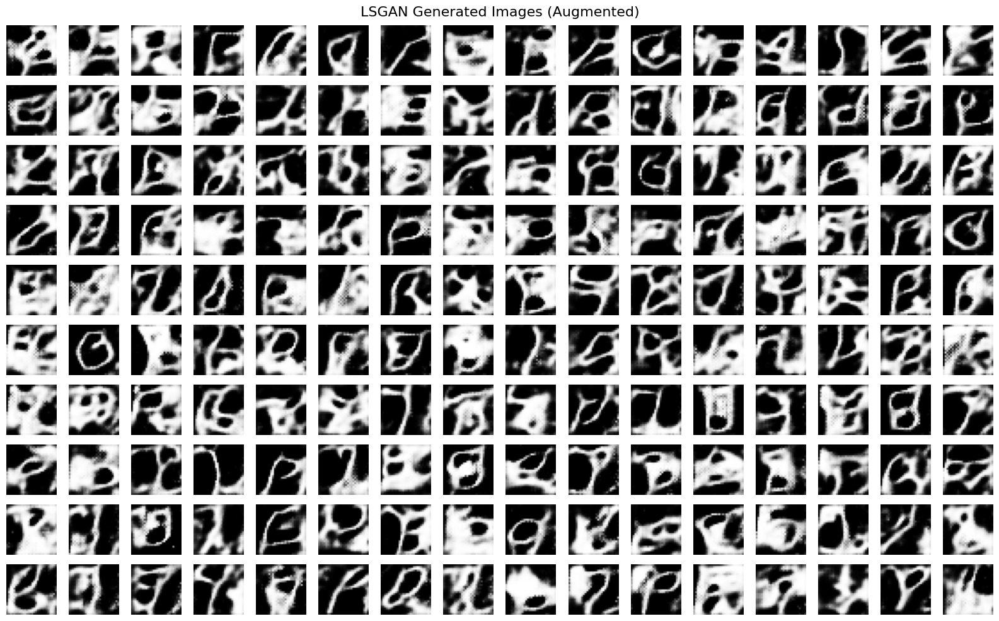

In [ ]:
def plot_generated_images(generator, latent_dim, n_rows=5, n_cols=5, save_path=None, title="LSGAN Generated Images (Augmented)", seed=42):
    # ----- Generate Latent Vectors ----- #
    if seed is not None:
        tf.random.set_seed(seed)
    noise = tf.random.normal([n_rows * n_cols, latent_dim])
    gen_images = generator(noise, training=False)

    # ----- Rescale from [-1, 1] to [0, 1] ----- #
    gen_images = (gen_images + 1.0) / 2.0
    gen_images = tf.clip_by_value(gen_images, 0.0, 1.0)

    # ----- Shape Check ----- #
    assert gen_images.shape[-1] == 1, "Expected single-channel (grayscale) output"

    # ----- Sample Plot ----- #
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols, n_rows))
    for idx, ax in enumerate(axes.flat):
        ax.imshow(gen_images[idx, :, :, 0], cmap='gray')
        ax.axis('off')

    plt.suptitle(title, fontsize=16)
    plt.tight_layout()

    if save_path:
        plt.savefig(save_path, dpi=300)
        print(f"Saved Generated Image Grid to: {save_path}")

    plt.show()

# ========== Call Plot Function ========== #
plot_generated_images(generator, latent_dim=100, n_rows=10, n_cols=16)

With reference to the output of the Visual Grid of Samples above, we are able to make the following observations:

**Basic Structure of Letters is Not Captured**

- A few characters faintly resemble forms like "P", "C", or "R".

- Closed shapes and loops are occasionally visible among the cluttered samples.

**High Blur and Noise**

- Almost all characters suffer from severe blurring and artefacts.

- Images exhibit significant noise patterns, with many strokes appearing melted or overexposed.

**Poor Character Consistency**

- There is a heavy loss of structural clarity and most glyphs are unreadable or abstract.

- Letter anatomy is distorted, with no clear stroke separation or recognisable features.

With the observations indicated above, we will proceed to conduct the Loss Curve Analysis in the next sub-section.

---
#### 5.4.11.2 Loss Curve Over Epochs

In this sub-section, we will be plotting the GAN Loss Curve over Epochs to evaluate the training behaviour of the GAN. This curve provides insight into whether the GAN is experiencing underfitting, overfitting, or achieving a stable training dynamic between the generator and discriminator.

Although GANs do not minimise a single unified loss in the traditional sense, the trajectory of the generator and discriminator losses can indicate whether the adversarial training process is converging appropriately.

If the generator loss remains high while discriminator loss quickly drops to near-zero, this may indicate **underfitting**, where the generator is not learning effectively to produce plausible images.

If the discriminator loss increases while generator loss sharply decreases, this may suggest **overfitting** or **mode collapse**, where the generator exploits narrow weaknesses in the discriminator without general improvement.

A relatively stable oscillation or convergence between both losses typically signifies a **well-balanced** training process, where the generator and discriminator are learning in tandem.

The Potential Observations and Corresponding Action Plans are outlined below:

**Underfitting Loss Curve**

- Increase training epochs to allow generator more time to learn.

- Simplify the discriminator to reduce overpowering the generator.

- Adjust the learning rate or apply label smoothing.

- Consider adding batch normalisation in the generator.

**Overfitting or Mode Collapse Loss Curve**

- Introduce or increase dropout in the discriminator.

- Apply input noise or label flipping to the discriminator.

- Evaluate diversity of generated samples regularly.

**Balanced/Ideal Loss Curve**

- Maintain current architecture and hyperparameters.

- Proceed with full-scale image generation.

- Evaluate both qualitative (visual inspection) and quantitative metrics (e.g. Inception Score or FID).

With these potential training behaviours and action plan outlined, we will proceed to visualise the GAN loss dynamics in the code cell below.

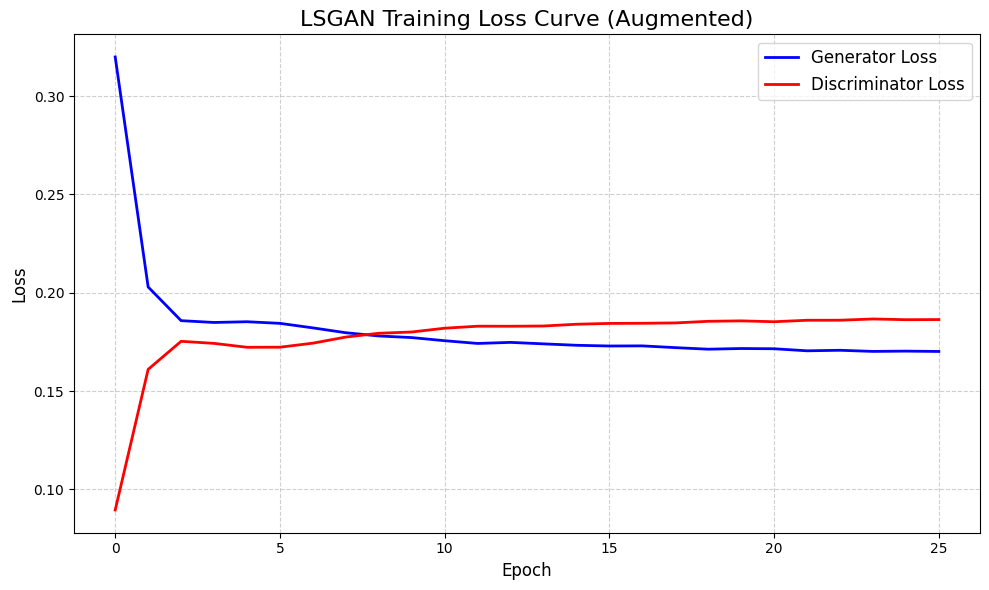

In [ ]:
# ========== Figure Size Configuration ========== #
plt.figure(figsize=(10, 6))

# ========== Plot Training Losses ========== #
plt.plot(gen_loss_history, label="Generator Loss", linewidth=2, color='blue')
plt.plot(disc_loss_history, label="Discriminator Loss", linewidth=2, color='red')

# ========== Labels and Title ========== #
plt.xlabel("Epoch", fontsize=12)
plt.ylabel("Loss", fontsize=12)
plt.title("LSGAN Training Loss Curve (Augmented)", fontsize=16)

# ========== Grid, Legend, and Styling ========== #
plt.grid(True, linestyle='--', alpha=0.6)
plt.legend(fontsize=12)
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)

# ========== Display the Plot ========== #
plt.tight_layout()
plt.show()

With reference to the output of the Loss Curve above, we are able to make the following observations:

- Augmented LSGAN training is stable and healthy.

- Generator and discriminator converge with minimal fluctuations.

- Losses remain low and tightly bound — typical of well-trained LSGANs.

- Augmentation does not destabilise LSGAN — possibly enhancing diversity without harming convergence.

With the observations indicated above, we will proceed to conduct the Quantitative Metrics Evaluation in the next sub-section.

---
#### 5.4.11.3 Quantitative Metrics Evaluation

In this sub-section we will be utilising Quantitative Metrics such as FID and KID to tabulate the results of the performance and quantify the performance of the GAN Generator. We will subsequently be use these metrics to conduct inter-model evaluation after tuning and training all the GANs. The metrics that we will be utilising and their respective formulas are indicated below:

---
**Fréchet Inception Distance**

Purpose: Measures the Distance between the Real-Image and Generated-Image Distributions in Inception Feature Space.

$$
\mathrm{FID} \;=\;\|\mu_r - \mu_f\|^2
\;+\;\mathrm{Tr}\Bigl(\Sigma_r + \Sigma_f - 2\,(\Sigma_r\,\Sigma_f)^{\tfrac12}\Bigr)
$$


Where:
- $\mu_r = \mathbb{E}[f(x)]$, $\Sigma_r = \mathrm{Cov}[f(x)]$ for Real Images $x$.  
- $\mu_f = \mathbb{E}[f(\hat x)]$, $\Sigma_f = \mathrm{Cov}[f(\hat x)]$ for Generated Images $\hat x$.  
- $f(\cdot)$ = Map from Image to its InceptionV3 'pooling=avg' Features.  

---
**Diversity (t-SNE Spread)**

Purpose: Quantifies how 'wide' the 2D t-SNE Embedding of Generated Samples.

$$
\mathrm{Spread}
\;=\;
\bigl(\max_i\,z_i^{(1)} - \min_i\,z_i^{(1)}\bigr)
\;\times\;
\bigl(\max_i\,z_i^{(2)} - \min_i\,z_i^{(2)}\bigr)
$$

Where:
- $z_i = (z_i^{(1)}, z_i^{(2)})$ = 2-dimensional t-SNE Embedding of $i$th Generated Image.

---
**Mode Collapse Risk**

Purpose: Flags when too many Generated Images are Nearly Identical (mode collapse).

$$
\text{ModeCollapseRisk} =
\begin{cases}
\text{Low}, & \dfrac{\bigl|\{\mathrm{unique\_rounded}(x_i)\}\bigr|}{N} > \tau,\\
\text{High}, & \text{otherwise}.
\end{cases}
$$

Where:
- $x_i$ = $N$ Generated Samples.  
- $\mathrm{unique\_rounded}(x_i)$ = Rounds Pixels to Detect Duplicates.  
- $\tau=0.9$ = Uniqueness Threshold (90%).

---
**Perceptual Path Length**

Purpose: Measures Sensitively of Generator's Outputs (in VGG16 Feature Space) move when the Latent Code $z$ is Perturbed.

$$
\mathrm{PPL}
\;=\;
\mathbb{E}_{z,\delta z}\Bigl[\,
\|\phi\bigl(G(z + \epsilon\,\delta z)\bigr)\;-\;\phi\bigl(G(z)\bigr)\|_2^2
\Bigr]
$$

Where:  
- $G(z)$ = GAN Generator Mapping $z\in\mathbb{R}^{\mathrm{latent\_dim}}$ to an Image.  
- $\phi(\cdot)$ = VGG16 'pooling=avg' Feature Extractor.  
- $\delta z\sim\mathcal{N}(0,I)$, $\epsilon$ = Small Constant.

---
**Kernel Inception Distance**

Purpose: An Unbiased Estimator of the Squared Maximum Mean Discrepancy (MMD) between Real and Generated Inception Features.

$$
\mathrm{KID}
\;=\;
\frac{1}{m(m-1)}\sum_{i\neq j} k\bigl(\phi(x_i),\phi(x_j)\bigr)
\;+\;
\frac{1}{n(n-1)}\sum_{i\neq j} k\bigl(\phi(\hat x_i),\phi(\hat x_j)\bigr)
\;-\;
\frac{2}{mn}\sum_{i=1}^m\sum_{j=1}^n k\bigl(\phi(x_i),\phi(\hat x_j)\bigr)
$$

Where:  
- $x_i$ ($i=1\ldots m$) = Real Images.
- $\hat x_j$ ($j=1\ldots n$) = Generated Images.  
- $\phi(\cdot)$ = InceptionV3 Feature Extractor (pooling='avg').  
- $k(u,v) = \bigl(\frac{u^\top v}{d}+1\bigr)^3$ = degree-3 Polynomial Kernel on $d$-dimensional Features.

---

With the mathematical and metrics indicated above, we will proceed to conduct the Quantitave Metrics Evalution in the Code Cell below.

In [ ]:
# ========== Preload InceptionV3 and VGG16 Models ========== #
inception = InceptionV3(include_top=False, pooling='avg', input_shape=(299, 299, 3))
vgg_model = VGG16(include_top=False, weights='imagenet', input_shape=(128, 128, 3))

# ========== Preprocess for Inception ========== #
def preprocess_images_for_inception(images):
    images = (images + 1.0) * 127.5  # Scale from [-1, 1] to [0, 255]
    images = tf.image.resize(images, [299, 299])
    if images.shape[-1] == 1:
        images = tf.image.grayscale_to_rgb(images)
    return preprocess_input(images)

# ========== Compute FID ========== #
def calculate_fid(real_images, fake_images, batch_size=50):
    real_pp = preprocess_images_for_inception(real_images)
    fake_pp = preprocess_images_for_inception(fake_images)

    act1 = inception.predict(real_pp, batch_size=batch_size, verbose=0)
    act2 = inception.predict(fake_pp, batch_size=batch_size, verbose=0)

    mu1, sigma1 = np.mean(act1, axis=0), np.cov(act1, rowvar=False)
    mu2, sigma2 = np.mean(act2, axis=0), np.cov(act2, rowvar=False)

    diff = mu1 - mu2
    covmean = sqrtm(sigma1 @ sigma2)
    if np.iscomplexobj(covmean):
        covmean = covmean.real

    fid = diff @ diff + np.trace(sigma1 + sigma2 - 2 * covmean)
    return round(fid, 4)

# ========== Compute KID ========== #
def polynomial_kernel(X, Y):
    d = X.shape[1]
    return (np.dot(X, Y.T) / d + 1) ** 3

def calculate_kid(real_images, fake_images, batch_size=128):
    real_pp = preprocess_images_for_inception(real_images)
    fake_pp = preprocess_images_for_inception(fake_images)

    real_features = inception.predict(real_pp, batch_size=batch_size, verbose=0)
    fake_features = inception.predict(fake_pp, batch_size=batch_size, verbose=0)

    m = real_features.shape[0]
    n = fake_features.shape[0]

    k_rr = polynomial_kernel(real_features, real_features)
    k_gg = polynomial_kernel(fake_features, fake_features)
    k_rg = polynomial_kernel(real_features, fake_features)

    np.fill_diagonal(k_rr, 0)
    np.fill_diagonal(k_gg, 0)

    mmd = (k_rr.sum() / (m * (m - 1)) +
           k_gg.sum() / (n * (n - 1)) -
           2 * k_rg.mean())
    return round(mmd, 4)

# ========== Compute t-SNE Spread (Diversity) ========== #
def calculate_tsne_spread(images):
    flat = images.reshape(images.shape[0], -1)
    tsne = TSNE(n_components=2, random_state=42)
    proj = tsne.fit_transform(flat)
    x_range = proj[:, 0].max() - proj[:, 0].min()
    y_range = proj[:, 1].max() - proj[:, 1].min()
    return round(x_range * y_range, 2)

# ========== Assess Mode Collapse ========== #
def assess_mode_collapse(images):
    unique = np.unique(np.round(images), axis=0).shape[0]
    return "Low" if unique > 0.9 * images.shape[0] else "High"

# ========== Compute Perceptual Path Length (PPL) ========== #
def calculate_ppl(generator, latent_dim=100, num_samples=50, epsilon=1e-2):
    distances = []
    for _ in range(num_samples):
        z1 = tf.random.normal([1, latent_dim])
        z2 = z1 + epsilon * tf.random.normal([1, latent_dim])
        img1 = generator(z1, training=False)
        img2 = generator(z2, training=False)

        img1 = tf.image.resize(tf.image.grayscale_to_rgb((img1 + 1.0) * 127.5), (128, 128))
        img2 = tf.image.resize(tf.image.grayscale_to_rgb((img2 + 1.0) * 127.5), (128, 128))

        f1 = vgg_model(vgg_preprocess(img1))
        f2 = vgg_model(vgg_preprocess(img2))
        d = tf.reduce_mean(tf.square(f1 - f2)).numpy()
        distances.append(d)
    return round(np.mean(distances), 4)

# ========== Evaluate GAN Performance ========== #
def evaluate_gan_model(generator, latent_dim, X_val, gen_loss_history, disc_loss_history, model_name="LSGAN"):
    # ----- Generate Fake Images ----- #
    noise = tf.random.normal([1000, latent_dim])
    fake_images = generator(noise, training=False)
    fake_images = tf.clip_by_value((fake_images + 1) / 2.0, 0.0, 1.0)
    fake_np = fake_images.numpy()

    # ----- Select and preprocess 1000 Real Images from Validation Set ----- #
    real_images = tf.convert_to_tensor(X_val[:1000], dtype=tf.float32)
    real_images = tf.clip_by_value(real_images, 0.0, 1.0)

    # ----- Compute Metrics ----- #
    fid_value = calculate_fid(real_images, fake_images)
    kid_value = calculate_kid(real_images, fake_images)
    tsne_spread_value = calculate_tsne_spread(fake_np)
    collapse_risk_value = assess_mode_collapse(fake_np)
    ppl_score_value = calculate_ppl(generator, latent_dim)
    mean_gen_loss_value = round(np.mean(gen_loss_history), 4)
    std_gen_loss_value = round(np.std(gen_loss_history), 4)
    mean_disc_loss_value = round(np.mean(disc_loss_history), 4)
    std_disc_loss_value = round(np.std(disc_loss_history), 4)

    # ----- Store as Global Vars (Optional) ----- #
    prefix = model_name.upper()
    globals()[f"{prefix}_FID"] = fid_value
    globals()[f"{prefix}_KID"] = kid_value
    globals()[f"{prefix}_TSNE"] = tsne_spread_value
    globals()[f"{prefix}_MODE_COLLAPSE"] = collapse_risk_value
    globals()[f"{prefix}_PPL"] = ppl_score_value
    globals()[f"{prefix}_GEN_LOSS_MEAN"] = mean_gen_loss_value
    globals()[f"{prefix}_GEN_LOSS_STD"] = std_gen_loss_value
    globals()[f"{prefix}_DISC_LOSS_MEAN"] = mean_disc_loss_value
    globals()[f"{prefix}_DISC_LOSS_STD"] = std_disc_loss_value

    # ----- Final Summary Row ----- #
    row = {
        "Model": model_name,
        "FID Score": fid_value,
        "KID Score": kid_value,
        "Mean Generator Loss": mean_gen_loss_value,
        "Std Generator Loss": std_gen_loss_value,
        "Mean Discriminator Loss": mean_disc_loss_value,
        "Std Discriminator Loss": std_disc_loss_value,
        "Mode Collapse Risk": collapse_risk_value,
        "Visual Quality": "Poor",
        "Diversity (t-SNE Spread)": tsne_spread_value,
        "PPL": ppl_score_value
    }

    return pd.DataFrame([row])[[
        "Model", "FID Score", "KID Score",
        "Mean Generator Loss", "Std Generator Loss",
        "Mean Discriminator Loss", "Std Discriminator Loss",
        "Mode Collapse Risk", "Visual Quality",
        "Diversity (t-SNE Spread)", "PPL"
    ]]

# ========== Create DataFrame ========== #
df = evaluate_gan_model(generator, latent_dim, X_val, gen_loss_history, disc_loss_history, model_name="LSGAN (Augmented)")

# ========== Display DataFrame ========== #
df.style.background_gradient(cmap="Blues")

,Model,FID Score,KID Score,Mean Generator Loss,Std Generator Loss,Mean Discriminator Loss,Std Discriminator Loss,Mode Collapse Risk,Visual Quality,Diversity (t-SNE Spread),PPL
0,LSGAN (Augmented),228.033500,0.232400,0.182100,0.028500,0.177400,0.018600,Low,Poor,4982.490234,0.159600


With reference to the output of the Quantitative Metrics above, we are able to determine the performance of the GAN. This will be used as a basis of comparison to the other GAN Models.

---
#### 5.4.11.4 t-SNE of Generated Samples

In this sub-section, we visualise the t-SNE projection of generated samples to evaluate the latent diversity learned by the unconditional GAN. Although our GAN is not class-conditioned, t-SNE remains a valuable tool to assess whether the generator is producing varied outputs that reflect meaningful use of the latent space. While GANs are trained in high-dimensional spaces, t-SNE enables us to observe 2D structural patterns such as sample clustering, separation, and density, which provide indirect insights into the diversity and generalisation capabilities of the generator. The visualisation will be conducted in the Code Cell below.

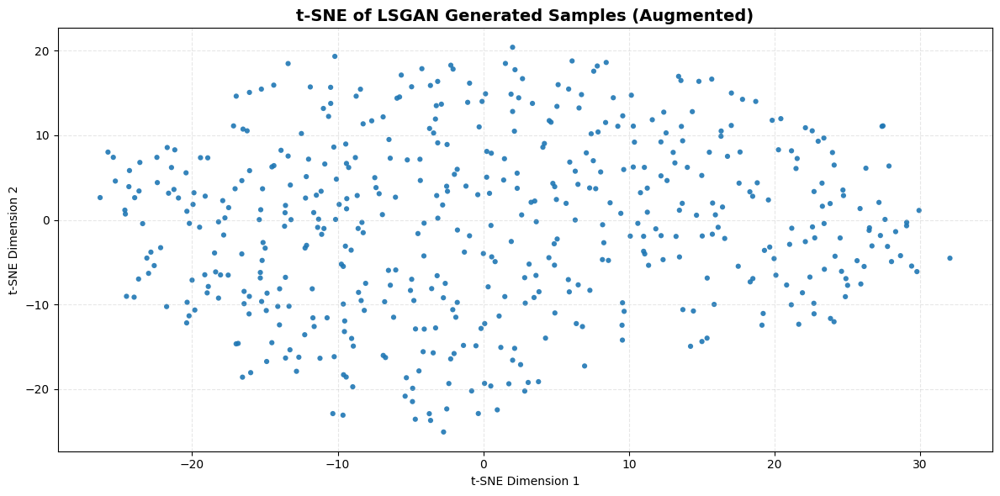

In [ ]:
# ========== Generate New Images from Random Noise ========== #
latent_dim = 100
noise = tf.random.normal([500, latent_dim])
generated_images = generator(noise, training=False)
generated_images = (generated_images + 1) / 2.0

def plot_tsne_embeddings(generated_images, save_path=None, title="t-SNE of LSGAN Generated Samples (Augmented)"):
    # ----- Convert to [0, 1] Range ----- #
    if tf.reduce_max(generated_images).numpy() > 1.0:
        raise ValueError("Images should be in [-1, 1] range before scaling.")

    images_rescaled = (generated_images + 1.0) / 2.0
    flat_images = images_rescaled.numpy().reshape(images_rescaled.shape[0], -1)

    # ----- Run t-SNE ----- #
    tsne = TSNE(n_components=2, perplexity=30, learning_rate='auto', init='pca', random_state=42)
    tsne_proj = tsne.fit_transform(flat_images)

    # ----- Plot t-SNE ----- #
    plt.figure(figsize=(12, 6))
    sns.scatterplot(
        x=tsne_proj[:, 0],
        y=tsne_proj[:, 1],
        s=20,
        alpha=0.9,
        edgecolor='none'
    )
    plt.title(title, fontsize=14, weight='bold')
    plt.xlabel("t-SNE Dimension 1")
    plt.ylabel("t-SNE Dimension 2")
    plt.grid(True, linestyle='--', alpha=0.3)
    plt.tight_layout()

    if save_path:
        plt.savefig(save_path, dpi=300)
        print(f"t-SNE plot saved to: {save_path}")

    plt.show()

plot_tsne_embeddings(generated_images=generated_images)

With reference to the t-SNE plot of LSGAN Generated Samples (Augmented) above, we are able to make the following observations:

**Mild Clustering with Decent Spread**

- The generated points appear to form small semi-clusters, loosely scattered across the 2D space.

- While not highly compact, these clusters indicate that LSGAN is encoding distinguishable variations in its latent space, albeit not as strongly as more advanced GAN variants.

**Moderate Preservation of Latent Space**

- Compared to the non-augmented version, LSGAN shows a comparable spread, suggesting a reasonable resistance to augmentation-induced noise.

- However, the scatter is less structured, implying minor distortion in how features are embedded after augmentation.

**No Signs of Mode Collapse**

- There is no dense centre or tight clumping, a positive sign that LSGAN avoided degenerating into single-mode generation.

- This confirms that least squares loss continues to offer benefits even under augmented training data conditions.

**Sensitivity to Data Noise**

- A few outliers are more apparent here, possibly hinting at LSGAN's relative sensitivity to noisy or inconsistent input due to augmentation.

- These points may reflect less confident or unstable outputs, which would need further regularisation or training enhancements to improve.

With the observations indicated above, we will now proceed to train a new GAN Model using Augmented Data in the next sub-section.

---
## 5.5 Wasserstein GAN Model Training

In this sub-section, we will be training a Wasserstein Squares GAN (WGAN) for the EMNIST Dataset. The WGAN mainly replace the Binary Crossentropy Loss used in classical GANs with a Wasserstein Distance. Through this replacement, the WGAN is more likely able to have a Stabalise GAN Training, Improve Image Quality for Small Dataset, and provide Loss Values that are Interpretable. The relevant mathematical formulas are indicated below:

---
**Generator Loss:**

Purpose: The Generator Maximizes the Critic's Score on Fake Images

$$
L_G = -\mathbb{E}_{\tilde{x} \sim \mathbb{P}_g} \left[D(\tilde{x})\right]
$$

Where:
- $L_G$ = Generator Loss  
- $\tilde{x} \sim \mathbb{P}_g$ = Fake Data Sampled from Generator Distribution  
- $D(\tilde{x})$ = Critic's Prediction Score for Fake Input $\tilde{x}$  
- $\mathbb{E}$ = Expectation Operator

---
**Discriminator (Critic) Loss:**

Purpose: Trains Critic to give Higher Scores to Real Data and Lower Scores to Fake Data.

$$
L_D = \mathbb{E}_{\tilde{x} \sim \mathbb{P}_g} \left[D(\tilde{x})\right] - \mathbb{E}_{x \sim \mathbb{P}_r} \left[D(x)\right] + \lambda \cdot \mathbb{E}_{\hat{x} \sim \mathbb{P}_{\hat{x}}} \left[\left(\| \nabla_{\hat{x}} D(\hat{x}) \|_2 - 1\right)^2\right]
$$

Where:
- $D(x)$ = Critic Output for Real Input  
- $\mathbb{P}_r$ = Real Data Distribution  
- $\mathbb{P}_g$ = Generator (fake) Distribution  
- $\tilde{x}$ = Fake Sample from Generator
- $\hat{x}$ = Interpolated Sample Between Real and Fake  
- $\lambda$ = Gradient Penalty Coefficient (typically $\lambda = 10$)

---
With the relevant mathematical formulas indicated above, we will proceed to train the WGAN in this sub-section for the purpose of it's potential for smoother training process and also to serve as a comparison for our other GAN Models.

---
### 5.5.1 Defining Data Pre-Processing Function

In this sub-section, we will be defining the Data Pre-Processing Function which will allow for consistent Data Pipeline to be built and modifed accordingly should the need arise such as when we need to add Spectral Normalisation. This will ensure that the Data's integrity is not affected and we are able to make fair and un-biased assumptions. The Data Pre-Processing Function is defined in the Code Cell below:

In [ ]:
# ========== Data Pre-Processing Function ========== #
def load_data(X_train, batch_size=64):
    # ----- Trim X_train Down to Multiple of Batch_size ----- #
    n_full = (X_train.shape[0] // batch_size) * batch_size
    X_trimmed = X_train[:n_full]

    # ----- Compute Steps For Each Epoch ----- #
    steps_per_epoch = n_full // batch_size

    # ----- Build the ImageDataGenerator Iterator ----- #
    datagen_iter = datagen.flow(X_trimmed, batch_size=batch_size, shuffle=True)

    # ----- Wrap as a tf.data.Dataset with a Fixed-shape Signature ----- #
    dataset = tf.data.Dataset.from_generator(
        lambda: (next(datagen_iter) for _ in range(steps_per_epoch)),
        output_signature=tf.TensorSpec((batch_size, 28, 28, 1), tf.float32)
    )

    return dataset.prefetch(tf.data.AUTOTUNE)

With reference to the Code Cell above, we are able to determine that the Data Pre-Processing Function have been defined successfully and we are able to move on to Defining Callback Functions in the next sub-section.

---
### 5.5.2 Defining Callback Functions

In this sub-section, we will be pre-defining the various Callbacks. This is to ensure consistency throughout the model and also to increase the GAN Accuracy and optimise the Computation Cost for training each GAN Model. These Callbacks will be main used during the GAN Training in the next sub-section. The relevant mathematical formula and logic are indicated below:

---
**Learning Rate Scheduler:**

Purpose: Reduces Learning Rate During Training to Fine-tune Model Convergence.

$$\text{If } epoch \mod 10 = 0 \Rightarrow \eta_{new} = \frac{1}{2} \cdot \eta$$

Where:

- $\eta$ = current learning rate

- $\eta_{\text{new}}$ = updated learning rate

- $epoch \bmod 10$ checks if the epoch is a multiple of 10

---
**EarlyStopping:**

Purpose: Prevents Wastage of Computational Power if Model Does Not Improve.

$$
\text{If } val\_loss \text{ does not improve for 25 epochs, stop training and restore best weights}
$$

---

We will proceed to Define the Callbacks in the Code Cell below in preparation for the GAN Model Training.

In [ ]:
# ========== Define Learning Rate Scheduler ========== #
lr_scheduler = LearningRateScheduler(
    lambda epoch, lr: lr * 0.95 if epoch % 10 == 0 else lr,
    verbose=1
)

# ========== Define Early Stopping for WGAN ========== #
early_stop = EarlyStopping(
    monitor='critic_loss',
    patience=25,
    verbose=1,
    restore_best_weights=False
)

# ========== Define Display Generated Images for WGAN ========== #
def display_generated_images(generator, latent_dim, n=7):
    noise = tf.random.normal([n * n, latent_dim])
    generated_images = generator(noise, training=False)
    generated_images = (generated_images + 1.0) / 2.0

    fig, axes = plt.subplots(n, n, figsize=(n, n))
    for i in range(n):
        for j in range(n):
            img = generated_images[i * n + j, :, :, 0]
            axes[i, j].imshow(img, cmap='gray')
            axes[i, j].axis('off')

    plt.tight_layout()
    plt.show()

# ========== Define FID Calculator ========== #
def calculate_fid(real_images, fake_images, batch_size=10):

    # ----- Scale to [0,255] and Resize to 299×299 ----- #
    real = (real_images + 1.0) * 127.5
    fake = (fake_images + 1.0) * 127.5
    real = tf.image.resize(real, (299,299))
    fake = tf.image.resize(fake, (299,299))

    # ----- If Grayscale, Convert to RGB ----- #
    if real.shape[-1] == 1:
        real = tf.image.grayscale_to_rgb(real)
        fake = tf.image.grayscale_to_rgb(fake)

    # ----- Preprocess for Inception (–1 to +1) ----- #
    real_pp = preprocess_input(real)
    fake_pp = preprocess_input(fake)

    # ----- Extract Features in Batches ----- #
    def _get_acts(x):
        acts = []
        n = x.shape[0]
        for i in range(0, n, batch_size):
            chunk = x[i:i+batch_size]
            acts.append(_inception_model(chunk, training=False).numpy())
        return np.vstack(acts)

    act_real = _get_acts(real_pp)
    act_fake = _get_acts(fake_pp)

    # ----- Compute Statistics ----- #
    mu1, sigma1 = act_real.mean(axis=0), np.cov(act_real, rowvar=False)
    mu2, sigma2 = act_fake.mean(axis=0), np.cov(act_fake, rowvar=False)
    diff    = mu1 - mu2
    covmean = sqrtm(sigma1.dot(sigma2))
    if np.iscomplexobj(covmean):
        covmean = covmean.real
    fid = diff.dot(diff) + np.trace(sigma1 + sigma2 - 2*covmean)
    return float(np.round(fid,4))

# ========== Confirmation Message ========== #
print("WGAN Callbacks and Visualisation Setup Complete")

WGAN Callbacks and Visualisation Setup Complete


With reference to the Code Cell above, we are able to verify that that the Callbacks have been successfully defined and the various parameters are set so as to ensure a High Accuracy and Computing Efficient GAN Model Training.

---
### 5.5.3 Defining WGAN Generator Architecture

In this section, we will be defining the WGAN's Generator Architecture. The Generator will be trying to make realistic generated images in the attempt to bypass the Discriminator. Subsequently, the generated images from the Generator will be evaluated based on a few evaluation metrics such as Inception Score. The relevent mathematical formulas for the Loss Function of the Vanilla GAN Generator is indicated below:

---
**Generator Loss:**

Purpose: The Generator Maximizes the Critic's Score on Fake Images

$$
L_G = -\mathbb{E}_{\tilde{x} \sim \mathbb{P}_g} \left[D(\tilde{x})\right]
$$

Where:
- $L_G$ = Generator Loss  
- $\tilde{x} \sim \mathbb{P}_g$ = Fake Data Sampled from Generator Distribution  
- $D(\tilde{x})$ = Critic's Prediction Score for Fake Input $\tilde{x}$  
- $\mathbb{E}$ = Expectation Operator

---
With the relevant Generator Loss Formula indicated above, we will proceed to define the GAN Generator's Architecture in the Code Cell below and the Lost Function.

In [ ]:
# ========== Generator Function ========== #
def build_generator(latent_dim=100, use_dropout=True):
    model = tf.keras.Sequential(name="generator")

    # ----- Project and Reshape ----- #
    model.add(tf.keras.layers.Dense(7 * 7 * 256, use_bias=False, input_shape=(latent_dim,)))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.ReLU())
    model.add(tf.keras.layers.Reshape((7, 7, 256)))

    # ----- Upsample 1 ----- #
    model.add(tf.keras.layers.Conv2DTranspose(128, kernel_size=5, strides=1, padding='same', use_bias=False))

    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.ReLU())
    if use_dropout:
        model.add(tf.keras.layers.Dropout(0.3))

    # ----- Upsample 2 ----- #
    model.add(tf.keras.layers.Conv2DTranspose(64, kernel_size=5, strides=2, padding='same', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.ReLU())
    if use_dropout:
        model.add(tf.keras.layers.Dropout(0.3))

    # ----- Final Output to 28x28x1 ----- #
    model.add(tf.keras.layers.Conv2DTranspose(1, kernel_size=5, strides=2, padding='same', activation='tanh'))

    return model

# ========== WGAN Generator Loss ========== #
def generator_loss(fake_output):
    return -tf.reduce_mean(fake_output)

With reference to the Code Cell above, we are able to verify that the GAN's Generator Architecture have been successfully defined and we are able to proceed to define the GAN's Discriminator Architecture.

---
### 5.5.4 Defining Spectral Normalisation

In this section, we will be defining the Spectral Normalisation layer for the Discriminator of the GAN. The Spectral Normalisation controls the Lipschitz constant of the Discriminator by constraining the Spectral Norm of each weight matrix. This will prevent the Discriminator from being too powerful and dominating the Generator which can cause various issues such as Mode Collaspe, Training Instability and Exploding Gradients. The relevant mathematical formula is indicated below:

---
**Spectral Normalisation (SN)**

Purpose: Controls the Lipschitz Constant of the Discriminator.

$$
\bar{W} = \frac{W}{\sigma(W)}
$$

Where:
- $W$ = Original Weight Matrix
- $\bar{W}$ = Spectrally Normalised Weight Matrix used in the Forward Pass
- $\sigma(W)$ = Spectral Norm of $W$
---
**Spectral Norm Approximation using Power Iteration**

Purpose: Controls the Lipschitz Constant of the Discriminator.

$$
\sigma(W) \approx \mathbf{u}^\top W \mathbf{v}
$$

Where:
- $\mathbf{v} \leftarrow \frac{W^\top \mathbf{u}}{\|W^\top \mathbf{u}\|_2}$
- $\mathbf{u} \leftarrow \frac{W \mathbf{v}}{\|W \mathbf{v}\|_2}$
- $\mathbf{u}, \mathbf{v}$: Approximated Unit Vectors
---
With the relevant mathematical formulas indicated, we will proceed to define the Spectral Normalisation in the Code Cell below.

In [ ]:
# ========== Spectral Normalisation Convolution Layer ========== #
class SpectralConv2D(tf.keras.layers.Layer):
    def __init__(self, filters, kernel_size, strides=1, padding='same', **kwargs):
        super().__init__()
        self.conv = tf.keras.layers.Conv2D(filters, kernel_size, strides=strides, padding=padding, use_bias=False, **kwargs)
        self.u = None

    def build(self, input_shape):
        self.conv.build(input_shape)
        self.w = self.conv.kernel
        self.u = self.add_weight(shape=(1, self.w.shape[-1]), initializer='random_normal', trainable=False, name='sn_u')

    def compute_spectral_norm(self, w):
        w_reshaped = tf.reshape(w, [-1, w.shape[-1]])
        u = self.u

        for _ in range(1):
            v = tf.linalg.l2_normalize(tf.matmul(u, tf.transpose(w_reshaped)))
            u = tf.linalg.l2_normalize(tf.matmul(v, w_reshaped))

        sigma = tf.matmul(tf.matmul(v, w_reshaped), tf.transpose(u))
        self.u.assign(u)
        return w / sigma

    def call(self, inputs):
        self.conv.kernel.assign(self.compute_spectral_norm(self.w))
        return self.conv(inputs)

# ========== Spectral Normalisation Dense Layer ========== #
class SpectralDense(tf.keras.layers.Layer):
    def __init__(self, units, activation=None):
        super().__init__()
        self.dense = tf.keras.layers.Dense(units, activation=activation, use_bias=False)
        self.u = None

    def build(self, input_shape):
        self.dense.build(input_shape)
        self.w = self.dense.kernel
        self.u = self.add_weight(shape=(1, self.w.shape[-1]), initializer='random_normal', trainable=False, name='sn_u_dense')

    def compute_spectral_norm(self, w):
        w_reshaped = tf.reshape(w, [-1, w.shape[-1]])
        u = self.u

        for _ in range(1):
            v = tf.linalg.l2_normalize(tf.matmul(u, tf.transpose(w_reshaped)))
            u = tf.linalg.l2_normalize(tf.matmul(v, w_reshaped))

        sigma = tf.matmul(tf.matmul(v, w_reshaped), tf.transpose(u))
        self.u.assign(u)
        return w / sigma

    def call(self, inputs):
        self.dense.kernel.assign(self.compute_spectral_norm(self.w))
        return self.dense(inputs)

With reference to the Code Cell above, we are able to verify that the Spectral Normalisation have been successfully defined and we are able to proceed to include this layer in the Discriminator Architecture in the next section.

---
### 5.5.5 Defining WGAN Discriminator Architecture

In this section, we will be defining the Architecture of the Discriminator of the GAN. The Discriminator will be the Neural Network that will attempt to tell the Generated Images apart from the Actual Images. This will allow the GAN to improve overtime and also improve itself overtime. The mathematical function for the Discriminator Loss Function is indicated below:

---
**Discriminator (Critic) Loss:**

Purpose: Trains Critic to give Higher Scores to Real Data and Lower Scores to Fake Data.

$$
L_D = \mathbb{E}_{\tilde{x} \sim \mathbb{P}_g} \left[D(\tilde{x})\right] - \mathbb{E}_{x \sim \mathbb{P}_r} \left[D(x)\right] + \lambda \cdot \mathbb{E}_{\hat{x} \sim \mathbb{P}_{\hat{x}}} \left[\left(\| \nabla_{\hat{x}} D(\hat{x}) \|_2 - 1\right)^2\right]
$$

Where:
- $D(x)$ = Critic Output for Real Input  
- $\mathbb{P}_r$ = Real Data Distribution  
- $\mathbb{P}_g$ = Generator (fake) Distribution  
- $\tilde{x}$ = Fake Sample from Generator
- $\hat{x}$ = Interpolated Sample Between Real and Fake  
- $\lambda$ = Gradient Penalty Coefficient (typically $\lambda = 10$)
---

With the mathematical formula for the Loss Function indicated above, we will proceed to define the GAN's Discriminator Architecture and the Loss Function in the Code Cell below.

In [ ]:
# ========== Critic Function ========== #
def build_critic(input_shape=(28, 28, 1)):
    model = tf.keras.Sequential(name="critic")

    model.add(SpectralConv2D(64, kernel_size=5, strides=2, padding='same', input_shape=input_shape))

    model.add(tf.keras.layers.LeakyReLU(0.2))

    model.add(SpectralConv2D(128, kernel_size=5, strides=2, padding='same'))
    model.add(tf.keras.layers.LeakyReLU(0.2))

    model.add(tf.keras.layers.Flatten())
    model.add(SpectralDense(1))

    return model

# ========== Critic Loss ========== #
def critic_loss(real_output, fake_output):
    return tf.reduce_mean(fake_output) - tf.reduce_mean(real_output)

With reference to the Code Cell above, we are able to verify that the GAN's Discriminator Architecture have been successfully defined and we are able to proceed to define the GAN's Training Steps.

---
### 5.5.6 Defining Training Step

In this section, we will be Defining the Training Step function so as to train both the Generator and the Discriminator at the same time. The Training Step will compute the gradients for both the Generator and the Discriminator at the same time. The relevant mathematical formulas for the Training Step is indicated below:

---
**Generator Loss:**

Purpose: The Generator Maximizes the Critic's Score on Fake Images

$$
L_G = -\mathbb{E}_{\tilde{x} \sim \mathbb{P}_g} \left[D(\tilde{x})\right]
$$

Where:
- $L_G$ = Generator Loss  
- $\tilde{x} \sim \mathbb{P}_g$ = Fake Data Sampled from Generator Distribution  
- $D(\tilde{x})$ = Critic's Prediction Score for Fake Input $\tilde{x}$  
- $\mathbb{E}$ = Expectation Operator

---
**Discriminator (Critic) Loss:**

Purpose: Trains Critic to give Higher Scores to Real Data and Lower Scores to Fake Data.

$$
L_D = \mathbb{E}_{\tilde{x} \sim \mathbb{P}_g} \left[D(\tilde{x})\right] - \mathbb{E}_{x \sim \mathbb{P}_r} \left[D(x)\right] + \lambda \cdot \mathbb{E}_{\hat{x} \sim \mathbb{P}_{\hat{x}}} \left[\left(\| \nabla_{\hat{x}} D(\hat{x}) \|_2 - 1\right)^2\right]
$$

Where:
- $D(x)$ = Critic Output for Real Input  
- $\mathbb{P}_r$ = Real Data Distribution  
- $\mathbb{P}_g$ = Generator (fake) Distribution  
- $\tilde{x}$ = Fake Sample from Generator
- $\hat{x}$ = Interpolated Sample Between Real and Fake  
- $\lambda$ = Gradient Penalty Coefficient (typically $\lambda = 10$)

---

With the relevant mathematical formulas indicated above, we will proceed to define the Training Step in the Code Cell below.

In [ ]:
# ========== Training Step ========== #
@tf.function
def train_step(real_images, generator, critic, gen_optimizer, critic_optimizer, latent_dim, n_critic=5):
    # ----- Batch Size ----- #
    bs = tf.shape(real_images)[0]

    # ----- Uniform Latent Noise [-1, 1] ----- #
    noise = tf.random.uniform([bs, latent_dim], minval=-1.0, maxval=1.0)

    # ----- Update Critic n_critic Times ----- #
    for _ in range(n_critic):
        with tf.GradientTape() as tape_c:
            fake_images = generator(noise, training=True)
            real_score = critic(real_images, training=True)
            fake_score = critic(fake_images, training=True)

            # ----- Critic Loss ----- #
            c_loss = tf.reduce_mean(fake_score) - tf.reduce_mean(real_score)

        # ----- Apply Critic Gradients ----- #
        c_grads = tape_c.gradient(c_loss, critic.trainable_variables)
        critic_optimizer.apply_gradients(zip(c_grads, critic.trainable_variables))

    # ----- Update Generator ----- #
    with tf.GradientTape() as tape_g:
        fake_images = generator(noise, training=True)
        fake_score = critic(fake_images, training=True)

        # ----- Generator Loss ----- #
        g_loss = -tf.reduce_mean(fake_score)

    # ----- Apply Generator Gradients ----- #
    g_grads = tape_g.gradient(g_loss, generator.trainable_variables)
    gen_optimizer.apply_gradients(zip(g_grads, generator.trainable_variables))

    return g_loss, c_loss, real_score, fake_score

With reference to the Code Cell above, we are able to determine that the Training Step have been successfully defined and we are able to proceed to prepare the Training Loop in the next section.

---
### 5.5.7 Defining Training Loop

In this section, we will be defining the Training Loop for the GAN Training. The Training Loop will go through each of the Epoch and train both the Generator and Discriminator simultaneously. The Training Loop will also track the Loss for both the Generator and the Discriminator for each of the Epoch trained. The relevant mathematical formulas are indicated below:

---
**Epoch Loss Averaging:**

Purpose: These are the Average Generator and Discriminator Losses over all Batches in Epoch $t$.

$$
\bar{L}_G^{(t)} = \frac{1}{N} \sum_{i=1}^{N} L_G^{(i)} \\
\bar{L}_D^{(t)} = \frac{1}{N} \sum_{i=1}^{N} L_D^{(i)}
$$

Where:
- $\bar{L}_G^{(t)}$ = Average Generator Loss at Epoch $t$  
- $\bar{L}_D^{(t)}$ = Average Discriminator Loss at Epoch $t$  
- $N$ = Number of Batches in the Dataset  
- $L_G^{(i)}$ = Generator Loss on Batch $i$  
- $L_D^{(i)}$ = Discriminator Loss on Batch $i$

---
**Epoch Iteration:**

Purpose: Describes the Training Loop Logic: for Each Epoch $t$, perform `train_step` for Every Mini-batch.

$$
\text{for } t = 1 \text{ to } T:
\quad \text{for each batch } (x^{(i)}):
\quad \text{train_step}(x^{(i)})
$$

Where:
- $T$: Total Number of Epochs  
- $x^{(i)}$: Real Batch $i$ from the Dataset  
- `train_step`: Function that Updates $G$ and $D$ using that Batch

---
**Generated Image Output:**

Purpose: Sample Random Noise $z$ and Generate Synthetic Image $\hat{x}$ from the Generator. This is used for Visual Monitoring of Model Quality.

$$
z \sim p_z(z) \\
\hat{x} = G(z)
$$

Where:
- $z$: Random Latent Vector  
- $G(z)$: Generated Image from Generator

---
With the mathematical formulas indicated above, we will proceed to define the Training Loop in the Code Cell below in preparation of the GAN Training.

In [ ]:
# ========== Trainning Loop Function ========== #
def train(dataset, epochs, generator, critic, gen_optimizer, critic_optimizer, latent_dim, save_path=None, use_early_stopping=True, steps_per_epoch=None, n_critic=5):
    # ----- Prepare FID Reference Sets using X_val ----- #
    real_val  = tf.data.Dataset.from_tensor_slices(X_val).batch(50).take(1)
    noise_val = tf.random.uniform([50, latent_dim], minval=-1.0, maxval=1.0)

    # ----- FID Early Stopping Settings ----- #
    best_fid = float('inf')
    no_improve = 0
    patience = 12
    fid_interval = 1

    # ----- Track Loss History ----- #
    gen_loss_history    = []
    critic_loss_history = []

    for epoch in range(1, epochs + 1):
        print(f"Epoch {epoch}/{epochs}")
        gen_losses, critic_losses = [], []

        for i, real_images in enumerate(dataset):
            if steps_per_epoch and i >= steps_per_epoch:
                break

            # ----- One Training Step (includes n_critic updates) ----- #
            g_l, c_l, _, _ = train_step(
                real_images,
                generator,
                critic,
                gen_optimizer,
                critic_optimizer,
                latent_dim,
                n_critic
            )
            gen_losses.append(g_l)
            critic_losses.append(c_l)

        # ----- Epoch Statistics ----- #
        avg_gen_loss    = tf.reduce_mean(gen_losses)
        avg_critic_loss = tf.reduce_mean(critic_losses)
        print(f"Generator Loss: {avg_gen_loss:.4f} | Critic Loss: {avg_critic_loss:.4f}")

        # ----- Log Losses ----- #
        gen_loss_history.append(float(avg_gen_loss))
        critic_loss_history.append(float(avg_critic_loss))

        # ----- FID Evaluation & Early Stopping ----- #
        if epoch % fid_interval == 0:
            fake_val = generator(noise_val, training=False)
            real_batch = next(iter(real_val))
            real_for_fid = tf.image.resize(real_batch, [299,299]) * 0.5 + 0.5
            fake_for_fid = tf.image.resize(fake_val,    [299,299]) * 0.5 + 0.5

            fid_value = calculate_fid(real_for_fid, fake_for_fid)
            print(f"Epoch {epoch} → Val FID: {fid_value:.2f}")

            if fid_value < best_fid:
                best_fid   = fid_value
                no_improve = 0
                if save_path:
                    os.makedirs(save_path, exist_ok=True)
                    generator.save_weights(os.path.join(save_path, "best_gen.weights.h5"))
                    critic.save_weights(os.path.join(save_path, "best_crt.weights.h5"))
            else:
                no_improve += 1

            if no_improve >= patience:
                print(f"No FID improvement for {patience} epochs, stopping.")
                break

        # ----- Display Generated Images Every 5 Epochs ----- #
        if epoch % 5 == 0:
            display_generated_images(generator, latent_dim)

    # ----- Restore Best Weights After Training ----- #
    if save_path:
        best_gen_path = os.path.join(save_path, "best_gen.weights.h5")
        best_crt_path = os.path.join(save_path, "best_crt.weights.h5")
        if os.path.exists(best_gen_path) and os.path.exists(best_crt_path):
            generator.load_weights(best_gen_path)
            critic.load_weights(best_crt_path)
            print("Restored best generator and critic weights based on lowest FID.")
        else:
            print("Best weight files not found. Skipping restore.")

    return float(avg_gen_loss), gen_loss_history, critic_loss_history

With reference to the Code Cell above, we are able to determine that the Training Loop have been successfully defined and we are able to proceed to define the Optimisers with Tunable Parameter in preparation for the Optuna Tuning.

---
### 5.5.8 Defining Optimisers with Tunable Parameters

In this section, we will be defining the Common Optimisers that will be Tuned using the Optuna Tuning. The Optimisers will each have a range of values in a list so as to allow for the Optuna to search for the best Hyperparameter for the GAN. Through these parameters, it will affect how effective and efficiently the GAN will learn from the provided EMNIST Data. The relevent mathematical formula is indicated below:

---
**Optimiser Update Rule**

Purpose: Parameter Update Step in the Adam Optimiser, using Adaptive Learning Rates with Momentum.

$$
\theta \leftarrow \theta - \eta \cdot \frac{m_t}{\sqrt{v_t} + \epsilon}
$$

Where:
- $\theta$ = Model Parameters (Generator or Discriminator)
- $\eta$ = Learning Rate (Tuned)
- $m_t$ = First Moment Estimate (Mean of Gradients)
- $v_t$ = Second Moment Estimate (Variance of Gradients)
- $\epsilon$ = Small Constant for Numerical Stability

---
With the mathematical formula indicated above, we will proceed to define the Optimisers in the Code Cell.

In [ ]:
# ========== Objective Function ========== #
def objective(trial):
    # ----- Hyperparameters ----- #
    latent_dim = trial.suggest_categorical('latent_dim', [100, 128, 160])
    learning_rate = trial.suggest_float('learning_rate', 5e-5, 2e-4, log=True)
    beta_1 = trial.suggest_float('beta_1', 0.4, 0.6)

    # ----- Build Models ----- #
    generator = build_generator(latent_dim=latent_dim)
    critic = build_critic(input_shape=(28, 28, 1))

    # ----- Trigger Weight Creation ----- #
    _ = generator(tf.random.uniform([1, latent_dim], -1.0, 1.0))
    _ = critic(tf.random.normal([1, 28, 28, 1]))

    # ----- Define Optimizers ----- #
    gen_optimizer = tf.keras.optimizers.Adam(learning_rate=learning_rate, beta_1=beta_1)
    critic_optimizer = tf.keras.optimizers.Adam(learning_rate=learning_rate, beta_1=beta_1)

    # ----- Prebuild Optimizers ----- #
    _ = gen_optimizer.apply_gradients([(tf.zeros_like(v), v) for v in generator.trainable_variables])
    _ = critic_optimizer.apply_gradients([(tf.zeros_like(v), v) for v in critic.trainable_variables])

    # ----- Load Data ----- #
    dataset = load_data(X_train, batch_size=64)
    steps = min(1000, len(X_train) // 64)

    # ----- Train ----- #
    _ = train(
        dataset,
        epochs=100,
        generator=generator,
        critic=critic,
        gen_optimizer=gen_optimizer,
        critic_optimizer=critic_optimizer,
        latent_dim=latent_dim,
        steps_per_epoch=steps,
        save_path=None,
        n_critic=5
    )

    # ----- Generate Fake Images ----- #
    z = tf.random.uniform([1000, latent_dim], -1.0, 1.0)
    fake_images = generator(z, training=False)
    fake_images = (fake_images + 1.0) / 2.0

    # ----- Real Images ----- #
    real_images = X_val[:1000]

    # ----- Compute FID ----- #
    fid_score = calculate_fid(real_images, fake_images)
    return fid_score

With reference to the Code Cell above, we are able to determine that the Optimiser have been successfully defined with a range of different Parameter Values so as to provide a robust Optuna Tuning in the subsequent sections.

---
### 5.5.9 Optuna Tuning Study

In this sub-section, we will be conducting the Optuna Tuning Study on the GAN Model so as to obtain the best Hyperparameter for the GAN Model. It is expected that the Tuning takes a prolonged duration due to the nature of how the GAN works and the 2 Neural Networks involved. However, the training data will be stored so as to prevent re-running of repetitive codes. The Optuna Tuning Study will be conducted in the Code Cell below.

In [ ]:
# ========== Create or Load Study with SQLite Backend ========== #
study = optuna.create_study(
    direction="minimize",
    study_name="wgan_tuning",
    storage="sqlite:////content/drive/MyDrive/Colab Notebooks/DELE CA2 A/Augmented GAN Tunings/wgan_optuna.db",
    load_if_exists=True
)

# ========== Trial Management ========== #
MAX_TRIALS = 50
completed_trials = len([t for t in study.trials if t.state == optuna.trial.TrialState.COMPLETE])
remaining_trials = MAX_TRIALS - completed_trials

if remaining_trials > 0:
    print(f"Resuming WGAN study: {completed_trials} completed, running {remaining_trials} more.")
    study.optimize(objective, n_trials=remaining_trials)
else:
    print(f"WGAN study already completed {MAX_TRIALS} trials. Skipping optimization.")

# ========== Output Best Trial ========== #
best_trial = study.best_trial
best_params_df = pd.DataFrame([best_trial.params])
best_params_df["Final FID"] = best_trial.value
best_params_df.style.background_gradient(cmap="Blues")

[I 2025-08-10 11:13:46,736] Using an existing study with name 'wgan_tuning' instead of creating a new one.


WGAN study already completed 50 trials. Skipping optimization.


,latent_dim,learning_rate,beta_1,Final FID
0,100,0.000056,0.402460,87.366700


With reference to the Code Cell above, we are able to view the Best Hyperparameter obtained during the Optuna Tuning Study. This Hyperparameter will be extracted and be trained for a longer period of time so as to attempt to increase the performance and limit the loss for the GAN.

---
### 5.5.10 GAN Re-Training Operation

As obtained from the previous sub-section, we will be re-training the GAN using the best Hyperparameter obtained during the Optuna Tuning Study. This is to push the GAN Model to its limits and also to save Computational Power as we are not taking up prolonged periods of time tuning GAN Models which may not have any clear signs of good performance. The retraining of the GAN Model will be conducted in the Code Cell below.

In [ ]:
# ========== Extract Best Parameters from Study ========== #
best_params = study.best_trial.params

latent_dim   = best_params['latent_dim']
learning_rate = best_params['learning_rate']
beta_1       = best_params['beta_1']

print("Using Best Trial Parameters for WGAN:")
print(best_params)

# ========== Rebuild WGAN Models ========== #
generator = build_generator(latent_dim=latent_dim)
critic    = build_critic()

# ========== Trigger Model Creation ========== #
_ = generator(tf.zeros((1, latent_dim)))
_ = critic(   tf.zeros((1, 28, 28, 1)))

gen_optimizer    = tf.keras.optimizers.Adam(learning_rate=learning_rate, beta_1=beta_1)
critic_optimizer = tf.keras.optimizers.Adam(learning_rate=learning_rate, beta_1=beta_1)

_ = gen_optimizer.apply_gradients([(tf.zeros_like(var), var) for var in generator.trainable_variables])
_ = critic_optimizer.apply_gradients([(tf.zeros_like(var), var) for var in critic.trainable_variables])

# ========== Reload Dataset ========== #
dataset = load_data(X_train)

# ========== Define Paths ========== #
model_name   = "wgan"
output_dir   = "/content/drive/MyDrive/Colab Notebooks/DELE CA2 A/final_outputs_wgan_augment"
weights_path = os.path.join(output_dir, "augmented_wgan_generator_final.weights.h5")
gen_ckpt     = os.path.join(output_dir, "best_gen.weights.h5")
disc_ckpt    = os.path.join(output_dir, "best_crt.weights.h5")
loss_csv     = os.path.join(output_dir, "loss_history.csv")

os.makedirs(output_dir, exist_ok=True)

# ========== Load or Train ========== #
if os.path.exists(gen_ckpt) and os.path.exists(disc_ckpt) and os.path.exists(loss_csv):
    print("All outputs found. Skipping training...")

    generator.load_weights(gen_ckpt)
    critic.load_weights(disc_ckpt)
    print("WGAN (Augmented) weights loaded.")

    loss_df = pd.read_csv(loss_csv)
    gen_loss_history   = loss_df['gen_loss'].tolist()
    critic_loss_history = loss_df['disc_loss'].tolist()
    final_gen_loss     = gen_loss_history[-1]

else:
    final_gen_loss, gen_loss_history, critic_loss_history = train(
        dataset=dataset,
        epochs=100,
        steps_per_epoch=1546,
        generator=generator,
        critic=critic,
        gen_optimizer=gen_optimizer,
        critic_optimizer=critic_optimizer,
        latent_dim=latent_dim,
        use_early_stopping=False,
        save_path=output_dir,
        n_critic=5
    )

    generator.save_weights(weights_path)
    print("Generator Weights Saved.")

    # ========== Save Loss History ========== #
    loss_df = pd.DataFrame({
        'epoch': list(range(1, len(gen_loss_history) + 1)),
        'gen_loss': gen_loss_history,
        'disc_loss': critic_loss_history
    })
    loss_df.to_csv(loss_csv, index=False)
    print(f"Loss history saved to {loss_csv}")

Using Best Trial Parameters for WGAN:
{'latent_dim': 100, 'learning_rate': 5.632148225194783e-05, 'beta_1': 0.40246033631126077}


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:93: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


All outputs found. Skipping training...
WGAN (Augmented) weights loaded.


With reference to the Code Cell above, we are able to determine that the best GAN Model have been trained and saved successfully and we are able to proceed with the Model Evaluation in the next sub-sections where we determine how well the GAN Model performed based on various metrics and evaluation methodologies.

---
### 5.5.11 GAN Model Evaluation

In this sub-section, we will be evaluating the GAN's Generator performance on various aspects. We will be utilising different methodologies and metrics to attempt to quantify the performance of the GAN Generator while also conducting Visual Inspection on the result output of the GAN. The Evaluation will be conducted in the following sections.

---
#### 5.5.11.1 Visual Grid of Samples

In this sub-section, we will be visualising the Grid of Samples of the Synthesised Data generated by the GAN Model. A list of observations will be made before the utilisation of Quantitative Metrics to evaluate the GAN Generator's general performance. As the observations made are purely from professional opinion, it will most likely not be used as a Basis of Comparison between GAN Models due to differing opinions unless in extreme cases. The visualisation will be conducted in the Code Cell below.

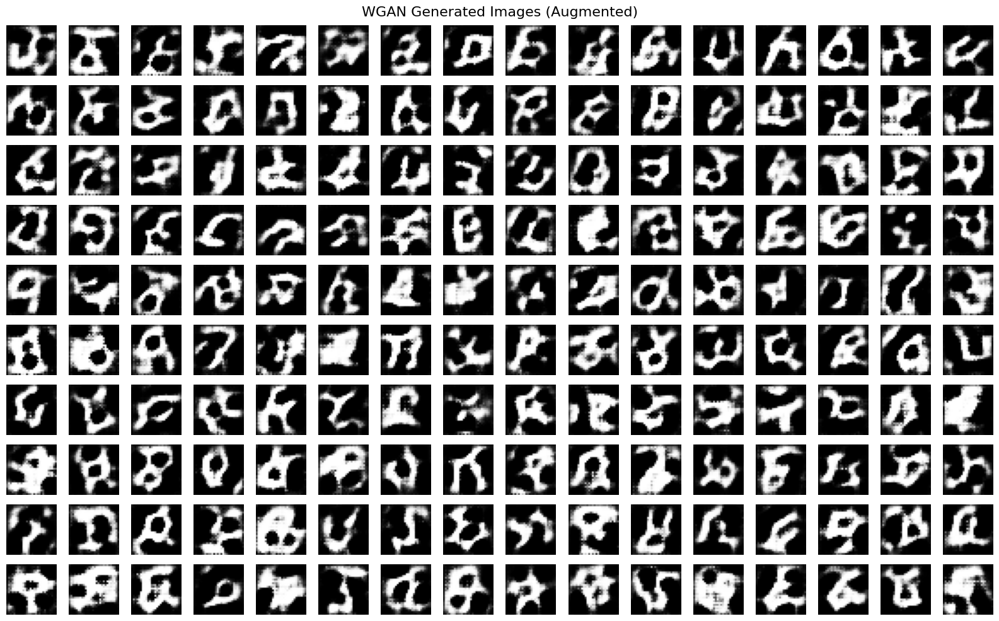

In [ ]:
def plot_generated_images(generator, latent_dim, n_rows=5, n_cols=5, save_path=None, title="WGAN Generated Images (Augmented)", seed=42):
    # ----- Generate Latent Vectors ----- #
    if seed is not None:
        tf.random.set_seed(seed)
    noise = tf.random.normal([n_rows * n_cols, latent_dim])
    gen_images = generator(noise, training=False)

    # ----- Rescale from [-1, 1] to [0, 1] ----- #
    gen_images = (gen_images + 1.0) / 2.0
    gen_images = tf.clip_by_value(gen_images, 0.0, 1.0)

    # ----- Shape Check ----- #
    assert gen_images.shape[-1] == 1, "Expected single-channel (grayscale) output"

    # ----- Sample Plot ----- #
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols, n_rows))
    for idx, ax in enumerate(axes.flat):
        ax.imshow(gen_images[idx, :, :, 0], cmap='gray')
        ax.axis('off')

    plt.suptitle(title, fontsize=16)
    plt.tight_layout()

    if save_path:
        plt.savefig(save_path, dpi=300)
        print(f"Saved Generated Image Grid to: {save_path}")

    plt.show()

# ========== Call Plot Function ========== #
plot_generated_images(generator, latent_dim=100, n_rows=10, n_cols=16)

With reference to the output of the Visual Grid of Samples above, we are able to make the following observations:

**Basic Structure of Letters is Not Captured**

- Some samples faintly resemble letters such as "P", "C", "R", or "A".

- Closed shapes and upright forms occasionally match expected EMNIST patterns.

**High Blur and Noise**

- Widespread pixel noise and inconsistent contrast degrade image clarity.

- Many characters are over-saturated or contain fragmented blobs.

**Poor Character Consistency**

- Several glyphs are malformed or show overlapping strokes and disconnected segments.

- Structural features like loops or stems are frequently distorted or excessive.

With the observations indicated above, we will proceed to conduct the Loss Curve Analysis in the next sub-section.

---
#### 5.5.11.2 Loss Curve Over Epochs

In this sub-section, we will be plotting the GAN Loss Curve over Epochs to evaluate the training behaviour of the GAN. This curve provides insight into whether the GAN is experiencing underfitting, overfitting, or achieving a stable training dynamic between the generator and discriminator.

Although GANs do not minimise a single unified loss in the traditional sense, the trajectory of the generator and discriminator losses can indicate whether the adversarial training process is converging appropriately.

If the generator loss remains high while discriminator loss quickly drops to near-zero, this may indicate **underfitting**, where the generator is not learning effectively to produce plausible images.

If the discriminator loss increases while generator loss sharply decreases, this may suggest **overfitting** or **mode collapse**, where the generator exploits narrow weaknesses in the discriminator without general improvement.

A relatively stable oscillation or convergence between both losses typically signifies a **well-balanced** training process, where the generator and discriminator are learning in tandem.

The Potential Observations and Corresponding Action Plans are outlined below:

**Underfitting Loss Curve**

- Increase training epochs to allow generator more time to learn.

- Simplify the discriminator to reduce overpowering the generator.

- Adjust the learning rate or apply label smoothing.

- Consider adding batch normalisation in the generator.

**Overfitting or Mode Collapse Loss Curve**

- Introduce or increase dropout in the discriminator.

- Apply input noise or label flipping to the discriminator.

- Evaluate diversity of generated samples regularly.

**Balanced/Ideal Loss Curve**

- Maintain current architecture and hyperparameters.

- Proceed with full-scale image generation.

- Evaluate both qualitative (visual inspection) and quantitative metrics (e.g. Inception Score or FID).

With these potential training behaviours and action plan outlined, we will proceed to visualise the GAN loss dynamics in the code cell below.

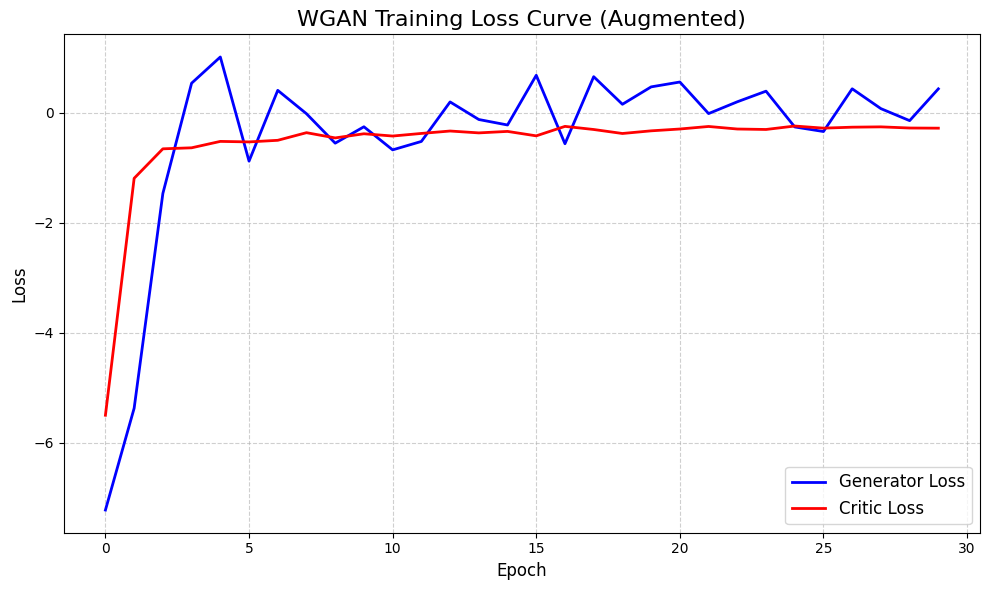

In [ ]:
# ========== Figure Size Configuration ========== #
plt.figure(figsize=(10, 6))

# ========== Plot Training Losses ========== #
plt.plot(gen_loss_history, label="Generator Loss", linewidth=2, color='blue')
plt.plot(critic_loss_history, label="Critic Loss", linewidth=2, color='red')

# ========== Labels and Title ========== #
plt.xlabel("Epoch", fontsize=12)
plt.ylabel("Loss", fontsize=12)
plt.title("WGAN Training Loss Curve (Augmented)", fontsize=16)

# ========== Grid, Legend, and Styling ========== #
plt.grid(True, linestyle='--', alpha=0.6)
plt.legend(fontsize=12)
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)

# ========== Display the Plot ========== #
plt.tight_layout()
plt.show()

With reference to the output of the Loss Curve above, we are able to make the following observations:

- Generator shows stable but dynamic learning which is acceptable for WGANs.

- Critic provides reliable, smooth feedback.

- Data augmentation increases generator loss variance (not instability).

- Training is healthy, with generator and critic adapting to richer data diversity.

With the observations indicated above, we will proceed to conduct the Quantitative Metrics Evaluation in the next sub-section.

---
#### 5.5.11.3 Quantitative Metrics Evaluation

In this sub-section we will be utilising Quantitative Metrics such as FID and KID to tabulate the results of the performance and quantify the performance of the GAN Generator. We will subsequently be use these metrics to conduct inter-model evaluation after tuning and training all the GANs. The metrics that we will be utilising and their respective formulas are indicated below:

---
**Fréchet Inception Distance**

Purpose: Measures the Distance between the Real-Image and Generated-Image Distributions in Inception Feature Space.

$$
\mathrm{FID} \;=\;\|\mu_r - \mu_f\|^2
\;+\;\mathrm{Tr}\Bigl(\Sigma_r + \Sigma_f - 2\,(\Sigma_r\,\Sigma_f)^{\tfrac12}\Bigr)
$$


Where:
- $\mu_r = \mathbb{E}[f(x)]$, $\Sigma_r = \mathrm{Cov}[f(x)]$ for Real Images $x$.  
- $\mu_f = \mathbb{E}[f(\hat x)]$, $\Sigma_f = \mathrm{Cov}[f(\hat x)]$ for Generated Images $\hat x$.  
- $f(\cdot)$ = Map from Image to its InceptionV3 'pooling=avg' Features.  

---
**Diversity (t-SNE Spread)**

Purpose: Quantifies how 'wide' the 2D t-SNE Embedding of Generated Samples.

$$
\mathrm{Spread}
\;=\;
\bigl(\max_i\,z_i^{(1)} - \min_i\,z_i^{(1)}\bigr)
\;\times\;
\bigl(\max_i\,z_i^{(2)} - \min_i\,z_i^{(2)}\bigr)
$$

Where:
- $z_i = (z_i^{(1)}, z_i^{(2)})$ = 2-dimensional t-SNE Embedding of $i$th Generated Image.

---
**Mode Collapse Risk**

Purpose: Flags when too many Generated Images are Nearly Identical (mode collapse).

$$
\text{ModeCollapseRisk} =
\begin{cases}
\text{Low}, & \dfrac{\bigl|\{\mathrm{unique\_rounded}(x_i)\}\bigr|}{N} > \tau,\\
\text{High}, & \text{otherwise}.
\end{cases}
$$

Where:
- $x_i$ = $N$ Generated Samples.  
- $\mathrm{unique\_rounded}(x_i)$ = Rounds Pixels to Detect Duplicates.  
- $\tau=0.9$ = Uniqueness Threshold (90%).

---
**Perceptual Path Length**

Purpose: Measures Sensitively of Generator's Outputs (in VGG16 Feature Space) move when the Latent Code $z$ is Perturbed.

$$
\mathrm{PPL}
\;=\;
\mathbb{E}_{z,\delta z}\Bigl[\,
\|\phi\bigl(G(z + \epsilon\,\delta z)\bigr)\;-\;\phi\bigl(G(z)\bigr)\|_2^2
\Bigr]
$$

Where:  
- $G(z)$ = GAN Generator Mapping $z\in\mathbb{R}^{\mathrm{latent\_dim}}$ to an Image.  
- $\phi(\cdot)$ = VGG16 'pooling=avg' Feature Extractor.  
- $\delta z\sim\mathcal{N}(0,I)$, $\epsilon$ = Small Constant.

---
**Kernel Inception Distance**

Purpose: An Unbiased Estimator of the Squared Maximum Mean Discrepancy (MMD) between Real and Generated Inception Features.

$$
\mathrm{KID}
\;=\;
\frac{1}{m(m-1)}\sum_{i\neq j} k\bigl(\phi(x_i),\phi(x_j)\bigr)
\;+\;
\frac{1}{n(n-1)}\sum_{i\neq j} k\bigl(\phi(\hat x_i),\phi(\hat x_j)\bigr)
\;-\;
\frac{2}{mn}\sum_{i=1}^m\sum_{j=1}^n k\bigl(\phi(x_i),\phi(\hat x_j)\bigr)
$$

Where:  
- $x_i$ ($i=1\ldots m$) = Real Images.
- $\hat x_j$ ($j=1\ldots n$) = Generated Images.  
- $\phi(\cdot)$ = InceptionV3 Feature Extractor (pooling='avg').  
- $k(u,v) = \bigl(\frac{u^\top v}{d}+1\bigr)^3$ = degree-3 Polynomial Kernel on $d$-dimensional Features.

---

With the mathematical and metrics indicated above, we will proceed to conduct the Quantitave Metrics Evalution in the Code Cell below.

In [ ]:
# ========== Preload InceptionV3 and VGG16 Models ========== #
inception = InceptionV3(include_top=False, pooling='avg', input_shape=(299, 299, 3))
vgg_model = VGG16(include_top=False, weights='imagenet', input_shape=(128, 128, 3))

# ========== Preprocess for Inception ========== #
def preprocess_images_for_inception(images):
    images = (images + 1.0) * 127.5  # Scale from [-1, 1] to [0, 255]
    images = tf.image.resize(images, [299, 299])
    if images.shape[-1] == 1:
        images = tf.image.grayscale_to_rgb(images)
    return preprocess_input(images)

# ========== Compute FID ========== #
def calculate_fid(real_images, fake_images, batch_size=50):
    real_pp = preprocess_images_for_inception(real_images)
    fake_pp = preprocess_images_for_inception(fake_images)

    act1 = inception.predict(real_pp, batch_size=batch_size, verbose=0)
    act2 = inception.predict(fake_pp, batch_size=batch_size, verbose=0)

    mu1, sigma1 = np.mean(act1, axis=0), np.cov(act1, rowvar=False)
    mu2, sigma2 = np.mean(act2, axis=0), np.cov(act2, rowvar=False)

    diff = mu1 - mu2
    covmean = sqrtm(sigma1 @ sigma2)
    if np.iscomplexobj(covmean):
        covmean = covmean.real

    fid = diff @ diff + np.trace(sigma1 + sigma2 - 2 * covmean)
    return round(fid, 4)

# ========== Compute KID ========== #
def polynomial_kernel(X, Y):
    d = X.shape[1]
    return (np.dot(X, Y.T) / d + 1) ** 3

def calculate_kid(real_images, fake_images, batch_size=128):
    real_pp = preprocess_images_for_inception(real_images)
    fake_pp = preprocess_images_for_inception(fake_images)

    real_features = inception.predict(real_pp, batch_size=batch_size, verbose=0)
    fake_features = inception.predict(fake_pp, batch_size=batch_size, verbose=0)

    m = real_features.shape[0]
    n = fake_features.shape[0]

    k_rr = polynomial_kernel(real_features, real_features)
    k_gg = polynomial_kernel(fake_features, fake_features)
    k_rg = polynomial_kernel(real_features, fake_features)

    np.fill_diagonal(k_rr, 0)
    np.fill_diagonal(k_gg, 0)

    mmd = (k_rr.sum() / (m * (m - 1)) +
           k_gg.sum() / (n * (n - 1)) -
           2 * k_rg.mean())
    return round(mmd, 4)

# ========== Compute t-SNE Spread (Diversity) ========== #
def calculate_tsne_spread(images):
    flat = images.reshape(images.shape[0], -1)
    tsne = TSNE(n_components=2, random_state=42)
    proj = tsne.fit_transform(flat)
    x_range = proj[:, 0].max() - proj[:, 0].min()
    y_range = proj[:, 1].max() - proj[:, 1].min()
    return round(x_range * y_range, 2)

# ========== Assess Mode Collapse ========== #
def assess_mode_collapse(images):
    unique = np.unique(np.round(images), axis=0).shape[0]
    return "Low" if unique > 0.9 * images.shape[0] else "High"

# ========== Compute Perceptual Path Length (PPL) ========== #
def calculate_ppl(generator, latent_dim=100, num_samples=50, epsilon=1e-2):
    distances = []
    for _ in range(num_samples):
        z1 = tf.random.normal([1, latent_dim])
        z2 = z1 + epsilon * tf.random.normal([1, latent_dim])
        img1 = generator(z1, training=False)
        img2 = generator(z2, training=False)

        img1 = tf.image.resize(tf.image.grayscale_to_rgb((img1 + 1.0) * 127.5), (128, 128))
        img2 = tf.image.resize(tf.image.grayscale_to_rgb((img2 + 1.0) * 127.5), (128, 128))

        f1 = vgg_model(vgg_preprocess(img1))
        f2 = vgg_model(vgg_preprocess(img2))
        d = tf.reduce_mean(tf.square(f1 - f2)).numpy()
        distances.append(d)
    return round(np.mean(distances), 4)

# ========== Evaluate GAN Performance ========== #
def evaluate_gan_model(generator, latent_dim, X_val, gen_loss_history, disc_loss_history, model_name="WGAN"):
    # ----- Generate Fake Images ----- #
    noise = tf.random.normal([1000, latent_dim])
    fake_images = generator(noise, training=False)
    fake_images = tf.clip_by_value((fake_images + 1) / 2.0, 0.0, 1.0)
    fake_np = fake_images.numpy()

    # ----- Select and preprocess 1000 Real Images from Validation Set ----- #
    real_images = tf.convert_to_tensor(X_val[:1000], dtype=tf.float32)
    real_images = tf.clip_by_value(real_images, 0.0, 1.0)

    # ----- Compute Metrics ----- #
    fid_value = calculate_fid(real_images, fake_images)
    kid_value = calculate_kid(real_images, fake_images)
    tsne_spread_value = calculate_tsne_spread(fake_np)
    collapse_risk_value = assess_mode_collapse(fake_np)
    ppl_score_value = calculate_ppl(generator, latent_dim)
    mean_gen_loss_value = round(np.mean(gen_loss_history), 4)
    std_gen_loss_value = round(np.std(gen_loss_history), 4)
    mean_disc_loss_value = round(np.mean(disc_loss_history), 4)
    std_disc_loss_value = round(np.std(disc_loss_history), 4)

    # ----- Store as Global Vars (Optional) ----- #
    prefix = model_name.upper()
    globals()[f"{prefix}_FID"] = fid_value
    globals()[f"{prefix}_KID"] = kid_value
    globals()[f"{prefix}_TSNE"] = tsne_spread_value
    globals()[f"{prefix}_MODE_COLLAPSE"] = collapse_risk_value
    globals()[f"{prefix}_PPL"] = ppl_score_value
    globals()[f"{prefix}_GEN_LOSS_MEAN"] = mean_gen_loss_value
    globals()[f"{prefix}_GEN_LOSS_STD"] = std_gen_loss_value
    globals()[f"{prefix}_DISC_LOSS_MEAN"] = mean_disc_loss_value
    globals()[f"{prefix}_DISC_LOSS_STD"] = std_disc_loss_value

    # ----- Final Summary Row ----- #
    row = {
        "Model": model_name,
        "FID Score": fid_value,
        "KID Score": kid_value,
        "Mean Generator Loss": mean_gen_loss_value,
        "Std Generator Loss": std_gen_loss_value,
        "Mean Discriminator Loss": mean_disc_loss_value,
        "Std Discriminator Loss": std_disc_loss_value,
        "Mode Collapse Risk": collapse_risk_value,
        "Visual Quality": "Poor",
        "Diversity (t-SNE Spread)": tsne_spread_value,
        "PPL": ppl_score_value
    }

    return pd.DataFrame([row])[[
        "Model", "FID Score", "KID Score",
        "Mean Generator Loss", "Std Generator Loss",
        "Mean Discriminator Loss", "Std Discriminator Loss",
        "Mode Collapse Risk", "Visual Quality",
        "Diversity (t-SNE Spread)", "PPL"
    ]]

# ========== Create DataFrame ========== #
df = evaluate_gan_model(generator, latent_dim, X_val, gen_loss_history, critic_loss_history, model_name="WGAN (Augmented)")

# ========== Display DataFrame ========== #
df.style.background_gradient(cmap="Blues")

,Model,FID Score,KID Score,Mean Generator Loss,Std Generator Loss,Mean Discriminator Loss,Std Discriminator Loss,Mode Collapse Risk,Visual Quality,Diversity (t-SNE Spread),PPL
0,WGAN (Augmented),217.975200,0.235900,-0.415100,1.672800,-0.567600,0.933700,Low,Poor,5618.979980,0.063800


With reference to the output of the Quantitative Metrics above, we are able to determine the performance of the GAN. This will be used as a basis of comparison to the other GAN Models.

---
#### 5.5.11.4 t-SNE of Generated Samples

In this sub-section, we visualise the t-SNE projection of generated samples to evaluate the latent diversity learned by the unconditional GAN. Although our GAN is not class-conditioned, t-SNE remains a valuable tool to assess whether the generator is producing varied outputs that reflect meaningful use of the latent space. While GANs are trained in high-dimensional spaces, t-SNE enables us to observe 2D structural patterns such as sample clustering, separation, and density, which provide indirect insights into the diversity and generalisation capabilities of the generator. The visualisation will be conducted in the Code Cell below.

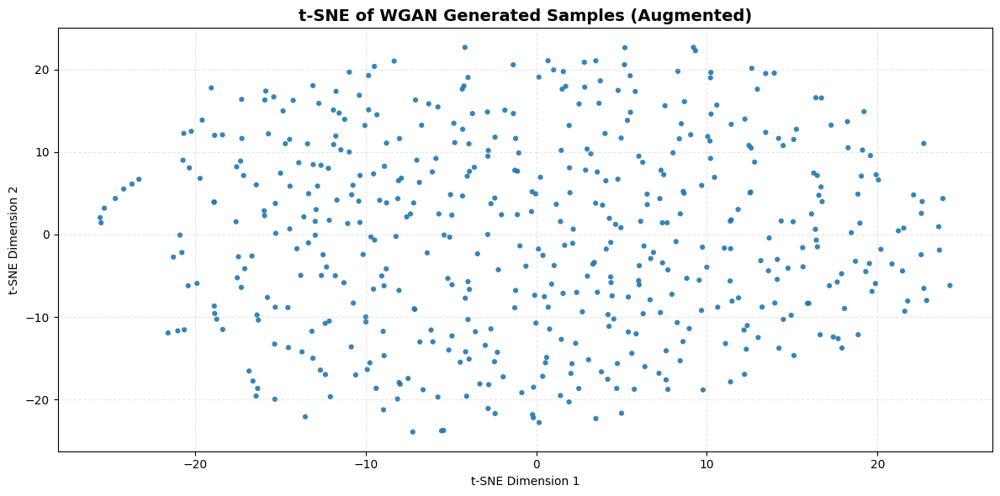

In [ ]:
# ========== Generate New Images from Random Noise ========== #
latent_dim = 100
noise = tf.random.normal([500, latent_dim])
generated_images = generator(noise, training=False)
generated_images = (generated_images + 1) / 2.0

def plot_tsne_embeddings(generated_images, save_path=None, title="t-SNE of WGAN Generated Samples (Augmented)"):
    # ----- Convert to [0, 1] Range ----- #
    if tf.reduce_max(generated_images).numpy() > 1.0:
        raise ValueError("Images should be in [-1, 1] range before scaling.")

    images_rescaled = (generated_images + 1.0) / 2.0
    flat_images = images_rescaled.numpy().reshape(images_rescaled.shape[0], -1)

    # ---- Run t-SNE ----- #
    tsne = TSNE(n_components=2, perplexity=30, learning_rate='auto', init='pca', random_state=42)
    tsne_proj = tsne.fit_transform(flat_images)

    # ----- Plot t-SNE ----- #
    plt.figure(figsize=(12, 6))
    sns.scatterplot(
        x=tsne_proj[:, 0],
        y=tsne_proj[:, 1],
        s=20,
        alpha=0.9,
        edgecolor='none'
    )
    plt.title(title, fontsize=14, weight='bold')
    plt.xlabel("t-SNE Dimension 1")
    plt.ylabel("t-SNE Dimension 2")
    plt.grid(True, linestyle='--', alpha=0.3)
    plt.tight_layout()

    if save_path:
        plt.savefig(save_path, dpi=300)
        print(f"t-SNE plot saved to: {save_path}")

    plt.show()

plot_tsne_embeddings(generated_images=generated_images)

With reference to the t-SNE plot of WGAN Generated Samples (Augmented) above, we are able to make the following observations:

**Improved Latent Distribution Structure**

- The plot displays a globally balanced and even spread of points, with no distinct clusters, yet maintains a uniform structure.

- This aligns with WGAN's use of the Wasserstein loss, which better captures the continuous distance between real and generated distributions, even in augmented training.

**High Robustness to Augmentation**

- Compared to its non-augmented counterpart, WGAN still preserves its latent diversity well.

- This indicates that WGAN is minimally sensitive to augmentation artefacts and retains stable learning behaviour even under noisy or artificially expanded datasets.

**No Evidence of Mode Collapse**

- There is no centralised blob or tightly packed region, meaning WGAN continues to generate a wide variety of samples across the latent space.

- The broad yet coherent distribution is a strong indicator of healthy generation dynamics.

**Mild Uniformity but No Over-regularisation**

- While the points are slightly more compact than InfoGAN or SAGAN, the structure is not overly regular, meaning diversity is retained without sacrificing form.

- This reflects WGAN's advantage in producing stable training without excessive constraints like gradient penalties (used in WGAN-GP).

With the observations indicated above, we will now proceed to train a new GAN Model using Augmented Data in the next sub-section.

---
## 5.6 Deep Regret Analytic GAN Model Training

In this sub-section, we will be training a Least Squares GAN (LSGAN) for the EMNIST Dataset. The LSGAN mainly replace the Binary Crossentropy Loss used in classical GANs with a Least Squares Loss. Through this replacement, the LSGAN is more likely able to have a Stabalise GAN Training, Produce Higher Quality Images, and Encourage the Generator more Accurate Results. The relevant mathematical formulas are indicated below:

---
**Generator Loss:**

Purpose: Produce Outputs Classified as Real.

$$
\mathcal{L}_G = -\mathbb{E}_{z \sim p_z(z)} [\log D(G(z))]
$$

Where:
- $c = 1$ = Desired Discriminator Output for Generated Images  
- $D(G(z))$ = Discriminator's Output for Generated Data  
- $z \sim p_z$ = Sample from Latent Space

---
**Discriminator Loss:**

Purpose: Discriminator Minimises the Least Squares Error between Predictions and True Labels.

$$
\mathcal{L}_D = \frac{1}{2} \mathbb{E}_{x \sim p_{\text{data}}}[(D(x) - b)^2] + \frac{1}{2} \mathbb{E}_{z \sim p_z}[(D(G(z)) - a)^2]
$$

Where:  
- $D(x)$ = Discriminator's Output for Real Data  
- $D(G(z))$ = Discriminator's Output for Generated Data  
- $a = 0$ = Label for Fake Data  
- $b = 1$ = Label for Real Data  
- $x \sim p_{\text{data}}$ = Sample from Real Data Distribution  
- $z \sim p_z$ = Sample from Latent Noise Distribution  

---
**Pertubed Input Sampling:**

Purpose: Add noise to real images to compute gradient penalty near the data manifold.

$$
\hat{x} = x + \alpha \cdot \sigma_x \cdot \epsilon
$$
Where:
- $x$ = Real Data Sample
- $\alpha \sim \mathcal{U}(0, 1)$ = Uniform Random Variable
- $\epsilon \sim \mathcal{N}(0, 1)$ = Standard Normal Noise
- $\sigma_x$ = Standard Deviation of Data Batch (per pixel)

---
**Minimax Objective with DRAGAN Penalty:**

Purpose: LSGAN Seeks to Solve the Objective.

$$
\min_G \max_D \; V(D, G) = \mathbb{E}_{x \sim p_{data}} [\log D(x)] + \mathbb{E}_{z \sim p_z(z)} [\log(1 - D(G(z)))] - \lambda \cdot \mathbb{E}_{\hat{x} \sim p_{perturbed}} \left[ \left( \|\nabla_{\hat{x}} D(\hat{x}) \|_2 - 1 \right)^2 \right]
$$
Where:
- $V(D, G)$ = Value Function for Adversarial Training
---
With the relevant mathematical formulas indicated above, we will proceed to train the LSGAN in this sub-section for the purpose of it's potential for smoother training process and also to serve as a comparison for our other GAN Models.

---
### 5.6.1 Defining Data Pre-Processing Function

In this sub-section, we will be defining the Data Pre-Processing Function which will allow for consistent Data Pipeline to be built and modifed accordingly should the need arise such as when we need to add Spectral Normalisation. This will ensure that the Data's integrity is not affected and we are able to make fair and un-biased assumptions. The Data Pre-Processing Function is defined in the Code Cell below:

In [ ]:
# ========== Data Pre-Processing Function ========== #
def load_data(X_train, batch_size=64):
    # ----- Trim X_train Down to Multiple of Batch_size ----- #
    n_full = (X_train.shape[0] // batch_size) * batch_size
    X_trimmed = X_train[:n_full]

    # ----- Compute Steps For Each Epoch ----- #
    steps_per_epoch = n_full // batch_size

    # ----- Build the ImageDataGenerator Iterator ----- #
    datagen_iter = datagen.flow(X_trimmed, batch_size=batch_size, shuffle=True)

    # ----- Wrap as a tf.data.Dataset with a Fixed-shape Signature ----- #
    dataset = tf.data.Dataset.from_generator(
        lambda: (next(datagen_iter) for _ in range(steps_per_epoch)),
        output_signature=tf.TensorSpec((batch_size, 28, 28, 1), tf.float32)
    )

    return dataset.prefetch(tf.data.AUTOTUNE)

With reference to the Code Cell above, we are able to determine that the Data Pre-Processing Function have been defined successfully and we are able to move on to Defining Callback Functions in the next sub-section.

---
### 5.6.2 Defining Callback Functions

In this sub-section, we will be pre-defining the various Callbacks. This is to ensure consistency throughout the model and also to increase the GAN Accuracy and optimise the Computation Cost for training each GAN Model. These Callbacks will be main used during the GAN Training in the next sub-section. The revelant mathematical formula for the callbacks and logic are indicated below:

---
**Learning Rate Scheduler:**

Purpose: Reduces Learning Rate During Training to Fine-tune Model Convergence.

$$\text{If } epoch \mod 10 = 0 \Rightarrow \eta_{new} = \frac{1}{2} \cdot \eta$$

Where:

- $\eta$ = current learning rate

- $\eta_{\text{new}}$ = updated learning rate

- $epoch \bmod 10$ checks if the epoch is a multiple of 10

---
**ReduceLROnPlateau:**

Purpose: Automatically Reduces the Learning Rate when Validation Performance Plateaus.

$$
\text{If no improvement in } val\_loss \text{ for 10 epochs: } \eta_{\text{new}} = 0.5 \cdot \eta
$$

Where:

- $\eta_{\text{new}}$ = reduced learning rate

---
**EarlyStopping:**

Purpose: Prevents Wastage of Computational Power if Model Does Not Improve.

$$
\text{If } val\_loss \text{ does not improve for 25 epochs, stop training and restore best weights}
$$

---

We will proceed to Define the Callbacks in the Code Cell below in preparation for the GAN Model Training.

In [ ]:
# ========== Define Learning Rate Scheduler ========== #
lr_scheduler = LearningRateScheduler(
    lambda epoch, lr: lr * 0.95 if epoch % 10 == 0 else lr,
    verbose=1
)

# ========== Define Reduce LR on Plateau ========== #
reduce_lr = ReduceLROnPlateau(
    monitor='loss',
    factor=0.5,
    patience=10,
    verbose=1,
    min_lr=1e-6
)

# ========== Define Early Stopping ========== #
early_stop = EarlyStopping(
    monitor='loss',
    patience=25,
    verbose=1,
    restore_best_weights=False
)

# ========== Define Display Generated Images ========== #
def display_generated_images(generator, latent_dim, n=7):
    noise = tf.random.normal([n * n, latent_dim])
    generated_images = generator(noise, training=False)
    generated_images = (generated_images + 1.0) / 2.0

    fig, axes = plt.subplots(n, n, figsize=(n, n))
    for i in range(n):
        for j in range(n):
            img = generated_images[i * n + j, :, :, 0]
            axes[i, j].imshow(img, cmap='gray')
            axes[i, j].axis('off')

    plt.tight_layout()
    plt.show()

# ========== Define FID Calculator ========== #
def calculate_fid(real_images, fake_images, batch_size=10):

    # ----- Scale to [0,255] and Resize to 299×299 ----- #
    real = (real_images + 1.0) * 127.5
    fake = (fake_images + 1.0) * 127.5
    real = tf.image.resize(real, (299,299))
    fake = tf.image.resize(fake, (299,299))

    # ----- If Grayscale, Convert to RGB ----- #
    if real.shape[-1] == 1:
        real = tf.image.grayscale_to_rgb(real)
        fake = tf.image.grayscale_to_rgb(fake)

    # ----- Preprocess for Inception (–1 to +1) ----- #
    real_pp = preprocess_input(real)
    fake_pp = preprocess_input(fake)

    # ----- Extract Features in Batches ----- #
    def _get_acts(x):
        acts = []
        n = x.shape[0]
        for i in range(0, n, batch_size):
            chunk = x[i:i+batch_size]
            acts.append(_inception_model(chunk, training=False).numpy())
        return np.vstack(acts)

    act_real = _get_acts(real_pp)
    act_fake = _get_acts(fake_pp)

    # ----- Compute Statistics ----- #
    mu1, sigma1 = act_real.mean(axis=0), np.cov(act_real, rowvar=False)
    mu2, sigma2 = act_fake.mean(axis=0), np.cov(act_fake, rowvar=False)
    diff    = mu1 - mu2
    covmean = sqrtm(sigma1.dot(sigma2))
    if np.iscomplexobj(covmean):
        covmean = covmean.real
    fid = diff.dot(diff) + np.trace(sigma1 + sigma2 - 2*covmean)
    return float(np.round(fid,4))

# ========== Confirmation Message ========== #
print("DRAGAN Callbacks and Visualisation Setup Complete")

DRAGAN Callbacks and Visualisation Setup Complete


With reference to the Code Cell above, we are able to verify that that the Callbacks have been successfully defined and the various parameters are set so as to ensure a High Accuracy and Computing Efficient GAN Model Training.

---
### 5.6.3 Defining DRAGAN Generator Architecture

In this section, we will be defining the DRAGAN's Generator Architecture. The Generator will be trying to make realistic generated images in the attempt to bypass the Discriminator. Subsequently, the generated images from the Generator will be evaluated based on a few evaluation metrics such as Inception Score. The relevent mathematical formulas for the Loss Function of the Vanilla GAN Generator is indicated below:

---
**Generator Loss:**

Purpose: Produce Outputs Classified as Real.

$$
\mathcal{L}_G = \frac{1}{2} \mathbb{E}_{z \sim p_z}[(D(G(z)) - c)^2]
$$

Where:
- $c = 1$ = Desired Discriminator Output for Generated Images  
- $D(G(z))$ = Discriminator's Output for Generated Data  
- $z \sim p_z$ = Sample from Latent Space

---
With the relevant Generator Loss Formula indicated above, we will proceed to define the GAN Generator's Architecture in the Code Cell below and the Lost Function.

In [ ]:
# ========== Generator Function ========== #
def build_generator(latent_dim=100, use_dropout=True):
    model = tf.keras.Sequential(name="generator")

    # ----- Project and Reshape ----- #
    model.add(tf.keras.layers.Dense(7 * 7 * 256, use_bias=False, input_shape=(latent_dim,)))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.ReLU())
    model.add(tf.keras.layers.Reshape((7, 7, 256)))

    # ----- Upsample 1 ----- #
    model.add(tf.keras.layers.Conv2DTranspose(128, kernel_size=5, strides=1, padding='same', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.ReLU())
    if use_dropout:
        model.add(tf.keras.layers.Dropout(0.3))

    # ----- Upsample 2 ----- #
    model.add(tf.keras.layers.Conv2DTranspose(64, kernel_size=5, strides=2, padding='same', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.ReLU())
    if use_dropout:
        model.add(tf.keras.layers.Dropout(0.3))

    # ----- Final Output to 28x28x1 ----- #
    model.add(tf.keras.layers.Conv2DTranspose(1, kernel_size=5, strides=2, padding='same', activation='tanh'))

    return model

# ========== DRAGAN Generator Loss (BCE) ========== #
bce = tf.keras.losses.BinaryCrossentropy(from_logits=True)

def generator_loss(fake_output):
    return bce(tf.ones_like(fake_output), fake_output)

With reference to the Code Cell above, we are able to verify that the GAN's Generator Architecture have been successfully defined and we are able to proceed to define the GAN's Discriminator Architecture.

---
### 5.6.4 Defining DRAGAN Discriminator Architecture

In this section, we will be defining the Architecture of the Discriminator of the GAN. The Discriminator will be the Neural Network that will attempt to tell the Generated Images apart from the Actual Images. This will allow the GAN to improve overtime and also improve itself overtime. The mathematical function for the Discriminator Loss Function is indicated below:

---
**Discriminator Loss:**

Purpose: Discriminator Minimises the Least Squares Error between Predictions and True Labels.

$$
\mathcal{L}_D = \frac{1}{2} \mathbb{E}_{x \sim p_{\text{data}}}[(D(x) - b)^2] + \frac{1}{2} \mathbb{E}_{z \sim p_z}[(D(G(z)) - a)^2]
$$

Where:  
- $D(x)$ = Discriminator's Output for Real Data  
- $D(G(z))$ = Discriminator's Output for Generated Data  
- $a = 0$ = Label for Fake Data  
- $b = 1$ = Label for Real Data  
- $x \sim p_{\text{data}}$ = Sample from Real Data Distribution  
- $z \sim p_z$ = Sample from Latent Noise Distribution  
---

With the mathematical formula for the Loss Function indicated above, we will proceed to define the GAN's Discriminator Architecture and the Loss Function in the Code Cell below.

In [ ]:
# ========== Discriminator Function ========== #
def build_discriminator(input_shape=(28, 28, 1)):
    model = tf.keras.Sequential(name="discriminator")

    model.add(tf.keras.layers.Conv2D(64, kernel_size=5, strides=2, padding='same', input_shape=input_shape))
    model.add(tf.keras.layers.LeakyReLU(0.2))
    model.add(tf.keras.layers.Dropout(0.3))

    model.add(tf.keras.layers.Conv2D(128, kernel_size=5, strides=2, padding='same'))
    model.add(tf.keras.layers.LeakyReLU(0.2))
    model.add(tf.keras.layers.Dropout(0.3))

    model.add(tf.keras.layers.Flatten())
    model.add(tf.keras.layers.Dense(1))

    return model

# ========== Discriminator Loss Function ========== #
bce = tf.keras.losses.BinaryCrossentropy(from_logits=True)

def discriminator_loss(real_output, fake_output):
    real_labels = tf.ones_like(real_output)
    fake_labels = tf.zeros_like(fake_output)

    real_loss = bce(real_labels, real_output)
    fake_loss = bce(fake_labels, fake_output)

    return real_loss + fake_loss

With reference to the Code Cell above, we are able to verify that the GAN's Discriminator Architecture have been successfully defined and we are able to proceed to define the GAN's Training Steps.

---
### 5.6.5 Defining Training Step

In this section, we will be Defining the Training Step function so as to train both the Generator and the Discriminator at the same time. The Training Step will compute the gradients for both the Generator and the Discriminator at the same time. The relevant mathematical formulas for the Training Step is indicated below:

---
**Generator Loss:**

Purpose: Produce Outputs Classified as Real.

$$
\mathcal{L}_G = \frac{1}{2} \mathbb{E}_{z \sim p_z}[(D(G(z)) - c)^2]
$$

Where:
- $c = 1$ = Desired Discriminator Output for Generated Images  
- $D(G(z))$ = Discriminator's Output for Generated Data  
- $z \sim p_z$ = Sample from Latent Space

---
**Discriminator Loss:**

Purpose: Discriminator Minimises the Least Squares Error between Predictions and True Labels.

$$
\mathcal{L}_D = \frac{1}{2} \mathbb{E}_{x \sim p_{\text{data}}}[(D(x) - b)^2] + \frac{1}{2} \mathbb{E}_{z \sim p_z}[(D(G(z)) - a)^2]
$$

Where:  
- $D(x)$ = Discriminator's Output for Real Data  
- $D(G(z))$ = Discriminator's Output for Generated Data  
- $a = 0$ = Label for Fake Data  
- $b = 1$ = Label for Real Data  
- $x \sim p_{\text{data}}$ = Sample from Real Data Distribution  
- $z \sim p_z$ = Sample from Latent Noise Distribution  

---
**Minimax Objective with DRAGAN Penalty:**

Purpose: LSGAN Seeks to Solve the Objective.

$$
\min_G \max_D \; V(D, G) = \mathbb{E}_{x \sim p_{data}} [\log D(x)] + \mathbb{E}_{z \sim p_z(z)} [\log(1 - D(G(z)))] - \lambda \cdot \mathbb{E}_{\hat{x} \sim p_{perturbed}} \left[ \left( \|\nabla_{\hat{x}} D(\hat{x}) \|_2 - 1 \right)^2 \right]
$$
Where:
- $V(D, G)$ = Value Function for Adversarial Training
---

With the relevant mathematical formulas indicated above, we will proceed to define the Training Step in the Code Cell below.

In [ ]:
# ========== Training Step Function ========== #
@tf.function
def train_step(real_images, generator, discriminator,
               gen_optimizer, disc_optimizer,
               latent_dim, gp_weight=10.0):
    batch_size = tf.shape(real_images)[0]

    # ----- Latent Noise (L2-Normalised) ----- #
    noise = tf.random.normal([batch_size, latent_dim])
    noise = tf.math.l2_normalize(noise, axis=1)

    # ----- Instance Noise on Real Images ----- #
    real_noisy = real_images + tf.random.normal(tf.shape(real_images)) * 0.05

    # ----- Compute Losses & Gradients ----- #
    with tf.GradientTape(persistent=True) as tape:
        # ----- Generate Fake Images ----- #
        fake_images = generator(noise, training=True)

        # ----- Discriminator Outputs ----- #
        real_output = discriminator(real_noisy, training=True)
        fake_output = discriminator(fake_images, training=True)

        # ----- Adversarial BCE Losses with Label Smoothing ----- #
        real_labels = tf.ones_like(real_output) * 0.9  # label smoothing
        fake_labels = tf.zeros_like(fake_output)
        real_loss = bce(real_labels, real_output)
        fake_loss = bce(fake_labels, fake_output)
        disc_loss = real_loss + fake_loss

        # ----- Generator Loss ----- #
        gen_loss = bce(tf.ones_like(fake_output), fake_output)

        # ----- DRAGAN Gradient Penalty (Local Perturbation) ----- #
        alpha = tf.random.uniform([batch_size, 1, 1, 1], 0.0, 1.0)
        noise_perturb = 0.5 * tf.random.normal(tf.shape(real_images))
        x_hat = real_images + alpha * noise_perturb
        with tf.GradientTape() as gp_tape:
            gp_tape.watch(x_hat)
            pred_hat = discriminator(x_hat, training=True)
        grads = gp_tape.gradient(pred_hat, x_hat)
        grads = tf.reshape(grads, [batch_size, -1])
        grads_norm = tf.sqrt(tf.reduce_sum(tf.square(grads), axis=1) + 1e-12)
        gp = tf.reduce_mean((grads_norm - 1.0) ** 2)

        # ----- Add Gradient Penalty to Discriminator Loss ----- #
        disc_loss += gp_weight * gp

    # ----- Apply Gradients ----- #
    gen_grads = tape.gradient(gen_loss, generator.trainable_variables)
    disc_grads = tape.gradient(disc_loss, discriminator.trainable_variables)
    gen_optimizer.apply_gradients(zip(gen_grads, generator.trainable_variables))
    disc_optimizer.apply_gradients(zip(disc_grads, discriminator.trainable_variables))

    del tape

    return gen_loss, disc_loss, real_output, fake_output

With reference to the Code Cell above, we are able to determine that the Training Step have been successfully defined and we are able to proceed to prepare the Training Loop in the next section.

---
### 5.6.6 Defining Training Loop

In this section, we will be defining the Training Loop for the GAN Training. The Training Loop will go through each of the Epoch and train both the Generator and Discriminator simultaneously. The Training Loop will also track the Loss for both the Generator and the Discriminator for each of the Epoch trained. The relevant mathematical formulas are indicated below:

---
**Epoch Loss Averaging:**

Purpose: These are the Average Generator and Discriminator Losses over all Batches in Epoch $t$.

$$
\bar{L}_G^{(t)} = \frac{1}{N} \sum_{i=1}^{N} L_G^{(i)} \\
\bar{L}_D^{(t)} = \frac{1}{N} \sum_{i=1}^{N} L_D^{(i)}
$$

Where:
- $\bar{L}_G^{(t)}$ = Average Generator Loss at Epoch $t$  
- $\bar{L}_D^{(t)}$ = Average Discriminator Loss at Epoch $t$  
- $N$ = Number of Batches in the Dataset  
- $L_G^{(i)}$ = Generator Loss on Batch $i$  
- $L_D^{(i)}$ = Discriminator Loss on Batch $i$

---
**Epoch Iteration:**

Purpose: Describes the Training Loop Logic: for Each Epoch $t$, perform `train_step` for Every Mini-batch.

$$
\text{for } t = 1 \text{ to } T:
\quad \text{for each batch } (x^{(i)}):
\quad \text{train_step}(x^{(i)})
$$

Where:
- $T$: Total Number of Epochs  
- $x^{(i)}$: Real Batch $i$ from the Dataset  
- `train_step`: Function that Updates $G$ and $D$ using that Batch

---
**Generated Image Output:**

Purpose: Sample Random Noise $z$ and Generate Synthetic Image $\hat{x}$ from the Generator. This is used for Visual Monitoring of Model Quality.

$$
z \sim p_z(z) \\
\hat{x} = G(z)
$$

Where:
- $z$: Random Latent Vector  
- $G(z)$: Generated Image from Generator

---
With the mathematical formulas indicated above, we will proceed to define the Training Loop in the Code Cell below in preparation of the GAN Training.

In [ ]:
# ========== Training Loop Function ========== #
def train(dataset, epochs, generator, discriminator, gen_optimizer, disc_optimizer, latent_dim, save_path=None, use_early_stopping=True, steps_per_epoch=None, gp_weight=10.0):

    # ----- Prepare Fixed Real Batch from Validation Set X_val for FID ----- #
    real_val = tf.data.Dataset.from_tensor_slices(X_val).batch(50).take(1)

    # ----- Prepare Fixed Noise Batch for FID ----- #
    noise_val = tf.random.normal([50, latent_dim])
    noise_val = tf.math.l2_normalize(noise_val, axis=1)

    # ----- Early Stopping ----- #
    best_fid     = float('inf')
    no_improve   = 0
    patience     = 10
    fid_interval = 1

    # ----- Dummy Model ----- #
    dummy_input  = Input(shape=(1,))
    dummy_output = Lambda(lambda x: x)(dummy_input)
    dummy_model  = Model(dummy_input, dummy_output)
    dummy_model.compile(optimizer=Adam(1e-4), loss='mse')

    early_stop.set_model(dummy_model)
    reduce_lr.set_model(dummy_model)
    lr_scheduler.set_model(dummy_model)
    early_stop.on_train_begin({})
    reduce_lr.on_train_begin({})
    lr_scheduler.on_train_begin({})

    # ----- Track Loss Histories ----- #
    gen_loss_history  = []
    disc_loss_history = []

    for epoch in range(1, epochs + 1):
        print(f"\nEpoch {epoch}/{epochs}")
        gen_losses, disc_losses = [], []

        # ----- Per‐batch Training ----- #
        for i, real_images in enumerate(dataset):
            if steps_per_epoch and i >= steps_per_epoch:
                break

            gen_loss, disc_loss, _, _ = train_step(
                real_images,
                generator,
                discriminator,
                gen_optimizer,
                disc_optimizer,
                latent_dim,
                gp_weight=gp_weight
            )
            gen_losses.append(gen_loss)
            disc_losses.append(disc_loss)

        # ----- Compute Averages ----- #
        avg_gen_loss  = tf.reduce_mean(gen_losses)
        avg_disc_loss = tf.reduce_mean(disc_losses)
        print(f"Generator Loss: {avg_gen_loss:.4f} | Discriminator Loss: {avg_disc_loss:.4f}")

        gen_loss_history.append(float(avg_gen_loss))
        disc_loss_history.append(float(avg_disc_loss))

        # ----- Callback on Generator Loss ----- #
        logs = {'loss': float(avg_gen_loss)}
        if use_early_stopping:
            early_stop.on_epoch_end(epoch=epoch, logs=logs)
            if early_stop.stopped_epoch > 0:
                print(f"Early stopping triggered at epoch {epoch}")
                break
        reduce_lr.on_epoch_end(epoch=epoch, logs=logs)
        lr_scheduler.on_epoch_end(epoch=epoch, logs=logs)

        # ----- FID Evaluation & Early Stopping ----- #
        if epoch % fid_interval == 0:
            fake_val   = generator(noise_val, training=False)
            real_batch = next(iter(real_val))

            # ----- Resize & Rescale to [0,1] ----- #
            real_for_fid = tf.image.resize(real_batch, [299,299]) * 0.5 + 0.5
            fake_for_fid = tf.image.resize(fake_val,    [299,299]) * 0.5 + 0.5
            fid_value = calculate_fid(real_for_fid, fake_for_fid)

            print(f"Epoch {epoch} → Val FID: {fid_value:.2f}")

            if fid_value < best_fid:
                best_fid   = fid_value
                no_improve = 0
                if save_path:
                    os.makedirs(save_path, exist_ok=True)
                    generator.save_weights(os.path.join(save_path, "best_gen.weights.h5"))
                    discriminator.save_weights(os.path.join(save_path, "best_disc.weights.h5"))
            else:
                no_improve += 1

            if no_improve >= patience:
                print(f"No FID improvement for {patience} epochs, stopping.")
                break

        # ----- Display Every 5 Epochs ----- #
        if epoch % 5 == 0:
            display_generated_images(generator, latent_dim)

    # ----- Restore Best Weights After Training ----- #
    if save_path:
        best_gen_path = os.path.join(save_path, "best_gen.weights.h5")
        best_disc_path = os.path.join(save_path, "best_disc.weights.h5")
        if os.path.exists(best_gen_path) and os.path.exists(best_disc_path):
            generator.load_weights(best_gen_path)
            discriminator.load_weights(best_disc_path)
            print("Restored best generator and discriminator weights based on lowest FID.")
        else:
            print("Best weight files not found. Skipping restore.")

    return avg_gen_loss, gen_loss_history, disc_loss_history

With reference to the Code Cell above, we are able to determine that the Training Loop have been successfully defined and we are able to proceed to define the Optimisers with Tunable Parameter in preparation for the Optuna Tuning.

---
### 5.6.7 Defining Optimisers with Tunable Parameters

In this section, we will be defining the Common Optimisers that will be Tuned using the Optuna Tuning. The Optimisers will each have a range of values in a list so as to allow for the Optuna to search for the best Hyperparameter for the GAN. Through these parameters, it will affect how effective and efficiently the GAN will learn from the provided EMNIST Data. The relevent mathematical formula is indicated below:

---
**Optimiser Update Rule**

Purpose: Parameter Update Step in the Adam Optimiser, using Adaptive Learning Rates with Momentum.

$$
\theta \leftarrow \theta - \eta \cdot \frac{m_t}{\sqrt{v_t} + \epsilon}
$$

Where:
- $\theta$ = Model Parameters (Generator or Discriminator)
- $\eta$ = Learning Rate (Tuned)
- $m_t$ = First Moment Estimate (Mean of Gradients)
- $v_t$ = Second Moment Estimate (Variance of Gradients)
- $\epsilon$ = Small Constant for Numerical Stability

---
With the mathematical formula indicated above, we will proceed to define the Optimisers in the Code Cell.

In [ ]:
# ========== Objective Function ========== #
def objective(trial):
    # ----- Hyperparameters ----- #
    latent_dim   = trial.suggest_categorical('latent_dim', [100, 128, 160])
    learning_rate = trial.suggest_float('learning_rate', 5e-5, 2e-4, log=True)
    beta_1        = trial.suggest_float('beta_1', 0.4, 0.6)

    # ----- Build Models (Unconditional) ----- #
    generator     = build_generator(latent_dim=latent_dim)
    discriminator = build_discriminator()

    # ----- Trigger Weight Creation ----- #
    _ = generator(tf.random.uniform([1, latent_dim], -1.0, 1.0))
    _ = discriminator(tf.random.normal([1, 28, 28, 1]))

    # ----- Define Optimizers ----- #
    gen_optimizer  = tf.keras.optimizers.Adam(learning_rate=learning_rate, beta_1=beta_1)
    disc_optimizer = tf.keras.optimizers.Adam(learning_rate=learning_rate, beta_1=beta_1)

    # ----- Prebuild Optimizer Variables ----- #
    _ = gen_optimizer.apply_gradients([(tf.zeros_like(v), v) for v in generator.trainable_variables])
    _ = disc_optimizer.apply_gradients([(tf.zeros_like(v), v) for v in discriminator.trainable_variables])

    # ----- Load Training Data (Unconditional) ----- #
    dataset = load_data(X_train, batch_size=64)
    steps   = min(1000, len(X_train) // 64)

    # ----- Train DRAGAN ----- #
    _ = train(
        dataset=dataset,
        epochs=50,
        generator=generator,
        discriminator=discriminator,
        gen_optimizer=gen_optimizer,
        disc_optimizer=disc_optimizer,
        latent_dim=latent_dim,
        steps_per_epoch=steps,
        save_path=None,
        gp_weight=10.0
    )

    # ----- Generate Fake Images ----- #
    z = tf.random.uniform([1000, latent_dim], -1.0, 1.0)
    fake_images = generator(z, training=False)
    fake_images = (fake_images + 1.0) / 2.0  # Rescale to [0, 1]

    # ----- Real Images from Validation Set ----- #
    real_images = X_val[:1000]

    # ----- Compute FID Score ----- #
    fid_score = calculate_fid(real_images, fake_images)
    return fid_score

With reference to the Code Cell above, we are able to determine that the Optimiser have been successfully defined with a range of different Parameter Values so as to provide a robust Optuna Tuning in the subsequent sections.

---
### 5.6.8 Optuna Tuning Study

In this sub-section, we will be conducting the Optuna Tuning Study on the GAN Model so as to obtain the best Hyperparameter for the GAN Model. It is expected that the Tuning takes a prolonged duration due to the nature of how the GAN works and the 2 Neural Networks involved. However, the training data will be stored so as to prevent re-running of repetitive codes. The Optuna Tuning Study will be conducted in the Code Cell below.

In [ ]:
# ========== Create or Load Study with SQLite Backend ========== #
study = optuna.create_study(
    direction="minimize",
    study_name="dragan_tuning",
    storage="sqlite:////content/drive/MyDrive/Colab Notebooks/DELE CA2 A/Augmented GAN Tunings/dragan_optuna.db",
    load_if_exists=True
)

# ========== Trial Management ========== #
MAX_TRIALS = 50
completed_trials = len([t for t in study.trials if t.state == optuna.trial.TrialState.COMPLETE])
remaining_trials = MAX_TRIALS - completed_trials

if remaining_trials > 0:
    print(f"Resuming DRAGAN study: {completed_trials} completed, running {remaining_trials} more.")
    study.optimize(objective, n_trials=remaining_trials)
else:
    print(f"DRAGAN study already completed {MAX_TRIALS} trials. Skipping optimization.")

# ========== Output Best Trial ========== #
best_trial = study.best_trial
best_params_df = pd.DataFrame([best_trial.params])
best_params_df["Final FID"] = best_trial.value
best_params_df.style.background_gradient(cmap="Blues")

[I 2025-08-10 11:14:38,955] Using an existing study with name 'dragan_tuning' instead of creating a new one.


DRAGAN study already completed 50 trials. Skipping optimization.


,latent_dim,learning_rate,beta_1,Final FID
0,160,0.000130,0.510384,95.131300


With reference to the Code Cell above, we are able to view the Best Hyperparameter obtained during the Optuna Tuning Study. This Hyperparameter will be extracted and be trained for a longer period of time so as to attempt to increase the performance and limit the loss for the GAN.

---
### 5.6.9 GAN Re-Training Operation

As obtained from the previous sub-section, we will be re-training the GAN using the best Hyperparameter obtained during the Optuna Tuning Study. This is to push the GAN Model to its limits and also to save Computational Power as we are not taking up prolonged periods of time tuning GAN Models which may not have any clear signs of good performance. The retraining of the GAN Model will be conducted in the Code Cell below.

In [ ]:
# ========== Extract Best Parameters from Study ========== #
best_params = study.best_trial.params

latent_dim   = best_params['latent_dim']
learning_rate = best_params['learning_rate']
beta_1       = best_params['beta_1']

print("Using Best Trial Parameters for DRAGAN:")
print(best_params)

# ========== Rebuild DRAGAN Models ========== #
generator     = build_generator(latent_dim=latent_dim)
discriminator = build_discriminator()

gen_optimizer  = tf.keras.optimizers.Adam(learning_rate=learning_rate, beta_1=beta_1)
disc_optimizer = tf.keras.optimizers.Adam(learning_rate=learning_rate, beta_1=beta_1)

_ = gen_optimizer.apply_gradients([(tf.zeros_like(v), v) for v in generator.trainable_variables])
_ = disc_optimizer.apply_gradients([(tf.zeros_like(v), v) for v in discriminator.trainable_variables])

# ========== Reload Preprocessed Dataset ========== #
dataset = load_data(X_train)

# ========== Define Paths ========== #
model_name   = "dragan"
output_dir   = "/content/drive/MyDrive/Colab Notebooks/DELE CA2 A/final_outputs_dragan_augment"
weights_path = os.path.join(output_dir, "augmented_dragan_generator_final.weights.h5")
gen_ckpt     = os.path.join(output_dir, "best_gen.weights.h5")
disc_ckpt    = os.path.join(output_dir, "best_disc.weights.h5")
loss_csv     = os.path.join(output_dir, "loss_history.csv")

os.makedirs(output_dir, exist_ok=True)

# ========== Load or Train ========== #
if os.path.exists(gen_ckpt) and os.path.exists(disc_ckpt) and os.path.exists(loss_csv):
    print("All outputs found. Skipping training...")

    generator.load_weights(gen_ckpt)
    discriminator.load_weights(disc_ckpt)
    print("DRAGAN (Augmented) weights loaded.")

    loss_df = pd.read_csv(loss_csv)
    gen_loss_history  = loss_df['gen_loss'].tolist()
    disc_loss_history = loss_df['disc_loss'].tolist()
    final_gen_loss    = gen_loss_history[-1]

else:
    final_gen_loss, gen_loss_history, disc_loss_history = train(
        dataset=dataset,
        epochs=100,
        steps_per_epoch=1546,
        generator=generator,
        discriminator=discriminator,
        gen_optimizer=gen_optimizer,
        disc_optimizer=disc_optimizer,
        latent_dim=latent_dim,
        use_early_stopping=False,
        save_path=output_dir,
        gp_weight=10.0  # DRAGAN gradient penalty
    )

    generator.save_weights(weights_path)
    print("Generator Weights Saved.")

    # Save loss history
    loss_df = pd.DataFrame({
        'epoch': list(range(1, len(gen_loss_history) + 1)),
        'gen_loss': gen_loss_history,
        'disc_loss': disc_loss_history
    })
    loss_df.to_csv(loss_csv, index=False)
    print(f"Loss history saved to {loss_csv}")

Using Best Trial Parameters for DRAGAN:
{'latent_dim': 160, 'learning_rate': 0.0001300767595695608, 'beta_1': 0.5103835431989333}


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:93: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


All outputs found. Skipping training...
DRAGAN (Augmented) weights loaded.


With reference to the Code Cell above, we are able to determine that the best GAN Model have been trained and saved successfully and we are able to proceed with the Model Evaluation in the next sub-sections where we determine how well the GAN Model performed based on various metrics and evaluation methodologies.

---
### 5.6.10 GAN Model Evaluation

In this sub-section, we will be evaluating the GAN's Generator performance on various aspects. We will be utilising different methodologies and metrics to attempt to quantify the performance of the GAN Generator while also conducting Visual Inspection on the result output of the GAN. The Evaluation will be conducted in the following sections.

---
#### 5.6.10.1 Visual Grid of Samples

In this sub-section, we will be visualising the Grid of Samples of the Synthesised Data generated by the GAN Model. A list of observations will be made before the utilisation of Quantitative Metrics to evaluate the GAN Generator's general performance. As the observations made are purely from professional opinion, it will most likely not be used as a Basis of Comparison between GAN Models due to differing opinions unless in extreme cases. The visualisation will be conducted in the Code Cell below.

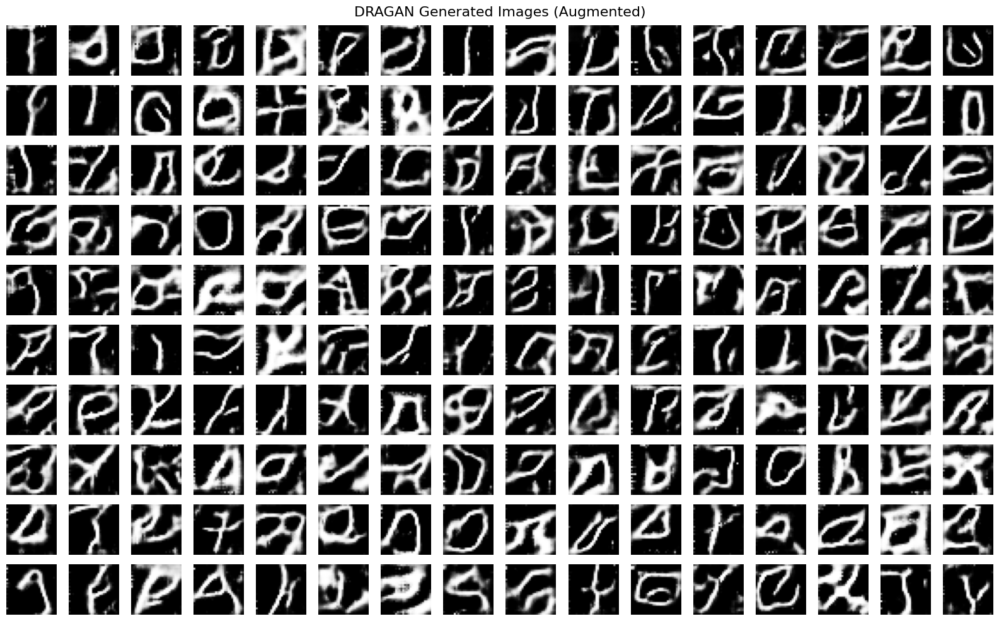

In [ ]:
def plot_generated_images(generator, latent_dim, n_rows=5, n_cols=5, save_path=None, title="DRAGAN Generated Images (Augmented)", seed=42):
    # ----- Generate Latent Vectors ----- #
    if seed is not None:
        tf.random.set_seed(seed)
    noise = tf.random.normal([n_rows * n_cols, latent_dim])
    gen_images = generator(noise, training=False)

    # ----- Rescale from [-1, 1] to [0, 1] ----- #
    gen_images = (gen_images + 1.0) / 2.0
    gen_images = tf.clip_by_value(gen_images, 0.0, 1.0)

    # ----- Shape Check ----- #
    assert gen_images.shape[-1] == 1, "Expected single-channel (grayscale) output"

    # ----- Sample Plot ----- #
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols, n_rows))
    for idx, ax in enumerate(axes.flat):
        ax.imshow(gen_images[idx, :, :, 0], cmap='gray')
        ax.axis('off')

    plt.suptitle(title, fontsize=16)
    plt.tight_layout()

    if save_path:
        plt.savefig(save_path, dpi=300)
        print(f"Saved Generated Image Grid to: {save_path}")

    plt.show()

# ========== Call Plot Function ========== #
plot_generated_images(generator, latent_dim=160, n_rows=10, n_cols=16)

With reference to the output of the Visual Grid of Samples above, we are able to make the following observations:

**Basic Structure of Letters is Somewhat Captured**

- Many characters resemble valid forms such as "P", "C", "E", and "L".

- Stroke width and curvature are generally consistent with EMNIST writing patterns.

**High Blur and Noise**

- Some characters exhibit artefacts or fuzzy outlines, especially in denser regions.

- A small number of samples show mild pixel noise in the background.

**Poor Character Consistency**

- A few letters appear warped, stretched, or fragmented.

- Structural consistency across repeated letters is not always maintained.

With the observations indicated above, we will proceed to conduct the Loss Curve Analysis in the next sub-section.

---
#### 5.6.10.2 Loss Curve Over Epochs

In this sub-section, we will be plotting the GAN Loss Curve over Epochs to evaluate the training behaviour of the GAN. This curve provides insight into whether the GAN is experiencing underfitting, overfitting, or achieving a stable training dynamic between the generator and discriminator.

Although GANs do not minimise a single unified loss in the traditional sense, the trajectory of the generator and discriminator losses can indicate whether the adversarial training process is converging appropriately.

If the generator loss remains high while discriminator loss quickly drops to near-zero, this may indicate **underfitting**, where the generator is not learning effectively to produce plausible images.

If the discriminator loss increases while generator loss sharply decreases, this may suggest **overfitting** or **mode collapse**, where the generator exploits narrow weaknesses in the discriminator without general improvement.

A relatively stable oscillation or convergence between both losses typically signifies a **well-balanced** training process, where the generator and discriminator are learning in tandem.

The Potential Observations and Corresponding Action Plans are outlined below:

**Underfitting Loss Curve**

- Increase training epochs to allow generator more time to learn.

- Simplify the discriminator to reduce overpowering the generator.

- Adjust the learning rate or apply label smoothing.

- Consider adding batch normalisation in the generator.

**Overfitting or Mode Collapse Loss Curve**

- Introduce or increase dropout in the discriminator.

- Apply input noise or label flipping to the discriminator.

- Evaluate diversity of generated samples regularly.

**Balanced/Ideal Loss Curve**

- Maintain current architecture and hyperparameters.

- Proceed with full-scale image generation.

- Evaluate both qualitative (visual inspection) and quantitative metrics (e.g. Inception Score or FID).

With these potential training behaviours and action plan outlined, we will proceed to visualise the GAN loss dynamics in the code cell below.

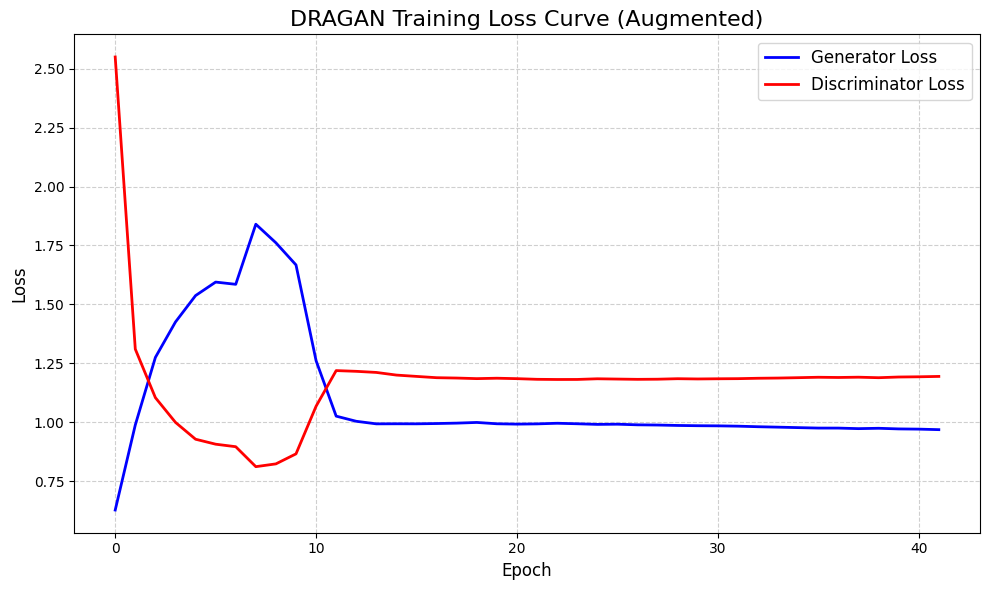

In [ ]:
# =========== Figure Size Configuration =========== #
plt.figure(figsize=(10, 6))

# =========== Plot Training Losses =========== #
plt.plot(gen_loss_history, label="Generator Loss", linewidth=2, color='blue')
plt.plot(disc_loss_history, label="Discriminator Loss", linewidth=2, color='red')

# =========== Labels and Title =========== #
plt.xlabel("Epoch", fontsize=12)
plt.ylabel("Loss", fontsize=12)
plt.title("DRAGAN Training Loss Curve (Augmented)", fontsize=16)

# =========== Grid, Legend, and Styling =========== #
plt.grid(True, linestyle='--', alpha=0.6)
plt.legend(fontsize=12)
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)

# =========== Plot Display =========== #
plt.tight_layout()
plt.show()

With reference to the output of the Loss Curve above, we are able to make the following observations:

- DRAGAN effectively stabilises despite initial adversarial spikes.

- Generator and discriminator achieve long-term balance.

- Augmented data does not harm training; it likely improves generalisation.

- One of the most stable GANs post-convergence in your experiments.

With the observations indicated above, we will proceed to conduct the Quantitative Metrics Evaluation in the next sub-section.

---
#### 5.6.10.3 Quantitative Metrics Evaluation

In this sub-section we will be utilising Quantitative Metrics such as FID and KID to tabulate the results of the performance and quantify the performance of the GAN Generator. We will subsequently be use these metrics to conduct inter-model evaluation after tuning and training all the GANs. The metrics that we will be utilising and their respective formulas are indicated below:

---
**Fréchet Inception Distance**

Purpose: Measures the Distance between the Real-Image and Generated-Image Distributions in Inception Feature Space.

$$
\mathrm{FID} \;=\;\|\mu_r - \mu_f\|^2
\;+\;\mathrm{Tr}\Bigl(\Sigma_r + \Sigma_f - 2\,(\Sigma_r\,\Sigma_f)^{\tfrac12}\Bigr)
$$


Where:
- $\mu_r = \mathbb{E}[f(x)]$, $\Sigma_r = \mathrm{Cov}[f(x)]$ for Real Images $x$.  
- $\mu_f = \mathbb{E}[f(\hat x)]$, $\Sigma_f = \mathrm{Cov}[f(\hat x)]$ for Generated Images $\hat x$.  
- $f(\cdot)$ = Map from Image to its InceptionV3 'pooling=avg' Features.  

---
**Diversity (t-SNE Spread)**

Purpose: Quantifies how 'wide' the 2D t-SNE Embedding of Generated Samples.

$$
\mathrm{Spread}
\;=\;
\bigl(\max_i\,z_i^{(1)} - \min_i\,z_i^{(1)}\bigr)
\;\times\;
\bigl(\max_i\,z_i^{(2)} - \min_i\,z_i^{(2)}\bigr)
$$

Where:
- $z_i = (z_i^{(1)}, z_i^{(2)})$ = 2-dimensional t-SNE Embedding of $i$th Generated Image.

---
**Mode Collapse Risk**

Purpose: Flags when too many Generated Images are Nearly Identical (mode collapse).

$$
\text{ModeCollapseRisk} =
\begin{cases}
\text{Low}, & \dfrac{\bigl|\{\mathrm{unique\_rounded}(x_i)\}\bigr|}{N} > \tau,\\
\text{High}, & \text{otherwise}.
\end{cases}
$$

Where:
- $x_i$ = $N$ Generated Samples.  
- $\mathrm{unique\_rounded}(x_i)$ = Rounds Pixels to Detect Duplicates.  
- $\tau=0.9$ = Uniqueness Threshold (90%).

---
**Perceptual Path Length**

Purpose: Measures Sensitively of Generator's Outputs (in VGG16 Feature Space) move when the Latent Code $z$ is Perturbed.

$$
\mathrm{PPL}
\;=\;
\mathbb{E}_{z,\delta z}\Bigl[\,
\|\phi\bigl(G(z + \epsilon\,\delta z)\bigr)\;-\;\phi\bigl(G(z)\bigr)\|_2^2
\Bigr]
$$

Where:  
- $G(z)$ = GAN Generator Mapping $z\in\mathbb{R}^{\mathrm{latent\_dim}}$ to an Image.  
- $\phi(\cdot)$ = VGG16 'pooling=avg' Feature Extractor.  
- $\delta z\sim\mathcal{N}(0,I)$, $\epsilon$ = Small Constant.

---
**Kernel Inception Distance**

Purpose: An Unbiased Estimator of the Squared Maximum Mean Discrepancy (MMD) between Real and Generated Inception Features.

$$
\mathrm{KID}
\;=\;
\frac{1}{m(m-1)}\sum_{i\neq j} k\bigl(\phi(x_i),\phi(x_j)\bigr)
\;+\;
\frac{1}{n(n-1)}\sum_{i\neq j} k\bigl(\phi(\hat x_i),\phi(\hat x_j)\bigr)
\;-\;
\frac{2}{mn}\sum_{i=1}^m\sum_{j=1}^n k\bigl(\phi(x_i),\phi(\hat x_j)\bigr)
$$

Where:  
- $x_i$ ($i=1\ldots m$) = Real Images.
- $\hat x_j$ ($j=1\ldots n$) = Generated Images.  
- $\phi(\cdot)$ = InceptionV3 Feature Extractor (pooling='avg').  
- $k(u,v) = \bigl(\frac{u^\top v}{d}+1\bigr)^3$ = degree-3 Polynomial Kernel on $d$-dimensional Features.

---

With the mathematical and metrics indicated above, we will proceed to conduct the Quantitave Metrics Evalution in the Code Cell below.

In [ ]:
# ========== Preload InceptionV3 and VGG16 Models ========== #
inception = InceptionV3(include_top=False, pooling='avg', input_shape=(299, 299, 3))
vgg_model = VGG16(include_top=False, weights='imagenet', input_shape=(128, 128, 3))

# ========== Preprocess for Inception ========== #
def preprocess_images_for_inception(images):
    images = (images + 1.0) * 127.5  # Scale from [-1, 1] to [0, 255]
    images = tf.image.resize(images, [299, 299])
    if images.shape[-1] == 1:
        images = tf.image.grayscale_to_rgb(images)
    return preprocess_input(images)

# ========== Compute FID ========== #
def calculate_fid(real_images, fake_images, batch_size=50):
    real_pp = preprocess_images_for_inception(real_images)
    fake_pp = preprocess_images_for_inception(fake_images)

    act1 = inception.predict(real_pp, batch_size=batch_size, verbose=0)
    act2 = inception.predict(fake_pp, batch_size=batch_size, verbose=0)

    mu1, sigma1 = np.mean(act1, axis=0), np.cov(act1, rowvar=False)
    mu2, sigma2 = np.mean(act2, axis=0), np.cov(act2, rowvar=False)

    diff = mu1 - mu2
    covmean = sqrtm(sigma1 @ sigma2)
    if np.iscomplexobj(covmean):
        covmean = covmean.real

    fid = diff @ diff + np.trace(sigma1 + sigma2 - 2 * covmean)
    return round(fid, 4)

# ========== Compute KID ========== #
def polynomial_kernel(X, Y):
    d = X.shape[1]
    return (np.dot(X, Y.T) / d + 1) ** 3

def calculate_kid(real_images, fake_images, batch_size=128):
    real_pp = preprocess_images_for_inception(real_images)
    fake_pp = preprocess_images_for_inception(fake_images)

    real_features = inception.predict(real_pp, batch_size=batch_size, verbose=0)
    fake_features = inception.predict(fake_pp, batch_size=batch_size, verbose=0)

    m = real_features.shape[0]
    n = fake_features.shape[0]

    k_rr = polynomial_kernel(real_features, real_features)
    k_gg = polynomial_kernel(fake_features, fake_features)
    k_rg = polynomial_kernel(real_features, fake_features)

    np.fill_diagonal(k_rr, 0)
    np.fill_diagonal(k_gg, 0)

    mmd = (k_rr.sum() / (m * (m - 1)) +
           k_gg.sum() / (n * (n - 1)) -
           2 * k_rg.mean())
    return round(mmd, 4)

# ========== Compute t-SNE Spread (Diversity) ========== #
def calculate_tsne_spread(images):
    flat = images.reshape(images.shape[0], -1)
    tsne = TSNE(n_components=2, random_state=42)
    proj = tsne.fit_transform(flat)
    x_range = proj[:, 0].max() - proj[:, 0].min()
    y_range = proj[:, 1].max() - proj[:, 1].min()
    return round(x_range * y_range, 2)

# ========== Assess Mode Collapse ========== #
def assess_mode_collapse(images):
    unique = np.unique(np.round(images), axis=0).shape[0]
    return "Low" if unique > 0.9 * images.shape[0] else "High"

# ========== Compute Perceptual Path Length (PPL) ========== #
def calculate_ppl(generator, latent_dim=160, num_samples=50, epsilon=1e-2):
    distances = []
    for _ in range(num_samples):
        z1 = tf.random.normal([1, latent_dim])
        z2 = z1 + epsilon * tf.random.normal([1, latent_dim])
        img1 = generator(z1, training=False)
        img2 = generator(z2, training=False)

        img1 = tf.image.resize(tf.image.grayscale_to_rgb((img1 + 1.0) * 127.5), (128, 128))
        img2 = tf.image.resize(tf.image.grayscale_to_rgb((img2 + 1.0) * 127.5), (128, 128))

        f1 = vgg_model(vgg_preprocess(img1))
        f2 = vgg_model(vgg_preprocess(img2))
        d = tf.reduce_mean(tf.square(f1 - f2)).numpy()
        distances.append(d)
    return round(np.mean(distances), 4)

# ========== Evaluate GAN Performance ========== #
def evaluate_gan_model(generator, latent_dim, X_val, gen_loss_history, disc_loss_history, model_name="DRAGAN"):
    # ----- Generate Fake Images ----- #
    noise = tf.random.normal([1000, latent_dim])
    fake_images = generator(noise, training=False)
    fake_images = tf.clip_by_value((fake_images + 1) / 2.0, 0.0, 1.0)
    fake_np = fake_images.numpy()

    # ----- Select and preprocess 1000 Real Images from Validation Set ----- #
    real_images = tf.convert_to_tensor(X_val[:1000], dtype=tf.float32)
    real_images = tf.clip_by_value(real_images, 0.0, 1.0)

    # ----- Compute Metrics ----- #
    fid_value = calculate_fid(real_images, fake_images)
    kid_value = calculate_kid(real_images, fake_images)
    tsne_spread_value = calculate_tsne_spread(fake_np)
    collapse_risk_value = assess_mode_collapse(fake_np)
    ppl_score_value = calculate_ppl(generator, latent_dim)
    mean_gen_loss_value = round(np.mean(gen_loss_history), 4)
    std_gen_loss_value = round(np.std(gen_loss_history), 4)
    mean_disc_loss_value = round(np.mean(disc_loss_history), 4)
    std_disc_loss_value = round(np.std(disc_loss_history), 4)

    # ----- Store as Global Vars (Optional) ----- #
    prefix = model_name.upper()
    globals()[f"{prefix}_FID"] = fid_value
    globals()[f"{prefix}_KID"] = kid_value
    globals()[f"{prefix}_TSNE"] = tsne_spread_value
    globals()[f"{prefix}_MODE_COLLAPSE"] = collapse_risk_value
    globals()[f"{prefix}_PPL"] = ppl_score_value
    globals()[f"{prefix}_GEN_LOSS_MEAN"] = mean_gen_loss_value
    globals()[f"{prefix}_GEN_LOSS_STD"] = std_gen_loss_value
    globals()[f"{prefix}_DISC_LOSS_MEAN"] = mean_disc_loss_value
    globals()[f"{prefix}_DISC_LOSS_STD"] = std_disc_loss_value

    # ----- Final Summary Row ----- #
    row = {
        "Model": model_name,
        "FID Score": fid_value,
        "KID Score": kid_value,
        "Mean Generator Loss": mean_gen_loss_value,
        "Std Generator Loss": std_gen_loss_value,
        "Mean Discriminator Loss": mean_disc_loss_value,
        "Std Discriminator Loss": std_disc_loss_value,
        "Mode Collapse Risk": collapse_risk_value,
        "Visual Quality": "Very Poor",
        "Diversity (t-SNE Spread)": tsne_spread_value,
        "PPL": ppl_score_value
    }

    return pd.DataFrame([row])[[
        "Model", "FID Score", "KID Score",
        "Mean Generator Loss", "Std Generator Loss",
        "Mean Discriminator Loss", "Std Discriminator Loss",
        "Mode Collapse Risk", "Visual Quality",
        "Diversity (t-SNE Spread)", "PPL"
    ]]

# ========== Create DataFrame ========== #
df = evaluate_gan_model(generator, latent_dim, X_val, gen_loss_history, disc_loss_history, model_name="DRAGAN (Augmented)")

# ========== Display DataFrame ========== #
df.style.background_gradient(cmap="Blues")

,Model,FID Score,KID Score,Mean Generator Loss,Std Generator Loss,Mean Discriminator Loss,Std Discriminator Loss,Mode Collapse Risk,Visual Quality,Diversity (t-SNE Spread),PPL
0,DRAGAN (Augmented),158.615500,0.150900,1.099400,0.256900,1.170300,0.245200,Low,Very Poor,5430.259766,0.239400


With reference to the output of the Quantitative Metrics above, we are able to determine the performance of the GAN. This will be used as a basis of comparison to the other GAN Models.

---
#### 5.6.10.4 t-SNE of Generated Samples

In this sub-section, we visualise the t-SNE projection of generated samples to evaluate the latent diversity learned by the unconditional GAN. Although our GAN is not class-conditioned, t-SNE remains a valuable tool to assess whether the generator is producing varied outputs that reflect meaningful use of the latent space. While GANs are trained in high-dimensional spaces, t-SNE enables us to observe 2D structural patterns such as sample clustering, separation, and density, which provide indirect insights into the diversity and generalisation capabilities of the generator. The visualisation will be conducted in the Code Cell below.

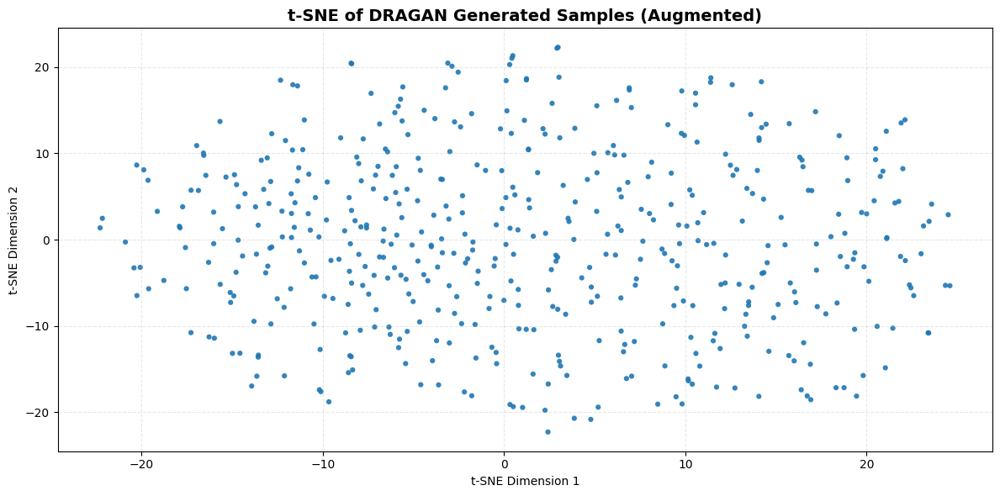

In [ ]:
# ========== Generate New Images from Random Noise ========== #
latent_dim = 160
noise = tf.random.normal([500, latent_dim])
generated_images = generator(noise, training=False)
generated_images = (generated_images + 1) / 2.0

def plot_tsne_embeddings(generated_images, save_path=None, title="t-SNE of DRAGAN Generated Samples (Augmented)"):
    # ----- Convert to [0, 1] Range ----- #
    if tf.reduce_max(generated_images).numpy() > 1.0:
        raise ValueError("Images should be in [-1, 1] range before scaling.")

    images_rescaled = (generated_images + 1.0) / 2.0
    flat_images = images_rescaled.numpy().reshape(images_rescaled.shape[0], -1)

    # ----- Run t-SNE ----- #
    tsne = TSNE(n_components=2, perplexity=30, learning_rate='auto', init='pca', random_state=42)
    tsne_proj = tsne.fit_transform(flat_images)

    # ----- Plot t-SNE ----- #
    plt.figure(figsize=(12, 6))
    sns.scatterplot(
        x=tsne_proj[:, 0],
        y=tsne_proj[:, 1],
        s=20,
        alpha=0.9,
        edgecolor='none'
    )
    plt.title(title, fontsize=14, weight='bold')
    plt.xlabel("t-SNE Dimension 1")
    plt.ylabel("t-SNE Dimension 2")
    plt.grid(True, linestyle='--', alpha=0.3)
    plt.tight_layout()

    if save_path:
        plt.savefig(save_path, dpi=300)
        print(f"t-SNE plot saved to: {save_path}")

    plt.show()

plot_tsne_embeddings(generated_images=generated_images)

With reference to the t-SNE plot of DRAGAN Generated Samples (Augmented) above, we are able to make the following observations:

**Strong Structural Preservation Despite Augmentation**

- The distribution retains a globally scattered pattern, with relatively even spacing between samples.

- The visual structure closely resembles that of the non-augmented variant, suggesting DRAGAN is robust to augmentation perturbations.

**Moderate Spread with Mild Boundary Clustering**

- Samples appear well-distributed across the latent space, but there is slightly denser clustering near the edges — potentially caused by augmentation-induced variance.

- Still, no major voids or overcrowded centres are observed, indicating healthy sample diversity.

**No Indication of Mode Collapse**

- DRAGAN continues to demonstrate strong resistance to mode collapse, evidenced by the absence of dense blobs or collapsed regions.

- This aligns with DRAGAN's gradient regularisation strategy, which stabilises learning around the data manifold, even under data augmentation.

**Stable yet Adaptive Latent Coverage**

- The plot reflects DRAGAN's ability to adapt to augmented data without sacrificing latent space coverage.

- This adaptability makes it suitable for datasets with limited or synthetic variety, such as EMNIST under class balancing schemes.

With the observations indicated above, we will now proceed to train the next GAN Model using the Augmented Data in the next sub-section.

---
## 5.7 Information Maximising GAN Model Training

In this sub-section, we will be training a Information Maximising GAN (InfoGAN) for the EMNIST Dataset. The InfoGAN is capable of giving us control and interpretability over the Image Generation process. InfoGAN is also able to learn sematically meaningful factors without the need of labels unlike Conditional GANs. The relevant mathematical formulas are indicated below:

---
**Generator Loss:**

Purpose: Produce Outputs Classified as Real.

$$
\mathcal{L}_G = \frac{1}{2} \mathbb{E}_{z \sim p_z}[(D(G(z)) - c)^2]
$$

Where:
- $c = 1$ = Desired Discriminator Output for Generated Images  
- $D(G(z))$ = Discriminator's Output for Generated Data  
- $z \sim p_z$ = Sample from Latent Space

---
**Discriminator Loss:**

Purpose: Discriminator Minimises the Error between Predictions and True Labels.

$$
\mathcal{L}_D = \frac{1}{2} \mathbb{E}_{x \sim p_{\text{data}}}[(D(x) - b)^2] + \frac{1}{2} \mathbb{E}_{z \sim p_z}[(D(G(z)) - a)^2]
$$

Where:  
- $D(x)$ = Discriminator's Output for Real Data  
- $D(G(z))$ = Discriminator's Output for Generated Data  
- $a = 0$ = Label for Fake Data  
- $b = 1$ = Label for Real Data  
- $x \sim p_{\text{data}}$ = Sample from Real Data Distribution  
- $z \sim p_z$ = Sample from Latent Noise Distribution  

---
**Latent Code Regularisation**

Purpose: Encourage Generator to Learn Disentangled, Interpretable Latent Factors by Maximising Mutual Information between Latent Code and Generated Output.

$$
\mathcal{L}_{\text{Info}} = -\lambda \cdot \mathbb{E}_{z \sim p(z), c \sim p(c)} \left[ \log Q(c \mid G(z, c)) \right]
$$

Where:
- $Q(c \mid x)$ = Auxiliary Network Approximates Posterior $P(c \mid x)$
- $G(z, c)$ = Generated Sample
- $\lambda$ = Mutual Information Weight Hyperparameter

---
**Total Objective:**

Purpose: LSGAN Seeks to Solve the Objective.

$$
\min_{G, Q} \max_D \; \mathcal{L}_{\text{InfoGAN}} = \mathcal{L}_{\text{GAN}} + \mathcal{L}_{\text{Info}}
$$

Where:
- $G$ = Generator
- $Q$ = Auxiliary Network
- $D$ = Discriminator

---
**Variational Lower Bound on Mutual Information**

Purpose: True Mutual Information $I(c; G(z, c))$ is Intractable, Maximise a Variational Lower Bound using $Q(c \mid x)$.

$$
I(c; G(z, c)) \geq \mathbb{E}_{z \sim p(z), c \sim p(c)} \left[ \log Q(c \mid G(z, c)) \right] + H(c)
$$
Where:
- $I(c; G(z, c))$ = Mutual Information
- $H(c)$ = Entropy of $c$ (constant if $p(c)$ is fixed)

---
With the relevant mathematical formulas indicated above, we will proceed to train the InfoGAN in this sub-section for the purpose of it's potential for smoother training process and also to serve as a comparison for our other GAN Models.

---
### 5.7.1 Defining Data Pre-Processing Function

In this sub-section, we will be defining the Data Pre-Processing Function which will allow for consistent Data Pipeline to be built and modifed accordingly should the need arise such as when we need to add Spectral Normalisation. This will ensure that the Data's integrity is not affected and we are able to make fair and un-biased assumptions. The Data Pre-Processing Function is defined in the Code Cell below:

In [ ]:
# ========== Data Pre-Processing Function ========== #
def load_data(X_train, batch_size=64):
    # ----- Trim X_train Down to Multiple of Batch_size ----- #
    n_full = (X_train.shape[0] // batch_size) * batch_size
    X_trimmed = X_train[:n_full]

    # ----- Compute Steps For Each Epoch ----- #
    steps_per_epoch = n_full // batch_size

    # ----- Build the ImageDataGenerator Iterator ----- #
    datagen_iter = datagen.flow(X_trimmed, batch_size=batch_size, shuffle=True)

    # ----- Wrap as a tf.data.Dataset with a Fixed-shape Signature ----- #
    dataset = tf.data.Dataset.from_generator(
        lambda: (next(datagen_iter) for _ in range(steps_per_epoch)),
        output_signature=tf.TensorSpec((batch_size, 28, 28, 1), tf.float32)
    )

    return dataset.prefetch(tf.data.AUTOTUNE)

With reference to the Code Cell above, we are able to determine that the Data Pre-Processing Function have been defined successfully and we are able to move on to Defining Callback Functions in the next sub-section.

---
### 5.7.2 Defining Callback Functions

In this sub-section, we will be pre-defining the various Callbacks. This is to ensure consistency throughout the model and also to increase the GAN Accuracy and optimise the Computation Cost for training each GAN Model. These Callbacks will be main used during the GAN Training in the next sub-section. The revelant mathematical formula for the callbacks and logic are indicated below:

---
**Learning Rate Scheduler:**

Purpose: Reduces Learning Rate During Training to Fine-tune Model Convergence.

$$\text{If } epoch \mod 10 = 0 \Rightarrow \eta_{new} = \frac{1}{2} \cdot \eta$$

Where:

- $\eta$ = current learning rate

- $\eta_{\text{new}}$ = updated learning rate

- $epoch \bmod 10$ checks if the epoch is a multiple of 10

---
**ReduceLROnPlateau:**

Purpose: Automatically Reduces the Learning Rate when Validation Performance Plateaus.

$$
\text{If no improvement in } val\_loss \text{ for 10 epochs: } \eta_{\text{new}} = 0.5 \cdot \eta
$$

Where:

- $\eta_{\text{new}}$ = reduced learning rate

---
**EarlyStopping:**

Purpose: Prevents Wastage of Computational Power if Model Does Not Improve.

$$
\text{If } val\_loss \text{ does not improve for 25 epochs, stop training and restore best weights}
$$

---

We will proceed to Define the Callbacks in the Code Cell below in preparation for the GAN Model Training.

In [ ]:
# =========== Define Learning Rate Scheduler =========== #
lr_scheduler = LearningRateScheduler(
    lambda epoch, lr: lr * 0.95 if epoch % 10 == 0 else lr,
    verbose=1
)

# =========== Define Reduce LR on Plateau =========== #
reduce_lr = ReduceLROnPlateau(
    monitor='loss',
    factor=0.5,
    patience=10,
    verbose=1,
    min_lr=1e-6
)

# =========== Define Early Stopping =========== #
early_stop = EarlyStopping(
    monitor='loss',
    patience=25,
    verbose=1,
    restore_best_weights=False
)

# =========== Define Display Generated Images =========== #
def display_generated_images(generator, latent_dim, code_dim=2, n=7):
    total = n * n
    z = tf.random.normal([total, latent_dim])
    c = tf.random.uniform([total, code_dim], minval=-1.0, maxval=1.0)

    # ----- Normalise Both z and c ----- #
    z = tf.math.l2_normalize(z, axis=1)
    c = tf.math.l2_normalize(c, axis=1)

    zc = tf.concat([z, c], axis=1)
    generated_images = generator(zc, training=False)
    generated_images = (generated_images + 1.0) / 2.0

    fig, axes = plt.subplots(n, n, figsize=(n, n))
    for i in range(n):
        for j in range(n):
            img = generated_images[i * n + j, :, :, 0]
            axes[i, j].imshow(img, cmap='gray')
            axes[i, j].axis('off')

    plt.tight_layout()
    plt.show()

# =========== Define FID Calculator =========== #
def calculate_fid(real_images, fake_images, batch_size=10):

    # 1) Scale to [0,255] and resize to 299×299
    real = (real_images + 1.0) * 127.5
    fake = (fake_images + 1.0) * 127.5
    real = tf.image.resize(real, (299,299))
    fake = tf.image.resize(fake, (299,299))

    # ----- If Grayscale, Convert to RGB ----- #
    if real.shape[-1] == 1:
        real = tf.image.grayscale_to_rgb(real)
        fake = tf.image.grayscale_to_rgb(fake)

    # ----- Preprocess for Inception (–1 to +1) ----- #
    real_pp = preprocess_input(real)
    fake_pp = preprocess_input(fake)

    # ----- Extract Features in Batches ----- #
    def _get_acts(x):
        acts = []
        n = x.shape[0]
        for i in range(0, n, batch_size):
            chunk = x[i:i+batch_size]
            acts.append(_inception_model(chunk, training=False).numpy())
        return np.vstack(acts)

    act_real = _get_acts(real_pp)
    act_fake = _get_acts(fake_pp)

    # ----- Compute Statistics ----- #
    mu1, sigma1 = act_real.mean(axis=0), np.cov(act_real, rowvar=False)
    mu2, sigma2 = act_fake.mean(axis=0), np.cov(act_fake, rowvar=False)
    diff    = mu1 - mu2
    covmean = sqrtm(sigma1.dot(sigma2))
    if np.iscomplexobj(covmean):
        covmean = covmean.real
    fid = diff.dot(diff) + np.trace(sigma1 + sigma2 - 2*covmean)
    return float(np.round(fid,4))

# =========== Confirmation Message =========== #
print("InfoGAN Callbacks and Visualisation Setup Complete")

InfoGAN Callbacks and Visualisation Setup Complete


With reference to the Code Cell above, we are able to verify that that the Callbacks have been successfully defined and the various parameters are set so as to ensure a High Accuracy and Computing Efficient GAN Model Training.

---
### 5.7.3 Defining InfoGAN Generator Architecture

In this section, we will be defining the InfoGAN's Generator Architecture. The Generator will be trying to make realistic generated images in the attempt to bypass the Discriminator. Subsequently, the generated images from the Generator will be evaluated based on a few evaluation metrics such as Inception Score. The relevent mathematical formulas for the Loss Function of the Vanilla GAN Generator is indicated below:

---
**Generator Loss:**

Purpose: Produce Outputs Classified as Real.

$$
\mathcal{L}_G = \frac{1}{2} \mathbb{E}_{z \sim p_z}[(D(G(z)) - c)^2]
$$

Where:
- $c = 1$ = Desired Discriminator Output for Generated Images  
- $D(G(z))$ = Discriminator's Output for Generated Data  
- $z \sim p_z$ = Sample from Latent Space

---
With the relevant Generator Loss Formula indicated above, we will proceed to define the GAN Generator's Architecture in the Code Cell below and the Lost Function.

In [ ]:
# =========== Generator Function =========== #
def build_generator(latent_dim=100, code_dim=2, use_dropout=True):
    input_dim = latent_dim + code_dim
    model = tf.keras.Sequential(name="generator")

    # ----- Project and Reshape ----- #
    model.add(tf.keras.layers.Dense(7 * 7 * 256, use_bias=False, input_shape=(input_dim,)))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.ReLU())
    model.add(tf.keras.layers.Reshape((7, 7, 256)))

    # ----- Upsample 1 ----- #
    model.add(tf.keras.layers.Conv2DTranspose(128, kernel_size=5, strides=1, padding='same', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.ReLU())
    if use_dropout:
        model.add(tf.keras.layers.Dropout(0.3))

    # ----- Upsample 2 ----- #
    model.add(tf.keras.layers.Conv2DTranspose(64, kernel_size=5, strides=2, padding='same', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.ReLU())
    if use_dropout:
        model.add(tf.keras.layers.Dropout(0.3))

    # ----- Final Output to 28x28x1 ----- #
    model.add(tf.keras.layers.Conv2DTranspose(1, kernel_size=5, strides=2, padding='same', activation='tanh'))

    return model

# =========== Generator Loss =========== #
bce = tf.keras.losses.BinaryCrossentropy(from_logits=True)

def generator_loss(fake_output):
    return bce(tf.ones_like(fake_output), fake_output)

With reference to the Code Cell above, we are able to verify that the GAN's Generator Architecture have been successfully defined and we are able to proceed to define the GAN's Discriminator Architecture.

---
### 5.7.4 Defining InfoGAN Discriminator Architecture

In this section, we will be defining the Architecture of the Discriminator of the GAN. The Discriminator will be the Neural Network that will attempt to tell the Generated Images apart from the Actual Images. This will allow the GAN to improve overtime and also improve itself overtime. The mathematical function for the Discriminator Loss Function is indicated below:

---
**Discriminator Loss:**

Purpose: Discriminator Minimises the Error between Predictions and True Labels.

$$
\mathcal{L}_D = \frac{1}{2} \mathbb{E}_{x \sim p_{\text{data}}}[(D(x) - b)^2] + \frac{1}{2} \mathbb{E}_{z \sim p_z}[(D(G(z)) - a)^2]
$$

Where:  
- $D(x)$ = Discriminator's Output for Real Data  
- $D(G(z))$ = Discriminator's Output for Generated Data  
- $a = 0$ = Label for Fake Data  
- $b = 1$ = Label for Real Data  
- $x \sim p_{\text{data}}$ = Sample from Real Data Distribution  
- $z \sim p_z$ = Sample from Latent Noise Distribution  
---

With the mathematical formula for the Loss Function indicated above, we will proceed to define the GAN's Discriminator Architecture and the Loss Function in the Code Cell below.

In [ ]:
# =========== Discriminator Function =========== #
def build_discriminator(input_shape=(28, 28, 1), code_dim=2):
    image_input = tf.keras.Input(shape=input_shape)

    # ----- Shared Convolutional Layers ----- #
    x = tf.keras.layers.Conv2D(64, kernel_size=5, strides=2, padding='same')(image_input)
    x = tf.keras.layers.LeakyReLU(0.2)(x)
    x = tf.keras.layers.Dropout(0.3)(x)

    x = tf.keras.layers.Conv2D(128, kernel_size=5, strides=2, padding='same')(x)
    x = tf.keras.layers.LeakyReLU(0.2)(x)
    x = tf.keras.layers.Dropout(0.3)(x)

    x = tf.keras.layers.Flatten()(x)

    # ----- Output 1: Real/Fake (Adversarial) ----- #
    real_fake_output = tf.keras.layers.Dense(1, name="real_fake")(x)

    # ----- Output 2: Q-network for Predicting Latent Code ----- #
    code_output = tf.keras.layers.Dense(code_dim, name="code")(x)

    return tf.keras.Model(inputs=image_input, outputs=[real_fake_output, code_output], name="discriminator_with_Q")

# =========== Discriminator Loss =========== #
bce = tf.keras.losses.BinaryCrossentropy(from_logits=True)

def discriminator_loss(real_output, fake_output):
    real_labels = tf.ones_like(real_output)
    fake_labels = tf.zeros_like(fake_output)

    real_loss = bce(real_labels, real_output)
    fake_loss = bce(fake_labels, fake_output)

    return real_loss + fake_loss

With reference to the Code Cell above, we are able to verify that the GAN's Discriminator Architecture have been successfully defined and we are able to proceed to define the GAN's Training Steps.

---
### 5.7.5 Defining Training Step

In this section, we will be Defining the Training Step function so as to train both the Generator and the Discriminator at the same time. The Training Step will compute the gradients for both the Generator and the Discriminator at the same time. The relevant mathematical formulas for the Training Step is indicated below:

---
**Generator Loss:**

Purpose: Produce Outputs Classified as Real.

$$
\mathcal{L}_G = \frac{1}{2} \mathbb{E}_{z \sim p_z}[(D(G(z)) - c)^2]
$$

Where:
- $c = 1$ = Desired Discriminator Output for Generated Images  
- $D(G(z))$ = Discriminator's Output for Generated Data  
- $z \sim p_z$ = Sample from Latent Space

---
**Discriminator Loss:**

Purpose: Discriminator Minimises the Error between Predictions and True Labels.

$$
\mathcal{L}_D = \frac{1}{2} \mathbb{E}_{x \sim p_{\text{data}}}[(D(x) - b)^2] + \frac{1}{2} \mathbb{E}_{z \sim p_z}[(D(G(z)) - a)^2]
$$

Where:  
- $D(x)$ = Discriminator's Output for Real Data  
- $D(G(z))$ = Discriminator's Output for Generated Data  
- $a = 0$ = Label for Fake Data  
- $b = 1$ = Label for Real Data  
- $x \sim p_{\text{data}}$ = Sample from Real Data Distribution  
- $z \sim p_z$ = Sample from Latent Noise Distribution  

---
**Total Objective:**

Purpose: LSGAN Seeks to Solve the Objective.

$$
\min_G \max_D \; \mathcal{L}_D \quad \text{and} \quad \min_G \; \mathcal{L}_G
$$

---

With the relevant mathematical formulas indicated above, we will proceed to define the Training Step in the Code Cell below.

In [ ]:
# =========== Training Step Function =========== #
@tf.function
def train_step(real_images, generator, discriminator, gen_optimizer, disc_optimizer, latent_dim, code_dim=2, lambda_mi=1.0):
    batch_size = tf.shape(real_images)[0]

    # ----- Sample & Normalisation ----- #
    z = tf.random.normal([batch_size, latent_dim])
    c = tf.random.uniform([batch_size, code_dim], -1.0, 1.0)
    z = tf.math.l2_normalize(z, axis=1)
    c = tf.math.l2_normalize(c, axis=1)
    zc = tf.concat([z, c], axis=1)

    # ----- Instance Noise on Real Images ----- #
    real_noisy = real_images + tf.random.normal(tf.shape(real_images)) * 0.05

    with tf.GradientTape(persistent=True) as tape:
        # ----- Generate Fake Images ----- #
        fake_images = generator(zc, training=True)

        # ----- Discriminator and Q-network ----- #
        real_logits, _ = discriminator(real_noisy,  training=True)
        fake_logits, predicted_c = discriminator(fake_images, training=True)

        # ----- Adversarial Losses with Label Smoothing ----- #
        real_labels = tf.ones_like(real_logits) * 0.9
        fake_labels = tf.zeros_like(fake_logits)
        d_real_loss = bce(real_labels, real_logits)
        d_fake_loss = bce(fake_labels,  fake_logits)
        disc_loss   = d_real_loss + d_fake_loss

        # ----- Generator Adversarial Loss ----- #
        adv_loss = bce(tf.ones_like(fake_logits), fake_logits)

        # ----- Mutual-Information Loss (MSE) ----- #
        mi_loss  = tf.reduce_mean(tf.square(predicted_c - c))

        # ----- Total Generator and Q Loss ----- #
        gen_loss = adv_loss + lambda_mi * mi_loss

    # ----- Update Discriminator ----- #
    code_vars  = [v for v in discriminator.trainable_variables if 'code/' in v.name]
    adv_vars   = [v for v in discriminator.trainable_variables if v not in code_vars]
    disc_grads = tape.gradient(disc_loss, adv_vars)
    disc_optimizer.apply_gradients(zip(disc_grads, adv_vars))

    # ----- Update Generator and Q-network ----- #
    gq_vars  = generator.trainable_variables + code_vars
    gq_grads = tape.gradient(gen_loss, gq_vars)
    gen_optimizer.apply_gradients(zip(gq_grads, gq_vars))

    del tape
    return gen_loss, disc_loss, adv_loss, mi_loss

With reference to the Code Cell above, we are able to determine that the Training Step have been successfully defined and we are able to proceed to prepare the Training Loop in the next section.

---
### 5.7.6 Defining Training Loop

In this section, we will be defining the Training Loop for the GAN Training. The Training Loop will go through each of the Epoch and train both the Generator and Discriminator simultaneously. The Training Loop will also track the Loss for both the Generator and the Discriminator for each of the Epoch trained. The relevant mathematical formulas are indicated below:

---
**Epoch Loss Averaging:**

Purpose: These are the Average Generator and Discriminator Losses over all Batches in Epoch $t$.

$$
\bar{L}_G^{(t)} = \frac{1}{N} \sum_{i=1}^{N} L_G^{(i)} \\
\bar{L}_D^{(t)} = \frac{1}{N} \sum_{i=1}^{N} L_D^{(i)}
$$

Where:
- $\bar{L}_G^{(t)}$ = Average Generator Loss at Epoch $t$  
- $\bar{L}_D^{(t)}$ = Average Discriminator Loss at Epoch $t$  
- $N$ = Number of Batches in the Dataset  
- $L_G^{(i)}$ = Generator Loss on Batch $i$  
- $L_D^{(i)}$ = Discriminator Loss on Batch $i$

---
**Epoch Iteration:**

Purpose: Describes the Training Loop Logic: for Each Epoch $t$, perform `train_step` for Every Mini-batch.

$$
\text{for } t = 1 \text{ to } T:
\quad \text{for each batch } (x^{(i)}):
\quad \text{train_step}(x^{(i)})
$$

Where:
- $T$: Total Number of Epochs  
- $x^{(i)}$: Real Batch $i$ from the Dataset  
- `train_step`: Function that Updates $G$ and $D$ using that Batch

---
**Generated Image Output:**

Purpose: Sample Random Noise $z$ and Generate Synthetic Image $\hat{x}$ from the Generator. This is used for Visual Monitoring of Model Quality.

$$
z \sim p_z(z) \\
\hat{x} = G(z)
$$

Where:
- $z$: Random Latent Vector  
- $G(z)$: Generated Image from Generator

---
With the mathematical formulas indicated above, we will proceed to define the Training Loop in the Code Cell below in preparation of the GAN Training.

In [ ]:
# =========== Training Loop Function =========== #
def train(dataset, epochs, generator, discriminator, gen_optimizer, disc_optimizer, latent_dim, code_dim=2, lambda_mi=1.0, save_path=None, use_early_stopping=True, steps_per_epoch=None):
    # ----- Prepare FID Reference Set from Validation Data X_val ----- #
    real_val = tf.data.Dataset.from_tensor_slices(X_val).batch(50).take(1)

    # ----- Latent Noise and Code for InfoGAN FID Evaluation ----- #
    noise_val = tf.random.normal([50, latent_dim])
    noise_val = tf.math.l2_normalize(noise_val, axis=1)
    code_val = tf.random.uniform([50, code_dim], minval=-1.0, maxval=1.0)
    code_val = tf.math.l2_normalize(code_val, axis=1)
    zc_val = tf.concat([noise_val, code_val], axis=1)

    # ----- FID Early-Stopping Parameters for InfoGAN ----- #
    best_fid = float('inf')
    no_improve = 0
    patience = 10
    fid_interval = 1

    # ----- Dummy Model ----- #
    dummy_input  = tf.keras.Input(shape=(1,))
    dummy_output = tf.keras.layers.Lambda(lambda x: x)(dummy_input)
    dummy_model  = tf.keras.Model(dummy_input, dummy_output)
    dummy_model.compile(optimizer=tf.keras.optimizers.Adam(1e-4), loss='mse')

    early_stop.set_model(dummy_model)
    reduce_lr.set_model(dummy_model)
    lr_scheduler.set_model(dummy_model)
    early_stop.on_train_begin({})
    reduce_lr.on_train_begin({})
    lr_scheduler.on_train_begin({})

    # ----- Track Loss History ----- #
    gen_loss_history  = []
    disc_loss_history = []
    mi_loss_history   = []

    for epoch in range(1, epochs + 1):
        print(f"\nEpoch {epoch}/{epochs}")
        gen_losses, disc_losses, mi_losses = [], [], []

        # ----- Per-Batch Training ----- #
        for i, real_images in enumerate(dataset):
            if steps_per_epoch and i >= steps_per_epoch:
                break

            # ----- InfoGAN Train Step ----- #
            gen_loss, disc_loss, adv_loss, mi_loss = train_step(
                real_images,
                generator,
                discriminator,
                gen_optimizer,
                disc_optimizer,
                latent_dim,
                code_dim=code_dim,
                lambda_mi=lambda_mi
            )

            gen_losses.append(gen_loss)
            disc_losses.append(disc_loss)
            mi_losses.append(mi_loss)

        # ----- Compute Average Losses Epoch ----- #
        avg_gen_loss  = tf.reduce_mean(gen_losses)
        avg_disc_loss = tf.reduce_mean(disc_losses)
        avg_mi_loss   = tf.reduce_mean(mi_losses)
        print(f"Gen Loss: {avg_gen_loss:.4f} | "
              f"Disc Loss: {avg_disc_loss:.4f} | "
              f"MI Loss: {avg_mi_loss:.4f}")

        # ----- Save to History ----- #
        gen_loss_history.append(float(avg_gen_loss))
        disc_loss_history.append(float(avg_disc_loss))
        mi_loss_history.append(float(avg_mi_loss))

        # ----- Callback Updates ----- #
        logs = {'loss': float(avg_gen_loss)}
        if use_early_stopping:
            early_stop.on_epoch_end(epoch=epoch, logs=logs)
            if early_stop.stopped_epoch > 0:
                print(f"Early stopping triggered at epoch {epoch}")
                break
        reduce_lr.on_epoch_end(epoch=epoch, logs=logs)
        lr_scheduler.on_epoch_end(epoch=epoch, logs=logs)

        # ----- FID Evaluation & Early Stopping ----- #
        if epoch % fid_interval == 0:
            fake_val = generator(zc_val, training=False)
            real_batch = next(iter(real_val))
            real_for_fid = tf.image.resize(real_batch, [299, 299]) * 0.5 + 0.5
            fake_for_fid = tf.image.resize(fake_val,    [299, 299]) * 0.5 + 0.5
            fid_value = calculate_fid(real_for_fid, fake_for_fid)

            print(f"Epoch {epoch} → Val FID: {fid_value:.2f}")

            # ----- Early-stop Logic on FID ----- #
            if fid_value < best_fid:
                best_fid   = fid_value
                no_improve = 0
                if save_path:
                    os.makedirs(save_path, exist_ok=True)
                    generator.save_weights(os.path.join(save_path, "best_gen.weights.h5"))
                    discriminator.save_weights(os.path.join(save_path, "best_disc.weights.h5"))
            else:
                no_improve += 1

            if no_improve >= patience:
                print(f"No FID improvement for {patience} epochs, stopping.")
                break

        # ----- Display Images Every 5 Epochs ----- #
        if epoch % 5 == 0:
            display_generated_images(generator, latent_dim)

    # ----- Restore Best Weights After Training ----- #
    if save_path:
        best_gen_path = os.path.join(save_path, "best_gen.weights.h5")
        best_disc_path = os.path.join(save_path, "best_disc.weights.h5")
        if os.path.exists(best_gen_path) and os.path.exists(best_disc_path):
            generator.load_weights(best_gen_path)
            discriminator.load_weights(best_disc_path)
            print("Restored best generator and discriminator weights based on lowest FID.")
        else:
            print("Best weight files not found. Skipping restore.")

    return avg_gen_loss, gen_loss_history, disc_loss_history, mi_loss_history

With reference to the Code Cell above, we are able to determine that the Training Loop have been successfully defined and we are able to proceed to define the Optimisers with Tunable Parameter in preparation for the Optuna Tuning.

---
### 5.7.7 Defining Optimisers with Tunable Parameters

In this section, we will be defining the Common Optimisers that will be Tuned using the Optuna Tuning. The Optimisers will each have a range of values in a list so as to allow for the Optuna to search for the best Hyperparameter for the GAN. Through these parameters, it will affect how effective and efficiently the GAN will learn from the provided EMNIST Data. The relevent mathematical formula is indicated below:

---
**Optimiser Update Rule**

Purpose: Parameter Update Step in the Adam Optimiser, using Adaptive Learning Rates with Momentum.

$$
\theta \leftarrow \theta - \eta \cdot \frac{m_t}{\sqrt{v_t} + \epsilon}
$$

Where:
- $\theta$ = Model Parameters (Generator or Discriminator)
- $\eta$ = Learning Rate (Tuned)
- $m_t$ = First Moment Estimate (Mean of Gradients)
- $v_t$ = Second Moment Estimate (Variance of Gradients)
- $\epsilon$ = Small Constant for Numerical Stability

---
With the mathematical formula indicated above, we will proceed to define the Optimisers in the Code Cell.

In [ ]:
def objective(trial):
    # ----- Hyperparameters ----- #
    latent_dim = trial.suggest_categorical('latent_dim', [100, 128, 160])
    learning_rate = trial.suggest_float('learning_rate', 5e-5, 2e-4, log=True)
    beta_1 = trial.suggest_float('beta_1', 0.4, 0.6)
    code_dim = 2
    lambda_mi = 1.0

    # ----- Build Models ----- #
    generator = build_generator(latent_dim=latent_dim, code_dim=code_dim)
    discriminator = build_discriminator(code_dim=code_dim)

    # ----- Trigger Weight Creation ----- #
    z = tf.random.uniform([1, latent_dim], -1.0, 1.0)
    c = tf.random.uniform([1, code_dim], -1.0, 1.0)
    zc = tf.concat([z, c], axis=1)
    _ = generator(zc)
    _ = discriminator(tf.random.normal([1, 28, 28, 1]))

    # ----- Define Optimizers ----- #
    gen_optimizer = tf.keras.optimizers.Adam(learning_rate=learning_rate, beta_1=beta_1)
    disc_optimizer = tf.keras.optimizers.Adam(learning_rate=learning_rate, beta_1=beta_1)

    # ----- Prebuild Optimizers ----- #
    _ = gen_optimizer.apply_gradients([(tf.zeros_like(v), v) for v in generator.trainable_variables])
    _ = disc_optimizer.apply_gradients([(tf.zeros_like(v), v) for v in discriminator.trainable_variables])

    # ----- Load Data ----- #
    dataset = load_data(X_train, batch_size=64)
    steps = min(1000, len(X_train) // 64)

    # ----- Train InfoGAN ----- #
    _ = train(
        dataset=dataset,
        epochs=100,
        generator=generator,
        discriminator=discriminator,
        gen_optimizer=gen_optimizer,
        disc_optimizer=disc_optimizer,
        latent_dim=latent_dim,
        code_dim=code_dim,
        lambda_mi=lambda_mi,
        steps_per_epoch=steps,
        use_early_stopping=False,
        save_path=None
    )

    # ----- Evaluate FID Score ----- #
    noise = tf.random.uniform([1000, latent_dim], minval=-1.0, maxval=1.0)
    code = tf.random.uniform([1000, code_dim], minval=-1.0, maxval=1.0)
    latent = tf.concat([noise, code], axis=1)
    fake_images = generator(latent, training=False)
    fake_images = (fake_images + 1.0) / 2.0
    real_images = X_val[:1000]
    fid_score = calculate_fid(real_images, fake_images)

    return fid_score

With reference to the Code Cell above, we are able to determine that the Optimiser have been successfully defined with a range of different Parameter Values so as to provide a robust Optuna Tuning in the subsequent sections.

---
### 5.7.8 Optuna Tuning Study

In this sub-section, we will be conducting the Optuna Tuning Study on the GAN Model so as to obtain the best Hyperparameter for the GAN Model. It is expected that the Tuning takes a prolonged duration due to the nature of how the GAN works and the 2 Neural Networks involved. However, the training data will be stored so as to prevent re-running of repetitive codes. The Optuna Tuning Study will be conducted in the Code Cell below.

In [ ]:
# ========== Create or Load Study with SQLite Backend ========== #
study = optuna.create_study(
    direction="minimize",
    study_name="infogan_tuning",
    storage="sqlite:////content/drive/MyDrive/Colab Notebooks/DELE CA2 A/Augmented GAN Tunings/infogan_optuna.db",
    load_if_exists=True
)

# ========== Trial Management ========== #
MAX_TRIALS = 50
completed_trials = len([t for t in study.trials if t.state == optuna.trial.TrialState.COMPLETE])
remaining_trials = MAX_TRIALS - completed_trials

if remaining_trials > 0:
    print(f"Resuming InfoGAN study: {completed_trials} completed, running {remaining_trials} more.")
    study.optimize(objective, n_trials=remaining_trials)
else:
    print(f"InfoGAN study already completed {MAX_TRIALS} trials. Skipping optimization.")

# ========== Output Best Trial ========== #
best_trial = study.best_trial
best_params_df = pd.DataFrame([best_trial.params])
best_params_df["Final FID"] = best_trial.value
best_params_df.style.background_gradient(cmap="Blues")

[I 2025-08-10 11:15:30,598] Using an existing study with name 'infogan_tuning' instead of creating a new one.


InfoGAN study already completed 50 trials. Skipping optimization.


,latent_dim,learning_rate,beta_1,Final FID
0,100,0.000183,0.408338,156.357900


With reference to the Code Cell above, we are able to view the Best Hyperparameter obtained during the Optuna Tuning Study. This Hyperparameter will be extracted and be trained for a longer period of time so as to attempt to increase the performance and limit the loss for the GAN.

---
### 5.7.9 GAN Re-Training Operation

As obtained from the previous sub-section, we will be re-training the GAN using the best Hyperparameter obtained during the Optuna Tuning Study. This is to push the GAN Model to its limits and also to save Computational Power as we are not taking up prolonged periods of time tuning GAN Models which may not have any clear signs of good performance. The retraining of the GAN Model will be conducted in the Code Cell below.

In [ ]:
# =========== Extract Best Parameters from Study =========== #
best_params = study.best_trial.params

latent_dim  = best_params['latent_dim']
learning_rate = best_params['learning_rate']
beta_1      = best_params['beta_1']
code_dim    = 2
lambda_mi   = 1.0

print("Using Best Trial Parameters for InfoGAN:")
print(best_params)

# =========== Rebuild InfoGAN Models =========== #
generator     = build_generator(latent_dim=latent_dim, code_dim=code_dim)
discriminator = build_discriminator(code_dim=code_dim)

gen_optimizer  = tf.keras.optimizers.Adam(learning_rate=learning_rate, beta_1=beta_1)
disc_optimizer = tf.keras.optimizers.Adam(learning_rate=learning_rate, beta_1=beta_1)

_ = gen_optimizer.apply_gradients([(tf.zeros_like(v), v) for v in generator.trainable_variables])
_ = disc_optimizer.apply_gradients([(tf.zeros_like(v), v) for v in discriminator.trainable_variables])

# =========== Reload Preprocessed Dataset =========== #
dataset = load_data(X_train)

# =========== Load Weights or Train from Scratch =========== #
model_name   = "infogan"
output_dir   = "/content/drive/MyDrive/Colab Notebooks/DELE CA2 A/final_outputs_infogan_augment"
weights_path = os.path.join(output_dir, "augmented_infogan_generator_final.weights.h5")
gen_ckpt     = os.path.join(output_dir, "best_gen.weights.h5")
disc_ckpt    = os.path.join(output_dir, "best_disc.weights.h5")
loss_csv     = os.path.join(output_dir, "loss_history.csv")

os.makedirs(output_dir, exist_ok=True)

# =========== Load or Train =========== #
if os.path.exists(gen_ckpt) and os.path.exists(disc_ckpt) and os.path.exists(loss_csv):
    print("All outputs found. Skipping training...")

    generator.load_weights(gen_ckpt)
    discriminator.load_weights(disc_ckpt)
    print("InfoGAN (Augmented) weights loaded.")

    loss_df = pd.read_csv(loss_csv)
    gen_loss_history  = loss_df['gen_loss'].tolist()
    disc_loss_history = loss_df['disc_loss'].tolist()
    mi_loss_history   = loss_df['mi_loss'].tolist()
    final_gen_loss    = gen_loss_history[-1]

else:
    final_gen_loss, gen_loss_history, disc_loss_history, mi_loss_history = train(
        dataset=dataset,
        epochs=50,
        steps_per_epoch=1546,
        generator=generator,
        discriminator=discriminator,
        gen_optimizer=gen_optimizer,
        disc_optimizer=disc_optimizer,
        latent_dim=latent_dim,
        code_dim=code_dim,
        lambda_mi=lambda_mi,
        use_early_stopping=False,
        save_path=output_dir
    )

    generator.save_weights(weights_path)
    print("Generator Weights Saved.")

    # Save loss history
    loss_df = pd.DataFrame({
        'epoch': list(range(1, len(gen_loss_history) + 1)),
        'gen_loss': gen_loss_history,
        'disc_loss': disc_loss_history,
        'mi_loss': mi_loss_history
    })
    loss_df.to_csv(loss_csv, index=False)
    print(f"Loss history saved to {loss_csv}")

Using Best Trial Parameters for InfoGAN:
{'latent_dim': 100, 'learning_rate': 0.00018347641137814034, 'beta_1': 0.4083379769950025}


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:93: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


All outputs found. Skipping training...
InfoGAN (Augmented) weights loaded.


With reference to the Code Cell above, we are able to determine that the best GAN Model have been trained and saved successfully and we are able to proceed with the Model Evaluation in the next sub-sections where we determine how well the GAN Model performed based on various metrics and evaluation methodologies.

---
### 5.7.10 GAN Model Evaluation

In this sub-section, we will be evaluating the GAN's Generator performance on various aspects. We will be utilising different methodologies and metrics to attempt to quantify the performance of the GAN Generator while also conducting Visual Inspection on the result output of the GAN. The Evaluation will be conducted in the following sections.

---
#### 5.7.10.1 Visual Grid of Samples

In this sub-section, we will be visualising the Grid of Samples of the Synthesised Data generated by the GAN Model. A list of observations will be made before the utilisation of Quantitative Metrics to evaluate the GAN Generator's general performance. As the observations made are purely from professional opinion, it will most likely not be used as a Basis of Comparison between GAN Models due to differing opinions unless in extreme cases. The visualisation will be conducted in the Code Cell below.

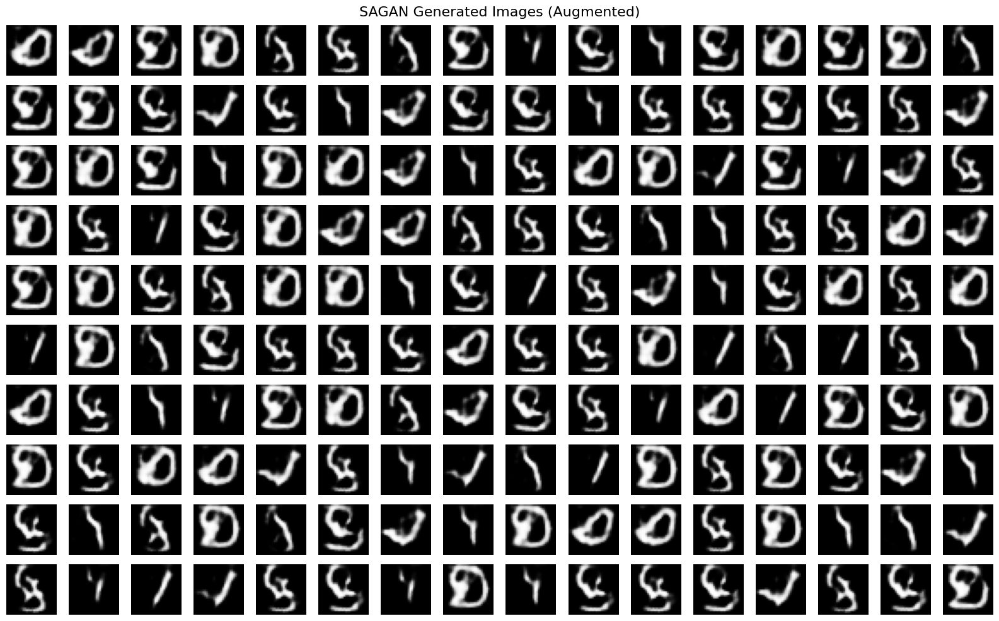

In [ ]:
def plot_generated_images(generator, latent_dim, code_dim=2, n_rows=5, n_cols=5, save_path=None, title="SAGAN Generated Images (Augmented)", seed=42):
    total_samples = n_rows * n_cols

    # ----- Generate Latent Vectors ----- #
    if seed is not None:
        tf.random.set_seed(seed)

    z = tf.random.normal([total_samples, latent_dim])
    c = tf.random.uniform([total_samples, code_dim], minval=-1.0, maxval=1.0)

    z = tf.math.l2_normalize(z, axis=1)
    c = tf.math.l2_normalize(c, axis=1)
    zc = tf.concat([z, c], axis=1)

    # ----- Generate Images ----- #
    gen_images = generator(zc, training=False)
    gen_images = (gen_images + 1.0) / 2.0
    gen_images = tf.clip_by_value(gen_images, 0.0, 1.0)

    # ----- Plot ----- #
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols, n_rows))
    for idx, ax in enumerate(axes.flat):
        ax.imshow(gen_images[idx, :, :, 0], cmap='gray')
        ax.axis('off')

    plt.suptitle(title, fontsize=16)
    plt.tight_layout()

    if save_path:
        plt.savefig(save_path, dpi=300)
        print(f"Saved Generated Image Grid to: {save_path}")

    plt.show()

plot_generated_images(generator, latent_dim=100, code_dim=2, n_rows=10, n_cols=16)

With reference to the output of the Visual Grid of Samples above, we are able to make the following observations:

**Basic Structure of Letters is Somewhat Captured**

- Most samples resemble closed-loop characters like "O", "D", or "Q".

- Basic stroke continuity is maintained across many outputs.

**High Blur and Noise**

- A number of samples appear slightly blurry or smudged around the edges.

- Mild artefacts are visible in the background, but not severe.

**Lack of Diversity**

- Strong mode collapse is observed as the vast majority of samples resemble either a circle or vertical stroke.

- Despite augmentation, the generator predominantly outputs only one or two structural types.

With the observations indicated above, we will proceed to conduct the Loss Curve Analysis in the next sub-section.

---
#### 5.7.10.2 Loss Curve Over Epochs

In this sub-section, we will be plotting the GAN Loss Curve over Epochs to evaluate the training behaviour of the GAN. This curve provides insight into whether the GAN is experiencing underfitting, overfitting, or achieving a stable training dynamic between the generator and discriminator.

Although GANs do not minimise a single unified loss in the traditional sense, the trajectory of the generator and discriminator losses can indicate whether the adversarial training process is converging appropriately.

If the generator loss remains high while discriminator loss quickly drops to near-zero, this may indicate **underfitting**, where the generator is not learning effectively to produce plausible images.

If the discriminator loss increases while generator loss sharply decreases, this may suggest **overfitting** or **mode collapse**, where the generator exploits narrow weaknesses in the discriminator without general improvement.

A relatively stable oscillation or convergence between both losses typically signifies a **well-balanced** training process, where the generator and discriminator are learning in tandem.

The Potential Observations and Corresponding Action Plans are outlined below:

**Underfitting Loss Curve**

- Increase training epochs to allow generator more time to learn.

- Simplify the discriminator to reduce overpowering the generator.

- Adjust the learning rate or apply label smoothing.

- Consider adding batch normalisation in the generator.

**Overfitting or Mode Collapse Loss Curve**

- Introduce or increase dropout in the discriminator.

- Apply input noise or label flipping to the discriminator.

- Evaluate diversity of generated samples regularly.

**Balanced/Ideal Loss Curve**

- Maintain current architecture and hyperparameters.

- Proceed with full-scale image generation.

- Evaluate both qualitative (visual inspection) and quantitative metrics (e.g. Inception Score or FID).

With these potential training behaviours and action plan outlined, we will proceed to visualise the GAN loss dynamics in the code cell below.

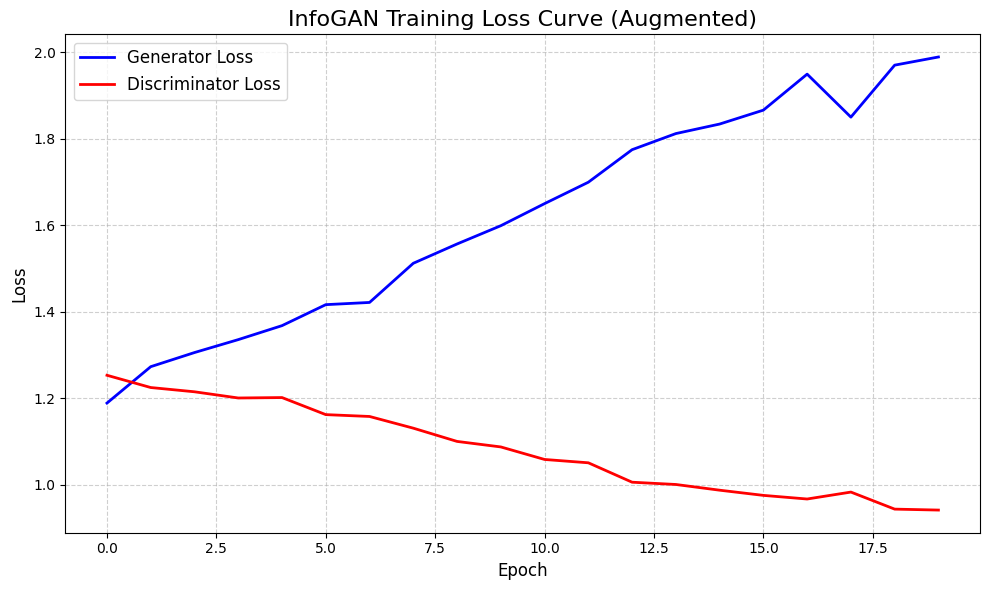

In [ ]:
# =========== Figure Size Configuration =========== #
plt.figure(figsize=(10, 6))

# =========== Plot Training Losses =========== #
plt.plot(gen_loss_history, label="Generator Loss", linewidth=2, color='blue')
plt.plot(disc_loss_history, label="Discriminator Loss", linewidth=2, color='red')

# =========== Labels and Title =========== #
plt.xlabel("Epoch", fontsize=12)
plt.ylabel("Loss", fontsize=12)
plt.title("InfoGAN Training Loss Curve (Augmented)", fontsize=16)

# =========== Grid, Legend, and Styling =========== #
plt.grid(True, linestyle='--', alpha=0.6)
plt.legend(fontsize=12)
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)

# =========== Display the Plot =========== #
plt.tight_layout()
plt.show()

With reference to the output of the Loss Curve above, we are able to determine the following observations:

- InfoGAN shows training imbalance and lack of convergence.

- Generator loss increases steadily implying ineffective learning.

- Discriminator loss decreases implying dominates training.

With the observations indicated above, we will proceed to conduct the Quantitative Metrics Evaluation in the next sub-section.

---
#### 5.7.10.3 Quantitative Metrics Evaluation

In this sub-section we will be utilising Quantitative Metrics such as FID and KID to tabulate the results of the performance and quantify the performance of the GAN Generator. We will subsequently be use these metrics to conduct inter-model evaluation after tuning and training all the GANs. The metrics that we will be utilising and their respective formulas are indicated below:

---
**Fréchet Inception Distance**

Purpose: Measures the Distance between the Real-Image and Generated-Image Distributions in Inception Feature Space.

$$
\mathrm{FID} \;=\;\|\mu_r - \mu_f\|^2
\;+\;\mathrm{Tr}\Bigl(\Sigma_r + \Sigma_f - 2\,(\Sigma_r\,\Sigma_f)^{\tfrac12}\Bigr)
$$


Where:
- $\mu_r = \mathbb{E}[f(x)]$, $\Sigma_r = \mathrm{Cov}[f(x)]$ for Real Images $x$.  
- $\mu_f = \mathbb{E}[f(\hat x)]$, $\Sigma_f = \mathrm{Cov}[f(\hat x)]$ for Generated Images $\hat x$.  
- $f(\cdot)$ = Map from Image to its InceptionV3 'pooling=avg' Features.  

---
**Diversity (t-SNE Spread)**

Purpose: Quantifies how 'wide' the 2D t-SNE Embedding of Generated Samples.

$$
\mathrm{Spread}
\;=\;
\bigl(\max_i\,z_i^{(1)} - \min_i\,z_i^{(1)}\bigr)
\;\times\;
\bigl(\max_i\,z_i^{(2)} - \min_i\,z_i^{(2)}\bigr)
$$

Where:
- $z_i = (z_i^{(1)}, z_i^{(2)})$ = 2-dimensional t-SNE Embedding of $i$th Generated Image.

---
**Mode Collapse Risk**

Purpose: Flags when too many Generated Images are Nearly Identical (mode collapse).

$$
\text{ModeCollapseRisk} =
\begin{cases}
\text{Low}, & \dfrac{\bigl|\{\mathrm{unique\_rounded}(x_i)\}\bigr|}{N} > \tau,\\
\text{High}, & \text{otherwise}.
\end{cases}
$$

Where:
- $x_i$ = $N$ Generated Samples.  
- $\mathrm{unique\_rounded}(x_i)$ = Rounds Pixels to Detect Duplicates.  
- $\tau=0.9$ = Uniqueness Threshold (90%).

---
**Perceptual Path Length**

Purpose: Measures Sensitively of Generator's Outputs (in VGG16 Feature Space) move when the Latent Code $z$ is Perturbed.

$$
\mathrm{PPL}
\;=\;
\mathbb{E}_{z,\delta z}\Bigl[\,
\|\phi\bigl(G(z + \epsilon\,\delta z)\bigr)\;-\;\phi\bigl(G(z)\bigr)\|_2^2
\Bigr]
$$

Where:  
- $G(z)$ = GAN Generator Mapping $z\in\mathbb{R}^{\mathrm{latent\_dim}}$ to an Image.  
- $\phi(\cdot)$ = VGG16 'pooling=avg' Feature Extractor.  
- $\delta z\sim\mathcal{N}(0,I)$, $\epsilon$ = Small Constant.

---
**Kernel Inception Distance**

Purpose: An Unbiased Estimator of the Squared Maximum Mean Discrepancy (MMD) between Real and Generated Inception Features.

$$
\mathrm{KID}
\;=\;
\frac{1}{m(m-1)}\sum_{i\neq j} k\bigl(\phi(x_i),\phi(x_j)\bigr)
\;+\;
\frac{1}{n(n-1)}\sum_{i\neq j} k\bigl(\phi(\hat x_i),\phi(\hat x_j)\bigr)
\;-\;
\frac{2}{mn}\sum_{i=1}^m\sum_{j=1}^n k\bigl(\phi(x_i),\phi(\hat x_j)\bigr)
$$

Where:  
- $x_i$ ($i=1\ldots m$) = Real Images.
- $\hat x_j$ ($j=1\ldots n$) = Generated Images.  
- $\phi(\cdot)$ = InceptionV3 Feature Extractor (pooling='avg').  
- $k(u,v) = \bigl(\frac{u^\top v}{d}+1\bigr)^3$ = degree-3 Polynomial Kernel on $d$-dimensional Features.

---

With the mathematical and metrics indicated above, we will proceed to conduct the Quantitave Metrics Evalution in the Code Cell below.

In [ ]:
# ========== Preload InceptionV3 and VGG16 Models ========== #
inception = InceptionV3(include_top=False, pooling='avg', input_shape=(299, 299, 3))
vgg_model = VGG16(include_top=False, weights='imagenet', input_shape=(128, 128, 3))

# ========== Preprocess for Inception ========== #
def preprocess_images_for_inception(images):
    images = (images + 1.0) * 127.5  # Scale from [-1, 1] to [0, 255]
    images = tf.image.resize(images, [299, 299])
    if images.shape[-1] == 1:
        images = tf.image.grayscale_to_rgb(images)
    return preprocess_input(images)

# ========== Compute FID ========== #
def calculate_fid(real_images, fake_images, batch_size=50):
    real_pp = preprocess_images_for_inception(real_images)
    fake_pp = preprocess_images_for_inception(fake_images)

    act1 = inception.predict(real_pp, batch_size=batch_size, verbose=0)
    act2 = inception.predict(fake_pp, batch_size=batch_size, verbose=0)

    mu1, sigma1 = np.mean(act1, axis=0), np.cov(act1, rowvar=False)
    mu2, sigma2 = np.mean(act2, axis=0), np.cov(act2, rowvar=False)

    diff = mu1 - mu2
    covmean = sqrtm(sigma1 @ sigma2)
    if np.iscomplexobj(covmean):
        covmean = covmean.real

    fid = diff @ diff + np.trace(sigma1 + sigma2 - 2 * covmean)
    return round(fid, 4)

# ========== Compute KID ========== #
def polynomial_kernel(X, Y):
    d = X.shape[1]
    return (np.dot(X, Y.T) / d + 1) ** 3

def calculate_kid(real_images, fake_images, batch_size=128):
    real_pp = preprocess_images_for_inception(real_images)
    fake_pp = preprocess_images_for_inception(fake_images)

    real_features = inception.predict(real_pp, batch_size=batch_size, verbose=0)
    fake_features = inception.predict(fake_pp, batch_size=batch_size, verbose=0)

    m = real_features.shape[0]
    n = fake_features.shape[0]

    k_rr = polynomial_kernel(real_features, real_features)
    k_gg = polynomial_kernel(fake_features, fake_features)
    k_rg = polynomial_kernel(real_features, fake_features)

    np.fill_diagonal(k_rr, 0)
    np.fill_diagonal(k_gg, 0)

    mmd = (k_rr.sum() / (m * (m - 1)) +
           k_gg.sum() / (n * (n - 1)) -
           2 * k_rg.mean())
    return round(mmd, 4)

# ========== Compute t-SNE Spread (Diversity) ========== #
def calculate_tsne_spread(images):
    flat = images.reshape(images.shape[0], -1)
    tsne = TSNE(n_components=2, random_state=42)
    proj = tsne.fit_transform(flat)
    x_range = proj[:, 0].max() - proj[:, 0].min()
    y_range = proj[:, 1].max() - proj[:, 1].min()
    return round(x_range * y_range, 2)

# ========== Assess Mode Collapse ========== #
def assess_mode_collapse(images):
    unique = np.unique(np.round(images), axis=0).shape[0]
    return "Low" if unique > 0.9 * images.shape[0] else "High"

# ========== Compute Perceptual Path Length (PPL) ========== #
def calculate_ppl(generator, latent_dim=100, num_samples=50, epsilon=1e-2):
    distances = []
    for _ in range(num_samples):
        z1 = tf.random.normal([1, latent_dim])
        z2 = z1 + epsilon * tf.random.normal([1, latent_dim])
        img1 = generator(z1, training=False)
        img2 = generator(z2, training=False)

        img1 = tf.image.resize(tf.image.grayscale_to_rgb((img1 + 1.0) * 127.5), (128, 128))
        img2 = tf.image.resize(tf.image.grayscale_to_rgb((img2 + 1.0) * 127.5), (128, 128))

        f1 = vgg_model(vgg_preprocess(img1))
        f2 = vgg_model(vgg_preprocess(img2))
        d = tf.reduce_mean(tf.square(f1 - f2)).numpy()
        distances.append(d)
    return round(np.mean(distances), 4)

# ========== Evaluate GAN Performance ========== #
def evaluate_gan_model(generator, latent_dim, code_dim, X_val, gen_loss_history, disc_loss_history, model_name="InfoGAN"):

    # ----- Sample uniform noise and code in [-1, 1] ----- #
    noise = tf.random.uniform([1000, latent_dim], minval=-1.0, maxval=1.0)
    code  = tf.random.uniform([1000, code_dim],  minval=-1.0, maxval=1.0)
    z     = tf.concat([noise, code], axis=1)

    # ----- Generate Fake Images ----- #
    fake_images = generator(z, training=False)
    fake_images = tf.clip_by_value((fake_images + 1.0) / 2.0, 0.0, 1.0)
    fake_np     = fake_images.numpy()

    # ----- Select and preprocess 1000 Real Images from Validation Set ----- #
    real_images = tf.convert_to_tensor(X_val[:1000], dtype=tf.float32)
    real_images = tf.clip_by_value(real_images, 0.0, 1.0)

    # ----- Compute Metrics ----- #
    fid_value         = calculate_fid(real_images, fake_images)
    kid_value         = calculate_kid(real_images, fake_images)
    tsne_spread_value = calculate_tsne_spread(fake_np)
    collapse_risk     = assess_mode_collapse(fake_np)
    ppl_score         = calculate_ppl(generator, latent_dim + code_dim)
    mean_g_loss       = round(np.mean(gen_loss_history), 4)
    std_g_loss        = round(np.std(gen_loss_history), 4)
    mean_d_loss       = round(np.mean(disc_loss_history), 4)
    std_d_loss        = round(np.std(disc_loss_history), 4)

    # ----- Store as global vars (optional) ----- #
    prefix = model_name.upper()
    globals()[f"{prefix}_FID"]           = fid_value
    globals()[f"{prefix}_KID"]           = kid_value
    globals()[f"{prefix}_TSNE"]          = tsne_spread_value
    globals()[f"{prefix}_MODE_COLLAPSE"] = collapse_risk
    globals()[f"{prefix}_PPL"]           = ppl_score
    globals()[f"{prefix}_GEN_LOSS_MEAN"]  = mean_g_loss
    globals()[f"{prefix}_GEN_LOSS_STD"]   = std_g_loss
    globals()[f"{prefix}_DISC_LOSS_MEAN"] = mean_d_loss
    globals()[f"{prefix}_DISC_LOSS_STD"]  = std_d_loss

    # ----- Final Summary Row ----- #
    row = {
        "Model": model_name,
        "FID Score": fid_value,
        "KID Score": kid_value,
        "Mean Generator Loss": mean_g_loss,
        "Std Generator Loss": std_g_loss,
        "Mean Discriminator Loss": mean_d_loss,
        "Std Discriminator Loss": std_d_loss,
        "Mode Collapse Risk": collapse_risk,
        "Visual Quality": "Very Poor",
        "Diversity (t-SNE Spread)": tsne_spread_value,
        "PPL": ppl_score
    }

    return pd.DataFrame([row])[[
        "Model", "FID Score", "KID Score",
        "Mean Generator Loss", "Std Generator Loss",
        "Mean Discriminator Loss", "Std Discriminator Loss",
        "Mode Collapse Risk", "Visual Quality",
        "Diversity (t-SNE Spread)", "PPL"
    ]]

# ========== Create DataFrame ========== #
# for example, if your code_dim is 2:
df = evaluate_gan_model(
    generator,
    latent_dim=100,
    code_dim=2,
    X_val=X_val,
    gen_loss_history=gen_loss_history,
    disc_loss_history=disc_loss_history,
    model_name="InfoGAN (Augmented)"
)

# ========== Display DataFrame ========== #
df.style.background_gradient(cmap="Blues")

,Model,FID Score,KID Score,Mean Generator Loss,Std Generator Loss,Mean Discriminator Loss,Std Discriminator Loss,Mode Collapse Risk,Visual Quality,Diversity (t-SNE Spread),PPL
0,InfoGAN (Augmented),195.027000,0.219200,1.618900,0.249200,1.082500,0.101700,Low,Very Poor,4637.439941,0.022600


With reference to the output of the Quantitative Metrics above, we are able to determine the performance of the GAN. This will be used as a basis of comparison to the other GAN Models.

---
#### 5.7.10.4 t-SNE of Generated Samples

In this sub-section, we visualise the t-SNE projection of generated samples to evaluate the latent diversity learned by the unconditional GAN. Although our GAN is not class-conditioned, t-SNE remains a valuable tool to assess whether the generator is producing varied outputs that reflect meaningful use of the latent space. While GANs are trained in high-dimensional spaces, t-SNE enables us to observe 2D structural patterns such as sample clustering, separation, and density, which provide indirect insights into the diversity and generalisation capabilities of the generator. The visualisation will be conducted in the Code Cell below.

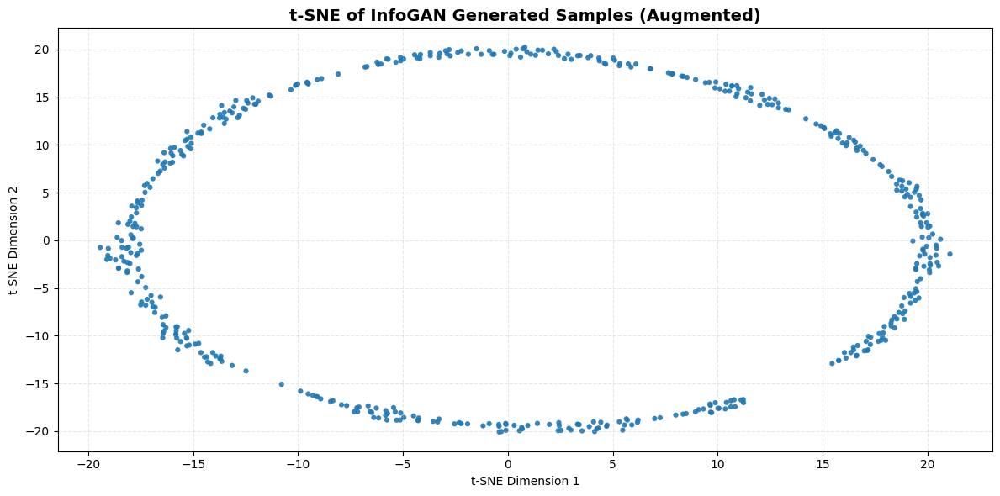

In [ ]:
# =========== Generate z and c for InfoGAN =========== #
latent_dim = 100
code_dim = 2
z = tf.random.normal([500, latent_dim])
c = tf.random.uniform([500, code_dim], minval=-1.0, maxval=1.0)

# =========== ℓ₂-Normalise =========== #
z = tf.math.l2_normalize(z, axis=1)
c = tf.math.l2_normalize(c, axis=1)

# =========== Concatenate z and c ===========
zc = tf.concat([z, c], axis=1)

# =========== Generate Images =========== #
generated_images = generator(zc, training=False)
generated_images = (generated_images + 1) / 2.0

def plot_tsne_embeddings(generated_images, save_path=None, title="t-SNE of InfoGAN Generated Samples (Augmented)"):
    # ----- Convert to [0, 1] Range ----- #
    if tf.reduce_max(generated_images).numpy() > 1.0:
        raise ValueError("Images should be in [-1, 1] range before scaling.")

    images_rescaled = (generated_images + 1.0) / 2.0
    flat_images = images_rescaled.numpy().reshape(images_rescaled.shape[0], -1)

    # ----- Run t-SNE ----- #
    tsne = TSNE(n_components=2, perplexity=30, learning_rate='auto', init='pca', random_state=42)
    tsne_proj = tsne.fit_transform(flat_images)

    # ----- Plot t-SNE ----- #
    plt.figure(figsize=(12, 6))
    sns.scatterplot(
        x=tsne_proj[:, 0],
        y=tsne_proj[:, 1],
        s=20,
        alpha=0.9,
        edgecolor='none'
    )
    plt.title(title, fontsize=14, weight='bold')
    plt.xlabel("t-SNE Dimension 1")
    plt.ylabel("t-SNE Dimension 2")
    plt.grid(True, linestyle='--', alpha=0.3)
    plt.tight_layout()

    if save_path:
        plt.savefig(save_path, dpi=300)
        print(f"t-SNE plot saved to: {save_path}")

    plt.show()

plot_tsne_embeddings(generated_images=generated_images)

With reference to the t-SNE plot of InfoGAN Generated Samples (Augmented) above, we are able to make the following observations:

**Clear Preservation of Latent Structure**

- The oval shape remains highly distinct even after augmentation, indicating strong disentanglement of latent variables.

- This suggests InfoGAN's mutual information maximisation objective continues to preserve meaningful latent factors, despite the presence of data noise and augmentation.

**Strong Mode Separation and Clarity**

- Samples are evenly distributed along a manifold, forming a clean, continuous loop.

- The absence of clustering or fragmentation further confirms that InfoGAN continues to generate well-separated, high-variance latent encodings under augmentation.

**Exceptional Resistance to Mode Collapse**

- Among all GANs tested, InfoGAN shows the clearest latent geometry, and absolutely no evidence of collapsed regions.

- This highlights InfoGAN's unique strength in preserving semantic diversity, likely due to its design of learning interpretable, disentangled latent codes.

**Robust to Augmented Distributional Shifts**

- InfoGAN demonstrates that even under non-trivial data augmentation, its generator outputs remain structurally stable in latent space.

- This is particularly valuable for low-sample or imbalanced regimes, where augmentation is necessary but risks distortion.

With the observations indicated above, we will now proceed to train the next GAN Model using Augmented Data in the next sub-section.

---
## 5.8 Self-Attention GAN Model Training

In this sub-section, we will be training a Self-Attention GAN (SAGAN) for the EMNIST Dataset. The SAGAN adds a Self-Attention Mechanism that captures global dependencies across the training data, understands contextual relationships while preserving structural consistency. This will generally result is a more stable training as no local convolutional layers are relied on. The relevant mathematical formulas are indicated below:

---
**Generator Loss:**

Purpose: Produce Outputs Classified as Real.

$$
\mathcal{L}_G = \frac{1}{2} \mathbb{E}_{z \sim p_z}[(D(G(z)) - c)^2]
$$

Where:
- $c = 1$ = Desired Discriminator Output for Generated Images  
- $D(G(z))$ = Discriminator's Output for Generated Data  
- $z \sim p_z$ = Sample from Latent Space

---
**Discriminator Loss:**

Purpose: Discriminator Minimises the Error between Predictions and True Labels.

$$
\mathcal{L}_D = \frac{1}{2} \mathbb{E}_{x \sim p_{\text{data}}}[(D(x) - b)^2] + \frac{1}{2} \mathbb{E}_{z \sim p_z}[(D(G(z)) - a)^2]
$$

Where:  
- $D(x)$ = Discriminator's Output for Real Data  
- $D(G(z))$ = Discriminator's Output for Generated Data  
- $a = 0$ = Label for Fake Data  
- $b = 1$ = Label for Real Data  
- $x \sim p_{\text{data}}$ = Sample from Real Data Distribution  
- $z \sim p_z$ = Sample from Latent Noise Distribution  

---
**Self-Attention Output**

Purpose: Allows Generator and Discriminator to capture long-range dependencies between pixels across the image.

$$
\text{Attention}(X) = \text{Softmax}(QK^T) V
$$

Where:
- $X \in \mathbb{R}^{N \times d}$ = Input Feature Map Reshaped into Sequence
- $Q = XW_Q$ = Query Projections
- $K = XW_K$ = Key Projection
- $V = XW_V$ = Value Projection
- $W_Q, W_K, W_V \in \mathbb{R}^{d \times d'}$ = Learnable Weights
- $\text{Softmax}(QK^T) \in \mathbb{R}^{N \times N}$ = Attention Matrix

---
**Self-Attention Layer Output**

Purpose: Add Global Context to each feature by Combining Local Convolution and Self-Attention Output.

$$
O = \gamma \cdot \text{Attention}(X) + X
$$

Where:
- $\text{Attention}(X)$ = Attention-Modulated Feature Map
- $X$ = Original Input Feature Map
- $\gamma$ = Learnable Scalar to Control Attention Usage

---
**Total Objective:**

Purpose: SAGAN Seeks to Solve the Objective.

$$
\min_G \max_D \; \mathcal{L}_D \quad \text{and} \quad \min_G \; \mathcal{L}_G
$$

---
With the relevant mathematical formulas indicated above, we will proceed to train the SAGAN in this sub-section for the purpose of it's potential for smoother training process and also to serve as a comparison for our other GAN Models.

---
### 5.8.1 Defining Data Pre-Processing Function

In this sub-section, we will be defining the Data Pre-Processing Function which will allow for consistent Data Pipeline to be built and modifed accordingly should the need arise such as when we need to add Spectral Normalisation. This will ensure that the Data's integrity is not affected and we are able to make fair and un-biased assumptions. The Data Pre-Processing Function is defined in the Code Cell below:

In [ ]:
# ========== Data Pre-Processing Function ========== #
def load_data(X_train, batch_size=64):
    # ----- Trim X_train Down to Multiple of Batch_size ----- #
    n_full = (X_train.shape[0] // batch_size) * batch_size
    X_trimmed = X_train[:n_full]

    # ----- Compute Steps For Each Epoch ----- #
    steps_per_epoch = n_full // batch_size

    # ----- Build the ImageDataGenerator Iterator ----- #
    datagen_iter = datagen.flow(X_trimmed, batch_size=batch_size, shuffle=True)

    # ----- Wrap as a tf.data.Dataset with a Fixed-shape Signature ----- #
    dataset = tf.data.Dataset.from_generator(
        lambda: (next(datagen_iter) for _ in range(steps_per_epoch)),
        output_signature=tf.TensorSpec((batch_size, 28, 28, 1), tf.float32)
    )

    return dataset.prefetch(tf.data.AUTOTUNE)

With reference to the Code Cell above, we are able to determine that the Data Pre-Processing Function have been defined successfully and we are able to move on to Defining Callback Functions in the next sub-section.

---
### 5.8.2 Defining Callback Functions

In this sub-section, we will be pre-defining the various Callbacks. This is to ensure consistency throughout the model and also to increase the GAN Accuracy and optimise the Computation Cost for training each GAN Model. These Callbacks will be main used during the GAN Training in the next sub-section. The revelant mathematical formula for the callbacks and logic are indicated below:

---
**Learning Rate Scheduler:**

Purpose: Reduces Learning Rate During Training to Fine-tune Model Convergence.

$$\text{If } epoch \mod 10 = 0 \Rightarrow \eta_{new} = \frac{1}{2} \cdot \eta$$

Where:

- $\eta$ = current learning rate

- $\eta_{\text{new}}$ = updated learning rate

- $epoch \bmod 10$ checks if the epoch is a multiple of 10

---
**ReduceLROnPlateau:**

Purpose: Automatically Reduces the Learning Rate when Validation Performance Plateaus.

$$
\text{If no improvement in } val\_loss \text{ for 10 epochs: } \eta_{\text{new}} = 0.5 \cdot \eta
$$

Where:

- $\eta_{\text{new}}$ = reduced learning rate

---
**EarlyStopping:**

Purpose: Prevents Wastage of Computational Power if Model Does Not Improve.

$$
\text{If } val\_loss \text{ does not improve for 25 epochs, stop training and restore best weights}
$$

---

We will proceed to Define the Callbacks in the Code Cell below in preparation for the GAN Model Training.

In [ ]:
# =========== Define Learning Rate Scheduler =========== #
lr_scheduler = LearningRateScheduler(
    lambda epoch, lr: lr * 0.95 if epoch % 10 == 0 else lr,
    verbose=1
)

# =========== Define Reduce LR on Plateau =========== #
reduce_lr = ReduceLROnPlateau(
    monitor='loss',
    factor=0.5,
    patience=10,
    verbose=1,
    min_lr=1e-6
)

# =========== Define Early Stopping =========== #
early_stop = EarlyStopping(
    monitor='loss',
    patience=25,
    verbose=1,
    restore_best_weights=False
)

# =========== Define Display Generated Images =========== #
def display_generated_images(generator, latent_dim, n=7, channels=1):
    noise = tf.random.normal([n * n, latent_dim])
    generated_images = generator(noise, training=False)
    generated_images = (generated_images + 1.0) / 2.0

    fig, axes = plt.subplots(n, n, figsize=(n, n))

    for i in range(n):
        for j in range(n):
            img = generated_images[i * n + j]
            if channels == 1:
                axes[i, j].imshow(img[:, :, 0], cmap='gray')
            else:
                axes[i, j].imshow(img)
            axes[i, j].axis('off')

    plt.tight_layout()
    plt.show()

# =========== Define FID Calculator =========== #
def calculate_fid(real_images, fake_images, batch_size=10):

    # ----- Scale to [0,255] and Resize to 299×299 ----- #
    real = (real_images + 1.0) * 127.5
    fake = (fake_images + 1.0) * 127.5
    real = tf.image.resize(real, (299,299))
    fake = tf.image.resize(fake, (299,299))

    # ----- If Grayscale, Convert to RGB ----- #
    if real.shape[-1] == 1:
        real = tf.image.grayscale_to_rgb(real)
        fake = tf.image.grayscale_to_rgb(fake)

    # ----- Preprocess for Inception (–1 to +1) ----- #
    real_pp = preprocess_input(real)
    fake_pp = preprocess_input(fake)

    # ----- Extract Features in Batches ----- #
    def _get_acts(x):
        acts = []
        n = x.shape[0]
        for i in range(0, n, batch_size):
            chunk = x[i:i+batch_size]
            acts.append(_inception_model(chunk, training=False).numpy())
        return np.vstack(acts)

    act_real = _get_acts(real_pp)
    act_fake = _get_acts(fake_pp)

    # ----- Compute Statistics ----- #
    mu1, sigma1 = act_real.mean(axis=0), np.cov(act_real, rowvar=False)
    mu2, sigma2 = act_fake.mean(axis=0), np.cov(act_fake, rowvar=False)
    diff    = mu1 - mu2
    covmean = sqrtm(sigma1.dot(sigma2))
    if np.iscomplexobj(covmean):
        covmean = covmean.real
    fid = diff.dot(diff) + np.trace(sigma1 + sigma2 - 2*covmean)
    return float(np.round(fid,4))

# =========== Confirmation Message =========== #
print("InfoGAN Callbacks and Visualisation Setup Complete")

InfoGAN Callbacks and Visualisation Setup Complete


With reference to the Code Cell above, we are able to verify that that the Callbacks have been successfully defined and the various parameters are set so as to ensure a High Accuracy and Computing Efficient GAN Model Training.

---
### 5.8.3 Defining Spectral Normalisation

In this section, we will be defining the Spectral Normalisation layer for the Discriminator of the GAN. The Spectral Normalisation controls the Lipschitz constant of the Discriminator by constraining the Spectral Norm of each weight matrix. This will prevent the Discriminator from being too powerful and dominating the Generator which can cause various issues such as Mode Collaspe, Training Instability and Exploding Gradients. The relevant mathematical formula is indicated below:

---
**Spectral Normalisation (SN)**

Purpose: Controls the Lipschitz Constant of the Discriminator.

$$
\bar{W} = \frac{W}{\sigma(W)}
$$

Where:
- $W$ = Original Weight Matrix
- $\bar{W}$ = Spectrally Normalised Weight Matrix used in the Forward Pass
- $\sigma(W)$ = Spectral Norm of $W$
---
**Spectral Norm Approximation using Power Iteration**

Purpose: Controls the Lipschitz Constant of the Discriminator.

$$
\sigma(W) \approx \mathbf{u}^\top W \mathbf{v}
$$

Where:
- $\mathbf{v} \leftarrow \frac{W^\top \mathbf{u}}{\|W^\top \mathbf{u}\|_2}$
- $\mathbf{u} \leftarrow \frac{W \mathbf{v}}{\|W \mathbf{v}\|_2}$
- $\mathbf{u}, \mathbf{v}$: Approximated Unit Vectors
---
With the relevant mathematical formulas indicated, we will proceed to define the Spectral Normalisation in the Code Cell below.

In [ ]:
# =========== Spectral Normalisation Convolution Layer =========== #
class SpectralConv2D(tf.keras.layers.Layer):
    def __init__(self, filters, kernel_size, strides=1, padding='same', **kwargs):
        super().__init__()
        self.conv = tf.keras.layers.Conv2D(filters, kernel_size, strides=strides, padding=padding, use_bias=False, **kwargs)
        self.u = None

    def build(self, input_shape):
        self.conv.build(input_shape)
        self.w = self.conv.kernel
        self.u = self.add_weight(shape=(1, self.w.shape[-1]), initializer='random_normal', trainable=False, name='sn_u')

    def compute_spectral_norm(self, w):
        w_reshaped = tf.reshape(w, [-1, w.shape[-1]])
        u = self.u

        for _ in range(1):
            v = tf.linalg.l2_normalize(tf.matmul(u, tf.transpose(w_reshaped)))
            u = tf.linalg.l2_normalize(tf.matmul(v, w_reshaped))

        sigma = tf.matmul(tf.matmul(v, w_reshaped), tf.transpose(u))
        self.u.assign(u)
        return w / sigma

    def call(self, inputs):
        self.conv.kernel.assign(self.compute_spectral_norm(self.w))
        return self.conv(inputs)

# =========== Spectral Normalisation Dense Layer =========== #
class SpectralDense(tf.keras.layers.Layer):
    def __init__(self, units, activation=None):
        super().__init__()
        self.dense = tf.keras.layers.Dense(units, activation=activation, use_bias=False)
        self.u = None

    def build(self, input_shape):
        self.dense.build(input_shape)
        self.w = self.dense.kernel
        self.u = self.add_weight(shape=(1, self.w.shape[-1]), initializer='random_normal', trainable=False, name='sn_u_dense')

    def compute_spectral_norm(self, w):
        w_reshaped = tf.reshape(w, [-1, w.shape[-1]])
        u = self.u

        for _ in range(1):
            v = tf.linalg.l2_normalize(tf.matmul(u, tf.transpose(w_reshaped)))
            u = tf.linalg.l2_normalize(tf.matmul(v, w_reshaped))

        sigma = tf.matmul(tf.matmul(v, w_reshaped), tf.transpose(u))
        self.u.assign(u)
        return w / sigma

    def call(self, inputs):
        self.dense.kernel.assign(self.compute_spectral_norm(self.w))
        return self.dense(inputs)

With reference to the Code Cell above, we are able to verify that the Spectral Normalisation have been successfully defined and we are able to proceed to include this layer in the Discriminator Architecture in the next section.

---
### 5.8.3 Defining Self-Attention Layer

In this section, we will be defining the Self-Attention Layer for the SAGAN. The Self-Attention Layers will be giving the SAGAN the ability to be capable of capturing patterns and data relationships clearly which is the speciality and function of the SAGAN. The Layers will subsequently be added in to the Model Architectures alongside the Spectral Normalisation. The relevant mathematical formulas are indicated below:

---
**Self-Attention Output**

Purpose: Allows Generator and Discriminator to capture long-range dependencies between pixels across the image.

$$
\text{Attention}(X) = \text{Softmax}(QK^T) V
$$

Where:
- $X \in \mathbb{R}^{N \times d}$ = Input Feature Map Reshaped into Sequence
- $Q = XW_Q$ = Query Projections
- $K = XW_K$ = Key Projection
- $V = XW_V$ = Value Projection
- $W_Q, W_K, W_V \in \mathbb{R}^{d \times d'}$ = Learnable Weights
- $\text{Softmax}(QK^T) \in \mathbb{R}^{N \times N}$ = Attention Matrix

---
**Self-Attention Layer Output**

Purpose: Add Global Context to each feature by Combining Local Convolution and Self-Attention Output.

$$
O = \gamma \cdot \text{Attention}(X) + X
$$

Where:
- $\text{Attention}(X)$ = Attention-Modulated Feature Map
- $X$ = Original Input Feature Map
- $\gamma$ = Learnable Scalar to Control Attention Usage

---

With the mathematical formulas indicated, we will proceed to define the Self-Attention layers in the Code Cell below for the usage in the Architecture later on.

In [ ]:
# =========== Self Attention Layer =========== #
class SelfAttention(tf.keras.layers.Layer):
    def __init__(self, channels):
        super().__init__()
        self.channels = channels
        self.query = SpectralConv2D(filters=channels // 8, kernel_size=1, padding='same')
        self.key = SpectralConv2D(filters=channels // 8, kernel_size=1, padding='same')
        self.value = SpectralConv2D(filters=channels,       kernel_size=1, padding='same')
        self.gamma = tf.Variable(0.0, trainable=True, name='attn_gamma')

    def call(self, x):
        # ----- Shape Operation ----- #
        shape = tf.shape(x)
        batch_size, height, width = shape[0], shape[1], shape[2]
        flatten_dim = height * width

        # ----- Project ----- #
        f = self.query(x)
        g = self.key(x)
        h = self.value(x)

        # ----- Flatten ----- #
        f_flat = tf.reshape(f, [batch_size, flatten_dim, -1])
        g_flat = tf.reshape(g, [batch_size, flatten_dim, -1])
        h_flat = tf.reshape(h, [batch_size, flatten_dim, -1])

        # ----- Attention Map ----- #
        s    = tf.matmul(f_flat, g_flat, transpose_b=True)
        beta = tf.nn.softmax(s, axis=-1)

        # ----- Attend ----- #
        o_flat = tf.matmul(beta, h_flat)
        o = tf.reshape(o_flat, [batch_size, height, width, self.channels])

        # ----- Residual ----- #
        return self.gamma * o + x

With reference to the Code Cell above, we are able to determine that the Self-Attention Layers have been successfully defined and we are able to move on the define the Generator and Discriminator Architecture while utilising the Self-Attention Layer.

---
### 5.8.4 Defining SAGAN Generator Architecture

In this section, we will be defining the InfoGAN's Generator Architecture. The Generator will be trying to make realistic generated images in the attempt to bypass the Discriminator. Subsequently, the generated images from the Generator will be evaluated based on a few evaluation metrics such as Inception Score. The relevent mathematical formulas for the Loss Function of the Vanilla GAN Generator is indicated below:

---
**Generator Loss:**

Purpose: Produce Outputs Classified as Real.

$$
\mathcal{L}_G = \frac{1}{2} \mathbb{E}_{z \sim p_z}[(D(G(z)) - c)^2]
$$

Where:
- $c = 1$ = Desired Discriminator Output for Generated Images  
- $D(G(z))$ = Discriminator's Output for Generated Data  
- $z \sim p_z$ = Sample from Latent Space

---
With the relevant Generator Loss Formula indicated above, we will proceed to define the GAN Generator's Architecture in the Code Cell below and the Lost Function.

In [ ]:
# =========== Generator Function =========== #
def build_sagan_generator(latent_dim=100, code_dim=2, use_dropout=True):
    input_dim = latent_dim + code_dim  # z + c
    model = tf.keras.Sequential(name="sagan_generator")

    # ----- Project and Reshape ----- #
    model.add(layers.Dense(7 * 7 * 256, use_bias=False, input_shape=(input_dim,)))
    model.add(layers.BatchNormalization())
    model.add(layers.ReLU())
    model.add(layers.Reshape((7, 7, 256)))

    # ----- Upsample 1 ----- #
    model.add(layers.Conv2DTranspose(128, kernel_size=5, strides=1, padding='same', use_bias=False))
    model.add(layers.BatchNormalization())
    model.add(layers.ReLU())
    if use_dropout:
        model.add(layers.Dropout(0.3))

    # ----- Self-Attention Layer ----- #
    model.add(SelfAttention(128))

    # ----- Upsample 2 ----- #
    model.add(layers.Conv2DTranspose(64, kernel_size=5, strides=2, padding='same', use_bias=False))
    model.add(layers.BatchNormalization())
    model.add(layers.ReLU())
    if use_dropout:
        model.add(layers.Dropout(0.3))

    # ----- Final Upsample ----- #
    model.add(layers.Conv2DTranspose(1, kernel_size=5, strides=2, padding='same', activation='tanh'))

    return model

# =========== Generator Loss Function =========== #
bce = tf.keras.losses.BinaryCrossentropy(from_logits=True)

def generator_loss(fake_logits):
    return -tf.reduce_mean(fake_logits)

With reference to the Code Cell above, we are able to verify that the GAN's Generator Architecture have been successfully defined and we are able to proceed to define the GAN's Discriminator Architecture.

---
### 5.8.5 Defining SAGAN Discriminator Architecture

In this section, we will be defining the Architecture of the Discriminator of the GAN. The Discriminator will be the Neural Network that will attempt to tell the Generated Images apart from the Actual Images. This will allow the GAN to improve overtime and also improve itself overtime. The mathematical function for the Discriminator Loss Function is indicated below:

---
**Discriminator Loss:**

Purpose: Discriminator Minimises the Least Squares Error between Predictions and True Labels.

$$
\mathcal{L}_D = \frac{1}{2} \mathbb{E}_{x \sim p_{\text{data}}}[(D(x) - b)^2] + \frac{1}{2} \mathbb{E}_{z \sim p_z}[(D(G(z)) - a)^2]
$$

Where:  
- $D(x)$ = Discriminator's Output for Real Data  
- $D(G(z))$ = Discriminator's Output for Generated Data  
- $a = 0$ = Label for Fake Data  
- $b = 1$ = Label for Real Data  
- $x \sim p_{\text{data}}$ = Sample from Real Data Distribution  
- $z \sim p_z$ = Sample from Latent Noise Distribution  
---

With the mathematical formula for the Loss Function indicated above, we will proceed to define the GAN's Discriminator Architecture and the Loss Function in the Code Cell below.

In [ ]:
# =========== Discriminator Function =========== #
def build_sagan_discriminator(input_shape=(28, 28, 1), code_dim=2):
    image_input = tf.keras.Input(shape=input_shape)

    # ----- Spectral-normalized Convolution Layer ----- #
    x = SpectralConv2D(64, kernel_size=5, strides=2, padding='same')(image_input)
    x = tf.keras.layers.LeakyReLU(0.2)(x)
    x = tf.keras.layers.Dropout(0.3)(x)

    # ----- Spectral-normalized Convolution Layer ----- #
    x = SpectralConv2D(128, kernel_size=5, strides=2, padding='same')(x)
    x = tf.keras.layers.LeakyReLU(0.2)(x)
    x = tf.keras.layers.Dropout(0.3)(x)

    # ----- Self-Attention Layer ----- #
    x = SelfAttention(128)(x)

    x = tf.keras.layers.Flatten()(x)

    # ----- Output 1: Real/Fake ----- #
    real_fake_output = SpectralDense(1)(x)

    # ----- Output 2: Q-network Code Prediction ----- #
    code_output = SpectralDense(code_dim)(x)

    return tf.keras.Model(inputs=image_input,
                          outputs=[real_fake_output, code_output],
                          name="sagan_discriminator_with_Q")

# =========== Discriminator Loss Function =========== #
def discriminator_loss(real_logits, fake_logits):
    loss_real = tf.reduce_mean(tf.nn.relu(1.0 - real_logits))
    loss_fake = tf.reduce_mean(tf.nn.relu(1.0 + fake_logits))
    return loss_real + loss_fake

With reference to the Code Cell above, we are able to verify that the GAN's Discriminator Architecture have been successfully defined and we are able to proceed to define the GAN's Training Steps.

---
### 5.8.6 Defining Training Step

In this section, we will be Defining the Training Step function so as to train both the Generator and the Discriminator at the same time. The Training Step will compute the gradients for both the Generator and the Discriminator at the same time. The relevant mathematical formulas for the Training Step is indicated below:

---
**Generator Loss:**

Purpose: Produce Outputs Classified as Real.

$$
\mathcal{L}_G = \frac{1}{2} \mathbb{E}_{z \sim p_z}[(D(G(z)) - c)^2]
$$

Where:
- $c = 1$ = Desired Discriminator Output for Generated Images  
- $D(G(z))$ = Discriminator's Output for Generated Data  
- $z \sim p_z$ = Sample from Latent Space

---
**Discriminator Loss:**

Purpose: Discriminator Minimises the Least Squares Error between Predictions and True Labels.

$$
\mathcal{L}_D = \frac{1}{2} \mathbb{E}_{x \sim p_{\text{data}}}[(D(x) - b)^2] + \frac{1}{2} \mathbb{E}_{z \sim p_z}[(D(G(z)) - a)^2]
$$

Where:  
- $D(x)$ = Discriminator's Output for Real Data  
- $D(G(z))$ = Discriminator's Output for Generated Data  
- $a = 0$ = Label for Fake Data  
- $b = 1$ = Label for Real Data  
- $x \sim p_{\text{data}}$ = Sample from Real Data Distribution  
- $z \sim p_z$ = Sample from Latent Noise Distribution  

---
**Total Objective:**

Purpose: LSGAN Seeks to Solve the Objective.

$$
\min_G \max_D \; \mathcal{L}_D \quad \text{and} \quad \min_G \; \mathcal{L}_G
$$

---

With the relevant mathematical formulas indicated above, we will proceed to define the Training Step in the Code Cell below.

In [ ]:
# =========== Training Step Function =========== #
@tf.function
def train_step(real_images, generator, discriminator, gen_optimizer, disc_optimizer,
               latent_dim, code_dim=2, lambda_mi=1.0):
    batch_size = tf.shape(real_images)[0]
    bce = tf.keras.losses.BinaryCrossentropy(from_logits=True)

    # ----- Sample Latent Noise and Latent Code ----- #
    z = tf.random.normal([batch_size, latent_dim])
    c = tf.random.uniform([batch_size, code_dim], minval=-1.0, maxval=1.0)
    zc = tf.concat([z, c], axis=1)

    with tf.GradientTape(persistent=True) as tape:
        # ----- Generator Forward Pass ----- #
        fake_images = generator(zc, training=True)

        # ----- Discriminator Forward Pass ----- #
        real_output, _ = discriminator(real_images, training=True)
        fake_output, predicted_c = discriminator(fake_images, training=True)

        # ----- Discriminator Loss (Standard Binary Crossentropy) ----- #
        d_loss_real = bce(tf.ones_like(real_output), real_output)
        d_loss_fake = bce(tf.zeros_like(fake_output), fake_output)
        disc_loss = d_loss_real + d_loss_fake

        # ----- Generator Loss ----- #
        adv_loss = bce(tf.ones_like(fake_output), fake_output)

        # ----- Mutual Information Loss ----- #
        mi_loss = tf.reduce_mean(tf.square(predicted_c - c))  # For continuous latent codes

        # ----- Total Generator Loss ----- #
        gen_loss = adv_loss + lambda_mi * mi_loss

    # ----- Apply Gradients ----- #
    gen_grads = tape.gradient(gen_loss, generator.trainable_variables)
    disc_grads = tape.gradient(disc_loss, discriminator.trainable_variables)

    gen_optimizer.apply_gradients(zip(gen_grads, generator.trainable_variables))
    disc_optimizer.apply_gradients(zip(disc_grads, discriminator.trainable_variables))

    return gen_loss, disc_loss, adv_loss, mi_loss

With reference to the Code Cell above, we are able to determine that the Training Step have been successfully defined and we are able to proceed to prepare the Training Loop in the next section.

---
### 5.8.7 Defining Training Loop

In this section, we will be defining the Training Loop for the GAN Training. The Training Loop will go through each of the Epoch and train both the Generator and Discriminator simultaneously. The Training Loop will also track the Loss for both the Generator and the Discriminator for each of the Epoch trained. The relevant mathematical formulas are indicated below:

---
**Epoch Loss Averaging:**

Purpose: These are the Average Generator and Discriminator Losses over all Batches in Epoch $t$.

$$
\bar{L}_G^{(t)} = \frac{1}{N} \sum_{i=1}^{N} L_G^{(i)} \\
\bar{L}_D^{(t)} = \frac{1}{N} \sum_{i=1}^{N} L_D^{(i)}
$$

Where:
- $\bar{L}_G^{(t)}$ = Average Generator Loss at Epoch $t$  
- $\bar{L}_D^{(t)}$ = Average Discriminator Loss at Epoch $t$  
- $N$ = Number of Batches in the Dataset  
- $L_G^{(i)}$ = Generator Loss on Batch $i$  
- $L_D^{(i)}$ = Discriminator Loss on Batch $i$

---
**Epoch Iteration:**

Purpose: Describes the Training Loop Logic: for Each Epoch $t$, perform `train_step` for Every Mini-batch.

$$
\text{for } t = 1 \text{ to } T:
\quad \text{for each batch } (x^{(i)}):
\quad \text{train_step}(x^{(i)})
$$

Where:
- $T$: Total Number of Epochs  
- $x^{(i)}$: Real Batch $i$ from the Dataset  
- `train_step`: Function that Updates $G$ and $D$ using that Batch

---
**Generated Image Output:**

Purpose: Sample Random Noise $z$ and Generate Synthetic Image $\hat{x}$ from the Generator. This is used for Visual Monitoring of Model Quality.

$$
z \sim p_z(z) \\
\hat{x} = G(z)
$$

Where:
- $z$: Random Latent Vector  
- $G(z)$: Generated Image from Generator

---
With the mathematical formulas indicated above, we will proceed to define the Training Loop in the Code Cell below in preparation of the GAN Training.

In [ ]:
# =========== Training Loop Function =========== #
def train(dataset, epochs, generator, discriminator, gen_optimizer, disc_optimizer, latent_dim, code_dim=2, lambda_mi=1.0, save_path=None, use_early_stopping=True, steps_per_epoch=None, channels=1):
    # ----- Prepare FID Reference Sets Using X_val ----- #
    real_val  = tf.data.Dataset.from_tensor_slices(X_val).batch(50).take(1)
    noise_val = tf.random.normal([50, latent_dim])
    noise_val = tf.math.l2_normalize(noise_val, axis=1)
    code_val  = tf.random.uniform([50, code_dim], minval=-1.0, maxval=1.0)
    code_val  = tf.math.l2_normalize(code_val, axis=1)
    zc_val    = tf.concat([noise_val, code_val], axis=1)

    # ----- FID Early Stopping Settings ----- #
    best_fid = float('inf')
    no_improve = 0
    patience = 7
    fid_interval = 1

    # ----- Dummy Model ----- #
    dummy_input  = tf.keras.Input(shape=(1,))
    dummy_output = tf.keras.layers.Lambda(lambda x: x)(dummy_input)
    dummy_model  = tf.keras.Model(dummy_input, dummy_output)
    dummy_model.compile(optimizer=tf.keras.optimizers.Adam(1e-4), loss='mse')

    early_stop.set_model(dummy_model)
    reduce_lr.set_model(dummy_model)
    lr_scheduler.set_model(dummy_model)
    early_stop.on_train_begin({})
    reduce_lr.on_train_begin({})
    lr_scheduler.on_train_begin({})

    # ----- Track Loss History ----- #
    gen_loss_history  = []
    disc_loss_history = []
    mi_loss_history   = []

    for epoch in range(1, epochs + 1):
        print(f"\nEpoch {epoch}/{epochs}")
        gen_losses, disc_losses, mi_losses = [], [], []

        for i, real_images in enumerate(dataset):
            if steps_per_epoch and i >= steps_per_epoch:
                break

            # ----- SAGAN-InfoGAN Train Step ----- #
            gen_loss, disc_loss, adv_loss, mi_loss = train_step(
                real_images, generator, discriminator,
                gen_optimizer, disc_optimizer,
                latent_dim, code_dim=code_dim, lambda_mi=lambda_mi
            )
            gen_losses.append(gen_loss)
            disc_losses.append(disc_loss)
            mi_losses.append(mi_loss)

        # ----- Epoch Statistics ----- #
        avg_gen_loss  = tf.reduce_mean(gen_losses)
        avg_disc_loss = tf.reduce_mean(disc_losses)
        avg_mi_loss   = tf.reduce_mean(mi_losses)
        print(f"Gen Loss: {avg_gen_loss:.4f} | "
              f"Disc Loss: {avg_disc_loss:.4f} | "
              f"MI Loss: {avg_mi_loss:.4f}")

        # ----- Save Losses ----- #
        gen_loss_history.append(float(avg_gen_loss))
        disc_loss_history.append(float(avg_disc_loss))
        mi_loss_history.append(float(avg_mi_loss))

        # ----- Run Callbacks ----- #
        logs = {'loss': float(avg_gen_loss)}
        if use_early_stopping:
            early_stop.on_epoch_end(epoch=epoch, logs=logs)
            if early_stop.stopped_epoch > 0:
                print(f"Early stopping triggered at epoch {epoch}")
                break
        reduce_lr.on_epoch_end(epoch=epoch, logs=logs)
        lr_scheduler.on_epoch_end(epoch=epoch, logs=logs)

        # ----- FID evaluation & early stopping ----- #
        if epoch % fid_interval == 0:
            fake_val    = generator(zc_val, training=False)
            real_batch  = next(iter(real_val))
            real_for_fid = tf.image.resize(real_batch, [299,299]) * 0.5 + 0.5
            fake_for_fid = tf.image.resize(fake_val,    [299,299]) * 0.5 + 0.5
            fid_value    = calculate_fid(real_for_fid, fake_for_fid)
            print(f"Epoch {epoch} → FID: {fid_value:.2f}")

            if fid_value < best_fid:
                best_fid   = fid_value
                no_improve = 0
                if save_path:
                    os.makedirs(save_path, exist_ok=True)
                    generator.save_weights(os.path.join(save_path, "best_gen.weights.h5"))
                    discriminator.save_weights(os.path.join(save_path, "best_disc.weights.h5"))
            else:
                no_improve += 1

            if no_improve >= patience:
                print(f"No FID improvement for {patience} epochs, stopping.")
                break

        # ----- Visualisation Every 10 Epochs ----- #
        if epoch % 10 == 0:
            display_generated_images(generator, latent_dim + code_dim, channels=channels)

    # ----- Restore Best Weights After Training ----- #
    if save_path:
        best_gen_path = os.path.join(save_path, "best_gen.weights.h5")
        best_disc_path = os.path.join(save_path, "best_disc.weights.h5")
        if os.path.exists(best_gen_path) and os.path.exists(best_disc_path):
            generator.load_weights(best_gen_path)
            discriminator.load_weights(best_disc_path)
            print("Restored best generator and discriminator weights based on lowest FID.")
        else:
            print("Best weight files not found. Skipping restore.")

    return avg_gen_loss, gen_loss_history, disc_loss_history, mi_loss_history

With reference to the Code Cell above, we are able to determine that the Training Loop have been successfully defined and we are able to proceed to define the Optimisers with Tunable Parameter in preparation for the Optuna Tuning.

---
### 5.8.8 Defining Optimisers with Tunable Parameters

In this section, we will be defining the Common Optimisers that will be Tuned using the Optuna Tuning. The Optimisers will each have a range of values in a list so as to allow for the Optuna to search for the best Hyperparameter for the GAN. Through these parameters, it will affect how effective and efficiently the GAN will learn from the provided EMNIST Data. The relevent mathematical formula is indicated below:

---
**Optimiser Update Rule**

Purpose: Parameter Update Step in the Adam Optimiser, using Adaptive Learning Rates with Momentum.

$$
\theta \leftarrow \theta - \eta \cdot \frac{m_t}{\sqrt{v_t} + \epsilon}
$$

Where:
- $\theta$ = Model Parameters (Generator or Discriminator)
- $\eta$ = Learning Rate (Tuned)
- $m_t$ = First Moment Estimate (Mean of Gradients)
- $v_t$ = Second Moment Estimate (Variance of Gradients)
- $\epsilon$ = Small Constant for Numerical Stability

---
With the mathematical formula indicated above, we will proceed to define the Optimisers in the Code Cell.

In [ ]:
# ========== Objective Function ========== #
def objective(trial):
    # ----- Hyperparameters ----- #
    latent_dim = trial.suggest_categorical('latent_dim', [100, 128, 160])
    learning_rate = trial.suggest_float('learning_rate', 5e-5, 2e-4, log=True)
    beta_1 = trial.suggest_float('beta_1', 0.4, 0.6)
    code_dim = 2  # InfoGAN latent code dimension
    lambda_mi = 1.0  # Mutual information regularisation weight

    # ----- Build Models ----- #
    generator = build_sagan_generator(latent_dim=latent_dim, code_dim=code_dim)
    discriminator = build_sagan_discriminator(code_dim=code_dim)

    # ----- Trigger Weight Creation ----- #
    z = tf.random.uniform([1, latent_dim], -1.0, 1.0)
    c = tf.random.uniform([1, code_dim], -1.0, 1.0)
    zc = tf.concat([z, c], axis=1)
    _ = generator(zc)
    _ = discriminator(tf.random.normal([1, 28, 28, 1]))

    # ----- Define Optimizers ----- #
    gen_optimizer = tf.keras.optimizers.Adam(learning_rate=learning_rate, beta_1=beta_1)
    disc_optimizer = tf.keras.optimizers.Adam(learning_rate=learning_rate, beta_1=beta_1)

    # ----- Prebuild Optimizer States ----- #
    _ = gen_optimizer.apply_gradients([(tf.zeros_like(v), v) for v in generator.trainable_variables])
    _ = disc_optimizer.apply_gradients([(tf.zeros_like(v), v) for v in discriminator.trainable_variables])

    # ----- Load EMNIST Dataset ----- #
    dataset = load_data(X_train, batch_size=64)
    steps = min(1000, len(X_train) // 64)

    # ----- Train InfoGAN-SAGAN ----- #
    _ = train(
        dataset=dataset,
        epochs=100,
        generator=generator,
        discriminator=discriminator,
        gen_optimizer=gen_optimizer,
        disc_optimizer=disc_optimizer,
        latent_dim=latent_dim,
        code_dim=code_dim,
        lambda_mi=lambda_mi,
        steps_per_epoch=steps,
        use_early_stopping=False,
        save_path=None,
        channels=1
    )

    # ----- Evaluate FID Score ----- #
    z = tf.random.uniform([1000, latent_dim], minval=-1.0, maxval=1.0)
    c = tf.random.uniform([1000, code_dim], minval=-1.0, maxval=1.0)
    zc = tf.concat([z, c], axis=1)
    fake_images = generator(zc, training=False)
    fake_images = (fake_images + 1.0) / 2.0

    real_images = X_val[:1000]

    fid_score = calculate_fid(real_images, fake_images)

    return fid_score

With reference to the Code Cell above, we are able to determine that the Optimiser have been successfully defined with a range of different Parameter Values so as to provide a robust Optuna Tuning in the subsequent sections.

---
### 5.8.9 Optuna Tuning Study

In this sub-section, we will be conducting the Optuna Tuning Study on the GAN Model so as to obtain the best Hyperparameter for the GAN Model. It is expected that the Tuning takes a prolonged duration due to the nature of how the GAN works and the 2 Neural Networks involved. However, the training data will be stored so as to prevent re-running of repetitive codes. The Optuna Tuning Study will be conducted in the Code Cell below.

In [ ]:
# =========== Create or Load Study with SQLite Backend =========== #
study = optuna.create_study(
    direction="minimize",
    study_name="sagan_tuning",
    storage="sqlite:////content/drive/MyDrive/Colab Notebooks/DELE CA2 A/Augmented GAN Tunings/sagan_optuna.db",
    load_if_exists=True
)

# =========== Trial Management =========== #
MAX_TRIALS = 50
completed_trials = len([t for t in study.trials if t.state == optuna.trial.TrialState.COMPLETE])
remaining_trials = MAX_TRIALS - completed_trials

if remaining_trials > 0:
    print(f"Resuming SAGAN study: {completed_trials} completed, running {remaining_trials} more.")
    study.optimize(objective, n_trials=remaining_trials)
else:
    print(f"SAGAN study already completed {MAX_TRIALS} trials. Skipping optimization.")

# =========== Output Best Trial =========== #
best_trial = study.best_trial
best_params_df = pd.DataFrame([best_trial.params])
best_params_df["Final FID"] = best_trial.value
best_params_df.style.background_gradient(cmap="Blues")

[I 2025-08-10 11:16:22,739] Using an existing study with name 'sagan_tuning' instead of creating a new one.


SAGAN study already completed 50 trials. Skipping optimization.


,latent_dim,learning_rate,beta_1,Final FID
0,160,0.000058,0.435706,75.428000


With reference to the Code Cell above, we are able to view the Best Hyperparameter obtained during the Optuna Tuning Study. This Hyperparameter will be extracted and be trained for a longer period of time so as to attempt to increase the performance and limit the loss for the GAN.

---
### 5.8.10 GAN Re-Training Operation

As obtained from the previous sub-section, we will be re-training the GAN using the best Hyperparameter obtained during the Optuna Tuning Study. This is to push the GAN Model to its limits and also to save Computational Power as we are not taking up prolonged periods of time tuning GAN Models which may not have any clear signs of good performance. The retraining of the GAN Model will be conducted in the Code Cell below.

In [ ]:
# ========== Extract Best Parameters from Study ========== #
best_params = study.best_trial.params

latent_dim    = best_params['latent_dim']
learning_rate = best_params['learning_rate']
beta_1        = best_params['beta_1']
code_dim      = 2
lambda_mi     = 1.0

print("Using Best Trial Parameters for SAGAN:")
print(best_params)

# ========== Rebuild SAGAN Models ========== #
generator     = build_sagan_generator(latent_dim=latent_dim, code_dim=code_dim)
discriminator = build_sagan_discriminator(code_dim=code_dim)

gen_optimizer  = tf.keras.optimizers.Adam(learning_rate=learning_rate, beta_1=beta_1)
disc_optimizer = tf.keras.optimizers.Adam(learning_rate=learning_rate, beta_1=beta_1)

# — Pre-initialize optimizer variables — #
_ = gen_optimizer.apply_gradients([(tf.zeros_like(v), v) for v in generator.trainable_variables])
_ = disc_optimizer.apply_gradients([(tf.zeros_like(v), v) for v in discriminator.trainable_variables])

# ========== Reload Preprocessed Dataset ========== #
dataset = load_data(X_train)

# ========== Output paths & create directory ========== #
output_dir   = "/content/drive/MyDrive/Colab Notebooks/DELE CA2 A/final_outputs_sagan_augment"
os.makedirs(output_dir, exist_ok=True)

weights_path = os.path.join(output_dir, "augmented_sagan_generator_final.weights.h5")
gen_ckpt     = os.path.join(output_dir, "best_gen.weights.h5")
disc_ckpt    = os.path.join(output_dir, "best_disc.weights.h5")
loss_csv     = os.path.join(output_dir, "loss_history.csv")

# ========== Attempt to load existing weights & history ========== #
loaded = False
if os.path.exists(gen_ckpt) and os.path.exists(disc_ckpt) and os.path.exists(loss_csv):
    try:
        print("Found existing checkpoints—attempting to load...")
        generator.load_weights(gen_ckpt)
        discriminator.load_weights(disc_ckpt)
        print("SAGAN (Augmented) weights loaded.")
        loss_df = pd.read_csv(loss_csv)
        gen_loss_history  = loss_df['gen_loss'].tolist()
        disc_loss_history = loss_df['disc_loss'].tolist()
        mi_loss_history   = loss_df['mi_loss'].tolist()
        final_gen_loss    = gen_loss_history[-1]
        loaded = True
    except ValueError as e:
        print(f"Failed to load weights (shape mismatch): {e}")
        print("Will retrain from scratch.")

# ========== Train if no valid checkpoint found ========== #
if not loaded:
    final_gen_loss, gen_loss_history, disc_loss_history, mi_loss_history = train(
        dataset=dataset,
        epochs=50,
        steps_per_epoch=1546,
        generator=generator,
        discriminator=discriminator,
        gen_optimizer=gen_optimizer,
        disc_optimizer=disc_optimizer,
        latent_dim=latent_dim,
        code_dim=code_dim,
        lambda_mi=lambda_mi,
        use_early_stopping=False,
        save_path=output_dir,
        channels=1
    )

    # ========== Save final generator weights ========== #
    generator.save_weights(weights_path)
    print("SAGAN Generator Weights Saved to:", weights_path)

    # ========== Save loss history ========== #
    loss_df = pd.DataFrame({
        'epoch':      list(range(1, len(gen_loss_history) + 1)),
        'gen_loss':   gen_loss_history,
        'disc_loss':  disc_loss_history,
        'mi_loss':    mi_loss_history
    })
    loss_df.to_csv(loss_csv, index=False)
    print(f"Loss history saved to {loss_csv}")

Using Best Trial Parameters for SAGAN:
{'latent_dim': 160, 'learning_rate': 5.7713859043289534e-05, 'beta_1': 0.4357057852518284}


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:93: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Found existing checkpoints—attempting to load...
SAGAN (Augmented) weights loaded.


With reference to the Code Cell above, we are able to determine that the best GAN Model have been trained and saved successfully and we are able to proceed with the Model Evaluation in the next sub-sections where we determine how well the GAN Model performed based on various metrics and evaluation methodologies.

---
### 5.8.11 GAN Model Evaluation

In this sub-section, we will be evaluating the GAN's Generator performance on various aspects. We will be utilising different methodologies and metrics to attempt to quantify the performance of the GAN Generator while also conducting Visual Inspection on the result output of the GAN. The Evaluation will be conducted in the following sections.

---
#### 5.8.11.1 Visual Grid of Samples

In this sub-section, we will be visualising the Grid of Samples of the Synthesised Data generated by the GAN Model. A list of observations will be made before the utilisation of Quantitative Metrics to evaluate the GAN Generator's general performance. As the observations made are purely from professional opinion, it will most likely not be used as a Basis of Comparison between GAN Models due to differing opinions unless in extreme cases. The visualisation will be conducted in the Code Cell below.

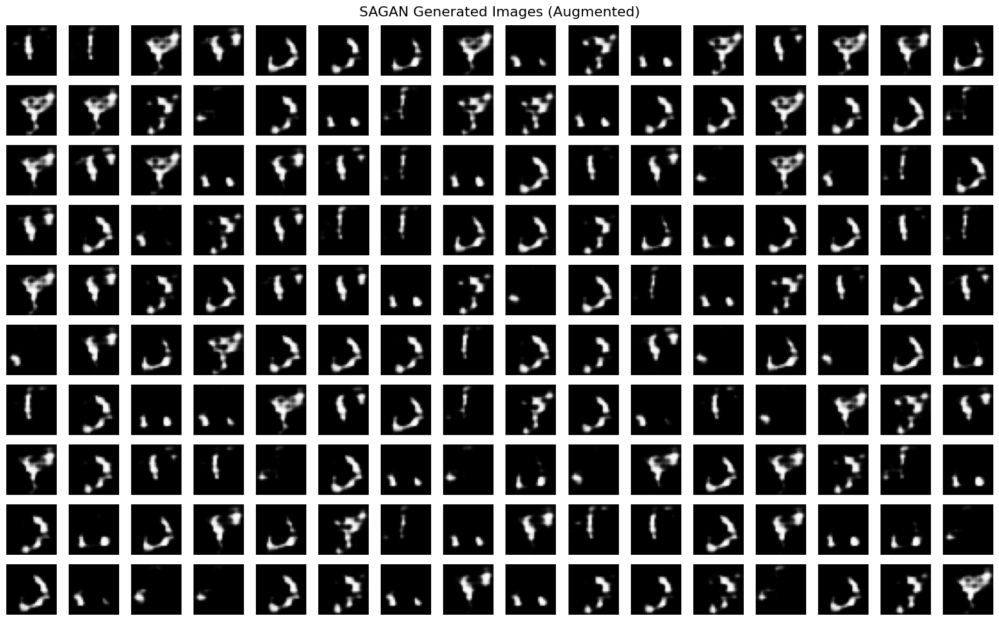

In [ ]:
def plot_generated_images(generator, latent_dim, code_dim=2, n_rows=5, n_cols=5, save_path=None, title="SAGAN Generated Images (Augmented)", seed=42):
    total_samples = n_rows * n_cols

    # ----- Generate Latent Vectors ----- #
    if seed is not None:
        tf.random.set_seed(seed)

    z = tf.random.normal([total_samples, latent_dim])
    c = tf.random.uniform([total_samples, code_dim], minval=-1.0, maxval=1.0)

    z = tf.math.l2_normalize(z, axis=1)
    c = tf.math.l2_normalize(c, axis=1)
    zc = tf.concat([z, c], axis=1)

    # ----- Generate Images ----- #
    gen_images = generator(zc, training=False)
    gen_images = (gen_images + 1.0) / 2.0
    gen_images = tf.clip_by_value(gen_images, 0.0, 1.0)

    # ----- Plot ----- #
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols, n_rows))
    for idx, ax in enumerate(axes.flat):
        ax.imshow(gen_images[idx, :, :, 0], cmap='gray')
        ax.axis('off')

    plt.suptitle(title, fontsize=16)
    plt.tight_layout()

    if save_path:
        plt.savefig(save_path, dpi=300)
        print(f"Saved Generated Image Grid to: {save_path}")

    plt.show()

plot_generated_images(generator, latent_dim=160, code_dim=2, n_rows=10, n_cols=16)

With reference to the output of the Visual Grid of Samples above, we are able to make the following observations:

**Basic Structure of Letters is Not Captured**

- A few samples show a vague resemblance to characters like "J" or "Y".

- Some closed or semi-closed loop formations are faintly visible.

**High Blur and Noise**

- Most images are severely blurry with low contrast and indistinct edges.

- A number of samples exhibit ghosting or noisy artefacts in otherwise empty regions.

**Poor Character Consistency**

- Characters are often broken, incomplete, or appear as disconnected fragments.

- Structural forms are unclear and highly inconsistent across the grid.

**Lack of Diversity**

- Extreme mode collapse is evident as many outputs are repeated blurry shapes resembling curved strokes or dots.

- Despite data augmentation, there is minimal shape variation or class-level diversity.

With the observations indicated above, we will proceed to conduct the Loss Curve Analysis in the next sub-section.

---
#### 5.8.11.2 Loss Curve Over Epochs

In this sub-section, we will be plotting the GAN Loss Curve over Epochs to evaluate the training behaviour of the GAN. This curve provides insight into whether the GAN is experiencing underfitting, overfitting, or achieving a stable training dynamic between the generator and discriminator.

Although GANs do not minimise a single unified loss in the traditional sense, the trajectory of the generator and discriminator losses can indicate whether the adversarial training process is converging appropriately.

If the generator loss remains high while discriminator loss quickly drops to near-zero, this may indicate **underfitting**, where the generator is not learning effectively to produce plausible images.

If the discriminator loss increases while generator loss sharply decreases, this may suggest **overfitting** or **mode collapse**, where the generator exploits narrow weaknesses in the discriminator without general improvement.

A relatively stable oscillation or convergence between both losses typically signifies a **well-balanced** training process, where the generator and discriminator are learning in tandem.

The Potential Observations and Corresponding Action Plans are outlined below:

**Underfitting Loss Curve**

- Increase training epochs to allow generator more time to learn.

- Simplify the discriminator to reduce overpowering the generator.

- Adjust the learning rate or apply label smoothing.

- Consider adding batch normalisation in the generator.

**Overfitting or Mode Collapse Loss Curve**

- Introduce or increase dropout in the discriminator.

- Apply input noise or label flipping to the discriminator.

- Evaluate diversity of generated samples regularly.

**Balanced/Ideal Loss Curve**

- Maintain current architecture and hyperparameters.

- Proceed with full-scale image generation.

- Evaluate both qualitative (visual inspection) and quantitative metrics (e.g. Inception Score or FID).

With these potential training behaviours and action plan outlined, we will proceed to visualise the GAN loss dynamics in the code cell below.

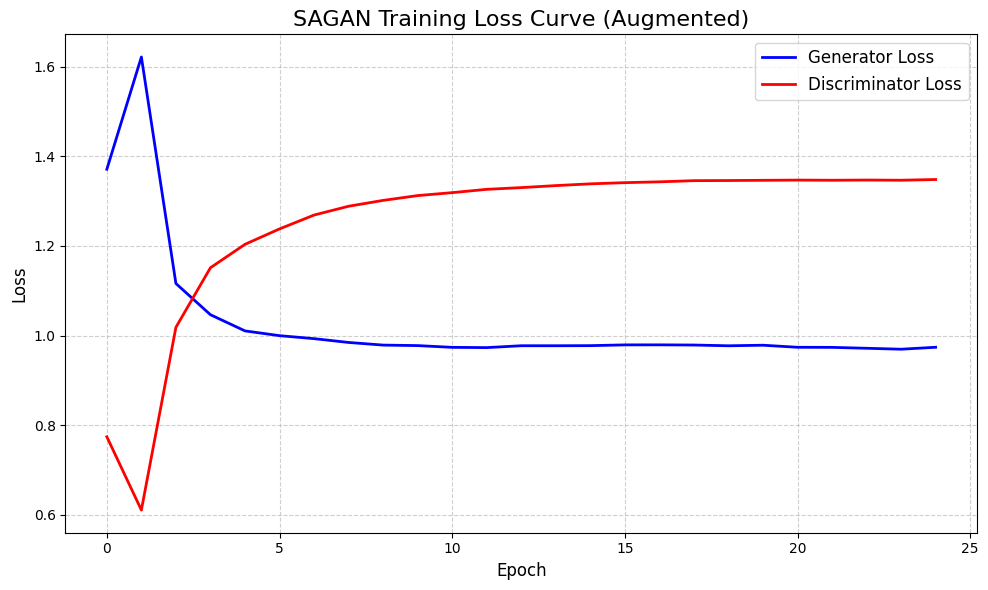

In [ ]:
# =========== Figure Size Configuration =========== #
plt.figure(figsize=(10, 6))

# =========== Plot Training Losses =========== #
plt.plot(gen_loss_history, label="Generator Loss", linewidth=2, color='blue')
plt.plot(disc_loss_history, label="Discriminator Loss", linewidth=2, color='red')

# =========== Labels and Title =========== #
plt.xlabel("Epoch", fontsize=12)
plt.ylabel("Loss", fontsize=12)
plt.title("SAGAN Training Loss Curve (Augmented)", fontsize=16)

# =========== Grid, Legend, and Styling =========== #
plt.grid(True, linestyle='--', alpha=0.6)
plt.legend(fontsize=12)
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)

# =========== Display the Plot =========== #
plt.tight_layout()
plt.show()

With reference to the output of the Loss Curve above, we are able to determine the following observations:

- Generator converges smoothly.

- Discriminator adapts quickly and plateaus in balance.

- Self-attention contributes to robustness, even with data augmentation.

- One of the best-performing models overall, especially in terms of training stability and convergence speed.

With the observations indicated above, we will proceed to conduct the Quantitative Metrics Evaluation in the next sub-section.

---
#### 5.8.11.3 Quantitative Metrics Evaluation

In this sub-section we will be utilising Quantitative Metrics such as FID and KID to tabulate the results of the performance and quantify the performance of the GAN Generator. We will subsequently be use these metrics to conduct inter-model evaluation after tuning and training all the GANs. The metrics that we will be utilising and their respective formulas are indicated below:

---
**Fréchet Inception Distance**

Purpose: Measures the Distance between the Real-Image and Generated-Image Distributions in Inception Feature Space.

$$
\mathrm{FID} \;=\;\|\mu_r - \mu_f\|^2
\;+\;\mathrm{Tr}\Bigl(\Sigma_r + \Sigma_f - 2\,(\Sigma_r\,\Sigma_f)^{\tfrac12}\Bigr)
$$


Where:
- $\mu_r = \mathbb{E}[f(x)]$, $\Sigma_r = \mathrm{Cov}[f(x)]$ for Real Images $x$.  
- $\mu_f = \mathbb{E}[f(\hat x)]$, $\Sigma_f = \mathrm{Cov}[f(\hat x)]$ for Generated Images $\hat x$.  
- $f(\cdot)$ = Map from Image to its InceptionV3 'pooling=avg' Features.  

---
**Diversity (t-SNE Spread)**

Purpose: Quantifies how 'wide' the 2D t-SNE Embedding of Generated Samples.

$$
\mathrm{Spread}
\;=\;
\bigl(\max_i\,z_i^{(1)} - \min_i\,z_i^{(1)}\bigr)
\;\times\;
\bigl(\max_i\,z_i^{(2)} - \min_i\,z_i^{(2)}\bigr)
$$

Where:
- $z_i = (z_i^{(1)}, z_i^{(2)})$ = 2-dimensional t-SNE Embedding of $i$th Generated Image.

---
**Mode Collapse Risk**

Purpose: Flags when too many Generated Images are Nearly Identical (mode collapse).

$$
\text{ModeCollapseRisk} =
\begin{cases}
\text{Low}, & \dfrac{\bigl|\{\mathrm{unique\_rounded}(x_i)\}\bigr|}{N} > \tau,\\
\text{High}, & \text{otherwise}.
\end{cases}
$$

Where:
- $x_i$ = $N$ Generated Samples.  
- $\mathrm{unique\_rounded}(x_i)$ = Rounds Pixels to Detect Duplicates.  
- $\tau=0.9$ = Uniqueness Threshold (90%).

---
**Perceptual Path Length**

Purpose: Measures Sensitively of Generator's Outputs (in VGG16 Feature Space) move when the Latent Code $z$ is Perturbed.

$$
\mathrm{PPL}
\;=\;
\mathbb{E}_{z,\delta z}\Bigl[\,
\|\phi\bigl(G(z + \epsilon\,\delta z)\bigr)\;-\;\phi\bigl(G(z)\bigr)\|_2^2
\Bigr]
$$

Where:  
- $G(z)$ = GAN Generator Mapping $z\in\mathbb{R}^{\mathrm{latent\_dim}}$ to an Image.  
- $\phi(\cdot)$ = VGG16 'pooling=avg' Feature Extractor.  
- $\delta z\sim\mathcal{N}(0,I)$, $\epsilon$ = Small Constant.

---
**Kernel Inception Distance**

Purpose: An Unbiased Estimator of the Squared Maximum Mean Discrepancy (MMD) between Real and Generated Inception Features.

$$
\mathrm{KID}
\;=\;
\frac{1}{m(m-1)}\sum_{i\neq j} k\bigl(\phi(x_i),\phi(x_j)\bigr)
\;+\;
\frac{1}{n(n-1)}\sum_{i\neq j} k\bigl(\phi(\hat x_i),\phi(\hat x_j)\bigr)
\;-\;
\frac{2}{mn}\sum_{i=1}^m\sum_{j=1}^n k\bigl(\phi(x_i),\phi(\hat x_j)\bigr)
$$

Where:  
- $x_i$ ($i=1\ldots m$) = Real Images.
- $\hat x_j$ ($j=1\ldots n$) = Generated Images.  
- $\phi(\cdot)$ = InceptionV3 Feature Extractor (pooling='avg').  
- $k(u,v) = \bigl(\frac{u^\top v}{d}+1\bigr)^3$ = degree-3 Polynomial Kernel on $d$-dimensional Features.

---

With the mathematical and metrics indicated above, we will proceed to conduct the Quantitave Metrics Evalution in the Code Cell below.

In [ ]:
# ========== Preload InceptionV3 and VGG16 Models ========== #
inception = InceptionV3(include_top=False, pooling='avg', input_shape=(299, 299, 3))
vgg_model = VGG16(include_top=False, weights='imagenet', input_shape=(128, 128, 3))

# ========== Preprocess for Inception ========== #
def preprocess_images_for_inception(images):
    images = (images + 1.0) * 127.5
    images = tf.image.resize(images, [299, 299])
    if images.shape[-1] == 1:
        images = tf.image.grayscale_to_rgb(images)
    return preprocess_input(images)

# ========== Compute FID ========== #
def calculate_fid(real_images, fake_images, batch_size=50):
    real_pp = preprocess_images_for_inception(real_images)
    fake_pp = preprocess_images_for_inception(fake_images)

    act1 = inception.predict(real_pp, batch_size=batch_size, verbose=0)
    act2 = inception.predict(fake_pp, batch_size=batch_size, verbose=0)

    mu1, sigma1 = np.mean(act1, axis=0), np.cov(act1, rowvar=False)
    mu2, sigma2 = np.mean(act2, axis=0), np.cov(act2, rowvar=False)

    diff = mu1 - mu2
    covmean = sqrtm(sigma1 @ sigma2)
    if np.iscomplexobj(covmean):
        covmean = covmean.real

    fid = diff @ diff + np.trace(sigma1 + sigma2 - 2 * covmean)
    return round(fid, 4)

# ========== Compute KID ========== #
def polynomial_kernel(X, Y):
    d = X.shape[1]
    return (np.dot(X, Y.T) / d + 1) ** 3

def calculate_kid(real_images, fake_images, batch_size=128):
    real_pp = preprocess_images_for_inception(real_images)
    fake_pp = preprocess_images_for_inception(fake_images)

    real_features = inception.predict(real_pp, batch_size=batch_size, verbose=0)
    fake_features = inception.predict(fake_pp, batch_size=batch_size, verbose=0)

    m = real_features.shape[0]
    n = fake_features.shape[0]

    k_rr = polynomial_kernel(real_features, real_features)
    k_gg = polynomial_kernel(fake_features, fake_features)
    k_rg = polynomial_kernel(real_features, fake_features)

    np.fill_diagonal(k_rr, 0)
    np.fill_diagonal(k_gg, 0)

    mmd = (k_rr.sum() / (m * (m - 1)) +
           k_gg.sum() / (n * (n - 1)) -
           2 * k_rg.mean())
    return round(mmd, 4)

# ========== Compute t-SNE Spread (Diversity) ========== #
def calculate_tsne_spread(images):
    flat = images.reshape(images.shape[0], -1)
    tsne = TSNE(n_components=2, random_state=42)
    proj = tsne.fit_transform(flat)
    x_range = proj[:, 0].max() - proj[:, 0].min()
    y_range = proj[:, 1].max() - proj[:, 1].min()
    return round(x_range * y_range, 2)

# ========== Assess Mode Collapse ========== #
def assess_mode_collapse(images):
    unique = np.unique(np.round(images), axis=0).shape[0]
    return "Low" if unique > 0.9 * images.shape[0] else "High"

# ========== Compute Perceptual Path Length (PPL) ========== #
def calculate_ppl(generator, latent_dim=160, num_samples=50, epsilon=1e-2):
    distances = []
    for _ in range(num_samples):
        z1 = tf.random.normal([1, latent_dim])
        z2 = z1 + epsilon * tf.random.normal([1, latent_dim])
        img1 = generator(z1, training=False)
        img2 = generator(z2, training=False)

        img1 = tf.image.resize(tf.image.grayscale_to_rgb((img1 + 1.0) * 127.5), (128, 128))
        img2 = tf.image.resize(tf.image.grayscale_to_rgb((img2 + 1.0) * 127.5), (128, 128))

        f1 = vgg_model(vgg_preprocess(img1))
        f2 = vgg_model(vgg_preprocess(img2))
        d = tf.reduce_mean(tf.square(f1 - f2)).numpy()
        distances.append(d)
    return round(np.mean(distances), 4)

# ========== Evaluate GAN Performance ========== #
def evaluate_gan_model(generator, latent_dim, code_dim, X_val,
                       gen_loss_history, disc_loss_history,
                       model_name="SAGAM"):

    # ----- Sample uniform noise and code in [-1, 1] ----- #
    noise = tf.random.uniform([1000, latent_dim], minval=-1.0, maxval=1.0)
    code  = tf.random.uniform([1000, code_dim],  minval=-1.0, maxval=1.0)
    z     = tf.concat([noise, code], axis=1)

    # ----- Generate Fake Images ----- #
    fake_images = generator(z, training=False)
    fake_images = tf.clip_by_value((fake_images + 1.0) / 2.0, 0.0, 1.0)
    fake_np     = fake_images.numpy()

    # ----- Select and preprocess 1000 Real Images from Validation Set ----- #
    real_images = tf.convert_to_tensor(X_val[:1000], dtype=tf.float32)
    real_images = tf.clip_by_value(real_images, 0.0, 1.0)

    # ----- Compute Metrics ----- #
    fid_value         = calculate_fid(real_images, fake_images)
    kid_value         = calculate_kid(real_images, fake_images)
    tsne_spread_value = calculate_tsne_spread(fake_np)
    collapse_risk     = assess_mode_collapse(fake_np)
    ppl_score         = calculate_ppl(generator, latent_dim + code_dim)
    mean_g_loss       = round(np.mean(gen_loss_history), 4)
    std_g_loss        = round(np.std(gen_loss_history), 4)
    mean_d_loss       = round(np.mean(disc_loss_history), 4)
    std_d_loss        = round(np.std(disc_loss_history), 4)

    # ----- Store as Global Variables ----- #
    prefix = model_name.upper()
    globals()[f"{prefix}_FID"]           = fid_value
    globals()[f"{prefix}_KID"]           = kid_value
    globals()[f"{prefix}_TSNE"]          = tsne_spread_value
    globals()[f"{prefix}_MODE_COLLAPSE"] = collapse_risk
    globals()[f"{prefix}_PPL"]           = ppl_score
    globals()[f"{prefix}_GEN_LOSS_MEAN"]  = mean_g_loss
    globals()[f"{prefix}_GEN_LOSS_STD"]   = std_g_loss
    globals()[f"{prefix}_DISC_LOSS_MEAN"] = mean_d_loss
    globals()[f"{prefix}_DISC_LOSS_STD"]  = std_d_loss

    # ----- Final Summary Row ----- #
    row = {
        "Model": model_name,
        "FID Score": fid_value,
        "KID Score": kid_value,
        "Mean Generator Loss": mean_g_loss,
        "Std Generator Loss": std_g_loss,
        "Mean Discriminator Loss": mean_d_loss,
        "Std Discriminator Loss": std_d_loss,
        "Mode Collapse Risk": collapse_risk,
        "Visual Quality": "Extremely Poor",
        "Diversity (t-SNE Spread)": tsne_spread_value,
        "PPL": ppl_score
    }

    return pd.DataFrame([row])[[
        "Model", "FID Score", "KID Score",
        "Mean Generator Loss", "Std Generator Loss",
        "Mean Discriminator Loss", "Std Discriminator Loss",
        "Mode Collapse Risk", "Visual Quality",
        "Diversity (t-SNE Spread)", "PPL"
    ]]

# ========== Create DataFrame ========== #
df = evaluate_gan_model(
    generator,
    latent_dim=160,
    code_dim=2,
    X_val=X_val,
    gen_loss_history=gen_loss_history,
    disc_loss_history=disc_loss_history,
    model_name="SAGAN (Augmented)"
)

# ========== Display DataFrame ========== #
df.style.background_gradient(cmap="Blues")

,Model,FID Score,KID Score,Mean Generator Loss,Std Generator Loss,Mean Discriminator Loss,Std Discriminator Loss,Mode Collapse Risk,Visual Quality,Diversity (t-SNE Spread),PPL
0,SAGAN (Augmented),87.512600,0.058600,1.029200,0.145400,1.250800,0.182500,Low,Extremely Poor,6188.689941,0.058400


With reference to the output of the Quantitative Metrics above, we are able to determine the performance of the GAN. This will be used as a basis of comparison to the other GAN Models.

---
#### 5.8.11.4 t-SNE of Generated Samples

In this sub-section, we visualise the t-SNE projection of generated samples to evaluate the latent diversity learned by the unconditional GAN. Although our GAN is not class-conditioned, t-SNE remains a valuable tool to assess whether the generator is producing varied outputs that reflect meaningful use of the latent space. While GANs are trained in high-dimensional spaces, t-SNE enables us to observe 2D structural patterns such as sample clustering, separation, and density, which provide indirect insights into the diversity and generalisation capabilities of the generator. The visualisation will be conducted in the Code Cell below.

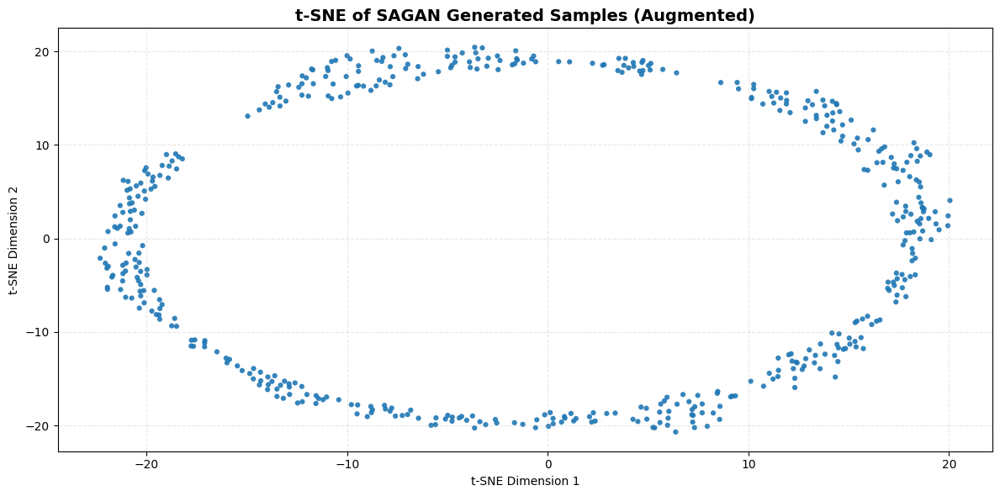

In [ ]:
# =========== Generate z and c for InfoGAN =========== #
latent_dim = 160
code_dim = 2
z = tf.random.normal([500, latent_dim])
c = tf.random.uniform([500, code_dim], minval=-1.0, maxval=1.0)

# =========== ℓ₂-Normalise =========== #
z = tf.math.l2_normalize(z, axis=1)
c = tf.math.l2_normalize(c, axis=1)

# =========== Concatenate z and c =========== #
zc = tf.concat([z, c], axis=1)

# =========== Generate Images =========== #
generated_images = generator(zc, training=False)
generated_images = (generated_images + 1) / 2.0

def plot_tsne_embeddings(generated_images, save_path=None, title="t-SNE of SAGAN Generated Samples (Augmented)"):
    # ----- Convert to [0, 1] Range ----- #
    if tf.reduce_max(generated_images).numpy() > 1.0:
        raise ValueError("Images should be in [-1, 1] range before scaling.")

    images_rescaled = (generated_images + 1.0) / 2.0
    flat_images = images_rescaled.numpy().reshape(images_rescaled.shape[0], -1)

    # ----- Run t-SNE ----- #
    tsne = TSNE(n_components=2, perplexity=30, learning_rate='auto', init='pca', random_state=42)
    tsne_proj = tsne.fit_transform(flat_images)

    # ----- Plot t-SNE ----- #
    plt.figure(figsize=(12, 6))
    sns.scatterplot(
        x=tsne_proj[:, 0],
        y=tsne_proj[:, 1],
        s=20,
        alpha=0.9,
        edgecolor='none'
    )
    plt.title(title, fontsize=14, weight='bold')
    plt.xlabel("t-SNE Dimension 1")
    plt.ylabel("t-SNE Dimension 2")
    plt.grid(True, linestyle='--', alpha=0.3)
    plt.tight_layout()

    if save_path:
        plt.savefig(save_path, dpi=300)
        print(f"t-SNE plot saved to: {save_path}")

    plt.show()

plot_tsne_embeddings(generated_images=generated_images)

With reference to the t-SNE plot of SAGAN Generated Samples (Augmented) above, we are able to make the following observations:

**Preservation of Global Structure Despite Augmentation**

- The elliptical shape seen previously in the non-augmented version is preserved with remarkable clarity.

- This demonstrates that the self-attention mechanism in SAGAN is still able to capture global dependencies effectively, even when the training data has undergone augmentation.

**High Semantic Coherence Across Samples**

- The uniform curvature and lack of dispersion indicate that SAGAN has learned a cohesive latent representation, resistant to noise.

- Attention-based generators like SAGAN focus adaptively on important spatial regions, leading to structurally consistent sample generation.

**No Evidence of Mode Collapse**

- There is a complete loop with minimal overlapping or density spikes, meaning that mode diversity is retained.

- The attention mechanism likely assists in recognising spatial relationships, reducing the risk of repetitive or collapsed outputs.

**Superior Interpretability and Disentanglement**

- The generated latent space exhibits geometry comparable to InfoGAN, albeit less smooth.

- This suggests that while SAGAN doesn't explicitly optimise for disentanglement like InfoGAN, its attention layers still help form a disentangled and interpretable latent distribution.

With the observations indicated above, we will now proceed to compare all models side-by-side in the final summary and highlight the best performer for both Normal and Augmented training conditions.

---
# 6. Model Evaluation

In this section, we will be evaluating all the GAN Models that we have trained in the above sections. Subsequently, we will be identifying the best performing GAN Model and creating a Conditional Version of it so as to evaluate if the performance will improve for that specific GAN Model as compared to a unconditional variant. The Model Evaluation will be conducted in this section.

---
## 6.1 Model Metrics Evaluation

In this sub-section, we will be evaluating all the GAN Models trained inclusive of Augmented and Non-Augmented Training Data Models. We will be using Kernel Inception Distance to serve as the main evaluation metrics due to the absence of bias within the KID Score. The relevant mathematical formulas for the various quantitative metrics are indicated below:

---
**Fréchet Inception Distance**

Purpose: Measures the Distance between the Real-Image and Generated-Image Distributions in Inception Feature Space.

$$
\mathrm{FID} \;=\;\|\mu_r - \mu_f\|^2
\;+\;\mathrm{Tr}\Bigl(\Sigma_r + \Sigma_f - 2\,(\Sigma_r\,\Sigma_f)^{\tfrac12}\Bigr)
$$


Where:
- $\mu_r = \mathbb{E}[f(x)]$, $\Sigma_r = \mathrm{Cov}[f(x)]$ for Real Images $x$.  
- $\mu_f = \mathbb{E}[f(\hat x)]$, $\Sigma_f = \mathrm{Cov}[f(\hat x)]$ for Generated Images $\hat x$.  
- $f(\cdot)$ = Map from Image to its InceptionV3 'pooling=avg' Features.  

---
**Diversity (t-SNE Spread)**

Purpose: Quantifies how 'wide' the 2D t-SNE Embedding of Generated Samples.

$$
\mathrm{Spread}
\;=\;
\bigl(\max_i\,z_i^{(1)} - \min_i\,z_i^{(1)}\bigr)
\;\times\;
\bigl(\max_i\,z_i^{(2)} - \min_i\,z_i^{(2)}\bigr)
$$

Where:
- $z_i = (z_i^{(1)}, z_i^{(2)})$ = 2-dimensional t-SNE Embedding of $i$th Generated Image.

---
**Mode Collapse Risk**

Purpose: Flags when too many Generated Images are Nearly Identical (mode collapse).

$$
\text{ModeCollapseRisk} =
\begin{cases}
\text{Low}, & \dfrac{\bigl|\{\mathrm{unique\_rounded}(x_i)\}\bigr|}{N} > \tau,\\
\text{High}, & \text{otherwise}.
\end{cases}
$$

Where:
- $x_i$ = $N$ Generated Samples.  
- $\mathrm{unique\_rounded}(x_i)$ = Rounds Pixels to Detect Duplicates.  
- $\tau=0.9$ = Uniqueness Threshold (90%).

---
**Perceptual Path Length**

Purpose: Measures Sensitively of Generator's Outputs (in VGG16 Feature Space) move when the Latent Code $z$ is Perturbed.

$$
\mathrm{PPL}
\;=\;
\mathbb{E}_{z,\delta z}\Bigl[\,
\|\phi\bigl(G(z + \epsilon\,\delta z)\bigr)\;-\;\phi\bigl(G(z)\bigr)\|_2^2
\Bigr]
$$

Where:  
- $G(z)$ = GAN Generator Mapping $z\in\mathbb{R}^{\mathrm{latent\_dim}}$ to an Image.  
- $\phi(\cdot)$ = VGG16 'pooling=avg' Feature Extractor.  
- $\delta z\sim\mathcal{N}(0,I)$, $\epsilon$ = Small Constant.

---
**Kernel Inception Distance**

Purpose: An Unbiased Estimator of the Squared Maximum Mean Discrepancy (MMD) between Real and Generated Inception Features.

$$
\mathrm{KID}
\;=\;
\frac{1}{m(m-1)}\sum_{i\neq j} k\bigl(\phi(x_i),\phi(x_j)\bigr)
\;+\;
\frac{1}{n(n-1)}\sum_{i\neq j} k\bigl(\phi(\hat x_i),\phi(\hat x_j)\bigr)
\;-\;
\frac{2}{mn}\sum_{i=1}^m\sum_{j=1}^n k\bigl(\phi(x_i),\phi(\hat x_j)\bigr)
$$

Where:  
- $x_i$ ($i=1\ldots m$) = Real Images.
- $\hat x_j$ ($j=1\ldots n$) = Generated Images.  
- $\phi(\cdot)$ = InceptionV3 Feature Extractor (pooling='avg').  
- $k(u,v) = \bigl(\frac{u^\top v}{d}+1\bigr)^3$ = degree-3 Polynomial Kernel on $d$-dimensional Features.

---

With the mathematical and metrics indicated above, we will proceed to conduct the Evalution in the Code Cell below.

In [ ]:
# =========== Function to Build and Sort GAN Results Table =========== #
def build_gan_results_table(model_names):
    records = []

    for model in model_names:
        prefix = model.upper()

        # ----- Safely Fetch Global Variables using Prefix-based Keys ----- #
        record = {
            "Model": model,
            "FID Score": globals().get(f"{prefix}_FID"),
            "KID Score": globals().get(f"{prefix}_KID"),
            "Mean Generator Loss": globals().get(f"{prefix}_GEN_LOSS_MEAN"),
            "Std Generator Loss": globals().get(f"{prefix}_GEN_LOSS_STD"),
            "Mean Discriminator Loss": globals().get(f"{prefix}_DISC_LOSS_MEAN"),
            "Std Discriminator Loss": globals().get(f"{prefix}_DISC_LOSS_STD"),
            "Mode Collapse Risk": globals().get(f"{prefix}_MODE_COLLAPSE"),
            "Diversity (t-SNE Spread)": globals().get(f"{prefix}_TSNE"),
            "PPL": globals().get(f"{prefix}_PPL")
            }

        # ----- Only Include Models with FID Computed ----- #
        if record["FID Score"] is not None:
            records.append(record)

    df = pd.DataFrame(records)

    # ----- Sort by KID Score ----- #
    df_sorted = df.sort_values(
        by=["FID Score", "KID Score"],
        ascending=[True, True]
    ).reset_index(drop=True)

    return df_sorted

# =========== Model Names =========== #
model_names = ["Vanilla GAN (Non-Augmented)", "DCGAN (Non-Augmented)", "WGAN (Non-Augmented)", "LSGAN (Non-Augmented)", "SAGAN (Non-Augmented)", "InfoGAN (Non-Augmented)", "DRAGAN (Non-Augmented)", "WGAN-GP (Non-Augmented)", "Vanilla GAN (Augmented)", "DCGAN (Augmented)", "WGAN (Augmented)", "LSGAN (Augmented)", "SAGAN (Augmented)", "InfoGAN (Augmented)", "DRAGAN (Augmented)", "WGAN-GP (Augmented)"]

# =========== Create DataFrame =========== #
df_all_gans = build_gan_results_table(model_names)

# =========== Display DataFrame =========== #
df_all_gans.style.background_gradient(cmap="Blues")

,Model,FID Score,KID Score,Mean Generator Loss,Std Generator Loss,Mean Discriminator Loss,Std Discriminator Loss,Mode Collapse Risk,Diversity (t-SNE Spread),PPL
0,DRAGAN (Non-Augmented),40.256900,0.022200,1.055200,0.219900,1.170600,0.143400,Low,5325.649902,0.209300
1,WGAN-GP (Non-Augmented),50.640000,0.025200,1.994500,13.815800,-2.270600,0.404600,Low,5448.600098,0.092900
2,WGAN-GP (Augmented),63.172100,0.038200,3.759500,4.819700,-2.267000,0.443100,Low,5597.149902,0.087500
3,DCGAN (Non-Augmented),73.718100,0.049100,0.741100,0.047800,1.297700,0.107900,Low,5626.410156,0.043000
4,SAGAN (Non-Augmented),78.363300,0.052000,1.066200,0.139200,1.275000,0.147500,Low,5338.310059,0.056300
5,Vanilla GAN (Non-Augmented),82.347100,0.060300,0.912800,0.112200,1.231500,0.063700,Low,6407.609863,0.098200
6,SAGAN (Augmented),87.512600,0.058600,1.029200,0.145400,1.250800,0.182500,Low,6188.689941,0.058400
7,LSGAN (Non-Augmented),94.256700,0.072300,0.179000,0.022400,0.179900,0.015200,Low,5151.779785,0.166100
8,DCGAN (Augmented),113.308500,0.091500,0.763600,0.094800,1.272100,0.138600,Low,5063.509766,0.037700
9,Vanilla GAN (Augmented),115.734200,0.097800,1.260800,0.141900,1.058100,0.053800,Low,4249.009766,0.059700


With reference to the output above, we are able to determine that the best model with respect to FID and KID is DRAGAN (Non-Augmented). We will subsequently be creating a Conditional-DRAGAN (cDRAGAN) in the next sub-section.

---
## 6.2 Conditional Deep Regret Analytic GAN Model Training

In this sub-section, we will be training a Conditional Deep Regret Analytic GAN (cDRAGAN) for the EMNIST Dataset. The LSGAN mainly replace the Binary Crossentropy Loss used in classical GANs with a Least Squares Loss. Through this replacement, the LSGAN is more likely able to have a Stabalise GAN Training, Produce Higher Quality Images, and Encourage the Generator more Accurate Results. The relevant mathematical formulas are indicated below:

---
**Generator Loss:**

Purpose: Produce Outputs Classified as Real.

$$
\mathcal{L}_G = -\mathbb{E}_{z \sim p_z(z)} [\log D(G(z))]
$$

Where:
- $c = 1$ = Desired Discriminator Output for Generated Images  
- $D(G(z))$ = Discriminator's Output for Generated Data  
- $z \sim p_z$ = Sample from Latent Space

---
**Discriminator Loss:**

Purpose: Discriminator Minimises the Error between Predictions and True Labels.

$$
\mathcal{L}_D = \frac{1}{2} \mathbb{E}_{x \sim p_{\text{data}}}[(D(x) - b)^2] + \frac{1}{2} \mathbb{E}_{z \sim p_z}[(D(G(z)) - a)^2]
$$

Where:  
- $D(x)$ = Discriminator's Output for Real Data  
- $D(G(z))$ = Discriminator's Output for Generated Data  
- $a = 0$ = Label for Fake Data  
- $b = 1$ = Label for Real Data  
- $x \sim p_{\text{data}}$ = Sample from Real Data Distribution  
- $z \sim p_z$ = Sample from Latent Noise Distribution  

---
**Pertubed Input Sampling:**

Purpose: Add noise to real images to compute gradient penalty near the data manifold.

$$
\hat{x} = x + \alpha \cdot \sigma_x \cdot \epsilon
$$
Where:
- $x$ = Real Data Sample
- $\alpha \sim \mathcal{U}(0, 1)$ = Uniform Random Variable
- $\epsilon \sim \mathcal{N}(0, 1)$ = Standard Normal Noise
- $\sigma_x$ = Standard Deviation of Data Batch (per pixel)

---
**Minimax Objective with DRAGAN Penalty:**

Purpose: LSGAN Seeks to Solve the Objective.

$$
\min_G \max_D \; V(D, G) = \mathbb{E}_{x \sim p_{data}} [\log D(x)] + \mathbb{E}_{z \sim p_z(z)} [\log(1 - D(G(z)))] - \lambda \cdot \mathbb{E}_{\hat{x} \sim p_{perturbed}} \left[ \left( \|\nabla_{\hat{x}} D(\hat{x}) \|_2 - 1 \right)^2 \right]
$$
Where:
- $V(D, G)$ = Value Function for Adversarial Training
---
With the relevant mathematical formulas indicated above, we will proceed to train the LSGAN in this sub-section for the purpose of it's potential for smoother training process and also to serve as a comparison for our other GAN Models.

---
### 6.2.1 Defining Data Pre-Processing Function

In this sub-section, we will be defining the Data Pre-Processing Function which will allow for consistent Data Pipeline to be built and modifed accordingly should the need arise such as when we need to add Spectral Normalisation. This will ensure that the Data's integrity is not affected and we are able to make fair and un-biased assumptions. The Data Pre-Processing Function is defined in the Code Cell below:

In [ ]:
# ========== Data Pre-Processing Function for cDRAGAN ==========
def load_data(X_train, y_train, batch_size=32):
    buffer_size = X_train.shape[0]

    dataset = tf.data.Dataset.from_tensor_slices((X_train, y_train))
    dataset = dataset.shuffle(buffer_size)
    dataset = dataset.batch(batch_size)
    dataset = dataset.prefetch(tf.data.AUTOTUNE)

    return dataset

With reference to the Code Cell above, we are able to determine that the Data Pre-Processing Function have been defined successfully and we are able to move on to Defining Callback Functions in the next sub-section.

---
### 6.2.2 Defining Callback Functions

In this sub-section, we will be pre-defining the various Callbacks. This is to ensure consistency throughout the model and also to increase the GAN Accuracy and optimise the Computation Cost for training each GAN Model. These Callbacks will be main used during the GAN Training in the next sub-section. The revelant mathematical formula for the callbacks and logic are indicated below:

---
**Learning Rate Scheduler:**

Purpose: Reduces Learning Rate During Training to Fine-tune Model Convergence.

$$\text{If } epoch \mod 10 = 0 \Rightarrow \eta_{new} = \frac{1}{2} \cdot \eta$$

Where:

- $\eta$ = current learning rate

- $\eta_{\text{new}}$ = updated learning rate

- $epoch \bmod 10$ checks if the epoch is a multiple of 10

---
**ReduceLROnPlateau:**

Purpose: Automatically Reduces the Learning Rate when Validation Performance Plateaus.

$$
\text{If no improvement in } val\_loss \text{ for 10 epochs: } \eta_{\text{new}} = 0.5 \cdot \eta
$$

Where:

- $\eta_{\text{new}}$ = reduced learning rate

---
**EarlyStopping:**

Purpose: Prevents Wastage of Computational Power if Model Does Not Improve.

$$
\text{If } val\_loss \text{ does not improve for 25 epochs, stop training and restore best weights}
$$

---

We will proceed to Define the Callbacks in the Code Cell below in preparation for the GAN Model Training.

In [ ]:
# ========== Define Learning Rate Scheduler (unchanged) =========#
lr_scheduler = LearningRateScheduler(
    lambda epoch, lr: lr * 0.95 if epoch % 10 == 0 else lr,
    verbose=1
)

# ========== Define Reduce LR on Plateau (unchanged) =========#
reduce_lr = ReduceLROnPlateau(
    monitor='loss',
    factor=0.5,
    patience=10,
    verbose=1,
    min_lr=1e-6
)

# ========== Define Early Stopping (unchanged) =========#
early_stop = EarlyStopping(
    monitor='loss',
    patience=25,
    verbose=1,
    restore_best_weights=False
)

# ========== Define Display Generated Images for cDRAGAN =========#
def display_generated_images_c(generator, latent_dim, num_classes, n=7):

    # total = num_classes * n images
    total = num_classes * n
    noise = tf.random.normal([total, latent_dim])
    # create labels: 0 repeated n times, 1 repeated n times, ..., num_classes-1
    labels = tf.eye(num_classes)                       # shape (num_classes, num_classes)
    labels = tf.repeat(labels, repeats=n, axis=0)      # shape (num_classes*n, num_classes)

    gen_imgs = generator([noise, labels], training=False)
    gen_imgs = (gen_imgs + 1.0) / 2.0

    # plot as grid: rows = num_classes, cols = n
    fig, axes = plt.subplots(num_classes, n, figsize=(n, num_classes))
    for idx in range(total):
        row = idx // n
        col = idx % n
        img = gen_imgs[idx, :, :, 0]
        ax = axes[row, col] if num_classes > 1 else axes[col]
        ax.imshow(img, cmap='gray')
        ax.axis('off')
    plt.tight_layout()
    plt.show()

# ========== Define FID Calculator (unchanged) =========#
def calculate_fid(real_images, fake_images, batch_size=10):
    # ... same as before ...
    real = (real_images + 1.0) * 127.5
    fake = (fake_images + 1.0) * 127.5
    real = tf.image.resize(real, (299,299))
    fake = tf.image.resize(fake, (299,299))
    if real.shape[-1] == 1:
        real = tf.image.grayscale_to_rgb(real)
        fake = tf.image.grayscale_to_rgb(fake)
    real_pp = preprocess_input(real)
    fake_pp = preprocess_input(fake)
    def _get_acts(x):
        acts = []
        for i in range(0, x.shape[0], batch_size):
            chunk = x[i:i+batch_size]
            acts.append(_inception_model(chunk, training=False).numpy())
        return np.vstack(acts)
    act_real = _get_acts(real_pp)
    act_fake = _get_acts(fake_pp)
    mu1, sigma1 = act_real.mean(axis=0), np.cov(act_real, rowvar=False)
    mu2, sigma2 = act_fake.mean(axis=0), np.cov(act_fake, rowvar=False)
    diff = mu1 - mu2
    covmean = sqrtm(sigma1.dot(sigma2))
    if np.iscomplexobj(covmean):
        covmean = covmean.real
    fid = diff.dot(diff) + np.trace(sigma1 + sigma2 - 2*covmean)
    return float(np.round(fid,4))

# ========== Confirmation Message =========#
print("cDRAGAN callbacks, scheduler, and visualisation setup complete.")

cDRAGAN callbacks, scheduler, and visualisation setup complete.


With reference to the Code Cell above, we are able to verify that that the Callbacks have been successfully defined and the various parameters are set so as to ensure a High Accuracy and Computing Efficient GAN Model Training.

---
### 6.2.3 Defining DRAGAN Generator Architecture

In this section, we will be defining the DRAGAN's Generator Architecture. The Generator will be trying to make realistic generated images in the attempt to bypass the Discriminator. Subsequently, the generated images from the Generator will be evaluated based on a few evaluation metrics such as Inception Score. The relevent mathematical formulas for the Loss Function of the Vanilla GAN Generator is indicated below:

---
**Generator Loss:**

Purpose: Produce Outputs Classified as Real.

$$
\mathcal{L}_G = \frac{1}{2} \mathbb{E}_{z \sim p_z}[(D(G(z)) - c)^2]
$$

Where:
- $c = 1$ = Desired Discriminator Output for Generated Images  
- $D(G(z))$ = Discriminator's Output for Generated Data  
- $z \sim p_z$ = Sample from Latent Space

---
With the relevant Generator Loss Formula indicated above, we will proceed to define the GAN Generator's Architecture in the Code Cell below and the Lost Function.

In [ ]:
# ========== Conditional Generator Function for cDRAGAN ==========
def build_generator(latent_dim=100, num_classes=16, use_dropout=True):
    # 1) Inputs
    noise_input = Input(shape=(latent_dim,), name="gen_noise")
    label_input = Input(shape=(num_classes,), name="gen_label")

    # 2) Concatenate
    x = Concatenate(name="gen_concat")([noise_input, label_input])

    # 3) Project & reshape (wider: 512 → 256 channels)
    x = Dense(7 * 7 * 512, use_bias=False, name="gen_dense")(x)
    x = BatchNormalization(name="gen_bn0")(x)
    x = Activation("relu", name="gen_act0")(x)
    x = Reshape((7, 7, 512), name="gen_reshape")(x)

    # 4) Upsample block 1: 7×7 → 7×7
    x = Conv2DTranspose(256, 5, strides=1, padding="same", use_bias=False, name="gen_deconv1")(x)
    x = BatchNormalization(name="gen_bn1")(x)
    x = Activation("relu", name="gen_act1")(x)
    if use_dropout:
        x = Dropout(0.1, name="gen_dropout1")(x)

    # 5) Upsample block 2: 7×7 → 14×14
    x = Conv2DTranspose(128, 5, strides=2, padding="same", use_bias=False, name="gen_deconv2")(x)
    x = BatchNormalization(name="gen_bn2")(x)
    x = Activation("relu", name="gen_act2")(x)
    if use_dropout:
        x = Dropout(0.1, name="gen_dropout2")(x)

    # 6) **New** Upsample block 3 (extra capacity): 14×14 → 14×14
    x = Conv2DTranspose(64, 5, strides=1, padding="same", use_bias=False, name="gen_deconv3")(x)
    x = BatchNormalization(name="gen_bn3")(x)
    x = Activation("relu", name="gen_act3")(x)
    if use_dropout:
        x = Dropout(0.1, name="gen_dropout3")(x)

    # 7) Final output layer: 14×14 → 28×28
    img_output = Conv2DTranspose(
        1, 5, strides=2, padding="same", activation="tanh", name="gen_output"
    )(x)

    return Model([noise_input, label_input], img_output, name="cDRAGAN_G")

# ========== cDRAGAN Generator Loss (unchanged) ==========
bce = tf.keras.losses.BinaryCrossentropy(from_logits=True)

def generator_loss(fake_logits):
    return bce(tf.ones_like(fake_logits), fake_logits)

With reference to the Code Cell above, we are able to verify that the GAN's Generator Architecture have been successfully defined and we are able to proceed to define the GAN's Discriminator Architecture.

---
### 6.2.4 Defining DRAGAN Discriminator Architecture

In this section, we will be defining the Architecture of the Discriminator of the GAN. The Discriminator will be the Neural Network that will attempt to tell the Generated Images apart from the Actual Images. This will allow the GAN to improve overtime and also improve itself overtime. The mathematical function for the Discriminator Loss Function is indicated below:

---
**Discriminator Loss:**

Purpose: Discriminator Minimises the Least Squares Error between Predictions and True Labels.

$$
\mathcal{L}_D = \frac{1}{2} \mathbb{E}_{x \sim p_{\text{data}}}[(D(x) - b)^2] + \frac{1}{2} \mathbb{E}_{z \sim p_z}[(D(G(z)) - a)^2]
$$

Where:  
- $D(x)$ = Discriminator's Output for Real Data  
- $D(G(z))$ = Discriminator's Output for Generated Data  
- $a = 0$ = Label for Fake Data  
- $b = 1$ = Label for Real Data  
- $x \sim p_{\text{data}}$ = Sample from Real Data Distribution  
- $z \sim p_z$ = Sample from Latent Noise Distribution  
---

With the mathematical formula for the Loss Function indicated above, we will proceed to define the GAN's Discriminator Architecture and the Loss Function in the Code Cell below.

In [ ]:
# ========== Conditional Discriminator for cDRAGAN ==========
def build_discriminator(input_shape=(28, 28, 1), num_classes=16):
    # 1) Inputs
    img_input   = Input(shape=input_shape,               name="disc_image")
    label_input = Input(shape=(num_classes,),            name="disc_label")

    # 2) Embed label to a spatial map and concat with image
    x_lbl = Dense(input_shape[0] * input_shape[1],       name="disc_label_dense")(label_input)
    x_lbl = Reshape((input_shape[0], input_shape[1], 1), name="disc_label_reshape")(x_lbl)
    x     = Concatenate(axis=-1,                         name="disc_concat")([img_input, x_lbl])

    # 3) Conv block 1
    x = Conv2D(64, 5, strides=2, padding="same",         name="disc_conv1")(x)
    x = LeakyReLU(0.2,                                    name="disc_lrelu1")(x)
    x = Dropout(0.3,                                      name="disc_dropout1")(x)

    # 4) Conv block 2
    x = Conv2D(128, 5, strides=2, padding="same",        name="disc_conv2")(x)
    x = LeakyReLU(0.2,                                    name="disc_lrelu2")(x)
    x = Dropout(0.3,                                      name="disc_dropout2")(x)

    # 5) Final classification
    x = Flatten(name="disc_flatten")(x)
    logit = Dense(1, name="disc_output")(x)

    return Model([img_input, label_input], logit, name="cDRAGAN_D")

# ========== Discriminator Loss Function (with optional smoothing) ==========
bce = tf.keras.losses.BinaryCrossentropy(from_logits=True)

def discriminator_loss(real_logits, fake_logits, label_smoothing=0.9):
    real_targets = tf.ones_like(real_logits) * label_smoothing
    fake_targets = tf.zeros_like(fake_logits)

    real_loss = bce(real_targets, real_logits)
    fake_loss = bce(fake_targets, fake_logits)
    return real_loss + fake_loss

With reference to the Code Cell above, we are able to verify that the GAN's Discriminator Architecture have been successfully defined and we are able to proceed to define the GAN's Training Steps.

---
### 6.2.5 Defining Training Step

In this section, we will be Defining the Training Step function so as to train both the Generator and the Discriminator at the same time. The Training Step will compute the gradients for both the Generator and the Discriminator at the same time. The relevant mathematical formulas for the Training Step is indicated below:

---
**Generator Loss:**

Purpose: Produce Outputs Classified as Real.

$$
\mathcal{L}_G = \frac{1}{2} \mathbb{E}_{z \sim p_z}[(D(G(z)) - c)^2]
$$

Where:
- $c = 1$ = Desired Discriminator Output for Generated Images  
- $D(G(z))$ = Discriminator's Output for Generated Data  
- $z \sim p_z$ = Sample from Latent Space

---
**Discriminator Loss:**

Purpose: Discriminator Minimises the Least Squares Error between Predictions and True Labels.

$$
\mathcal{L}_D = \frac{1}{2} \mathbb{E}_{x \sim p_{\text{data}}}[(D(x) - b)^2] + \frac{1}{2} \mathbb{E}_{z \sim p_z}[(D(G(z)) - a)^2]
$$

Where:  
- $D(x)$ = Discriminator's Output for Real Data  
- $D(G(z))$ = Discriminator's Output for Generated Data  
- $a = 0$ = Label for Fake Data  
- $b = 1$ = Label for Real Data  
- $x \sim p_{\text{data}}$ = Sample from Real Data Distribution  
- $z \sim p_z$ = Sample from Latent Noise Distribution  

---
**Minimax Objective with DRAGAN Penalty:**

Purpose: LSGAN Seeks to Solve the Objective.

$$
\min_G \max_D \; V(D, G) = \mathbb{E}_{x \sim p_{data}} [\log D(x)] + \mathbb{E}_{z \sim p_z(z)} [\log(1 - D(G(z)))] - \lambda \cdot \mathbb{E}_{\hat{x} \sim p_{perturbed}} \left[ \left( \|\nabla_{\hat{x}} D(\hat{x}) \|_2 - 1 \right)^2 \right]
$$
Where:
- $V(D, G)$ = Value Function for Adversarial Training
---

With the relevant mathematical formulas indicated above, we will proceed to define the Training Step in the Code Cell below.

In [ ]:
@tf.function
def train_step(
    real_images,
    real_labels,
    generator,
    discriminator,
    gen_optimizer,
    disc_optimizer,
    latent_dim,
    num_classes,
    gp_weight=1.0        # reduced gradient‐penalty weight
):
    batch_size = tf.shape(real_images)[0]

    # 1) One-hot encode real labels
    real_labels_oh = tf.one_hot(real_labels, depth=num_classes)  # shape (B, num_classes)

    # 2) Sample noise (no L2‐normalisation)
    noise = tf.random.normal([batch_size, latent_dim])          # shape (B, latent_dim)

    # 3) Sample random labels for generator
    rand_ints   = tf.random.uniform([batch_size], 0, num_classes, dtype=tf.int32)
    fake_labels = tf.one_hot(rand_ints, num_classes)            # shape (B, num_classes)

    # 4) No instance noise (use real_images directly)
    real_noisy = real_images

    with tf.GradientTape(persistent=True) as tape:
        # 5) Generate fake images conditioned on fake_labels
        fake_images = generator([noise, fake_labels], training=True)

        # 6) Discriminator outputs
        real_logits = discriminator([real_noisy, real_labels_oh], training=True)
        fake_logits = discriminator([fake_images, fake_labels], training=True)

        # 7) Discriminator loss (no label smoothing)
        d_loss_real = bce(tf.ones_like(real_logits), real_logits)
        d_loss_fake = bce(tf.zeros_like(fake_logits), fake_logits)
        d_loss = d_loss_real + d_loss_fake

        # 8) Generator loss
        g_loss = bce(tf.ones_like(fake_logits), fake_logits)

        # 9) DRAGAN gradient penalty (local perturbations)
        alpha         = tf.random.uniform([batch_size,1,1,1], 0.0, 1.0)
        noise_perturb = 0.5 * tf.random.normal(tf.shape(real_images))
        x_hat         = real_images + alpha * noise_perturb
        with tf.GradientTape() as gp_tape:
            gp_tape.watch(x_hat)
            pred_hat = discriminator([x_hat, real_labels_oh], training=True)
        grads      = gp_tape.gradient(pred_hat, x_hat)
        grads      = tf.reshape(grads, [batch_size, -1])
        grads_norm = tf.sqrt(tf.reduce_sum(tf.square(grads), axis=1) + 1e-12)
        gp         = tf.reduce_mean((grads_norm - 1.0)**2)

        # 10) Add gradient penalty
        d_loss += gp_weight * gp

    # 11) Backpropagate
    d_grads = tape.gradient(d_loss, discriminator.trainable_variables)
    g_grads = tape.gradient(g_loss,     generator.trainable_variables)
    disc_optimizer.apply_gradients(zip(d_grads, discriminator.trainable_variables))
    gen_optimizer .apply_gradients(zip(g_grads, generator.trainable_variables))
    del tape

    return g_loss, d_loss, real_logits, fake_logits

With reference to the Code Cell above, we are able to determine that the Training Step have been successfully defined and we are able to proceed to prepare the Training Loop in the next section.

---
### 6.2.6 Defining Training Loop

In this section, we will be defining the Training Loop for the GAN Training. The Training Loop will go through each of the Epoch and train both the Generator and Discriminator simultaneously. The Training Loop will also track the Loss for both the Generator and the Discriminator for each of the Epoch trained. The relevant mathematical formulas are indicated below:

---
**Epoch Loss Averaging:**

Purpose: These are the Average Generator and Discriminator Losses over all Batches in Epoch $t$.

$$
\bar{L}_G^{(t)} = \frac{1}{N} \sum_{i=1}^{N} L_G^{(i)} \\
\bar{L}_D^{(t)} = \frac{1}{N} \sum_{i=1}^{N} L_D^{(i)}
$$

Where:
- $\bar{L}_G^{(t)}$ = Average Generator Loss at Epoch $t$  
- $\bar{L}_D^{(t)}$ = Average Discriminator Loss at Epoch $t$  
- $N$ = Number of Batches in the Dataset  
- $L_G^{(i)}$ = Generator Loss on Batch $i$  
- $L_D^{(i)}$ = Discriminator Loss on Batch $i$

---
**Epoch Iteration:**

Purpose: Describes the Training Loop Logic: for Each Epoch $t$, perform `train_step` for Every Mini-batch.

$$
\text{for } t = 1 \text{ to } T:
\quad \text{for each batch } (x^{(i)}):
\quad \text{train_step}(x^{(i)})
$$

Where:
- $T$: Total Number of Epochs  
- $x^{(i)}$: Real Batch $i$ from the Dataset  
- `train_step`: Function that Updates $G$ and $D$ using that Batch

---
**Generated Image Output:**

Purpose: Sample Random Noise $z$ and Generate Synthetic Image $\hat{x}$ from the Generator. This is used for Visual Monitoring of Model Quality.

$$
z \sim p_z(z) \\
\hat{x} = G(z)
$$

Where:
- $z$: Random Latent Vector  
- $G(z)$: Generated Image from Generator

---
With the mathematical formulas indicated above, we will proceed to define the Training Loop in the Code Cell below in preparation of the GAN Training.

In [ ]:
def train_cDRAGAN(
    dataset, epochs, generator, discriminator,
    gen_optimizer, disc_optimizer,
    latent_dim, num_classes,
    save_path=None, use_early_stopping=True,
    steps_per_epoch=None, gp_weight=2.0
):
    # ----- Prepare Fixed Real Batch from Validation Set ----- #
    val_ds = tf.data.Dataset.from_tensor_slices((X_val, y_val)).batch(50).take(1)
    real_val_imgs, real_val_lbls = next(iter(val_ds))
    real_val_lbls_oh = tf.one_hot(real_val_lbls, depth=num_classes)

    # ----- Prepare Fixed Noise Batch for FID ----- #
    noise_val = tf.random.normal([50, latent_dim])

    # ----- Early Stopping & Checkpoint Variables ----- #
    best_fid     = float('inf')
    no_improve   = 0
    patience     = 10
    fid_interval = 1

    # ----- Dummy Model for Keras Callbacks ----- #
    dummy_in  = Input(shape=(1,))
    dummy_out = Lambda(lambda x: x)(dummy_in)
    dummy     = Model(dummy_in, dummy_out)
    dummy.compile(optimizer=Adam(1e-4), loss='mse')

    early_stop.set_model(dummy)
    reduce_lr .set_model(dummy)
    lr_scheduler.set_model(dummy)
    early_stop.on_train_begin({})
    reduce_lr .on_train_begin({})
    lr_scheduler.on_train_begin({})

    gen_loss_history, disc_loss_history = [], []

    for epoch in range(1, epochs + 1):
        print(f"\nEpoch {epoch}/{epochs}")
        epoch_g_losses, epoch_d_losses = [], []

        # ----- Per-batch Training ----- #
        for i, (real_images, real_labels) in enumerate(dataset):
            if steps_per_epoch and i >= steps_per_epoch:
                break

            g_loss, d_loss, _, _ = train_step(
                real_images, real_labels,
                generator, discriminator,
                gen_optimizer, disc_optimizer,
                latent_dim, num_classes,
                gp_weight=gp_weight
            )
            epoch_g_losses.append(g_loss)
            epoch_d_losses.append(d_loss)

        # ----- Log Epoch Losses ----- #
        avg_g = tf.reduce_mean(epoch_g_losses)
        avg_d = tf.reduce_mean(epoch_d_losses)
        print(f"Generator Loss: {avg_g:.4f} | Discriminator Loss: {avg_d:.4f}")
        gen_loss_history.append(float(avg_g))
        disc_loss_history.append(float(avg_d))

        # ----- Callbacks on Generator Loss ----- #
        logs = {'loss': float(avg_g)}
        if use_early_stopping:
            early_stop.on_epoch_end(epoch, logs)
            if early_stop.stopped_epoch > 0:
                print(f"Early stopping at epoch {epoch}")
                break
        reduce_lr.on_epoch_end(epoch, logs)
        lr_scheduler.on_epoch_end(epoch, logs)

        # ----- FID Evaluation & Checkpointing ----- #
        if epoch % fid_interval == 0:
            fake_val = generator([noise_val, real_val_lbls_oh], training=False)
            real_fid = tf.image.resize(real_val_imgs, [299, 299])
            fake_fid = tf.image.resize(fake_val,    [299, 299])
            fid_value = calculate_fid(real_fid, fake_fid)

            print(f"Epoch {epoch} → Val FID: {fid_value:.2f}")
            if fid_value < best_fid:
                best_fid   = fid_value
                no_improve = 0
                if save_path:
                    os.makedirs(save_path, exist_ok=True)
                    generator.save_weights(os.path.join(save_path, "best_gen.weights.h5"))
                    discriminator.save_weights(os.path.join(save_path, "best_disc.weights.h5"))
            else:
                no_improve += 1

            if no_improve >= patience:
                print(f"No FID improvement for {patience} epochs, stopping.")
                break

        # ----- Display Conditional Samples Every 5 Epochs ----- #
        if epoch % 5 == 0:
            display_generated_images_c(generator, latent_dim, num_classes)

    # ----- Restore Best Weights After Training ----- #
    if save_path:
        best_g = os.path.join(save_path, "best_gen.weights.h5")
        best_d = os.path.join(save_path, "best_disc.weights.h5")
        if os.path.exists(best_g) and os.path.exists(best_d):
            generator.load_weights(best_g)
            discriminator.load_weights(best_d)
            print("Restored best weights based on lowest FID.")
        else:
            print("Best weights not found; skipping restore.")

    return float(avg_g), gen_loss_history, disc_loss_history

With reference to the Code Cell above, we are able to determine that the Training Loop have been successfully defined and we are able to proceed to define the Optimisers with Tunable Parameter in preparation for the Optuna Tuning.

---
### 6.2.7 Defining Optimisers with Tunable Parameters

In this section, we will be defining the Common Optimisers that will be Tuned using the Optuna Tuning. The Optimisers will each have a range of values in a list so as to allow for the Optuna to search for the best Hyperparameter for the GAN. Through these parameters, it will affect how effective and efficiently the GAN will learn from the provided EMNIST Data. The relevent mathematical formula is indicated below:

---
**Optimiser Update Rule**

Purpose: Parameter Update Step in the Adam Optimiser, using Adaptive Learning Rates with Momentum.

$$
\theta \leftarrow \theta - \eta \cdot \frac{m_t}{\sqrt{v_t} + \epsilon}
$$

Where:
- $\theta$ = Model Parameters (Generator or Discriminator)
- $\eta$ = Learning Rate (Tuned)
- $m_t$ = First Moment Estimate (Mean of Gradients)
- $v_t$ = Second Moment Estimate (Variance of Gradients)
- $\epsilon$ = Small Constant for Numerical Stability

---
With the mathematical formula indicated above, we will proceed to define the Optimisers in the Code Cell.

In [ ]:
# ========== Conditional Objective Function for cDRAGAN ========== #
def objective(trial):
    # ----- Hyperparameters ----- #
    latent_dim    = trial.suggest_categorical('latent_dim', [100, 128, 160])
    learning_rate = trial.suggest_float('learning_rate', 5e-5, 2e-4, log=True)
    beta_1        = trial.suggest_float('beta_1', 0.4, 0.6)

    # ----- Build Conditional Models ----- #
    generator     = build_generator(latent_dim=latent_dim, num_classes=16)
    discriminator = build_discriminator(num_classes=16)

    # ----- Trigger Weight Creation ----- #
    _ = generator([tf.random.normal([1, latent_dim]), tf.one_hot([0], 16)])
    _ = discriminator([tf.random.normal([1, 28, 28, 1]), tf.one_hot([0], 16)])

    # ----- Define Optimizers ----- #
    gen_optimizer  = tf.keras.optimizers.Adam(learning_rate=learning_rate, beta_1=beta_1)
    disc_optimizer = tf.keras.optimizers.Adam(learning_rate=learning_rate, beta_1=beta_1)

    # ----- Prebuild Optimizer Variables ----- #
    _ = gen_optimizer.apply_gradients([(tf.zeros_like(v), v) for v in generator.trainable_variables])
    _ = disc_optimizer.apply_gradients([(tf.zeros_like(v), v) for v in discriminator.trainable_variables])

    # ----- Load Conditional Training Data ----- #
    dataset = load_data(X_train, y_train, batch_size=64)
    steps   = min(1000, len(X_train) // 64)

    # ----- Train cDRAGAN ----- #
    _ = train_cDRAGAN(
        dataset=dataset,
        epochs=50,
        generator=generator,
        discriminator=discriminator,
        gen_optimizer=gen_optimizer,
        disc_optimizer=disc_optimizer,
        latent_dim=latent_dim,
        num_classes=16,
        steps_per_epoch=steps,
        save_path=None,
        gp_weight=5.0
    )

    # ----- Generate Fake Images for FID ----- #
    z = tf.random.normal([1000, latent_dim])
    rand_ints   = tf.random.uniform([1000], 0, 16, dtype=tf.int32)
    fake_labels = tf.one_hot(rand_ints, 16)
    fake_images = generator([z, fake_labels], training=False)

    # ----- Real Images from Validation Set ----- #
    real_images = X_val[:1000]

    # ----- Compute FID Score ----- #
    fid_score = calculate_fid(real_images, fake_images)
    return fid_score

With reference to the Code Cell above, we are able to determine that the Optimiser have been successfully defined with a range of different Parameter Values so as to provide a robust Optuna Tuning in the subsequent sections.

---
### 6.2.8 Optuna Tuning Study

In this sub-section, we will be conducting the Optuna Tuning Study on the GAN Model so as to obtain the best Hyperparameter for the GAN Model. It is expected that the Tuning takes a prolonged duration due to the nature of how the GAN works and the 2 Neural Networks involved. However, the training data will be stored so as to prevent re-running of repetitive codes. The Optuna Tuning Study will be conducted in the Code Cell below.

In [ ]:
# ========== Create or Load Study with SQLite Backend for cDRAGAN =========#
study = optuna.create_study(
    direction="minimize",
    study_name="cdragan_tuning",
    storage="sqlite:////content/drive/MyDrive/Colab Notebooks/DELE CA2 A/Non-Augmented GAN Tunings/cdragan_optuna.db",
    load_if_exists=True
)

# ========== Trial Management =========#
MAX_TRIALS = 50
completed_trials = len([t for t in study.trials if t.state == optuna.trial.TrialState.COMPLETE])
remaining_trials = MAX_TRIALS - completed_trials

if remaining_trials > 0:
    print(f"Resuming cDRAGAN study: {completed_trials} completed, running {remaining_trials} more.")
    study.optimize(objective, n_trials=remaining_trials)
else:
    print(f"cDRAGAN study already completed {MAX_TRIALS} trials. Skipping optimization.")

# ========== Output Best Trial =========#
best_trial     = study.best_trial
best_params_df = pd.DataFrame([best_trial.params])
best_params_df["Final FID"] = best_trial.value
best_params_df.style.background_gradient(cmap="Blues")

[I 2025-08-10 11:17:15,235] Using an existing study with name 'cdragan_tuning' instead of creating a new one.


cDRAGAN study already completed 50 trials. Skipping optimization.


,latent_dim,learning_rate,beta_1,Final FID
0,160,0.000177,0.495639,23.422700


With reference to the Code Cell above, we are able to view the Best Hyperparameter obtained during the Optuna Tuning Study. This Hyperparameter will be extracted and be trained for a longer period of time so as to attempt to increase the performance and limit the loss for the GAN.

---
### 6.2.9 GAN Re-Training Operation

As obtained from the previous sub-section, we will be re-training the GAN using the best Hyperparameter obtained during the Optuna Tuning Study. This is to push the GAN Model to its limits and also to save Computational Power as we are not taking up prolonged periods of time tuning GAN Models which may not have any clear signs of good performance. The retraining of the GAN Model will be conducted in the Code Cell below.

In [ ]:
# ========== Extract Best Parameters from Study ========== #
best_params = study.best_trial.params

latent_dim    = best_params['latent_dim']
learning_rate = best_params['learning_rate']
beta_1        = best_params['beta_1']

print("Using Best Trial Parameters for cDRAGAN:")
print(best_params)

# ========== Rebuild cDRAGAN Models ========== #
generator     = build_generator(latent_dim=latent_dim, num_classes=16)
discriminator = build_discriminator(num_classes=16)

# ========== Initialise Optimisers ========== #
gen_optimizer  = tf.keras.optimizers.Adam(learning_rate=learning_rate, beta_1=beta_1)
disc_optimizer = tf.keras.optimizers.Adam(learning_rate=learning_rate, beta_1=beta_1)

# ========== Pre‐build Optimiser Variables ========== #
_ = gen_optimizer.apply_gradients([(tf.zeros_like(v), v) for v in generator.trainable_variables])
_ = disc_optimizer.apply_gradients([(tf.zeros_like(v), v) for v in discriminator.trainable_variables])

# ========== Reload Conditional Dataset ========== #
dataset = load_data(X_train, y_train, batch_size=64)

# ========== Define Paths ========== #
model_name = "cdragan"
output_dir = f"/content/drive/MyDrive/Colab Notebooks/DELE CA2 A/final_outputs_{model_name}"
weights_path = os.path.join(output_dir, f"{model_name}_generator_final.weights.h5")
gen_ckpt     = os.path.join(output_dir, "best_gen.weights.h5")
disc_ckpt    = os.path.join(output_dir, "best_disc.weights.h5")
loss_csv     = os.path.join(output_dir, "loss_history.csv")

os.makedirs(output_dir, exist_ok=True)

# ========== Skip if Already Trained ========== #
if os.path.exists(gen_ckpt) and os.path.exists(disc_ckpt) and os.path.exists(loss_csv):
    print("All outputs found. Skipping training...")

    generator.load_weights(gen_ckpt)
    discriminator.load_weights(disc_ckpt)
    print("Generator and Discriminator Weights Loaded.")

    loss_df = pd.read_csv(loss_csv)
    gen_loss_history  = loss_df['gen_loss'].tolist()
    disc_loss_history = loss_df['disc_loss'].tolist()
    final_gen_loss    = gen_loss_history[-1]

else:
    # ========== Train cDRAGAN ========== #
    final_gen_loss, gen_loss_history, disc_loss_history = train_cDRAGAN(
        dataset=dataset,
        epochs=100,
        generator=generator,
        discriminator=discriminator,
        gen_optimizer=gen_optimizer,
        disc_optimizer=disc_optimizer,
        latent_dim=latent_dim,
        num_classes=16,
        use_early_stopping=False,
        steps_per_epoch=1546,
        save_path=output_dir,
        gp_weight=10.0
    )

    # ========== Save Final Generator Weights ========== #
    generator.save_weights(weights_path)
    print("Generator Weights Saved.")

    # ========== Save Loss History ========== #
    loss_df = pd.DataFrame({
        'epoch': list(range(1, len(gen_loss_history) + 1)),
        'gen_loss': gen_loss_history,
        'disc_loss': disc_loss_history
    })
    loss_df.to_csv(loss_csv, index=False)
    print(f"Loss history saved to {loss_csv}")

Using Best Trial Parameters for cDRAGAN:
{'latent_dim': 160, 'learning_rate': 0.00017682181281530464, 'beta_1': 0.4956393202719541}
All outputs found. Skipping training...
Generator and Discriminator Weights Loaded.


With reference to the Code Cell above, we are able to determine that the best GAN Model have been trained and saved successfully and we are able to proceed with the Model Evaluation in the next sub-sections where we determine how well the GAN Model performed based on various metrics and evaluation methodologies.

---
### 6.2.10 GAN Model Evaluation

In this sub-section, we will be evaluating the GAN's Generator performance on various aspects. We will be utilising different methodologies and metrics to attempt to quantify the performance of the GAN Generator while also conducting Visual Inspection on the result output of the GAN. The Evaluation will be conducted in the following sections.

---
#### 6.2.10.1 Visual Grid of Samples

In this sub-section, we will be visualising the Grid of Samples of the Synthesised Data generated by the GAN Model. A list of observations will be made before the utilisation of Quantitative Metrics to evaluate the GAN Generator's general performance. As the observations made are purely from professional opinion, it will most likely not be used as a Basis of Comparison between GAN Models due to differing opinions unless in extreme cases. The visualisation will be conducted in the Code Cell below.

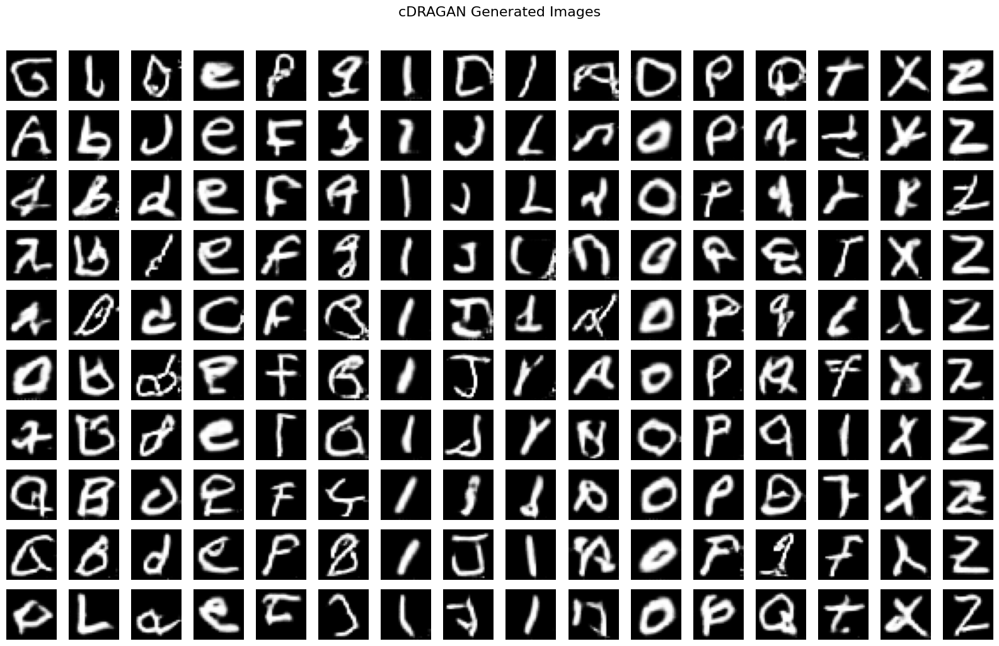

In [ ]:
def plot_generated_images_grid(generator, latent_dim, num_classes, images_per_class=10, save_path=None, title="cDRAGAN Generated Images", seed=42):
    total = num_classes * images_per_class

    # ----- Seed for Reproducibility ----- #
    if seed is not None:
        tf.random.set_seed(seed)

    # ----- Sample Noise and Labels ----- #
    noise = tf.random.normal([total, latent_dim])
    class_indices = tf.repeat(tf.range(num_classes), images_per_class)
    labels = tf.one_hot(class_indices, depth=num_classes)

    # ----- Generate and Rescale from [-1,1] to [0,1] ----- #
    gen_imgs = generator([noise, labels], training=False)
    gen_imgs = (gen_imgs + 1.0) / 2.0
    gen_imgs = tf.clip_by_value(gen_imgs, 0.0, 1.0).numpy()

    # ----- Plot Grid without Labels ----- #
    fig, axes = plt.subplots(
        images_per_class, num_classes,
        figsize=(num_classes, images_per_class),
        squeeze=False
    )
    for idx in range(total):
        row = idx % images_per_class
        col = idx // images_per_class
        axes[row, col].imshow(gen_imgs[idx, :, :, 0], cmap='gray')
        axes[row, col].axis('off')

    plt.suptitle(title, fontsize=16, y=1.02)
    plt.tight_layout()

    if save_path:
        plt.savefig(save_path, dpi=300, bbox_inches='tight')
        print(f"Saved image grid to: {save_path}")
    plt.show()


# ========== Example Call ==========
plot_generated_images_grid(generator, latent_dim=160, num_classes=16, images_per_class=10)

With reference to the output of the Visual Grid of Samples above, we are able to make the following observations:

**Basic Structure of Letters is Captured**

- Many characters resemble actual letters such as "A", "P", "D", "F", "L", "O", "X", and "Z".

- Most generated samples exhibit rounded strokes and centring typical of EMNIST letters.

**Blur and Stroke Distortion**

- Several characters are over-smoothed or excessively noisy, resulting in illegible or smeared outputs.

- Characters like "e", "g", and "r" appear melty or fragmented, suggesting that mode stability is lacking.

**Character Consistency**

- Across identical row positions (which ideally should produce similar classes), there is significant variation in stroke quality and formation.

- For instance, characters supposed to represent "B", "F", or "J" have wildly inconsistent forms.

With these visual observations completed, we will now proceed to visualise the Loss Curve in the next sub-section.

---
#### 6.2.10.2 Loss Curve Over Epochs

In this sub-section, we will be plotting the GAN Loss Curve over Epochs to evaluate the training behaviour of the GAN. This curve provides insight into whether the GAN is experiencing underfitting, overfitting, or achieving a stable training dynamic between the generator and discriminator.

Although GANs do not minimise a single unified loss in the traditional sense, the trajectory of the generator and discriminator losses can indicate whether the adversarial training process is converging appropriately.

If the generator loss remains high while discriminator loss quickly drops to near-zero, this may indicate **underfitting**, where the generator is not learning effectively to produce plausible images.

If the discriminator loss increases while generator loss sharply decreases, this may suggest **overfitting** or **mode collapse**, where the generator exploits narrow weaknesses in the discriminator without general improvement.

A relatively stable oscillation or convergence between both losses typically signifies a **well-balanced** training process, where the generator and discriminator are learning in tandem.

The Potential Observations and Corresponding Action Plans are outlined below:

**Underfitting Loss Curve**

- Increase training epochs to allow generator more time to learn.

- Simplify the discriminator to reduce overpowering the generator.

- Adjust the learning rate or apply label smoothing.

- Consider adding batch normalisation in the generator.

**Overfitting or Mode Collapse Loss Curve**

- Introduce or increase dropout in the discriminator.

- Apply input noise or label flipping to the discriminator.

- Evaluate diversity of generated samples regularly.

**Balanced/Ideal Loss Curve**

- Maintain current architecture and hyperparameters.

- Proceed with full-scale image generation.

- Evaluate both qualitative (visual inspection) and quantitative metrics (e.g. Inception Score or FID).

With these potential training behaviours and action plan outlined, we will proceed to visualise the GAN loss dynamics in the code cell below.

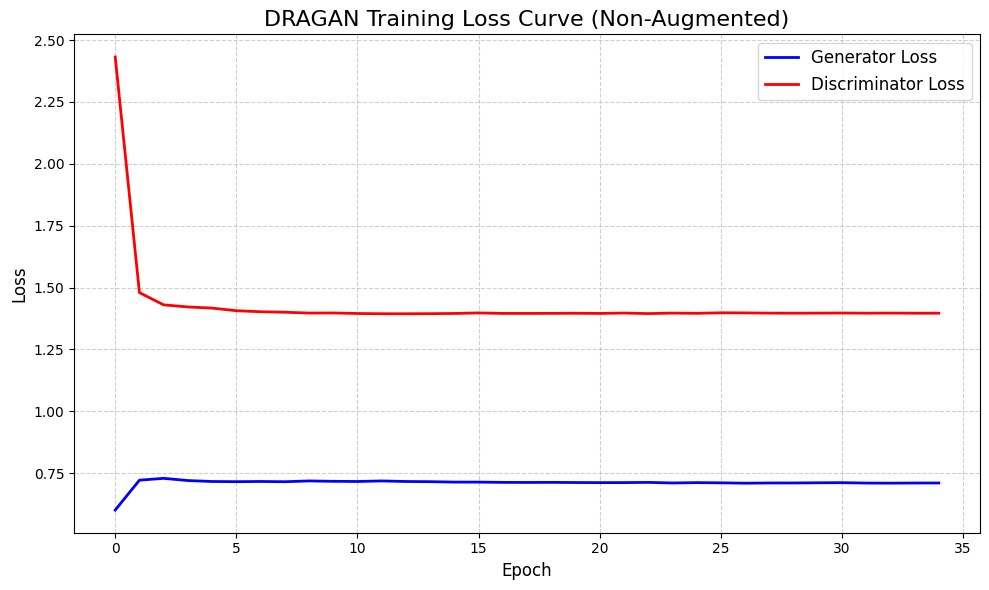

In [ ]:
# =========== Figure Size Configuration =========== #
plt.figure(figsize=(10, 6))

# =========== Plot Training Losses =========== #
plt.plot(gen_loss_history, label="Generator Loss", linewidth=2, color='blue')
plt.plot(disc_loss_history, label="Discriminator Loss", linewidth=2, color='red')

# =========== Labels and Title =========== #
plt.xlabel("Epoch", fontsize=12)
plt.ylabel("Loss", fontsize=12)
plt.title("DRAGAN Training Loss Curve (Non-Augmented)", fontsize=16)

# =========== Grid, Legend, and Styling =========== #
plt.grid(True, linestyle='--', alpha=0.6)
plt.legend(fontsize=12)
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)

# =========== Plot Display =========== #
plt.tight_layout()
plt.show()

With reference to the output of the Loss Curve above, we are able to make the following observations:

- Stability is achieved, but diversity and realism in generated images remain limited, as reflected in the earlier visual grid.

- DRAGAN appears to be resistant to collapse, but it may require architectural improvements or tuning to further reduce discriminator overconfidence and stimulate better generator learning.

With the observations indicated, we will proceed to conduct the Quantitave Metrics Evaluation in the next sub-section.

---
#### 6.2.10.3 Quantitative Metrics Evaluation

In this sub-section we will be utilising Quantitative Metrics such as FID and KID to tabulate the results of the performance and quantify the performance of the GAN Generator. We will subsequently be use these metrics to conduct inter-model evaluation after tuning and training all the GANs. The metrics that we will be utilising and their respective formulas are indicated below:

---
**Fréchet Inception Distance**

Purpose: Measures the Distance between the Real-Image and Generated-Image Distributions in Inception Feature Space.

$$
\mathrm{FID} \;=\;\|\mu_r - \mu_f\|^2
\;+\;\mathrm{Tr}\Bigl(\Sigma_r + \Sigma_f - 2\,(\Sigma_r\,\Sigma_f)^{\tfrac12}\Bigr)
$$


Where:
- $\mu_r = \mathbb{E}[f(x)]$, $\Sigma_r = \mathrm{Cov}[f(x)]$ for Real Images $x$.  
- $\mu_f = \mathbb{E}[f(\hat x)]$, $\Sigma_f = \mathrm{Cov}[f(\hat x)]$ for Generated Images $\hat x$.  
- $f(\cdot)$ = Map from Image to its InceptionV3 'pooling=avg' Features.  

---
**Diversity (t-SNE Spread)**

Purpose: Quantifies how 'wide' the 2D t-SNE Embedding of Generated Samples.

$$
\mathrm{Spread}
\;=\;
\bigl(\max_i\,z_i^{(1)} - \min_i\,z_i^{(1)}\bigr)
\;\times\;
\bigl(\max_i\,z_i^{(2)} - \min_i\,z_i^{(2)}\bigr)
$$

Where:
- $z_i = (z_i^{(1)}, z_i^{(2)})$ = 2-dimensional t-SNE Embedding of $i$th Generated Image.

---
**Mode Collapse Risk**

Purpose: Flags when too many Generated Images are Nearly Identical (mode collapse).

$$
\text{ModeCollapseRisk} =
\begin{cases}
\text{Low}, & \dfrac{\bigl|\{\mathrm{unique\_rounded}(x_i)\}\bigr|}{N} > \tau,\\
\text{High}, & \text{otherwise}.
\end{cases}
$$

Where:
- $x_i$ = $N$ Generated Samples.  
- $\mathrm{unique\_rounded}(x_i)$ = Rounds Pixels to Detect Duplicates.  
- $\tau=0.9$ = Uniqueness Threshold (90%).

---
**Perceptual Path Length**

Purpose: Measures Sensitively of Generator's Outputs (in VGG16 Feature Space) move when the Latent Code $z$ is Perturbed.

$$
\mathrm{PPL}
\;=\;
\mathbb{E}_{z,\delta z}\Bigl[\,
\|\phi\bigl(G(z + \epsilon\,\delta z)\bigr)\;-\;\phi\bigl(G(z)\bigr)\|_2^2
\Bigr]
$$

Where:  
- $G(z)$ = GAN Generator Mapping $z\in\mathbb{R}^{\mathrm{latent\_dim}}$ to an Image.  
- $\phi(\cdot)$ = VGG16 'pooling=avg' Feature Extractor.  
- $\delta z\sim\mathcal{N}(0,I)$, $\epsilon$ = Small Constant.

---
**Kernel Inception Distance**

Purpose: An Unbiased Estimator of the Squared Maximum Mean Discrepancy (MMD) between Real and Generated Inception Features.

$$
\mathrm{KID}
\;=\;
\frac{1}{m(m-1)}\sum_{i\neq j} k\bigl(\phi(x_i),\phi(x_j)\bigr)
\;+\;
\frac{1}{n(n-1)}\sum_{i\neq j} k\bigl(\phi(\hat x_i),\phi(\hat x_j)\bigr)
\;-\;
\frac{2}{mn}\sum_{i=1}^m\sum_{j=1}^n k\bigl(\phi(x_i),\phi(\hat x_j)\bigr)
$$

Where:  
- $x_i$ ($i=1\ldots m$) = Real Images.
- $\hat x_j$ ($j=1\ldots n$) = Generated Images.  
- $\phi(\cdot)$ = InceptionV3 Feature Extractor (pooling='avg').  
- $k(u,v) = \bigl(\frac{u^\top v}{d}+1\bigr)^3$ = degree-3 Polynomial Kernel on $d$-dimensional Features.

---

With the mathematical and metrics indicated above, we will proceed to conduct the Quantitave Metrics Evalution in the Code Cell below.

In [ ]:
def evaluate_gan_model(generator, latent_dim, num_classes, X_val, gen_loss_history, disc_loss_history, model_name="cDRAGAN"):
    # ----- Generate 1000 Fake Images with Random Classes ----- #
    n_samples = 1000
    noise = tf.random.normal([n_samples, latent_dim])
    rnd_classes = tf.random.uniform([n_samples], 0, num_classes, dtype=tf.int32)
    fake_labels = tf.one_hot(rnd_classes, depth=num_classes)
    fake_images = generator([noise, fake_labels], training=False)

    # ----- Prepare Real Images (First 1000) in [-1,1] ----- #
    real_images = tf.convert_to_tensor(X_val[:n_samples], dtype=tf.float32)

    # ----- Compute FID & KID ----- #
    fid_value = calculate_fid(real_images, fake_images)
    kid_value = calculate_kid(real_images, fake_images)

    # ----- Compute t-SNE Spread ----- #
    fake_np = ((fake_images + 1.0) / 2.0).numpy().reshape(n_samples, -1)
    tsne = TSNE(n_components=2, random_state=42)
    proj = tsne.fit_transform(fake_np)
    tsne_spread = (proj[:,0].max() - proj[:,0].min()) * (proj[:,1].max() - proj[:,1].min())
    tsne_spread = round(tsne_spread, 2)

    # ----- Assess Mode Collapse ----- #
    unique = np.unique(np.round(fake_np,3), axis=0).shape[0]
    collapse_risk = "Low" if unique > 0.9 * n_samples else "High"

    # ----- Compute PPL ----- #
    distances = []
    eps = 1e-2
    for _ in range(50):
        z1 = tf.random.normal([1, latent_dim])
        z2 = z1 + eps * tf.random.normal([1, latent_dim])
        img1 = generator([z1, tf.one_hot([0], num_classes)], training=False)
        img2 = generator([z2, tf.one_hot([0], num_classes)], training=False)
        p1 = tf.image.resize(tf.image.grayscale_to_rgb((img1+1)*127.5), (128,128))
        p2 = tf.image.resize(tf.image.grayscale_to_rgb((img2+1)*127.5), (128,128))
        f1 = vgg_model(vgg_preprocess(p1))
        f2 = vgg_model(vgg_preprocess(p2))
        distances.append(tf.reduce_mean(tf.square(f1-f2)).numpy())
    ppl_value = round(np.mean(distances), 4)

    # ----- Loss Stats ----- #
    mean_g, std_g = round(np.mean(gen_loss_history),4), round(np.std(gen_loss_history),4)
    mean_d, std_d = round(np.mean(disc_loss_history),4), round(np.std(disc_loss_history),4)

    # ----- Assemble DataFrame ----- #
    row = {
        "Model": model_name,
        "FID Score": fid_value,
        "KID Score": kid_value,
        "Mean Generator Loss": mean_g,
        "Std Generator Loss": std_g,
        "Mean Discriminator Loss": mean_d,
        "Std Discriminator Loss": std_d,
        "Mode Collapse Risk": collapse_risk,
        "Diversity (t-SNE Spread)": tsne_spread,
        "PPL": ppl_value
    }
    df = pd.DataFrame([row])
    return df[[
        "Model","FID Score","KID Score",
        "Mean Generator Loss","Std Generator Loss",
        "Mean Discriminator Loss","Std Discriminator Loss",
        "Mode Collapse Risk","Diversity (t-SNE Spread)","PPL"
    ]]

# ========== Create DataFrame ========== #
df = evaluate_gan_model(generator, latent_dim=160, num_classes=16, X_val=X_val, gen_loss_history=gen_loss_history, disc_loss_history=disc_loss_history, model_name="cDRAGAN")

# ========== Display DataFrame ========== #
df.style.background_gradient(cmap="Blues")

,Model,FID Score,KID Score,Mean Generator Loss,Std Generator Loss,Mean Discriminator Loss,Std Discriminator Loss,Mode Collapse Risk,Diversity (t-SNE Spread),PPL
0,cDRAGAN,27.994500,0.008800,0.710600,0.019300,1.430900,0.172300,Low,6394.560059,0.056600


With reference to the Quantitative Metrics above, we are able to determine the the Conditonal-DRAGAN is a better model as it surpass the other GAN Models in both the FID and KID Score. Therefore, the final GAN Model will be the cDRAGAN.

---
#### 6.2.10.4 t-SNE of Generated Samples

In this sub-section, we visualise the t-SNE projection of generated samples to evaluate the latent diversity learned by the unconditional GAN. Although our GAN is not class-conditioned, t-SNE remains a valuable tool to assess whether the generator is producing varied outputs that reflect meaningful use of the latent space. While GANs are trained in high-dimensional spaces, t-SNE enables us to observe 2D structural patterns such as sample clustering, separation, and density, which provide indirect insights into the diversity and generalisation capabilities of the generator. The visualisation will be conducted in the Code Cell below.

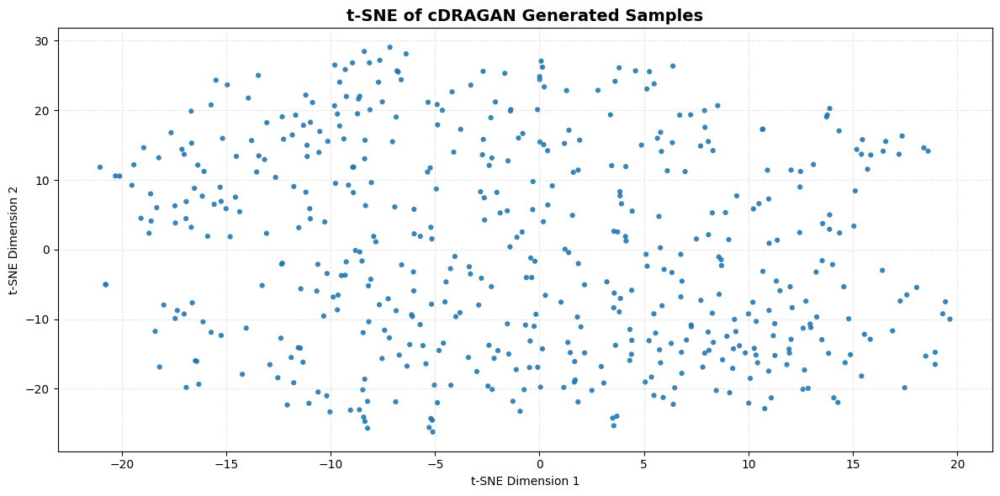

In [ ]:
# ========== Generate New Images from Random Noise ========== #
latent_dim   = 160
num_classes  = 16
n_samples    = 500

# ========== Sample Gaussian Noise ========== #
noise = tf.random.normal([n_samples, latent_dim])

# ========== Sample Random Class Labels and One‐hot Encode ========== #
rand_ints = tf.random.uniform([n_samples], 0, num_classes, dtype=tf.int32)
labels_oh = tf.one_hot(rand_ints, depth=num_classes)  # shape (n_samples, num_classes)

# ========== Generate Images ========== #
generated_images = generator([noise, labels_oh], training=False)


def plot_tsne_embeddings(
    generated_images,
    save_path=None,
    title="t-SNE of cDRAGAN Generated Samples"
):
    # ----- Check input range ----- #
    mi, ma = tf.reduce_min(generated_images).numpy(), tf.reduce_max(generated_images).numpy()
    if not (mi >= -1.0 and ma <= 1.0):
        raise ValueError(f"Images must be in [-1,1]. Got range [{mi:.3f},{ma:.3f}]")

    # ----- Rescale from [-1,1] to [0,1] ----- #
    images_rescaled = (generated_images + 1.0) / 2.0
    flat_images     = images_rescaled.numpy().reshape(n_samples, -1)

    # ----- Run t-SNE ----- #
    tsne = TSNE(n_components=2, perplexity=30, learning_rate='auto',
                init='pca', random_state=42)
    tsne_proj = tsne.fit_transform(flat_images)

    # ----- Plot t-SNE ----- #
    plt.figure(figsize=(12, 6))
    sns.scatterplot(
        x=tsne_proj[:, 0],
        y=tsne_proj[:, 1],
        s=20,
        alpha=0.9,
        edgecolor='none'
    )
    plt.title(title, fontsize=14, weight='bold')
    plt.xlabel("t-SNE Dimension 1")
    plt.ylabel("t-SNE Dimension 2")
    plt.grid(True, linestyle='--', alpha=0.3)
    plt.tight_layout()

    if save_path:
        plt.savefig(save_path, dpi=300)
        print(f"t-SNE plot saved to: {save_path}")

    plt.show()

# ========== Call Plot Function ========== #
plot_tsne_embeddings(generated_images)

With reference to the t-SNE of cDRAGAN Generated Samples above, we are able to make the following observations:

- There is a broad scattering of points across the t-SNE space, suggesting moderate diversity with less mode collapse than DRAGAN or LSGAN.

- However, the semantic alignment across samples is inconsistent, weakening the correlation between visual diversity and actual meaningful variation.

With the observations stated, we are able to conclude that the best GAN Model is the cDRAGAN.

---
## 6.3 GAN Comparison to VAE

In this section, we will be comparing the Best GAN Model (cDRAGAN) to a VAE so as to evaluate the performance of GAN Models as compared to VAEs as both are generative models. Through this comparison, we will be able to attempt to justify why a VAE or GAN may be more advantages in generative task for the EMNIST Dataset. The comparison will be conuducted in this section.

---
### 6.3.1 Defining Sampling Layer

In this sub-section, we will be defining the Sampling Layer for the VAE. The Sampling Layer will then subsequently be used in the Encoder's Architecture as the final layer. The relevant mathematical formulas are indicated below:

**Sampling Layer**

Purpose: Enable differentiable sampling from the encoder's Gaussian latent distribution via the reparameterization trick.

$$
\sigma = \exp\!\Bigl(\tfrac{1}{2}\,\log \sigma^2\Bigr)
$$

$$
z = \mu + \sigma \;\odot\; \epsilon,\quad \epsilon \sim \mathcal{N}(0, I)
$$


Where:
- $\mu$ (z_mean) = Learned Mean Vector of the Latent Distribution  
- $\sigma^2$ = Learned Variance Vector
- $\sigma$ = Standard Deviation Vector, $\sqrt{\sigma^2}$  
- $\epsilon$ = Noise Sampled from $\mathcal{N}(0, I)$  
- $\odot$ = Element-wise Multiplication  
- $z$ = Sampled Latent Vector Passed to Decoder  

With the relevant mathematical formulas indicated above, we will proceed to define the Sampling Layer in the Code Cell below.

In [ ]:
# ========== Sampling Layer ========== #
class Sampling(layers.Layer):
    def call(self, inputs):
        z_mean, z_log_var = inputs
        epsilon = tf.random.normal(shape=tf.shape(z_mean))
        return z_mean + tf.exp(0.5 * z_log_var) * epsilon

With reference to the Code Cell above, we are able to verify that the Sampling Layer have been successfully defined.

---
### 6.3.2 Defining Encoder Architecture

In this sub-section, we will be defining the Encoder Architecture so as to encode the input data before decoding the data. The Encoder will operate alongside the Decoder so as to generate synthesise new data. The relevant mathematical formulas are indicated below:

---

**First Convolutional Layer**

$$
h^{(1)} = \mathrm{ReLU}\bigl(\mathrm{Conv}_1(x)\bigr)
$$

Where:  
- $x$ = Input Image Tensor of Shape $(28,28,1)$  
- $\mathrm{Conv}_1$ = First Convolutional Layer
- $\mathrm{ReLU}$ = Rectified Linear Unit Activation  
- $h^{(1)}$ = Output Feature Map after First Convolution

---

**Second Convolutional Layer**

$$
h^{(2)} = \mathrm{ReLU}\bigl(\mathrm{Conv}_2(h^{(1)})\bigr)
$$

Where:
- $h^{(1)}$ = Input Feature Map from Previous Layer  
- $\mathrm{Conv}_2$ = Second Convolutional Layer
- $\mathrm{ReLU}$ = Rectified Linear Unit Activation  
- $h^{(2)}$ = Output Feature Map after Second Convolution

---

**Flatten Layer**

$$
h = \mathrm{Flatten}\bigl(h^{(2)}\bigr)
$$

Where:
- $h^{(2)}$ = Input Feature Map of Shape
- $\mathrm{Flatten}$ = Operation Converting a Tensor into a 1D Vector  
- $h$ = Flattened Vector Representation

---

**Dense Hidden Layer**

$$
h_{d} = \mathrm{ReLU}\bigl(W_{h}\,h + b_{h}\bigr)
$$

Where:
- $h$ = Flattened Input Vector  
- $W_{h}$ = Weight Matrix of the Dense Hidden Layer  
- $b_{h}$ = Bias Vector of Dense Hidden Layer  
- $\mathrm{ReLU}$ = Rectified Linear Unit Activation  
- $h_{d}$ = Activated Hidden Representation

---

**Latent Mean**

$$
\mu = W_{\mu}\,h_{d} + b_{\mu}
$$

Where:
- $h_{d}$: Hidden Representation Input  
- $W_{\mu}$: Weight Matrix Mapping to Latent Mean  
- $b_{\mu}$: Bias Vector for Latent Mean  
- $\mu$: Mean Vector of Gaussian Latent Distribution

---

**Latent Log-Variance**

$$
\log \sigma^2 = W_{\log \sigma^2}\,h_{d} + b_{\log \sigma^2}
$$

Where:
- $h_{d}$ = Hidden Representation Input  
- $W_{\log \sigma^2}$ = Weight Matrix Mapping to Log-variance  
- $b_{\log \sigma^2}$ = Bias Vector for Log-variance  
- $\log \sigma^2$ = Log-variance Vector of Gaussian Latent Distribution

With the relevant mathematical formulas indicated above, we will be proceeding to define the Encoder Architecture in the Code Cell below.

In [ ]:
# ========== Defining Encoder Architecture ========== #
latent_dim = 16

encoder_inputs = keras.Input(shape=(28,28,1))
x = layers.Conv2D(32, 3, activation='relu', strides=2, padding='same')(encoder_inputs)
x = layers.Conv2D(64, 3, activation='relu', strides=2, padding='same')(x)
x = layers.Flatten()(x)
x = layers.Dense(128, activation='relu')(x)
z_mean    = layers.Dense(latent_dim, name='z_mean')(x)
z_log_var = layers.Dense(latent_dim, name='z_log_var')(x)
z = Sampling()([z_mean, z_log_var])

# ========== Encoder Architecture Overview ========== #
encoder = keras.Model(encoder_inputs, [z_mean, z_log_var, z], name='encoder')
encoder.summary()

Model: "encoder"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_68      │ (None, 28, 28, 1) │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_1930         │ (None, 14, 14,    │        320 │ input_layer_68[0… │
│ (Conv2D)            │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_1931         │ (None, 7, 7, 64)  │     18,496 │ conv2d_1930[0][0] │
│ (Conv2D)            │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ flatten_17          │ (None, 3136)      │          0 │ conv2d_1931[0][0] │
│ (Flatten)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_42 (Dense)    │ (None, 128)       │    401,536 │ flatten_17[0][0]  │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ z_mean (Dense)      │ (None, 16)        │      2,064 │ dense_42[0][0]    │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ z_log_var (Dense)   │ (None, 16)        │      2,064 │ dense_42[0][0]    │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ sampling (Sampling) │ (None, 16)        │          0 │ z_mean[0][0],     │
│                     │                   │            │ z_log_var[0][0]   │
└─────────────────────┴───────────────────┴────────────┴───────────────────┘

 Total params: 424,480 (1.62 MB)

 Trainable params: 424,480 (1.62 MB)

 Non-trainable params: 0 (0.00 B)

With referene to the output of the Code Cell above, we are able to determine that the Encoder Architecture have been defined successfully and we are also able to see the overview of the Encoder's Architecture Layers based on the Summary above.

---
### 6.3.3 Defining Decoder Architecture

In this sub-section, we will be defining the Decoder Architecture which will complement the Encoder Architecture which was previously defined. The Decoder will the Decoding the Encoded Data. The relevant mathematical formulas are indicated below:

---

**Dense Expansion Layer**  
$$
h^{(1)} = \mathrm{ReLU}\bigl(W^{(1)}\,z + b^{(1)}\bigr)
$$

Where:
- $z$ = Latent Vector of Shape $(d,)$  
- $W^{(1)}, b^{(1)}$ = Weights and Biases of Dense Expansion Layer  
- $h^{(1)}$ = Expanded Dense Representation
- $\mathrm{ReLU}$ = Rectified Linear Unit Activation  

---

**Reshape to Feature Map**  
$$
h^{(2)} = \mathrm{Reshape}\bigl(h^{(1)},\,(7,7,64)\bigr)
$$

Where:  
- $h^{(1)}$ = Dense Vector Input  
- $\mathrm{Reshape}$ = Operation Converting Vector to Tensor of Shape
- $h^{(2)}$ = Feature Map Tensor of Shape  

---

**First Transposed Convolution**  
$$
h^{(3)} = \mathrm{ReLU}\bigl(\mathrm{ConvT}_1(h^{(2)})\bigr)
$$

Where:  
- $\mathrm{ConvT}_1$ = Conv2DTranspose Layer  
- $h^{(2)}$ = Input Feature Map  
- $h^{(3)}$ = Output Feature Map of Shape  
- $\mathrm{ReLU}$ = Rectified Linear Unit Activation  

---

**Second Transposed Convolution**
$$
h^{(4)} = \mathrm{ReLU}\bigl(\mathrm{ConvT}_2(h^{(3)})\bigr)
$$

Where:  
- $\mathrm{ConvT}_2$ = Conv2DTranspose Layer
- $h^{(3)}$ = Input Feature Map  
- $h^{(4)}$ = Output Feature Map of Shape  
- $\mathrm{ReLU}$ = Rectified Linear Unit Activation  

---

**Output Reconstruction Layer**  
$$
\hat{x} = \tanh\bigl(\mathrm{ConvT}_3(h^{(4)})\bigr)
$$

Where:  
- $\mathrm{ConvT}_3$ = Conv2DTranspose Layer
- $\tanh$ = Hyperbolic Tangent Activation Mapping Outputs to $[-1,1]$  
- $\hat{x}$ = Reconstructed Image Tensor of Shape

With the relevant mathematical formulas indicated above, we will proceeed to define the Decoder Architecture in the Code Cell below.

In [ ]:
# ========== Defining Decoder Architecture ========== #
latent_inputs = keras.Input(shape=(latent_dim,))
x = layers.Dense(7*7*64, activation='relu')(latent_inputs)
x = layers.Reshape((7,7,64))(x)
x = layers.Conv2DTranspose(64, 3, activation='relu', strides=2, padding='same')(x)
x = layers.Conv2DTranspose(32, 3, activation='relu', strides=2, padding='same')(x)
decoder_outputs = layers.Conv2DTranspose(1, 3, activation='tanh', padding='same')(x)

# ========== Decoder Architecture Overview ========== #
decoder = keras.Model(latent_inputs, decoder_outputs, name='decoder')
decoder.summary()

Model: "decoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_69 (InputLayer)     │ (None, 16)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_43 (Dense)                │ (None, 3136)           │        53,312 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ reshape_17 (Reshape)            │ (None, 7, 7, 64)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose_42             │ (None, 14, 14, 64)     │        36,928 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose_43             │ (None, 28, 28, 32)     │        18,464 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose_44             │ (None, 28, 28, 1)      │           289 │
│ (Conv2DTranspose)               │                        │               │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 108,993 (425.75 KB)

 Trainable params: 108,993 (425.75 KB)

 Non-trainable params: 0 (0.00 B)

With referene to the output of the Code Cell above, we are able to determine that the Decoder Architecture have been defined successfully and we are also able to see the overview of the Decoder's Architecture Layers based on the Summary above.

---
### 6.3.4 Defining VAE Model

In this sub-section, we will be defining the Variational Auto Encoder Model with the Encoder and Decoder combined. In the class, it will include the train step and also the Loss calculation. The relevant mathematical formulas are indicated below:

---

**Reconstruction Loss (MSE)**  
$$
\mathcal{L}_{\text{recon}}
= \frac{1}{N}\sum_{i=1}^{N}\sum_{p}\bigl(x_{i}^{(p)} - \hat{x}_{i}^{(p)}\bigr)^{2}
$$  
Where:  
- $N$ = Batch size  
- $i$ = Sample Index in Batch  
- $p$ = Pixel Index  
- $x_{i}^{(p)}$ = True Value of Pixel $p$ in Sample $i$  
- $\hat{x}_{i}^{(p)}$ = Reconstructed Value of Pixel $p$ in Sample $i$  

---

**KL Divergence Loss**  
$$
\mathcal{L}_{\text{KL}}
= -\frac{1}{2N}\sum_{i=1}^{N}\sum_{j=1}^{d}\Bigl(1 + \log\sigma_{i,j}^{2} - \mu_{i,j}^{2} - \sigma_{i,j}^{2}\Bigr)
$$  
Where:  
- $d$ = Dimensionality of the Latent Space  
- $j$ = Latent Dimension Index  
- $\mu_{i,j}$ = Mean of Latent Dimension $j$ for Sample $i$  
- $\log\sigma_{i,j}^{2}$ = Log-variance of Latent Dimension $j$ for Sample $i$  
- $\sigma_{i,j}^{2} = \exp\bigl(\log\sigma_{i,j}^{2}\bigr)$ = Variance  

---

**Total VAE Loss**  
$$
\mathcal{L}_{\text{total}}
= \mathcal{L}_{\text{recon}} \;+\; \mathcal{L}_{\text{KL}}
$$  
Where:  
- $\mathcal{L}_{\text{total}}$ = Combined Loss Optimized during Training  
- $\mathcal{L}_{\text{recon}}$ = Reconstruction Loss  
- $\mathcal{L}_{\text{KL}}$ = KL Divergence Loss

---

With the relevant mathematical formula indicated above, we will proceed with defining the VAE Model in the Code Cell below.

In [ ]:
class VAE(keras.Model):
    def __init__(self, encoder, decoder, **kwargs):
        super().__init__(**kwargs)
        self.encoder = encoder
        self.decoder = decoder
        self.total_loss_tracker = keras.metrics.Mean(name="total_loss")
        self.recon_loss_tracker = keras.metrics.Mean(name="recon_loss")
        self.kl_loss_tracker    = keras.metrics.Mean(name="kl_loss")

    @property
    def metrics(self):
        return [
            self.total_loss_tracker,
            self.recon_loss_tracker,
            self.kl_loss_tracker
        ]

    def compute_losses(self, data):
        z_mean, z_log_var, z = self.encoder(data, training=False)
        reconstruction = self.decoder(z, training=False)
        # ----- Reconstruction Loss ----- #
        recon_loss = tf.reduce_mean(
            tf.reduce_sum(
                tf.square(data - reconstruction), axis=(1,2,3)
            )
        )
        # ----- KL Divergence ----- #
        kl_loss = -0.5 * tf.reduce_mean(
            tf.reduce_sum(
                1 + z_log_var
                - tf.square(z_mean)
                - tf.exp(z_log_var),
                axis=1
            )
        )
        total_loss = recon_loss + kl_loss
        return total_loss, recon_loss, kl_loss

    def train_step(self, data):
        with tf.GradientTape() as tape:
            total_loss, recon_loss, kl_loss = self.compute_losses(data)
        grads = tape.gradient(total_loss, self.trainable_weights)
        self.optimizer.apply_gradients(zip(grads, self.trainable_weights))

        # ----- Update Metrics ----- #
        self.total_loss_tracker.update_state(total_loss)
        self.recon_loss_tracker.update_state(recon_loss)
        self.kl_loss_tracker.update_state(kl_loss)
        return {
            "loss": self.total_loss_tracker.result(),
            "recon_loss": self.recon_loss_tracker.result(),
            "kl_loss": self.kl_loss_tracker.result(),
        }

    def test_step(self, data):
        total_loss, recon_loss, kl_loss = self.compute_losses(data)
        # ----- Update Metrics ----- #
        self.total_loss_tracker.update_state(total_loss)
        self.recon_loss_tracker.update_state(recon_loss)
        self.kl_loss_tracker.update_state(kl_loss)
        return {
            "loss": self.total_loss_tracker.result(),
            "recon_loss": self.recon_loss_tracker.result(),
            "kl_loss": self.kl_loss_tracker.result(),
        }

    def call(self, inputs):
        z_mean, z_log_var, z = self.encoder(inputs, training=False)
        return self.decoder(z, training=False)

# ========== Re-instantiate and Compile ========== #
vae = VAE(encoder, decoder)
vae.compile(
    optimizer=keras.optimizers.Adam(),
    run_eagerly=True
)

With reference to the Code Cell above, we are able to determine the VAE Model have been successfulyl defined and we are able to proceed to conduct the Training of the VAE in the next sub-section.

---
### 6.3.5 VAE Training

In this sub-section, we will be conducting the VAE Training so as to serve as a comparison between the best GAN Model due to both VAE and GAN being Generative-based Model. The Training will be conducted in the Code Cell below.

In [ ]:
# ========== Data Logger ========== #
csv_logger = CSVLogger('vae_training_log.csv', separator=',', append=False)

# ========== Data Pre-Process ========== #
train_ds = tf.data.Dataset.from_tensor_slices(X_train).shuffle(10_000).batch(128)
val_ds   = tf.data.Dataset.from_tensor_slices(X_val).batch(128)

# ========== VAE Model Training ========== #
history = vae.fit(
    train_ds,
    epochs=100,
    validation_data=val_ds,
    callbacks=[csv_logger]
)

Epoch 1/100
387/387 ━━━━━━━━━━━━━━━━━━━━ 48s 123ms/step - kl_loss: 6.9588 - loss: 305.9706 - recon_loss: 299.0118 - val_kl_loss: 21.2715 - val_loss: 148.5948 - val_recon_loss: 127.3233
Epoch 2/100
387/387 ━━━━━━━━━━━━━━━━━━━━ 47s 121ms/step - kl_loss: 23.2349 - loss: 125.3783 - recon_loss: 102.1434 - val_kl_loss: 24.6843 - val_loss: 102.3571 - val_recon_loss: 77.6728
Epoch 3/100
387/387 ━━━━━━━━━━━━━━━━━━━━ 46s 119ms/step - kl_loss: 24.9654 - loss: 98.3422 - recon_loss: 73.3769 - val_kl_loss: 24.5553 - val_loss: 92.3508 - val_recon_loss: 67.7955
Epoch 4/100
387/387 ━━━━━━━━━━━━━━━━━━━━ 46s 120ms/step - kl_loss: 25.6412 - loss: 90.0734 - recon_loss: 64.4323 - val_kl_loss: 26.0024 - val_loss: 87.4738 - val_recon_loss: 61.4715
Epoch 5/100
387/387 ━━━━━━━━━━━━━━━━━━━━ 46s 120ms/step - kl_loss: 26.0756 - loss: 84.8457 - recon_loss: 58.7700 - val_kl_loss: 25.3729 - val_loss: 84.1596 - val_recon_loss: 58.7867
Epoch 6/100
387/387 ━━━━━━━━━━━━━━━━━━━━ 46s 119ms/step - kl_loss: 26.3512 - loss: 8

With reference to the output of the Code Cell above, we are able to determine that the VAE have been trained successfully.

---
### 6.3.6 VAE Training Curve Evaluation

In this sub-section, we will be plotting the Learning Curve to assess the Learning Behaviour of the VAE. This plot allows us to visually determine if the VAE is Underfitting, Overfitting, or achieving an Ideal Fit during training. While the VAE is an unsupervised generative model, its ability to minimise both the reconstruction loss and KL divergence effectively indicates how well it learns the latent structure of the input data.

If the VAE is **Underfitting**, it implies that the encoder-decoder pair is not effectively capturing the underlying data distribution or reconstructing input images accurately.

If the VAE is **Overfitting**, the model may have memorised training examples and fails to generalise well to unseen variations in character structures.

An **Ideal Fit** suggests that the VAE is generalising well, balancing both reconstruction quality and latent space regularisation.

The Potential Observations and Corresponding Action Plans are outlined below:

**Underfitting Learning Curve**
- Re-tune latent dimensionality or layer complexity
- Increase the number of epochs or reduce dropout
- Revisit the KL-divergence weighting (if applicable)

**Overfitting Learning Curve**
- Enable or increase dropout
- Apply stronger regularisation (e.g. L2)
- Reduce model complexity or batch size

**Ideal Fit Learning Curve**
- Retain the current architecture and hyperparameters
- Proceed with synthetic sample generation per class
- Evaluate generation quality across all 16 classes

With the potential observations and their respective action plans indicated, we will proceed to visualise the Learning Curve in the Code Cell below.

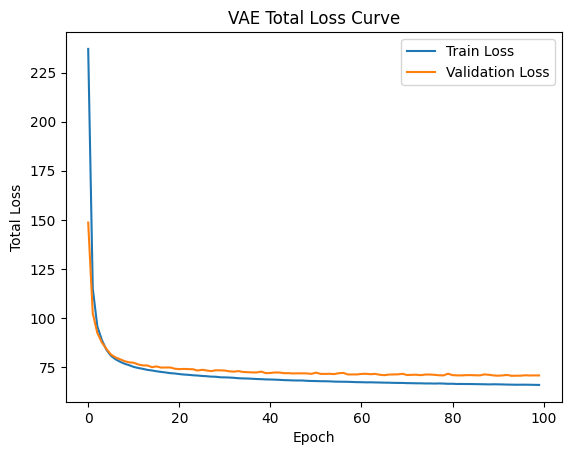

In [ ]:
# ========== Extract Loss Values ========== #
loss = history.history['loss']
val_loss = history.history['val_loss']

# ========== Plot Loss Values ========== #
plt.figure()
plt.plot(loss, label='Train Loss')
plt.plot(val_loss, label='Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Total Loss')
plt.legend()
plt.title('VAE Total Loss Curve')
plt.show()

With reference to the output of the Learning Curve of the VAE above, we are able to make the following observations:

- No overfitting or underfitting observed, implying model generalises well.

- Loss convergence is stable, with validation closely tracking training.

- VAE training appears healthy, with room for additional fine-tuning or early stopping around epoch 90+.

With the observations indicated above, we will proceed to conduct the Metrics Comparison between the VAE and cDRAGAN in the next sub-section.

---
### 6.3.7 VAE and cDRAGAN Metrics Comparison

In this sub-section, we will be comparing the performance of the VAE and cDRAGAN to test the capabilities of both of the Generative Model. Subseqeuntly, we will evaluate and provide potential reasoning on why is one of the Model more suprerior than the other. The relevant mathematical formulas for the Quantitative Metrics have been indicated below:

---
**Fréchet Inception Distance**

Purpose: Measures the Distance between the Real-Image and Generated-Image Distributions in Inception Feature Space.

$$
\mathrm{FID} \;=\;\|\mu_r - \mu_f\|^2
\;+\;\mathrm{Tr}\Bigl(\Sigma_r + \Sigma_f - 2\,(\Sigma_r\,\Sigma_f)^{\tfrac12}\Bigr)
$$


Where:
- $\mu_r = \mathbb{E}[f(x)]$, $\Sigma_r = \mathrm{Cov}[f(x)]$ for Real Images $x$.  
- $\mu_f = \mathbb{E}[f(\hat x)]$, $\Sigma_f = \mathrm{Cov}[f(\hat x)]$ for Generated Images $\hat x$.  
- $f(\cdot)$ = Map from Image to its InceptionV3 'pooling=avg' Features.  

---
**Diversity (t-SNE Spread)**

Purpose: Quantifies how 'wide' the 2D t-SNE Embedding of Generated Samples.

$$
\mathrm{Spread}
\;=\;
\bigl(\max_i\,z_i^{(1)} - \min_i\,z_i^{(1)}\bigr)
\;\times\;
\bigl(\max_i\,z_i^{(2)} - \min_i\,z_i^{(2)}\bigr)
$$

Where:
- $z_i = (z_i^{(1)}, z_i^{(2)})$ = 2-dimensional t-SNE Embedding of $i$th Generated Image.

---
**Mode Collapse Risk**

Purpose: Flags when too many Generated Images are Nearly Identical (mode collapse).

$$
\text{ModeCollapseRisk} =
\begin{cases}
\text{Low}, & \dfrac{\bigl|\{\mathrm{unique\_rounded}(x_i)\}\bigr|}{N} > \tau,\\
\text{High}, & \text{otherwise}.
\end{cases}
$$

Where:
- $x_i$ = $N$ Generated Samples.  
- $\mathrm{unique\_rounded}(x_i)$ = Rounds Pixels to Detect Duplicates.  
- $\tau=0.9$ = Uniqueness Threshold (90%).

---
**Perceptual Path Length**

Purpose: Measures Sensitively of Generator's Outputs (in VGG16 Feature Space) move when the Latent Code $z$ is Perturbed.

$$
\mathrm{PPL}
\;=\;
\mathbb{E}_{z,\delta z}\Bigl[\,
\|\phi\bigl(G(z + \epsilon\,\delta z)\bigr)\;-\;\phi\bigl(G(z)\bigr)\|_2^2
\Bigr]
$$

Where:  
- $G(z)$ = GAN Generator Mapping $z\in\mathbb{R}^{\mathrm{latent\_dim}}$ to an Image.  
- $\phi(\cdot)$ = VGG16 'pooling=avg' Feature Extractor.  
- $\delta z\sim\mathcal{N}(0,I)$, $\epsilon$ = Small Constant.

---
**Kernel Inception Distance**

Purpose: An Unbiased Estimator of the Squared Maximum Mean Discrepancy (MMD) between Real and Generated Inception Features.

$$
\mathrm{KID}
\;=\;
\frac{1}{m(m-1)}\sum_{i\neq j} k\bigl(\phi(x_i),\phi(x_j)\bigr)
\;+\;
\frac{1}{n(n-1)}\sum_{i\neq j} k\bigl(\phi(\hat x_i),\phi(\hat x_j)\bigr)
\;-\;
\frac{2}{mn}\sum_{i=1}^m\sum_{j=1}^n k\bigl(\phi(x_i),\phi(\hat x_j)\bigr)
$$

Where:  
- $x_i$ ($i=1\ldots m$) = Real Images.
- $\hat x_j$ ($j=1\ldots n$) = Generated Images.  
- $\phi(\cdot)$ = InceptionV3 Feature Extractor (pooling='avg').  
- $k(u,v) = \bigl(\frac{u^\top v}{d}+1\bigr)^3$ = degree-3 Polynomial Kernel on $d$-dimensional Features.

---

With the mathematical and metrics indicated above, we will proceed to conduct the Quantitave Metrics Evalution in the Code Cell below.

In [ ]:
# ========== Evaluate GAN (cDRAGAN) ==========
def evaluate_gan_model(generator, latent_dim, num_classes, X_val,
                       gen_loss_history, disc_loss_history, model_name="cDRAGAN"):
    # ----- Generate Fake Images -----
    n_samples = 1000
    noise = tf.random.normal([n_samples, latent_dim])
    rnd_classes = tf.random.uniform([n_samples], 0, num_classes, dtype=tf.int32)
    fake_labels = tf.one_hot(rnd_classes, depth=num_classes)
    fake_images = generator([noise, fake_labels], training=False)

    # ----- Real Images -----
    real_images = tf.convert_to_tensor(X_val[:n_samples], dtype=tf.float32)

    # ----- FID & KID -----
    fid_value = calculate_fid(real_images, fake_images)
    kid_value = calculate_kid(real_images, fake_images)

    # ----- t-SNE Spread -----
    fake_np = ((fake_images + 1.0) / 2.0).numpy().reshape(n_samples, -1)
    tsne = TSNE(n_components=2, random_state=42)
    proj = tsne.fit_transform(fake_np)
    spread_x = np.ptp(proj[:,0])
    spread_y = np.ptp(proj[:,1])
    tsne_spread = round(spread_x * spread_y, 2)

    # ----- Mode Collapse Risk -----
    unique = np.unique(np.round(fake_np, 3), axis=0).shape[0]
    collapse_risk = "Low" if unique > 0.9 * n_samples else "High"

    # ----- Perceptual Path Length (PPL) -----
    distances = []
    eps = 1e-2
    for _ in range(50):
        z1 = tf.random.normal([1, latent_dim])
        z2 = z1 + eps * tf.random.normal([1, latent_dim])
        img1 = generator([z1, tf.one_hot([0], num_classes)], training=False)
        img2 = generator([z2, tf.one_hot([0], num_classes)], training=False)
        p1 = tf.image.resize(tf.image.grayscale_to_rgb((img1+1)*127.5), (128,128))
        p2 = tf.image.resize(tf.image.grayscale_to_rgb((img2+1)*127.5), (128,128))
        f1 = vgg_model(vgg_preprocess(p1))
        f2 = vgg_model(vgg_preprocess(p2))
        distances.append(tf.reduce_mean(tf.square(f1 - f2)).numpy())
    ppl_value = round(np.mean(distances), 4)

    # ----- Loss Statistics -----
    mean_g = round(np.mean(gen_loss_history), 4)
    std_g  = round(np.std(gen_loss_history), 4)
    mean_d = round(np.mean(disc_loss_history), 4)
    std_d  = round(np.std(disc_loss_history), 4)

    # ----- Assemble DataFrame -----
    row = {
        "Model": model_name,
        "FID Score": fid_value,
        "KID Score": kid_value,
        "Mean Generator Loss": mean_g,
        "Std Generator Loss": std_g,
        "Mean Discriminator Loss": mean_d,
        "Std Discriminator Loss": std_d,
        "Mode Collapse Risk": collapse_risk,
        "Diversity (t-SNE Spread)": tsne_spread,
        "PPL": ppl_value
    }
    return pd.DataFrame([row])

# ========== Evaluate VAE ==========
def evaluate_vae_model(decoder, latent_dim, X_val, history, model_name="VAE"):
    # ----- Generate Fake Images -----
    n_samples = 1000
    noise = tf.random.normal([n_samples, latent_dim])
    fake_images = decoder(noise, training=False)

    # ----- Real Images -----
    real_images = tf.convert_to_tensor(X_val[:n_samples], dtype=tf.float32)

    # ----- FID & KID -----
    fid_value = calculate_fid(real_images, fake_images)
    kid_value = calculate_kid(real_images, fake_images)

    # ----- t-SNE Spread -----
    fake_np = ((fake_images + 1.0) / 2.0).numpy().reshape(n_samples, -1)
    tsne = TSNE(n_components=2, random_state=42)
    proj = tsne.fit_transform(fake_np)
    spread_x = np.ptp(proj[:,0])
    spread_y = np.ptp(proj[:,1])
    tsne_spread = round(spread_x * spread_y, 2)

    # ----- Mode Collapse Risk -----
    unique = np.unique(np.round(fake_np, 3), axis=0).shape[0]
    collapse_risk = "Low" if unique > 0.9 * n_samples else "High"

    # ----- Perceptual Path Length (PPL) -----
    distances = []
    eps = 1e-2
    for _ in range(50):
        z1 = tf.random.normal([1, latent_dim])
        z2 = z1 + eps * tf.random.normal([1, latent_dim])
        img1 = decoder(z1, training=False)
        img2 = decoder(z2, training=False)
        p1 = tf.image.resize(tf.image.grayscale_to_rgb((img1+1)*127.5), (128,128))
        p2 = tf.image.resize(tf.image.grayscale_to_rgb((img2+1)*127.5), (128,128))
        f1 = vgg_model(vgg_preprocess(p1))
        f2 = vgg_model(vgg_preprocess(p2))
        distances.append(tf.reduce_mean(tf.square(f1 - f2)).numpy())
    ppl_value = round(np.mean(distances), 4)

    # ----- Loss Stats -----
    recon_hist = history.history['recon_loss']
    kl_hist    = history.history['kl_loss']
    mean_recon = round(np.mean(recon_hist), 4)
    std_recon  = round(np.std(recon_hist), 4)
    mean_kl    = round(np.mean(kl_hist), 4)
    std_kl     = round(np.std(kl_hist), 4)

    # ----- Assemble DataFrame -----
    row = {
        "Model": model_name,
        "FID Score": fid_value,
        "KID Score": kid_value,
        "Mean Generator Loss": mean_recon,
        "Std Generator Loss": std_recon,
        "Mean Discriminator Loss": mean_kl,
        "Std Discriminator Loss": std_kl,
        "Mode Collapse Risk": collapse_risk,
        "Diversity (t-SNE Spread)": tsne_spread,
        "PPL": ppl_value
    }
    return pd.DataFrame([row])

# ========== Run & Compare ==========
df_gan = evaluate_gan_model(
    generator=generator,
    latent_dim=160,
    num_classes=16,
    X_val=X_val,
    gen_loss_history=gen_loss_history,
    disc_loss_history=disc_loss_history,
    model_name="cDRAGAN"
)

df_vae = evaluate_vae_model(
    decoder=vae.decoder,
    latent_dim=latent_dim,
    X_val=X_val,
    history=history,
    model_name="VAE"
)

df_compare = pd.concat([df_gan, df_vae], ignore_index=True)
df_compare.style.background_gradient(cmap="Blues")

,Model,FID Score,KID Score,Mean Generator Loss,Std Generator Loss,Mean Discriminator Loss,Std Discriminator Loss,Mode Collapse Risk,Diversity (t-SNE Spread),PPL
0,cDRAGAN,27.828000,0.008200,0.710600,0.019300,1.430900,0.172300,Low,5356.770020,0.071000
1,VAE,42.347100,0.022500,44.285300,19.652500,27.244300,1.774000,Low,5100.080078,0.034700


With reference to the DataFrame above, we are able to make the following implications and reasoning below:

- cDRAGAN is superior in visual fidelity, diversity, and adversarial loss metrics

- VAE performs surprisingly well given its non-adversarial nature

- VAE may be preferable in applications when Structured latent space or stability without adversarial instability is needed.

- cDRAGAN benefits from adversarial training and gradient regularisation, leading to Better FID/KID (image quality), More expressive generator, and Stronger diversity without mode collapse.

- VAE, though not competitive in image realism, is More robust, with stable convergence and low tuning sensitivity and Better suited for tasks like reconstruction, anomaly detection, or latent representation learning.

With the implications and reasoning indicated above, we will proceed to conduct EDAs on our final GAN Model for submission.

---
# 7. Best Model Architecture Visualisation and Model Complexity

In this section, we will be visualising the architecture and various GAN related Complexity for the cDRAGAN. This is mainly for the purpose of exploring the GAN better and also to try to interpret the various behaviour of the cDRAGAN.

---
## 7.1 cDRAGAN Generator Architecture

In this sub-section, we will be plotting out the cDRAGAN's Generator Architecture in the Code Cell below. This will give us insight on how the Generator Layers are organised in. The visualisation will be conducted in the Code Cell below.

/usr/local/lib/python3.11/dist-packages/visualkeras/layered.py:86: UserWarning: The legend_text_spacing_offset parameter is deprecated and will be removed in a future release.
  warnings.warn("The legend_text_spacing_offset parameter is deprecated and will be removed in a future release.")


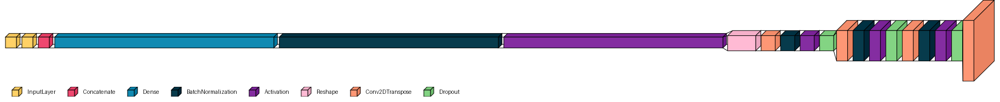

In [ ]:
# ========== Plot Generator Architecture ========== #
visualkeras.layered_view(generator, legend=True).save('generator_architecture.png')

# ========== Display Generator Architecture ========== #
Image('generator_architecture.png')

With reference to the output of the Code Cell above, we are able to confirm that the Generator Architecture have been successfully executed.

---
## 7.2 Discriminator Discriminator Architecture

In this sub-section, we will be plotting out the cDRAGAN's Discriminator Architecture in the Code Cell below. This will give us insight on how the Discriminator Layers are organised in. The visualisation will be conducted in the Code Cell below.

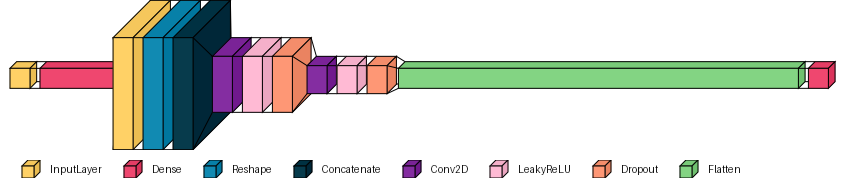

In [ ]:
# ========== Plot Generator Architecture ========== #
visualkeras.layered_view(discriminator, legend=True).save('discriminator_architecture.png')

# ========== Display Generator Architecture ========== #
Image('discriminator_architecture.png')

With reference to the output of the Code Cell above, we are able to confirm that the Discriminator Architecture have been successfully executed.

---
# 8. Bibliographies

Géron, A. (2019). Hands-on machine learning with Scikit-Learn and TensorFlow concepts, tools, and techniques to build intelligent systems. 2nd ed. O’Reilly Media, Inc.
<br>
<br>
OpenAI. (2023). ChatGPT.
<br>
<br>
Russel, S. and Norvig, P. (2020). Artificial intelligence: A Modern approach. 4th ed. Prentice Hall.